In [7]:
import networkx as nx
import json
import pandas as pd
import numpy as np

In [8]:
with open("/Users/d.murray/Documents/csaba_layout_pipeline/data/derived/panel_antivax-only_post.json") as f:
    df = json.load(f)

In [3]:
df.keys()

node_records = []
for i in range(len(df['nodes']['positions'])):
    
    record = {
        'x': df['nodes']['positions'][i][0],
        'y': df['nodes']['positions'][i][1],
        'z': df['nodes']['positions'][i][2],
        'numfake': df['nodes']['numfake'][i],
        'verified': df['nodes']['verified'][df['nodes']['labels'][i]],
    }
    node_records.append(record)
        
               
print(node_records[1:10])

[{'x': -4.2686625, 'y': -3.9254212, 'z': 5.25662, 'numfake': 20, 'verified': 1}, {'x': -3.1074357, 'y': 2.6470125, 'z': -2.7262454, 'numfake': 1, 'verified': 1}, {'x': -6.8797665, 'y': 1.2310084, 'z': -1.1370678, 'numfake': 1, 'verified': 1}, {'x': -2.2870336, 'y': -2.3872888, 'z': -1.5901653, 'numfake': 17, 'verified': 0}, {'x': -10.516076, 'y': 5.6650686, 'z': 2.6563745, 'numfake': 1, 'verified': 0}, {'x': -9.357363, 'y': -4.2183876, 'z': 7.484379, 'numfake': 4, 'verified': 0}, {'x': -8.317801, 'y': -6.2066126, 'z': 11.3933935, 'numfake': 11, 'verified': 0}, {'x': -8.679316, 'y': -6.8296194, 'z': 7.630031, 'numfake': 6, 'verified': 0}, {'x': -3.4944637, 'y': -6.400618, 'z': 7.0085387, 'numfake': 10, 'verified': 0}]


In [6]:
df['nodes']['labels'][0:10]

['54a40a527e1c5fe0b60806e5a2a91ab9',
 '5630e60599cf1eb433ce7c0063fd939c',
 '9c6ed580b4edd8b89a2a81f55b4d2e9a',
 'ef563d2bc7398cab4c268c2e7a8cdea5',
 'b3bf8a87f914b49760dae4c525d928e8',
 'a428b3246b4a489c551c5875276e5e6a',
 'ab675985f84435b1d8967f7e48a7e464',
 '9da2b11e027ecaaeebbc770c19b00832',
 '1e6e66c0152df4b7c00183aba171f64a',
 '2c9375ce7e955f7a727fd83254dd4cb1']

In [ ]:
from networkx.readwrite import json_graph

def read_json_file(filename):
    with open(filename) as f:
        js_graph = json.load(f)
    return json_graph.node_link_graph(js_graph)

G = read_json_file("/Users/d.murray/Documents/csaba_layout_pipeline/data/derived/panel_antivax-only_proc.json")
#G = json_graph.node_link_graph(df)

In [ ]:
from scipy.cluster import hierarchy
from scipy.spatial import distance
from collections import defaultdict

H = nx.convert_node_labels_to_integers(G)

"""Creates hierarchical cluster of graph G from distance matrix"""
path_length = nx.all_pairs_shortest_path_length(H)
distances = np.zeros((len(H), len(H)))
for u, p in path_length:
    for v, d in p.items():
        distances[u][v] = d
# Create hierarchical cluster
Y = distance.squareform(distances)
Z = hierarchy.complete(Y)  # Creates HC using farthest point linkage
# This partition selection is arbitrary, for illustrive purposes
membership = list(hierarchy.fcluster(Z, t=1.1))
# Create collection of lists for blockmodel
partition = defaultdict(list)
for n, p in zip(list(range(len(H))), membership):
    partition[p].append(n)

part = list(partition.values())
# Create parititions with hierarchical clustering
# Makes life easier to have consecutively labeled integer nodes


In [63]:
community_ind = 0
for p in list(part):
    for index in p:
        node_records[index]['communityid'] = community_ind
        
    community_ind += 1

In [2]:
node_df = pd.DataFrame(node_records)
node_df = node_df.sort_values(by = ['x'])
node_df.to_csv("~/Desktop/panel_antivax-only_nodes.csv", index=False)

NameError: name 'pd' is not defined

In [9]:
node_ids = list(df['links'].keys())
records = []
for i in range(len(node_ids)):
    node_id = node_ids[i]
    
    xstart = df['links'][node_id]['points'][0][0]
    ystart = df['links'][node_id]['points'][0][1]
    zstart = df['links'][node_id]['points'][0][2]
    
    xend = df['links'][node_id]['points'][1][0]
    yend = df['links'][node_id]['points'][1][1]
    zend = df['links'][node_id]['points'][1][2]
    
    record = {
        'xstart': xstart,
        'ystart': ystart,
        'zstart': zstart,
        'xend': xend,
        'yend': yend,
        'zend': zend
    }
    
    records.append(record)

In [13]:
all_links = list(df['links'].keys())
records = []
for link in all_links:
    spl = link.split(";")
    record = {
        "Source": spl[0],
        "Target": spl[1],
    }
    records.append(record)
    
len(records)

327795

In [28]:
links = []
for r in records:
    start = np.array((r['xstart'], r['ystart'], r['zstart']))
    end = np.array((r['xend'], r['yend'], r['zend']))
    dx = end[0] - start[0]
    dy = end[1] - start[1]
    dz = end[2] - start[2]

    dist = np.sqrt(np.square(dx) + np.square(dy) + np.square(dz))
    dirvec = np.array([dx / dist, dy / dist, dz / dist])
    link = {
        'x': start[0],
        'y': start[1],
        'z': start[2],
        'dist': dist,
        'dirvec_x': dirvec[0],
        'dirvec_y': dirvec[1],
        'dirvec_z': dirvec[2],
        'xend': end[0],
        'yend': end[1],
        'zend': end[2],
    }
    links.append(link)
    
links_df = pd.DataFrame(links)
links_df = links_df.sort_values(by = ['x'])
links_df.to_csv('~/Desktop/panel_antivax-only_links-vectors.csv', index = False)

In [29]:
for index, row in links_df.iterrows():
    #print(row['x'], row['y'])
    dirvec = np.array((row['dirvec_x'], row['dirvec_y'], row['dirvec_z']))
    start = np.array((row['x'], row['y'], row['z']))
    d = row['dist']
    vec = start + (d * dirvec)
    print(vec, row['xend'], row['yend'], row['zend'])
    

[-23.782726   8.958647  -1.87372 ] -23.782726 8.958647 -1.87372
[-22.50377      0.03269318 -10.575481  ] -22.50377 0.032693185 -10.575481
[-14.192553   7.338441  -6.486161] -14.192553 7.338441 -6.486161
[-18.469856     0.12494454  -1.8750545 ] -18.469856 0.124944545 -1.8750545
[-6.481312   7.2470045 -5.7705092] -6.481312 7.2470045 -5.7705092
[-20.252846     0.62558883  -3.6712072 ] -20.252846 0.62558883 -3.6712072
[-12.431634    1.0249057 -11.534935 ] -12.431634 1.0249057 -11.534935
[ -8.211915   4.993209 -11.058879] -8.211915 4.993209 -11.058879
[ -5.811101   5.260272 -11.92618 ] -5.811101 5.260272 -11.92618
[ -5.811101   5.260272 -11.92618 ] -5.811101 5.260272 -11.92618
[ -9.786068    4.3237433 -11.617267 ] -9.786068 4.3237433 -11.617267
[-15.638      5.82916   -8.205334] -15.638 5.82916 -8.205334
[-17.882101   7.103278 -10.578669] -17.882101 7.103278 -10.578669
[-17.36751     8.593569   -5.3721976] -17.36751 8.593569 -5.3721976
[ -0.0753164  -4.875962  -13.903734 ] -0.0753164 -4.875

[ -3.9506164 -13.644921  -10.596875 ] -3.9506164 -13.644921 -10.596875
[ -5.4572015   6.1409926 -12.762331 ] -5.4572015 6.1409926 -12.762331
[-15.8940325   8.344807    1.3835192] -15.8940325 8.344807 1.3835192
[-16.678724  12.722878  -7.037854] -16.678724 12.722878 -7.037854
[-15.466809   9.79564   -8.748756] -15.466809 9.79564 -8.748756
[-11.329823   5.642229 -12.559701] -11.329823 5.642229 -12.559701
[-7.4312096   1.8460063   0.68082905] -7.4312096 1.8460063 0.68082905
[-11.6814785  -4.2139487 -11.075316 ] -11.6814785 -4.2139487 -11.075316
[-11.863222    2.8860042  -4.069802 ] -11.863222 2.8860042 -4.069802
[-13.086788   -2.5491927   1.3443177] -13.086788 -2.5491927 1.3443177
[-14.342432  16.97667  -10.548778] -14.342432 16.97667 -10.548778
[-7.32907   3.166203 -9.347037] -7.32907 3.166203 -9.347037
[-10.1829195  11.504659   -3.6216245] -10.1829195 11.504659 -3.6216245
[-5.6646    6.797918 -5.208082] -5.6646 6.797918 -5.208082
[ -6.5874033   0.3540879 -12.3832855] -6.5874033 0.354087

[-6.347005  -4.2658806  1.3434633] -6.347005 -4.2658806 1.3434633
[ -6.4097943   3.2222733 -11.518208 ] -6.4097943 3.2222733 -11.518208
[ -7.164574    -0.53830767 -12.737535  ] -7.164574 -0.53830767 -12.737535
[-11.90234    6.266506 -10.643899] -11.90234 6.266506 -10.643899
[ -5.811101   5.260272 -11.92618 ] -5.811101 5.260272 -11.92618
[-7.32907   3.166203 -9.347037] -7.32907 3.166203 -9.347037
[-12.869448   3.976726 -12.898704] -12.869448 3.976726 -12.898704
[-11.540245 -12.374008 -10.439357] -11.540245 -12.374008 -10.439357
[-12.075254  10.814196   5.276179] -12.075254 10.814196 5.276179
[-21.620798    4.6946435  -0.6177303] -21.620798 4.6946435 -0.6177303
[-16.377434   -2.8518858   1.3117431] -16.377434 -2.8518858 1.3117431
[-6.3328705  3.1612544 -3.741441 ] -6.3328705 3.1612544 -3.741441
[-1.5784638 12.855948  -5.484365 ] -1.5784638 12.855948 -5.484365
[-7.32907   3.166203 -9.347037] -7.32907 3.166203 -9.347037
[-18.705536  -4.760353  -9.356678] -18.705536 -4.760353 -9.356678
[-16

[-4.4997516  4.144187  -7.4575725] -4.4997516 4.144187 -7.4575725
[ -6.655954    4.2808237 -12.988398 ] -6.655954 4.2808237 -12.988398
[ -7.2682686   5.8285933 -10.822545 ] -7.2682686 5.8285933 -10.822545
[-16.200699   -3.6452372 -12.608239 ] -16.200699 -3.6452372 -12.608239
[ -4.9419756   5.030078  -12.294345 ] -4.9419756 5.030078 -12.294345
[ -7.803611   9.761076 -17.948406] -7.803611 9.761076 -17.948406
[ -6.668643    4.8351746 -12.303141 ] -6.668643 4.8351746 -12.303141
[ -7.770789   2.926206 -12.593338] -7.770789 2.926206 -12.593338
[ -5.5408335   3.5839314 -11.963161 ] -5.5408335 3.5839314 -11.963161
[ -5.862276    2.9512572 -10.69945  ] -5.862276 2.9512572 -10.69945
[-9.902461   7.999634  -3.4845402] -9.902461 7.999634 -3.4845402
[-21.254406   -3.8070037 -15.966259 ] -21.254406 -3.8070037 -15.966259
[ -9.350504    4.8439345 -10.409732 ] -9.350504 4.8439345 -10.409732
[-5.6646    6.797918 -5.208082] -5.6646 6.797918 -5.208082
[ -6.0634847   5.0781    -13.577164 ] -6.0634847 5.078

[-15.01636     5.3480515 -14.675594 ] -15.01636 5.3480515 -14.675594
[-10.374714   -2.6677966  -7.6569185] -10.374714 -2.6677966 -7.6569185
[-10.3698435   3.593083  -12.292741 ] -10.3698435 3.593083 -12.292741
[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[-7.209538   3.1685424 -7.3039045] -7.209538 3.1685424 -7.3039045
[-4.2857356  4.4212413 -2.2112963] -4.2857356 4.4212413 -2.2112963
[ -5.529388    4.9850087 -11.044345 ] -5.529388 4.9850087 -11.044345
[-2.6674507  1.6247756 -9.084595 ] -2.6674507 1.6247756 -9.084595
[ -5.965601  12.060617 -22.574612] -5.965601 12.060617 -22.574612
[-7.32907   3.166203 -9.347037] -7.32907 3.166203 -9.347037
[  5.4312096  17.011908  -11.138883 ] 5.4312096 17.011908 -11.138883
[ -5.851771   4.32016  -12.22126 ] -5.851771 4.32016 -12.22126
[-2.910207   3.3752904 -8.192249 ] -2.910207 3.3752904 -8.192249
[ -0.96349615  15.23736    -18.427635  ] -0.96349615 15.23736 -18.427635
[ -5.356777 -10.125877 -18.627579] -5.356777 -10.125877 -18.6

[-6.4101815  8.684239  -9.885626 ] -6.4101815 8.684239 -9.885626
[-9.116551   8.4548    -2.6529384] -9.116551 8.4548 -2.6529384
[ -6.0634847   5.0781    -13.577164 ] -6.0634847 5.0781 -13.577164
[-9.324346  9.183506 -3.69432 ] -9.324346 9.183506 -3.69432
[-12.182035    7.5389256  -4.502031 ] -12.182035 7.5389256 -4.502031
[-11.198017   14.413672   -7.1025596] -11.198017 14.413672 -7.1025596
[-7.32907   3.166203 -9.347037] -7.32907 3.166203 -9.347037
[-9.902461   7.999634  -3.4845402] -9.902461 7.999634 -3.4845402
[-5.6646    6.797918 -5.208082] -5.6646 6.797918 -5.208082
[-10.361293    6.6530766  -5.217295 ] -10.361293 6.6530766 -5.217295
[-13.213176   11.902525   -1.3584683] -13.213176 11.902525 -1.3584683
[-8.685402   7.9875097 -7.6160197] -8.685402 7.9875097 -7.6160197
[-10.650867    8.2925415  -4.503356 ] -10.650867 8.2925415 -4.503356
[-6.807524  22.974297  -6.7498693] -6.807524 22.974297 -6.7498693
[ -9.056121   7.045234 -14.309832] -9.056121 7.045234 -14.309832
[-5.6908813  -0.2

[-11.688915   5.83823   -8.470262] -11.688915 5.83823 -8.470262
[ -4.9419756   5.030078  -12.294345 ] -4.9419756 5.030078 -12.294345
[ -5.862276    2.9512572 -10.69945  ] -5.862276 2.9512572 -10.69945
[-14.412435  -4.752472  -8.939722] -14.412435 -4.752472 -8.939722
[-6.090679  4.641815 -7.569958] -6.090679 4.641815 -7.569958
[-7.353662   2.3032973 -9.865309 ] -7.353662 2.3032973 -9.865309
[ -5.529388    4.9850087 -11.044345 ] -5.529388 4.9850087 -11.044345
[-7.8437386 -1.4589945 -7.840514 ] -7.8437386 -1.4589945 -7.840514
[-15.123444    4.6434827 -15.746047 ] -15.123444 4.6434827 -15.746047
[-13.155824   3.584909 -11.668467] -13.155824 3.584909 -11.668467
[ -0.8319143   0.2393831 -12.242218 ] -0.8319143 0.2393831 -12.242218
[-12.369181    3.8982453  -8.444169 ] -12.369181 3.8982453 -8.444169
[  4.6997848   6.9903417 -13.632836 ] 4.6997848 6.9903417 -13.632836
[ -4.9419756   5.030078  -12.294345 ] -4.9419756 5.030078 -12.294345
[-2.6674507  1.6247756 -9.084595 ] -2.6674507 1.6247756 -9

[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[ -3.3265023   1.16434   -10.519303 ] -3.3265023 1.16434 -10.519303
[ -7.770789   2.926206 -12.593338] -7.770789 2.926206 -12.593338
[-8.637402  6.829236 -7.916538] -8.637402 6.829236 -7.916538
[ -6.0634847   5.0781    -13.577164 ] -6.0634847 5.0781 -13.577164
[ -6.655954    4.2808237 -12.988398 ] -6.655954 4.2808237 -12.988398
[ -5.384191   8.371884 -13.494497] -5.384191 8.371884 -13.494497
[-11.344536  -5.870226   6.979535] -11.344536 -5.870226 6.979535
[-13.650816   -8.267838    1.6980426] -13.650816 -8.267838 1.6980426
[-9.737449  -0.8066244 -6.962818 ] -9.737449 -0.8066244 -6.962818
[ -7.472937    4.6644473 -11.670552 ] -7.472937 4.6644473 -11.670552
[-13.605696    0.6275782   1.8377095] -13.605696 0.6275782 1.8377095
[-11.062191     7.13353     -0.11440951] -11.062191 7.13353 -0.114409514
[-14.477172   3.38623   -7.218887] -14.477172 3.38623 -7.218887
[-16.249767   7.921289 -18.299532] -16.249767 7.921289 -18.299532

[-10.451743    6.9201636  -6.4580946] -10.451743 6.9201636 -6.4580946
[-10.361293    6.6530766  -5.217295 ] -10.361293 6.6530766 -5.217295
[-9.458921   2.3918605 -4.9352045] -9.458921 2.3918605 -4.9352045
[-2.3131278  7.374211  -4.332247 ] -2.3131278 7.374211 -4.332247
[-10.882911    9.229428   -1.1908728] -10.882911 9.229428 -1.1908728
[-15.701052    -0.23130718  -1.6353179 ] -15.701052 -0.23130718 -1.6353179
[-7.554239   1.2432635 -9.8753395] -7.554239 1.2432635 -9.8753395
[-7.1774383  2.8515394 -5.845375 ] -7.1774383 2.8515394 -5.845375
[ -6.655954    4.2808237 -12.988398 ] -6.655954 4.2808237 -12.988398
[-6.65807    3.1707354 -9.792813 ] -6.65807 3.1707354 -9.792813
[1.5849955 5.0978594 5.864832 ] 1.5849955 5.0978594 5.864832
[-1.5878419  1.7312604  1.9158741] -1.5878419 1.7312604 1.9158741
[-0.9412282  1.8447787  5.148341 ] -0.9412282 1.8447787 5.148341
[-5.9769006  3.831432   0.8160764] -5.9769006 3.831432 0.8160764
[-6.203161   2.7991748 -7.84253  ] -6.203161 2.7991748 -7.84253


[-2.7333987 11.351791  -2.8178067] -2.7333987 11.351791 -2.8178067
[-7.32907   3.166203 -9.347037] -7.32907 3.166203 -9.347037
[ -7.2682686   5.8285933 -10.822545 ] -7.2682686 5.8285933 -10.822545
[ -5.529388    4.9850087 -11.044345 ] -5.529388 4.9850087 -11.044345
[ -5.529388    4.9850087 -11.044345 ] -5.529388 4.9850087 -11.044345
[ -7.6680226  -4.095373  -24.118116 ] -7.6680226 -4.095373 -24.118116
[-22.315817   -3.9315803  -6.6257477] -22.315817 -3.9315803 -6.6257477
[-18.058222   -4.3552365  -7.731004 ] -18.058222 -4.3552365 -7.731004
[-2.960258   3.2146943 -6.3055286] -2.960258 3.2146943 -6.3055286
[ -5.5109606   7.562937  -12.834112 ] -5.5109606 7.562937 -12.834112
[ -5.811101   5.260272 -11.92618 ] -5.811101 5.260272 -11.92618
[ -5.3850393   5.7452173 -11.904581 ] -5.3850393 5.7452173 -11.904581
[ -5.3224325   8.377415  -15.876318 ] -5.3224325 8.377415 -15.876318
[ -5.811101   5.260272 -11.92618 ] -5.811101 5.260272 -11.92618
[-17.813007    1.8647157 -18.178701 ] -17.813007 1.8

[  0.80310076  -6.185895   -22.16138   ] 0.80310076 -6.185895 -22.16138
[-8.818977  3.028134 -7.525649] -8.818977 3.028134 -7.525649
[ -8.477168    1.1796902 -10.288143 ] -8.477168 1.1796902 -10.288143
[ -5.9620347    0.68094105 -11.507145  ] -5.9620347 0.68094105 -11.507145
[-7.282613  -0.5680792 -8.259072 ] -7.282613 -0.5680792 -8.259072
[-14.622232  -5.354597 -15.637853] -14.622232 -5.354597 -15.637853
[-4.2857356  4.4212413 -2.2112963] -4.2857356 4.4212413 -2.2112963
[ -5.70386     4.5356836 -10.226589 ] -5.70386 4.5356836 -10.226589
[ -5.5109606   7.562937  -12.834112 ] -5.5109606 7.562937 -12.834112
[ -4.9419756   5.030078  -12.294345 ] -4.9419756 5.030078 -12.294345
[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[ -6.655954    4.2808237 -12.988398 ] -6.655954 4.2808237 -12.988398
[-9.368883   3.8598378 -9.830949 ] -9.368883 3.8598378 -9.830949
[-9.115537  4.128951 -7.401554] -9.115537 4.128951 -7.401554
[ -6.0634847   5.0781    -13.577164 ] -6.0634847 5.0781 -1

[-5.344847   1.0233177  2.2855265] -5.344847 1.0233177 2.2855265
[-7.209538   3.1685424 -7.3039045] -7.209538 3.1685424 -7.3039045
[-11.891488    8.181683    6.2225194] -11.891488 8.181683 6.2225194
[-10.789555   10.930197    0.7840845] -10.789555 10.930197 0.7840845
[0.3644902 5.5724864 7.0408645] 0.3644902 5.5724864 7.0408645
[-3.1832216  5.030664   1.4958454] -3.1832216 5.030664 1.4958454
[ -7.2682686   5.8285933 -10.822545 ] -7.2682686 5.8285933 -10.822545
[-15.810365    3.5754874  -6.7312713] -15.810365 3.5754874 -6.7312713
[ -5.811101   5.260272 -11.92618 ] -5.811101 5.260272 -11.92618
[-12.135286    6.3661485 -17.833307 ] -12.135286 6.3661485 -17.833307
[2.1372328 6.091164  6.904478 ] 2.1372328 6.091164 6.904478
[ -7.7865686   7.227817  -11.461481 ] -7.7865686 7.227817 -11.461481
[-14.134477    1.2055744 -16.387402 ] -14.134477 1.2055744 -16.387402
[ -3.5168867   2.535339  -11.637987 ] -3.5168867 2.535339 -11.637987
[-2.6674507  1.6247756 -9.084595 ] -2.6674507 1.6247756 -9.0845

[-7.32907   3.166203 -9.347037] -7.32907 3.166203 -9.347037
[-0.12408833  5.2554035   2.5410676 ] -0.124088325 5.2554035 2.5410676
[-10.214332    1.3366821  -3.445493 ] -10.214332 1.3366821 -3.445493
[-17.651524    8.082701    4.2658577] -17.651524 8.082701 4.2658577
[-9.115537  4.128951 -7.401554] -9.115537 4.128951 -7.401554
[-16.963507   14.3696575  -4.9755955] -16.963507 14.3696575 -4.9755955
[-3.9475849 10.178255   3.9971905] -3.9475849 10.178255 3.9971905
[-7.7609415   0.36028033  3.0036795 ] -7.7609415 0.36028033 3.0036795
[ 0.05848276  8.801387   -7.2271967 ] 0.05848276 8.801387 -7.2271967
[ -7.770789   2.926206 -12.593338] -7.770789 2.926206 -12.593338
[ -9.781241    4.1283445 -14.897979 ] -9.781241 4.1283445 -14.897979
[-4.4288654 11.065066  -4.272299 ] -4.4288654 11.065066 -4.272299
[-7.7079053  8.832819  -9.076411 ] -7.7079053 8.832819 -9.076411
[-10.2862015   7.970613   -8.884143 ] -10.2862015 7.970613 -8.884143
[-2.7295103  9.757645  -6.4032316] -2.7295103 9.757645 -6.403

[ -5.013046   8.245199 -14.804107] -5.013046 8.245199 -14.804107
[-12.1391535   4.1844354  -7.2512193] -12.1391535 4.1844354 -7.2512193
[ -2.339178    6.1019487 -14.579863 ] -2.339178 6.1019487 -14.579863
[ -5.811101   5.260272 -11.92618 ] -5.811101 5.260272 -11.92618
[ -7.5591764   3.6842039 -13.339144 ] -7.5591764 3.6842039 -13.339144
[-8.19259   -2.1858418 -5.468061 ] -8.19259 -2.1858418 -5.468061
[-7.209538   3.1685424 -7.3039045] -7.209538 3.1685424 -7.3039045
[-13.911286   14.381194   -2.5194974] -13.911286 14.381194 -2.5194974
[ -7.7865686   7.227817  -11.461481 ] -7.7865686 7.227817 -11.461481
[ -6.247442   3.124122 -12.512242] -6.247442 3.124122 -12.512242
[-8.976791   9.127104  -7.1452556] -8.976791 9.127104 -7.1452556
[-10.2876    21.042934 -12.272952] -10.2876 21.042934 -12.272952
[ 9.872531  -4.6795735 -5.8744116] 9.872531 -4.6795735 -5.8744116
[-19.659983  17.097946 -12.980868] -19.659983 17.097946 -12.980868
[-14.622652    3.9743564 -14.509691 ] -14.622652 3.9743564 -14.

[-5.5765343  3.765125  -8.412024 ] -5.5765343 3.765125 -8.412024
[-5.622573   5.5473394 -9.558469 ] -5.622573 5.5473394 -9.558469
[-7.122598   5.0514154 -8.278206 ] -7.122598 5.0514154 -8.278206
[-4.1927805   0.37121034 -9.067642  ] -4.1927805 0.37121034 -9.067642
[-8.832013  8.377967 -8.750391] -8.832013 8.377967 -8.750391
[ -2.0556693  -3.5234818 -11.473452 ] -2.0556693 -3.5234818 -11.473452
[ -8.211915   4.993209 -11.058879] -8.211915 4.993209 -11.058879
[ -6.668643    4.8351746 -12.303141 ] -6.668643 4.8351746 -12.303141
[-13.305948    6.5999165 -13.368062 ] -13.305948 6.5999165 -13.368062
[-7.877312   2.6736138 -7.609131 ] -7.877312 2.6736138 -7.609131
[-12.99413      0.74954796  -6.5843015 ] -12.99413 0.74954796 -6.5843015
[ -8.493571   3.99482  -10.775239] -8.493571 3.99482 -10.775239
[-21.378021    -0.80606955  -2.9674907 ] -21.378021 -0.80606955 -2.9674907
[ -5.5408335   3.5839314 -11.963161 ] -5.5408335 3.5839314 -11.963161
[-4.2857356  4.4212413 -2.2112963] -4.2857356 4.4212

[-6.65807    3.1707354 -9.792813 ] -6.65807 3.1707354 -9.792813
[ -6.668643    4.8351746 -12.303141 ] -6.668643 4.8351746 -12.303141
[ -5.4092016   4.0741177 -10.937011 ] -5.4092016 4.0741177 -10.937011
[-6.9435344  5.126886  -9.363955 ] -6.9435344 5.126886 -9.363955
[ -5.3850393   5.7452173 -11.904581 ] -5.3850393 5.7452173 -11.904581
[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[ -6.4687557  -1.0618656 -11.858824 ] -6.4687557 -1.0618656 -11.858824
[ -5.107736   5.776338 -13.183163] -5.107736 5.776338 -13.183163
[ -5.811101   5.260272 -11.92618 ] -5.811101 5.260272 -11.92618
[1.2024144 5.803497  4.1174045] 1.2024144 5.803497 4.1174045
[-0.29267487  5.6305823   4.4145064 ] -0.29267487 5.6305823 4.4145064
[ -5.70386     4.5356836 -10.226589 ] -5.70386 4.5356836 -10.226589
[ -4.3066626   5.5765696 -10.56628  ] -4.3066626 5.5765696 -10.56628
[-7.209538   3.1685424 -7.3039045] -7.209538 3.1685424 -7.3039045
[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.93287

[ -8.995735   8.363626 -11.750878] -8.995735 8.363626 -11.750878
[ -5.31336    -1.5548736 -12.401528 ] -5.31336 -1.5548736 -12.401528
[-11.461112   8.429818 -10.91684 ] -11.461112 8.429818 -10.91684
[-12.120555   -0.2624362 -16.670172 ] -12.120555 -0.2624362 -16.670172
[-6.9435344  5.126886  -9.363955 ] -6.9435344 5.126886 -9.363955
[-9.075396 12.026858 -9.56998 ] -9.075396 12.026858 -9.56998
[-20.604635   8.994304 -17.208132] -20.604635 8.994304 -17.208132
[-13.939215   -1.8037032 -22.499199 ] -13.939215 -1.8037032 -22.499199
[-12.020054   4.814963 -12.636755] -12.020054 4.814963 -12.636755
[-11.249697    7.3156066 -13.946697 ] -11.249697 7.3156066 -13.946697
[-5.9300423  4.1997447 -5.6081843] -5.9300423 4.1997447 -5.6081843
[-8.976791   9.127104  -7.1452556] -8.976791 9.127104 -7.1452556
[-14.565445    1.7382447 -15.2216015] -14.565445 1.7382447 -15.2216015
[-7.557417  14.008517  -3.7878804] -7.557417 14.008517 -3.7878804
[-18.738953  12.775935 -15.935006] -18.738953 12.775935 -15.93

[ -6.2288575   2.3823628 -11.559948 ] -6.2288575 2.3823628 -11.559948
[-21.406286    6.4534245 -13.338012 ] -21.406286 6.4534245 -13.338012
[ -6.352012    5.3888702 -10.291348 ] -6.352012 5.3888702 -10.291348
[-3.683665  7.475296 -5.375921] -3.683665 7.475296 -5.375921
[-0.68147075  2.3205163   2.144236  ] -0.68147075 2.3205163 2.144236
[ 3.782997   4.1489825 -7.4318104] 3.782997 4.1489825 -7.4318104
[-8.569317   5.407256  -6.0110126] -8.569317 5.407256 -6.0110126
[ -7.00079     0.9306748 -11.380329 ] -7.00079 0.9306748 -11.380329
[-13.60738     7.4992394  -8.890928 ] -13.60738 7.4992394 -8.890928
[-15.996647    1.7633373 -10.107653 ] -15.996647 1.7633373 -10.107653
[-12.092626   3.739136  -5.184715] -12.092626 3.739136 -5.184715
[-13.527629    1.8312466  -8.745498 ] -13.527629 1.8312466 -8.745498
[-3.8829937  5.0642176 -1.2540193] -3.8829937 5.0642176 -1.2540193
[-0.03038824 14.70254    -8.322538  ] -0.030388238 14.70254 -8.322538
[ -5.1207185    0.29660973 -12.840762  ] -5.1207185 0.

[-9.241399  -1.7436019 -8.789412 ] -9.241399 -1.7436019 -8.789412
[-11.020938    4.1652565 -11.509001 ] -11.020938 4.1652565 -11.509001
[-12.727624   -4.6110606 -21.803246 ] -12.727624 -4.6110606 -21.803246
[-13.309168    1.1483623  -7.685172 ] -13.309168 1.1483623 -7.685172
[-15.515559     0.29976222  -7.9745173 ] -15.515559 0.29976222 -7.9745173
[ -6.823124   7.969305 -17.102547] -6.823124 7.969305 -17.102547
[-10.53034    -1.4930379 -15.228141 ] -10.53034 -1.4930379 -15.228141
[-10.133068    3.0034118 -10.176908 ] -10.133068 3.0034118 -10.176908
[ -9.760374   -5.5996056 -17.223507 ] -9.760374 -5.5996056 -17.223507
[-14.215524    2.6504054 -16.464537 ] -14.215524 2.6504054 -16.464537
[-15.650715   4.166532  -9.095042] -15.650715 4.166532 -9.095042
[-5.565042    2.5438986  -0.95916533] -5.565042 2.5438986 -0.95916533
[-11.4341545   1.369293  -13.6497555] -11.4341545 1.369293 -13.6497555
[ -8.401541    1.1410092 -15.237215 ] -8.401541 1.1410092 -15.237215
[-13.765263    9.563369   -3.6

[-18.137936    3.5841024  -5.0516853] -18.137936 3.5841024 -5.0516853
[-3.989048  -2.9837618 -7.5149803] -3.989048 -2.9837618 -7.5149803
[-17.205189   -4.0151224  -9.0254   ] -17.205189 -4.0151224 -9.0254
[-5.6646    6.797918 -5.208082] -5.6646 6.797918 -5.208082
[ -5.811101   5.260272 -11.92618 ] -5.811101 5.260272 -11.92618
[-3.4102845   0.26636103  1.3672196 ] -3.4102845 0.26636103 1.3672196
[-5.0754313   0.6715566   0.36019018] -5.0754313 0.6715566 0.36019018
[-6.107172 -3.068028  2.002883] -6.107172 -3.068028 2.002883
[ -5.4092016   4.0741177 -10.937011 ] -5.4092016 4.0741177 -10.937011
[-5.5765343  3.765125  -8.412024 ] -5.5765343 3.765125 -8.412024
[ -5.811101   5.260272 -11.92618 ] -5.811101 5.260272 -11.92618
[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[-5.776445   1.7795092 -8.407015 ] -5.776445 1.7795092 -8.407015
[-13.268332  10.406399 -18.299137] -13.268332 10.406399 -18.299137
[-9.222075  -2.9021878 -5.598364 ] -9.222075 -2.9021878 -5.598364
[-12.5141

[-15.40904    -1.6640202  12.046199 ] -15.40904 -1.6640202 12.046199
[ -7.255581  15.125111 -13.687129] -7.255581 15.125111 -13.687129
[ -5.4572015   6.1409926 -12.762331 ] -5.4572015 6.1409926 -12.762331
[ -5.811101   5.260272 -11.92618 ] -5.811101 5.260272 -11.92618
[ -4.577724   -1.7446848 -11.446792 ] -4.577724 -1.7446848 -11.446792
[-11.25786     6.4145327 -11.651979 ] -11.25786 6.4145327 -11.651979
[ -4.649756    7.6823072 -15.357526 ] -4.649756 7.6823072 -15.357526
[ -4.888549   4.216417 -12.670043] -4.888549 4.216417 -12.670043
[-8.398022    0.89121264 -9.130625  ] -8.398022 0.89121264 -9.130625
[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[-22.308374     9.016337    -0.24536915] -22.308374 9.016337 -0.24536915
[-18.630487   12.853529    0.7023731] -18.630487 12.853529 0.7023731
[-15.031585   9.340627  -7.425512] -15.031585 9.340627 -7.425512
[-14.923723  11.047419  -9.128833] -14.923723 11.047419 -9.128833
[ -2.7922816  -8.379011  -19.300735 ] -2.7922816 -8

[-10.228071    3.2676067 -18.905403 ] -10.228071 3.2676067 -18.905403
[ -4.9419756   5.030078  -12.294345 ] -4.9419756 5.030078 -12.294345
[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[ -6.0639586   5.958501  -11.182139 ] -6.0639586 5.958501 -11.182139
[-5.1470947  3.3322792 -7.6229844] -5.1470947 3.3322792 -7.6229844
[ -5.4572015   6.1409926 -12.762331 ] -5.4572015 6.1409926 -12.762331
[-6.9501467  -3.6910255  -0.21011534] -6.9501467 -3.6910255 -0.21011534
[-19.923716     0.21717997  -5.9566274 ] -19.923716 0.21717997 -5.9566274
[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[-13.703277     3.21919      0.13843466] -13.703277 3.21919 0.13843466
[-9.43449  11.617967 -5.259727] -9.43449 11.617967 -5.259727
[ -6.2116528  -2.608199  -16.554707 ] -6.2116528 -2.608199 -16.554707
[ -5.260903    7.1260695 -17.24839  ] -5.260903 7.1260695 -17.24839
[ -8.690044  -7.684176 -18.567722] -8.690044 -7.684176 -18.567722
[-18.329403    0.5927139 -22.706255 ] -18.3

[-15.021163    2.4286761 -12.831178 ] -15.021163 2.4286761 -12.831178
[-7.5925646  1.9320511 -8.921219 ] -7.5925646 1.9320511 -8.921219
[ -5.542249   -1.8711113 -15.747234 ] -5.542249 -1.8711113 -15.747234
[-14.726784     0.54257977 -18.654959  ] -14.726784 0.54257977 -18.654959
[-17.562445    -0.20895164 -13.366548  ] -17.562445 -0.20895164 -13.366548
[ -9.644145   -2.4484055 -15.256687 ] -9.644145 -2.4484055 -15.256687
[-11.261824  -6.138927 -15.181596] -11.261824 -6.138927 -15.181596
[ -7.8422837  -2.0817614 -10.742216 ] -7.8422837 -2.0817614 -10.742216
[-14.707242  -4.934217 -18.065536] -14.707242 -4.934217 -18.065536
[-10.960255     0.62228215  -1.416846  ] -10.960255 0.62228215 -1.416846
[-10.321126    2.7477622  -6.772882 ] -10.321126 2.7477622 -6.772882
[-12.1391535   4.1844354  -7.2512193] -12.1391535 4.1844354 -7.2512193
[-13.0757265   -0.06893772 -11.081101  ] -13.0757265 -0.06893772 -11.081101
[ -5.4572015   6.1409926 -12.762331 ] -5.4572015 6.1409926 -12.762331
[ -2.251358

[ -5.862276    2.9512572 -10.69945  ] -5.862276 2.9512572 -10.69945
[-15.298312    6.2243214 -16.169514 ] -15.298312 6.2243214 -16.169514
[-10.477594   5.520602 -20.707066] -10.477594 5.520602 -20.707066
[-6.203161   2.7991748 -7.84253  ] -6.203161 2.7991748 -7.84253
[-11.324727    6.634816   -7.4852724] -11.324727 6.634816 -7.4852724
[ -5.529388    4.9850087 -11.044345 ] -5.529388 4.9850087 -11.044345
[-6.65807    3.1707354 -9.792813 ] -6.65807 3.1707354 -9.792813
[-4.975265  6.206344  5.22874 ] -4.975265 6.206344 5.22874
[-10.392665    3.999363    2.1233077] -10.392665 3.999363 2.1233077
[ 8.6586275 11.746452  -9.488831 ] 8.6586275 11.746452 -9.488831
[-2.797864   8.463389   5.4479647] -2.797864 8.463389 5.4479647
[ 8.362407    0.01377468 -0.5982274 ] 8.362407 0.013774677 -0.5982274
[ 4.807247 15.816188 -7.743301] 4.807247 15.816188 -7.743301
[ -4.9419756   5.030078  -12.294345 ] -4.9419756 5.030078 -12.294345
[-7.8072605 14.719248   2.9326682] -7.8072605 14.719248 2.9326682
[-12.778

[ -4.3279786    0.82221884 -10.304932  ] -4.3279786 0.82221884 -10.304932
[-5.5765343  3.765125  -8.412024 ] -5.5765343 3.765125 -8.412024
[-11.304731   8.013655  -9.5685  ] -11.304731 8.013655 -9.5685
[ -6.7094073   1.1485507 -21.775507 ] -6.7094073 1.1485507 -21.775507
[-6.090679  4.641815 -7.569958] -6.090679 4.641815 -7.569958
[ -6.668643    4.8351746 -12.303141 ] -6.668643 4.8351746 -12.303141
[ -7.106047    2.3060822 -17.86714  ] -7.106047 2.3060822 -17.86714
[ -5.107736   5.776338 -13.183163] -5.107736 5.776338 -13.183163
[-13.693162   9.494833  -7.531639] -13.693162 9.494833 -7.531639
[-10.3698435   3.593083  -12.292741 ] -10.3698435 3.593083 -12.292741
[-15.782635   8.48208   -8.140225] -15.782635 8.48208 -8.140225
[-12.666863    7.7686877 -12.300412 ] -12.666863 7.7686877 -12.300412
[-12.791836   4.509572  -9.715854] -12.791836 4.509572 -9.715854
[-13.35389    7.869     -5.505949] -13.35389 7.869 -5.505949
[ -6.655954    4.2808237 -12.988398 ] -6.655954 4.2808237 -12.988398
[

[-6.5543723  2.1940699 -9.199443 ] -6.5543723 2.1940699 -9.199443
[-7.727876   -0.42238498 -9.680435  ] -7.727876 -0.42238498 -9.680435
[-11.193178   -1.7049428  -7.2698216] -11.193178 -1.7049428 -7.2698216
[ -8.121974     0.71125585 -11.179399  ] -8.121974 0.71125585 -11.179399
[-11.850379   -4.0512114  -6.889665 ] -11.850379 -4.0512114 -6.889665
[-16.784529  -8.720562 -10.343837] -16.784529 -8.720562 -10.343837
[-15.008635  -7.526447  -6.242847] -15.008635 -7.526447 -6.242847
[-7.5924006 -8.501407  -4.7983966] -7.5924006 -8.501407 -4.7983966
[ -9.92757     1.6023793 -17.141993 ] -9.92757 1.6023793 -17.141993
[-12.249161   -4.477067   -5.4739795] -12.249161 -4.477067 -5.4739795
[-10.011454   -1.9551898  -5.267083 ] -10.011454 -1.9551898 -5.267083
[-15.758415    3.7386885  -1.6140865] -15.758415 3.7386885 -1.6140865
[-19.561573    1.9534706 -15.817331 ] -19.561573 1.9534706 -15.817331
[-9.131074 -5.091482 -6.867579] -9.131074 -5.091482 -6.867579
[-9.531846  -4.0152326 -7.89631  ] -9.53

[ -8.614298   -2.1338239 -14.812205 ] -8.614298 -2.1338239 -14.812205
[ -8.323717   2.87292  -11.507832] -8.323717 2.87292 -11.507832
[  1.3988732   3.4573543 -11.58487  ] 1.3988732 3.4573543 -11.58487
[ -5.811101   5.260272 -11.92618 ] -5.811101 5.260272 -11.92618
[-7.8437386 -1.4589945 -7.840514 ] -7.8437386 -1.4589945 -7.840514
[-7.353662   2.3032973 -9.865309 ] -7.353662 2.3032973 -9.865309
[-11.40888    -0.8258897 -12.7859335] -11.40888 -0.8258897 -12.7859335
[-6.5461926  1.3557234 -9.737167 ] -6.5461926 1.3557234 -9.737167
[-6.9435344  5.126886  -9.363955 ] -6.9435344 5.126886 -9.363955
[-7.32907   3.166203 -9.347037] -7.32907 3.166203 -9.347037
[-12.791836   4.509572  -9.715854] -12.791836 4.509572 -9.715854
[ -5.107736   5.776338 -13.183163] -5.107736 5.776338 -13.183163
[-12.989368    2.777295   -5.4894505] -12.989368 2.777295 -5.4894505
[ -2.9229515  -6.0727353 -11.556742 ] -2.9229515 -6.0727353 -11.556742
[ -5.1207185    0.29660973 -12.840762  ] -5.1207185 0.29660973 -12.840

[-8.967578 13.717769 -4.007051] -8.967578 13.717769 -4.007051
[  0.38882986   0.15450272 -10.133944  ] 0.38882986 0.15450272 -10.133944
[-21.343996   9.727073 -10.077713] -21.343996 9.727073 -10.077713
[-0.8135601   0.92718726 -3.2964826 ] -0.8135601 0.92718726 -3.2964826
[-9.876836 12.435358 -7.244786] -9.876836 12.435358 -7.244786
[ -5.6061196   1.0884451 -12.258452 ] -5.6061196 1.0884451 -12.258452
[  0.4612678  -2.080551  -11.236915 ] 0.4612678 -2.080551 -11.236915
[-4.223275   9.080543   1.9935855] -4.223275 9.080543 1.9935855
[-16.515505   -2.1584082  -5.0129333] -16.515505 -2.1584082 -5.0129333
[-4.1825795 -5.264659  -6.7667603] -4.1825795 -5.264659 -6.7667603
[  5.7428837  -1.2464085 -12.087279 ] 5.7428837 -1.2464085 -12.087279
[ 1.9867421 10.38787   -7.072269 ] 1.9867421 10.38787 -7.072269
[ -5.7153583   7.8470435 -10.230285 ] -5.7153583 7.8470435 -10.230285
[-7.209538   3.1685424 -7.3039045] -7.209538 3.1685424 -7.3039045
[ -7.5591764   3.6842039 -13.339144 ] -7.5591764 3.684

[-14.479035   8.719836  -8.714444] -14.479035 8.719836 -8.714444
[-9.017177  5.27285  -9.341128] -9.017177 5.27285 -9.341128
[-19.761005  13.566198 -14.016492] -19.761005 13.566198 -14.016492
[-21.343996   9.727073 -10.077713] -21.343996 9.727073 -10.077713
[-4.6663666 -6.0965486 -8.776345 ] -4.6663666 -6.0965486 -8.776345
[-9.321355   4.6873045 -6.267534 ] -9.321355 4.6873045 -6.267534
[-10.250064    5.8601484 -11.98466  ] -10.250064 5.8601484 -11.98466
[-12.157066   -2.7343962 -15.674128 ] -12.157066 -2.7343962 -15.674128
[ -7.556769    2.4114068 -13.535828 ] -7.556769 2.4114068 -13.535828
[-10.121726    2.5956056 -14.521316 ] -10.121726 2.5956056 -14.521316
[-3.7691765 12.209527  -8.150516 ] -3.7691765 12.209527 -8.150516
[-2.4627168 13.633234  -4.9488854] -2.4627168 13.633234 -4.9488854
[-21.1768      2.7207994 -12.5475855] -21.1768 2.7207994 -12.5475855
[-14.192553   7.338441  -6.486161] -14.192553 7.338441 -6.486161
[-8.569317   5.407256  -6.0110126] -8.569317 5.407256 -6.0110126

[-4.75829   -4.316911  -5.8396916] -4.75829 -4.316911 -5.8396916
[ -8.27491     3.1350665 -15.697303 ] -8.27491 3.1350665 -15.697303
[ -5.535671   7.756446 -11.820568] -5.535671 7.756446 -11.820568
[ -6.7138734   5.586424  -11.901124 ] -6.7138734 5.586424 -11.901124
[-4.1927805   0.37121034 -9.067642  ] -4.1927805 0.37121034 -9.067642
[ -3.4960504   5.6559215 -13.967389 ] -3.4960504 5.6559215 -13.967389
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[0.3644902 5.5724864 7.0408645] 0.3644902 5.5724864 7.0408645
[-7.557842   7.5320263 -7.440088 ] -7.557842 7.5320263 -7.440088
[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[-12.084607    8.026221    2.7002156] -12.084607 8.026221 2.7002156
[-8.7304735 -2.8970678  5.9137816] -8.7304735 -2.8970678 5.9137816
[ 1.1751634 -4.7388864  9.470721 ] 1.1751634 -4.7388864 9.470721
[-10.623227   -3.8501031  -1.4298604] -10.623227 -3.8501031 -1.4298604
[ 4.9649906 -5.9422812  6.2585278] 4.9649906 -5.9422812 6.2585278
[-9.7

[ -6.7138734   5.586424  -11.901124 ] -6.7138734 5.586424 -11.901124
[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[-7.209538   3.1685424 -7.3039045] -7.209538 3.1685424 -7.3039045
[ -7.2682686   5.8285933 -10.822545 ] -7.2682686 5.8285933 -10.822545
[ -7.00079     0.9306748 -11.380329 ] -7.00079 0.9306748 -11.380329
[ -6.668643    4.8351746 -12.303141 ] -6.668643 4.8351746 -12.303141
[ -5.529388    4.9850087 -11.044345 ] -5.529388 4.9850087 -11.044345
[ -4.888549   4.216417 -12.670043] -4.888549 4.216417 -12.670043
[ -5.256118    2.2280195 -10.576225 ] -5.256118 2.2280195 -10.576225
[ -4.839133    4.0371504 -13.745221 ] -4.839133 4.0371504 -13.745221
[-6.9320703  3.626035  -8.415052 ] -6.9320703 3.626035 -8.415052
[ -6.5766597   7.269377  -10.066536 ] -6.5766597 7.269377 -10.066536
[ -8.493571   3.99482  -10.775239] -8.493571 3.99482 -10.775239
[ -4.9419756   5.030078  -12.294345 ] -4.9419756 5.030078 -12.294345
[ -5.4092016   4.0741177 -10.937011 ] -5.4092016 4.074

[-8.065166   3.4756546 -8.2463255] -8.065166 3.4756546 -8.2463255
[-7.0400066 -8.659191   2.6365113] -7.0400066 -8.659191 2.6365113
[-6.203161   2.7991748 -7.84253  ] -6.203161 2.7991748 -7.84253
[-7.9516883  -5.623743   -0.92226624] -7.9516883 -5.623743 -0.92226624
[-7.1775575  3.6158586  0.7692985] -7.1775575 3.6158586 0.7692985
[-4.9433384  1.798603  -4.148004 ] -4.9433384 1.798603 -4.148004
[-11.520209    4.682195   -6.1511145] -11.520209 4.682195 -6.1511145
[-18.79308     7.1728826   0.4978724] -18.79308 7.1728826 0.4978724
[-15.927014   19.29735    -5.5881186] -15.927014 19.29735 -5.5881186
[ 2.665535 11.340214 -6.222958] 2.665535 11.340214 -6.222958
[-12.771701    8.982279    1.6787834] -12.771701 8.982279 1.6787834
[-18.492113  11.472371  -4.67037 ] -18.492113 11.472371 -4.67037
[-2.7295103  9.757645  -6.4032316] -2.7295103 9.757645 -6.4032316
[-8.077722   5.5334373 -8.154835 ] -8.077722 5.5334373 -8.154835
[-6.090679  4.641815 -7.569958] -6.090679 4.641815 -7.569958
[-6.65807 

[-6.513401   2.0427616 -2.0411496] -6.513401 2.0427616 -2.0411496
[-4.1927805   0.37121034 -9.067642  ] -4.1927805 0.37121034 -9.067642
[-1.5808929  7.4639792 -8.090797 ] -1.5808929 7.4639792 -8.090797
[-6.2095366 -5.3491507  4.7898474] -6.2095366 -5.3491507 4.7898474
[-1.7799189  0.6619144 13.051813 ] -1.7799189 0.6619144 13.051813
[ -4.3406086  -0.3381663 -13.141456 ] -4.3406086 -0.3381663 -13.141456
[-4.4997516  4.144187  -7.4575725] -4.4997516 4.144187 -7.4575725
[ -4.8980403   6.9053154 -14.624922 ] -4.8980403 6.9053154 -14.624922
[ -4.9419756   5.030078  -12.294345 ] -4.9419756 5.030078 -12.294345
[-6.197366   3.6446788 -9.098038 ] -6.197366 3.6446788 -9.098038
[ -5.529388    4.9850087 -11.044345 ] -5.529388 4.9850087 -11.044345
[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[ -5.013046   8.245199 -14.804107] -5.013046 8.245199 -14.804107
[-3.8609042   0.9528984   0.43786246] -3.8609042 0.9528984 0.43786246
[-5.0754313   0.6715566   0.36019018] -5.0754313 0.6715

[-9.992706   7.9010453 -5.6856494] -9.992706 7.9010453 -5.6856494
[ -7.4283834   2.4886239 -11.167196 ] -7.4283834 2.4886239 -11.167196
[-12.541961   -3.4167843  -7.857947 ] -12.541961 -3.4167843 -7.857947
[ -4.1792383  -6.3451858 -10.927854 ] -4.1792383 -6.3451858 -10.927854
[-11.357183    1.0451316 -19.016039 ] -11.357183 1.0451316 -19.016039
[ -6.9721866   3.7077692 -12.250729 ] -6.9721866 3.7077692 -12.250729
[ -3.9470892  -2.5490754 -13.748092 ] -3.9470892 -2.5490754 -13.748092
[ -3.928074   -4.3609266 -10.243643 ] -3.928074 -4.3609266 -10.243643
[-11.933469    8.503098  -13.6517315] -11.933469 8.503098 -13.6517315
[-13.95441   -2.936675 -13.782781] -13.95441 -2.936675 -13.782781
[-13.305948    6.5999165 -13.368062 ] -13.305948 6.5999165 -13.368062
[ -3.0867286    0.29130957 -12.926343  ] -3.0867286 0.29130957 -12.926343
[-10.939366  22.84669  -11.710401] -10.939366 22.84669 -11.710401
[-9.597806  -7.4052877 -6.0392113] -9.597806 -7.4052877 -6.0392113
[-13.581585  -6.792038 -17.92

[-5.787143   2.5286229 -9.820131 ] -5.787143 2.5286229 -9.820131
[ -8.633901   2.065876 -15.817146] -8.633901 2.065876 -15.817146
[-11.71595    -1.3230747 -11.739754 ] -11.71595 -1.3230747 -11.739754
[-5.9300423  4.1997447 -5.6081843] -5.9300423 4.1997447 -5.6081843
[ -5.072336    2.0971127 -14.060667 ] -5.072336 2.0971127 -14.060667
[ -7.5570397   -0.18310067 -11.783085  ] -7.5570397 -0.18310067 -11.783085
[ -8.271213  16.052763 -16.229124] -8.271213 16.052763 -16.229124
[ -6.668643    4.8351746 -12.303141 ] -6.668643 4.8351746 -12.303141
[ -5.4572015   6.1409926 -12.762331 ] -5.4572015 6.1409926 -12.762331
[ -1.0420777    0.90999126 -11.338665  ] -1.0420777 0.90999126 -11.338665
[-10.250064    5.8601484 -11.98466  ] -10.250064 5.8601484 -11.98466
[-4.6387253  5.4972196 -8.083007 ] -4.6387253 5.4972196 -8.083007
[  0.4701805  13.310154  -10.4740305] 0.4701805 13.310154 -10.4740305
[ -6.323355    6.5672765 -14.499224 ] -6.323355 6.5672765 -14.499224
[  4.6161227  17.497602  -20.081944 

[-11.58249     1.2326561 -10.237506 ] -11.58249 1.2326561 -10.237506
[-7.209538   3.1685424 -7.3039045] -7.209538 3.1685424 -7.3039045
[ -5.529388    4.9850087 -11.044345 ] -5.529388 4.9850087 -11.044345
[ -7.2682686   5.8285933 -10.822545 ] -7.2682686 5.8285933 -10.822545
[ -4.9419756   5.030078  -12.294345 ] -4.9419756 5.030078 -12.294345
[-6.203161   2.7991748 -7.84253  ] -6.203161 2.7991748 -7.84253
[-7.32907   3.166203 -9.347037] -7.32907 3.166203 -9.347037
[-2.9277573  8.819369  -9.4300585] -2.9277573 8.819369 -9.4300585
[-2.235805   -0.46872783 -8.452807  ] -2.235805 -0.46872783 -8.452807
[-9.222075  -2.9021878 -5.598364 ] -9.222075 -2.9021878 -5.598364
[  2.3550415  -9.766728  -13.204239 ] 2.3550415 -9.766728 -13.204239
[-15.008635  -7.526447  -6.242847] -15.008635 -7.526447 -6.242847
[-10.508043   -3.8412046  -7.2017817] -10.508043 -3.8412046 -7.2017817
[-10.429379   -2.0656676 -10.177132 ] -10.429379 -2.0656676 -10.177132
[-8.593104  -6.7132916 -5.179092 ] -8.593104 -6.713291

[ -8.09323    7.828163 -12.217157] -8.09323 7.828163 -12.217157
[ -2.8823986   9.315215  -21.476736 ] -2.8823986 9.315215 -21.476736
[-6.197366   3.6446788 -9.098038 ] -6.197366 3.6446788 -9.098038
[-7.8246026  8.5406885 -0.8528777] -7.8246026 8.5406885 -0.8528777
[ -5.013046   8.245199 -14.804107] -5.013046 8.245199 -14.804107
[0.3644902 5.5724864 7.0408645] 0.3644902 5.5724864 7.0408645
[-12.257862   11.585062    1.1772277] -12.257862 11.585062 1.1772277
[-1.3791088  6.0730534  4.4856706] -1.3791088 6.0730534 4.4856706
[-19.384037   7.476078  -1.277882] -19.384037 7.476078 -1.277882
[-7.877312   2.6736138 -7.609131 ] -7.877312 2.6736138 -7.609131
[-5.9769006  3.831432   0.8160764] -5.9769006 3.831432 0.8160764
[-4.2350125  1.3176874 -3.2709384] -4.2350125 1.3176874 -3.2709384
[-11.178697    4.4382606  -4.8883677] -11.178697 4.4382606 -4.8883677
[-5.6646    6.797918 -5.208082] -5.6646 6.797918 -5.208082
[-7.32907   3.166203 -9.347037] -7.32907 3.166203 -9.347037
[-9.816624   8.494678 

[-9.531846  -4.0152326 -7.89631  ] -9.531846 -4.0152326 -7.89631
[-4.2366104  1.6928872 -6.267829 ] -4.2366104 1.6928872 -6.267829
[ -8.952153   -4.7343664 -15.535207 ] -8.952153 -4.7343664 -15.535207
[-11.549113   -1.9679905  -9.706799 ] -11.549113 -1.9679905 -9.706799
[-12.392059   -1.0412846 -10.759236 ] -12.392059 -1.0412846 -10.759236
[-5.6908813  -0.20597811 -8.765954  ] -5.6908813 -0.20597811 -8.765954
[-15.09721    -2.9712243  -7.462819 ] -15.09721 -2.9712243 -7.462819
[-19.890884   -1.4811082 -12.071937 ] -19.890884 -1.4811082 -12.071937
[ -6.7519655  -2.885225  -12.957254 ] -6.7519655 -2.885225 -12.957254
[-8.084248    0.76678294 -3.6164074 ] -8.084248 0.76678294 -3.6164074
[-10.374714   -2.6677966  -7.6569185] -10.374714 -2.6677966 -7.6569185
[-10.004101  -1.603661  -7.837191] -10.004101 -1.603661 -7.837191
[-9.115537  4.128951 -7.401554] -9.115537 4.128951 -7.401554
[ -7.920098   -5.0456157 -11.086637 ] -7.920098 -5.0456157 -11.086637
[-10.508043   -3.8412046  -7.2017817] -

[-3.7769024 15.960769  -7.419032 ] -3.7769024 15.960769 -7.419032
[ 2.767064 10.822918  0.860429] 2.767064 10.822918 0.860429
[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[ -5.1804214  -3.4198918 -19.048733 ] -5.1804214 -3.4198918 -19.048733
[-14.847932   -2.7500463 -20.439053 ] -14.847932 -2.7500463 -20.439053
[  6.034001  -9.350817 -11.798763] 6.034001 -9.350817 -11.798763
[-13.335582  -1.983362 -11.264867] -13.335582 -1.983362 -11.264867
[ -0.9373176  -6.9006906 -17.565607 ] -0.9373176 -6.9006906 -17.565607
[ -6.009956    4.0683255 -13.803703 ] -6.009956 4.0683255 -13.803703
[ -5.862276    2.9512572 -10.69945  ] -5.862276 2.9512572 -10.69945
[-10.998191   -2.6815283   7.6650634] -10.998191 -2.6815283 7.6650634
[-12.629806  -3.874601   8.495793] -12.629806 -3.874601 8.495793
[-12.493188   -3.7732735  10.463319 ] -12.493188 -3.7732735 10.463319
[-7.353662   2.3032973 -9.865309 ] -7.353662 2.3032973 -9.865309
[-11.267417    5.2940764 -10.262749 ] -11.267417 5.294076

[ -7.3726563   1.60072   -10.805459 ] -7.3726563 1.60072 -10.805459
[-4.2857356  4.4212413 -2.2112963] -4.2857356 4.4212413 -2.2112963
[ -6.655954    4.2808237 -12.988398 ] -6.655954 4.2808237 -12.988398
[-7.209538   3.1685424 -7.3039045] -7.209538 3.1685424 -7.3039045
[-2.6674507  1.6247756 -9.084595 ] -2.6674507 1.6247756 -9.084595
[ -5.1804214  -3.4198918 -19.048733 ] -5.1804214 -3.4198918 -19.048733
[-6.197366   3.6446788 -9.098038 ] -6.197366 3.6446788 -9.098038
[-11.694275     2.959141    -0.68062043] -11.694275 2.959141 -0.68062043
[ -6.655954    4.2808237 -12.988398 ] -6.655954 4.2808237 -12.988398
[-9.633435 -3.969796 -6.444915] -9.633435 -3.969796 -6.444915
[-6.9435344  5.126886  -9.363955 ] -6.9435344 5.126886 -9.363955
[-10.795877   7.137516  -4.117403] -10.795877 7.137516 -4.117403
[-7.5791364  4.121702  -9.8471775] -7.5791364 4.121702 -9.8471775
[-8.117472   2.9393516 -6.476105 ] -8.117472 2.9393516 -6.476105
[-19.822477   -3.1452658  -2.6082668] -19.822477 -3.1452658 -2.

[ -4.717868   11.707708  -12.1420355] -4.717868 11.707708 -12.1420355
[-3.5237038 -1.1496658 -9.159437 ] -3.5237038 -1.1496658 -9.159437
[-22.337963     6.614547    -0.07854918] -22.337963 6.614547 -0.078549184
[-11.324727    6.634816   -7.4852724] -11.324727 6.634816 -7.4852724
[ -5.529388    4.9850087 -11.044345 ] -5.529388 4.9850087 -11.044345
[ -6.668643    4.8351746 -12.303141 ] -6.668643 4.8351746 -12.303141
[-7.209538   3.1685424 -7.3039045] -7.209538 3.1685424 -7.3039045
[ -5.3850393   5.7452173 -11.904581 ] -5.3850393 5.7452173 -11.904581
[ -7.2682686   5.8285933 -10.822545 ] -7.2682686 5.8285933 -10.822545
[ -4.888549   4.216417 -12.670043] -4.888549 4.216417 -12.670043
[-5.6908813  -0.20597811 -8.765954  ] -5.6908813 -0.20597811 -8.765954
[-12.062463    7.1921897 -14.8481655] -12.062463 7.1921897 -14.8481655
[ -6.5766597   7.269377  -10.066536 ] -6.5766597 7.269377 -10.066536
[-7.32907   3.166203 -9.347037] -7.32907 3.166203 -9.347037
[ -4.3066626   5.5765696 -10.56628  ] -4

[-9.554578  -2.5741198 -9.7117195] -9.554578 -2.5741198 -9.7117195
[-14.458506    7.4259987  -1.2034432] -14.458506 7.4259987 -1.2034432
[-4.9293985  5.5640836 -3.951884 ] -4.9293985 5.5640836 -3.951884
[-2.9096694  7.626447  -6.453946 ] -2.9096694 7.626447 -6.453946
[-17.079014    -0.03507929 -14.732158  ] -17.079014 -0.035079293 -14.732158
[-11.688915   5.83823   -8.470262] -11.688915 5.83823 -8.470262
[-13.588371    8.774817    6.7998405] -13.588371 8.774817 6.7998405
[-7.1774383  2.8515394 -5.845375 ] -7.1774383 2.8515394 -5.845375
[-5.622573   5.5473394 -9.558469 ] -5.622573 5.5473394 -9.558469
[-16.42695     6.5331388  -1.9576619] -16.42695 6.5331388 -1.9576619
[ -9.22438  -10.091113  -4.220014] -9.22438 -10.091113 -4.220014
[-8.049525   1.9341098 -6.1895804] -8.049525 1.9341098 -6.1895804
[-15.502603    3.0872676 -19.095636 ] -15.502603 3.0872676 -19.095636
[-10.378709     1.3322293   -0.32176352] -10.378709 1.3322293 -0.32176352
[-4.2196245  6.9893737  1.7598238] -4.2196245 6.9

[-4.5555806  -0.01665585  1.8210639 ] -4.5555806 -0.01665585 1.8210639
[-12.018219   -6.6691008  -3.780085 ] -12.018219 -6.6691008 -3.780085
[-9.229822  3.605877 -8.39315 ] -9.229822 3.605877 -8.39315
[-9.205693  -2.4573925 -4.486698 ] -9.205693 -2.4573925 -4.486698
[-8.016427  -1.2895651 -9.132572 ] -8.016427 -1.2895651 -9.132572
[-14.200243  -9.031448  -6.05343 ] -14.200243 -9.031448 -6.05343
[-12.541961   -3.4167843  -7.857947 ] -12.541961 -3.4167843 -7.857947
[-12.392059   -1.0412846 -10.759236 ] -12.392059 -1.0412846 -10.759236
[-13.732334   -4.1169295  -7.583013 ] -13.732334 -4.1169295 -7.583013
[-18.903734  13.67579   -8.804807] -18.903734 13.67579 -8.804807
[-5.9853983 -7.443375   6.893509 ] -5.9853983 -7.443375 6.893509
[-7.32907   3.166203 -9.347037] -7.32907 3.166203 -9.347037
[-5.6908813  -0.20597811 -8.765954  ] -5.6908813 -0.20597811 -8.765954
[-10.972549   -2.8890133  -4.8444314] -10.972549 -2.8890133 -4.8444314
[-8.492715   -0.28289258 -5.702099  ] -8.492715 -0.28289258

[ 1.1536922  2.3610642 -9.4158325] 1.1536922 2.3610642 -9.4158325
[-5.8604927  4.89263   -4.7265487] -5.8604927 4.89263 -4.7265487
[-10.912237    3.7908149  -8.481221 ] -10.912237 3.7908149 -8.481221
[-0.17964692  1.021872    5.6119637 ] -0.17964692 1.021872 5.6119637
[-13.636907    3.1571338  -2.3501015] -13.636907 3.1571338 -2.3501015
[-10.906701    8.8744955  -7.500454 ] -10.906701 8.8744955 -7.500454
[ 7.8504705 12.268173  -3.1766875] 7.8504705 12.268173 -3.1766875
[ -4.523284   9.357375 -10.002869] -4.523284 9.357375 -10.002869
[-18.803102   -4.933091   -2.6377184] -18.803102 -4.933091 -2.6377184
[-10.412082  -11.910588   -5.7122593] -10.412082 -11.910588 -5.7122593
[-5.403872 -5.486357 12.835937] -5.403872 -5.486357 12.835937
[-10.681712     0.03988226  -0.16215487] -10.681712 0.039882258 -0.16215487
[ 1.4471898  1.5785093 -8.395013 ] 1.4471898 1.5785093 -8.395013
[ 5.0816827  5.0999317 -5.5655613] 5.0816827 5.0999317 -5.5655613
[-10.789555   10.930197    0.7840845] -10.789555 10

[ -6.9721866   3.7077692 -12.250729 ] -6.9721866 3.7077692 -12.250729
[-7.32907   3.166203 -9.347037] -7.32907 3.166203 -9.347037
[ -5.529388    4.9850087 -11.044345 ] -5.529388 4.9850087 -11.044345
[-7.4312096   1.8460063   0.68082905] -7.4312096 1.8460063 0.68082905
[ -6.296478   -1.4681259 -15.01564  ] -6.296478 -1.4681259 -15.01564
[-7.122598   5.0514154 -8.278206 ] -7.122598 5.0514154 -8.278206
[-12.392059   -1.0412846 -10.759236 ] -12.392059 -1.0412846 -10.759236
[-13.916869     0.81701285 -11.182272  ] -13.916869 0.81701285 -11.182272
[-10.163808   -2.8565438 -18.15321  ] -10.163808 -2.8565438 -18.15321
[ -5.4809084  18.983295  -18.758757 ] -5.4809084 18.983295 -18.758757
[-14.774788    3.0881836 -11.520563 ] -14.774788 3.0881836 -11.520563
[-18.119682   5.142411  -8.8607  ] -18.119682 5.142411 -8.8607
[-17.093054     0.23044224 -16.25946   ] -17.093054 0.23044224 -16.25946
[-18.780186  -1.970542 -15.230754] -18.780186 -1.970542 -15.230754
[ -8.559942   -2.3762128 -16.10105  ] -

[-3.5237038 -1.1496658 -9.159437 ] -3.5237038 -1.1496658 -9.159437
[ -7.00079     0.9306748 -11.380329 ] -7.00079 0.9306748 -11.380329
[-2.6674507  1.6247756 -9.084595 ] -2.6674507 1.6247756 -9.084595
[ -6.668643    4.8351746 -12.303141 ] -6.668643 4.8351746 -12.303141
[-5.5575533  -0.52694666 -3.9096193 ] -5.5575533 -0.52694666 -3.9096193
[ -4.888549   4.216417 -12.670043] -4.888549 4.216417 -12.670043
[-9.222075  -2.9021878 -5.598364 ] -9.222075 -2.9021878 -5.598364
[ -7.8487263   4.167255  -12.463708 ] -7.8487263 4.167255 -12.463708
[-10.321126    2.7477622  -6.772882 ] -10.321126 2.7477622 -6.772882
[-12.1391535   4.1844354  -7.2512193] -12.1391535 4.1844354 -7.2512193
[ -5.732064   -2.2412066 -13.270396 ] -5.732064 -2.2412066 -13.270396
[-6.7064133  1.9738432 -7.9776607] -6.7064133 1.9738432 -7.9776607
[ -5.851771   4.32016  -12.22126 ] -5.851771 4.32016 -12.22126
[ -5.862276    2.9512572 -10.69945  ] -5.862276 2.9512572 -10.69945
[ -5.9620347    0.68094105 -11.507145  ] -5.962034

[ -9.056121   7.045234 -14.309832] -9.056121 7.045234 -14.309832
[-7.32907   3.166203 -9.347037] -7.32907 3.166203 -9.347037
[-16.943922    7.7341995 -16.961382 ] -16.943922 7.7341995 -16.961382
[-10.212159     0.38086954  -7.827114  ] -10.212159 0.38086954 -7.827114
[ -7.4225607   2.2977953 -24.35098  ] -7.4225607 2.2977953 -24.35098
[ -7.7865686   7.227817  -11.461481 ] -7.7865686 7.227817 -11.461481
[-12.666863    7.7686877 -12.300412 ] -12.666863 7.7686877 -12.300412
[ -5.3850393   5.7452173 -11.904581 ] -5.3850393 5.7452173 -11.904581
[ -6.7094073   1.1485507 -21.775507 ] -6.7094073 1.1485507 -21.775507
[ -7.00079     0.9306748 -11.380329 ] -7.00079 0.9306748 -11.380329
[ -6.4803076   8.234172  -10.808828 ] -6.4803076 8.234172 -10.808828
[-5.54715    6.69472   -2.8231752] -5.54715 6.69472 -2.8231752
[-11.304731   8.013655  -9.5685  ] -11.304731 8.013655 -9.5685
[-15.853663    3.1911001  -8.01708  ] -15.853663 3.1911001 -8.01708
[-7.557842   7.5320263 -7.440088 ] -7.557842 7.532026

[ -7.5591764   3.6842039 -13.339144 ] -7.5591764 3.6842039 -13.339144
[ -5.529388    4.9850087 -11.044345 ] -5.529388 4.9850087 -11.044345
[ -7.559508   -1.4232031 -11.942645 ] -7.559508 -1.4232031 -11.942645
[ -6.407472   -0.3454338 -13.598977 ] -6.407472 -0.3454338 -13.598977
[ 0.08680369  3.841247   -4.393399  ] 0.08680369 3.841247 -4.393399
[-6.7845483 -1.7362882 -6.0178456] -6.7845483 -1.7362882 -6.0178456
[  1.2956634  -7.6229916 -12.359576 ] 1.2956634 -7.6229916 -12.359576
[-6.5461926  1.3557234 -9.737167 ] -6.5461926 1.3557234 -9.737167
[ 0.17105202  1.4674662  -3.8414881 ] 0.17105202 1.4674662 -3.8414881
[ -7.744601    0.3442019 -17.35852  ] -7.744601 0.3442019 -17.35852
[ -5.4572015   6.1409926 -12.762331 ] -5.4572015 6.1409926 -12.762331
[ -5.7487836   2.0809145 -12.674016 ] -5.7487836 2.0809145 -12.674016
[ -6.668643    4.8351746 -12.303141 ] -6.668643 4.8351746 -12.303141
[ -9.350504    4.8439345 -10.409732 ] -9.350504 4.8439345 -10.409732
[-7.209538   3.1685424 -7.3039045

[ -5.851771   4.32016  -12.22126 ] -5.851771 4.32016 -12.22126
[-4.0503035   0.83627886 -8.120767  ] -4.0503035 0.83627886 -8.120767
[ -3.97651    -0.6152307 -11.291805 ] -3.97651 -0.6152307 -11.291805
[-11.643633   2.043137 -11.091901] -11.643633 2.043137 -11.091901
[-14.864455  11.467606 -11.749964] -14.864455 11.467606 -11.749964
[-13.8536825   5.440781   -7.913027 ] -13.8536825 5.440781 -7.913027
[-10.361293    6.6530766  -5.217295 ] -10.361293 6.6530766 -5.217295
[-10.339953   -0.3315189 -13.20267  ] -10.339953 -0.3315189 -13.20267
[ -8.27491     3.1350665 -15.697303 ] -8.27491 3.1350665 -15.697303
[ -3.1408813  -5.0653396 -15.121315 ] -3.1408813 -5.0653396 -15.121315
[ -4.424758   -0.9505421 -12.159894 ] -4.424758 -0.9505421 -12.159894
[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[ -7.7422714   3.1051512 -10.478589 ] -7.7422714 3.1051512 -10.478589
[ -6.4097943   3.2222733 -11.518208 ] -6.4097943 3.2222733 -11.518208
[ -7.164574    -0.53830767 -12.737535  ] -7

[ -0.1334849   -0.68110317 -12.609853  ] -0.1334849 -0.68110317 -12.609853
[-12.227267   13.183005    1.6715513] -12.227267 13.183005 1.6715513
[ -7.8812203   4.244635  -20.34531  ] -7.8812203 4.244635 -20.34531
[ -8.277334   -0.7210749 -14.564801 ] -8.277334 -0.7210749 -14.564801
[ -5.70386     4.5356836 -10.226589 ] -5.70386 4.5356836 -10.226589
[-7.0723777  6.082316  -2.5352616] -7.0723777 6.082316 -2.5352616
[-12.020054   4.814963 -12.636755] -12.020054 4.814963 -12.636755
[-2.5468256  1.2299144 -7.724797 ] -2.5468256 1.2299144 -7.724797
[14.055476   6.848323  -3.1585634] 14.055476 6.848323 -3.1585634
[-12.431634    1.0249057 -11.534935 ] -12.431634 1.0249057 -11.534935
[-6.9415684  6.1095552 -1.1753111] -6.9415684 6.1095552 -1.1753111
[ -8.342537   14.1951885 -11.6673975] -8.342537 14.1951885 -11.6673975
[ -5.107736   5.776338 -13.183163] -5.107736 5.776338 -13.183163
[ -0.9367399  16.993807  -11.886401 ] -0.9367399 16.993807 -11.886401
[-5.6908813  -0.20597811 -8.765954  ] -5.690

[ 1.8018972 11.429057  -5.2305117] 1.8018972 11.429057 -5.2305117
[ -9.350504    4.8439345 -10.409732 ] -9.350504 4.8439345 -10.409732
[-6.65807    3.1707354 -9.792813 ] -6.65807 3.1707354 -9.792813
[ -3.1838233  -0.8820329 -10.240226 ] -3.1838233 -0.8820329 -10.240226
[ -8.884798    2.2839892 -12.063023 ] -8.884798 2.2839892 -12.063023
[-6.090679  4.641815 -7.569958] -6.090679 4.641815 -7.569958
[-13.667217  10.353315  -9.940755] -13.667217 10.353315 -9.940755
[ -6.655954    4.2808237 -12.988398 ] -6.655954 4.2808237 -12.988398
[-5.3828535  3.0164053 -6.828575 ] -5.3828535 3.0164053 -6.828575
[-9.368883   3.8598378 -9.830949 ] -9.368883 3.8598378 -9.830949
[ -7.676981    0.7145799 -12.147878 ] -7.676981 0.7145799 -12.147878
[ -5.5408335   3.5839314 -11.963161 ] -5.5408335 3.5839314 -11.963161
[-10.933477   7.288685 -10.692517] -10.933477 7.288685 -10.692517
[ -4.3279786    0.82221884 -10.304932  ] -4.3279786 0.82221884 -10.304932
[-13.338026   -1.3992763  -5.335236 ] -13.338026 -1.399

[ -2.7389355 -12.928958   -4.388103 ] -2.7389355 -12.928958 -4.388103
[-15.253739   -6.0029817  -6.852699 ] -15.253739 -6.0029817 -6.852699
[-8.593104  -6.7132916 -5.179092 ] -8.593104 -6.7132916 -5.179092
[-0.73593587  2.7833896   4.40489   ] -0.73593587 2.7833896 4.40489
[-14.577129   -7.1206574  -7.820221 ] -14.577129 -7.1206574 -7.820221
[  6.728119   -4.1177473 -15.749252 ] 6.728119 -4.1177473 -15.749252
[-13.751713   8.872147 -15.167599] -13.751713 8.872147 -15.167599
[-12.182035    7.5389256  -4.502031 ] -12.182035 7.5389256 -4.502031
[-12.257862   11.585062    1.1772277] -12.257862 11.585062 1.1772277
[ -4.9419756   5.030078  -12.294345 ] -4.9419756 5.030078 -12.294345
[-9.85046   10.9783945 -2.3401706] -9.85046 10.9783945 -2.3401706
[-10.1829195  11.504659   -3.6216245] -10.1829195 11.504659 -3.6216245
[-4.4283037   6.482453    0.41255727] -4.4283037 6.482453 0.41255727
[-4.2857356  4.4212413 -2.2112963] -4.2857356 4.4212413 -2.2112963
[ -9.350504    4.8439345 -10.409732 ] -9.

[-12.99413      0.74954796  -6.5843015 ] -12.99413 0.74954796 -6.5843015
[ -5.5408335   3.5839314 -11.963161 ] -5.5408335 3.5839314 -11.963161
[-11.692332   -7.4047213  -8.203647 ] -11.692332 -7.4047213 -8.203647
[-17.045443    3.6180248  -8.682012 ] -17.045443 3.6180248 -8.682012
[-20.251194    5.79085    -1.7516882] -20.251194 5.79085 -1.7516882
[-6.5461926  1.3557234 -9.737167 ] -6.5461926 1.3557234 -9.737167
[-2.6674507  1.6247756 -9.084595 ] -2.6674507 1.6247756 -9.084595
[-4.9433384  1.798603  -4.148004 ] -4.9433384 1.798603 -4.148004
[-3.7108157  7.407185  -3.4246707] -3.7108157 7.407185 -3.4246707
[-10.434774   -4.2581563  -8.869341 ] -10.434774 -4.2581563 -8.869341
[ -5.256118    2.2280195 -10.576225 ] -5.256118 2.2280195 -10.576225
[-8.398022    0.89121264 -9.130625  ] -8.398022 0.89121264 -9.130625
[ -6.857623   -4.3384795 -10.8265295] -6.857623 -4.3384795 -10.8265295
[ -7.4523835   4.1145964 -10.809212 ] -7.4523835 4.1145964 -10.809212
[-9.115537  4.128951 -7.401554] -9.115

[ -4.9419756   5.030078  -12.294345 ] -4.9419756 5.030078 -12.294345
[-7.209538   3.1685424 -7.3039045] -7.209538 3.1685424 -7.3039045
[-7.877312   2.6736138 -7.609131 ] -7.877312 2.6736138 -7.609131
[-9.605805  -0.1409932 -4.7181   ] -9.605805 -0.1409932 -4.7181
[ -5.70386     4.5356836 -10.226589 ] -5.70386 4.5356836 -10.226589
[-5.502708   1.6010094 -5.0883403] -5.502708 1.6010094 -5.0883403
[-4.150169   4.9402266 -5.177863 ] -4.150169 4.9402266 -5.177863
[-2.6333737  3.9188602  2.9688263] -2.6333737 3.9188602 2.9688263
[-14.663795    2.9353287   1.1666713] -14.663795 2.9353287 1.1666713
[-9.770306 -4.049804 -2.620279] -9.770306 -4.049804 -2.620279
[-6.9016047  0.6505769 -4.1309347] -6.9016047 0.6505769 -4.1309347
[-7.19558   1.026691 -6.730656] -7.19558 1.026691 -6.730656
[-5.6370153  1.2508641 -1.8545463] -5.6370153 1.2508641 -1.8545463
[-5.3913927  4.199931  -6.8374853] -5.3913927 4.199931 -6.8374853
[-4.4731803   0.56975573 -0.6536919 ] -4.4731803 0.56975573 -0.6536919
[-8.19259

[-3.2708142 -8.298483  -5.4315553] -3.2708142 -8.298483 -5.4315553
[-15.008635  -7.526447  -6.242847] -15.008635 -7.526447 -6.242847
[-8.5941105 -5.02014   -8.064596 ] -8.5941105 -5.02014 -8.064596
[-11.892245   -3.8460886  -2.048215 ] -11.892245 -3.8460886 -2.048215
[-10.508043   -3.8412046  -7.2017817] -10.508043 -3.8412046 -7.2017817
[-11.2585125  -6.128043   -7.489135 ] -11.2585125 -6.128043 -7.489135
[-10.854115   4.595293  -7.146015] -10.854115 4.595293 -7.146015
[-15.09721    -2.9712243  -7.462819 ] -15.09721 -2.9712243 -7.462819
[-20.660086   -2.2903159  -3.9796033] -20.660086 -2.2903159 -3.9796033
[-16.19881    8.438733 -11.679687] -16.19881 8.438733 -11.679687
[-12.773566   -2.2466154 -10.081935 ] -12.773566 -2.2466154 -10.081935
[-8.905161  -3.2252162 -3.1248612] -8.905161 -3.2252162 -3.1248612
[-12.153291   -3.1201842  -9.029695 ] -12.153291 -3.1201842 -9.029695
[ 2.376402  -4.268826  -1.4051105] 2.376402 -4.268826 -1.4051105
[-15.697506  10.867707   5.446419] -15.697506 10

[-14.492993   0.433005   9.25218 ] -14.492993 0.433005 9.25218
[-9.214531    0.05240621  7.6804123 ] -9.214531 0.052406207 7.6804123
[-3.018807   1.2770865  4.735014 ] -3.018807 1.2770865 4.735014
[-0.10272826  4.593047   18.822483  ] -0.10272826 4.593047 18.822483
[-10.354711    0.9132937   9.063948 ] -10.354711 0.9132937 9.063948
[-10.212552    2.3391325   9.9837885] -10.212552 2.3391325 9.9837885
[-10.074821    1.9759681  15.314953 ] -10.074821 1.9759681 15.314953
[-8.848462  -1.3466274 10.107792 ] -8.848462 -1.3466274 10.107792
[ 0.2050914  1.2985735 10.840355 ] 0.2050914 1.2985735 10.840355
[-14.321373   -1.4225168   8.651918 ] -14.321373 -1.4225168 8.651918
[-5.503355  -3.1783736  3.4299254] -5.503355 -3.1783736 3.4299254
[-5.5765343  3.765125  -8.412024 ] -5.5765343 3.765125 -8.412024
[ 1.0527655   9.983389   -0.04450373] 1.0527655 9.983389 -0.044503726
[-18.770617    -0.45556048  -8.250557  ] -18.770617 -0.45556048 -8.250557
[ 0.21629691  4.851592   -1.3326088 ] 0.21629691 4.85

[ -9.786068    4.3237433 -11.617267 ] -9.786068 4.3237433 -11.617267
[  1.5716444   2.8426366 -12.566693 ] 1.5716444 2.8426366 -12.566693
[-10.147531    9.404079   -2.5258873] -10.147531 9.404079 -2.5258873
[-8.077722   5.5334373 -8.154835 ] -8.077722 5.5334373 -8.154835
[ -8.493571   3.99482  -10.775239] -8.493571 3.99482 -10.775239
[ -5.862276    2.9512572 -10.69945  ] -5.862276 2.9512572 -10.69945
[ -7.807538   8.046634 -15.077678] -7.807538 8.046634 -15.077678
[-8.685402   7.9875097 -7.6160197] -8.685402 7.9875097 -7.6160197
[-7.32907   3.166203 -9.347037] -7.32907 3.166203 -9.347037
[-16.505697   -3.654652   -7.6327887] -16.505697 -3.654652 -7.6327887
[  9.950138  12.247855 -15.554445] 9.950138 12.247855 -15.554445
[ -7.787811   -3.0180051 -15.213087 ] -7.787811 -3.0180051 -15.213087
[ -5.107736   5.776338 -13.183163] -5.107736 5.776338 -13.183163
[-5.6646    6.797918 -5.208082] -5.6646 6.797918 -5.208082
[-4.150169   4.9402266 -5.177863 ] -4.150169 4.9402266 -5.177863
[-4.4997516

[-11.222913   12.502535   -6.6532397] -11.222913 12.502535 -6.6532397
[-8.519099  7.438603 -5.136791] -8.519099 7.438603 -5.136791
[ -4.649756    7.6823072 -15.357526 ] -4.649756 7.6823072 -15.357526
[ -0.29180488   5.511856   -14.610719  ] -0.29180488 5.511856 -14.610719
[-14.733593   2.368595 -10.315409] -14.733593 2.368595 -10.315409
[-11.606881    8.9785595 -21.835472 ] -11.606881 8.9785595 -21.835472
[-16.156567    -0.49989998  -9.771512  ] -16.156567 -0.49989998 -9.771512
[-19.141918    3.5093837   1.2066208] -19.141918 3.5093837 1.2066208
[-10.917812    7.3623233 -15.505026 ] -10.917812 7.3623233 -15.505026
[ -6.2750373  -3.433311  -20.465746 ] -6.2750373 -3.433311 -20.465746
[-16.411646   -3.1912715 -16.405102 ] -16.411646 -3.1912715 -16.405102
[-3.591993  -2.163086   1.0370916] -3.591993 -2.163086 1.0370916
[-15.93408    -6.0047913 -15.286308 ] -15.93408 -6.0047913 -15.286308
[1.5182333  0.44275457 3.7380261 ] 1.5182333 0.44275457 3.7380261
[ -7.961935  16.764181 -12.249788] -

[ -6.611817    2.1836612 -10.4593315] -6.611817 2.1836612 -10.4593315
[-16.842651   9.191753  -9.267761] -16.842651 9.191753 -9.267761
[-6.0447016 -1.578109  -3.81247  ] -6.0447016 -1.578109 -3.81247
[-7.19558   1.026691 -6.730656] -7.19558 1.026691 -6.730656
[-16.430145  -1.742372 -10.661105] -16.430145 -1.742372 -10.661105
[-2.6674507  1.6247756 -9.084595 ] -2.6674507 1.6247756 -9.084595
[ -7.3726563   1.60072   -10.805459 ] -7.3726563 1.60072 -10.805459
[-8.741566   7.500404  -1.5928519] -8.741566 7.500404 -1.5928519
[-5.6646    6.797918 -5.208082] -5.6646 6.797918 -5.208082
[-11.53841   16.830885  -4.117477] -11.53841 16.830885 -4.117477
[-18.676466    6.2877455  -2.264607 ] -18.676466 6.2877455 -2.264607
[-13.7111435  -6.5060267 -16.305346 ] -13.7111435 -6.5060267 -16.305346
[  6.754298    7.661824  -10.6254425] 6.754298 7.661824 -10.6254425
[-3.7290065 16.110624  -5.7868133] -3.7290065 16.110624 -5.7868133
[-6.3889985  0.8651952  8.324618 ] -6.3889985 0.8651952 8.324618
[-1.26700

[-9.270091   2.5363588 -8.44673  ] -9.270091 2.5363588 -8.44673
[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[-5.953449  -5.8597956 -9.398247 ] -5.953449 -5.8597956 -9.398247
[-6.538046   8.4683895 -4.0717115] -6.538046 8.4683895 -4.0717115
[-10.034669  14.261851  -9.894949] -10.034669 14.261851 -9.894949
[ -9.553527  -13.0945     -4.6729794] -9.553527 -13.0945 -4.6729794
[ -0.43796003   0.8634415  -10.326196  ] -0.43796003 0.8634415 -10.326196
[-18.894634  -4.234878  -5.836495] -18.894634 -4.234878 -5.836495
[ 4.8290887  2.3402324 -9.24574  ] 4.8290887 2.3402324 -9.24574
[-3.0520217 -7.454866  -4.2640944] -3.0520217 -7.454866 -4.2640944
[-13.735975   17.444893   -4.6327863] -13.735975 17.444893 -4.6327863
[ -2.594144  17.511993 -10.437563] -2.594144 17.511993 -10.437563
[-1.8581032 -3.2821243 -1.702424 ] -1.8581032 -3.2821243 -1.702424
[-9.973483  -3.4215438  3.6793764] -9.973483 -3.4215438 3.6793764
[5.123987  3.1875887 1.6118518] 5.123987 3.1875887 1.6118518
[-2.

[ -7.7865686   7.227817  -11.461481 ] -7.7865686 7.227817 -11.461481
[ -5.107736   5.776338 -13.183163] -5.107736 5.776338 -13.183163
[ -8.09323    7.828163 -12.217157] -8.09323 7.828163 -12.217157
[-6.9435344  5.126886  -9.363955 ] -6.9435344 5.126886 -9.363955
[ -5.4092016   4.0741177 -10.937011 ] -5.4092016 4.0741177 -10.937011
[-11.2585125  -6.128043   -7.489135 ] -11.2585125 -6.128043 -7.489135
[-10.165314   -1.8029225  -6.5631566] -10.165314 -1.8029225 -6.5631566
[-8.335266   2.7370722 -8.866799 ] -8.335266 2.7370722 -8.866799
[ -9.508429    3.7065113 -10.851326 ] -9.508429 3.7065113 -10.851326
[ -7.00079     0.9306748 -11.380329 ] -7.00079 0.9306748 -11.380329
[-6.222243   6.6123953 -8.244112 ] -6.222243 6.6123953 -8.244112
[ -6.7138734   5.586424  -11.901124 ] -6.7138734 5.586424 -11.901124
[ -7.556769    2.4114068 -13.535828 ] -7.556769 2.4114068 -13.535828
[-5.776445   1.7795092 -8.407015 ] -5.776445 1.7795092 -8.407015
[ -7.2682686   5.8285933 -10.822545 ] -7.2682686 5.82859

[-10.813358   15.8303995 -14.299941 ] -10.813358 15.8303995 -14.299941
[  0.24406546   4.5663915  -18.888401  ] 0.24406546 4.5663915 -18.888401
[ -5.620272    3.730856  -13.0776825] -5.620272 3.730856 -13.0776825
[-6.553455   7.7156215 -8.238479 ] -6.553455 7.7156215 -8.238479
[-2.0084035 -7.06928   -8.698475 ] -2.0084035 -7.06928 -8.698475
[-6.895232  -2.4449954 -3.784753 ] -6.895232 -2.4449954 -3.784753
[-11.825852  -5.378115 -10.119817] -11.825852 -5.378115 -10.119817
[-13.916869     0.81701285 -11.182272  ] -13.916869 0.81701285 -11.182272
[ -5.0566483   1.990035  -19.85966  ] -5.0566483 1.990035 -19.85966
[ -3.66045     2.3811958 -10.512109 ] -3.66045 2.3811958 -10.512109
[  0.61489797   0.21637337 -14.411639  ] 0.61489797 0.21637337 -14.411639
[-9.131074 -5.091482 -6.867579] -9.131074 -5.091482 -6.867579
[ -6.1663995  11.125416  -10.264523 ] -6.1663995 11.125416 -10.264523
[-6.1414914  0.3356606 -9.539253 ] -6.1414914 0.3356606 -9.539253
[ -8.997256 -11.869216 -14.500488] -8.9972

[-10.049616   10.185274   -3.5773642] -10.049616 10.185274 -3.5773642
[-10.212159     0.38086954  -7.827114  ] -10.212159 0.38086954 -7.827114
[-7.3899484 -4.508424  -7.7552767] -7.3899484 -4.508424 -7.7552767
[ -2.5473433  -1.8146409 -10.628696 ] -2.5473433 -1.8146409 -10.628696
[ -3.416648     0.16334134 -16.613806  ] -3.416648 0.16334134 -16.613806
[-13.136999   -5.6719885  -3.411173 ] -13.136999 -5.6719885 -3.411173
[-11.40888    -0.8258897 -12.7859335] -11.40888 -0.8258897 -12.7859335
[ 1.8297691  3.2423668 -9.79976  ] 1.8297691 3.2423668 -9.79976
[ -8.394064    0.8147863 -16.485535 ] -8.394064 0.8147863 -16.485535
[ -3.1917853   1.2183074 -13.331063 ] -3.1917853 1.2183074 -13.331063
[-12.101928    1.7331014 -14.833396 ] -12.101928 1.7331014 -14.833396
[-12.275627    2.0645704 -16.925993 ] -12.275627 2.0645704 -16.925993
[ -5.3720493  -3.8640642 -14.61893  ] -5.3720493 -3.8640642 -14.61893
[  2.6065998  -1.8249965 -19.11288  ] 2.6065998 -1.8249965 -19.11288
[ -6.009956    4.068325

[-4.801151 13.989389 -9.22904 ] -4.801151 13.989389 -9.22904
[ -7.2849307   8.485243  -14.100964 ] -7.2849307 8.485243 -14.100964
[-2.9096694  7.626447  -6.453946 ] -2.9096694 7.626447 -6.453946
[ -2.973298    5.1588364 -16.994194 ] -2.973298 5.1588364 -16.994194
[  1.2589246  10.543013  -13.243846 ] 1.2589246 10.543013 -13.243846
[-11.455812   -2.8403423  -6.869284 ] -11.455812 -2.8403423 -6.869284
[-9.737449  -0.8066244 -6.962818 ] -9.737449 -0.8066244 -6.962818
[ -5.8854556   5.6511917 -16.21021  ] -5.8854556 5.6511917 -16.21021
[-11.169933   -4.8521485  -7.8003244] -11.169933 -4.8521485 -7.8003244
[ -3.363942   -1.4882063 -14.346829 ] -3.363942 -1.4882063 -14.346829
[ -1.5461252   1.1899734 -12.262439 ] -1.5461252 1.1899734 -12.262439
[-11.745067  -5.296788  -6.469011] -11.745067 -5.296788 -6.469011
[-9.005192  -7.6745896 -7.331829 ] -9.005192 -7.6745896 -7.331829
[  3.105902    1.4352142 -22.709192 ] 3.105902 1.4352142 -22.709192
[-12.41332    -6.2322335  -5.5823507] -12.41332 -6.

[-15.097855    3.6840343 -10.226152 ] -15.097855 3.6840343 -10.226152
[-16.498003    2.1608436  -6.8146777] -16.498003 2.1608436 -6.8146777
[1.0670143 3.22216   2.9796336] 1.0670143 3.22216 2.9796336
[3.148336  5.663514  6.6918435] 3.148336 5.663514 6.6918435
[ -8.628556  12.765732 -11.702949] -8.628556 12.765732 -11.702949
[ 2.5983596 16.67924    1.7423261] 2.5983596 16.67924 1.7423261
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[ 3.1526556  4.7148848 -3.2387526] 3.1526556 4.7148848 -3.2387526
[ 2.7995396  5.294315  -2.1839886] 2.7995396 5.294315 -2.1839886
[ -5.4092016   4.0741177 -10.937011 ] -5.4092016 4.0741177 -10.937011
[ -4.953906  12.455149 -11.218825] -4.953906 12.455149 -11.218825
[ -3.561793   4.850431 -19.198446] -3.561793 4.850431 -19.198446
[ -2.0908835   3.3890142 -18.32936  ] -2.0908835 3.3890142 -18.32936
[-6.4101815  8.684239  -9.885626 ] -6.4101815 8.684239 -9.885626
[ -2.3711808   5.220169  -15.062704 ] -2.3711808 5.220169 -15.062704
[-10.08225     7

[-1.3494483  3.8568609  1.1333749] -1.3494483 3.8568609 1.1333749
[-0.8510362   1.1330811  -0.11454549] -0.8510362 1.1330811 -0.11454549
[-14.358775  -8.84747   -7.652473] -14.358775 -8.84747 -7.652473
[-5.5484204  4.0824237  7.808038 ] -5.5484204 4.0824237 7.808038
[-9.222075  -2.9021878 -5.598364 ] -9.222075 -2.9021878 -5.598364
[-14.200243  -9.031448  -6.05343 ] -14.200243 -9.031448 -6.05343
[-4.5555806  -0.01665585  1.8210639 ] -4.5555806 -0.01665585 1.8210639
[-11.549113   -1.9679905  -9.706799 ] -11.549113 -1.9679905 -9.706799
[-2.8609238 -2.3880308  3.3001916] -2.8609238 -2.3880308 3.3001916
[-8.181919  -2.535276  -7.3942046] -8.181919 -2.535276 -7.3942046
[-13.103028  -6.938512  -8.46597 ] -13.103028 -6.938512 -8.46597
[-6.090679  4.641815 -7.569958] -6.090679 4.641815 -7.569958
[-10.508043   -3.8412046  -7.2017817] -10.508043 -3.8412046 -7.2017817
[-11.892245   -3.8460886  -2.048215 ] -11.892245 -3.8460886 -2.048215
[  4.5183473 -13.952256   -7.3957014] 4.5183473 -13.952256 -7

[ 5.343947 18.608276 -8.941753] 5.343947 18.608276 -8.941753
[ -0.8319143   0.2393831 -12.242218 ] -0.8319143 0.2393831 -12.242218
[-4.4997516  4.144187  -7.4575725] -4.4997516 4.144187 -7.4575725
[ 2.0579145 -8.138935  -3.301662 ] 2.0579145 -8.138935 -3.301662
[-11.213405    1.5021967  -4.801451 ] -11.213405 1.5021967 -4.801451
[-2.8227801 -7.9488816 -2.8811164] -2.8227801 -7.9488816 -2.8811164
[-4.6914134  10.403267    0.03049639] -4.6914134 10.403267 0.030496389
[-3.897573   4.9124846 -3.8278613] -3.897573 4.9124846 -3.8278613
[-13.271295   -2.6069503  -8.815392 ] -13.271295 -2.6069503 -8.815392
[-5.0803156  4.2055435 -9.132795 ] -5.0803156 4.2055435 -9.132795
[ -5.529388    4.9850087 -11.044345 ] -5.529388 4.9850087 -11.044345
[ -5.013046   8.245199 -14.804107] -5.013046 8.245199 -14.804107
[ -1.869777  13.224574 -18.743235] -1.869777 13.224574 -18.743235
[-14.914394   -3.1539514 -16.063768 ] -14.914394 -3.1539514 -16.063768
[-12.049641    1.1397974 -15.995715 ] -12.049641 1.139797

[-6.9415684  6.1095552 -1.1753111] -6.9415684 6.1095552 -1.1753111
[-5.527827   7.4671435  6.2668586] -5.527827 7.4671435 6.2668586
[-0.57707554  3.3607824  -2.4275334 ] -0.57707554 3.3607824 -2.4275334
[-8.70342   2.71221  10.450701] -8.70342 2.71221 10.450701
[ -5.5109606   7.562937  -12.834112 ] -5.5109606 7.562937 -12.834112
[ -5.094607    2.9672592 -13.067257 ] -5.094607 2.9672592 -13.067257
[ -4.651921    7.8146334 -14.021997 ] -4.651921 7.8146334 -14.021997
[ -8.27491     3.1350665 -15.697303 ] -8.27491 3.1350665 -15.697303
[ -4.319001    6.5166287 -12.473753 ] -4.319001 6.5166287 -12.473753
[ -3.917439  14.125136 -10.42144 ] -3.917439 14.125136 -10.42144
[ -1.3080114  15.645172  -21.348234 ] -1.3080114 15.645172 -21.348234
[ -5.013046   8.245199 -14.804107] -5.013046 8.245199 -14.804107
[ -7.7865686   7.227817  -11.461481 ] -7.7865686 7.227817 -11.461481
[  3.5519552   2.8200152 -12.379252 ] 3.5519552 2.8200152 -12.379252
[-11.197361    2.8979044 -22.848791 ] -11.197361 2.89790

[ -8.411013    1.1176609 -13.198646 ] -8.411013 1.1176609 -13.198646
[ -7.46968    6.157043 -19.303211] -7.46968 6.157043 -19.303211
[ -8.323717   2.87292  -11.507832] -8.323717 2.87292 -11.507832
[-17.307053   8.46607  -15.703175] -17.307053 8.46607 -15.703175
[ -7.023862    1.9571204 -20.576925 ] -7.023862 1.9571204 -20.576925
[3.5658815 6.2532187 3.6244264] 3.5658815 6.2532187 3.6244264
[ -4.2552857   1.2988273 -17.791433 ] -4.2552857 1.2988273 -17.791433
[ -4.9419756   5.030078  -12.294345 ] -4.9419756 5.030078 -12.294345
[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[-6.203161   2.7991748 -7.84253  ] -6.203161 2.7991748 -7.84253
[  0.8385942  17.497969  -14.055168 ] 0.8385942 17.497969 -14.055168
[ -8.898798   -3.4870975 -15.240944 ] -8.898798 -3.4870975 -15.240944
[ -1.2894425   7.707442  -17.315523 ] -1.2894425 7.707442 -17.315523
[ -5.298398    5.8008084 -10.520298 ] -5.298398 5.8008084 -10.520298
[ -9.4593935   8.838303  -20.639938 ] -9.4593935 8.838303 -20.

[1.3732117 2.562808  1.8963988] 1.3732117 2.562808 1.8963988
[-3.4102845   0.26636103  1.3672196 ] -3.4102845 0.26636103 1.3672196
[ -5.811101   5.260272 -11.92618 ] -5.811101 5.260272 -11.92618
[ -3.1150486   3.99694   -17.90755  ] -3.1150486 3.99694 -17.90755
[ -6.323355    6.5672765 -14.499224 ] -6.323355 6.5672765 -14.499224
[ -5.384191   8.371884 -13.494497] -5.384191 8.371884 -13.494497
[ -7.159335   4.887975 -13.636377] -7.159335 4.887975 -13.636377
[ -9.930145    5.7697086 -18.352943 ] -9.930145 5.7697086 -18.352943
[ -9.219292  12.015312 -13.601412] -9.219292 12.015312 -13.601412
[ -5.222537  10.693636 -11.82338 ] -5.222537 10.693636 -11.82338
[ -4.099643    2.5063925 -16.783304 ] -4.099643 2.5063925 -16.783304
[-10.93937    8.119229 -16.514174] -10.93937 8.119229 -16.514174
[ -6.2125416   6.315023  -23.066545 ] -6.2125416 6.315023 -23.066545
[ -4.807038  10.350808 -12.977527] -4.807038 10.350808 -12.977527
[ -8.833448    4.1657014 -15.761586 ] -8.833448 4.1657014 -15.761586
[

[-9.7075615 -5.9936213 -5.71864  ] -9.7075615 -5.9936213 -5.71864
[-12.288398   -1.7494414  -8.8252945] -12.288398 -1.7494414 -8.8252945
[-10.374714   -2.6677966  -7.6569185] -10.374714 -2.6677966 -7.6569185
[ -8.666978   3.801531 -13.509233] -8.666978 3.801531 -13.509233
[-9.222075  -2.9021878 -5.598364 ] -9.222075 -2.9021878 -5.598364
[ -9.879449   4.182188 -13.18959 ] -9.879449 4.182188 -13.18959
[-11.549113   -1.9679905  -9.706799 ] -11.549113 -1.9679905 -9.706799
[-10.814495   -3.1219354 -10.7292   ] -10.814495 -3.1219354 -10.7292
[-8.181919  -2.535276  -7.3942046] -8.181919 -2.535276 -7.3942046
[-7.209538   3.1685424 -7.3039045] -7.209538 3.1685424 -7.3039045
[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[ 0.6391174   0.08039778 10.225067  ] 0.6391174 0.080397785 10.225067
[-15.09721    -2.9712243  -7.462819 ] -15.09721 -2.9712243 -7.462819
[-7.727876   -0.42238498 -9.680435  ] -7.727876 -0.42238498 -9.680435
[ -7.5097523  -3.1043506 -14.025261 ] -7.5097523 -3.

[ -9.578508   -2.9565957 -10.97044  ] -9.578508 -2.9565957 -10.97044
[-15.492193   -5.7756944  -8.304402 ] -15.492193 -5.7756944 -8.304402
[-15.816447  16.259491  -9.829037] -15.816447 16.259491 -9.829037
[-1.9582659e+01  1.5786159e-01  1.4373938e-02] -19.582659 0.15786159 0.014373938
[-9.724621   8.744856  -7.9303937] -9.724621 8.744856 -7.9303937
[ -7.6146407   3.5560215 -11.6005125] -7.6146407 3.5560215 -11.6005125
[ 9.029902 -4.877539 -7.199114] 9.029902 -4.877539 -7.199114
[-22.407593    5.4189296 -12.110476 ] -22.407593 5.4189296 -12.110476
[  7.678778  13.428554 -18.17152 ] 7.678778 13.428554 -18.17152
[-19.303476   9.503465 -15.959243] -19.303476 9.503465 -15.959243
[-9.17251  16.628319 -3.339452] -9.17251 16.628319 -3.339452
[-6.6116185  1.2845126 -8.759534 ] -6.6116185 1.2845126 -8.759534
[  0.8589131   8.943957  -10.708881 ] 0.8589131 8.943957 -10.708881
[-13.117724  -5.15414  -12.746427] -13.117724 -5.15414 -12.746427
[ -3.8818145   5.4929805 -22.194067 ] -3.8818145 5.49298

[-6.6116185  1.2845126 -8.759534 ] -6.6116185 1.2845126 -8.759534
[ -8.323717   2.87292  -11.507832] -8.323717 2.87292 -11.507832
[-4.3437614 -4.2127476 -9.097245 ] -4.3437614 -4.2127476 -9.097245
[-7.1775575  3.6158586  0.7692985] -7.1775575 3.6158586 0.7692985
[-12.181345   0.800562 -12.815541] -12.181345 0.800562 -12.815541
[ -2.6879241   5.2456393 -14.028141 ] -2.6879241 5.2456393 -14.028141
[-19.207146   -3.2542706  -8.451026 ] -19.207146 -3.2542706 -8.451026
[-5.787143   2.5286229 -9.820131 ] -5.787143 2.5286229 -9.820131
[-4.526979    6.3901124  -0.90723896] -4.526979 6.3901124 -0.90723896
[-17.541769   -2.7933161  -8.231607 ] -17.541769 -2.7933161 -8.231607
[ -6.3568754   5.6637173 -12.77768  ] -6.3568754 5.6637173 -12.77768
[-1.1504773  9.584783  -8.4567   ] -1.1504773 9.584783 -8.4567
[-4.8333626 -1.6954279 -5.491362 ] -4.8333626 -1.6954279 -5.491362
[-11.666813    5.485921   -7.1404614] -11.666813 5.485921 -7.1404614
[-6.583627  -5.2400146 -6.9893646] -6.583627 -5.2400146 -6

[-8.2168255  -0.36517155 -7.5190225 ] -8.2168255 -0.36517155 -7.5190225
[-5.3828535  3.0164053 -6.828575 ] -5.3828535 3.0164053 -6.828575
[ -4.888549   4.216417 -12.670043] -4.888549 4.216417 -12.670043
[ -8.211915   4.993209 -11.058879] -8.211915 4.993209 -11.058879
[ -4.3279786    0.82221884 -10.304932  ] -4.3279786 0.82221884 -10.304932
[-6.9320703  3.626035  -8.415052 ] -6.9320703 3.626035 -8.415052
[-4.707185  11.031882   3.1216729] -4.707185 11.031882 3.1216729
[-2.0617974 -3.2225275  3.7813227] -2.0617974 -3.2225275 3.7813227
[-0.1643267   0.22440065  2.0909998 ] -0.1643267 0.22440065 2.0909998
[-0.9412282  1.8447787  5.148341 ] -0.9412282 1.8447787 5.148341
[ -0.1334849   -0.68110317 -12.609853  ] -0.1334849 -0.68110317 -12.609853
[-6.65807    3.1707354 -9.792813 ] -6.65807 3.1707354 -9.792813
[-16.200699   -3.6452372 -12.608239 ] -16.200699 -3.6452372 -12.608239
[ -5.811101   5.260272 -11.92618 ] -5.811101 5.260272 -11.92618
[ -5.1207185    0.29660973 -12.840762  ] -5.1207185 

[-5.846066   2.1227415  2.496803 ] -5.846066 2.1227415 2.496803
[-7.226447  2.171588 -6.77852 ] -7.226447 2.171588 -6.77852
[-6.1419697  3.660748  -7.561872 ] -6.1419697 3.660748 -7.561872
[-3.8313298  3.692963  -1.1794273] -3.8313298 3.692963 -1.1794273
[-6.1990347  2.2169693 -5.782855 ] -6.1990347 2.2169693 -5.782855
[ -3.3265023   1.16434   -10.519303 ] -3.3265023 1.16434 -10.519303
[ -6.0634847   5.0781    -13.577164 ] -6.0634847 5.0781 -13.577164
[-7.3223376 -3.4003296 -7.3191915] -7.3223376 -3.4003296 -7.3191915
[-6.385493   4.167441  -6.5947647] -6.385493 4.167441 -6.5947647
[-6.68753    6.1472387 -9.861598 ] -6.68753 6.1472387 -9.861598
[ -6.8333206  -1.8707658 -11.077206 ] -6.8333206 -1.8707658 -11.077206
[-10.882342   -1.2644396  -3.080855 ] -10.882342 -1.2644396 -3.080855
[-6.222243   6.6123953 -8.244112 ] -6.222243 6.6123953 -8.244112
[ -5.7570176   6.564032  -10.306551 ] -5.7570176 6.564032 -10.306551
[-1.5808929  7.4639792 -8.090797 ] -1.5808929 7.4639792 -8.090797
[ -7.5

[-12.515291    3.4697487 -10.522457 ] -12.515291 3.4697487 -10.522457
[-10.832135   4.890691  -8.970606] -10.832135 4.890691 -8.970606
[-13.425005     0.34785065 -12.234859  ] -13.425005 0.34785065 -12.234859
[-5.365155   2.0361505 -6.442147 ] -5.365155 2.0361505 -6.442147
[-14.597989    2.4148517  -8.174977 ] -14.597989 2.4148517 -8.174977
[-6.197366   3.6446788 -9.098038 ] -6.197366 3.6446788 -9.098038
[ -4.6600575   0.6655524 -13.885042 ] -4.6600575 0.6655524 -13.885042
[-0.06612358  0.38734153 -9.082446  ] -0.06612358 0.38734153 -9.082446
[-8.696478   5.2382393 -2.3160653] -8.696478 5.2382393 -2.3160653
[ -3.7115588   7.2271523 -14.819092 ] -3.7115588 7.2271523 -14.819092
[-16.38859     1.7104332  -4.010877 ] -16.38859 1.7104332 -4.010877
[-5.1689234  2.2803612 -9.084119 ] -5.1689234 2.2803612 -9.084119
[  8.972856   -6.0355678 -14.28137  ] 8.972856 -6.0355678 -14.28137
[ -6.7523055  16.567575  -14.326642 ] -6.7523055 16.567575 -14.326642
[-5.5103593 11.910526  -3.8035767] -5.51035

[ -5.811101   5.260272 -11.92618 ] -5.811101 5.260272 -11.92618
[-2.960258   3.2146943 -6.3055286] -2.960258 3.2146943 -6.3055286
[-8.964402   3.8713105 -5.232473 ] -8.964402 3.8713105 -5.232473
[ -8.884798    2.2839892 -12.063023 ] -8.884798 2.2839892 -12.063023
[-2.235805   -0.46872783 -8.452807  ] -2.235805 -0.46872783 -8.452807
[ -9.018177   -4.6355596 -21.58501  ] -9.018177 -4.6355596 -21.58501
[-10.066744   -3.7453883 -15.483004 ] -10.066744 -3.7453883 -15.483004
[  3.9886396  -5.670913  -18.649712 ] 3.9886396 -5.670913 -18.649712
[ -1.1117033  -2.7262526 -16.553738 ] -1.1117033 -2.7262526 -16.553738
[ -5.9080806   7.420731  -19.829351 ] -5.9080806 7.420731 -19.829351
[-12.602315  -6.179495 -13.649277] -12.602315 -6.179495 -13.649277
[-2.9454374  0.5253104 -8.457258 ] -2.9454374 0.5253104 -8.457258
[-3.8710098  9.703884  -5.6687145] -3.8710098 9.703884 -5.6687145
[ -5.732064   -2.2412066 -13.270396 ] -5.732064 -2.2412066 -13.270396
[ -9.644145   -2.4484055 -15.256687 ] -9.644145 

[-0.73375964  8.199961   -4.068125  ] -0.73375964 8.199961 -4.068125
[-6.4606957  5.94864   10.749541 ] -6.4606957 5.94864 10.749541
[-15.837842   -4.448379    1.6704739] -15.837842 -4.448379 1.6704739
[-1.4539293  2.365051  -6.7647395] -1.4539293 2.365051 -6.7647395
[-12.846822  -4.504347 -10.205885] -12.846822 -4.504347 -10.205885
[-15.253739   -6.0029817  -6.852699 ] -15.253739 -6.0029817 -6.852699
[-6.6702137  -0.71746695  1.1492246 ] -6.6702137 -0.71746695 1.1492246
[-17.214457  -8.347198  -4.07594 ] -17.214457 -8.347198 -4.07594
[ -3.194973   4.096612 -10.293275] -3.194973 4.096612 -10.293275
[ -8.98909      0.19161654 -11.61175   ] -8.98909 0.19161654 -11.61175
[ -8.323717   2.87292  -11.507832] -8.323717 2.87292 -11.507832
[-5.1323347  1.0838382 -5.915057 ] -5.1323347 1.0838382 -5.915057
[ -9.24033    -1.0870714 -15.178577 ] -9.24033 -1.0870714 -15.178577
[ -7.676981    0.7145799 -12.147878 ] -7.676981 0.7145799 -12.147878
[ 1.8018972 11.429057  -5.2305117] 1.8018972 11.429057 

[ -5.4572015   6.1409926 -12.762331 ] -5.4572015 6.1409926 -12.762331
[-11.411031    7.9845877  -8.405185 ] -11.411031 7.9845877 -8.405185
[ -3.0470445   3.202652  -10.826256 ] -3.0470445 3.202652 -10.826256
[-10.874128   9.139531  -9.823325] -10.874128 9.139531 -9.823325
[-17.40361     2.3701982  -7.8430376] -17.40361 2.3701982 -7.8430376
[-13.667217  10.353315  -9.940755] -13.667217 10.353315 -9.940755
[-16.478176  -7.675274 -14.945516] -16.478176 -7.675274 -14.945516
[-9.735325   5.137649  -7.2834816] -9.735325 5.137649 -7.2834816
[ -4.5717845   8.012867  -12.860647 ] -4.5717845 8.012867 -12.860647
[ -7.6146407   3.5560215 -11.6005125] -7.6146407 3.5560215 -11.6005125
[ -5.0650363  14.745722  -11.873547 ] -5.0650363 14.745722 -11.873547
[-20.695492  11.072882 -17.616434] -20.695492 11.072882 -17.616434
[-5.9946933  7.836211  -9.1626   ] -5.9946933 7.836211 -9.1626
[-20.915237    0.4001628 -18.982082 ] -20.915237 0.4001628 -18.982082
[-7.282613  -0.5680792 -8.259072 ] -7.282613 -0.56

[ -8.277334   -0.7210749 -14.564801 ] -8.277334 -0.7210749 -14.564801
[ -7.00079     0.9306748 -11.380329 ] -7.00079 0.9306748 -11.380329
[-5.9657063  3.6300206 -1.4136552] -5.9657063 3.6300206 -1.4136552
[-7.209538   3.1685424 -7.3039045] -7.209538 3.1685424 -7.3039045
[ -5.811101   5.260272 -11.92618 ] -5.811101 5.260272 -11.92618
[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[-7.122598   5.0514154 -8.278206 ] -7.122598 5.0514154 -8.278206
[-12.684504   -3.2145867 -11.226246 ] -12.684504 -3.2145867 -11.226246
[-11.639794    0.5126203  -9.311522 ] -11.639794 0.5126203 -9.311522
[-16.278563   -6.8974156  -4.579881 ] -16.278563 -6.8974156 -4.579881
[-4.150169   4.9402266 -5.177863 ] -4.150169 4.9402266 -5.177863
[-6.203161   2.7991748 -7.84253  ] -6.203161 2.7991748 -7.84253
[-10.094439    2.5237708   6.752844 ] -10.094439 2.5237708 6.752844
[-13.95441   -2.936675 -13.782781] -13.95441 -2.936675 -13.782781
[-10.0350895  -5.1591377  -1.6035229] -10.0350895 -5.1591377 -

[-11.261824  -6.138927 -15.181596] -11.261824 -6.138927 -15.181596
[ -8.766382    2.9529474 -10.591256 ] -8.766382 2.9529474 -10.591256
[-13.122124  18.155645 -13.533131] -13.122124 18.155645 -13.533131
[-15.3897915  12.835288  -11.118075 ] -15.3897915 12.835288 -11.118075
[-15.2835455   3.7468522 -12.569352 ] -15.2835455 3.7468522 -12.569352
[-8.084248    0.76678294 -3.6164074 ] -8.084248 0.76678294 -3.6164074
[-6.9320703  3.626035  -8.415052 ] -6.9320703 3.626035 -8.415052
[-10.429379   -2.0656676 -10.177132 ] -10.429379 -2.0656676 -10.177132
[-10.839253     0.10996699 -10.153567  ] -10.839253 0.109966986 -10.153567
[ -0.8319143   0.2393831 -12.242218 ] -0.8319143 0.2393831 -12.242218
[ -5.3720493  -3.8640642 -14.61893  ] -5.3720493 -3.8640642 -14.61893
[-10.94251     3.6145067  -6.090741 ] -10.94251 3.6145067 -6.090741
[-4.304876  -2.0671387 -9.229104 ] -4.304876 -2.0671387 -9.229104
[ -1.5461252   1.1899734 -12.262439 ] -1.5461252 1.1899734 -12.262439
[-2.196806  -5.9987283 -7.9500

[-14.305306    6.9389133 -10.993028 ] -14.305306 6.9389133 -10.993028
[ -6.7066646   3.2672238 -13.423588 ] -6.7066646 3.2672238 -13.423588
[-5.6908813  -0.20597811 -8.765954  ] -5.6908813 -0.20597811 -8.765954
[ -4.9419756   5.030078  -12.294345 ] -4.9419756 5.030078 -12.294345
[ -4.7095733   1.7279384 -10.1389   ] -4.7095733 1.7279384 -10.1389
[-2.6502984  1.0579232 -2.0922656] -2.6502984 1.0579232 -2.0922656
[ 0.06494013 -1.5106627  -7.8379173 ] 0.06494013 -1.5106627 -7.8379173
[-2.769172   -0.06342146 -2.5509522 ] -2.769172 -0.063421465 -2.5509522
[-14.321224   -0.5809815  -1.8338305] -14.321224 -0.5809815 -1.8338305
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[ 3.1453457   5.0296106  -0.30509397] 3.1453457 5.0296106 -0.30509397
[ 3.1569655 -1.8144827 -6.3347507] 3.1569655 -1.8144827 -6.3347507
[-2.6674507  1.6247756 -9.084595 ] -2.6674507 1.6247756 -9.084595
[-0.15694818  3.6571555   3.9102046 ] -0.15694818 3.6571555 3.9102046
[-5.627519    4.6987157  -0.09338218] -

[ -5.107736   5.776338 -13.183163] -5.107736 5.776338 -13.183163
[ -2.1705713  12.9535265 -13.865381 ] -2.1705713 12.9535265 -13.865381
[ -5.3344154   9.986813  -14.685265 ] -5.3344154 9.986813 -14.685265
[ -4.8139863   5.135379  -21.25535  ] -4.8139863 5.135379 -21.25535
[ -2.145708   8.534914 -10.69637 ] -2.145708 8.534914 -10.69637
[ -3.0227768   4.10351   -26.986187 ] -3.0227768 4.10351 -26.986187
[ -7.3662543  12.589124  -15.151338 ] -7.3662543 12.589124 -15.151338
[ -4.4703054  13.651756  -11.646375 ] -4.4703054 13.651756 -11.646375
[ -3.4704065  12.580049  -17.207085 ] -3.4704065 12.580049 -17.207085
[ -2.1748886  15.522136  -23.462593 ] -2.1748886 15.522136 -23.462593
[ -5.811101   5.260272 -11.92618 ] -5.811101 5.260272 -11.92618
[-4.647604   3.50988   -3.9766805] -4.647604 3.50988 -3.9766805
[-11.510256    -0.32493865   9.892426  ] -11.510256 -0.32493865 9.892426
[-5.858079    0.36157554  1.3981214 ] -5.858079 0.36157554 1.3981214
[-11.148033    1.1490111  10.674327 ] -11.148

[ -4.211178 -10.802718 -19.922613] -4.211178 -10.802718 -19.922613
[  0.51328677   6.264224   -17.455566  ] 0.51328677 6.264224 -17.455566
[ -7.4790325  -1.7936616 -14.9603615] -7.4790325 -1.7936616 -14.9603615
[ -4.009433    2.8488214 -17.96179  ] -4.009433 2.8488214 -17.96179
[ -7.152644   -5.2657537 -14.657706 ] -7.152644 -5.2657537 -14.657706
[ -8.390689   -5.2351975 -16.698324 ] -8.390689 -5.2351975 -16.698324
[-4.3091106 -4.0385804 -7.0122867] -4.3091106 -4.0385804 -7.0122867
[-4.1927805   0.37121034 -9.067642  ] -4.1927805 0.37121034 -9.067642
[ -8.467084  -5.513866 -14.556655] -8.467084 -5.513866 -14.556655
[ -1.2678682   6.402758  -13.185025 ] -1.2678682 6.402758 -13.185025
[-10.496587   3.413104 -17.62987 ] -10.496587 3.413104 -17.62987
[ -4.532211   2.078049 -15.864175] -4.532211 2.078049 -15.864175
[ -8.771642   -4.6471605 -17.906797 ] -8.771642 -4.6471605 -17.906797
[ -6.5494585    0.73154753 -10.463989  ] -6.5494585 0.73154753 -10.463989
[ -3.6231072   7.797679  -13.44795

[ -0.5548864   3.5693834 -12.133853 ] -0.5548864 3.5693834 -12.133853
[ -8.766382    2.9529474 -10.591256 ] -8.766382 2.9529474 -10.591256
[ -4.1317306   6.2117033 -14.683251 ] -4.1317306 6.2117033 -14.683251
[-6.8093495  7.9852657 -6.64123  ] -6.8093495 7.9852657 -6.64123
[ -4.94495    6.253024 -16.40403 ] -4.94495 6.253024 -16.40403
[  5.7396317   4.413426  -12.183553 ] 5.7396317 4.413426 -12.183553
[-11.137354   -6.0392294 -13.794353 ] -11.137354 -6.0392294 -13.794353
[ -2.9141226   3.7346344 -13.454772 ] -2.9141226 3.7346344 -13.454772
[-13.28485     3.7811387 -14.320024 ] -13.28485 3.7811387 -14.320024
[-9.590332   7.5365276 -8.170649 ] -9.590332 7.5365276 -8.170649
[  6.702418   -2.1766071 -20.60891  ] 6.702418 -2.1766071 -20.60891
[ -3.881275   3.740213 -14.128529] -3.881275 3.740213 -14.128529
[-14.21346     -0.51760876 -11.80137   ] -14.21346 -0.51760876 -11.80137
[-10.62955     5.436618   -4.9121995] -10.62955 5.436618 -4.9121995
[ -6.79228     -0.74652624 -17.219763  ] -6.79

[ -5.3850393   5.7452173 -11.904581 ] -5.3850393 5.7452173 -11.904581
[ -7.2682686   5.8285933 -10.822545 ] -7.2682686 5.8285933 -10.822545
[ -4.9419756   5.030078  -12.294345 ] -4.9419756 5.030078 -12.294345
[ -6.0634847   5.0781    -13.577164 ] -6.0634847 5.0781 -13.577164
[ -6.655954    4.2808237 -12.988398 ] -6.655954 4.2808237 -12.988398
[ -5.013046   8.245199 -14.804107] -5.013046 8.245199 -14.804107
[ -5.298398    5.8008084 -10.520298 ] -5.298398 5.8008084 -10.520298
[ -4.888549   4.216417 -12.670043] -4.888549 4.216417 -12.670043
[-8.976791   9.127104  -7.1452556] -8.976791 9.127104 -7.1452556
[ -7.00079     0.9306748 -11.380329 ] -7.00079 0.9306748 -11.380329
[ -6.668643    4.8351746 -12.303141 ] -6.668643 4.8351746 -12.303141
[-2.6674507  1.6247756 -9.084595 ] -2.6674507 1.6247756 -9.084595
[  3.519957    5.4077706 -10.400207 ] 3.519957 5.4077706 -10.400207
[ -9.758273  19.933392 -15.173767] -9.758273 19.933392 -15.173767
[ -5.051018    6.5287895 -11.292938 ] -5.051018 6.5287

[-12.01578    -3.1251137  -5.6751313] -12.01578 -3.1251137 -5.6751313
[ -4.3279786    0.82221884 -10.304932  ] -4.3279786 0.82221884 -10.304932
[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[-4.8386846  4.570855  -4.445905 ] -4.8386846 4.570855 -4.445905
[ -4.78585    9.508765 -24.77799 ] -4.78585 9.508765 -24.77799
[-13.266256   1.612181 -14.505094] -13.266256 1.612181 -14.505094
[ -9.521671  -8.881076 -11.347405] -9.521671 -8.881076 -11.347405
[-14.316747   -5.6672525  -2.406888 ] -14.316747 -5.6672525 -2.406888
[-5.539497 -7.118194 -5.692935] -5.539497 -7.118194 -5.692935
[-15.517041  -5.172965 -12.694306] -15.517041 -5.172965 -12.694306
[-3.454889   1.6832471 -2.6547346] -3.454889 1.6832471 -2.6547346
[-9.605805  -0.1409932 -4.7181   ] -9.605805 -0.1409932 -4.7181
[-5.7846465 -2.2081318 -6.0523047] -5.7846465 -2.2081318 -6.0523047
[ -6.857623   -4.3384795 -10.8265295] -6.857623 -4.3384795 -10.8265295
[-8.9009695 -8.584859  -5.362881 ] -8.9009695 -8.584859 -5.3628

[-9.439297   1.1000632 -7.462102 ] -9.439297 1.1000632 -7.462102
[-6.0296707  2.0901794 -3.5820284] -6.0296707 2.0901794 -3.5820284
[-6.2378745   0.13296449 -3.3783946 ] -6.2378745 0.13296449 -3.3783946
[-6.2866483  5.6457434 -7.8118834] -6.2866483 5.6457434 -7.8118834
[-10.212159     0.38086954  -7.827114  ] -10.212159 0.38086954 -7.827114
[-7.5791364  4.121702  -9.8471775] -7.5791364 4.121702 -9.8471775
[-9.458921   2.3918605 -4.9352045] -9.458921 2.3918605 -4.9352045
[ -4.7095733   1.7279384 -10.1389   ] -4.7095733 1.7279384 -10.1389
[-13.425005     0.34785065 -12.234859  ] -13.425005 0.34785065 -12.234859
[-7.32907   3.166203 -9.347037] -7.32907 3.166203 -9.347037
[-8.335266   2.7370722 -8.866799 ] -8.335266 2.7370722 -8.866799
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[-5.1683736  4.5036077 -8.045073 ] -5.1683736 4.5036077 -8.045073
[-9.687819   -0.73270077 -5.841792  ] -9.687819 -0.73270077 -5.841792
[-5.776445   1.7795092 -8.407015 ] -5.776445 1.7795092 -8.40701

[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[ -5.5109606   7.562937  -12.834112 ] -5.5109606 7.562937 -12.834112
[ -5.70386     4.5356836 -10.226589 ] -5.70386 4.5356836 -10.226589
[ -5.862276    2.9512572 -10.69945  ] -5.862276 2.9512572 -10.69945
[-7.32907   3.166203 -9.347037] -7.32907 3.166203 -9.347037
[-13.605696    0.6275782   1.8377095] -13.605696 0.6275782 1.8377095
[ -5.695139   7.199592 -14.904737] -5.695139 7.199592 -14.904737
[ -5.107736   5.776338 -13.183163] -5.107736 5.776338 -13.183163
[ -8.121974     0.71125585 -11.179399  ] -8.121974 0.71125585 -11.179399
[ -6.4097943   3.2222733 -11.518208 ] -6.4097943 3.2222733 -11.518208
[ -6.247442   3.124122 -12.512242] -6.247442 3.124122 -12.512242
[-6.4435143 -4.8990374 -4.6183386] -6.4435143 -4.8990374 -4.6183386
[ -5.4092016   4.0741177 -10.937011 ] -5.4092016 4.0741177 -10.937011
[ -5.151541   3.227646 -11.187024] -5.151541 3.227646 -11.187024
[ -5.4572015   6.1409926 -12.762331 ] -5.4572015 6.1409926 -

[-15.081317    5.3464203  -3.4345593] -15.081317 5.3464203 -3.4345593
[-10.244618   9.963998 -15.974755] -10.244618 9.963998 -15.974755
[ -2.2022285  22.645788  -11.874585 ] -2.2022285 22.645788 -11.874585
[-7.32907   3.166203 -9.347037] -7.32907 3.166203 -9.347037
[ -6.32066   12.762829 -11.779822] -6.32066 12.762829 -11.779822
[ -5.3224325   8.377415  -15.876318 ] -5.3224325 8.377415 -15.876318
[ -5.013046   8.245199 -14.804107] -5.013046 8.245199 -14.804107
[ -3.7097442   8.089007  -17.044546 ] -3.7097442 8.089007 -17.044546
[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[ -0.75307137  12.861348   -19.504755  ] -0.75307137 12.861348 -19.504755
[-3.3415184  2.6964402 -8.760273 ] -3.3415184 2.6964402 -8.760273
[ -8.211915   4.993209 -11.058879] -8.211915 4.993209 -11.058879
[ -5.150055  10.069794 -10.776588] -5.150055 10.069794 -10.776588
[ -4.55193   20.510538 -21.23229 ] -4.55193 20.510538 -21.23229
[ 2.3902402 16.046915  -3.299948 ] 2.3902402 16.046915 -3.299948
[

[ -4.489968   8.228192 -10.509424] -4.489968 8.228192 -10.509424
[-11.639794    0.5126203  -9.311522 ] -11.639794 0.5126203 -9.311522
[ -4.8276854   3.177881  -15.911074 ] -4.8276854 3.177881 -15.911074
[-11.056044   -0.3204997 -17.609472 ] -11.056044 -0.3204997 -17.609472
[ -8.277334   -0.7210749 -14.564801 ] -8.277334 -0.7210749 -14.564801
[  3.3792422  10.929041  -11.465656 ] 3.3792422 10.929041 -11.465656
[-11.917096   -1.3482385 -21.13258  ] -11.917096 -1.3482385 -21.13258
[-13.883912   9.88798  -25.518688] -13.883912 9.88798 -25.518688
[ -7.4225607   2.2977953 -24.35098  ] -7.4225607 2.2977953 -24.35098
[  2.532362     0.22555645 -20.091053  ] 2.532362 0.22555645 -20.091053
[  3.5826972   9.5903845 -24.480673 ] 3.5826972 9.5903845 -24.480673
[-15.516885   -2.1231697 -17.271124 ] -15.516885 -2.1231697 -17.271124
[ -9.786068    4.3237433 -11.617267 ] -9.786068 4.3237433 -11.617267
[ -8.09323    7.828163 -12.217157] -8.09323 7.828163 -12.217157
[-8.995107    7.988095   -0.52813596] 

[-7.209538   3.1685424 -7.3039045] -7.209538 3.1685424 -7.3039045
[-8.117472   2.9393516 -6.476105 ] -8.117472 2.9393516 -6.476105
[ -6.6252656   -0.17497794 -11.308921  ] -6.6252656 -0.17497794 -11.308921
[-6.197366   3.6446788 -9.098038 ] -6.197366 3.6446788 -9.098038
[-5.1470947  3.3322792 -7.6229844] -5.1470947 3.3322792 -7.6229844
[-4.4997516  4.144187  -7.4575725] -4.4997516 4.144187 -7.4575725
[-12.003435     0.01878075  -7.2813535 ] -12.003435 0.01878075 -7.2813535
[-8.897563  4.310466 -4.12279 ] -8.897563 4.310466 -4.12279
[-6.9320703  3.626035  -8.415052 ] -6.9320703 3.626035 -8.415052
[-4.150169   4.9402266 -5.177863 ] -4.150169 4.9402266 -5.177863
[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[ -5.529388    4.9850087 -11.044345 ] -5.529388 4.9850087 -11.044345
[ -4.651921    7.8146334 -14.021997 ] -4.651921 7.8146334 -14.021997
[-6.203161   2.7991748 -7.84253  ] -6.203161 2.7991748 -7.84253
[-5.7714214  4.7282085 -9.272901 ] -5.7714214 4.7282085 -9.272901

[-6.65807    3.1707354 -9.792813 ] -6.65807 3.1707354 -9.792813
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[ -5.811101   5.260272 -11.92618 ] -5.811101 5.260272 -11.92618
[-2.6674507  1.6247756 -9.084595 ] -2.6674507 1.6247756 -9.084595
[ -5.107736   5.776338 -13.183163] -5.107736 5.776338 -13.183163
[ -5.298398    5.8008084 -10.520298 ] -5.298398 5.8008084 -10.520298
[ -3.3265023   1.16434   -10.519303 ] -3.3265023 1.16434 -10.519303
[ -5.013046   8.245199 -14.804107] -5.013046 8.245199 -14.804107
[-4.297247   9.279257  -6.7157774] -4.297247 9.279257 -6.7157774
[-4.8386846  4.570855  -4.445905 ] -4.8386846 4.570855 -4.445905
[ -5.4572015   6.1409926 -12.762331 ] -5.4572015 6.1409926 -12.762331
[1.2024144 5.803497  4.1174045] 1.2024144 5.803497 4.1174045
[4.0991807 6.5057235 5.221462 ] 4.0991807 6.5057235 5.221462
[2.0444562 3.8025308 7.806218 ] 2.0444562 3.8025308 7.806218
[ 1.4832454  9.558904  -2.4366512] 1.4832454 9.558904 -2.4366512
[-9.829939  14.563454  -2.977326

[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[-4.4288654 11.065066  -4.272299 ] -4.4288654 11.065066 -4.272299
[-16.59955    6.312182 -22.244991] -16.59955 6.312182 -22.244991
[ -8.665947    3.5976198 -14.72443  ] -8.665947 3.5976198 -14.72443
[-17.274075  13.851052 -16.304352] -17.274075 13.851052 -16.304352
[ -5.529388    4.9850087 -11.044345 ] -5.529388 4.9850087 -11.044345
[  4.693948    2.0297348 -16.679413 ] 4.693948 2.0297348 -16.679413
[ -7.770789   2.926206 -12.593338] -7.770789 2.926206 -12.593338
[ -7.7865686   7.227817  -11.461481 ] -7.7865686 7.227817 -11.461481
[ -5.107736   5.776338 -13.183163] -5.107736 5.776338 -13.183163
[-14.554514    7.4860992 -15.419466 ] -14.554514 7.4860992 -15.419466
[-13.3773575  18.143972  -20.64365  ] -13.3773575 18.143972 -20.64365
[ -0.31540498  -3.487659   -14.047937  ] -0.31540498 -3.487659 -14.047937
[-4.632661   6.9149203 -5.7276306] -4.632661 6.9149203 -5.7276306
[ -9.786068    4.3237433 -11.617267 ] -9.786068 4.323

[-12.92016     2.4684     -1.3039311] -12.92016 2.4684 -1.3039311
[-11.58249     1.2326561 -10.237506 ] -11.58249 1.2326561 -10.237506
[ -9.418043    2.3397741 -19.408535 ] -9.418043 2.3397741 -19.408535
[-9.560621  7.288885 -4.561739] -9.560621 7.288885 -4.561739
[-7.2400484  6.8151283 -6.6084404] -7.2400484 6.8151283 -6.6084404
[-11.49966     1.7125012  -8.835472 ] -11.49966 1.7125012 -8.835472
[-5.5529947  9.296468  -6.849677 ] -5.5529947 9.296468 -6.849677
[-12.372621    1.8889389  -7.8942676] -12.372621 1.8889389 -7.8942676
[ -5.8052335  13.974526  -12.390282 ] -5.8052335 13.974526 -12.390282
[-2.1046748  5.069165  -6.703475 ] -2.1046748 5.069165 -6.703475
[-8.510841  -0.4866191 -4.4973025] -8.510841 -0.4866191 -4.4973025
[-12.542868  14.385592 -14.318113] -12.542868 14.385592 -14.318113
[-10.839253     0.10996699 -10.153567  ] -10.839253 0.109966986 -10.153567
[ -8.128853   9.962168 -13.747092] -8.128853 9.962168 -13.747092
[-18.93546   11.051405 -16.769379] -18.93546 11.051405 -

[-11.266264     0.96741813  -7.952622  ] -11.266264 0.96741813 -7.952622
[ -7.2394605   7.7804084 -15.953594 ] -7.2394605 7.7804084 -15.953594
[-4.856615  6.155984 -9.558958] -4.856615 6.155984 -9.558958
[ -4.0407906  10.915933  -18.66379  ] -4.0407906 10.915933 -18.66379
[ -5.9075356   1.6011847 -18.503574 ] -5.9075356 1.6011847 -18.503574
[ -9.219292  12.015312 -13.601412] -9.219292 12.015312 -13.601412
[ -3.6154532   2.1397622 -13.012438 ] -3.6154532 2.1397622 -13.012438
[-13.309168    1.1483623  -7.685172 ] -13.309168 1.1483623 -7.685172
[-12.752251   -0.8407842 -19.98863  ] -12.752251 -0.8407842 -19.98863
[-11.03415     6.3954697 -13.39825  ] -11.03415 6.3954697 -13.39825
[  0.4007761   1.5063429 -16.566517 ] 0.4007761 1.5063429 -16.566517
[-7.5724854 11.963137  -8.923469 ] -7.5724854 11.963137 -8.923469
[-10.056999   8.55288  -23.650808] -10.056999 8.55288 -23.650808
[ -3.067215   9.907931 -18.563131] -3.067215 9.907931 -18.563131
[-12.686002    7.1488695   3.8134441] -12.686002 

[ -5.3224325   8.377415  -15.876318 ] -5.3224325 8.377415 -15.876318
[-4.150169   4.9402266 -5.177863 ] -4.150169 4.9402266 -5.177863
[ -2.8396678   0.9683355 -16.021645 ] -2.8396678 0.9683355 -16.021645
[ -5.298398    5.8008084 -10.520298 ] -5.298398 5.8008084 -10.520298
[ -4.424748   9.188914 -11.016306] -4.424748 9.188914 -11.016306
[-6.68753    6.1472387 -9.861598 ] -6.68753 6.1472387 -9.861598
[-7.226447  2.171588 -6.77852 ] -7.226447 2.171588 -6.77852
[-8.228914  -9.274651   3.7744794] -8.228914 -9.274651 3.7744794
[-10.688357    6.479785   -1.7084155] -10.688357 6.479785 -1.7084155
[-1.5495204  1.5414616 -5.069094 ] -1.5495204 1.5414616 -5.069094
[ -4.08026    1.956729 -22.621572] -4.08026 1.956729 -22.621572
[-7.6154137  2.2708094 -5.0070105] -7.6154137 2.2708094 -5.0070105
[-3.3415184  2.6964402 -8.760273 ] -3.3415184 2.6964402 -8.760273
[-0.20755741 16.102215   -8.395816  ] -0.20755741 16.102215 -8.395816
[-7.1276736  6.094949  -7.5660543] -7.1276736 6.094949 -7.5660543
[-0.7

[-13.3090925  -4.050133  -18.064707 ] -13.3090925 -4.050133 -18.064707
[-12.227536    0.3598495 -18.045969 ] -12.227536 0.3598495 -18.045969
[-15.466809   9.79564   -8.748756] -15.466809 9.79564 -8.748756
[-14.926324  12.73188  -17.828156] -14.926324 12.73188 -17.828156
[-10.056999   8.55288  -23.650808] -10.056999 8.55288 -23.650808
[ 4.8290887  2.3402324 -9.24574  ] 4.8290887 2.3402324 -9.24574
[-12.634959   6.816401 -24.350576] -12.634959 6.816401 -24.350576
[-10.56653    9.958674 -14.719921] -10.56653 9.958674 -14.719921
[ -2.0378847  17.636007  -16.505909 ] -2.0378847 17.636007 -16.505909
[ -7.7976403  19.7314    -12.507866 ] -7.7976403 19.7314 -12.507866
[-2.6275508  10.256666   -0.73315144] -2.6275508 10.256666 -0.73315144
[  4.0985456  14.436976  -23.707169 ] 4.0985456 14.436976 -23.707169
[-17.401247   -5.567967   -5.1889195] -17.401247 -5.567967 -5.1889195
[ -3.917439  14.125136 -10.42144 ] -3.917439 14.125136 -10.42144
[ -7.396069  12.460009 -11.150766] -7.396069 12.460009 -

[ -7.9353194   6.5223837 -13.592659 ] -7.9353194 6.5223837 -13.592659
[-4.111059   3.3863404 -6.7176857] -4.111059 3.3863404 -6.7176857
[-16.963507   14.3696575  -4.9755955] -16.963507 14.3696575 -4.9755955
[ -4.566491    3.2056427 -12.258454 ] -4.566491 3.2056427 -12.258454
[-11.933469    8.503098  -13.6517315] -11.933469 8.503098 -13.6517315
[-10.62955     5.436618   -4.9121995] -10.62955 5.436618 -4.9121995
[-10.235516   8.819881 -14.312213] -10.235516 8.819881 -14.312213
[-4.374869   6.6900363 -7.952361 ] -4.374869 6.6900363 -7.952361
[ -6.323355    6.5672765 -14.499224 ] -6.323355 6.5672765 -14.499224
[-12.153291   -3.1201842  -9.029695 ] -12.153291 -3.1201842 -9.029695
[-11.120916   4.391293 -13.334992] -11.120916 4.391293 -13.334992
[ -7.5591764   3.6842039 -13.339144 ] -7.5591764 3.6842039 -13.339144
[-13.340075   5.405413 -17.547804] -13.340075 5.405413 -17.547804
[ -6.042619  -5.963759 -17.762688] -6.042619 -5.963759 -17.762688
[-12.163705    4.2348757 -25.76213  ] -12.163705

[ 3.1453457   5.0296106  -0.30509397] 3.1453457 5.0296106 -0.30509397
[-7.604826  16.065144   5.7846923] -7.604826 16.065144 5.7846923
[1.2024144 5.803497  4.1174045] 1.2024144 5.803497 4.1174045
[-11.81026   -11.621751    2.4195607] -11.81026 -11.621751 2.4195607
[ 1.0238109  1.8140129 -3.1027024] 1.0238109 1.8140129 -3.1027024
[-3.992052  -6.1455865 -1.2136263] -3.992052 -6.1455865 -1.2136263
[ -5.811101   5.260272 -11.92618 ] -5.811101 5.260272 -11.92618
[ -4.3066626   5.5765696 -10.56628  ] -4.3066626 5.5765696 -10.56628
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[-10.165314   -1.8029225  -6.5631566] -10.165314 -1.8029225 -6.5631566
[-6.9016047  0.6505769 -4.1309347] -6.9016047 0.6505769 -4.1309347
[-7.050651  -1.1995234 -4.45992  ] -7.050651 -1.1995234 -4.45992
[ -5.866897    2.5716653 -13.6790495] -5.866897 2.5716653 -13.6790495
[ -7.2185073   -0.60409456 -15.1811905 ] -7.2185073 -0.60409456 -15.1811905
[ -9.052443   -1.3627518 -13.973232 ] -9.052443 -1.3627518 -1

[-8.239991  -3.6278906 -8.286073 ] -8.239991 -3.6278906 -8.286073
[-11.50475    -2.3209996 -18.551504 ] -11.50475 -2.3209996 -18.551504
[ 1.8297691  3.2423668 -9.79976  ] 1.8297691 3.2423668 -9.79976
[-11.086721    -0.29376104 -11.47974   ] -11.086721 -0.29376104 -11.47974
[-15.92946   -5.133419  -5.719776] -15.92946 -5.133419 -5.719776
[ -7.5509496   -0.15576401 -13.888091  ] -7.5509496 -0.15576401 -13.888091
[-11.40888    -0.8258897 -12.7859335] -11.40888 -0.8258897 -12.7859335
[ -1.9954833  13.215112  -16.00412  ] -1.9954833 13.215112 -16.00412
[-4.5555806  -0.01665585  1.8210639 ] -4.5555806 -0.01665585 1.8210639
[-9.222075  -2.9021878 -5.598364 ] -9.222075 -2.9021878 -5.598364
[-8.611839 -4.15861  -5.690881] -8.611839 -4.15861 -5.690881
[1.5849955 5.0978594 5.864832 ] 1.5849955 5.0978594 5.864832
[-9.271905  -6.1140146 -0.8651178] -9.271905 -6.1140146 -0.8651178
[-9.687819   -0.73270077 -5.841792  ] -9.687819 -0.73270077 -5.841792
[-1.2676725   0.23752838  1.5806019 ] -1.2676725 0

[ -6.2214313   7.286752  -16.54528  ] -6.2214313 7.286752 -16.54528
[-3.5008934   0.32817155 -4.0118876 ] -3.5008934 0.32817155 -4.0118876
[ -2.6562238  10.20061   -16.15151  ] -2.6562238 10.20061 -16.15151
[-19.704      7.743861 -16.038876] -19.704 7.743861 -16.038876
[ 0.71155006  3.632784   -9.761085  ] 0.71155006 3.632784 -9.761085
[-10.25727    7.582705 -14.499523] -10.25727 7.582705 -14.499523
[ -7.173256    1.4456965 -14.896276 ] -7.173256 1.4456965 -14.896276
[ -2.1191673   3.5677934 -17.194103 ] -2.1191673 3.5677934 -17.194103
[-7.218841   0.4949772 -9.349718 ] -7.218841 0.4949772 -9.349718
[-7.122598   5.0514154 -8.278206 ] -7.122598 5.0514154 -8.278206
[-2.8081334 11.428625  -8.196303 ] -2.8081334 11.428625 -8.196303
[-4.1732864  4.08982   -9.680039 ] -4.1732864 4.08982 -9.680039
[ -3.1557398   6.137194  -15.078617 ] -3.1557398 6.137194 -15.078617
[-18.177225   -3.7737107 -12.390631 ] -18.177225 -3.7737107 -12.390631
[-10.94251     3.6145067  -6.090741 ] -10.94251 3.6145067 

[ -2.6074464  -3.0315788 -15.777259 ] -2.6074464 -3.0315788 -15.777259
[-13.765263    9.563369   -3.6169226] -13.765263 9.563369 -3.6169226
[ -8.833448    4.1657014 -15.761586 ] -8.833448 4.1657014 -15.761586
[-20.690262  13.663502  -8.252263] -20.690262 13.663502 -8.252263
[  5.3167543  12.171701  -11.408972 ] 5.3167543 12.171701 -11.408972
[  1.1953633   2.3724916 -11.619531 ] 1.1953633 2.3724916 -11.619531
[ -4.440501     0.07633804 -14.800842  ] -4.440501 0.07633804 -14.800842
[ -4.3913383   2.7190626 -11.096266 ] -4.3913383 2.7190626 -11.096266
[ 0.72721344 -9.553203   -7.365429  ] 0.72721344 -9.553203 -7.365429
[-10.228363    6.9814763 -16.504053 ] -10.228363 6.9814763 -16.504053
[ -4.8675985   3.63228   -10.200289 ] -4.8675985 3.63228 -10.200289
[ -4.2488146   6.9439836 -16.759398 ] -4.2488146 6.9439836 -16.759398
[ -8.401541    1.1410092 -15.237215 ] -8.401541 1.1410092 -15.237215
[ -0.94984144   0.297586   -21.369286  ] -0.94984144 0.297586 -21.369286
[-10.429379   -2.0656676 

[ -0.85537046   1.6155772  -18.46274   ] -0.85537046 1.6155772 -18.46274
[-8.524071  5.01543   1.079188] -8.524071 5.01543 1.079188
[-10.782875    3.68916    -4.0520825] -10.782875 3.68916 -4.0520825
[-8.121289   4.414525  -7.8847237] -8.121289 4.414525 -7.8847237
[ -6.5959406  -2.6358829 -15.093178 ] -6.5959406 -2.6358829 -15.093178
[  0.7173617   1.2406236 -10.403245 ] 0.7173617 1.2406236 -10.403245
[-9.368883   3.8598378 -9.830949 ] -9.368883 3.8598378 -9.830949
[-12.979571   -1.0450712 -12.086769 ] -12.979571 -1.0450712 -12.086769
[ -1.6679641  13.445355  -10.628065 ] -1.6679641 13.445355 -10.628065
[-19.590364    4.1237073  -3.4416158] -19.590364 4.1237073 -3.4416158
[-15.597314   9.63714  -12.675077] -15.597314 9.63714 -12.675077
[-13.059397   8.527763  -4.337876] -13.059397 8.527763 -4.337876
[-10.465423    -0.35966367  -3.8784811 ] -10.465423 -0.35966367 -3.8784811
[-12.938797     0.76804733 -16.922438  ] -12.938797 0.76804733 -16.922438
[ -2.245422   4.014045 -12.180609] -2.24

[-8.685402   7.9875097 -7.6160197] -8.685402 7.9875097 -7.6160197
[-7.32907   3.166203 -9.347037] -7.32907 3.166203 -9.347037
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[-6.9320703  3.626035  -8.415052 ] -6.9320703 3.626035 -8.415052
[ -5.862276    2.9512572 -10.69945  ] -5.862276 2.9512572 -10.69945
[ -6.655954    4.2808237 -12.988398 ] -6.655954 4.2808237 -12.988398
[ -6.0634847   5.0781    -13.577164 ] -6.0634847 5.0781 -13.577164
[ -4.839133    4.0371504 -13.745221 ] -4.839133 4.0371504 -13.745221
[ -4.9419756   5.030078  -12.294345 ] -4.9419756 5.030078 -12.294345
[ 0.5556552 -4.4291763 -9.725617 ] 0.5556552 -4.4291763 -9.725617
[-12.250235   11.9399395 -11.564163 ] -12.250235 11.9399395 -11.564163
[ -5.7487836   2.0809145 -12.674016 ] -5.7487836 2.0809145 -12.674016
[ -8.28031    -0.3884738 -10.961107 ] -8.28031 -0.3884738 -10.961107
[ -4.319001    6.5166287 -12.473753 ] -4.319001 6.5166287 -12.473753
[ -5.013046   8.245199 -14.804107] -5.013046 8.245199 -14.80410

[  0.61489797   0.21637337 -14.411639  ] 0.61489797 0.21637337 -14.411639
[-13.451188   -1.5309734 -14.087525 ] -13.451188 -1.5309734 -14.087525
[-7.282613  -0.5680792 -8.259072 ] -7.282613 -0.5680792 -8.259072
[-7.554239   1.2432635 -9.8753395] -7.554239 1.2432635 -9.8753395
[-7.224346  -2.75286   -8.2472315] -7.224346 -2.75286 -8.2472315
[-10.279659  -8.381643 -20.033972] -10.279659 -8.381643 -20.033972
[ -5.9620347    0.68094105 -11.507145  ] -5.9620347 0.68094105 -11.507145
[ 2.759829 13.725529 -8.841033] 2.759829 13.725529 -8.841033
[-10.14023    -5.0014753   4.153165 ] -10.14023 -5.0014753 4.153165
[ -7.543476    3.6386638 -22.493729 ] -7.543476 3.6386638 -22.493729
[  3.3473365  -4.8779345 -22.155598 ] 3.3473365 -4.8779345 -22.155598
[ -5.732064   -2.2412066 -13.270396 ] -5.732064 -2.2412066 -13.270396
[  3.610742   6.32327  -17.78601 ] 3.610742 6.32327 -17.78601
[-14.707242  -4.934217 -18.065536] -14.707242 -4.934217 -18.065536
[  0.5655436   1.3651937 -14.391883 ] 0.5655436 1.

[-4.977527   3.9372125  5.0519667] -4.977527 3.9372125 5.0519667
[-12.522657   -8.675852   -6.0161037] -12.522657 -8.675852 -6.0161037
[-6.84478    4.3628855 -3.1057394] -6.84478 4.3628855 -3.1057394
[-14.328074  -3.50324   -6.352662] -14.328074 -3.50324 -6.352662
[ -5.4572015   6.1409926 -12.762331 ] -5.4572015 6.1409926 -12.762331
[ -7.2944207  -2.2624342 -16.124544 ] -7.2944207 -2.2624342 -16.124544
[ -8.884798    2.2839892 -12.063023 ] -8.884798 2.2839892 -12.063023
[-12.641317   -2.5197728 -14.265043 ] -12.641317 -2.5197728 -14.265043
[-14.017025    5.6913757 -11.496277 ] -14.017025 5.6913757 -11.496277
[ -1.8534248   7.082585  -14.221509 ] -1.8534248 7.082585 -14.221509
[  3.8805325   3.8893728 -12.938462 ] 3.8805325 3.8893728 -12.938462
[-8.928955   -0.47170398 -9.330547  ] -8.928955 -0.47170398 -9.330547
[-10.295148   5.531102 -13.181216] -10.295148 5.531102 -13.181216
[ -7.770789   2.926206 -12.593338] -7.770789 2.926206 -12.593338
[-6.272412 -1.553223 -9.431607] -6.272412 -1.

[-21.937315    4.0642977 -13.3527155] -21.937315 4.0642977 -13.3527155
[-16.133593   9.2482   -19.184504] -16.133593 9.2482 -19.184504
[-9.962514 -5.238987 -7.945302] -9.962514 -5.238987 -7.945302
[-14.346772    -0.40776518  -8.102786  ] -14.346772 -0.40776518 -8.102786
[-10.8932705  -0.7189295  -6.288781 ] -10.8932705 -0.7189295 -6.288781
[-4.856615  6.155984 -9.558958] -4.856615 6.155984 -9.558958
[-10.9689045  12.373962  -11.651224 ] -10.9689045 12.373962 -11.651224
[ -5.2863984   2.5024114 -12.032847 ] -5.2863984 2.5024114 -12.032847
[ -6.0965276   1.6185007 -10.883052 ] -6.0965276 1.6185007 -10.883052
[-3.63677    1.6830019 -7.424623 ] -3.63677 1.6830019 -7.424623
[-7.5132093  3.4636726 -3.3359327] -7.5132093 3.4636726 -3.3359327
[-3.0929592  4.820071  -3.1083963] -3.0929592 4.820071 -3.1083963
[-4.200945   4.6951118 -8.672963 ] -4.200945 4.6951118 -8.672963
[-10.47107     4.550423   -2.2966282] -10.47107 4.550423 -2.2966282
[ -6.9721866   3.7077692 -12.250729 ] -6.9721866 3.70776

[-11.316248    3.6307313  -2.8485875] -11.316248 3.6307313 -2.8485875
[-2.0878835  4.4134603 -2.3341463] -2.0878835 4.4134603 -2.3341463
[-5.383985   1.9652272 -7.488765 ] -5.383985 1.9652272 -7.488765
[ 0.05848276  8.801387   -7.2271967 ] 0.05848276 8.801387 -7.2271967
[ -7.248134    6.1912117 -14.583444 ] -7.248134 6.1912117 -14.583444
[-7.226973   2.6950283 -8.39649  ] -7.226973 2.6950283 -8.39649
[ -3.7080815   5.2149663 -11.586516 ] -3.7080815 5.2149663 -11.586516
[-7.4746304  5.837104  -6.4457865] -7.4746304 5.837104 -6.4457865
[ -5.620272    3.730856  -13.0776825] -5.620272 3.730856 -13.0776825
[ -3.6611502  14.620616  -13.725075 ] -3.6611502 14.620616 -13.725075
[-18.868093    5.1929092 -17.836578 ] -18.868093 5.1929092 -17.836578
[ -4.6441584  16.156288  -21.12003  ] -4.6441584 16.156288 -21.12003
[ -5.821178    7.303434  -13.7271185] -5.821178 7.303434 -13.7271185
[ -0.62461543   3.618268   -23.550825  ] -0.62461543 3.618268 -23.550825
[-9.554578  -2.5741198 -9.7117195] -9.55

[-10.27437    -7.1761146 -21.265993 ] -10.27437 -7.1761146 -21.265993
[ -4.3279786    0.82221884 -10.304932  ] -4.3279786 0.82221884 -10.304932
[-8.398022    0.89121264 -9.130625  ] -8.398022 0.89121264 -9.130625
[ -5.3850393   5.7452173 -11.904581 ] -5.3850393 5.7452173 -11.904581
[ -8.477168    1.1796902 -10.288143 ] -8.477168 1.1796902 -10.288143
[ -4.3406086  -0.3381663 -13.141456 ] -4.3406086 -0.3381663 -13.141456
[ -8.74601  -11.248406 -16.15217 ] -8.74601 -11.248406 -16.15217
[ -7.2682686   5.8285933 -10.822545 ] -7.2682686 5.8285933 -10.822545
[-9.115537  4.128951 -7.401554] -9.115537 4.128951 -7.401554
[-3.7902255 -5.280651  -9.22747  ] -3.7902255 -5.280651 -9.22747
[-6.235354   2.0660274 -6.985145 ] -6.235354 2.0660274 -6.985145
[-7.32907   3.166203 -9.347037] -7.32907 3.166203 -9.347037
[ -4.582393 -14.298784 -12.412153] -4.582393 -14.298784 -12.412153
[-6.197366   3.6446788 -9.098038 ] -6.197366 3.6446788 -9.098038
[-6.65807    3.1707354 -9.792813 ] -6.65807 3.1707354 -9.79

[-7.353662   2.3032973 -9.865309 ] -7.353662 2.3032973 -9.865309
[-8.129674 12.649974 -4.981684] -8.129674 12.649974 -4.981684
[-5.5405707  5.6696877 -5.323147 ] -5.5405707 5.6696877 -5.323147
[ -5.298398    5.8008084 -10.520298 ] -5.298398 5.8008084 -10.520298
[ -8.09323    7.828163 -12.217157] -8.09323 7.828163 -12.217157
[ -8.211915   4.993209 -11.058879] -8.211915 4.993209 -11.058879
[-7.599644  -1.5787272 -3.1873612] -7.599644 -1.5787272 -3.1873612
[ -9.360168   -0.9996697 -11.631295 ] -9.360168 -0.9996697 -11.631295
[ -5.4092016   4.0741177 -10.937011 ] -5.4092016 4.0741177 -10.937011
[-7.513469   4.1509514 -8.801375 ] -7.513469 4.1509514 -8.801375
[ -4.4174695   2.9184613 -13.734854 ] -4.4174695 2.9184613 -13.734854
[ -3.6231072   7.797679  -13.447956 ] -3.6231072 7.797679 -13.447956
[-18.196045  -8.831334 -12.338837] -18.196045 -8.831334 -12.338837
[-11.92485    -6.6281834  -9.539439 ] -11.92485 -6.6281834 -9.539439
[ -6.4803076   8.234172  -10.808828 ] -6.4803076 8.234172 -10.

[ -4.3066626   5.5765696 -10.56628  ] -4.3066626 5.5765696 -10.56628
[ -5.811101   5.260272 -11.92618 ] -5.811101 5.260272 -11.92618
[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[ -5.862276    2.9512572 -10.69945  ] -5.862276 2.9512572 -10.69945
[ -7.00079     0.9306748 -11.380329 ] -7.00079 0.9306748 -11.380329
[-3.3415184  2.6964402 -8.760273 ] -3.3415184 2.6964402 -8.760273
[ -5.5408335   3.5839314 -11.963161 ] -5.5408335 3.5839314 -11.963161
[ -1.5914855   5.0050826 -20.43     ] -1.5914855 5.0050826 -20.43
[ -5.8038254  10.858576  -25.267551 ] -5.8038254 10.858576 -25.267551
[ -6.0634847   5.0781    -13.577164 ] -6.0634847 5.0781 -13.577164
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[-6.197366   3.6446788 -9.098038 ] -6.197366 3.6446788 -9.098038
[ -0.58574706   6.5808783  -23.901638  ] -0.58574706 6.5808783 -23.901638
[ -9.310398   -7.8925867 -13.833607 ] -9.310398 -7.8925867 -13.8

[ -7.257399   8.625292 -12.691209] -7.257399 8.625292 -12.691209
[-6.090679  4.641815 -7.569958] -6.090679 4.641815 -7.569958
[-9.159127   2.8485093 -9.539016 ] -9.159127 2.8485093 -9.539016
[-10.8932705  -0.7189295  -6.288781 ] -10.8932705 -0.7189295 -6.288781
[-0.9687997  -1.4544866  -0.29606277] -0.9687997 -1.4544866 -0.29606277
[-7.0947895  1.6606587 -5.768198 ] -7.0947895 1.6606587 -5.768198
[-6.1414914  0.3356606 -9.539253 ] -6.1414914 0.3356606 -9.539253
[-6.1866274  -1.1429726   0.01964074] -6.1866274 -1.1429726 0.019640744
[-1.8516752 -2.8575287 -5.749718 ] -1.8516752 -2.8575287 -5.749718
[ -6.668643    4.8351746 -12.303141 ] -6.668643 4.8351746 -12.303141
[-12.085877    -0.86529213  -5.3465223 ] -12.085877 -0.86529213 -5.3465223
[-3.8682613  4.5882397 -6.3443265] -3.8682613 4.5882397 -6.3443265
[-10.854115   4.595293  -7.146015] -10.854115 4.595293 -7.146015
[ -5.9216447  -3.8308074 -12.929387 ] -5.9216447 -3.8308074 -12.929387
[  6.2821474  -6.8634295 -13.924842 ] 6.2821474 

[-5.565042    2.5438986  -0.95916533] -5.565042 2.5438986 -0.95916533
[-6.2058783   0.18229967  0.19225809] -6.2058783 0.18229967 0.19225809
[-6.6956987 -9.793387   4.133163 ] -6.6956987 -9.793387 4.133163
[-3.811967 -4.494192  2.230972] -3.811967 -4.494192 2.230972
[-2.6674507  1.6247756 -9.084595 ] -2.6674507 1.6247756 -9.084595
[0.12274281 1.1531816  6.7406716 ] 0.12274281 1.1531816 6.7406716
[-15.386271   -4.544335   -1.9511501] -15.386271 -4.544335 -1.9511501
[-14.296039   -0.8338877  -5.992935 ] -14.296039 -0.8338877 -5.992935
[-15.837842   -4.448379    1.6704739] -15.837842 -4.448379 1.6704739
[-5.5765343  3.765125  -8.412024 ] -5.5765343 3.765125 -8.412024
[-0.73593587  2.7833896   4.40489   ] -0.73593587 2.7833896 4.40489
[-7.209538   3.1685424 -7.3039045] -7.209538 3.1685424 -7.3039045
[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[-8.86372    -1.8214296   0.32043338] -8.86372 -1.8214296 0.32043338
[-6.203161   2.7991748 -7.84253  ] -6.203161 2.7991748 -7.8

[-4.9599314 -6.1514645 11.0543785] -4.9599314 -6.1514645 11.0543785
[-6.0446887 10.088211  -2.70059  ] -6.0446887 10.088211 -2.70059
[-14.429713  11.998825  -4.608756] -14.429713 11.998825 -4.608756
[-1.4398538 -2.0288746 -8.727541 ] -1.4398538 -2.0288746 -8.727541
[-5.12816    8.205477  -6.6952047] -5.12816 8.205477 -6.6952047
[-7.42953    7.02302   -3.3884702] -7.42953 7.02302 -3.3884702
[ -4.552083  11.93297  -17.107388] -4.552083 11.93297 -17.107388
[ 0.5668226 17.61439   -5.910735 ] 0.5668226 17.61439 -5.910735
[ -8.475851    1.8807584 -11.044269 ] -8.475851 1.8807584 -11.044269
[3.5427938 0.6318784 4.2837276] 3.5427938 0.6318784 4.2837276
[-8.065166   3.4756546 -8.2463255] -8.065166 3.4756546 -8.2463255
[ -8.853537  -3.012838 -20.295118] -8.853537 -3.012838 -20.295118
[-13.054709   -0.6391884  -4.3627925] -13.054709 -0.6391884 -4.3627925
[-2.5346835  3.4400444 -1.4696747] -2.5346835 3.4400444 -1.4696747
[-10.050706    4.0062203  -6.7122293] -10.050706 4.0062203 -6.7122293
[-10.04

[ -3.876172    1.4267098 -19.93389  ] -3.876172 1.4267098 -19.93389
[ -2.9309351   2.7386937 -18.357773 ] -2.9309351 2.7386937 -18.357773
[ -4.9419756   5.030078  -12.294345 ] -4.9419756 5.030078 -12.294345
[ -5.7487836   2.0809145 -12.674016 ] -5.7487836 2.0809145 -12.674016
[-0.67919344  5.930555   -8.377608  ] -0.67919344 5.930555 -8.377608
[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[-15.422883   -1.9252367  -9.780361 ] -15.422883 -1.9252367 -9.780361
[ -6.247442   3.124122 -12.512242] -6.247442 3.124122 -12.512242
[ -8.110236   6.082432 -16.938509] -8.110236 6.082432 -16.938509
[ -1.3815359  -4.7540154 -13.108992 ] -1.3815359 -4.7540154 -13.108992
[ -7.6244416   9.806956  -12.676356 ] -7.6244416 9.806956 -12.676356
[ -8.09323    7.828163 -12.217157] -8.09323 7.828163 -12.217157
[ -2.7016113  10.035217  -19.744026 ] -2.7016113 10.035217 -19.744026
[ 6.2179384  20.656347   -0.49767292] 6.2179384 20.656347 -0.49767292
[ 0.17105202  1.4674662  -3.8414881 ] 0.17105

[-7.5994973  -0.22612073 -1.4436315 ] -7.5994973 -0.22612073 -1.4436315
[-5.019591   4.725988  -5.6343336] -5.019591 4.725988 -5.6343336
[ -2.8879268   5.9238915 -10.136722 ] -2.8879268 5.9238915 -10.136722
[-11.643633   2.043137 -11.091901] -11.643633 2.043137 -11.091901
[-7.226447  2.171588 -6.77852 ] -7.226447 2.171588 -6.77852
[ -4.8310075   4.2861257 -11.548337 ] -4.8310075 4.2861257 -11.548337
[ -1.8306277   6.3386183 -10.351235 ] -1.8306277 6.3386183 -10.351235
[-5.5409293  8.868484  -4.793468 ] -5.5409293 8.868484 -4.793468
[-5.0803156  4.2055435 -9.132795 ] -5.0803156 4.2055435 -9.132795
[-11.972915   2.293867  -9.940202] -11.972915 2.293867 -9.940202
[-6.090679  4.641815 -7.569958] -6.090679 4.641815 -7.569958
[ -0.02324994 -12.204707    -3.2790475 ] -0.023249943 -12.204707 -3.2790475
[ -6.2288575   2.3823628 -11.559948 ] -6.2288575 2.3823628 -11.559948
[-3.8313298  3.692963  -1.1794273] -3.8313298 3.692963 -1.1794273
[ 7.6017613 -8.642435  -1.3461603] 7.6017613 -8.642435 -1.

[ -5.357159  -4.025155 -17.892273] -5.357159 -4.025155 -17.892273
[ -9.800441  -2.327224 -19.448366] -9.800441 -2.327224 -19.448366
[-5.3828535  3.0164053 -6.828575 ] -5.3828535 3.0164053 -6.828575
[-15.422883   -1.9252367  -9.780361 ] -15.422883 -1.9252367 -9.780361
[-13.976317   -1.6009002 -17.720991 ] -13.976317 -1.6009002 -17.720991
[ -4.635245   2.271491 -18.674559] -4.635245 2.271491 -18.674559
[-12.356134   -2.2670429 -12.059137 ] -12.356134 -2.2670429 -12.059137
[-8.61512   -8.3324175 -2.1699126] -8.61512 -8.3324175 -2.1699126
[-10.709819   4.193909 -15.653027] -10.709819 4.193909 -15.653027
[-11.021732  -7.817003 -17.119366] -11.021732 -7.817003 -17.119366
[ -5.620272    3.730856  -13.0776825] -5.620272 3.730856 -13.0776825
[-8.614274    0.04566858  5.3576627 ] -8.614274 0.045668576 5.3576627
[-11.639794    0.5126203  -9.311522 ] -11.639794 0.5126203 -9.311522
[-13.95441   -2.936675 -13.782781] -13.95441 -2.936675 -13.782781
[-0.6520504  7.070161  -7.5365524] -0.6520504 7.0701

[ -4.651921    7.8146334 -14.021997 ] -4.651921 7.8146334 -14.021997
[ -4.347116   6.578963 -10.348027] -4.347116 6.578963 -10.348027
[-13.932584    2.2383108 -21.67796  ] -13.932584 2.2383108 -21.67796
[-12.773566   -2.2466154 -10.081935 ] -12.773566 -2.2466154 -10.081935
[-6.6370115  5.043802  -5.6733465] -6.6370115 5.043802 -5.6733465
[  2.917316   7.710282 -15.388574] 2.917316 7.710282 -15.388574
[ -6.7399545   7.2311134 -24.262402 ] -6.7399545 7.2311134 -24.262402
[ -2.2875023   7.2965107 -10.155302 ] -2.2875023 7.2965107 -10.155302
[-1.480092  -1.7082554 -5.313643 ] -1.480092 -1.7082554 -5.313643
[-6.63142   8.76211  -8.637413] -6.63142 8.76211 -8.637413
[ -5.1799917   2.528032  -15.05519  ] -5.1799917 2.528032 -15.05519
[-12.195442  11.185732 -12.891577] -12.195442 11.185732 -12.891577
[-12.666863    7.7686877 -12.300412 ] -12.666863 7.7686877 -12.300412
[-14.260604    3.1437886  -3.5136201] -14.260604 3.1437886 -3.5136201
[-5.5529947  9.296468  -6.849677 ] -5.5529947 9.296468 -

[-4.2378654  2.0727615 -9.095242 ] -4.2378654 2.0727615 -9.095242
[ -5.3850393   5.7452173 -11.904581 ] -5.3850393 5.7452173 -11.904581
[-13.658039    6.0839834  -6.6061363] -13.658039 6.0839834 -6.6061363
[ -7.958701    4.3516808 -14.194821 ] -7.958701 4.3516808 -14.194821
[-7.1864634  0.7013543 -0.3858766] -7.1864634 0.7013543 -0.3858766
[-5.6694326  5.1879144 -6.30087  ] -5.6694326 5.1879144 -6.30087
[-5.0803156  4.2055435 -9.132795 ] -5.0803156 4.2055435 -9.132795
[-6.197366   3.6446788 -9.098038 ] -6.197366 3.6446788 -9.098038
[1.5018579  8.858046   0.60310996] 1.5018579 8.858046 0.60310996
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[ -4.553979  -9.369778 -10.306599] -4.553979 -9.369778 -10.306599
[ -4.757521   -2.6492023 -15.936773 ] -4.757521 -2.6492023 -15.936773
[ -3.9960177  -5.950706  -12.2353525] -3.9960177 -5.950706 -12.2353525
[-10.163808   -2.8565438 -18.15321  ] -10.163808 -2.8565438 -18.15321
[ -4.440501     0.07633804 -14.800842  ] -4.440501 0.07633804

[ -4.09497     3.8419886 -17.329584 ] -4.09497 3.8419886 -17.329584
[ -5.9216447  -3.8308074 -12.929387 ] -5.9216447 -3.8308074 -12.929387
[-5.251184  -0.987181  -7.8813486] -5.251184 -0.987181 -7.8813486
[  5.6658707   1.6789608 -20.043682 ] 5.6658707 1.6789608 -20.043682
[ -3.3793998  -5.3745904 -17.190645 ] -3.3793998 -5.3745904 -17.190645
[-21.274857    4.2197433  -7.4524446] -21.274857 4.2197433 -7.4524446
[ -5.8059955   8.546271  -23.20167  ] -5.8059955 8.546271 -23.20167
[ -3.420906   -2.0157456 -16.839766 ] -3.420906 -2.0157456 -16.839766
[-15.492193   -5.7756944  -8.304402 ] -15.492193 -5.7756944 -8.304402
[-13.739951    -0.67992187 -13.171945  ] -13.739951 -0.67992187 -13.171945
[ -8.394064    0.8147863 -16.485535 ] -8.394064 0.8147863 -16.485535
[-14.356777  -6.633373 -14.70345 ] -14.356777 -6.633373 -14.70345
[  0.9045299   5.066905  -23.730478 ] 0.9045299 5.066905 -23.730478
[ -9.578508   -2.9565957 -10.97044  ] -9.578508 -2.9565957 -10.97044
[-10.054673    3.9727764 -16.5

[-6.7064133  1.9738432 -7.9776607] -6.7064133 1.9738432 -7.9776607
[-13.425005     0.34785065 -12.234859  ] -13.425005 0.34785065 -12.234859
[-7.32907   3.166203 -9.347037] -7.32907 3.166203 -9.347037
[-11.509466    2.3708975  -6.577155 ] -11.509466 2.3708975 -6.577155
[-5.7714214  4.7282085 -9.272901 ] -5.7714214 4.7282085 -9.272901
[ -4.9419756   5.030078  -12.294345 ] -4.9419756 5.030078 -12.294345
[-6.9320703  3.626035  -8.415052 ] -6.9320703 3.626035 -8.415052
[-14.443705    6.2688766  -8.674033 ] -14.443705 6.2688766 -8.674033
[ -6.247442   3.124122 -12.512242] -6.247442 3.124122 -12.512242
[ -5.223169    1.8679007 -11.471279 ] -5.223169 1.8679007 -11.471279
[-5.1683736  4.5036077 -8.045073 ] -5.1683736 4.5036077 -8.045073
[-9.334953   -0.26671258 -7.758545  ] -9.334953 -0.26671258 -7.758545
[-6.439323 -3.189121 -5.745127] -6.439323 -3.189121 -5.745127
[ 6.2179384  20.656347   -0.49767292] 6.2179384 20.656347 -0.49767292
[ 0.89393616  1.136309   -9.320081  ] 0.89393616 1.136309 -

[ -6.0944357   9.206801  -17.313387 ] -6.0944357 9.206801 -17.313387
[-13.236114   8.384988 -26.659866] -13.236114 8.384988 -26.659866
[-8.121289   4.414525  -7.8847237] -8.121289 4.414525 -7.8847237
[ -8.110236   6.082432 -16.938509] -8.110236 6.082432 -16.938509
[ -0.11012679  14.660485   -21.5094    ] -0.11012679 14.660485 -21.5094
[ -7.639045    -0.32588926 -16.390097  ] -7.639045 -0.32588926 -16.390097
[ -9.110177    0.6212896 -17.408838 ] -9.110177 0.6212896 -17.408838
[-15.256967   10.770705   -5.2225547] -15.256967 10.770705 -5.2225547
[-4.046246  5.934158 -8.756248] -4.046246 5.934158 -8.756248
[-14.429713  11.998825  -4.608756] -14.429713 11.998825 -4.608756
[ -6.3568754   5.6637173 -12.77768  ] -6.3568754 5.6637173 -12.77768
[-7.5925646  1.9320511 -8.921219 ] -7.5925646 1.9320511 -8.921219
[ -6.0903     9.716667 -24.114004] -6.0903 9.716667 -24.114004
[-15.331932  10.003922 -20.349972] -15.331932 10.003922 -20.349972
[ -2.233682  10.122137 -12.605854] -2.233682 10.122137 -12

[-10.633238   9.09129   -8.593329] -10.633238 9.09129 -8.593329
[-10.314665  10.669646 -22.055439] -10.314665 10.669646 -22.055439
[  3.5945632  13.062314  -15.606283 ] 3.5945632 13.062314 -15.606283
[-11.921704  13.395275 -11.311017] -11.921704 13.395275 -11.311017
[  0.93913907   5.8656597  -16.533558  ] 0.93913907 5.8656597 -16.533558
[ 1.6724118 20.196283  -4.5062194] 1.6724118 20.196283 -4.5062194
[ -8.255969  10.019705 -16.92205 ] -8.255969 10.019705 -16.92205
[ -5.7566886  12.270791  -17.951529 ] -5.7566886 12.270791 -17.951529
[ -4.526605   -0.3939909 -19.985252 ] -4.526605 -0.3939909 -19.985252
[-17.237268     0.97758573  -9.8934555 ] -17.237268 0.97758573 -9.8934555
[-18.4185      3.8757048  -7.950343 ] -18.4185 3.8757048 -7.950343
[ -7.729317    0.3750248 -22.32007  ] -7.729317 0.3750248 -22.32007
[ -2.9237957  -9.866     -11.060283 ] -2.9237957 -9.866 -11.060283
[ -9.485828   6.254062 -12.853202] -9.485828 6.254062 -12.853202
[ -8.437296   8.092084 -14.079301] -8.437296 8.0

[-2.769172   -0.06342147 -2.5509522 ] -2.769172 -0.063421465 -2.5509522
[ -5.107736   5.776338 -13.183163] -5.107736 5.776338 -13.183163
[-3.9278498  3.2237933 -7.8328195] -3.9278498 3.2237933 -7.8328195
[ -4.3279786    0.82221884 -10.304932  ] -4.3279786 0.82221884 -10.304932
[-3.575862 12.848199 -5.04373 ] -3.575862 12.848199 -5.04373
[ 1.6113995 -6.7277985 -3.822171 ] 1.6113995 -6.7277985 -3.822171
[-8.049525   1.9341098 -6.1895804] -8.049525 1.9341098 -6.1895804
[-5.3913927  4.199931  -6.8374853] -5.3913927 4.199931 -6.8374853
[-16.678724  12.722878  -7.037854] -16.678724 12.722878 -7.037854
[-13.59702    -5.545267   -5.0857935] -13.59702 -5.545267 -5.0857935
[-1.0413957 -0.5081096 -5.9961   ] -1.0413957 -0.5081096 -5.9961
[-5.0803156  4.2055435 -9.132795 ] -5.0803156 4.2055435 -9.132795
[ -4.319001    6.5166287 -12.473753 ] -4.319001 6.5166287 -12.473753
[ -6.0639586   5.958501  -11.182139 ] -6.0639586 5.958501 -11.182139
[ -4.651921    7.8146334 -14.021997 ] -4.651921 7.8146334 -

[-5.1663795  3.231996  -9.257854 ] -5.1663795 3.231996 -9.257854
[ -4.09497     3.8419886 -17.329584 ] -4.09497 3.8419886 -17.329584
[-11.461112   8.429818 -10.91684 ] -11.461112 8.429818 -10.91684
[-2.0562956   2.9290557  -0.37765864] -2.0562956 2.9290557 -0.37765864
[-5.0803156  4.2055435 -9.132795 ] -5.0803156 4.2055435 -9.132795
[-2.079851   4.991396  -0.5416705] -2.079851 4.991396 -0.5416705
[ -4.319001    6.5166287 -12.473753 ] -4.319001 6.5166287 -12.473753
[-6.473954   3.005828  -6.7093334] -6.473954 3.005828 -6.7093334
[-5.612986   3.7733579 -4.620599 ] -5.612986 3.7733579 -4.620599
[-4.0850387  5.40392   -2.636603 ] -4.0850387 5.40392 -2.636603
[-6.68753    6.1472387 -9.861598 ] -6.68753 6.1472387 -9.861598
[-22.112446  11.648902 -14.72513 ] -22.112446 11.648902 -14.72513
[ -7.543093   3.237573 -14.345589] -7.543093 3.237573 -14.345589
[ -5.699113  10.922896 -12.952882] -5.699113 10.922896 -12.952882
[ 2.1809318  2.8909864 10.922478 ] 2.1809318 2.8909864 10.922478
[ -9.110177

[ -5.260903    7.1260695 -17.24839  ] -5.260903 7.1260695 -17.24839
[  0.87584376   6.6524315  -23.489767  ] 0.87584376 6.6524315 -23.489767
[ -6.8074336   7.6113987 -22.892359 ] -6.8074336 7.6113987 -22.892359
[ -5.4572015   6.1409926 -12.762331 ] -5.4572015 6.1409926 -12.762331
[ -2.6871932   6.74762   -10.926582 ] -2.6871932 6.74762 -10.926582
[-0.7861449  8.415813  -9.115096 ] -0.7861449 8.415813 -9.115096
[ -6.3147817   6.9231772 -17.756872 ] -6.3147817 6.9231772 -17.756872
[ -5.811101   5.260272 -11.92618 ] -5.811101 5.260272 -11.92618
[-3.1741164  0.7641761  6.7839675] -3.1741164 0.7641761 6.7839675
[-6.720604 -8.033873  8.668885] -6.720604 -8.033873 8.668885
[-6.4066744  2.009483  10.507887 ] -6.4066744 2.009483 10.507887
[ -6.7138734   5.586424  -11.901124 ] -6.7138734 5.586424 -11.901124
[ -6.5874033   0.3540879 -12.3832855] -6.5874033 0.3540879 -12.3832855
[ -8.110236   6.082432 -16.938509] -8.110236 6.082432 -16.938509
[ -4.888549   4.216417 -12.670043] -4.888549 4.216417 -

[-9.880507   5.6394763 -8.734399 ] -9.880507 5.6394763 -8.734399
[ -6.5442576  -5.423721  -23.025337 ] -6.5442576 -5.423721 -23.025337
[-6.1193075   0.10174769 -2.1403391 ] -6.1193075 0.10174769 -2.1403391
[ -9.110177    0.6212896 -17.408838 ] -9.110177 0.6212896 -17.408838
[ -1.109286     0.71315986 -13.389215  ] -1.109286 0.71315986 -13.389215
[-6.265506  -1.9409213  1.2387787] -6.265506 -1.9409213 1.2387787
[ -3.198336   -3.8173254 -14.599758 ] -3.198336 -3.8173254 -14.599758
[ -7.280441   -2.5979645 -19.964333 ] -7.280441 -2.5979645 -19.964333
[ -8.605999   -4.5794005 -20.131262 ] -8.605999 -4.5794005 -20.131262
[  0.34673825   6.5632334  -20.287388  ] 0.34673825 6.5632334 -20.287388
[ -9.824978    7.8124394 -15.781559 ] -9.824978 7.8124394 -15.781559
[-10.6286125  -6.336387  -10.116898 ] -10.6286125 -6.336387 -10.116898
[-2.279953  -3.9972014 -6.06252  ] -2.279953 -3.9972014 -6.06252
[-12.254627  -1.4872    -3.13887 ] -12.254627 -1.4872 -3.13887
[ -5.41726     1.6345766 -22.316511

[-5.234899  15.760293  -7.9723372] -5.234899 15.760293 -7.9723372
[-14.015741     0.08596352 -20.056696  ] -14.015741 0.08596352 -20.056696
[ -3.313745    5.0803976 -12.614364 ] -3.313745 5.0803976 -12.614364
[ -3.5142198  -1.7837179 -12.074486 ] -3.5142198 -1.7837179 -12.074486
[ -2.257537  10.931502 -11.772047] -2.257537 10.931502 -11.772047
[-11.429635    5.2238536 -11.473195 ] -11.429635 5.2238536 -11.473195
[ -0.50755984   1.3327123  -12.520606  ] -0.50755984 1.3327123 -12.520606
[-22.47789     5.5494757 -14.517376 ] -22.47789 5.5494757 -14.517376
[-14.991973    1.2746766 -20.01779  ] -14.991973 1.2746766 -20.01779
[ -4.4703054  13.651756  -11.646375 ] -4.4703054 13.651756 -11.646375
[-4.5174856 10.349236  -8.77917  ] -4.5174856 10.349236 -8.77917
[-18.9428      3.1929572 -10.537315 ] -18.9428 3.1929572 -10.537315
[-14.307929     0.79313993 -21.415674  ] -14.307929 0.79313993 -21.415674
[-11.020938    4.1652565 -11.509001 ] -11.020938 4.1652565 -11.509001
[ -6.40457     5.8170137 

[ 1.6823661 -1.0691408 -2.7033374] 1.6823661 -1.0691408 -2.7033374
[-2.6674507  1.6247756 -9.084595 ] -2.6674507 1.6247756 -9.084595
[-6.9016047  0.6505769 -4.1309347] -6.9016047 0.6505769 -4.1309347
[-5.1450768 -0.6210406 -0.4582487] -5.1450768 -0.6210406 -0.4582487
[-11.10333   -4.955687 -17.070211] -11.10333 -4.955687 -17.070211
[-4.83037    3.5771315  3.823305 ] -4.83037 3.5771315 3.823305
[-3.4102845   0.26636103  1.3672196 ] -3.4102845 0.26636103 1.3672196
[-2.769172   -0.06342147 -2.5509522 ] -2.769172 -0.063421465 -2.5509522
[  0.6608059  -13.0639715   -0.29223046] 0.6608059 -13.0639715 -0.29223046
[ -9.394373    2.1602185 -13.709354 ] -9.394373 2.1602185 -13.709354
[ -6.668643    4.8351746 -12.303141 ] -6.668643 4.8351746 -12.303141
[ -7.9590755  -1.951842  -13.883053 ] -7.9590755 -1.951842 -13.883053
[-8.976791   9.127104  -7.1452556] -8.976791 9.127104 -7.1452556
[ -4.651921    7.8146334 -14.021997 ] -4.651921 7.8146334 -14.021997
[ -3.4602475   9.787382  -10.670264 ] -3.460

[-4.111059   3.3863404 -6.7176857] -4.111059 3.3863404 -6.7176857
[-14.622652    3.9743564 -14.509691 ] -14.622652 3.9743564 -14.509691
[-4.4997516  4.144187  -7.4575725] -4.4997516 4.144187 -7.4575725
[-7.32907   3.166203 -9.347037] -7.32907 3.166203 -9.347037
[-9.222075  -2.9021878 -5.598364 ] -9.222075 -2.9021878 -5.598364
[-14.569335    1.1357486  -7.940769 ] -14.569335 1.1357486 -7.940769
[ -6.7138734   5.586424  -11.901124 ] -6.7138734 5.586424 -11.901124
[-10.795877   7.137516  -4.117403] -10.795877 7.137516 -4.117403
[-13.179961    -0.11481587  -7.633571  ] -13.179961 -0.11481587 -7.633571
[-4.046246  5.934158 -8.756248] -4.046246 5.934158 -8.756248
[-11.461046    7.5697885 -19.548796 ] -11.461046 7.5697885 -19.548796
[-8.016427  -1.2895651 -9.132572 ] -8.016427 -1.2895651 -9.132572
[-4.3437614 -4.2127476 -9.097245 ] -4.3437614 -4.2127476 -9.097245
[ -2.0667927   8.599098  -12.142107 ] -2.0667927 8.599098 -12.142107
[-4.430832  -3.3200006 -9.9386635] -4.430832 -3.3200006 -9.938

[-6.8691764   0.90584654  4.160513  ] -6.8691764 0.90584654 4.160513
[-6.504563   4.6616597 13.294964 ] -6.504563 4.6616597 13.294964
[-1.3662485  2.915848   7.007339 ] -1.3662485 2.915848 7.007339
[-0.29267487  5.6305823   4.4145064 ] -0.29267487 5.6305823 4.4145064
[-0.21191986  5.236052    5.396864  ] -0.21191986 5.236052 5.396864
[-4.4731803   0.56975573 -0.6536919 ] -4.4731803 0.56975573 -0.6536919
[-4.3099885  3.8073304 -8.446771 ] -4.3099885 3.8073304 -8.446771
[-7.122598   5.0514154 -8.278206 ] -7.122598 5.0514154 -8.278206
[-0.21191986  5.236052    5.396864  ] -0.21191986 5.236052 5.396864
[-5.170062    3.5542886  -0.40587205] -5.170062 3.5542886 -0.40587205
[-11.102247    4.817495    1.1499013] -11.102247 4.817495 1.1499013
[-13.158244     0.26150975  -2.0586288 ] -13.158244 0.26150975 -2.0586288
[-4.5863914  2.7161984 -6.082894 ] -4.5863914 2.7161984 -6.082894
[ -0.7309041   5.4602804 -12.992819 ] -0.7309041 5.4602804 -12.992819
[-6.538046   8.4683895 -4.0717115] -6.538046 8

[-0.60457474 -2.8665242   2.9067688 ] -0.60457474 -2.8665242 2.9067688
[-0.2715175  3.2800035  3.0238626] -0.2715175 3.2800035 3.0238626
[-6.1649375  4.9067645  8.744436 ] -6.1649375 4.9067645 8.744436
[-0.23312995 15.477122    9.392577  ] -0.23312995 15.477122 9.392577
[-10.060843  -0.606094   8.81027 ] -10.060843 -0.606094 8.81027
[0.38642198 6.334564   3.538428  ] 0.38642198 6.334564 3.538428
[4.9335513 4.4226136 4.12713  ] 4.9335513 4.4226136 4.12713
[1.62635   5.0329266 4.904117 ] 1.62635 5.0329266 4.904117
[2.2419505 5.947017  5.856641 ] 2.2419505 5.947017 5.856641
[-7.7924576  7.990276   5.3268685] -7.7924576 7.990276 5.3268685
[13.2050085 -3.517196   3.9439497] 13.2050085 -3.517196 3.9439497
[-12.493188   -3.7732735  10.463319 ] -12.493188 -3.7732735 10.463319
[-5.503355  -3.1783736  3.4299254] -5.503355 -3.1783736 3.4299254
[-7.4469385  8.761747  12.54816  ] -7.4469385 8.761747 12.54816
[-0.02995095  8.436301    5.878528  ] -0.029950952 8.436301 5.878528
[ -6.5766597   7.26937

[-4.681032  15.209697  -6.7708454] -4.681032 15.209697 -6.7708454
[-15.782635   8.48208   -8.140225] -15.782635 8.48208 -8.140225
[-12.666863    7.7686877 -12.300412 ] -12.666863 7.7686877 -12.300412
[-8.4943   -8.574947 -8.488802] -8.4943 -8.574947 -8.488802
[-17.213713  10.617468  -8.972394] -17.213713 10.617468 -8.972394
[-13.693162   9.494833  -7.531639] -13.693162 9.494833 -7.531639
[-7.209538   3.1685424 -7.3039045] -7.209538 3.1685424 -7.3039045
[-2.6674507  1.6247756 -9.084595 ] -2.6674507 1.6247756 -9.084595
[-5.4126997  2.7238636 -4.3189526] -5.4126997 2.7238636 -4.3189526
[-5.6370153  1.2508641 -1.8545463] -5.6370153 1.2508641 -1.8545463
[12.262331  -1.1479659  2.7050138] 12.262331 -1.1479659 2.7050138
[-4.58848    5.8897796  4.148871 ] -4.58848 5.8897796 4.148871
[-0.73593587  2.7833896   4.40489   ] -0.73593587 2.7833896 4.40489
[-4.7084684  5.1748233 -9.268672 ] -4.7084684 5.1748233 -9.268672
[-4.2804055 11.501196   0.7248195] -4.2804055 11.501196 0.7248195
[-5.9300423  4

[ -5.811101   5.260272 -11.92618 ] -5.811101 5.260272 -11.92618
[ -4.566491    3.2056427 -12.258454 ] -4.566491 3.2056427 -12.258454
[-4.3099885  3.8073304 -8.446771 ] -4.3099885 3.8073304 -8.446771
[ -2.8665388   8.50102   -15.205546 ] -2.8665388 8.50102 -15.205546
[ -6.323355    6.5672765 -14.499224 ] -6.323355 6.5672765 -14.499224
[ -2.5078855   9.806801  -15.122703 ] -2.5078855 9.806801 -15.122703
[ -5.013046   8.245199 -14.804107] -5.013046 8.245199 -14.804107
[ -3.5249026   1.2689182 -12.201208 ] -3.5249026 1.2689182 -12.201208
[ -4.888549   4.216417 -12.670043] -4.888549 4.216417 -12.670043
[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[ -6.009956    4.0683255 -13.803703 ] -6.009956 4.0683255 -13.803703
[ -6.655954    4.2808237 -12.988398 ] -6.655954 4.2808237 -12.988398
[-0.41863975  6.0014787  -3.179858  ] -0.41863975 6.0014787 -3.179858
[ -5.5109606   7.562937  -12.834112 ] -5.5109606 7.562937 -12.834112
[ -5.70386     4.5356836 -10.226589 ] -5.70386 4.5356

[-3.7857585  5.9539814 -9.690632 ] -3.7857585 5.9539814 -9.690632
[ -3.5599184   9.610279  -13.503839 ] -3.5599184 9.610279 -13.503839
[ 8.231788  9.470176 -9.61039 ] 8.231788 9.470176 -9.61039
[ -3.8336372   1.3718078 -16.631346 ] -3.8336372 1.3718078 -16.631346
[  1.0251583   5.5802207 -22.363497 ] 1.0251583 5.5802207 -22.363497
[-14.024394    6.1616135 -15.398312 ] -14.024394 6.1616135 -15.398312
[-10.178175     0.25636134 -20.458202  ] -10.178175 0.25636134 -20.458202
[ -2.4861507   5.151003  -18.273544 ] -2.4861507 5.151003 -18.273544
[-13.311417    3.8823647 -17.99897  ] -13.311417 3.8823647 -17.99897
[-10.717391   8.166681 -13.31812 ] -10.717391 8.166681 -13.31812
[ -9.761466  13.390671 -16.024649] -9.761466 13.390671 -16.024649
[  3.2587566   -0.25258568 -23.191103  ] 3.2587566 -0.25258568 -23.191103
[  0.68507975  -0.9982039  -17.272865  ] 0.68507975 -0.9982039 -17.272865
[ -3.7080815   5.2149663 -11.586516 ] -3.7080815 5.2149663 -11.586516
[-16.448893    7.0606174 -15.649037 

[ -6.7138734   5.586424  -11.901124 ] -6.7138734 5.586424 -11.901124
[-10.854115   4.595293  -7.146015] -10.854115 4.595293 -7.146015
[ -6.1856422   7.833298  -15.551957 ] -6.1856422 7.833298 -15.551957
[ -7.00079     0.9306748 -11.380329 ] -7.00079 0.9306748 -11.380329
[-2.6674507  1.6247756 -9.084595 ] -2.6674507 1.6247756 -9.084595
[-12.620756   10.904345  -15.8764515] -12.620756 10.904345 -15.8764515
[-7.122598   5.0514154 -8.278206 ] -7.122598 5.0514154 -8.278206
[-5.1011386  8.324118  -9.524827 ] -5.1011386 8.324118 -9.524827
[ -5.029222   -3.0963287 -13.520743 ] -5.029222 -3.0963287 -13.520743
[ -7.2682686   5.8285933 -10.822545 ] -7.2682686 5.8285933 -10.822545
[ -6.238599    1.2678012 -19.611332 ] -6.238599 1.2678012 -19.611332
[ -5.965637   5.750314 -20.962603] -5.965637 5.750314 -20.962603
[-12.791836   4.509572  -9.715854] -12.791836 4.509572 -9.715854
[ -6.6151686   4.7310357 -15.657263 ] -6.6151686 4.7310357 -15.657263
[-4.098181  -6.7884073 -9.668152 ] -4.098181 -6.78840

[  3.4517324   5.370677  -15.762213 ] 3.4517324 5.370677 -15.762213
[-12.250235   11.9399395 -11.564163 ] -12.250235 11.9399395 -11.564163
[-16.047165  12.901539 -19.492563] -16.047165 12.901539 -19.492563
[ -1.891834   -2.2839859 -21.350769 ] -1.891834 -2.2839859 -21.350769
[-9.724621   8.744856  -7.9303937] -9.724621 8.744856 -7.9303937
[ -9.525698    4.3243294 -19.29828  ] -9.525698 4.3243294 -19.29828
[-10.588363  11.05993   -8.294564] -10.588363 11.05993 -8.294564
[ -4.806873   9.678412 -20.3854  ] -4.806873 9.678412 -20.3854
[ -3.7080815   5.2149663 -11.586516 ] -3.7080815 5.2149663 -11.586516
[-14.6551075  13.478972   -7.2301683] -14.6551075 13.478972 -7.2301683
[ -5.6671844  15.970695  -15.285612 ] -5.6671844 15.970695 -15.285612
[ -7.6244416   9.806956  -12.676356 ] -7.6244416 9.806956 -12.676356
[ -5.965637   5.750314 -20.962603] -5.965637 5.750314 -20.962603
[  7.1274014   6.4983563 -17.777674 ] 7.1274014 6.4983563 -17.777674
[-13.080018   8.810388 -16.446802] -13.080018 8.8

[ -3.9637115  -1.4314919 -13.150852 ] -3.9637115 -1.4314919 -13.150852
[ -2.6845593  -2.9977603 -13.762923 ] -2.6845593 -2.9977603 -13.762923
[ -8.211915   4.993209 -11.058879] -8.211915 4.993209 -11.058879
[ -2.5390613  -2.674621  -18.500921 ] -2.5390613 -2.674621 -18.500921
[ -6.668643    4.8351746 -12.303141 ] -6.668643 4.8351746 -12.303141
[-8.364389   4.8841386 -1.1524793] -8.364389 4.8841386 -1.1524793
[ -9.525698    4.3243294 -19.29828  ] -9.525698 4.3243294 -19.29828
[-7.516101   1.6842679 -7.608988 ] -7.516101 1.6842679 -7.608988
[ -8.408153 -14.621408 -11.21389 ] -8.408153 -14.621408 -11.21389
[ -7.5570397   -0.18310067 -11.783085  ] -7.5570397 -0.18310067 -11.783085
[ -5.6188726   9.722285  -13.499173 ] -5.6188726 9.722285 -13.499173
[ -6.0639586   5.958501  -11.182139 ] -6.0639586 5.958501 -11.182139
[-10.374714   -2.6677966  -7.6569185] -10.374714 -2.6677966 -7.6569185
[ -9.879449   4.182188 -13.18959 ] -9.879449 4.182188 -13.18959
[ -6.8628173   3.2831366 -10.733257 ] -6.

[ -3.0849826   1.1082493 -23.303328 ] -3.0849826 1.1082493 -23.303328
[ -5.339315  15.216458 -23.398354] -5.339315 15.216458 -23.398354
[-13.039808    5.1402903 -27.946293 ] -13.039808 5.1402903 -27.946293
[ -8.847264    1.3497696 -22.537935 ] -8.847264 1.3497696 -22.537935
[  1.5192759   1.1291283 -19.047606 ] 1.5192759 1.1291283 -19.047606
[-0.7377587  8.144327  -6.7559576] -0.7377587 8.144327 -6.7559576
[-4.4997516  4.144187  -7.4575725] -4.4997516 4.144187 -7.4575725
[-3.6308424  6.1310635 -1.5560089] -3.6308424 6.1310635 -1.5560089
[ 7.8939533 -5.903256  -1.3754295] 7.8939533 -5.903256 -1.3754295
[ -6.655954    4.2808237 -12.988398 ] -6.655954 4.2808237 -12.988398
[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[ -5.013046   8.245199 -14.804107] -5.013046 8.245199 -14.804107
[-6.786844  24.663486  -3.0684335] -6.786844 24.663486 -3.0684335
[ -7.2682686   5.8285933 -10.822545 ] -7.2682686 5.8285933 -10.822545
[3.9598458 2.9549556 7.848798 ] 3.9598458 2.9549556 7.84

[-7.647683   -0.19263268 -6.514128  ] -7.647683 -0.19263268 -6.514128
[-5.1683736  4.5036077 -8.045073 ] -5.1683736 4.5036077 -8.045073
[ -8.569495   -2.6948926 -18.597887 ] -8.569495 -2.6948926 -18.597887
[-5.776445   1.7795092 -8.407015 ] -5.776445 1.7795092 -8.407015
[ -4.9419756   5.030078  -12.294345 ] -4.9419756 5.030078 -12.294345
[ -6.0634847   5.0781    -13.577164 ] -6.0634847 5.0781 -13.577164
[ -7.265063  11.584556 -25.259748] -7.265063 11.584556 -25.259748
[-7.32907   3.166203 -9.347037] -7.32907 3.166203 -9.347037
[ -7.2063355   0.6129582 -13.253243 ] -7.2063355 0.6129582 -13.253243
[ -4.9793105   1.0040901 -11.260294 ] -4.9793105 1.0040901 -11.260294
[ -5.529388    4.9850087 -11.044345 ] -5.529388 4.9850087 -11.044345
[ -8.121974     0.71125585 -11.179399  ] -8.121974 0.71125585 -11.179399
[ -2.339178    6.1019487 -14.579863 ] -2.339178 6.1019487 -14.579863
[ -8.2157345  -5.555433  -23.10992  ] -8.2157345 -5.555433 -23.10992
[ -5.4572015   6.1409926 -12.762331 ] -5.457201

[-15.810365    3.5754874  -6.7312713] -15.810365 3.5754874 -6.7312713
[-3.0669274 -1.5287949 -2.5265715] -3.0669274 -1.5287949 -2.5265715
[ -5.013046   8.245199 -14.804107] -5.013046 8.245199 -14.804107
[-7.6323056 -7.6967373 -9.099349 ] -7.6323056 -7.6967373 -9.099349
[-3.6282163 14.1407    -4.482277 ] -3.6282163 14.1407 -4.482277
[ -5.4092016   4.0741177 -10.937011 ] -5.4092016 4.0741177 -10.937011
[ -5.4572015   6.1409926 -12.762331 ] -5.4572015 6.1409926 -12.762331
[ -7.5591764   3.6842039 -13.339144 ] -7.5591764 3.6842039 -13.339144
[ -5.7153583   7.8470435 -10.230285 ] -5.7153583 7.8470435 -10.230285
[ -5.5408335   3.5839314 -11.963161 ] -5.5408335 3.5839314 -11.963161
[ -7.472937    4.6644473 -11.670552 ] -7.472937 4.6644473 -11.670552
[ -3.8929265   4.7320433 -25.685747 ] -3.8929265 4.7320433 -25.685747
[ -9.460676  11.249452 -10.492203] -9.460676 11.249452 -10.492203
[ -5.862276    2.9512572 -10.69945  ] -5.862276 2.9512572 -10.69945
[-6.2866483  5.6457434 -7.8118834] -6.28664

[-8.708051   3.5239217 -3.2011626] -8.708051 3.5239217 -3.2011626
[-14.114784    8.638183   -6.3854775] -14.114784 8.638183 -6.3854775
[-7.886592  -4.6476526 -8.969317 ] -7.886592 -4.6476526 -8.969317
[-13.158244     0.26150975  -2.0586288 ] -13.158244 0.26150975 -2.0586288
[-3.130818  -4.9460526  3.835274 ] -3.130818 -4.9460526 3.835274
[ -2.2057805  -0.7103409 -12.452512 ] -2.2057805 -0.7103409 -12.452512
[ -7.3178477   0.7444065 -16.023119 ] -7.3178477 0.7444065 -16.023119
[-6.3328705  3.1612544 -3.741441 ] -6.3328705 3.1612544 -3.741441
[-10.226183   -1.0685953 -10.84646  ] -10.226183 -1.0685953 -10.84646
[-5.7846465 -2.2081318 -6.0523047] -5.7846465 -2.2081318 -6.0523047
[-6.1990347  2.2169693 -5.782855 ] -6.1990347 2.2169693 -5.782855
[-7.19558   1.026691 -6.730656] -7.19558 1.026691 -6.730656
[ -2.5715647  -1.390042  -17.49369  ] -2.5715647 -1.390042 -17.49369
[-8.022008 11.241224 -7.42682 ] -8.022008 11.241224 -7.42682
[ 4.000062 19.346104 -8.168065] 4.000062 19.346104 -8.16806

[ -4.651921    7.8146334 -14.021997 ] -4.651921 7.8146334 -14.021997
[-16.39636   17.175905 -15.468675] -16.39636 17.175905 -15.468675
[ 2.071328 -2.416995 -5.720239] 2.071328 -2.416995 -5.720239
[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[-8.571432 13.104654 11.128289] -8.571432 13.104654 11.128289
[-3.7191436  8.391205  -2.2466047] -3.7191436 8.391205 -2.2466047
[-6.322894 14.9493    3.309103] -6.322894 14.9493 3.309103
[  6.0704865   9.729337  -12.103403 ] 6.0704865 9.729337 -12.103403
[-5.1841764 -1.1863267  4.7594285] -5.1841764 -1.1863267 4.7594285
[-8.680189   1.6289062 -5.3913097] -8.680189 1.6289062 -5.3913097
[ 1.7701663  5.010188  -4.1278973] 1.7701663 5.010188 -4.1278973
[-10.413468    1.5102284  -6.87933  ] -10.413468 1.5102284 -6.87933
[ -8.211915   4.993209 -11.058879] -8.211915 4.993209 -11.058879
[-6.197366   3.6446788 -9.098038 ] -6.197366 3.6446788 -9.098038
[-2.797864   8.463389   5.4479647] -2.797864 8.463389 5.4479647
[ -7.472937    4.6644473

[ -3.4960504   5.6559215 -13.967389 ] -3.4960504 5.6559215 -13.967389
[-10.979633    9.6253805 -23.077208 ] -10.979633 9.6253805 -23.077208
[-9.142791 10.690995 -8.777728] -9.142791 10.690995 -8.777728
[-10.854115   4.595293  -7.146015] -10.854115 4.595293 -7.146015
[-2.6447217  6.421355  -6.2669353] -2.6447217 6.421355 -6.2669353
[-6.272928  -2.7162693 -6.9937196] -6.272928 -2.7162693 -6.9937196
[-18.491663   -1.7064524  -8.9481735] -18.491663 -1.7064524 -8.9481735
[-17.444635    2.4935544 -10.418109 ] -17.444635 2.4935544 -10.418109
[ -8.666978   3.801531 -13.509233] -8.666978 3.801531 -13.509233
[-5.503536   4.2365093 -2.3451807] -5.503536 4.2365093 -2.3451807
[ -6.3175106   3.113674  -14.541357 ] -6.3175106 3.113674 -14.541357
[-4.5174856 10.349236  -8.77917  ] -4.5174856 10.349236 -8.77917
[ -6.1514935   -0.33659613 -14.8709755 ] -6.1514935 -0.33659613 -14.8709755
[-12.479462    0.5446862 -14.2339   ] -12.479462 0.5446862 -14.2339
[-7.122598   5.0514154 -8.278206 ] -7.122598 5.051

[-10.229912    5.0601845  -9.902713 ] -10.229912 5.0601845 -9.902713
[-4.4997516  4.144187  -7.4575725] -4.4997516 4.144187 -7.4575725
[-3.646487   3.1928325 -9.837607 ] -3.646487 3.1928325 -9.837607
[-8.077722   5.5334373 -8.154835 ] -8.077722 5.5334373 -8.154835
[-0.09046919  3.9134505  -8.778917  ] -0.09046919 3.9134505 -8.778917
[-4.8707848  8.989114  -5.7528315] -4.8707848 8.989114 -5.7528315
[-5.3060236  2.7254062 -5.361683 ] -5.3060236 2.7254062 -5.361683
[-5.1683736  4.5036077 -8.045073 ] -5.1683736 4.5036077 -8.045073
[-9.51942    6.018499  -4.5014877] -9.51942 6.018499 -4.5014877
[-5.776445   1.7795092 -8.407015 ] -5.776445 1.7795092 -8.407015
[ -4.9419756   5.030078  -12.294345 ] -4.9419756 5.030078 -12.294345
[-6.235354   2.0660274 -6.985145 ] -6.235354 2.0660274 -6.985145
[ -6.9721866   3.7077692 -12.250729 ] -6.9721866 3.7077692 -12.250729
[-4.7559853  1.5058247 -8.233378 ] -4.7559853 1.5058247 -8.233378
[-7.282613  -0.5680792 -8.259072 ] -7.282613 -0.5680792 -8.259072
[-

[-6.9435344  5.126886  -9.363955 ] -6.9435344 5.126886 -9.363955
[-6.355339    0.95919913 -5.1233134 ] -6.355339 0.95919913 -5.1233134
[-9.352092   1.3373516 -6.39272  ] -9.352092 1.3373516 -6.39272
[-6.385493   4.167441  -6.5947647] -6.385493 4.167441 -6.5947647
[-7.282613  -0.5680792 -8.259072 ] -7.282613 -0.5680792 -8.259072
[-8.398022    0.89121264 -9.130625  ] -8.398022 0.89121264 -9.130625
[-5.9300423  4.1997447 -5.6081843] -5.9300423 4.1997447 -5.6081843
[-5.3828535  3.0164053 -6.828575 ] -5.3828535 3.0164053 -6.828575
[ -9.662206   9.29369  -10.449342] -9.662206 9.29369 -10.449342
[ -7.4523835   4.1145964 -10.809212 ] -7.4523835 4.1145964 -10.809212
[-10.706226  -1.010402 -16.453192] -10.706226 -1.010402 -16.453192
[ -9.224891   5.177491 -11.283118] -9.224891 5.177491 -11.283118
[-12.572002  11.924849 -22.983973] -12.572002 11.924849 -22.983973
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[-6.4236565  3.3674483 -2.5546556] -6.4236565 3.3674483 -2.5546556
[ -5.5408

[ -5.7487836   2.0809145 -12.674016 ] -5.7487836 2.0809145 -12.674016
[ -4.424748   9.188914 -11.016306] -4.424748 9.188914 -11.016306
[-6.1929636 16.490883  -3.1803832] -6.1929636 16.490883 -3.1803832
[-10.831705   12.298966    1.5323488] -10.831705 12.298966 1.5323488
[ -8.459577  17.23563  -19.923468] -8.459577 17.23563 -19.923468
[ 2.9207158 19.411373  -9.344339 ] 2.9207158 19.411373 -9.344339
[-8.644073   9.128529  -1.6567936] -8.644073 9.128529 -1.6567936
[-4.6671276 -2.3770669 -6.536934 ] -4.6671276 -2.3770669 -6.536934
[-9.176291   3.3142195 -6.600539 ] -9.176291 3.3142195 -6.600539
[-8.741566   7.500404  -1.5928519] -8.741566 7.500404 -1.5928519
[ -5.2863984   2.5024114 -12.032847 ] -5.2863984 2.5024114 -12.032847
[-16.603495   5.023259   4.28599 ] -16.603495 5.023259 4.28599
[-12.218633    9.018552   -3.4513497] -12.218633 9.018552 -3.4513497
[0.8561302 7.9157796 7.465532 ] 0.8561302 7.9157796 7.465532
[-8.950819   6.443733  -2.3802972] -8.950819 6.443733 -2.3802972
[1.62635 

[-6.5543723  2.1940699 -9.199443 ] -6.5543723 2.1940699 -9.199443
[-2.827732   3.9168081  4.111363 ] -2.827732 3.9168081 4.111363
[-1.3853089  5.5166116  5.391016 ] -1.3853089 5.5166116 5.391016
[-6.7984085  3.4434712  1.951242 ] -6.7984085 3.4434712 1.951242
[-11.292991   4.059996  -1.488379] -11.292991 4.059996 -1.488379
[-8.535287    3.7304833   0.90511835] -8.535287 3.7304833 0.90511835
[-5.251184  -0.987181  -7.8813486] -5.251184 -0.987181 -7.8813486
[-5.1470947  3.3322792 -7.6229844] -5.1470947 3.3322792 -7.6229844
[-3.3012166  2.6839888 -7.2642517] -3.3012166 2.6839888 -7.2642517
[-5.6370153  1.2508641 -1.8545463] -5.6370153 1.2508641 -1.8545463
[1.2024144 5.803497  4.1174045] 1.2024144 5.803497 4.1174045
[-4.58848    5.8897796  4.148871 ] -4.58848 5.8897796 4.148871
[-7.554239   1.2432635 -9.8753395] -7.554239 1.2432635 -9.8753395
[-0.57707554  3.3607824  -2.4275334 ] -0.57707554 3.3607824 -2.4275334
[-2.4849913  5.3992305  0.5904499] -2.4849913 5.3992305 0.5904499
[-2.8007092 

[-11.952637  10.951824 -10.521052] -11.952637 10.951824 -10.521052
[  0.8460977  -6.439062  -15.707985 ] 0.8460977 -6.439062 -15.707985
[ -6.076441  -4.083825 -16.637457] -6.076441 -4.083825 -16.637457
[ -4.621794    1.1999384 -12.259228 ] -4.621794 1.1999384 -12.259228
[-7.5791364  4.121702  -9.8471775] -7.5791364 4.121702 -9.8471775
[-11.42168    6.975085 -16.983545] -11.42168 6.975085 -16.983545
[-4.7003813   0.41777277 -3.7604012 ] -4.7003813 0.41777277 -3.7604012
[ -6.668643    4.8351746 -12.303141 ] -6.668643 4.8351746 -12.303141
[-1.6267484 -6.3692036  2.2508032] -1.6267484 -6.3692036 2.2508032
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[-10.42157    -2.9083002  -6.1291313] -10.42157 -2.9083002 -6.1291313
[-9.687819   -0.73270077 -5.841792  ] -9.687819 -0.73270077 -5.841792
[ -0.61191666  -2.6761742  -12.950329  ] -0.61191666 -2.6761742 -12.950329
[1.62635   5.0329266 4.904117 ] 1.62635 5.0329266 4.904117
[-12.237855    5.7065697  -9.587514 ] -12.237855 5.7065697

[-6.4328184   0.08983174 -6.811693  ] -6.4328184 0.08983174 -6.811693
[-3.359849   8.172142  -4.3418202] -3.359849 8.172142 -4.3418202
[-3.8260093 10.784967  -7.9371514] -3.8260093 10.784967 -7.9371514
[-11.964274    1.2794715  -6.9707303] -11.964274 1.2794715 -6.9707303
[-12.691353   6.429988 -15.431153] -12.691353 6.429988 -15.431153
[ -7.2233143   7.40368   -12.567491 ] -7.2233143 7.40368 -12.567491
[-2.7836556 10.369099  -5.387646 ] -2.7836556 10.369099 -5.387646
[-8.605341 11.756637 -8.433851] -8.605341 11.756637 -8.433851
[  1.5192196  -2.9622352 -16.692913 ] 1.5192196 -2.9622352 -16.692913
[-11.534293   2.922032  -8.330855] -11.534293 2.922032 -8.330855
[ -2.5675952   1.1609513 -17.08087  ] -2.5675952 1.1609513 -17.08087
[-8.973272 -1.957425 -6.389223] -8.973272 -1.957425 -6.389223
[  0.3318664  11.854071  -21.00339  ] 0.3318664 11.854071 -21.00339
[ 4.399172  -3.7157767 -5.852969 ] 4.399172 -3.7157767 -5.852969
[-2.1800568 -0.4767089 -6.465118 ] -2.1800568 -0.4767089 -6.465118


[-8.117472   2.9393516 -6.476105 ] -8.117472 2.9393516 -6.476105
[-11.385198   5.413372 -13.843965] -11.385198 5.413372 -13.843965
[ -6.2685313   6.1913285 -19.84815  ] -6.2685313 6.1913285 -19.84815
[ -6.009956    4.0683255 -13.803703 ] -6.009956 4.0683255 -13.803703
[-6.3562574 10.175795  -8.717391 ] -6.3562574 10.175795 -8.717391
[ -7.6158605   9.030413  -15.713446 ] -7.6158605 9.030413 -15.713446
[ -6.668643    4.8351746 -12.303141 ] -6.668643 4.8351746 -12.303141
[1.6855937 6.090011  3.080106 ] 1.6855937 6.090011 3.080106
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[1.2024144 5.803497  4.1174045] 1.2024144 5.803497 4.1174045
[-9.017177  5.27285  -9.341128] -9.017177 5.27285 -9.341128
[ -4.9419756   5.030078  -12.294345 ] -4.9419756 5.030078 -12.294345
[2.6147926 5.5663204 4.750457 ] 2.6147926 5.5663204 4.750457
[-2.769172   -0.06342147 -2.5509522 ] -2.769172 -0.063421465 -2.5509522
[ -5.535671   7.756446 -11.820568] -5.535671 7.756446 -11.820568
[-9.860232  -8.54692

[ -7.590454    5.6586833 -15.496776 ] -7.590454 5.6586833 -15.496776
[ -9.824978    7.8124394 -15.781559 ] -9.824978 7.8124394 -15.781559
[ 0.5036382  1.8841568 -7.592195 ] 0.5036382 1.8841568 -7.592195
[-3.63677    1.6830019 -7.424623 ] -3.63677 1.6830019 -7.424623
[ -4.169638  10.365464 -11.162217] -4.169638 10.365464 -11.162217
[ -9.502478    1.547771  -12.7079115] -9.502478 1.547771 -12.7079115
[-12.613447  11.500831  -9.631711] -12.613447 11.500831 -9.631711
[ -9.394373    2.1602185 -13.709354 ] -9.394373 2.1602185 -13.709354
[-7.1143155  8.001031  -9.4688835] -7.1143155 8.001031 -9.4688835
[-5.5405707  5.6696877 -5.323147 ] -5.5405707 5.6696877 -5.323147
[-9.677578   2.2069542 -7.454613 ] -9.677578 2.2069542 -7.454613
[ -7.2682686   5.8285933 -10.822545 ] -7.2682686 5.8285933 -10.822545
[ -8.387893    5.8506017 -12.90091  ] -8.387893 5.8506017 -12.90091
[-4.150169   4.9402266 -5.177863 ] -4.150169 4.9402266 -5.177863
[-6.65807    3.1707354 -9.792813 ] -6.65807 3.1707354 -9.792813

[ -4.9419756   5.030078  -12.294345 ] -4.9419756 5.030078 -12.294345
[-5.776445   1.7795092 -8.407015 ] -5.776445 1.7795092 -8.407015
[ 1.8400774 -2.9548404 -8.167243 ] 1.8400774 -2.9548404 -8.167243
[-4.430832  -3.3200006 -9.9386635] -4.430832 -3.3200006 -9.9386635
[-2.769172   -0.06342147 -2.5509522 ] -2.769172 -0.063421465 -2.5509522
[-4.568908    0.32328546 -7.3940063 ] -4.568908 0.32328546 -7.3940063
[ -5.620272    3.730856  -13.0776825] -5.620272 3.730856 -13.0776825
[-5.2292657 16.63855   -4.2171893] -5.2292657 16.63855 -4.2171893
[ -6.3568754   5.6637173 -12.77768  ] -6.3568754 5.6637173 -12.77768
[-6.3872657  4.53112   -8.518168 ] -6.3872657 4.53112 -8.518168
[ -5.3850393   5.7452173 -11.904581 ] -5.3850393 5.7452173 -11.904581
[-5.5463524  -0.95089793  1.8200322 ] -5.5463524 -0.95089793 1.8200322
[-6.2515626 -1.2046355 -6.9167056] -6.2515626 -1.2046355 -6.9167056
[-5.1689234  2.2803612 -9.084119 ] -5.1689234 2.2803612 -9.084119
[ -8.28031    -0.3884738 -10.961107 ] -8.28031 -

[  0.6723025   4.178317  -20.054857 ] 0.6723025 4.178317 -20.054857
[ -8.522032    2.1415577 -12.994392 ] -8.522032 2.1415577 -12.994392
[ -4.986072    5.0888395 -13.999706 ] -4.986072 5.0888395 -13.999706
[-14.906471   13.3696575 -13.87655  ] -14.906471 13.3696575 -13.87655
[-4.1947103  6.900724  -8.985236 ] -4.1947103 6.900724 -8.985236
[ -4.8460207  10.561588  -21.280966 ] -4.8460207 10.561588 -21.280966
[-10.799609    6.8630776  -8.590274 ] -10.799609 6.8630776 -8.590274
[-10.2862015   7.970613   -8.884143 ] -10.2862015 7.970613 -8.884143
[ -9.761685   6.836011 -15.153212] -9.761685 6.836011 -15.153212
[ -2.3407803   3.3965535 -10.107213 ] -2.3407803 3.3965535 -10.107213
[ -2.7922816  -8.379011  -19.300735 ] -2.7922816 -8.379011 -19.300735
[-10.533088    1.9250423 -11.349347 ] -10.533088 1.9250423 -11.349347
[ -1.9175874   -0.30815116 -20.595568  ] -1.9175874 -0.30815116 -20.595568
[ -3.4602475   9.787382  -10.670264 ] -3.4602475 9.787382 -10.670264
[-5.4068556 -0.3266691 -7.065538

[-5.702403   7.286181  -6.5065823] -5.702403 7.286181 -6.5065823
[ -6.019813  11.057779 -17.841482] -6.019813 11.057779 -17.841482
[-14.018105    6.5690074  -5.379544 ] -14.018105 6.5690074 -5.379544
[-19.742628   6.199717 -13.684396] -19.742628 6.199717 -13.684396
[ -7.911573  11.527398 -11.630356] -7.911573 11.527398 -11.630356
[ -4.7910166  20.415407  -19.35345  ] -4.7910166 20.415407 -19.35345
[-15.099207    5.0095887 -12.087567 ] -15.099207 5.0095887 -12.087567
[ -4.220838   -1.2501048 -10.10452  ] -4.220838 -1.2501048 -10.10452
[ -3.031647   3.151127 -14.716473] -3.031647 3.151127 -14.716473
[ -8.833448    4.1657014 -15.761586 ] -8.833448 4.1657014 -15.761586
[ -6.4675364   6.7531085 -21.81162  ] -6.4675364 6.7531085 -21.81162
[-15.799981    1.8425386  -8.156396 ] -15.799981 1.8425386 -8.156396
[  5.3167543  12.171701  -11.408972 ] 5.3167543 12.171701 -11.408972
[  1.8613799   1.97983   -16.139969 ] 1.8613799 1.97983 -16.139969
[-19.643408    9.674139  -10.7718115] -19.643408 9.6

[ -5.908116    -0.25756568 -12.391704  ] -5.908116 -0.25756568 -12.391704
[-7.599644  -1.5787272 -3.1873612] -7.599644 -1.5787272 -3.1873612
[ -8.478984  10.153801 -11.780069] -8.478984 10.153801 -11.780069
[-11.111969  11.240227 -23.415236] -11.111969 11.240227 -23.415236
[  1.5519631   3.607758  -23.728004 ] 1.5519631 3.607758 -23.728004
[ -6.898434   -1.2833511 -22.632942 ] -6.898434 -1.2833511 -22.632942
[  2.3297548   1.8144294 -11.574006 ] 2.3297548 1.8144294 -11.574006
[ -4.151062   5.632464 -12.58709 ] -4.151062 5.632464 -12.58709
[ -1.5037632   7.867132  -12.580182 ] -1.5037632 7.867132 -12.580182
[-7.3899484 -4.508424  -7.7552767] -7.3899484 -4.508424 -7.7552767
[-11.887048   8.791623 -17.188494] -11.887048 8.791623 -17.188494
[-15.002275    9.7814245 -15.231372 ] -15.002275 9.7814245 -15.231372
[ -9.019968   6.093918 -13.86722 ] -9.019968 6.093918 -13.86722
[  1.5390012   3.3795269 -22.091402 ] 1.5390012 3.3795269 -22.091402
[-14.036202    4.1979766 -12.330518 ] -14.036202 4

[  0.8148764  18.398073  -16.998215 ] 0.8148764 18.398073 -16.998215
[ -4.9510145   2.1435792 -17.588982 ] -4.9510145 2.1435792 -17.588982
[ -5.648476   4.831389 -18.420424] -5.648476 4.831389 -18.420424
[-14.479035   8.719836  -8.714444] -14.479035 8.719836 -8.714444
[ -3.1557398   6.137194  -15.078617 ] -3.1557398 6.137194 -15.078617
[ -3.7103267  14.911171  -20.991688 ] -3.7103267 14.911171 -20.991688
[ -8.594412  12.108008 -10.706367] -8.594412 12.108008 -10.706367
[-11.146429    2.1285267  -7.602094 ] -11.146429 2.1285267 -7.602094
[-7.5262303  -0.22816639 -3.8691914 ] -7.5262303 -0.22816639 -3.8691914
[-10.304978    1.0942764 -10.570168 ] -10.304978 1.0942764 -10.570168
[-7.3960876 16.386003  -6.737989 ] -7.3960876 16.386003 -6.737989
[-10.469987    1.2394795 -23.407965 ] -10.469987 1.2394795 -23.407965
[-17.802137   -1.6156503 -10.289272 ] -17.802137 -1.6156503 -10.289272
[  0.28521582   5.0508294  -17.592188  ] 0.28521582 5.0508294 -17.592188
[-9.625701   4.733269  -1.4075112] 

[-6.385493   4.167441  -6.5947647] -6.385493 4.167441 -6.5947647
[ -4.839133    4.0371504 -13.745221 ] -4.839133 4.0371504 -13.745221
[-3.106388  -1.1327677 -6.9551105] -3.106388 -1.1327677 -6.9551105
[ -0.1334849   -0.68110317 -12.609853  ] -0.1334849 -0.68110317 -12.609853
[-5.1683736  4.5036077 -8.045073 ] -5.1683736 4.5036077 -8.045073
[-12.471481    3.6144204 -19.20021  ] -12.471481 3.6144204 -19.20021
[-7.878643 15.010752 -4.685165] -7.878643 15.010752 -4.685165
[-5.8604927  4.89263   -4.7265487] -5.8604927 4.89263 -4.7265487
[-4.2378654  2.0727615 -9.095242 ] -4.2378654 2.0727615 -9.095242
[ -1.3640102   4.163922  -11.777452 ] -1.3640102 4.163922 -11.777452
[-2.916389   5.001563   3.6636076] -2.916389 5.001563 3.6636076
[ -0.47982648   4.767838   -13.876506  ] -0.47982648 4.767838 -13.876506
[ -1.17166   10.469721 -14.795824] -1.17166 10.469721 -14.795824
[-3.1272564  1.187943  -6.5732613] -3.1272564 1.187943 -6.5732613
[ -6.7138734   5.586424  -11.901124 ] -6.7138734 5.586424 -

[-10.718484  13.018982  -9.001864] -10.718484 13.018982 -9.001864
[ -2.890213   -1.8440758 -13.402814 ] -2.890213 -1.8440758 -13.402814
[12.857653 12.008906 -7.824634] 12.857653 12.008906 -7.824634
[-7.170793 13.174416 -8.8574  ] -7.170793 13.174416 -8.8574
[ -3.1150486   3.99694   -17.90755  ] -3.1150486 3.99694 -17.90755
[-18.655476    4.6016216 -11.194351 ] -18.655476 4.6016216 -11.194351
[  0.68809456   2.6635015  -20.167587  ] 0.68809456 2.6635015 -20.167587
[  6.0294905  -2.3288324 -10.638245 ] 6.0294905 -2.3288324 -10.638245
[-11.308516    4.0791326 -18.500402 ] -11.308516 4.0791326 -18.500402
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[-12.214919    9.565095   -1.1083835] -12.214919 9.565095 -1.1083835
[1.62635   5.0329266 4.904117 ] 1.62635 5.0329266 4.904117
[ 1.8125262  6.400973  11.396762 ] 1.8125262 6.400973 11.396762
[1.6631975 4.4070706 6.7412286] 1.6631975 4.4070706 6.7412286
[-12.300732   18.93086     7.7433662] -12.300732 18.93086 7.7433662
[-8.740275 

[ 7.9602265 -4.9218035  2.5589993] 7.9602265 -4.9218035 2.5589993
[3.6442382 5.4407387 5.716535 ] 3.6442382 5.4407387 5.716535
[1.6996849 6.9314175 6.236602 ] 1.6996849 6.9314175 6.236602
[ -6.857623   -4.3384795 -10.8265295] -6.857623 -4.3384795 -10.8265295
[ -3.6335857  -7.1945615 -23.955956 ] -3.6335857 -7.1945615 -23.955956
[ -4.9419756   5.030078  -12.294345 ] -4.9419756 5.030078 -12.294345
[ 0.14107643 -5.068786   -7.3488355 ] 0.14107643 -5.068786 -7.3488355
[ -5.862276    2.9512572 -10.69945  ] -5.862276 2.9512572 -10.69945
[-16.29696     1.9506912 -20.302437 ] -16.29696 1.9506912 -20.302437
[ -8.559942   -2.3762128 -16.10105  ] -8.559942 -2.3762128 -16.10105
[ 13.091207    2.6329725 -17.210033 ] 13.091207 2.6329725 -17.210033
[ -7.920098   -5.0456157 -11.086637 ] -7.920098 -5.0456157 -11.086637
[ -9.46676  -10.188639 -17.573847] -9.46676 -10.188639 -17.573847
[-7.5151796  5.054507  -7.2709517] -7.5151796 5.054507 -7.2709517
[-10.066744   -3.7453883 -15.483004 ] -10.066744 -3.74

[-4.2656655  4.7945237  1.8024845] -4.2656655 4.7945237 1.8024845
[-2.9212146 -3.86269    4.5349083] -2.9212146 -3.86269 4.5349083
[-15.122199     0.40720436 -11.687291  ] -15.122199 0.40720436 -11.687291
[ -8.489904   -3.1130753 -10.441688 ] -8.489904 -3.1130753 -10.441688
[-5.6370153  1.2508641 -1.8545463] -5.6370153 1.2508641 -1.8545463
[-4.975265  6.206344  5.22874 ] -4.975265 6.206344 5.22874
[ -5.1305017  13.072295  -14.833946 ] -5.1305017 13.072295 -14.833946
[-2.6674507  1.6247756 -9.084595 ] -2.6674507 1.6247756 -9.084595
[-7.5358353  5.630543  -5.387304 ] -7.5358353 5.630543 -5.387304
[-10.349737    7.2290497   5.7551327] -10.349737 7.2290497 5.7551327
[-9.842013  -2.8891573 -1.8946825] -9.842013 -2.8891573 -1.8946825
[-9.197422   5.3948364  3.1999419] -9.197422 5.3948364 3.1999419
[-5.622573   5.5473394 -9.558469 ] -5.622573 5.5473394 -9.558469
[-7.226447  2.171588 -6.77852 ] -7.226447 2.171588 -6.77852
[-10.226183   -1.0685953 -10.84646  ] -10.226183 -1.0685953 -10.84646
[-

[ -5.9080806   7.420731  -19.829351 ] -5.9080806 7.420731 -19.829351
[-3.8710098  9.703884  -5.6687145] -3.8710098 9.703884 -5.6687145
[-8.335266   2.7370722 -8.866799 ] -8.335266 2.7370722 -8.866799
[-4.7084684  5.1748233 -9.268672 ] -4.7084684 5.1748233 -9.268672
[ -9.786068    4.3237433 -11.617267 ] -9.786068 4.3237433 -11.617267
[ -6.7138734   5.586424  -11.901124 ] -6.7138734 5.586424 -11.901124
[ -0.76647043   0.3625341  -22.85658   ] -0.76647043 0.3625341 -22.85658
[-17.386122    5.0042634  -7.5517044] -17.386122 5.0042634 -7.5517044
[-11.767081    4.6590686  -9.343716 ] -11.767081 4.6590686 -9.343716
[  4.6283655   8.963722  -14.364153 ] 4.6283655 8.963722 -14.364153
[-11.848998  12.583161 -12.730353] -11.848998 12.583161 -12.730353
[ -5.5582113  -8.358264  -10.750363 ] -5.5582113 -8.358264 -10.750363
[-7.353662   2.3032973 -9.865309 ] -7.353662 2.3032973 -9.865309
[ -6.2214313   7.286752  -16.54528  ] -6.2214313 7.286752 -16.54528
[-7.703258   1.2697784  1.9535561] -7.703258 1

[-9.241399  -1.7436019 -8.789412 ] -9.241399 -1.7436019 -8.789412
[-5.5173707   0.75235635 -7.8992357 ] -5.5173707 0.75235635 -7.8992357
[-1.6499523 18.906239  -7.0010233] -1.6499523 18.906239 -7.0010233
[-9.657304   3.4463046 -4.452908 ] -9.657304 3.4463046 -4.452908
[ -5.103301    6.5678554 -20.460152 ] -5.103301 6.5678554 -20.460152
[ -5.029222   -3.0963287 -13.520743 ] -5.029222 -3.0963287 -13.520743
[-22.902802    1.1405709  -8.893725 ] -22.902802 1.1405709 -8.893725
[ -3.7080815   5.2149663 -11.586516 ] -3.7080815 5.2149663 -11.586516
[-11.40888    -0.8258897 -12.7859335] -11.40888 -0.8258897 -12.7859335
[ -7.3513837   5.0279098 -26.396366 ] -7.3513837 5.0279098 -26.396366
[ -5.821178    7.303434  -13.7271185] -5.821178 7.303434 -13.7271185
[-13.355585   4.505063 -10.780998] -13.355585 4.505063 -10.780998
[-0.65820706 -3.9001625  -9.722801  ] -0.65820706 -3.9001625 -9.722801
[  0.8912798  -2.1476479 -15.618909 ] 0.8912798 -2.1476479 -15.618909
[  2.6166415   4.477564  -10.408609 

[-4.374869   6.6900363 -7.952361 ] -4.374869 6.6900363 -7.952361
[ -7.6263475   8.169742  -28.099321 ] -7.6263475 8.169742 -28.099321
[ -2.5614376  14.230899  -15.593891 ] -2.5614376 14.230899 -15.593891
[ -7.6248198   8.777733  -16.699915 ] -7.6248198 8.777733 -16.699915
[ -4.9419756   5.030078  -12.294345 ] -4.9419756 5.030078 -12.294345
[-15.136759    2.3227694  -6.9300976] -15.136759 2.3227694 -6.9300976
[-1.6739148 13.020677  -8.025833 ] -1.6739148 13.020677 -8.025833
[ -5.1576753   5.098484  -17.230183 ] -5.1576753 5.098484 -17.230183
[-8.61512   -8.3324175 -2.1699126] -8.61512 -8.3324175 -2.1699126
[-1.8148403 -3.3290985  2.4146943] -1.8148403 -3.3290985 2.4146943
[-7.0184755 -7.161753  -5.26925  ] -7.0184755 -7.161753 -5.26925
[ -3.9060597  -8.342199  -14.877716 ] -3.9060597 -8.342199 -14.877716
[ -8.884798    2.2839892 -12.063023 ] -8.884798 2.2839892 -12.063023
[-7.3207755  9.697202  -8.272591 ] -7.3207755 9.697202 -8.272591
[-0.5937338  8.7602415 -0.5328422] -0.5937338 8.760

[-7.32907   3.166203 -9.347037] -7.32907 3.166203 -9.347037
[-2.7631416  2.8538997  2.0515335] -2.7631416 2.8538997 2.0515335
[-15.661394   -5.4428225 -11.226578 ] -15.661394 -5.4428225 -11.226578
[-22.033916    -0.19326113  -7.338127  ] -22.033916 -0.19326113 -7.338127
[2.7782667  0.35625073 3.4163973 ] 2.7782667 0.35625073 3.4163973
[-10.61167   -10.3471775  -1.8948815] -10.61167 -10.3471775 -1.8948815
[ -6.32066   12.762829 -11.779822] -6.32066 12.762829 -11.779822
[ -5.361385  13.618919 -22.963654] -5.361385 13.618919 -22.963654
[ -4.9419756   5.030078  -12.294345 ] -4.9419756 5.030078 -12.294345
[ -8.138517    3.7879903 -16.720018 ] -8.138517 3.7879903 -16.720018
[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[  4.693948    2.0297348 -16.679413 ] 4.693948 2.0297348 -16.679413
[ -4.839133    4.0371504 -13.745221 ] -4.839133 4.0371504 -13.745221
[ -5.107736   5.776338 -13.183163] -5.107736 5.776338 -13.183163
[ -3.7276087  13.257463  -24.341042 ] -3.7276087 13.2574

[-3.8238006  5.003361  -7.7009554] -3.8238006 5.003361 -7.7009554
[ -5.013046   8.245199 -14.804107] -5.013046 8.245199 -14.804107
[ -6.0634847   5.0781    -13.577164 ] -6.0634847 5.0781 -13.577164
[ -7.6750073  12.464524  -16.370722 ] -7.6750073 12.464524 -16.370722
[ -5.680467   8.170046 -16.877895] -5.680467 8.170046 -16.877895
[  1.1070644   7.568749  -20.27341  ] 1.1070644 7.568749 -20.27341
[  2.3198087   6.731582  -18.68596  ] 2.3198087 6.731582 -18.68596
[ -6.4687557  -1.0618656 -11.858824 ] -6.4687557 -1.0618656 -11.858824
[-6.203161   2.7991748 -7.84253  ] -6.203161 2.7991748 -7.84253
[ -5.620272    3.730856  -13.0776825] -5.620272 3.730856 -13.0776825
[ -2.1423829   3.679931  -15.117164 ] -2.1423829 3.679931 -15.117164
[  4.693948    2.0297348 -16.679413 ] 4.693948 2.0297348 -16.679413
[-6.008279  8.381254 -5.940749] -6.008279 8.381254 -5.940749
[-17.43688    7.862524  -9.288986] -17.43688 7.862524 -9.288986
[  2.3502443   8.547578  -12.027517 ] 2.3502443 8.547578 -12.027517

[-8.61816   9.026382 -9.747073] -8.61816 9.026382 -9.747073
[ -2.2161384   3.2561214 -14.070326 ] -2.2161384 3.2561214 -14.070326
[ 4.2156887 -7.519158  -2.7852068] 4.2156887 -7.519158 -2.7852068
[-8.065166   3.4756546 -8.2463255] -8.065166 3.4756546 -8.2463255
[ -4.6832614   1.4678426 -14.816419 ] -4.6832614 1.4678426 -14.816419
[-12.663504    3.2942703 -15.725941 ] -12.663504 3.2942703 -15.725941
[  5.5531325   6.1431475 -10.907013 ] 5.5531325 6.1431475 -10.907013
[-10.888228  -8.992528 -10.426968] -10.888228 -8.992528 -10.426968
[ -8.475851    1.8807584 -11.044269 ] -8.475851 1.8807584 -11.044269
[ -8.69644   14.734043 -10.275783] -8.69644 14.734043 -10.275783
[-2.6722886e-03  5.0387900e+00 -8.5439530e+00] -0.0026722886 5.03879 -8.543953
[ -7.5141354  12.482299  -13.34001  ] -7.5141354 12.482299 -13.34001
[-10.6599455   6.2181616 -10.619706 ] -10.6599455 6.2181616 -10.619706
[-5.5575533  -0.52694666 -3.9096193 ] -5.5575533 -0.52694666 -3.9096193
[-9.590332   7.5365276 -8.170649 ] -9

[ 0.89393616  1.136309   -9.320081  ] 0.89393616 1.136309 -9.320081
[ -5.31336    -1.5548736 -12.401528 ] -5.31336 -1.5548736 -12.401528
[-15.84788   -2.06676  -12.168053] -15.84788 -2.06676 -12.168053
[-11.02794    7.733564 -22.521805] -11.02794 7.733564 -22.521805
[-1.8087666 10.484778  -6.3642793] -1.8087666 10.484778 -6.3642793
[ -7.770789   2.926206 -12.593338] -7.770789 2.926206 -12.593338
[ -2.2200422   2.5368133 -11.7285385] -2.2200422 2.5368133 -11.7285385
[  7.85511     3.7234702 -13.988459 ] 7.85511 3.7234702 -13.988459
[-10.860716  -5.481607  -9.049523] -10.860716 -5.481607 -9.049523
[-11.108874  -1.150283 -13.932633] -11.108874 -1.150283 -13.932633
[-11.193178   -1.7049428  -7.2698216] -11.193178 -1.7049428 -7.2698216
[ 2.1445866  6.5623703 -7.055005 ] 2.1445866 6.5623703 -7.055005
[ -4.2144265  -1.6360734 -20.398539 ] -4.2144265 -1.6360734 -20.398539
[-8.629902   1.8121926 -9.25742  ] -8.629902 1.8121926 -9.25742
[ -6.663025     0.48466262 -14.3221    ] -6.663025 0.484662

[ -5.9620347    0.68094105 -11.507145  ] -5.9620347 0.68094105 -11.507145
[-5.612986   3.7733579 -4.620599 ] -5.612986 3.7733579 -4.620599
[ -7.2682686   5.8285933 -10.822545 ] -7.2682686 5.8285933 -10.822545
[-6.7441025  4.3236256 -9.610541 ] -6.7441025 4.3236256 -9.610541
[ -7.175155   6.42669  -11.81527 ] -7.175155 6.42669 -11.81527
[ -6.6039457   1.6584    -11.913437 ] -6.6039457 1.6584 -11.913437
[-6.65807    3.1707354 -9.792813 ] -6.65807 3.1707354 -9.792813
[-12.181345   0.800562 -12.815541] -12.181345 0.800562 -12.815541
[-4.526979    6.3901124  -0.90723896] -4.526979 6.3901124 -0.90723896
[-2.9672804  2.4793677 -9.6192465] -2.9672804 2.4793677 -9.6192465
[-4.2366104  1.6928872 -6.267829 ] -4.2366104 1.6928872 -6.267829
[-8.569317   5.407256  -6.0110126] -8.569317 5.407256 -6.0110126
[-8.451767  4.568687 -9.911697] -8.451767 4.568687 -9.911697
[-2.910207   3.3752904 -8.192249 ] -2.910207 3.3752904 -8.192249
[-12.030421    3.3581908  -6.3258705] -12.030421 3.3581908 -6.3258705
[

[-13.155824   3.584909 -11.668467] -13.155824 3.584909 -11.668467
[ -7.3726563   1.60072   -10.805459 ] -7.3726563 1.60072 -10.805459
[ -4.9419756   5.030078  -12.294345 ] -4.9419756 5.030078 -12.294345
[ -5.326204     0.22795191 -15.46799   ] -5.326204 0.22795191 -15.46799
[-3.5155718  7.0450006 -2.3799891] -3.5155718 7.0450006 -2.3799891
[-6.0197444  5.2433734 -3.711778 ] -6.0197444 5.2433734 -3.711778
[-5.2582526  9.993873  -9.419614 ] -5.2582526 9.993873 -9.419614
[-2.3155837  2.2095425 -4.5874696] -2.3155837 2.2095425 -4.5874696
[-5.383985   1.9652272 -7.488765 ] -5.383985 1.9652272 -7.488765
[ -2.8370864  13.85234   -21.775242 ] -2.8370864 13.85234 -21.775242
[-8.541377   2.8079262 -5.4649286] -8.541377 2.8079262 -5.4649286
[ -8.160424    -0.96724075 -13.298442  ] -8.160424 -0.96724075 -13.298442
[ -9.644145   -2.4484055 -15.256687 ] -9.644145 -2.4484055 -15.256687
[-12.9884405  -1.0855533  -9.713943 ] -12.9884405 -1.0855533 -9.713943
[-7.282613  -0.5680792 -8.259072 ] -7.282613 

[ -3.1367521   8.721402  -13.306801 ] -3.1367521 8.721402 -13.306801
[ -1.0940776  13.145314  -13.8218   ] -1.0940776 13.145314 -13.8218
[ -2.9093068  20.388908  -14.9851265] -2.9093068 20.388908 -14.9851265
[ -0.86025584  -2.5796134  -14.374565  ] -0.86025584 -2.5796134 -14.374565
[ -6.0968385  20.068153  -10.664745 ] -6.0968385 20.068153 -10.664745
[-3.440881  -6.1160994 -4.5936623] -3.440881 -6.1160994 -4.5936623
[-18.655476    4.6016216 -11.194351 ] -18.655476 4.6016216 -11.194351
[-15.298312    6.2243214 -16.169514 ] -15.298312 6.2243214 -16.169514
[-12.049641    1.1397974 -15.995715 ] -12.049641 1.1397974 -15.995715
[-18.588337    2.2287538 -11.51391  ] -18.588337 2.2287538 -11.51391
[-10.594228  14.45759  -16.201632] -10.594228 14.45759 -16.201632
[ 1.9158788 11.49878   -8.776694 ] 1.9158788 11.49878 -8.776694
[-15.07682     4.5017447 -19.472816 ] -15.07682 4.5017447 -19.472816
[-15.677396  12.662575  -8.253609] -15.677396 12.662575 -8.253609
[  4.7623005  11.334657  -16.46043  

[-4.4997516  4.144187  -7.4575725] -4.4997516 4.144187 -7.4575725
[1.2024144 5.803497  4.1174045] 1.2024144 5.803497 4.1174045
[ -7.8487263   4.167255  -12.463708 ] -7.8487263 4.167255 -12.463708
[-2.964711  -2.506928   4.6791263] -2.964711 -2.506928 4.6791263
[1.6631975 4.4070706 6.7412286] 1.6631975 4.4070706 6.7412286
[2.6147926 5.5663204 4.750457 ] 2.6147926 5.5663204 4.750457
[-9.159127   2.8485093 -9.539016 ] -9.159127 2.8485093 -9.539016
[-5.622573   5.5473394 -9.558469 ] -5.622573 5.5473394 -9.558469
[-4.7461267  5.9381247  1.5647414] -4.7461267 5.9381247 1.5647414
[ -8.411013    1.1176609 -13.198646 ] -8.411013 1.1176609 -13.198646
[-4.3803835  5.6983447 -6.042038 ] -4.3803835 5.6983447 -6.042038
[-1.8434786  4.529295   3.2048736] -1.8434786 4.529295 3.2048736
[-0.13983676  4.5326447   6.9652424 ] -0.13983676 4.5326447 6.9652424
[-3.3458345  2.7310581 -3.1806931] -3.3458345 2.7310581 -3.1806931
[-14.228796    2.5293245   4.016182 ] -14.228796 2.5293245 4.016182
[-11.69974     

[ -1.6641358   9.251339  -19.26095  ] -1.6641358 9.251339 -19.26095
[ -3.1514022   9.298771  -14.584757 ] -3.1514022 9.298771 -14.584757
[ -5.013046   8.245199 -14.804107] -5.013046 8.245199 -14.804107
[-18.701105   10.262876    0.4176305] -18.701105 10.262876 0.4176305
[ -6.7138734   5.586424  -11.901124 ] -6.7138734 5.586424 -11.901124
[-6.197366   3.6446788 -9.098038 ] -6.197366 3.6446788 -9.098038
[-4.4997516  4.144187  -7.4575725] -4.4997516 4.144187 -7.4575725
[ -6.668643    4.8351746 -12.303141 ] -6.668643 4.8351746 -12.303141
[ 3.2633479  6.6033893 -9.959735 ] 3.2633479 6.6033893 -9.959735
[-4.0310616 13.443144  -8.002707 ] -4.0310616 13.443144 -8.002707
[-12.082124    5.27496    -5.1927423] -12.082124 5.27496 -5.1927423
[ -5.102231  15.461039 -16.521904] -5.102231 15.461039 -16.521904
[-0.07299876  9.355641   -6.317865  ] -0.07299876 9.355641 -6.317865
[  4.5065017   2.9724019 -13.501667 ] 4.5065017 2.9724019 -13.501667
[ 1.9867421 10.38787   -7.072269 ] 1.9867421 10.38787 -7.

[ -4.8980403   6.9053154 -14.624922 ] -4.8980403 6.9053154 -14.624922
[-6.203161   2.7991748 -7.84253  ] -6.203161 2.7991748 -7.84253
[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[-5.8208065 10.306978  -0.8803758] -5.8208065 10.306978 -0.8803758
[ -4.9419756   5.030078  -12.294345 ] -4.9419756 5.030078 -12.294345
[ 6.354589   3.7567065 12.228932 ] 6.354589 3.7567065 12.228932
[6.657121  9.082495  2.0899482] 6.657121 9.082495 2.0899482
[-0.8110843  5.9740596 10.154716 ] -0.8110843 5.9740596 10.154716
[-1.9519811  4.470024   5.3669724] -1.9519811 4.470024 5.3669724
[-2.8007092  4.055426   6.287956 ] -2.8007092 4.055426 6.287956
[-2.0336235  4.2139034  4.289375 ] -2.0336235 4.2139034 4.289375
[1.3732117 2.562808  1.8963988] 1.3732117 2.562808 1.8963988
[1.9571248 5.2115364 3.6831548] 1.9571248 5.2115364 3.6831548
[-4.581706 16.657293  7.11397 ] -4.581706 16.657293 7.11397
[-4.143167   6.3293314 12.038035 ] -4.143167 6.3293314 12.038035
[-0.73593587  2.7833896   4.40489

[ -5.1115828   -0.99305403 -15.045292  ] -5.1115828 -0.99305403 -15.045292
[-10.832135   4.890691  -8.970606] -10.832135 4.890691 -8.970606
[-8.903524   3.7725315 -1.7971321] -8.903524 3.7725315 -1.7971321
[ -0.74500763   1.8698767  -10.665769  ] -0.74500763 1.8698767 -10.665769
[-4.2366104  1.6928872 -6.267829 ] -4.2366104 1.6928872 -6.267829
[ -5.4092016   4.0741177 -10.937011 ] -5.4092016 4.0741177 -10.937011
[ -5.851771   4.32016  -12.22126 ] -5.851771 4.32016 -12.22126
[ -3.7655563  16.085112  -18.61856  ] -3.7655563 16.085112 -18.61856
[ -6.4097943   3.2222733 -11.518208 ] -6.4097943 3.2222733 -11.518208
[ -6.309179  -2.313766 -10.264374] -6.309179 -2.313766 -10.264374
[-6.090679  4.641815 -7.569958] -6.090679 4.641815 -7.569958
[-4.9433384  1.798603  -4.148004 ] -4.9433384 1.798603 -4.148004
[ -5.70386     4.5356836 -10.226589 ] -5.70386 4.5356836 -10.226589
[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[ -5.862276    2.9512572 -10.69945  ] -5.862276 2.9512572

[ -0.82841825   9.491024   -20.256363  ] -0.82841825 9.491024 -20.256363
[ -9.662206   9.29369  -10.449342] -9.662206 9.29369 -10.449342
[  3.2972445  10.254559  -19.629213 ] 3.2972445 10.254559 -19.629213
[-17.722952   8.473179 -12.43387 ] -17.722952 8.473179 -12.43387
[ -2.5172098  10.382026  -22.174969 ] -2.5172098 10.382026 -22.174969
[ -9.535376    5.143958  -12.3786955] -9.535376 5.143958 -12.3786955
[4.0991807 6.5057235 5.221462 ] 4.0991807 6.5057235 5.221462
[0.38642198 6.334564   3.538428  ] 0.38642198 6.334564 3.538428
[-4.526979    6.3901124  -0.90723896] -4.526979 6.3901124 -0.90723896
[-4.2857356  4.4212413 -2.2112963] -4.2857356 4.4212413 -2.2112963
[0.3644902 5.5724864 7.0408645] 0.3644902 5.5724864 7.0408645
[1.6631975 4.4070706 6.7412286] 1.6631975 4.4070706 6.7412286
[-4.109212  15.447542  -4.3528633] -4.109212 15.447542 -4.3528633
[0.700076  5.063966  6.0894146] 0.700076 5.063966 6.0894146
[2.6979954 4.5862913 5.052717 ] 2.6979954 4.5862913 5.052717
[1.2024144 5.8034

[ -7.2682686   5.8285933 -10.822545 ] -7.2682686 5.8285933 -10.822545
[ -6.124053   6.665198 -11.962169] -6.124053 6.665198 -11.962169
[  0.8363292  -3.0431843 -14.642744 ] 0.8363292 -3.0431843 -14.642744
[-4.6469545  9.067582  -8.879034 ] -4.6469545 9.067582 -8.879034
[-9.365367   4.5087986 -2.8695033] -9.365367 4.5087986 -2.8695033
[-2.9095592 -1.6792574 -3.8244665] -2.9095592 -1.6792574 -3.8244665
[-5.2395506  5.4900966 -2.835868 ] -5.2395506 5.4900966 -2.835868
[-4.647604   3.50988   -3.9766805] -4.647604 3.50988 -3.9766805
[-3.3081481  5.1482    -4.7688966] -3.3081481 5.1482 -4.7688966
[ 0.56247   10.464199  -6.8158555] 0.56247 10.464199 -6.8158555
[ -7.153597    2.5192513 -12.184297 ] -7.153597 2.5192513 -12.184297
[-6.2378745   0.13296449 -3.3783946 ] -6.2378745 0.13296449 -3.3783946
[ -0.5426633   7.866986  -13.189021 ] -0.5426633 7.866986 -13.189021
[-17.29877    -1.6984817   2.079743 ] -17.29877 -1.6984817 2.079743
[-7.513469   4.1509514 -8.801375 ] -7.513469 4.1509514 -8.801

[-10.200764  11.272401 -11.709518] -10.200764 11.272401 -11.709518
[  7.7136273   2.286967  -19.451027 ] 7.7136273 2.286967 -19.451027
[-16.150679    5.5225987 -20.066591 ] -16.150679 5.5225987 -20.066591
[ -3.8504708  10.673144  -25.00743  ] -3.8504708 10.673144 -25.00743
[ 2.5463362  2.3015337 -3.949828 ] 2.5463362 2.3015337 -3.949828
[  3.2479196   2.7432504 -13.681473 ] 3.2479196 2.7432504 -13.681473
[-14.723277  10.60696  -10.640325] -14.723277 10.60696 -10.640325
[ -3.835491  -3.876289 -21.768566] -3.835491 -3.876289 -21.768566
[-4.0223055 10.1501875 -9.90226  ] -4.0223055 10.1501875 -9.90226
[ -3.5249026   1.2689182 -12.201208 ] -3.5249026 1.2689182 -12.201208
[-15.09721    -2.9712243  -7.462819 ] -15.09721 -2.9712243 -7.462819
[ -9.854634   7.560505 -20.078306] -9.854634 7.560505 -20.078306
[-19.14803    -7.7348223  -8.664428 ] -19.14803 -7.7348223 -8.664428
[-2.1528113 10.693515  -8.70444  ] -2.1528113 10.693515 -8.70444
[ -2.8937259   9.286353  -12.52694  ] -2.8937259 9.28635

[ -7.0686903  13.02111   -22.944672 ] -7.0686903 13.02111 -22.944672
[-2.5685997  6.8774905 -7.739325 ] -2.5685997 6.8774905 -7.739325
[  7.4613624  14.175201  -12.441134 ] 7.4613624 14.175201 -12.441134
[ -8.963534   -7.2063775 -23.098253 ] -8.963534 -7.2063775 -23.098253
[-12.182922   -3.5802233   0.6270102] -12.182922 -3.5802233 0.6270102
[-13.069159   6.316894  -8.571591] -13.069159 6.316894 -8.571591
[-5.6959367 -2.8821626 -3.6998904] -5.6959367 -2.8821626 -3.6998904
[-13.348559   7.647758 -15.85028 ] -13.348559 7.647758 -15.85028
[-1.480092  -1.7082554 -5.313643 ] -1.480092 -1.7082554 -5.313643
[ -9.009308   9.455615 -19.646427] -9.009308 9.455615 -19.646427
[ -8.460077   7.222018 -10.475951] -8.460077 7.222018 -10.475951
[-8.33999   -3.1542907 -6.3875923] -8.33999 -3.1542907 -6.3875923
[ -5.1799917   2.528032  -15.05519  ] -5.1799917 2.528032 -15.05519
[-17.05596     4.4163847  -4.5191884] -17.05596 4.4163847 -4.5191884
[ -4.120378  -5.892871 -14.875259] -4.120378 -5.892871 -14.

[-11.876418  21.096622  -8.893739] -11.876418 21.096622 -8.893739
[-10.949147    2.5856657  -9.314427 ] -10.949147 2.5856657 -9.314427
[-9.191705    9.245443   -0.43600646] -9.191705 9.245443 -0.43600646
[ -7.744601    0.3442019 -17.35852  ] -7.744601 0.3442019 -17.35852
[ -7.6158605   9.030413  -15.713446 ] -7.6158605 9.030413 -15.713446
[ -6.740043  13.930946 -18.345507] -6.740043 13.930946 -18.345507
[ -3.3265023   1.16434   -10.519303 ] -3.3265023 1.16434 -10.519303
[-12.511125  16.86578  -12.613094] -12.511125 16.86578 -12.613094
[ -9.525698    4.3243294 -19.29828  ] -9.525698 4.3243294 -19.29828
[-10.588363  11.05993   -8.294564] -10.588363 11.05993 -8.294564
[-16.448893    7.0606174 -15.649037 ] -16.448893 7.0606174 -15.649037
[ -4.806873   9.678412 -20.3854  ] -4.806873 9.678412 -20.3854
[ -9.644145   -2.4484055 -15.256687 ] -9.644145 -2.4484055 -15.256687
[ -2.510284  20.330933 -13.370918] -2.510284 20.330933 -13.370918
[ -5.029222   -3.0963287 -13.520743 ] -5.029222 -3.096328

[  0.5681494  -5.0549526 -15.809023 ] 0.5681494 -5.0549526 -15.809023
[ -4.461749  15.225327 -17.76763 ] -4.461749 15.225327 -17.76763
[ -4.220838   -1.2501048 -10.10452  ] -4.220838 -1.2501048 -10.10452
[ -5.407641   -5.6199245 -14.405166 ] -5.407641 -5.6199245 -14.405166
[ -4.3120255  -3.8187342 -11.174417 ] -4.3120255 -3.8187342 -11.174417
[ -5.3824153  -6.614628  -23.58347  ] -5.3824153 -6.614628 -23.58347
[-12.832917    5.1917458  -7.2966237] -12.832917 5.1917458 -7.2966237
[-14.707242  -4.934217 -18.065536] -14.707242 -4.934217 -18.065536
[  1.848491  12.271794 -14.332794] 1.848491 12.271794 -14.332794
[-5.702403   7.286181  -6.5065823] -5.702403 7.286181 -6.5065823
[ -5.31336    -1.5548736 -12.401528 ] -5.31336 -1.5548736 -12.401528
[-3.8337152  9.40936   -1.5022125] -3.8337152 9.40936 -1.5022125
[-18.258299     0.03988828  -5.91399   ] -18.258299 0.039888278 -5.91399
[ 3.2964756 22.894058  -8.088106 ] 3.2964756 22.894058 -8.088106
[-7.8365436 -3.257801  -5.1403017] -7.8365436 -

[ -4.3187284  -2.9997957 -17.994476 ] -4.3187284 -2.9997957 -17.994476
[ 4.5518107 -1.9809853 -4.7114472] 4.5518107 -1.9809853 -4.7114472
[ -7.5605683   2.1942365 -22.836554 ] -7.5605683 2.1942365 -22.836554
[ -7.862078  -3.882111 -11.342181] -7.862078 -3.882111 -11.342181
[-19.881535    3.6032777 -15.068726 ] -19.881535 3.6032777 -15.068726
[ -6.4677696   8.709983  -16.290358 ] -6.4677696 8.709983 -16.290358
[ -7.6146407   3.5560215 -11.6005125] -7.6146407 3.5560215 -11.6005125
[ -2.2337892  13.332277  -12.658238 ] -2.2337892 13.332277 -12.658238
[-16.692102    3.5241544  -0.2747214] -16.692102 3.5241544 -0.2747214
[-5.9946933  7.836211  -9.1626   ] -5.9946933 7.836211 -9.1626
[-12.827677  11.319538 -21.214695] -12.827677 11.319538 -21.214695
[ -6.4803076   8.234172  -10.808828 ] -6.4803076 8.234172 -10.808828
[-5.317525  -2.5599926 -9.20679  ] -5.317525 -2.5599926 -9.20679
[  2.0194402   7.552596  -21.182638 ] 2.0194402 7.552596 -21.182638
[-20.632326  13.544079  -4.325902] -20.63232

[-1.4897953  5.8991895 -6.41208  ] -1.4897953 5.8991895 -6.41208
[ -6.0965276   1.6185007 -10.883052 ] -6.0965276 1.6185007 -10.883052
[-10.598948   -0.9028157  -9.576266 ] -10.598948 -0.9028157 -9.576266
[-5.071921 15.238812 -9.216691] -5.071921 15.238812 -9.216691
[ -1.4813279   9.436032  -10.609969 ] -1.4813279 9.436032 -10.609969
[  6.352805  12.571689 -18.399141] 6.352805 12.571689 -18.399141
[-5.1566277 15.763331  -5.3985662] -5.1566277 15.763331 -5.3985662
[-0.47473836  1.6207075  -6.8448524 ] -0.47473836 1.6207075 -6.8448524
[-7.1338315 -1.7427359 -8.7143   ] -7.1338315 -1.7427359 -8.7143
[-7.2051725 -1.3073807 -9.965562 ] -7.2051725 -1.3073807 -9.965562
[ -0.8694413   3.7558072 -13.253606 ] -0.8694413 3.7558072 -13.253606
[-13.353857  14.837842  -9.175342] -13.353857 14.837842 -9.175342
[  2.018468   6.673571 -22.41989 ] 2.018468 6.673571 -22.41989
[  3.845536    3.8387759 -20.672474 ] 3.845536 3.8387759 -20.672474
[  1.8734652  -7.2986836 -16.36532  ] 1.8734652 -7.2986836 -16

[ 12.739218  11.284573 -14.36883 ] 12.739218 11.284573 -14.36883
[-4.6589117  7.0257444 -6.858469 ] -4.6589117 7.0257444 -6.858469
[ -8.512358  -10.1005535  -0.7486534] -8.512358 -10.1005535 -0.7486534
[ -4.0242805  -3.71066   -23.444769 ] -4.0242805 -3.71066 -23.444769
[-5.610516   1.523475  -9.6024685] -5.610516 1.523475 -9.6024685
[-10.423559  -5.068934 -15.791545] -10.423559 -5.068934 -15.791545
[ -1.0321527    0.32475537 -18.570059  ] -1.0321527 0.32475537 -18.570059
[-10.832203    1.5227463 -16.354683 ] -10.832203 1.5227463 -16.354683
[-1.9455153  6.9324093 -6.8892574] -1.9455153 6.9324093 -6.8892574
[-10.56653    9.958674 -14.719921] -10.56653 9.958674 -14.719921
[-13.95441   -2.936675 -13.782781] -13.95441 -2.936675 -13.782781
[-9.094179 10.163187 -9.87358 ] -9.094179 10.163187 -9.87358
[ -1.7499244  15.932049  -19.819431 ] -1.7499244 15.932049 -19.819431
[-12.82769     6.095677   -4.4195013] -12.82769 6.095677 -4.4195013
[-9.874563 -3.663288 -9.94794 ] -9.874563 -3.663288 -9.9

[-11.630561  18.200302  -7.048212] -11.630561 18.200302 -7.048212
[-2.8234482  4.1176424 -4.228182 ] -2.8234482 4.1176424 -4.228182
[ -6.611817    2.1836612 -10.4593315] -6.611817 2.1836612 -10.4593315
[-7.32907   3.166203 -9.347037] -7.32907 3.166203 -9.347037
[-6.203161   2.7991748 -7.84253  ] -6.203161 2.7991748 -7.84253
[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[ -4.424748   9.188914 -11.016306] -4.424748 9.188914 -11.016306
[ -7.106047    2.3060822 -17.86714  ] -7.106047 2.3060822 -17.86714
[ -3.0575287   5.509388  -21.133205 ] -3.0575287 5.509388 -21.133205
[ -3.5599184   9.610279  -13.503839 ] -3.5599184 9.610279 -13.503839
[  0.24406546   4.5663915  -18.888401  ] 0.24406546 4.5663915 -18.888401
[  0.10081022  14.383198   -18.015615  ] 0.10081022 14.383198 -18.015615
[ -3.3812501  10.413961  -15.445226 ] -3.3812501 10.413961 -15.445226
[  4.7623005  11.334657  -16.46043  ] 4.7623005 11.334657 -16.46043
[ -0.7089828  12.628361  -23.581022 ] -0.7089828 12.62

[ 12.672232   -0.7770727 -13.28595  ] 12.672232 -0.7770727 -13.28595
[ -8.883236  11.761835 -16.321   ] -8.883236 11.761835 -16.321
[ -3.8854642  14.94956   -12.571    ] -3.8854642 14.94956 -12.571
[-6.3328705  3.1612544 -3.741441 ] -6.3328705 3.1612544 -3.741441
[-8.054905  14.435544  -6.4676137] -8.054905 14.435544 -6.4676137
[-5.12063   -2.0355556 -3.0710113] -5.12063 -2.0355556 -3.0710113
[-2.923313  -2.688454   2.1003494] -2.923313 -2.688454 2.1003494
[-11.587258    7.8199487 -17.961193 ] -11.587258 7.8199487 -17.961193
[ -9.999602   9.970767 -13.561971] -9.999602 9.970767 -13.561971
[ -5.8941865  18.943289  -14.991077 ] -5.8941865 18.943289 -14.991077
[ 2.8960853 14.858499  -5.5466213] 2.8960853 14.858499 -5.5466213
[ -9.8519335 -11.847985   -9.843753 ] -9.8519335 -11.847985 -9.843753
[-22.533049    2.2752767  -5.268218 ] -22.533049 2.2752767 -5.268218
[-11.811191   5.48427  -15.12124 ] -11.811191 5.48427 -15.12124
[ -5.4993176   8.711612  -12.436015 ] -5.4993176 8.711612 -12.436

[ -0.9613736  -5.7366505 -25.011122 ] -0.9613736 -5.7366505 -25.011122
[ -3.198336   -3.8173254 -14.599758 ] -3.198336 -3.8173254 -14.599758
[ -3.7076995   -0.15458755 -23.70514   ] -3.7076995 -0.15458755 -23.70514
[-6.4827466  1.3996767  1.5982074] -6.4827466 1.3996767 1.5982074
[ -6.654921  11.715338 -20.207157] -6.654921 11.715338 -20.207157
[  0.8148764  18.398073  -16.998215 ] 0.8148764 18.398073 -16.998215
[-14.113942    3.6967416   2.38994  ] -14.113942 3.6967416 2.38994
[  6.798155   0.978986 -19.039883] 6.798155 0.978986 -19.039883
[-21.335331  13.148587 -12.997399] -21.335331 13.148587 -12.997399
[ 5.2214786e-04  4.6275067e+00 -2.5181490e+00] 0.00052214786 4.6275067 -2.518149
[-0.8135601   0.92718726 -3.2964826 ] -0.8135601 0.92718726 -3.2964826
[ -7.9894075  17.481737  -18.382824 ] -7.9894075 17.481737 -18.382824
[-18.137936    3.5841024  -5.0516853] -18.137936 3.5841024 -5.0516853
[ -6.682152   -1.2981246 -16.098158 ] -6.682152 -1.2981246 -16.098158
[-11.137354   -6.0392294

[ -8.493571   3.99482  -10.775239] -8.493571 3.99482 -10.775239
[-6.65807    3.1707354 -9.792813 ] -6.65807 3.1707354 -9.792813
[ -5.529388    4.9850087 -11.044345 ] -5.529388 4.9850087 -11.044345
[-19.718157    7.0574045  -8.07373  ] -19.718157 7.0574045 -8.07373
[  3.2989948  -3.6366804 -23.59475  ] 3.2989948 -3.6366804 -23.59475
[-0.38749704 -4.006046    4.919088  ] -0.38749704 -4.006046 4.919088
[ -6.687948  11.496981 -13.360142] -6.687948 11.496981 -13.360142
[-8.344745   9.405718  -6.0767145] -8.344745 9.405718 -6.0767145
[ -6.5874033   0.3540879 -12.3832855] -6.5874033 0.3540879 -12.3832855
[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[ -3.7080815   5.2149663 -11.586516 ] -3.7080815 5.2149663 -11.586516
[ -6.009956    4.0683255 -13.803703 ] -6.009956 4.0683255 -13.803703
[ -5.5408335   3.5839314 -11.963161 ] -5.5408335 3.5839314 -11.963161
[ -0.26927328  11.446108   -14.346313  ] -0.26927328 11.446108 -14.346313
[ -2.0667927   8.599098  -12.142107 ] -2.066792

[ -6.323355    6.5672765 -14.499224 ] -6.323355 6.5672765 -14.499224
[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[ -7.3726563   1.60072   -10.805459 ] -7.3726563 1.60072 -10.805459
[-8.398022    0.89121264 -9.130625  ] -8.398022 0.89121264 -9.130625
[ -5.298398    5.8008084 -10.520298 ] -5.298398 5.8008084 -10.520298
[-7.32907   3.166203 -9.347037] -7.32907 3.166203 -9.347037
[-12.962224    4.6798983  -4.5067873] -12.962224 4.6798983 -4.5067873
[ -7.2682686   5.8285933 -10.822545 ] -7.2682686 5.8285933 -10.822545
[ -7.7246532   8.444494  -19.015175 ] -7.7246532 8.444494 -19.015175
[ -5.1665707  14.645859  -18.942276 ] -5.1665707 14.645859 -18.942276
[ -4.950852    6.3471546 -21.849354 ] -4.950852 6.3471546 -21.849354
[  1.7442868   8.528444  -15.824366 ] 1.7442868 8.528444 -15.824366
[ -6.668643    4.8351746 -12.303141 ] -6.668643 4.8351746 -12.303141
[ -6.0634847   5.0781    -13.577164 ] -6.0634847 5.0781 -13.577164
[ -5.013046   8.245199 -14.804107] -5.013046 8.2

[-8.815255 22.763708 -7.652544] -8.815255 22.763708 -7.652544
[-12.372621    1.8889389  -7.8942676] -12.372621 1.8889389 -7.8942676
[  3.6496224   6.578556  -15.5929785] 3.6496224 6.578556 -15.5929785
[ -5.695139   7.199592 -14.904737] -5.695139 7.199592 -14.904737
[-5.3913927  4.199931  -6.8374853] -5.3913927 4.199931 -6.8374853
[ -1.7407886   2.667681  -15.870231 ] -1.7407886 2.667681 -15.870231
[ -2.5714989   7.791038  -11.079589 ] -2.5714989 7.791038 -11.079589
[ -2.763464   4.554884 -20.222025] -2.763464 4.554884 -20.222025
[ -1.5914855   5.0050826 -20.43     ] -1.5914855 5.0050826 -20.43
[  2.5966544   8.09483   -18.728468 ] 2.5966544 8.09483 -18.728468
[ -4.8049626   4.7896814 -10.153092 ] -4.8049626 4.7896814 -10.153092
[ -5.094607    2.9672592 -13.067257 ] -5.094607 2.9672592 -13.067257
[ -5.4801106  -0.658162  -20.848986 ] -5.4801106 -0.658162 -20.848986
[ -4.8980403   6.9053154 -14.624922 ] -4.8980403 6.9053154 -14.624922
[-6.203161   2.7991748 -7.84253  ] -6.203161 2.799174

[ 0.7610009 -4.7946134 -5.3207664] 0.7610009 -4.7946134 -5.3207664
[-0.73593587  2.7833896   4.40489   ] -0.73593587 2.7833896 4.40489
[-3.7105317 16.018137   9.931002 ] -3.7105317 16.018137 9.931002
[1.7692066 7.580522  1.1835402] 1.7692066 7.580522 1.1835402
[-6.846104   2.874266  -1.1904709] -6.846104 2.874266 -1.1904709
[-16.85337    -0.3510603  -2.7143896] -16.85337 -0.3510603 -2.7143896
[-2.2449656 -5.619961  -4.905917 ] -2.2449656 -5.619961 -4.905917
[ 9.351423  16.38634   -7.7461104] 9.351423 16.38634 -7.7461104
[-10.413468    1.5102284  -6.87933  ] -10.413468 1.5102284 -6.87933
[-6.9016047  0.6505769 -4.1309347] -6.9016047 0.6505769 -4.1309347
[  1.7943342  -8.775588  -20.57772  ] 1.7943342 -8.775588 -20.57772
[-13.516837   5.425203  -9.348825] -13.516837 5.425203 -9.348825
[ -4.1317306   6.2117033 -14.683251 ] -4.1317306 6.2117033 -14.683251
[ -8.478984  10.153801 -11.780069] -8.478984 10.153801 -11.780069
[  8.857492  14.368774 -11.545704] 8.857492 14.368774 -11.545704
[-5.5

[ -6.668643    4.8351746 -12.303141 ] -6.668643 4.8351746 -12.303141
[-9.85046   10.9783945 -2.3401706] -9.85046 10.9783945 -2.3401706
[1.62635   5.0329266 4.904117 ] 1.62635 5.0329266 4.904117
[-11.141991    3.4221277  -7.349575 ] -11.141991 3.4221277 -7.349575
[-8.566382   8.200595  -3.9012601] -8.566382 8.200595 -3.9012601
[-10.1829195  11.504659   -3.6216245] -10.1829195 11.504659 -3.6216245
[ -6.027712    6.6809487 -15.71722  ] -6.027712 6.6809487 -15.71722
[-6.65807    3.1707354 -9.792813 ] -6.65807 3.1707354 -9.792813
[-6.6116185  1.2845126 -8.759534 ] -6.6116185 1.2845126 -8.759534
[-6.203161   2.7991748 -7.84253  ] -6.203161 2.7991748 -7.84253
[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[-5.6646    6.797918 -5.208082] -5.6646 6.797918 -5.208082
[-5.502708   1.6010094 -5.0883403] -5.502708 1.6010094 -5.0883403
[-7.557842   7.5320263 -7.440088 ] -7.557842 7.5320263 -7.440088
[-1.5495204  1.5414616 -5.069094 ] -1.5495204 1.5414616 -5.069094
[-9.116551   8.454

[  3.1552134   6.15783   -19.828278 ] 3.1552134 6.15783 -19.828278
[-5.234899  15.760293  -7.9723372] -5.234899 15.760293 -7.9723372
[ -9.019968   6.093918 -13.86722 ] -9.019968 6.093918 -13.86722
[-14.572679    6.7578406 -12.374923 ] -14.572679 6.7578406 -12.374923
[-14.037018    3.4591022 -19.246046 ] -14.037018 3.4591022 -19.246046
[  2.9394674   3.286722  -18.692173 ] 2.9394674 3.286722 -18.692173
[-10.402105   7.930943 -17.491215] -10.402105 7.930943 -17.491215
[-13.553722  10.766486 -22.59516 ] -13.553722 10.766486 -22.59516
[-3.7691765 12.209527  -8.150516 ] -3.7691765 12.209527 -8.150516
[  2.421826    4.5645447 -18.360298 ] 2.421826 4.5645447 -18.360298
[-1.310881   1.6615226 -9.722832 ] -1.310881 1.6615226 -9.722832
[ -0.58574706   6.5808783  -23.901638  ] -0.58574706 6.5808783 -23.901638
[-10.100731  21.007877 -16.670822] -10.100731 21.007877 -16.670822
[ -0.6086678   7.9170284 -11.028166 ] -0.6086678 7.9170284 -11.028166
[ -3.7225056   6.0830317 -17.861917 ] -3.7225056 6.08

[-3.641486    7.072705   -0.34199727] -3.641486 7.072705 -0.34199727
[-10.165314   -1.8029225  -6.5631566] -10.165314 -1.8029225 -6.5631566
[-13.141569   -5.5042806  -9.185047 ] -13.141569 -5.5042806 -9.185047
[ -3.5783832  -1.673508  -10.989212 ] -3.5783832 -1.673508 -10.989212
[-3.5008934   0.32817155 -4.0118876 ] -3.5008934 0.32817155 -4.0118876
[-5.786563  7.739843 -4.716547] -5.786563 7.739843 -4.716547
[ -9.275886    1.4449605 -18.43443  ] -9.275886 1.4449605 -18.43443
[ -1.3815359  -4.7540154 -13.108992 ] -1.3815359 -4.7540154 -13.108992
[ -9.879449   4.182188 -13.18959 ] -9.879449 4.182188 -13.18959
[-3.5237038 -1.1496658 -9.159437 ] -3.5237038 -1.1496658 -9.159437
[ -0.4085323   2.9893224 -10.8629055] -0.4085323 2.9893224 -10.8629055
[ -1.6725518   1.076347  -10.456615 ] -1.6725518 1.076347 -10.456615
[-18.588337    2.2287538 -11.51391  ] -18.588337 2.2287538 -11.51391
[ -2.915045 -11.146195  -8.396577] -2.915045 -11.146195 -8.396577
[-10.004101  -1.603661  -7.837191] -10.0041

[ -7.00079     0.9306748 -11.380329 ] -7.00079 0.9306748 -11.380329
[-2.9020572 -5.5593815  2.3303308] -2.9020572 -5.5593815 2.3303308
[-6.355339    0.95919913 -5.1233134 ] -6.355339 0.95919913 -5.1233134
[3.5658815 6.2532187 3.6244264] 3.5658815 6.2532187 3.6244264
[-6.0447016 -1.578109  -3.81247  ] -6.0447016 -1.578109 -3.81247
[ -5.298398    5.8008084 -10.520298 ] -5.298398 5.8008084 -10.520298
[-4.7559853  1.5058247 -8.233378 ] -4.7559853 1.5058247 -8.233378
[-1.7774701 -3.0345166 -8.155059 ] -1.7774701 -3.0345166 -8.155059
[-11.40888    -0.8258897 -12.7859335] -11.40888 -0.8258897 -12.7859335
[-7.667353  -2.2483737  5.019005 ] -7.667353 -2.2483737 5.019005
[-7.1884522  4.0038323  6.1911545] -7.1884522 4.0038323 6.1911545
[4.5610065 5.7077847 3.3432312] 4.5610065 5.7077847 3.3432312
[-8.854113  -4.301493   4.6366215] -8.854113 -4.301493 4.6366215
[-4.3112164 -7.2546725  6.6119733] -4.3112164 -7.2546725 6.6119733
[-13.89811     6.6512837   2.7152436] -13.89811 6.6512837 2.7152436
[-

[-13.992082   9.582093 -17.442509] -13.992082 9.582093 -17.442509
[-8.666502   2.0147498 -7.106475 ] -8.666502 2.0147498 -7.106475
[ 6.197381  -5.225041  -4.3991017] 6.197381 -5.225041 -4.3991017
[-11.557748   12.87278    -3.6345704] -11.557748 12.87278 -3.6345704
[-15.620313    5.8545547  -9.523047 ] -15.620313 5.8545547 -9.523047
[ -5.7570176   6.564032  -10.306551 ] -5.7570176 6.564032 -10.306551
[ -9.221923   -5.339209  -11.0018835] -9.221923 -5.339209 -11.0018835
[ -6.2018976   5.170407  -17.384443 ] -6.2018976 5.170407 -17.384443
[-13.296321    6.6463985 -12.098139 ] -13.296321 6.6463985 -12.098139
[-10.228363    6.9814763 -16.504053 ] -10.228363 6.9814763 -16.504053
[-4.305819 13.158022 -3.885516] -4.305819 13.158022 -3.885516
[-10.077319   6.859439 -11.510648] -10.077319 6.859439 -11.510648
[-4.5488024 12.729146  -8.960155 ] -4.5488024 12.729146 -8.960155
[-12.911873  17.114622 -19.168797] -12.911873 17.114622 -19.168797
[-11.833146    -0.65727156 -18.79627   ] -11.833146 -0.65

[-3.874545  8.633672 -9.704662] -3.874545 8.633672 -9.704662
[ -2.1284482   8.172178  -13.401465 ] -2.1284482 8.172178 -13.401465
[  0.80076283   8.926752   -15.33872   ] 0.80076283 8.926752 -15.33872
[ -4.0673885  14.107396  -19.666245 ] -4.0673885 14.107396 -19.666245
[ -7.7121153   4.5409756 -15.972934 ] -7.7121153 4.5409756 -15.972934
[ -1.8297454   5.6944494 -13.2541685] -1.8297454 5.6944494 -13.2541685
[ -5.7153583   7.8470435 -10.230285 ] -5.7153583 7.8470435 -10.230285
[-12.25142    4.312325 -11.604028] -12.25142 4.312325 -11.604028
[-12.369181    3.8982453  -8.444169 ] -12.369181 3.8982453 -8.444169
[-8.305982   2.7571669 -1.0897741] -8.305982 2.7571669 -1.0897741
[-0.29267487  5.6305823   4.4145064 ] -0.29267487 5.6305823 4.4145064
[-0.21191986  5.236052    5.396864  ] -0.21191986 5.236052 5.396864
[-7.6389494  1.9855727 -1.7770361] -7.6389494 1.9855727 -1.7770361
[-4.1591625  8.518098  -3.3641517] -4.1591625 8.518098 -3.3641517
[-9.737449  -0.8066244 -6.962818 ] -9.737449 -0

[-4.6663666 -6.0965486 -8.776345 ] -4.6663666 -6.0965486 -8.776345
[-12.989368    2.777295   -5.4894505] -12.989368 2.777295 -5.4894505
[ -9.345268   -0.9983484 -12.830048 ] -9.345268 -0.9983484 -12.830048
[  5.2742944   2.0767107 -14.019015 ] 5.2742944 2.0767107 -14.019015
[ -8.600839   4.065093 -11.650619] -8.600839 4.065093 -11.650619
[-8.239991  -3.6278906 -8.286073 ] -8.239991 -3.6278906 -8.286073
[ -3.198336   -3.8173254 -14.599758 ] -3.198336 -3.8173254 -14.599758
[-2.34773   14.274828  -3.8129451] -2.34773 14.274828 -3.8129451
[-6.9435344  5.126886  -9.363955 ] -6.9435344 5.126886 -9.363955
[ 7.981553   1.0196311 -7.6766415] 7.981553 1.0196311 -7.6766415
[-3.3707     4.0517535 -9.14306  ] -3.3707 4.0517535 -9.14306
[-10.856951   -1.7729667   3.0251186] -10.856951 -1.7729667 3.0251186
[-2.7981992  8.123289  -3.2298343] -2.7981992 8.123289 -3.2298343
[ -2.9009724   3.2393773 -16.020454 ] -2.9009724 3.2393773 -16.020454
[ -2.5675952   1.1609513 -17.08087  ] -2.5675952 1.1609513 -1

[ 6.073553    0.48218682 -6.031808  ] 6.073553 0.48218682 -6.031808
[ -2.145708   8.534914 -10.69637 ] -2.145708 8.534914 -10.69637
[-11.811191   5.48427  -15.12124 ] -11.811191 5.48427 -15.12124
[-11.142215  -1.215646  -8.550601] -11.142215 -1.215646 -8.550601
[-11.512652   -5.8543735   1.9728905] -11.512652 -5.8543735 1.9728905
[-8.239991  -3.6278906 -8.286073 ] -8.239991 -3.6278906 -8.286073
[-1.5691499 14.604755  -9.772726 ] -1.5691499 14.604755 -9.772726
[-1.4336395  3.551677   3.2915447] -1.4336395 3.551677 3.2915447
[  4.002871   -3.5268972 -14.350141 ] 4.002871 -3.5268972 -14.350141
[-12.852687    7.325308   -0.9473606] -12.852687 7.325308 -0.9473606
[-8.209037  11.281542  -4.6873374] -8.209037 11.281542 -4.6873374
[-4.9920573   7.3541174  -0.29491395] -4.9920573 7.3541174 -0.29491395
[ -9.360168   -0.9996697 -11.631295 ] -9.360168 -0.9996697 -11.631295
[-17.111988   -3.0125813 -11.350734 ] -17.111988 -3.0125813 -11.350734
[-6.5140347 -7.7508974 -8.056891 ] -6.5140347 -7.750897

[ -6.352012    5.3888702 -10.291348 ] -6.352012 5.3888702 -10.291348
[-2.73704    4.1979833 -6.3102117] -2.73704 4.1979833 -6.3102117
[ -6.009956    4.0683255 -13.803703 ] -6.009956 4.0683255 -13.803703
[-6.3314533 -1.146666  -8.113683 ] -6.3314533 -1.146666 -8.113683
[-8.458155   2.362696   2.3986044] -8.458155 2.362696 2.3986044
[-17.802137   -1.6156503 -10.289272 ] -17.802137 -1.6156503 -10.289272
[-3.3458345  2.7310581 -3.1806931] -3.3458345 2.7310581 -3.1806931
[ 1.1343515  9.43502   -6.645222 ] 1.1343515 9.43502 -6.645222
[-4.601183  -2.7846014 -4.238531 ] -4.601183 -2.7846014 -4.238531
[-2.2023067 -0.8727693 -9.74875  ] -2.2023067 -0.8727693 -9.74875
[-15.017731   8.24788  -10.734507] -15.017731 8.24788 -10.734507
[-9.758397   5.9708643 -9.870102 ] -9.758397 5.9708643 -9.870102
[ -7.1387353  -4.7813373 -12.159119 ] -7.1387353 -4.7813373 -12.159119
[-11.020938    4.1652565 -11.509001 ] -11.020938 4.1652565 -11.509001
[ -4.888549   4.216417 -12.670043] -4.888549 4.216417 -12.67004

[-8.2168255  -0.36517155 -7.5190225 ] -8.2168255 -0.36517155 -7.5190225
[-12.555469   -4.8308973  -7.832277 ] -12.555469 -4.8308973 -7.832277
[-13.96256    -4.618018   -0.9558954] -13.96256 -4.618018 -0.9558954
[-0.9412282  1.8447787  5.148341 ] -0.9412282 1.8447787 5.148341
[1.9878179  3.712394   0.85055757] 1.9878179 3.712394 0.85055757
[  3.828151    4.3225384 -18.223104 ] 3.828151 4.3225384 -18.223104
[ -0.31378278  -0.44792798 -17.660917  ] -0.31378278 -0.44792798 -17.660917
[-7.215139   1.634165  -3.8798392] -7.215139 1.634165 -3.8798392
[-4.4731803   0.56975573 -0.6536919 ] -4.4731803 0.56975573 -0.6536919
[-10.912669    3.1353033  -5.0102944] -10.912669 3.1353033 -5.0102944
[ -1.6725518   1.076347  -10.456615 ] -1.6725518 1.076347 -10.456615
[ -7.5570397   -0.18310067 -11.783085  ] -7.5570397 -0.18310067 -11.783085
[ -1.8265855    0.46198303 -16.24209   ] -1.8265855 0.46198303 -16.24209
[-4.594556   1.0636393  1.3400517] -4.594556 1.0636393 1.3400517
[-17.444635    2.4935544 -1

[  0.9633418   1.0399784 -13.31861  ] 0.9633418 1.0399784 -13.31861
[ -4.0055823   1.8206531 -13.905576 ] -4.0055823 1.8206531 -13.905576
[-3.2438989  4.2645288 -8.168525 ] -3.2438989 4.2645288 -8.168525
[-4.8707848  8.989114  -5.7528315] -4.8707848 8.989114 -5.7528315
[ -0.54757667   2.6477664  -14.925234  ] -0.54757667 2.6477664 -14.925234
[-13.223234    5.6099334 -20.3675   ] -13.223234 5.6099334 -20.3675
[-3.2708142 -8.298483  -5.4315553] -3.2708142 -8.298483 -5.4315553
[ -8.600839   4.065093 -11.650619] -8.600839 4.065093 -11.650619
[-14.390447   -1.7655942 -12.256795 ] -14.390447 -1.7655942 -12.256795
[-4.27987   -6.4335575 -7.557238 ] -4.27987 -6.4335575 -7.557238
[ -4.1876845   6.3810863 -11.50879  ] -4.1876845 6.3810863 -11.50879
[-11.193178   -1.7049428  -7.2698216] -11.193178 -1.7049428 -7.2698216
[ -9.415116    1.4474542 -11.360353 ] -9.415116 1.4474542 -11.360353
[ -1.2339435   8.5380335 -15.562361 ] -1.2339435 8.5380335 -15.562361
[-19.036203    6.6430163 -14.927131 ] -19

[  1.8626078  11.399169  -16.77671  ] 1.8626078 11.399169 -16.77671
[ 0.35113552 14.422169   -9.512211  ] 0.35113552 14.422169 -9.512211
[ -0.63685095   1.6968669  -14.383212  ] -0.63685095 1.6968669 -14.383212
[  2.2066007  12.04962   -18.386387 ] 2.2066007 12.04962 -18.386387
[ -4.489968   8.228192 -10.509424] -4.489968 8.228192 -10.509424
[ -2.7359223   8.9273405 -19.278463 ] -2.7359223 8.9273405 -19.278463
[ -5.013046   8.245199 -14.804107] -5.013046 8.245199 -14.804107
[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[ -2.7500231   7.9741783 -12.717169 ] -2.7500231 7.9741783 -12.717169
[  2.810448  16.619228 -17.650427] 2.810448 16.619228 -17.650427
[ -5.4092016   4.0741177 -10.937011 ] -5.4092016 4.0741177 -10.937011
[ -0.96349615  15.23736    -18.427635  ] -0.96349615 15.23736 -18.427635
[ -8.480048   5.119726 -12.138755] -8.480048 5.119726 -12.138755
[ -4.888549   4.216417 -12.670043] -4.888549 4.216417 -12.670043
[-9.560621  7.288885 -4.561739] -9.560621 7.2888

[-17.496038   8.525379 -10.849381] -17.496038 8.525379 -10.849381
[ -7.248134    6.1912117 -14.583444 ] -7.248134 6.1912117 -14.583444
[  0.3631058  11.99916   -11.129838 ] 0.3631058 11.99916 -11.129838
[-5.504784  8.433819 -8.292077] -5.504784 8.433819 -8.292077
[  1.8613799   1.97983   -16.139969 ] 1.8613799 1.97983 -16.139969
[-19.643408    9.674139  -10.7718115] -19.643408 9.674139 -10.7718115
[ -9.975436    7.0907087 -13.464277 ] -9.975436 7.0907087 -13.464277
[ -2.145708   8.534914 -10.69637 ] -2.145708 8.534914 -10.69637
[ -6.877701    -0.43223336 -21.382856  ] -6.877701 -0.43223336 -21.382856
[  3.302303    6.7910037 -12.242723 ] 3.302303 6.7910037 -12.242723
[ -7.176276  11.330134 -22.537006] -7.176276 11.330134 -22.537006
[-13.540306  11.031169 -16.955893] -13.540306 11.031169 -16.955893
[ -1.7854496   8.971216  -25.869497 ] -1.7854496 8.971216 -25.869497
[ -5.302225  11.338796 -10.933566] -5.302225 11.338796 -10.933566
[-4.726591 10.28163  -7.286975] -4.726591 10.28163 -7.28

[-17.097368   -0.8051832  -1.1828283] -17.097368 -0.8051832 -1.1828283
[ 3.451358  -3.7945957 11.621045 ] 3.451358 -3.7945957 11.621045
[-9.9444     -0.10239281 10.363641  ] -9.9444 -0.10239281 10.363641
[0.45886615 0.7594944  4.492035  ] 0.45886615 0.7594944 4.492035
[-7.1522045 15.182631   8.832919 ] -7.1522045 15.182631 8.832919
[10.354097  -3.5171523  3.611138 ] 10.354097 -3.5171523 3.611138
[-1.1124477  7.847598   5.986112 ] -1.1124477 7.847598 5.986112
[-14.6551075  13.478972   -7.2301683] -14.6551075 13.478972 -7.2301683
[-1.4067601  5.7772107  8.561334 ] -1.4067601 5.7772107 8.561334
[ 0.8377714 -7.495815   1.966471 ] 0.8377714 -7.495815 1.966471
[-4.0129795   0.70407385 11.054675  ] -4.0129795 0.70407385 11.054675
[-10.885559    3.7100487   9.32133  ] -10.885559 3.7100487 9.32133
[-7.7219286  1.7130125  3.3872573] -7.7219286 1.7130125 3.3872573
[-6.2405114  7.8675222  3.434925 ] -6.2405114 7.8675222 3.434925
[-2.6353376  9.8370075  3.9149048] -2.6353376 9.8370075 3.9149048
[-5

[0.98439157 3.180451   1.0126415 ] 0.98439157 3.180451 1.0126415
[1.62635   5.0329266 4.904117 ] 1.62635 5.0329266 4.904117
[2.6147926 5.5663204 4.750457 ] 2.6147926 5.5663204 4.750457
[-2.079851   4.991396  -0.5416705] -2.079851 4.991396 -0.5416705
[-1.8434786  4.529295   3.2048736] -1.8434786 4.529295 3.2048736
[-5.8268013 11.674032  -7.3320665] -5.8268013 11.674032 -7.3320665
[-5.0907946  2.7920275 -8.22165  ] -5.0907946 2.7920275 -8.22165
[-6.203161   2.7991748 -7.84253  ] -6.203161 2.7991748 -7.84253
[ 0.7517297 -0.3360549  0.650016 ] 0.7517297 -0.3360549 0.650016
[-2.8234482  4.1176424 -4.228182 ] -2.8234482 4.1176424 -4.228182
[-4.150169   4.9402266 -5.177863 ] -4.150169 4.9402266 -5.177863
[-3.5405152  2.95821   -2.0000196] -3.5405152 2.95821 -2.0000196
[-3.3096876  6.189667   3.6669564] -3.3096876 6.189667 3.6669564
[-4.2656655  4.7945237  1.8024845] -4.2656655 4.7945237 1.8024845
[-4.388726   5.1062407  5.1253576] -4.388726 5.1062407 5.1253576
[2.5369635 7.010118  3.8250806] 

[-14.641431  11.467489  -1.612225] -14.641431 11.467489 -1.612225
[-16.630972   11.142634   -6.5436015] -16.630972 11.142634 -6.5436015
[-13.333934   8.400922 -24.235443] -13.333934 8.400922 -24.235443
[ -3.2231324  10.448515  -12.799993 ] -3.2231324 10.448515 -12.799993
[ -2.7809591  14.078794  -23.479261 ] -2.7809591 14.078794 -23.479261
[-19.07317    15.659586  -14.6098995] -19.07317 15.659586 -14.6098995
[ -6.872709   2.327377 -14.322234] -6.872709 2.327377 -14.322234
[  4.6900973   -0.32168004 -22.247923  ] 4.6900973 -0.32168004 -22.247923
[ 5.1994305  2.1612048 10.839634 ] 5.1994305 2.1612048 10.839634
[ -3.194973   4.096612 -10.293275] -3.194973 4.096612 -10.293275
[ 1.0320237 12.093143  -9.367641 ] 1.0320237 12.093143 -9.367641
[ -1.116108   -3.5628111 -18.947165 ] -1.116108 -3.5628111 -18.947165
[ 2.759829 13.725529 -8.841033] 2.759829 13.725529 -8.841033
[-5.2582526  9.993873  -9.419614 ] -5.2582526 9.993873 -9.419614
[-5.504784  8.433819 -8.292077] -5.504784 8.433819 -8.2920

[ 10.504374    1.2506324 -10.218165 ] 10.504374 1.2506324 -10.218165
[ -0.64976484  15.909802   -10.989169  ] -0.64976484 15.909802 -10.989169
[-3.8710098  9.703884  -5.6687145] -3.8710098 9.703884 -5.6687145
[  5.6658707   1.6789608 -20.043682 ] 5.6658707 1.6789608 -20.043682
[  3.7109137  -7.268766  -14.125262 ] 3.7109137 -7.268766 -14.125262
[ -8.19815    -0.9202263 -21.77096  ] -8.19815 -0.9202263 -21.77096
[  0.89280504   7.682941   -18.001602  ] 0.89280504 7.682941 -18.001602
[-15.372553   8.469892 -21.134394] -15.372553 8.469892 -21.134394
[ -4.09497     3.8419886 -17.329584 ] -4.09497 3.8419886 -17.329584
[-15.26585   14.266168 -18.37569 ] -15.26585 14.266168 -18.37569
[-17.353384    1.1110989  -2.9553459] -17.353384 1.1110989 -2.9553459
[-6.405633   -0.19091374 -0.98480934] -6.405633 -0.19091374 -0.98480934
[  1.0185565   8.577227  -21.05948  ] 1.0185565 8.577227 -21.05948
[-9.927528    7.2522016  -0.98319113] -9.927528 7.2522016 -0.98319113
[ -5.462573  16.423254 -13.692861] 

[ -0.0873192   4.4302216 -11.827784 ] -0.087319195 4.4302216 -11.827784
[  0.16107303  15.792213   -16.338503  ] 0.16107303 15.792213 -16.338503
[ -1.7469492  18.93211   -15.3824625] -1.7469492 18.93211 -15.3824625
[-11.343712  13.72202   -9.920287] -11.343712 13.72202 -9.920287
[ -8.819851  11.074109 -17.405838] -8.819851 11.074109 -17.405838
[  4.649545   7.74029  -14.56868 ] 4.649545 7.74029 -14.56868
[ -1.7856233   1.7742733 -11.316108 ] -1.7856233 1.7742733 -11.316108
[-12.025228   0.743268 -25.34743 ] -12.025228 0.743268 -25.34743
[-13.355585   4.505063 -10.780998] -13.355585 4.505063 -10.780998
[-11.510007  15.776974 -12.679025] -11.510007 15.776974 -12.679025
[  6.5210495  -1.3249638 -13.287854 ] 6.5210495 -1.3249638 -13.287854
[ -6.4057655   9.80653   -14.741521 ] -6.4057655 9.80653 -14.741521
[ -1.9809762  -6.760326  -16.309875 ] -1.9809762 -6.760326 -16.309875
[-16.467237  14.722959 -10.679158] -16.467237 14.722959 -10.679158
[-5.5252624  5.651615   3.3931196] -5.5252624 5.6

[ -6.2324276   6.099191  -13.655821 ] -6.2324276 6.099191 -13.655821
[ -6.247442   3.124122 -12.512242] -6.247442 3.124122 -12.512242
[-0.7377587  8.144327  -6.7559576] -0.7377587 8.144327 -6.7559576
[ -5.107736   5.776338 -13.183163] -5.107736 5.776338 -13.183163
[ -7.770789   2.926206 -12.593338] -7.770789 2.926206 -12.593338
[ -8.493571   3.99482  -10.775239] -8.493571 3.99482 -10.775239
[ 4.489498   14.798399   -0.36678138] 4.489498 14.798399 -0.36678138
[ -5.4092016   4.0741177 -10.937011 ] -5.4092016 4.0741177 -10.937011
[ -4.7095733   1.7279384 -10.1389   ] -4.7095733 1.7279384 -10.1389
[-18.598944  14.188388 -17.431326] -18.598944 14.188388 -17.431326
[-16.65027     5.0377207  -9.01498  ] -16.65027 5.0377207 -9.01498
[-12.374153  10.45145  -14.032609] -12.374153 10.45145 -14.032609
[ -0.0174837   4.5735245 -12.940152 ] -0.017483704 4.5735245 -12.940152
[-3.590711 -8.441393 -9.971611] -3.590711 -8.441393 -9.971611
[-10.212219   4.820351 -14.006561] -10.212219 4.820351 -14.006561

[ -3.4375374  -3.5187747 -26.817307 ] -3.4375374 -3.5187747 -26.817307
[ -6.130642   8.490786 -21.822512] -6.130642 8.490786 -21.822512
[-15.161499    7.0190406  -7.504722 ] -15.161499 7.0190406 -7.504722
[ -7.7009344  12.867165  -26.531631 ] -7.7009344 12.867165 -26.531631
[-12.727624   -4.6110606 -21.803246 ] -12.727624 -4.6110606 -21.803246
[  4.922982   5.715506 -15.643283] 4.922982 5.715506 -15.643283
[ -0.02337764   3.6262023  -15.000208  ] -0.023377642 3.6262023 -15.000208
[-4.430832  -3.3200006 -9.9386635] -4.430832 -3.3200006 -9.9386635
[  5.1549397  -3.2024736 -17.833357 ] 5.1549397 -3.2024736 -17.833357
[-20.070982     8.869134    -0.35239032] -20.070982 8.869134 -0.35239032
[  0.6710736  15.700813  -10.589251 ] 0.6710736 15.700813 -10.589251
[  8.705971  13.009219 -14.752963] 8.705971 13.009219 -14.752963
[-15.378275  15.964975 -18.473719] -15.378275 15.964975 -18.473719
[  0.28521582   5.0508294  -17.592188  ] 0.28521582 5.0508294 -17.592188
[-4.96396   11.17424   -1.24986

[ -4.928176   9.584247 -19.152143] -4.928176 9.584247 -19.152143
[-13.103028  -6.938512  -8.46597 ] -13.103028 -6.938512 -8.46597
[-2.301478  -7.625048  -6.2837324] -2.301478 -7.625048 -6.2837324
[-15.853663    3.1911001  -8.01708  ] -15.853663 3.1911001 -8.01708
[-9.222075  -2.9021878 -5.598364 ] -9.222075 -2.9021878 -5.598364
[ -3.4094393  18.628687  -10.88543  ] -3.4094393 18.628687 -10.88543
[ -6.7785687   2.3562229 -25.886087 ] -6.7785687 2.3562229 -25.886087
[ -1.1299264  10.496364  -12.513923 ] -1.1299264 10.496364 -12.513923
[-8.575675   6.1748476 -5.085342 ] -8.575675 6.1748476 -5.085342
[ -9.311392  12.932298 -21.073608] -9.311392 12.932298 -21.073608
[ -9.496624  14.119051 -14.936573] -9.496624 14.119051 -14.936573
[ -7.8503156  10.117339  -23.598473 ] -7.8503156 10.117339 -23.598473
[  0.93219674  -1.8425844  -22.734196  ] 0.93219674 -1.8425844 -22.734196
[ -4.944063    3.4688916 -23.521738 ] -4.944063 3.4688916 -23.521738
[ -6.19059   12.404627 -24.119202] -6.19059 12.4046

[-13.553722  10.766486 -22.59516 ] -13.553722 10.766486 -22.59516
[ -9.336243    7.4427986 -24.528543 ] -9.336243 7.4427986 -24.528543
[ -8.766382    2.9529474 -10.591256 ] -8.766382 2.9529474 -10.591256
[  8.409144   -4.4940457 -17.995369 ] 8.409144 -4.4940457 -17.995369
[-9.245275  -7.20752   -3.2961264] -9.245275 -7.20752 -3.2961264
[ -6.373773     0.79930866 -15.354296  ] -6.373773 0.79930866 -15.354296
[-10.402105   7.930943 -17.491215] -10.402105 7.930943 -17.491215
[ -3.9960177  -5.950706  -12.2353525] -3.9960177 -5.950706 -12.2353525
[  5.2418036   3.4658864 -18.549492 ] 5.2418036 3.4658864 -18.549492
[  3.9886396  -5.670913  -18.649712 ] 3.9886396 -5.670913 -18.649712
[-14.006903    8.405446   -2.5773885] -14.006903 8.405446 -2.5773885
[ -5.4515166  -9.637781  -11.520887 ] -5.4515166 -9.637781 -11.520887
[ -6.1655593  14.798573  -11.21104  ] -6.1655593 14.798573 -11.21104
[  2.9394674   3.286722  -18.692173 ] 2.9394674 3.286722 -18.692173
[-12.916796    7.229877   -6.6529813] 

[ -5.2543683  16.106401  -18.693644 ] -5.2543683 16.106401 -18.693644
[-13.058925    2.6000066 -18.53148  ] -13.058925 2.6000066 -18.53148
[  1.1734885  16.853292  -16.919916 ] 1.1734885 16.853292 -16.919916
[ -2.257537  10.931502 -11.772047] -2.257537 10.931502 -11.772047
[-0.5424591 15.365214  -9.693098 ] -0.5424591 15.365214 -9.693098
[ -0.49415296   3.5014267  -20.060139  ] -0.49415296 3.5014267 -20.060139
[-13.151462  19.066055 -12.020624] -13.151462 19.066055 -12.020624
[-17.64993     6.3791924 -17.692305 ] -17.64993 6.3791924 -17.692305
[ 2.2185733 -7.047935  -6.7239227] 2.2185733 -7.047935 -6.7239227
[-9.709123   4.4249973 -9.0895605] -9.709123 4.4249973 -9.0895605
[-10.596448   -7.26821     2.9116945] -10.596448 -7.26821 2.9116945
[-19.389359   -6.2244897 -14.509986 ] -19.389359 -6.2244897 -14.509986
[-11.36882   10.793168 -20.702644] -11.36882 10.793168 -20.702644
[ -4.127565  15.311175 -11.304473] -4.127565 15.311175 -11.304473
[-13.446008  11.500394 -12.245273] -13.446008 1

[-12.602315  -6.179495 -13.649277] -12.602315 -6.179495 -13.649277
[ -7.957761   9.836398 -19.2709  ] -7.957761 9.836398 -19.2709
[ -5.1005616  15.821721  -10.4773855] -5.1005616 15.821721 -10.4773855
[ -3.9825056  10.877097  -17.450138 ] -3.9825056 10.877097 -17.450138
[  3.4509842  11.861368  -10.454563 ] 3.4509842 11.861368 -10.454563
[ -6.77361   11.778373 -17.021702] -6.77361 11.778373 -17.021702
[ -6.7523055  16.567575  -14.326642 ] -6.7523055 16.567575 -14.326642
[ -5.997588   9.973085 -19.30797 ] -5.997588 9.973085 -19.30797
[ -6.423027    3.9861753 -15.124956 ] -6.423027 3.9861753 -15.124956
[-18.373648  -6.066651  -8.326934] -18.373648 -6.066651 -8.326934
[  1.2637124  -4.593456  -14.461859 ] 1.2637124 -4.593456 -14.461859
[-14.773543   2.797029 -20.465391] -14.773543 2.797029 -20.465391
[  0.14700246  -3.5885828  -16.402527  ] 0.14700246 -3.5885828 -16.402527
[  2.2107236  16.01245   -13.173565 ] 2.2107236 16.01245 -13.173565
[-7.734728 19.729889 -9.627081] -7.734728 19.7298

[-10.034669  14.261851  -9.894949] -10.034669 14.261851 -9.894949
[  1.0960714   5.403735  -20.36743  ] 1.0960714 5.403735 -20.36743
[-10.077319   6.859439 -11.510648] -10.077319 6.859439 -11.510648
[  2.1401093   3.210678  -16.479671 ] 2.1401093 3.210678 -16.479671
[ -6.445529  13.461436 -15.03439 ] -6.445529 13.461436 -15.03439
[ -8.480155  14.71167  -13.964672] -8.480155 14.71167 -13.964672
[-13.608244    -0.22084285 -23.529835  ] -13.608244 -0.22084285 -23.529835
[-14.225393  13.224523 -19.109064] -14.225393 13.224523 -19.109064
[ -6.860248   -3.8825026 -14.812653 ] -6.860248 -3.8825026 -14.812653
[-15.4866     -2.2593467 -22.098076 ] -15.4866 -2.2593467 -22.098076
[ -5.15798     6.8218613 -12.275806 ] -5.15798 6.8218613 -12.275806
[-18.906683   8.237466 -11.23422 ] -18.906683 8.237466 -11.23422
[-16.412254   -3.2786472  -2.0645   ] -16.412254 -3.2786472 -2.0645
[ -5.0566483   1.990035  -19.85966  ] -5.0566483 1.990035 -19.85966
[  6.136689    4.4332547 -20.95509  ] 6.136689 4.4332

[1.2024144 5.803497  4.1174045] 1.2024144 5.803497 4.1174045
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[-8.482715 -8.936519  8.270988] -8.482715 -8.936519 8.270988
[ -4.8042636   9.209594  -13.015076 ] -4.8042636 9.209594 -13.015076
[ -5.340875    4.1500115 -20.27872  ] -5.340875 4.1500115 -20.27872
[-10.003807  12.172752 -15.943194] -10.003807 12.172752 -15.943194
[ -2.3921723  12.112078  -16.731834 ] -2.3921723 12.112078 -16.731834
[ -5.6040163  13.561704  -18.076675 ] -5.6040163 13.561704 -18.076675
[ -0.09841952  12.134033   -16.868721  ] -0.098419525 12.134033 -16.868721
[ -0.25402376  10.350741   -14.459928  ] -0.25402376 10.350741 -14.459928
[ -7.727301    7.7376738 -13.367955 ] -7.727301 7.7376738 -13.367955
[  4.325836   7.711057 -12.329068] 4.325836 7.711057 -12.329068
[  1.2339705   9.659768  -18.54857  ] 1.2339705 9.659768 -18.54857
[ -2.3744583  14.169383  -18.006506 ] -2.3744583 14.169383 -18.006506
[ -3.6231072   7.797679  -13.447956 ] -3.6231072 7.79767

[ -2.6554186  11.451299  -12.682559 ] -2.6554186 11.451299 -12.682559
[-10.25727    7.582705 -14.499523] -10.25727 7.582705 -14.499523
[-13.179961    -0.11481587  -7.633571  ] -13.179961 -0.11481587 -7.633571
[ -4.9669476   2.9257774 -22.13503  ] -4.9669476 2.9257774 -22.13503
[-1.1350852  3.9857767 -3.1244953] -1.1350852 3.9857767 -3.1244953
[ -7.4294667   5.5755534 -20.342636 ] -7.4294667 5.5755534 -20.342636
[-3.5008934   0.32817155 -4.0118876 ] -3.5008934 0.32817155 -4.0118876
[ -3.708434   -0.8016425 -17.419725 ] -3.708434 -0.8016425 -17.419725
[ 0.4749361 12.170509  -2.8626738] 0.4749361 12.170509 -2.8626738
[-14.7139015  -2.9869537   1.5956252] -14.7139015 -2.9869537 1.5956252
[  4.6283655   8.963722  -14.364153 ] 4.6283655 8.963722 -14.364153
[ -0.16791879   5.17834    -10.976753  ] -0.16791879 5.17834 -10.976753
[  0.30793244   5.394793   -13.706576  ] 0.30793244 5.394793 -13.706576
[-8.988654  -6.3158665 -7.9974527] -8.988654 -6.3158665 -7.9974527
[ -6.7138734   5.586424  -11

[-16.200253     0.80920243  -9.104787  ] -16.200253 0.80920243 -9.104787
[ -4.635245   2.271491 -18.674559] -4.635245 2.271491 -18.674559
[ -7.159335   4.887975 -13.636377] -7.159335 4.887975 -13.636377
[ -0.9006564   3.6185524 -18.77327  ] -0.9006564 3.6185524 -18.77327
[ 6.426006 -1.661477  3.655797] 6.426006 -1.661477 3.655797
[ -7.9108934   8.72995   -20.2583   ] -7.9108934 8.72995 -20.2583
[ -5.0575438   1.4380093 -16.713982 ] -5.0575438 1.4380093 -16.713982
[ -1.4813279   9.436032  -10.609969 ] -1.4813279 9.436032 -10.609969
[ -3.6154532   2.1397622 -13.012438 ] -3.6154532 2.1397622 -13.012438
[-1.3315864 -4.2377253 -2.4064686] -1.3315864 -4.2377253 -2.4064686
[  4.2730846   8.866719  -10.259322 ] 4.2730846 8.866719 -10.259322
[  6.352805  12.571689 -18.399141] 6.352805 12.571689 -18.399141
[ 2.423664  14.51847    2.6588192] 2.423664 14.51847 2.6588192
[  2.4737968  11.860855  -11.346916 ] 2.4737968 11.860855 -11.346916
[-12.962224    4.6798983  -4.5067873] -12.962224 4.6798983 -

[ -5.326204     0.22795191 -15.46799   ] -5.326204 0.22795191 -15.46799
[ -8.19764      0.09518961 -12.910529  ] -8.19764 0.09518961 -12.910529
[ 1.5446283 -8.072399  -5.831567 ] 1.5446283 -8.072399 -5.831567
[-1.6841413  7.971889  -7.2195497] -1.6841413 7.971889 -7.2195497
[ 0.5063402   0.83639544 -6.9951553 ] 0.5063402 0.83639544 -6.9951553
[ -5.547626   -2.8533747 -12.30401  ] -5.547626 -2.8533747 -12.30401
[ -5.222537  10.693636 -11.82338 ] -5.222537 10.693636 -11.82338
[ -0.9006564   3.6185524 -18.77327  ] -0.9006564 3.6185524 -18.77327
[ -5.699113  10.922896 -12.952882] -5.699113 10.922896 -12.952882
[ -7.159335   4.887975 -13.636377] -7.159335 4.887975 -13.636377
[-10.346171  10.215234 -10.172533] -10.346171 10.215234 -10.172533
[-12.853012  12.621294 -10.459136] -12.853012 12.621294 -10.459136
[ -8.480155  14.71167  -13.964672] -8.480155 14.71167 -13.964672
[-6.65807    3.1707354 -9.792813 ] -6.65807 3.1707354 -9.792813
[ -4.8049626   4.7896814 -10.153092 ] -4.8049626 4.7896814

[-8.175826 12.772851 -9.690976] -8.175826 12.772851 -9.690976
[-13.5060005   1.9614421 -17.408922 ] -13.5060005 1.9614421 -17.408922
[ -9.892411    3.0499215 -23.568552 ] -9.892411 3.0499215 -23.568552
[ -6.3147817   6.9231772 -17.756872 ] -6.3147817 6.9231772 -17.756872
[  2.7277238   4.6642356 -12.867721 ] 2.7277238 4.6642356 -12.867721
[ -3.3441365   2.8686838 -13.769713 ] -3.3441365 2.8686838 -13.769713
[-11.157916     0.19911993 -16.097635  ] -11.157916 0.19911993 -16.097635
[-10.696186 -10.877351 -16.568916] -10.696186 -10.877351 -16.568916
[ -4.4174695   2.9184613 -13.734854 ] -4.4174695 2.9184613 -13.734854
[-12.916664    5.6460705 -14.471636 ] -12.916664 5.6460705 -14.471636
[ -9.438957  10.020675 -16.87276 ] -9.438957 10.020675 -16.87276
[-5.189228  6.340431 -8.613272] -5.189228 6.340431 -8.613272
[ -3.7225056   6.0830317 -17.861917 ] -3.7225056 6.0830317 -17.861917
[-3.6597834  8.300661  -7.350946 ] -3.6597834 8.300661 -7.350946
[ -7.843425  15.255435 -12.582436] -7.843425 1

[ -3.1150486   3.99694   -17.90755  ] -3.1150486 3.99694 -17.90755
[ -5.70386     4.5356836 -10.226589 ] -5.70386 4.5356836 -10.226589
[-3.63677    1.6830019 -7.424623 ] -3.63677 1.6830019 -7.424623
[-5.622573   5.5473394 -9.558469 ] -5.622573 5.5473394 -9.558469
[-7.557842   7.5320263 -7.440088 ] -7.557842 7.5320263 -7.440088
[-7.353662   2.3032973 -9.865309 ] -7.353662 2.3032973 -9.865309
[ 0.24494201 -2.0035334  -4.429719  ] 0.24494201 -2.0035334 -4.429719
[-8.569317   5.407256  -6.0110126] -8.569317 5.407256 -6.0110126
[-5.5765343  3.765125  -8.412024 ] -5.5765343 3.765125 -8.412024
[-7.877312   2.6736138 -7.609131 ] -7.877312 2.6736138 -7.609131
[ -5.5109606   7.562937  -12.834112 ] -5.5109606 7.562937 -12.834112
[-4.2857356  4.4212413 -2.2112963] -4.2857356 4.4212413 -2.2112963
[-2.6502984  1.0579232 -2.0922656] -2.6502984 1.0579232 -2.0922656
[-7.343795    0.38224205 -7.561616  ] -7.343795 0.38224205 -7.561616
[ -9.471455   6.105509 -10.86335 ] -9.471455 6.105509 -10.86335
[ -5.

[-5.7846465 -2.2081318 -6.0523047] -5.7846465 -2.2081318 -6.0523047
[ -5.862276    2.9512572 -10.69945  ] -5.862276 2.9512572 -10.69945
[ -7.7678533  -3.7416747 -18.038225 ] -7.7678533 -3.7416747 -18.038225
[-6.65807    3.1707354 -9.792813 ] -6.65807 3.1707354 -9.792813
[ -4.8049626   4.7896814 -10.153092 ] -4.8049626 4.7896814 -10.153092
[ -5.811101   5.260272 -11.92618 ] -5.811101 5.260272 -11.92618
[-16.411646   -3.1912715 -16.405102 ] -16.411646 -3.1912715 -16.405102
[ -2.3986719  -1.3886582 -18.775421 ] -2.3986719 -1.3886582 -18.775421
[ -4.124731   -4.3824854 -18.664955 ] -4.124731 -4.3824854 -18.664955
[ -4.3406086  -0.3381663 -13.141456 ] -4.3406086 -0.3381663 -13.141456
[-6.5461926  1.3557234 -9.737167 ] -6.5461926 1.3557234 -9.737167
[-10.271277   -7.0724535 -14.675186 ] -10.271277 -7.0724535 -14.675186
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[-0.1643267   0.22440065  2.0909998 ] -0.1643267 0.22440065 2.0909998
[-3.8444114 -1.5103258 -4.6361384] -3.8444114 

[-4.5333896   0.47532624 -5.266842  ] -4.5333896 0.47532624 -5.266842
[-5.612986   3.7733579 -4.620599 ] -5.612986 3.7733579 -4.620599
[ -5.8357325  -9.148762  -15.905587 ] -5.8357325 -9.148762 -15.905587
[-10.998191   -2.6815283   7.6650634] -10.998191 -2.6815283 7.6650634
[ -6.0345626  -6.961858  -14.27161  ] -6.0345626 -6.961858 -14.27161
[ -5.6264067  -2.4121287 -18.10487  ] -5.6264067 -2.4121287 -18.10487
[-4.6559544  1.1290667 -9.187333 ] -4.6559544 1.1290667 -9.187333
[ -5.4505725   1.4200907 -15.634138 ] -5.4505725 1.4200907 -15.634138
[ -8.467084  -5.513866 -14.556655] -8.467084 -5.513866 -14.556655
[ -5.6061196   1.0884451 -12.258452 ] -5.6061196 1.0884451 -12.258452
[ -7.8647847  -5.978378  -15.705079 ] -7.8647847 -5.978378 -15.705079
[-3.0669274 -1.5287949 -2.5265715] -3.0669274 -1.5287949 -2.5265715
[ -4.211178 -10.802718 -19.922613] -4.211178 -10.802718 -19.922613
[-4.1927805   0.37121034 -9.067642  ] -4.1927805 0.37121034 -9.067642
[ -6.5874033   0.3540879 -12.3832855] -

[-8.7828245 21.167442  -6.6687403] -8.7828245 21.167442 -6.6687403
[ -0.74500763   1.8698767  -10.665769  ] -0.74500763 1.8698767 -10.665769
[ -1.2003284  -3.5629482 -12.295625 ] -1.2003284 -3.5629482 -12.295625
[-6.895232  -2.4449954 -3.784753 ] -6.895232 -2.4449954 -3.784753
[ -6.5494585    0.73154753 -10.463989  ] -6.5494585 0.73154753 -10.463989
[-8.593104  -6.7132916 -5.179092 ] -8.593104 -6.7132916 -5.179092
[-18.836412   16.692598   -2.9748342] -18.836412 16.692598 -2.9748342
[-2.9277573  8.819369  -9.4300585] -2.9277573 8.819369 -9.4300585
[-8.770232 23.177843 -9.521974] -8.770232 23.177843 -9.521974
[-5.5765343  3.765125  -8.412024 ] -5.5765343 3.765125 -8.412024
[-8.198136   7.9601817 -9.752573 ] -8.198136 7.9601817 -9.752573
[ -5.5408335   3.5839314 -11.963161 ] -5.5408335 3.5839314 -11.963161
[ -4.9419756   5.030078  -12.294345 ] -4.9419756 5.030078 -12.294345
[-5.776445   1.7795092 -8.407015 ] -5.776445 1.7795092 -8.407015
[ -3.428068   -4.7944484 -11.6257   ] -3.428068 -4

[ -2.5247643   1.0606267 -12.137795 ] -2.5247643 1.0606267 -12.137795
[ -0.0225743   0.9752979 -11.406043 ] -0.022574298 0.9752979 -11.406043
[ -2.2518725    0.03362545 -13.751406  ] -2.2518725 0.033625454 -13.751406
[ -1.9097352  15.870534  -10.341279 ] -1.9097352 15.870534 -10.341279
[ -7.9353194   6.5223837 -13.592659 ] -7.9353194 6.5223837 -13.592659
[  4.2730846   8.866719  -10.259322 ] 4.2730846 8.866719 -10.259322
[ -1.5461252   1.1899734 -12.262439 ] -1.5461252 1.1899734 -12.262439
[-2.5733292  6.1180525 -4.874703 ] -2.5733292 6.1180525 -4.874703
[-11.42168    6.975085 -16.983545] -11.42168 6.975085 -16.983545
[ -5.732064   -2.2412066 -13.270396 ] -5.732064 -2.2412066 -13.270396
[-2.4239233  7.400824  -8.72464  ] -2.4239233 7.400824 -8.72464
[ -4.8016486  -1.7765118 -13.715507 ] -4.8016486 -1.7765118 -13.715507
[  0.37163836   7.6779513  -19.457788  ] 0.37163836 7.6779513 -19.457788
[ -2.0721748    0.51030403 -18.068434  ] -2.0721748 0.51030403 -18.068434
[ -3.3418436   6.06577

[-6.65807    3.1707354 -9.792813 ] -6.65807 3.1707354 -9.792813
[ -4.566491    3.2056427 -12.258454 ] -4.566491 3.2056427 -12.258454
[-6.320718  12.687458  -6.8674903] -6.320718 12.687458 -6.8674903
[ -6.7904987  12.387945  -21.432398 ] -6.7904987 12.387945 -21.432398
[ -8.736299  13.461275 -14.099142] -8.736299 13.461275 -14.099142
[-2.7836556 10.369099  -5.387646 ] -2.7836556 10.369099 -5.387646
[ -2.339178    6.1019487 -14.579863 ] -2.339178 6.1019487 -14.579863
[ -0.59220856   6.231805   -12.153235  ] -0.59220856 6.231805 -12.153235
[ -6.654921  11.715338 -20.207157] -6.654921 11.715338 -20.207157
[ -8.628556  12.765732 -11.702949] -8.628556 12.765732 -11.702949
[-3.6282163 14.1407    -4.482277 ] -3.6282163 14.1407 -4.482277
[-11.798943    5.5007973 -20.602303 ] -11.798943 5.5007973 -20.602303
[ -7.6248198   8.777733  -16.699915 ] -7.6248198 8.777733 -16.699915
[ -3.7080815   5.2149663 -11.586516 ] -3.7080815 5.2149663 -11.586516
[-12.049658   -3.289646    2.2151644] -12.049658 -3.

[  3.2526882    0.98629504 -14.7466345 ] 3.2526882 0.98629504 -14.7466345
[  4.6900973   -0.32168004 -22.247923  ] 4.6900973 -0.32168004 -22.247923
[ -9.523017    7.6476617 -21.615273 ] -9.523017 7.6476617 -21.615273
[ -6.32066   12.762829 -11.779822] -6.32066 12.762829 -11.779822
[ 3.132611  21.169119  -5.3026905] 3.132611 21.169119 -5.3026905
[-1.8434786  4.529295   3.2048736] -1.8434786 4.529295 3.2048736
[-9.657304   3.4463046 -4.452908 ] -9.657304 3.4463046 -4.452908
[-4.1934056 10.095779   1.2302712] -4.1934056 10.095779 1.2302712
[-2.673263   6.1166635  1.6127719] -2.673263 6.1166635 1.6127719
[-4.4701347  2.4739008 -7.177044 ] -4.4701347 2.4739008 -7.177044
[-4.150169   4.9402266 -5.177863 ] -4.150169 4.9402266 -5.177863
[0.28377554 3.285714   4.9198227 ] 0.28377554 3.285714 4.9198227
[-9.634407    3.3219285   0.23812817] -9.634407 3.3219285 0.23812817
[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[-4.2857356  4.4212413 -2.2112963] -4.2857356 4.4212413 -2.211

[ -2.5473433  -1.8146409 -10.628696 ] -2.5473433 -1.8146409 -10.628696
[ -5.7153583   7.8470435 -10.230285 ] -5.7153583 7.8470435 -10.230285
[-6.8277726  8.220507  -5.1472216] -6.8277726 8.220507 -5.1472216
[-4.5429473 -0.6818593 -9.3094   ] -4.5429473 -0.6818593 -9.3094
[ -7.4050984   -0.88199323 -10.923888  ] -7.4050984 -0.88199323 -10.923888
[ -3.0470445   3.202652  -10.826256 ] -3.0470445 3.202652 -10.826256
[-11.6672735  -1.893006  -14.77229  ] -11.6672735 -1.893006 -14.77229
[-13.349185   -2.0793383 -12.90925  ] -13.349185 -2.0793383 -12.90925
[-16.430603    7.397113   -7.5634184] -16.430603 7.397113 -7.5634184
[-7.554239   1.2432635 -9.8753395] -7.554239 1.2432635 -9.8753395
[-10.991118  -7.393689 -18.72684 ] -10.991118 -7.393689 -18.72684
[-9.709123   4.4249973 -9.0895605] -9.709123 4.4249973 -9.0895605
[-4.7084684  5.1748233 -9.268672 ] -4.7084684 5.1748233 -9.268672
[ -3.881275   3.740213 -14.128529] -3.881275 3.740213 -14.128529
[-14.819643   -3.0110965 -12.622189 ] -14.8196

[-9.793579   2.3354218 -2.5570438] -9.793579 2.3354218 -2.5570438
[-5.858079    0.36157554  1.3981214 ] -5.858079 0.36157554 1.3981214
[-9.205693  -2.4573925 -4.486698 ] -9.205693 -2.4573925 -4.486698
[-8.839409  -1.8698292 -3.319729 ] -8.839409 -1.8698292 -3.319729
[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[0.02195696 4.5952325  4.282984  ] 0.021956963 4.5952325 4.282984
[-4.2857356  4.4212413 -2.2112963] -4.2857356 4.4212413 -2.2112963
[-2.2202907  10.090169    0.46249864] -2.2202907 10.090169 0.46249864
[ -7.176276  11.330134 -22.537006] -7.176276 11.330134 -22.537006
[ -7.153597    2.5192513 -12.184297 ] -7.153597 2.5192513 -12.184297
[ -4.6600575   0.6655524 -13.885042 ] -4.6600575 0.6655524 -13.885042
[ -2.6917958   4.1236    -18.993422 ] -2.6917958 4.1236 -18.993422
[ -1.5587158  -2.041023  -17.629303 ] -1.5587158 -2.041023 -17.629303
[ -1.5647893   2.7836409 -14.762355 ] -1.5647893 2.7836409 -14.762355
[-7.209538   3.1685424 -7.3039045] -7.209538 3.168542

[-5.502708   1.6010094 -5.0883403] -5.502708 1.6010094 -5.0883403
[-4.856615  6.155984 -9.558958] -4.856615 6.155984 -9.558958
[-4.150169   4.9402266 -5.177863 ] -4.150169 4.9402266 -5.177863
[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[ -6.9721866   3.7077692 -12.250729 ] -6.9721866 3.7077692 -12.250729
[-6.203161   2.7991748 -7.84253  ] -6.203161 2.7991748 -7.84253
[ 1.3845905  2.688969  -5.7896214] 1.3845905 2.688969 -5.7896214
[ -2.339178    6.1019487 -14.579863 ] -2.339178 6.1019487 -14.579863
[ -0.6086678   7.9170284 -11.028166 ] -0.6086678 7.9170284 -11.028166
[-8.078115 -7.717377 -6.168785] -8.078115 -7.717377 -6.168785
[-6.4328184   0.08983174 -6.811693  ] -6.4328184 0.08983174 -6.811693
[ 6.6265955 17.235186  -8.981449 ] 6.6265955 17.235186 -8.981449
[-11.558348   -2.5433688  -3.5616233] -11.558348 -2.5433688 -3.5616233
[  8.241388    3.9215624 -12.595187 ] 8.241388 3.9215624 -12.595187
[ -9.437022  10.334228 -11.163014] -9.437022 10.334228 -11.163014
[ -

[-5.3826814  5.348916  -7.2079577] -5.3826814 5.348916 -7.2079577
[-3.4748046  2.939763   1.135087 ] -3.4748046 2.939763 1.135087
[-2.221582  8.073129 -9.488835] -2.221582 8.073129 -9.488835
[ 1.6823661 -1.0691408 -2.7033374] 1.6823661 -1.0691408 -2.7033374
[ -5.541384    2.4043865 -16.413347 ] -5.541384 2.4043865 -16.413347
[ -7.403924   10.5374775 -11.69553  ] -7.403924 10.5374775 -11.69553
[-14.477172   3.38623   -7.218887] -14.477172 3.38623 -7.218887
[-5.2822003  7.3558517 -8.600209 ] -5.2822003 7.3558517 -8.600209
[-8.491769    0.23609933 -9.953841  ] -8.491769 0.23609933 -9.953841
[ 2.2247958  7.0083213 10.3542795] 2.2247958 7.0083213 10.3542795
[-2.7482693  4.714479  -9.654321 ] -2.7482693 4.714479 -9.654321
[ -3.4875805   6.100842  -10.888347 ] -3.4875805 6.100842 -10.888347
[1.369607 6.831092 4.03668 ] 1.369607 6.831092 4.03668
[ -4.8675985   3.63228   -10.200289 ] -4.8675985 3.63228 -10.200289
[-7.8220744 -1.6277933 -6.6340914] -7.8220744 -1.6277933 -6.6340914
[ -5.4572015  

[ -4.094515    6.1486225 -20.865551 ] -4.094515 6.1486225 -20.865551
[ -5.924252  13.536188 -21.603754] -5.924252 13.536188 -21.603754
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[ -8.674458    1.1108348 -12.098426 ] -8.674458 1.1108348 -12.098426
[-11.016122   -3.6820338  -3.241015 ] -11.016122 -3.6820338 -3.241015
[ -7.106047    2.3060822 -17.86714  ] -7.106047 2.3060822 -17.86714
[ -7.2063355   0.6129582 -13.253243 ] -7.2063355 0.6129582 -13.253243
[ -2.9337158   5.4907565 -15.921533 ] -2.9337158 5.4907565 -15.921533
[-8.875253   8.188202  -6.0958705] -8.875253 8.188202 -6.0958705
[-4.7335978  3.6129606 -5.221555 ] -4.7335978 3.6129606 -5.221555
[  0.84255946   6.2806144  -10.408677  ] 0.84255946 6.2806144 -10.408677
[ -4.460911   1.669066 -21.155365] -4.460911 1.669066 -21.155365
[-4.1435723  -0.57506645 -7.389792  ] -4.1435723 -0.57506645 -7.389792
[ -0.6918222  11.50801   -12.895677 ] -0.6918222 11.50801 -12.895677
[-10.832135   4.890691  -8.970606] -10.832135 4.89

[1.0035031 5.280975  2.9500394] 1.0035031 5.280975 2.9500394
[-7.19558   1.026691 -6.730656] -7.19558 1.026691 -6.730656
[ -5.4572015   6.1409926 -12.762331 ] -5.4572015 6.1409926 -12.762331
[-3.6308424  6.1310635 -1.5560089] -3.6308424 6.1310635 -1.5560089
[-2.4849913  5.3992305  0.5904499] -2.4849913 5.3992305 0.5904499
[-4.7084684  5.1748233 -9.268672 ] -4.7084684 5.1748233 -9.268672
[-9.709123   4.4249973 -9.0895605] -9.709123 4.4249973 -9.0895605
[-7.554239   1.2432635 -9.8753395] -7.554239 1.2432635 -9.8753395
[ -6.8628173   3.2831366 -10.733257 ] -6.8628173 3.2831366 -10.733257
[ -7.5591764   3.6842039 -13.339144 ] -7.5591764 3.6842039 -13.339144
[-5.3826814  5.348916  -7.2079577] -5.3826814 5.348916 -7.2079577
[ -5.256118    2.2280195 -10.576225 ] -5.256118 2.2280195 -10.576225
[-2.199884   2.4110532 -5.808486 ] -2.199884 2.4110532 -5.808486
[-6.07263    2.7570362 -8.708506 ] -6.07263 2.7570362 -8.708506
[ -7.5182033   1.6320071 -12.734588 ] -7.5182033 1.6320071 -12.734588
[ -7

[ -4.561806   5.380747 -14.950452] -4.561806 5.380747 -14.950452
[-10.56362      2.5931647   -0.31268218] -10.56362 2.5931647 -0.31268218
[-3.8045087  3.9301553 -4.6121483] -3.8045087 3.9301553 -4.6121483
[ -7.958701    4.3516808 -14.194821 ] -7.958701 4.3516808 -14.194821
[ -5.1948204   8.161903  -19.05565  ] -5.1948204 8.161903 -19.05565
[ -4.924003     0.09085109 -11.805251  ] -4.924003 0.09085109 -11.805251
[ -2.7922816  -8.379011  -19.300735 ] -2.7922816 -8.379011 -19.300735
[ -1.4813279   9.436032  -10.609969 ] -1.4813279 9.436032 -10.609969
[-10.2862015   7.970613   -8.884143 ] -10.2862015 7.970613 -8.884143
[ -9.930145    5.7697086 -18.352943 ] -9.930145 5.7697086 -18.352943
[  0.6723025   4.178317  -20.054857 ] 0.6723025 4.178317 -20.054857
[ -5.072336    2.0971127 -14.060667 ] -5.072336 2.0971127 -14.060667
[-10.689057   8.844577 -15.508177] -10.689057 8.844577 -15.508177
[-15.364382   7.586349 -16.673195] -15.364382 7.586349 -16.673195
[ 7.278585  -0.4592755  1.7299702] 7.27

[ -4.4184337  -5.0061197 -20.99182  ] -4.4184337 -5.0061197 -20.99182
[-7.1893015  8.570533  -7.6791873] -7.1893015 8.570533 -7.6791873
[-11.71595    -1.3230747 -11.739754 ] -11.71595 -1.3230747 -11.739754
[  1.954118    6.2262483 -16.845427 ] 1.954118 6.2262483 -16.845427
[ -1.1653765  -1.4481553 -14.482806 ] -1.1653765 -1.4481553 -14.482806
[-7.0900497  4.987307  -4.5703845] -7.0900497 4.987307 -4.5703845
[-0.546901   4.4415154  3.1815724] -0.546901 4.4415154 3.1815724
[-3.111546 15.004555 -6.500913] -3.111546 15.004555 -6.500913
[ -8.983354   -3.1327024 -12.529875 ] -8.983354 -3.1327024 -12.529875
[  3.0411537    0.01742789 -10.964445  ] 3.0411537 0.017427888 -10.964445
[ -5.5870023   -0.71622455 -16.145868  ] -5.5870023 -0.71622455 -16.145868
[ -3.928074   -4.3609266 -10.243643 ] -3.928074 -4.3609266 -10.243643
[-0.6520504  7.070161  -7.5365524] -0.6520504 7.070161 -7.5365524
[ -4.213922   9.942352 -18.207235] -4.213922 9.942352 -18.207235
[-8.944227  -1.6165186 -7.5739822] -8.9442

[ -6.0965276   1.6185007 -10.883052 ] -6.0965276 1.6185007 -10.883052
[-10.94251     3.6145067  -6.090741 ] -10.94251 3.6145067 -6.090741
[ -3.6398044   3.019182  -12.688366 ] -3.6398044 3.019182 -12.688366
[  3.6724317   4.1919894 -22.28206  ] 3.6724317 4.1919894 -22.28206
[ -6.857623   -4.3384795 -10.8265295] -6.857623 -4.3384795 -10.8265295
[ -1.7025038  -0.9269103 -16.642914 ] -1.7025038 -0.9269103 -16.642914
[-5.9300423  4.1997447 -5.6081843] -5.9300423 4.1997447 -5.6081843
[-5.3828535  3.0164053 -6.828575 ] -5.3828535 3.0164053 -6.828575
[ -4.09497     3.8419886 -17.329584 ] -4.09497 3.8419886 -17.329584
[-11.481146    2.7854865 -18.769464 ] -11.481146 2.7854865 -18.769464
[ -3.9761539   6.480107  -25.801407 ] -3.9761539 6.480107 -25.801407
[ -5.862276    2.9512572 -10.69945  ] -5.862276 2.9512572 -10.69945
[-5.6908813  -0.20597811 -8.765954  ] -5.6908813 -0.20597811 -8.765954
[ -7.4523835   4.1145964 -10.809212 ] -7.4523835 4.1145964 -10.809212
[ -3.8504708  10.673144  -25.00743

[ -3.572564    4.9406934 -18.007368 ] -3.572564 4.9406934 -18.007368
[  2.085042    2.8689198 -13.994976 ] 2.085042 2.8689198 -13.994976
[ 0.85969305 -1.0559897  -6.968866  ] 0.85969305 -1.0559897 -6.968866
[ -0.5426633   7.866986  -13.189021 ] -0.5426633 7.866986 -13.189021
[-13.545354    4.029042   -5.4210253] -13.545354 4.029042 -5.4210253
[  6.987381   6.159681 -13.501108] 6.987381 6.159681 -13.501108
[ -7.549471   -5.9319854 -12.3756485] -7.549471 -5.9319854 -12.3756485
[  0.14700246  -3.5885828  -16.402527  ] 0.14700246 -3.5885828 -16.402527
[ -6.423027    3.9861753 -15.124956 ] -6.423027 3.9861753 -15.124956
[ -7.708181  10.154324 -15.909507] -7.708181 10.154324 -15.909507
[ -7.556769    2.4114068 -13.535828 ] -7.556769 2.4114068 -13.535828
[ -6.7523055  16.567575  -14.326642 ] -6.7523055 16.567575 -14.326642
[ -3.198336   -3.8173254 -14.599758 ] -3.198336 -3.8173254 -14.599758
[-12.798004  -3.773734 -15.109253] -12.798004 -3.773734 -15.109253
[-6.9526114 11.785172  -4.415882 ] 

[-18.043526    7.2104845  -5.4872227] -18.043526 7.2104845 -5.4872227
[-1.5269547  1.3931259 -6.2998705] -1.5269547 1.3931259 -6.2998705
[-0.8014193  0.1402873 -0.9051699] -0.8014193 0.1402873 -0.9051699
[ -3.6231072   7.797679  -13.447956 ] -3.6231072 7.797679 -13.447956
[-9.990967  -3.1207483 -8.696342 ] -9.990967 -3.1207483 -8.696342
[-2.409387  -0.9458988 -1.6633933] -2.409387 -0.9458988 -1.6633933
[-7.0953336  7.907605   0.9863972] -7.0953336 7.907605 0.9863972
[ 1.1477956   6.3080964  -0.02609781] 1.1477956 6.3080964 -0.026097814
[ -6.009956    4.0683255 -13.803703 ] -6.009956 4.0683255 -13.803703
[-3.3905313  3.8930218 -7.1841073] -3.3905313 3.8930218 -7.1841073
[ -1.137959    5.7014775 -15.135856 ] -1.137959 5.7014775 -15.135856
[-15.996647    1.7633373 -10.107653 ] -15.996647 1.7633373 -10.107653
[-13.879518     0.14762907 -10.039503  ] -13.879518 0.14762907 -10.039503
[-14.501873   -3.9740098 -19.276398 ] -14.501873 -3.9740098 -19.276398
[-15.161499    7.0190406  -7.504722 ] 

[ -4.7798886  19.14766   -16.457695 ] -4.7798886 19.14766 -16.457695
[-13.10974    15.057304   -0.8221215] -13.10974 15.057304 -0.8221215
[-11.637137   9.448213 -14.543295] -11.637137 9.448213 -14.543295
[ 1.8452275  4.418557  -9.557053 ] 1.8452275 4.418557 -9.557053
[-0.854422  4.907825 -6.541578] -0.854422 4.907825 -6.541578
[  4.542706   7.566718 -21.135473] 4.542706 7.566718 -21.135473
[ -6.860248   -3.8825026 -14.812653 ] -6.860248 -3.8825026 -14.812653
[-6.538046   8.4683895 -4.0717115] -6.538046 8.4683895 -4.0717115
[-8.629902   1.8121926 -9.25742  ] -8.629902 1.8121926 -9.25742
[-4.0310616 13.443144  -8.002707 ] -4.0310616 13.443144 -8.002707
[  7.6107597  -1.4149703 -10.440111 ] 7.6107597 -1.4149703 -10.440111
[-13.492783    8.9701805  -9.737357 ] -13.492783 8.9701805 -9.737357
[-7.583381  6.791159 -8.144321] -7.583381 6.791159 -8.144321
[ -9.110177    0.6212896 -17.408838 ] -9.110177 0.6212896 -17.408838
[-1.7611328  2.2972753 -7.859984 ] -1.7611328 2.2972753 -7.859984
[-20.1

[-14.260604    3.1437886  -3.5136201] -14.260604 3.1437886 -3.5136201
[-12.650918   -4.113166    3.6990645] -12.650918 -4.113166 3.6990645
[ 0.16614921  3.686787   -3.3251424 ] 0.16614921 3.686787 -3.3251424
[-2.009222  -0.8946982 -2.8873239] -2.009222 -0.8946982 -2.8873239
[0.31704643 2.1381068  7.7172456 ] 0.31704643 2.1381068 7.7172456
[-2.1560955  -4.169082    0.24694851] -2.1560955 -4.169082 0.24694851
[-10.212219   4.820351 -14.006561] -10.212219 4.820351 -14.006561
[-14.195101    8.136632   -7.6511817] -14.195101 8.136632 -7.6511817
[-7.5924006 -8.501407  -4.7983966] -7.5924006 -8.501407 -4.7983966
[-12.356134   -2.2670429 -12.059137 ] -12.356134 -2.2670429 -12.059137
[-7.282613  -0.5680792 -8.259072 ] -7.282613 -0.5680792 -8.259072
[-7.5064135 -6.3905587 -6.340186 ] -7.5064135 -6.3905587 -6.340186
[ -1.8680524    0.15065274 -11.520959  ] -1.8680524 0.15065274 -11.520959
[ -1.9765937  -5.745104  -12.561251 ] -1.9765937 -5.745104 -12.561251
[-14.458506    7.4259987  -1.2034432] -

[-5.5252175 -3.682464  -9.082456 ] -5.5252175 -3.682464 -9.082456
[-5.787143   2.5286229 -9.820131 ] -5.787143 2.5286229 -9.820131
[-10.433166    2.5283835  -8.300375 ] -10.433166 2.5283835 -8.300375
[ -7.8542957  -3.642226  -19.380064 ] -7.8542957 -3.642226 -19.380064
[-8.923325 11.067103 -3.462969] -8.923325 11.067103 -3.462969
[ -2.3986719  -1.3886582 -18.775421 ] -2.3986719 -1.3886582 -18.775421
[-12.087471    7.5423203 -16.046886 ] -12.087471 7.5423203 -16.046886
[-22.991663    2.8976033 -12.20738  ] -22.991663 2.8976033 -12.20738
[ -5.4092016   4.0741177 -10.937011 ] -5.4092016 4.0741177 -10.937011
[  1.69256    9.300931 -14.928102] 1.69256 9.300931 -14.928102
[ -7.2682686   5.8285933 -10.822545 ] -7.2682686 5.8285933 -10.822545
[ -6.2685313   6.1913285 -19.84815  ] -6.2685313 6.1913285 -19.84815
[ -3.017184  11.178134 -17.877254] -3.017184 11.178134 -17.877254
[ -2.7507558   3.1439888 -19.618631 ] -2.7507558 3.1439888 -19.618631
[ -2.4861507   5.151003  -18.273544 ] -2.4861507 5

[-6.4650846  -6.1113706  -0.21099274] -6.4650846 -6.1113706 -0.21099274
[ -0.01903283  -5.9245605  -10.861063  ] -0.019032829 -5.9245605 -10.861063
[ -5.2889047  -4.4761004 -19.954884 ] -5.2889047 -4.4761004 -19.954884
[  7.1091156  -4.3828835 -12.74971  ] 7.1091156 -4.3828835 -12.74971
[-7.353662   2.3032973 -9.865309 ] -7.353662 2.3032973 -9.865309
[-14.948766    -0.9027144   -0.37449822] -14.948766 -0.9027144 -0.37449822
[-10.25727    7.582705 -14.499523] -10.25727 7.582705 -14.499523
[ -0.8077735   6.830795  -11.316309 ] -0.8077735 6.830795 -11.316309
[-5.365155   2.0361505 -6.442147 ] -5.365155 2.0361505 -6.442147
[  2.3537652   3.654267  -14.7702   ] 2.3537652 3.654267 -14.7702
[-7.122598   5.0514154 -8.278206 ] -7.122598 5.0514154 -8.278206
[-4.1732864  4.08982   -9.680039 ] -4.1732864 4.08982 -9.680039
[-6.305729  5.725176 -8.904375] -6.305729 5.725176 -8.904375
[-0.87215334  4.5772357   5.335393  ] -0.87215334 4.5772357 5.335393
[-5.4126997  2.7238636 -4.3189526] -5.4126997 2.

[ -3.6314085   1.6873345 -15.367369 ] -3.6314085 1.6873345 -15.367369
[ -1.6668092   4.8894987 -11.226679 ] -1.6668092 4.8894987 -11.226679
[-10.295148   5.531102 -13.181216] -10.295148 5.531102 -13.181216
[  2.5831404  -3.1656818 -21.940134 ] 2.5831404 -3.1656818 -21.940134
[-2.3877566  7.6427846 -0.5227279] -2.3877566 7.6427846 -0.5227279
[-3.4204245  6.09757   -8.011583 ] -3.4204245 6.09757 -8.011583
[-6.473954   3.005828  -6.7093334] -6.473954 3.005828 -6.7093334
[-11.267417    5.2940764 -10.262749 ] -11.267417 5.2940764 -10.262749
[ -4.1876845   6.3810863 -11.50879  ] -4.1876845 6.3810863 -11.50879
[-2.4479115  5.0334325  2.3618052] -2.4479115 5.0334325 2.3618052
[  4.982784   8.350131 -19.501677] 4.982784 8.350131 -19.501677
[ -5.051018    6.5287895 -11.292938 ] -5.051018 6.5287895 -11.292938
[-9.321355   4.6873045 -6.267534 ] -9.321355 4.6873045 -6.267534
[ -5.503321   5.111841 -15.322612] -5.503321 5.111841 -15.322612
[-11.49966     1.7125012  -8.835472 ] -11.49966 1.7125012 -8

[-6.2058783   0.18229967  0.19225809] -6.2058783 0.18229967 0.19225809
[ -5.384191   8.371884 -13.494497] -5.384191 8.371884 -13.494497
[-6.197366   3.6446788 -9.098038 ] -6.197366 3.6446788 -9.098038
[-4.568908    0.32328546 -7.3940063 ] -4.568908 0.32328546 -7.3940063
[ -0.02761969   3.7471163  -14.025156  ] -0.027619692 3.7471163 -14.025156
[ -4.7686496   7.912947  -17.778929 ] -4.7686496 7.912947 -17.778929
[-4.006426  -8.47961   -3.9442973] -4.006426 -8.47961 -3.9442973
[ 3.8968043 -1.1356406 -7.128724 ] 3.8968043 -1.1356406 -7.128724
[-4.1825795 -5.264659  -6.7667603] -4.1825795 -5.264659 -6.7667603
[ -4.3066626   5.5765696 -10.56628  ] -4.3066626 5.5765696 -10.56628
[-4.4997516  4.144187  -7.4575725] -4.4997516 4.144187 -7.4575725
[ -5.70386     4.5356836 -10.226589 ] -5.70386 4.5356836 -10.226589
[-6.7064133  1.9738432 -7.9776607] -6.7064133 1.9738432 -7.9776607
[ -5.4092016   4.0741177 -10.937011 ] -5.4092016 4.0741177 -10.937011
[-5.776445   1.7795092 -8.407015 ] -5.776445 1.

[-11.967665   11.1683655  -8.561977 ] -11.967665 11.1683655 -8.561977
[ -7.407516  18.297413 -20.808113] -7.407516 18.297413 -20.808113
[ -7.018899  10.431553 -20.290075] -7.018899 10.431553 -20.290075
[-10.594228  14.45759  -16.201632] -10.594228 14.45759 -16.201632
[-3.8260093 10.784967  -7.9371514] -3.8260093 10.784967 -7.9371514
[  4.446988    4.4874406 -12.07117  ] 4.446988 4.4874406 -12.07117
[-19.50491     5.9612217  -9.0526495] -19.50491 5.9612217 -9.0526495
[ -8.22191   19.321524 -14.639576] -8.22191 19.321524 -14.639576
[ -5.182986   9.203272 -29.396095] -5.182986 9.203272 -29.396095
[ -5.740519  17.384865 -14.972925] -5.740519 17.384865 -14.972925
[ -4.4703054  13.651756  -11.646375 ] -4.4703054 13.651756 -11.646375
[-17.03509     6.2253194  -8.159728 ] -17.03509 6.2253194 -8.159728
[-12.85538    9.117152 -22.630554] -12.85538 9.117152 -22.630554
[ -1.3560299   3.932512  -27.156485 ] -1.3560299 3.932512 -27.156485
[ -9.496624  14.119051 -14.936573] -9.496624 14.119051 -14.93

[-1.8626679 10.7286625  3.3865771] -1.8626679 10.7286625 3.3865771
[-12.945134   -1.0648373  -2.0494947] -12.945134 -1.0648373 -2.0494947
[-7.209538   3.1685424 -7.3039045] -7.209538 3.1685424 -7.3039045
[  0.24836072  -2.27849    -16.699463  ] 0.24836072 -2.27849 -16.699463
[-4.790287 16.615261 -6.632138] -4.790287 16.615261 -6.632138
[ -4.651921    7.8146334 -14.021997 ] -4.651921 7.8146334 -14.021997
[-7.1143155  8.001031  -9.4688835] -7.1143155 8.001031 -9.4688835
[ -7.3726563   1.60072   -10.805459 ] -7.3726563 1.60072 -10.805459
[-2.235805   -0.46872783 -8.452807  ] -2.235805 -0.46872783 -8.452807
[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[-2.673263   6.1166635  1.6127719] -2.673263 6.1166635 1.6127719
[-6.248405   5.189447  -2.4718223] -6.248405 5.189447 -2.4718223
[-13.894826  10.025769  -6.352445] -13.894826 10.025769 -6.352445
[-5.501933 21.683435 -6.612932] -5.501933 21.683435 -6.612932
[ -5.107736   5.776338 -13.183163] -5.107736 5.776338 -13.183163
[

[-4.856615  6.155984 -9.558958] -4.856615 6.155984 -9.558958
[ -5.811101   5.260272 -11.92618 ] -5.811101 5.260272 -11.92618
[-4.150169   4.9402266 -5.177863 ] -4.150169 4.9402266 -5.177863
[-4.5843515  2.0825348  2.0067778] -4.5843515 2.0825348 2.0067778
[-5.486988  12.127076   1.2025945] -5.486988 12.127076 1.2025945
[-0.17739794 15.5915785   7.751457  ] -0.17739794 15.5915785 7.751457
[-6.1567516  6.7750945  2.981542 ] -6.1567516 6.7750945 2.981542
[ -5.3850393   5.7452173 -11.904581 ] -5.3850393 5.7452173 -11.904581
[-4.2378654  2.0727615 -9.095242 ] -4.2378654 2.0727615 -9.095242
[ -7.2682686   5.8285933 -10.822545 ] -7.2682686 5.8285933 -10.822545
[-5.792422   9.642044  -3.8467023] -5.792422 9.642044 -3.8467023
[-5.1683736  4.5036077 -8.045073 ] -5.1683736 4.5036077 -8.045073
[-0.05987634 22.96642    -2.5071003 ] -0.059876338 22.96642 -2.5071003
[-3.5504832   5.7998667  -0.23972383] -3.5504832 5.7998667 -0.23972383
[ 0.592176  24.956684  -3.2084737] 0.592176 24.956684 -3.2084737


[-22.47789     5.5494757 -14.517376 ] -22.47789 5.5494757 -14.517376
[  1.8512881  -6.4651957 -10.0322075] 1.8512881 -6.4651957 -10.0322075
[-9.045819    5.174082   -0.14248584] -9.045819 5.174082 -0.14248584
[-12.011807   -7.6960425 -20.180214 ] -12.011807 -7.6960425 -20.180214
[-2.6674507  1.6247756 -9.084595 ] -2.6674507 1.6247756 -9.084595
[-3.6282163 14.1407    -4.482277 ] -3.6282163 14.1407 -4.482277
[-6.9435344  5.126886  -9.363955 ] -6.9435344 5.126886 -9.363955
[ -5.107736   5.776338 -13.183163] -5.107736 5.776338 -13.183163
[ -3.1760454  13.22947   -18.206598 ] -3.1760454 13.22947 -18.206598
[ -4.32361    8.966412 -16.39081 ] -4.32361 8.966412 -16.39081
[ -4.9419756   5.030078  -12.294345 ] -4.9419756 5.030078 -12.294345
[ -5.013046   8.245199 -14.804107] -5.013046 8.245199 -14.804107
[ -5.529388    4.9850087 -11.044345 ] -5.529388 4.9850087 -11.044345
[ -2.5402713  14.433125  -16.715826 ] -2.5402713 14.433125 -16.715826
[  5.694315  10.506822 -16.154703] 5.694315 10.506822 -

[ -9.275886    1.4449605 -18.43443  ] -9.275886 1.4449605 -18.43443
[-12.273509  19.24605  -17.268908] -12.273509 19.24605 -17.268908
[ -0.08958048   4.1604147  -16.794046  ] -0.08958048 4.1604147 -16.794046
[  6.761213    3.970193  -13.0233755] 6.761213 3.970193 -13.0233755
[-11.101391   6.802439 -20.598179] -11.101391 6.802439 -20.598179
[ -6.145887   -1.1606779 -18.415268 ] -6.145887 -1.1606779 -18.415268
[ -3.9524333   9.604058  -12.630094 ] -3.9524333 9.604058 -12.630094
[ -6.9973435   3.655573  -16.139519 ] -6.9973435 3.655573 -16.139519
[ -1.797669    5.7862716 -23.45595  ] -1.797669 5.7862716 -23.45595
[ -9.336243    7.4427986 -24.528543 ] -9.336243 7.4427986 -24.528543
[ -5.216173  14.9523   -21.74165 ] -5.216173 14.9523 -21.74165
[ -7.9894075  17.481737  -18.382824 ] -7.9894075 17.481737 -18.382824
[-13.98744   14.650755 -12.235065] -13.98744 14.650755 -12.235065
[-11.918886  12.257901 -15.431705] -11.918886 12.257901 -15.431705
[ -3.0849826   1.1082493 -23.303328 ] -3.084982

[-12.085877    -0.86529213  -5.3465223 ] -12.085877 -0.86529213 -5.3465223
[-9.737449  -0.8066244 -6.962818 ] -9.737449 -0.8066244 -6.962818
[-8.181919  -2.535276  -7.3942046] -8.181919 -2.535276 -7.3942046
[  2.084431  -2.541892 -15.557482] 2.084431 -2.541892 -15.557482
[  0.9643259 -14.436597   -6.793593 ] 0.9643259 -14.436597 -6.793593
[-8.784689  -3.4063768 -9.26818  ] -8.784689 -3.4063768 -9.26818
[ 6.174319  -3.2116911 -1.7152951] 6.174319 -3.2116911 -1.7152951
[-12.018219   -6.6691008  -3.780085 ] -12.018219 -6.6691008 -3.780085
[ -2.890213   -1.8440758 -13.402814 ] -2.890213 -1.8440758 -13.402814
[ -7.543093   3.237573 -14.345589] -7.543093 3.237573 -14.345589
[ -3.7097442   8.089007  -17.044546 ] -3.7097442 8.089007 -17.044546
[ -4.707881    4.5379953 -19.231134 ] -4.707881 4.5379953 -19.231134
[ -5.6249223   8.816731  -19.862055 ] -5.6249223 8.816731 -19.862055
[  3.1552134   6.15783   -19.828278 ] 3.1552134 6.15783 -19.828278
[ -7.9412355  17.578714  -16.523603 ] -7.9412355 

[ -5.3850393   5.7452173 -11.904581 ] -5.3850393 5.7452173 -11.904581
[-6.1419697  3.660748  -7.561872 ] -6.1419697 3.660748 -7.561872
[ -2.6986217  11.689359  -14.901898 ] -2.6986217 11.689359 -14.901898
[-4.0850387  5.40392   -2.636603 ] -4.0850387 5.40392 -2.636603
[ -4.651921    7.8146334 -14.021997 ] -4.651921 7.8146334 -14.021997
[-6.68753    6.1472387 -9.861598 ] -6.68753 6.1472387 -9.861598
[-5.7714214  4.7282085 -9.272901 ] -5.7714214 4.7282085 -9.272901
[ -6.323355    6.5672765 -14.499224 ] -6.323355 6.5672765 -14.499224
[ -7.2682686   5.8285933 -10.822545 ] -7.2682686 5.8285933 -10.822545
[ -3.357782   6.68615  -15.936674] -3.357782 6.68615 -15.936674
[ 2.192343  -6.8029084 -2.5192327] 2.192343 -6.8029084 -2.5192327
[ -7.4523835   4.1145964 -10.809212 ] -7.4523835 4.1145964 -10.809212
[ -0.6010707  12.066939  -15.766386 ] -0.6010707 12.066939 -15.766386
[-4.7559853  1.5058247 -8.233378 ] -4.7559853 1.5058247 -8.233378
[ -4.431136   9.869608 -17.09284 ] -4.431136 9.869608 -17

[-7.42953    7.02302   -3.3884702] -7.42953 7.02302 -3.3884702
[-10.98592    -1.4489546 -19.84267  ] -10.98592 -1.4489546 -19.84267
[0.02195696 4.5952325  4.282984  ] 0.021956963 4.5952325 4.282984
[-5.6646    6.797918 -5.208082] -5.6646 6.797918 -5.208082
[-1.799502 10.073309  8.182366] -1.799502 10.073309 8.182366
[-3.5629215  6.7137923  6.9686904] -3.5629215 6.7137923 6.9686904
[  3.960188    7.4068556 -19.851044 ] 3.960188 7.4068556 -19.851044
[-1.0138847 10.654241  -8.467783 ] -1.0138847 10.654241 -8.467783
[-4.1927805   0.37121034 -9.067642  ] -4.1927805 0.37121034 -9.067642
[ -5.3344154   9.986813  -14.685265 ] -5.3344154 9.986813 -14.685265
[ -8.405576    5.0453153 -25.10207  ] -8.405576 5.0453153 -25.10207
[ -4.8980403   6.9053154 -14.624922 ] -4.8980403 6.9053154 -14.624922
[ -3.0867286    0.29130957 -12.926343  ] -3.0867286 0.29130957 -12.926343
[ -9.502478    1.547771  -12.7079115] -9.502478 1.547771 -12.7079115
[-10.402105   7.930943 -17.491215] -10.402105 7.930943 -17.491

[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[-2.6502984  1.0579232 -2.0922656] -2.6502984 1.0579232 -2.0922656
[-4.9433384  1.798603  -4.148004 ] -4.9433384 1.798603 -4.148004
[-4.2350125  1.3176874 -3.2709384] -4.2350125 1.3176874 -3.2709384
[-11.231467     0.93685234 -11.384164  ] -11.231467 0.93685234 -11.384164
[-7.209538   3.1685424 -7.3039045] -7.209538 3.1685424 -7.3039045
[ -5.535671   7.756446 -11.820568] -5.535671 7.756446 -11.820568
[ -7.4283834   2.4886239 -11.167196 ] -7.4283834 2.4886239 -11.167196
[-7.557842   7.5320263 -7.440088 ] -7.557842 7.5320263 -7.440088
[-8.750337   3.5810332  4.487111 ] -8.750337 3.5810332 4.487111
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[-6.4236565  3.3674483 -2.5546556] -6.4236565 3.3674483 -2.5546556
[ 3.425878  7.341034 -8.83702 ] 3.425878 7.341034 -8.83702
[-13.3090925  -4.050133  -18.064707 ] -13.3090925 -4.050133 -18.064707
[-1.7578297  1.7453411  3.0901728] -1.7578297 1.7453411 3.0901728
[-7.932528

[ -1.5914855   5.0050826 -20.43     ] -1.5914855 5.0050826 -20.43
[ -2.5168717   3.060408  -12.788036 ] -2.5168717 3.060408 -12.788036
[ -1.0331098  -3.573741  -15.469773 ] -1.0331098 -3.573741 -15.469773
[ -1.1732212   8.70479   -13.294574 ] -1.1732212 8.70479 -13.294574
[-4.430832  -3.3200006 -9.9386635] -4.430832 -3.3200006 -9.9386635
[ -4.8276854   3.177881  -15.911074 ] -4.8276854 3.177881 -15.911074
[  1.9360863   6.44823   -10.523875 ] 1.9360863 6.44823 -10.523875
[ -6.1313467   2.7125254 -19.919895 ] -6.1313467 2.7125254 -19.919895
[  2.9662957   3.5073686 -10.757927 ] 2.9662957 3.5073686 -10.757927
[  0.15592134   7.069996   -10.901624  ] 0.15592134 7.069996 -10.901624
[-0.22627671 -1.2996049  -6.533216  ] -0.22627671 -1.2996049 -6.533216
[ -1.2678682   6.402758  -13.185025 ] -1.2678682 6.402758 -13.185025
[ 1.3809913e-02  2.9503110e+00 -1.7067562e+01] 0.013809913 2.950311 -17.067562
[ -3.7115588   7.2271523 -14.819092 ] -3.7115588 7.2271523 -14.819092
[ -7.0350966  10.7236595

[  2.52915    5.828902 -14.280576] 2.52915 5.828902 -14.280576
[ -5.6310663   9.300227  -11.392018 ] -5.6310663 9.300227 -11.392018
[ -5.384191   8.371884 -13.494497] -5.384191 8.371884 -13.494497
[ -3.5168867   2.535339  -11.637987 ] -3.5168867 2.535339 -11.637987
[-4.4997516  4.144187  -7.4575725] -4.4997516 4.144187 -7.4575725
[ -8.821634   8.250569 -12.826778] -8.821634 8.250569 -12.826778
[ -6.7138734   5.586424  -11.901124 ] -6.7138734 5.586424 -11.901124
[ -7.6750073  12.464524  -16.370722 ] -7.6750073 12.464524 -16.370722
[ -4.32361    8.966412 -16.39081 ] -4.32361 8.966412 -16.39081
[  1.0323822   4.6538334 -11.5936775] 1.0323822 4.6538334 -11.5936775
[ -7.770789   2.926206 -12.593338] -7.770789 2.926206 -12.593338
[ -9.350504    4.8439345 -10.409732 ] -9.350504 4.8439345 -10.409732
[ -8.480155  14.71167  -13.964672] -8.480155 14.71167 -13.964672
[ -5.107736   5.776338 -13.183163] -5.107736 5.776338 -13.183163
[ -7.257399   8.625292 -12.691209] -7.257399 8.625292 -12.691209
[ 

[ -5.70386     4.5356836 -10.226589 ] -5.70386 4.5356836 -10.226589
[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[-4.150169   4.9402266 -5.177863 ] -4.150169 4.9402266 -5.177863
[-6.6116185  1.2845126 -8.759534 ] -6.6116185 1.2845126 -8.759534
[ -4.8049626   4.7896814 -10.153092 ] -4.8049626 4.7896814 -10.153092
[-6.68753    6.1472387 -9.861598 ] -6.68753 6.1472387 -9.861598
[ 2.071328 -2.416995 -5.720239] 2.071328 -2.416995 -5.720239
[-5.622573   5.5473394 -9.558469 ] -5.622573 5.5473394 -9.558469
[-8.626284  -0.9180701 -6.62544  ] -8.626284 -0.9180701 -6.62544
[-17.737265    1.3868499  -6.7018747] -17.737265 1.3868499 -6.7018747
[-5.612986   3.7733579 -4.620599 ] -5.612986 3.7733579 -4.620599
[-11.424526     5.6092134    0.01579366] -11.424526 5.6092134 0.015793663
[-1.5269547  1.3931259 -6.2998705] -1.5269547 1.3931259 -6.2998705
[-6.65054    4.0568194 -4.303849 ] -6.65054 4.0568194 -4.303849
[-11.42168    6.975085 -16.983545] -11.42168 6.975085 -16.983545
[-2.40

[-15.137222   -4.3735104   0.1965121] -15.137222 -4.3735104 0.1965121
[-9.120672 16.807539  6.468981] -9.120672 16.807539 6.468981
[-0.73593587  2.7833896   4.40489   ] -0.73593587 2.7833896 4.40489
[ 0.2695074 -5.978742   9.094931 ] 0.2695074 -5.978742 9.094931
[-10.139537   -1.5782851  -2.0912797] -10.139537 -1.5782851 -2.0912797
[ -5.1207185    0.29660973 -12.840762  ] -5.1207185 0.29660973 -12.840762
[-1.9455153  6.9324093 -6.8892574] -1.9455153 6.9324093 -6.8892574
[-1.8434786  4.529295   3.2048736] -1.8434786 4.529295 3.2048736
[-5.8733225 10.40851   -7.0559916] -5.8733225 10.40851 -7.0559916
[-3.5405152  2.95821   -2.0000196] -3.5405152 2.95821 -2.0000196
[-4.2656655  4.7945237  1.8024845] -4.2656655 4.7945237 1.8024845
[-0.73593587  2.7833896   4.40489   ] -0.73593587 2.7833896 4.40489
[0.38642198 6.334564   3.538428  ] 0.38642198 6.334564 3.538428
[-6.7927475 10.206446  -6.252877 ] -6.7927475 10.206446 -6.252877
[-5.041404   7.395285  -3.6910465] -5.041404 7.395285 -3.6910465


[0.700076  5.063966  6.0894146] 0.700076 5.063966 6.0894146
[-1.4336395  3.551677   3.2915447] -1.4336395 3.551677 3.2915447
[-6.9415684  6.1095552 -1.1753111] -6.9415684 6.1095552 -1.1753111
[ -5.838688    4.2563715 -21.423512 ] -5.838688 4.2563715 -21.423512
[ -4.9419756   5.030078  -12.294345 ] -4.9419756 5.030078 -12.294345
[ -5.781981 -10.098342  -8.579562] -5.781981 -10.098342 -8.579562
[ 1.5532215  9.418698  -9.868499 ] 1.5532215 9.418698 -9.868499
[ -6.744748  -6.594542 -10.149775] -6.744748 -6.594542 -10.149775
[-11.1380415  10.661152  -13.690032 ] -11.1380415 10.661152 -13.690032
[-7.5174427  5.8105593  1.0934672] -7.5174427 5.8105593 1.0934672
[-5.9300423  4.1997447 -5.6081843] -5.9300423 4.1997447 -5.6081843
[-4.6387253  5.4972196 -8.083007 ] -4.6387253 5.4972196 -8.083007
[ -5.6061196   1.0884451 -12.258452 ] -5.6061196 1.0884451 -12.258452
[ -4.1223545   2.5768595 -14.690908 ] -4.1223545 2.5768595 -14.690908
[ -6.0893183   3.8029354 -22.49743  ] -6.0893183 3.8029354 -22.4

[ -7.770789   2.926206 -12.593338] -7.770789 2.926206 -12.593338
[ 5.812964   6.92907   -1.3767655] 5.812964 6.92907 -1.3767655
[-12.515291    3.4697487 -10.522457 ] -12.515291 3.4697487 -10.522457
[-8.398022    0.89121264 -9.130625  ] -8.398022 0.89121264 -9.130625
[-11.715846     0.04182557 -21.757372  ] -11.715846 0.041825574 -21.757372
[ -5.1115828   -0.99305403 -15.045292  ] -5.1115828 -0.99305403 -15.045292
[ -2.9657397  -3.9216716 -10.713834 ] -2.9657397 -3.9216716 -10.713834
[ -4.1317306   6.2117033 -14.683251 ] -4.1317306 6.2117033 -14.683251
[ -5.107736   5.776338 -13.183163] -5.107736 5.776338 -13.183163
[  5.026565  11.970845 -18.708315] 5.026565 11.970845 -18.708315
[-12.725721    2.3732371 -11.248942 ] -12.725721 2.3732371 -11.248942
[  2.1371126  10.32277   -18.858227 ] 2.1371126 10.32277 -18.858227
[ -5.902254    3.9228168 -26.16622  ] -5.902254 3.9228168 -26.16622
[-11.58249     1.2326561 -10.237506 ] -11.58249 1.2326561 -10.237506
[  1.2339705   9.659768  -18.54857  ]

[ -5.8059955   8.546271  -23.20167  ] -5.8059955 8.546271 -23.20167
[ -9.521299   6.454515 -20.760536] -9.521299 6.454515 -20.760536
[-10.562503   3.173302 -11.221648] -10.562503 3.173302 -11.221648
[ -4.9739184  14.254273  -16.931417 ] -4.9739184 14.254273 -16.931417
[-16.642555  10.773912 -19.435165] -16.642555 10.773912 -19.435165
[ -7.3662543  12.589124  -15.151338 ] -7.3662543 12.589124 -15.151338
[ -2.9309351   2.7386937 -18.357773 ] -2.9309351 2.7386937 -18.357773
[-12.466953    5.832345   -6.2602906] -12.466953 5.832345 -6.2602906
[ -6.2125416   6.315023  -23.066545 ] -6.2125416 6.315023 -23.066545
[-15.132374   8.835543 -17.800562] -15.132374 8.835543 -17.800562
[-10.916408  11.957534 -17.458502] -10.916408 11.957534 -17.458502
[ -8.694261  12.629768 -15.436904] -8.694261 12.629768 -15.436904
[  6.7701263   5.45542   -16.929106 ] 6.7701263 5.45542 -16.929106
[ -1.9718635   6.0681825 -21.004887 ] -1.9718635 6.0681825 -21.004887
[ -2.5985336   9.329982  -10.180971 ] -2.5985336 9

[-5.4838266  7.399175  -7.5989075] -5.4838266 7.399175 -7.5989075
[-4.374869   6.6900363 -7.952361 ] -4.374869 6.6900363 -7.952361
[  1.4004555   6.4383283 -15.790599 ] 1.4004555 6.4383283 -15.790599
[ -6.625285   13.15294   -12.8668785] -6.625285 13.15294 -12.8668785
[ -7.729317    0.3750248 -22.32007  ] -7.729317 0.3750248 -22.32007
[ -6.8575163  16.018637  -23.153055 ] -6.8575163 16.018637 -23.153055
[-6.8297825 13.03851   -4.4609838] -6.8297825 13.03851 -4.4609838
[-12.537147   7.491207 -13.598858] -12.537147 7.491207 -13.598858
[  0.54157066   2.3738532  -12.852772  ] 0.54157066 2.3738532 -12.852772
[-4.6589117  7.0257444 -6.858469 ] -4.6589117 7.0257444 -6.858469
[ -4.5106816  12.794071  -17.96153  ] -4.5106816 12.794071 -17.96153
[ -7.7121153   4.5409756 -15.972934 ] -7.7121153 4.5409756 -15.972934
[-15.332813   -5.5989776   5.9682746] -15.332813 -5.5989776 5.9682746
[  3.9941242   5.9186697 -11.515032 ] 3.9941242 5.9186697 -11.515032
[ -2.7633238  -4.3577566 -24.877834 ] -2.763

[ 0.09735004 -5.3305326  -2.1702614 ] 0.09735004 -5.3305326 -2.1702614
[ 0.21629691  4.851592   -1.3326088 ] 0.21629691 4.851592 -1.3326088
[ -6.4214163  12.740051  -14.010325 ] -6.4214163 12.740051 -14.010325
[ -3.8263729  -7.103324  -15.557963 ] -3.8263729 -7.103324 -15.557963
[-2.986887    0.95643514 -3.3151643 ] -2.986887 0.95643514 -3.3151643
[-7.0524726   0.42284575 -5.823656  ] -7.0524726 0.42284575 -5.823656
[-9.396356   1.3627741 -4.325588 ] -9.396356 1.3627741 -4.325588
[ 9.244398  -1.2559211 -3.4752893] 9.244398 -1.2559211 -3.4752893
[ -4.319001    6.5166287 -12.473753 ] -4.319001 6.5166287 -12.473753
[-0.21191986  5.236052    5.396864  ] -0.21191986 5.236052 5.396864
[-6.473954   3.005828  -6.7093334] -6.473954 3.005828 -6.7093334
[-4.5333896   0.47532624 -5.266842  ] -4.5333896 0.47532624 -5.266842
[ 3.8968043 -1.1356406 -7.128724 ] 3.8968043 -1.1356406 -7.128724
[ -4.0365896   3.5778842 -11.701526 ] -4.0365896 3.5778842 -11.701526
[-8.065166   3.4756546 -8.2463255] -8.065

[ -0.5696884  -5.459204  -19.761307 ] -0.5696884 -5.459204 -19.761307
[-2.2642057 -4.3134546 -8.097499 ] -2.2642057 -4.3134546 -8.097499
[-6.197366   3.6446788 -9.098038 ] -6.197366 3.6446788 -9.098038
[-5.5765343  3.765125  -8.412024 ] -5.5765343 3.765125 -8.412024
[ -5.811101   5.260272 -11.92618 ] -5.811101 5.260272 -11.92618
[ -5.4092016   4.0741177 -10.937011 ] -5.4092016 4.0741177 -10.937011
[ -5.107736   5.776338 -13.183163] -5.107736 5.776338 -13.183163
[ -5.6921387  10.707133  -20.230606 ] -5.6921387 10.707133 -20.230606
[ -5.862276    2.9512572 -10.69945  ] -5.862276 2.9512572 -10.69945
[ -6.655954    4.2808237 -12.988398 ] -6.655954 4.2808237 -12.988398
[  4.2730846   8.866719  -10.259322 ] 4.2730846 8.866719 -10.259322
[-6.051993  8.331798 -7.35977 ] -6.051993 8.331798 -7.35977
[ -6.668643    4.8351746 -12.303141 ] -6.668643 4.8351746 -12.303141
[ -9.052443   -1.3627518 -13.973232 ] -9.052443 -1.3627518 -13.973232
[ -1.3640102   4.163922  -11.777452 ] -1.3640102 4.163922 -1

[ -5.851771   4.32016  -12.22126 ] -5.851771 4.32016 -12.22126
[ -2.0050313   7.237821  -16.707644 ] -2.0050313 7.237821 -16.707644
[  0.7587901   7.9484715 -15.351023 ] 0.7587901 7.9484715 -15.351023
[ -1.891184   5.738013 -15.820928] -1.891184 5.738013 -15.820928
[ -4.0551567   4.955225  -17.060581 ] -4.0551567 4.955225 -17.060581
[ -7.010315  10.643411 -15.204761] -7.010315 10.643411 -15.204761
[  0.6008447  10.07513   -15.081735 ] 0.6008447 10.07513 -15.081735
[ -3.4960504   5.6559215 -13.967389 ] -3.4960504 5.6559215 -13.967389
[ -1.8116734   6.692811  -17.544487 ] -1.8116734 6.692811 -17.544487
[ -4.8980403   6.9053154 -14.624922 ] -4.8980403 6.9053154 -14.624922
[ -3.017184  11.178134 -17.877254] -3.017184 11.178134 -17.877254
[ -3.1367521   8.721402  -13.306801 ] -3.1367521 8.721402 -13.306801
[ -5.70386     4.5356836 -10.226589 ] -5.70386 4.5356836 -10.226589
[-5.622573   5.5473394 -9.558469 ] -5.622573 5.5473394 -9.558469
[  1.2625821   9.601638  -16.033882 ] 1.2625821 9.6016

[-9.873132 14.786677 -7.515388] -9.873132 14.786677 -7.515388
[ -3.9637115  -1.4314919 -13.150852 ] -3.9637115 -1.4314919 -13.150852
[-10.009879    4.3107677   3.4739854] -10.009879 4.3107677 3.4739854
[-12.686169    4.5262294  -6.155746 ] -12.686169 4.5262294 -6.155746
[-10.079663    3.3961928  -7.6765757] -10.079663 3.3961928 -7.6765757
[-11.633471    4.2441316 -10.477159 ] -11.633471 4.2441316 -10.477159
[ -2.1705713  12.9535265 -13.865381 ] -2.1705713 12.9535265 -13.865381
[11.557366  -2.5645323 -4.0212703] 11.557366 -2.5645323 -4.0212703
[ -4.717868   11.707708  -12.1420355] -4.717868 11.707708 -12.1420355
[ 2.118725   1.611622  -1.7710989] 2.118725 1.611622 -1.7710989
[-3.3980873  2.2679517 -6.327455 ] -3.3980873 2.2679517 -6.327455
[-5.3913927  4.199931  -6.8374853] -5.3913927 4.199931 -6.8374853
[ -4.924003     0.09085109 -11.805251  ] -4.924003 0.09085109 -11.805251
[-10.050706    4.0062203  -6.7122293] -10.050706 4.0062203 -6.7122293
[-7.226447  2.171588 -6.77852 ] -7.226447 

[  6.2878933 -11.204328   -9.388002 ] 6.2878933 -11.204328 -9.388002
[ -8.96653     -0.47161564 -16.556456  ] -8.96653 -0.47161564 -16.556456
[-7.5989056 17.413042  -7.9788337] -7.5989056 17.413042 -7.9788337
[ -5.6061196   1.0884451 -12.258452 ] -5.6061196 1.0884451 -12.258452
[-9.769192   5.6614823  5.7085834] -9.769192 5.6614823 5.7085834
[-0.12408832  5.2554035   2.5410676 ] -0.124088325 5.2554035 2.5410676
[-1.1742622  -2.7144496   0.26269025] -1.1742622 -2.7144496 0.26269025
[ 4.6151485  -0.24009673 -0.464734  ] 4.6151485 -0.24009673 -0.464734
[-0.2944315 -0.7849456  9.610716 ] -0.2944315 -0.7849456 9.610716
[-0.44521585  6.6163526   3.995102  ] -0.44521585 6.6163526 3.995102
[-0.73593587  2.7833896   4.40489   ] -0.73593587 2.7833896 4.40489
[-8.094622  8.506155  3.002496] -8.094622 8.506155 3.002496
[-2.706341  -1.2092133  2.8042178] -2.706341 -1.2092133 2.8042178
[-3.9475849 10.178255   3.9971905] -3.9475849 10.178255 3.9971905
[-7.1158414  4.1010466  2.919826 ] -7.1158414 4.1

[-11.213405    1.5021967  -4.801451 ] -11.213405 1.5021967 -4.801451
[ 0.26234788  8.100763   -6.2028823 ] 0.26234788 8.100763 -6.2028823
[  6.830264   -0.9541895 -17.053879 ] 6.830264 -0.9541895 -17.053879
[ -8.394064    0.8147863 -16.485535 ] -8.394064 0.8147863 -16.485535
[ -8.5096655  -1.8269795 -12.580674 ] -8.5096655 -1.8269795 -12.580674
[ -7.421934  -4.476741 -17.070263] -7.421934 -4.476741 -17.070263
[-4.223275   9.080543   1.9935855] -4.223275 9.080543 1.9935855
[-2.169166  -5.946757   3.6318376] -2.169166 -5.946757 3.6318376
[-4.0223055 10.1501875 -9.90226  ] -4.0223055 10.1501875 -9.90226
[-5.2606254 -7.3491263 -7.1709714] -5.2606254 -7.3491263 -7.1709714
[-15.53616     2.8688755  -5.600778 ] -15.53616 2.8688755 -5.600778
[ -8.390689   -5.2351975 -16.698324 ] -8.390689 -5.2351975 -16.698324
[ -4.888549   4.216417 -12.670043] -4.888549 4.216417 -12.670043
[-10.2257185    6.0629344   -0.37085935] -10.2257185 6.0629344 -0.37085935
[5.015345 4.758737 6.135111] 5.015345 4.758737

[-13.371018    3.0893373  -8.252734 ] -13.371018 3.0893373 -8.252734
[ -7.06367    -3.4909437 -16.187464 ] -7.06367 -3.4909437 -16.187464
[  3.352213   -5.9011292 -14.783962 ] 3.352213 -5.9011292 -14.783962
[ 4.0705905 11.630811  -0.8754937] 4.0705905 11.630811 -0.8754937
[-4.189889   2.2758894 -8.131287 ] -4.189889 2.2758894 -8.131287
[0.39079455 2.0599077  1.5805768 ] 0.39079455 2.0599077 1.5805768
[  0.50597507  -2.0918353  -10.062043  ] 0.50597507 -2.0918353 -10.062043
[-7.3796463  8.144403  -3.2306488] -7.3796463 8.144403 -3.2306488
[  7.54084   10.814819 -16.663202] 7.54084 10.814819 -16.663202
[ 5.1183205  0.8444289 -2.2490685] 5.1183205 0.8444289 -2.2490685
[-7.1774383  2.8515394 -5.845375 ] -7.1774383 2.8515394 -5.845375
[ -3.4098306  -2.7267077 -12.735319 ] -3.4098306 -2.7267077 -12.735319
[ -8.031053   -7.5363917 -15.840719 ] -8.031053 -7.5363917 -15.840719
[-6.203161   2.7991748 -7.84253  ] -6.203161 2.7991748 -7.84253
[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 

[ -6.5766597   7.269377  -10.066536 ] -6.5766597 7.269377 -10.066536
[ -7.807538   8.046634 -15.077678] -7.807538 8.046634 -15.077678
[ -5.107736   5.776338 -13.183163] -5.107736 5.776338 -13.183163
[ -9.786068    4.3237433 -11.617267 ] -9.786068 4.3237433 -11.617267
[ -5.4092016   4.0741177 -10.937011 ] -5.4092016 4.0741177 -10.937011
[  0.48012063  12.575232   -17.74971   ] 0.48012063 12.575232 -17.74971
[ -9.714787    5.9258842 -24.69921  ] -9.714787 5.9258842 -24.69921
[ 1.2919788  8.2418785 -9.725275 ] 1.2919788 8.2418785 -9.725275
[ -4.871402    4.1897907 -16.567501 ] -4.871402 4.1897907 -16.567501
[ -3.9060597  -8.342199  -14.877716 ] -3.9060597 -8.342199 -14.877716
[ -2.7692947  -6.515504  -14.889659 ] -2.7692947 -6.515504 -14.889659
[-4.905625  -2.7630792  1.5193338] -4.905625 -2.7630792 1.5193338
[ -6.5874033   0.3540879 -12.3832855] -6.5874033 0.3540879 -12.3832855
[ -5.449677   18.687061  -12.7533455] -5.449677 18.687061 -12.7533455
[ -6.668643    4.8351746 -12.303141 ] -6.

[-3.3980873  2.2679517 -6.327455 ] -3.3980873 2.2679517 -6.327455
[ -6.2324276   6.099191  -13.655821 ] -6.2324276 6.099191 -13.655821
[-2.816245  -0.1398503 -7.527221 ] -2.816245 -0.1398503 -7.527221
[ -3.2111733   7.711293  -15.286019 ] -3.2111733 7.711293 -15.286019
[ -9.110177    0.6212896 -17.408838 ] -9.110177 0.6212896 -17.408838
[ -6.027712    6.6809487 -15.71722  ] -6.027712 6.6809487 -15.71722
[ -0.59220856   6.231805   -12.153235  ] -0.59220856 6.231805 -12.153235
[-3.4208243  0.8503333 -9.50974  ] -3.4208243 0.8503333 -9.50974
[-0.456796  9.96287  -7.381079] -0.456796 9.96287 -7.381079
[1.5849955 5.0978594 5.864832 ] 1.5849955 5.0978594 5.864832
[-9.634258 11.193976  7.223251] -9.634258 11.193976 7.223251
[-3.1723945  3.0283594 -4.269791 ] -3.1723945 3.0283594 -4.269791
[-2.0805488 -8.493647  -9.23353  ] -2.0805488 -8.493647 -9.23353
[-6.3742585  1.0989568 -7.4783854] -6.3742585 1.0989568 -7.4783854
[ -2.0667927   8.599098  -12.142107 ] -2.0667927 8.599098 -12.142107
[-1.67

[ -6.687004    2.2938495 -13.091986 ] -6.687004 2.2938495 -13.091986
[-15.872453    5.168254   -2.3118882] -15.872453 5.168254 -2.3118882
[ -5.866897    2.5716653 -13.6790495] -5.866897 2.5716653 -13.6790495
[-1.106012 -5.232884 -8.191071] -1.106012 -5.232884 -8.191071
[2.403516 6.154678 4.121597] 2.403516 6.154678 4.121597
[-6.68753    6.1472387 -9.861598 ] -6.68753 6.1472387 -9.861598
[-5.9657063  3.6300206 -1.4136552] -5.9657063 3.6300206 -1.4136552
[ -4.651921    7.8146334 -14.021997 ] -4.651921 7.8146334 -14.021997
[-4.0850387  5.40392   -2.636603 ] -4.0850387 5.40392 -2.636603
[-4.4576125  7.739994  -7.739823 ] -4.4576125 7.739994 -7.739823
[ 0.7687654  5.8699956 -6.450137 ] 0.7687654 5.8699956 -6.450137
[-3.246942    9.224409    0.97736704] -3.246942 9.224409 0.97736704
[ -4.645055   8.595578 -11.927213] -4.645055 8.595578 -11.927213
[ -5.7322392   2.6798952 -18.750792 ] -5.7322392 2.6798952 -18.750792
[-15.364463    7.741191   -2.4344416] -15.364463 7.741191 -2.4344416
[ 1.1986

[ -2.6879241   5.2456393 -14.028141 ] -2.6879241 5.2456393 -14.028141
[-2.5468256  1.2299144 -7.724797 ] -2.5468256 1.2299144 -7.724797
[-10.433166    2.5283835  -8.300375 ] -10.433166 2.5283835 -8.300375
[  0.02795105   6.0898557  -11.310653  ] 0.02795105 6.0898557 -11.310653
[-4.2719245  5.1237593  0.6593399] -4.2719245 5.1237593 0.6593399
[-10.912237    3.7908149  -8.481221 ] -10.912237 3.7908149 -8.481221
[-2.797864   8.463389   5.4479647] -2.797864 8.463389 5.4479647
[ -7.958701    4.3516808 -14.194821 ] -7.958701 4.3516808 -14.194821
[ -3.4602475   9.787382  -10.670264 ] -3.4602475 9.787382 -10.670264
[-1.5986993  2.7122402 -3.1097026] -1.5986993 2.7122402 -3.1097026
[-11.338948   8.808461   8.826526] -11.338948 8.808461 8.826526
[-0.33873016  5.670821    6.270694  ] -0.33873016 5.670821 6.270694
[ -6.304243    1.4759963 -13.844885 ] -6.304243 1.4759963 -13.844885
[ -0.5701781   2.7392023 -13.829889 ] -0.5701781 2.7392023 -13.829889
[-1.5495204  1.5414616 -5.069094 ] -1.5495204 1

[ -2.339178    6.1019487 -14.579863 ] -2.339178 6.1019487 -14.579863
[ -0.58271784  14.882332   -17.039978  ] -0.58271784 14.882332 -17.039978
[-10.620654  -7.415976  -7.122923] -10.620654 -7.415976 -7.122923
[ -7.287012   6.990856 -17.087288] -7.287012 6.990856 -17.087288
[1.1533895  3.8944273  0.16195193] 1.1533895 3.8944273 0.16195193
[-3.4102845   0.26636103  1.3672196 ] -3.4102845 0.26636103 1.3672196
[  2.5667574  12.853499  -17.45076  ] 2.5667574 12.853499 -17.45076
[ -3.9185336  11.832622  -19.476952 ] -3.9185336 11.832622 -19.476952
[ -7.2233143   7.40368   -12.567491 ] -7.2233143 7.40368 -12.567491
[ -4.649756    7.6823072 -15.357526 ] -4.649756 7.6823072 -15.357526
[ -3.7097442   8.089007  -17.044546 ] -3.7097442 8.089007 -17.044546
[ -4.9419756   5.030078  -12.294345 ] -4.9419756 5.030078 -12.294345
[ -5.103301    6.5678554 -20.460152 ] -5.103301 6.5678554 -20.460152
[  0.3299144  15.13152   -19.108269 ] 0.3299144 15.13152 -19.108269
[  2.2066007  12.04962   -18.386387 ] 2.

[ 3.6140478 14.830991  -8.10177  ] 3.6140478 14.830991 -8.10177
[ -6.860248   -3.8825026 -14.812653 ] -6.860248 -3.8825026 -14.812653
[ -7.2877655  14.494763  -14.830865 ] -7.2877655 14.494763 -14.830865
[-10.438506    1.1722418 -26.50169  ] -10.438506 1.1722418 -26.50169
[-19.496922    2.403763  -12.8840685] -19.496922 2.403763 -12.8840685
[ -9.095191  22.623318 -15.641523] -9.095191 22.623318 -15.641523
[ 17.038252    6.0562353 -12.973381 ] 17.038252 6.0562353 -12.973381
[ -4.121636    9.9369955 -14.916772 ] -4.121636 9.9369955 -14.916772
[3.2754567 1.7756823 4.0545244] 3.2754567 1.7756823 4.0545244
[-13.650816   -8.267838    1.6980426] -13.650816 -8.267838 1.6980426
[-12.832917    5.1917458  -7.2966237] -12.832917 5.1917458 -7.2966237
[-19.742628   6.199717 -13.684396] -19.742628 6.199717 -13.684396
[ -4.220838   -1.2501048 -10.10452  ] -4.220838 -1.2501048 -10.10452
[-0.75283825 21.473997    2.7618144 ] -0.75283825 21.473997 2.7618144
[ -1.322725  14.01563  -24.07247 ] -1.322725 14

[ -6.323355    6.5672765 -14.499224 ] -6.323355 6.5672765 -14.499224
[-6.4473605 -3.997269  12.339401 ] -6.4473605 -3.997269 12.339401
[-5.2405815  1.9045309 -2.8778756] -5.2405815 1.9045309 -2.8778756
[-0.5799921 17.594078   4.312818 ] -0.5799921 17.594078 4.312818
[-6.0447016 -1.578109  -3.81247  ] -6.0447016 -1.578109 -3.81247
[ 3.3366146  8.115903  -6.186342 ] 3.3366146 8.115903 -6.186342
[-5.503536   4.2365093 -2.3451807] -5.503536 4.2365093 -2.3451807
[ 0.02859495 -3.1250205  -9.233466  ] 0.028594952 -3.1250205 -9.233466
[ -8.512317   -4.0581455 -13.329782 ] -8.512317 -4.0581455 -13.329782
[ -5.862276    2.9512572 -10.69945  ] -5.862276 2.9512572 -10.69945
[-7.509228  -5.1976614  5.701411 ] -7.509228 -5.1976614 5.701411
[-4.144835   -0.25793284  0.58698666] -4.144835 -0.25793284 0.58698666
[-4.7559853  1.5058247 -8.233378 ] -4.7559853 1.5058247 -8.233378
[-5.551569   0.8940717 -8.887911 ] -5.551569 0.8940717 -8.887911
[-3.4102845   0.26636103  1.3672196 ] -3.4102845 0.26636103 1.

[-4.189889   2.2758894 -8.131287 ] -4.189889 2.2758894 -8.131287
[-6.385493   4.167441  -6.5947647] -6.385493 4.167441 -6.5947647
[-5.551569   0.8940717 -8.887911 ] -5.551569 0.8940717 -8.887911
[-0.29267487  5.6305823   4.4145064 ] -0.29267487 5.6305823 4.4145064
[-2.404593   4.2868857  0.9699344] -2.404593 4.2868857 0.9699344
[-4.568908    0.32328546 -7.3940063 ] -4.568908 0.32328546 -7.3940063
[-5.8604927  4.89263   -4.7265487] -5.8604927 4.89263 -4.7265487
[-2.3155837  2.2095425 -4.5874696] -2.3155837 2.2095425 -4.5874696
[ 1.0672497 -4.75993   -6.563726 ] 1.0672497 -4.75993 -6.563726
[-3.2951484 -1.5760787 -1.2209916] -3.2951484 -1.5760787 -1.2209916
[1.62635   5.0329266 4.904117 ] 1.62635 5.0329266 4.904117
[ 2.9681587 -1.7850543 -9.606459 ] 2.9681587 -1.7850543 -9.606459
[-6.090679  4.641815 -7.569958] -6.090679 4.641815 -7.569958
[-4.5333896   0.47532624 -5.266842  ] -4.5333896 0.47532624 -5.266842
[-1.8434786  4.529295   3.2048736] -1.8434786 4.529295 3.2048736
[-18.4185      

[-9.51942    6.018499  -4.5014877] -9.51942 6.018499 -4.5014877
[-4.568908    0.32328546 -7.3940063 ] -4.568908 0.32328546 -7.3940063
[-5.1683736  4.5036077 -8.045073 ] -5.1683736 4.5036077 -8.045073
[-2.0578344   4.0030017  -0.02518734] -2.0578344 4.0030017 -0.025187336
[-5.627519    4.6987157  -0.09338218] -5.627519 4.6987157 -0.09338218
[ -4.9419756   5.030078  -12.294345 ] -4.9419756 5.030078 -12.294345
[-11.827662    2.3807306   5.9343863] -11.827662 2.3807306 5.9343863
[-2.3805566  6.9439664  2.9990225] -2.3805566 6.9439664 2.9990225
[-5.365047  -1.9971598  2.4406927] -5.365047 -1.9971598 2.4406927
[-8.305982   2.7571669 -1.0897741] -8.305982 2.7571669 -1.0897741
[0.700076  5.063966  6.0894146] 0.700076 5.063966 6.0894146
[-8.099244   3.6866822  2.1473734] -8.099244 3.6866822 2.1473734
[-5.4371166 -6.621507  -3.4647431] -5.4371166 -6.621507 -3.4647431
[-2.6333737  3.9188602  2.9688263] -2.6333737 3.9188602 2.9688263
[1.6492978 6.756244  2.0238843] 1.6492978 6.756244 2.0238843
[-3

[2.2442062 5.2332196 6.484571 ] 2.2442062 5.2332196 6.484571
[-0.73593587  2.7833896   4.40489   ] -0.73593587 2.7833896 4.40489
[-3.9068358  7.9920554  5.033409 ] -3.9068358 7.9920554 5.033409
[15.369726   1.3725499  3.3547986] 15.369726 1.3725499 3.3547986
[1.2024144 5.803497  4.1174045] 1.2024144 5.803497 4.1174045
[-7.130039   5.6516767  4.817959 ] -7.130039 5.6516767 4.817959
[3.5658815 6.2532187 3.6244264] 3.5658815 6.2532187 3.6244264
[ -5.9286942  21.943003  -18.644331 ] -5.9286942 21.943003 -18.644331
[  4.4836636  12.356778  -14.216288 ] 4.4836636 12.356778 -14.216288
[ -5.150055  10.069794 -10.776588] -5.150055 10.069794 -10.776588
[  0.62835735   9.740729   -11.667847  ] 0.62835735 9.740729 -11.667847
[  0.2442885   8.370704  -18.613863 ] 0.2442885 8.370704 -18.613863
[ -3.1760454  13.22947   -18.206598 ] -3.1760454 13.22947 -18.206598
[  3.302303    6.7910037 -12.242723 ] 3.302303 6.7910037 -12.242723
[ -6.0634847   5.0781    -13.577164 ] -6.0634847 5.0781 -13.577164
[ -3.

[-6.65807    3.1707354 -9.792813 ] -6.65807 3.1707354 -9.792813
[ -4.566491    3.2056427 -12.258454 ] -4.566491 3.2056427 -12.258454
[ -5.249361   6.580038 -13.866844] -5.249361 6.580038 -13.866844
[ -5.535671   7.756446 -11.820568] -5.535671 7.756446 -11.820568
[ -5.811101   5.260272 -11.92618 ] -5.811101 5.260272 -11.92618
[ -2.6408114   7.7510753 -17.342941 ] -2.6408114 7.7510753 -17.342941
[-7.804642   4.056953  -4.2268233] -7.804642 4.056953 -4.2268233
[ -4.5901446   2.7529767 -10.001335 ] -4.5901446 2.7529767 -10.001335
[  4.237271    6.0115895 -16.588633 ] 4.237271 6.0115895 -16.588633
[-12.411311   4.767098 -13.825289] -12.411311 4.767098 -13.825289
[ -5.3224325   8.377415  -15.876318 ] -5.3224325 8.377415 -15.876318
[-5.1569095 -3.0000346 -7.4248857] -5.1569095 -3.0000346 -7.4248857
[ -4.651921    7.8146334 -14.021997 ] -4.651921 7.8146334 -14.021997
[-7.0947895  1.6606587 -5.768198 ] -7.0947895 1.6606587 -5.768198
[ -6.352012    5.3888702 -10.291348 ] -6.352012 5.3888702 -10.

[ -5.576614  13.552427 -11.255821] -5.576614 13.552427 -11.255821
[ -1.6112328   7.6640005 -11.405063 ] -1.6112328 7.6640005 -11.405063
[  3.2972445  10.254559  -19.629213 ] 3.2972445 10.254559 -19.629213
[ -8.628556  12.765732 -11.702949] -8.628556 12.765732 -11.702949
[ -3.1367521   8.721402  -13.306801 ] -3.1367521 8.721402 -13.306801
[ -1.2816213   5.758799  -11.061165 ] -1.2816213 5.758799 -11.061165
[ -4.72493    7.05602  -13.227864] -4.72493 7.05602 -13.227864
[-6.4101815  8.684239  -9.885626 ] -6.4101815 8.684239 -9.885626
[ -4.8980403   6.9053154 -14.624922 ] -4.8980403 6.9053154 -14.624922
[-7.226447  2.171588 -6.77852 ] -7.226447 2.171588 -6.77852
[ -1.9984764   5.0736766 -12.407889 ] -1.9984764 5.0736766 -12.407889
[-6.68753    6.1472387 -9.861598 ] -6.68753 6.1472387 -9.861598
[ -5.6061196   1.0884451 -12.258452 ] -5.6061196 1.0884451 -12.258452
[ -9.089122    2.5710948 -14.846161 ] -9.089122 2.5710948 -14.846161
[-6.7441025  4.3236256 -9.610541 ] -6.7441025 4.3236256 -9.6

[-6.265506  -1.9409213  1.2387787] -6.265506 -1.9409213 1.2387787
[ -5.4182606 -10.727972  -10.039026 ] -5.4182606 -10.727972 -10.039026
[-4.2366104  1.6928872 -6.267829 ] -4.2366104 1.6928872 -6.267829
[  6.0938683  -5.4772186 -14.97269  ] 6.0938683 -5.4772186 -14.97269
[ -4.2074523  -7.027475  -12.947353 ] -4.2074523 -7.027475 -12.947353
[  1.4936621   -0.17754927 -20.9768    ] 1.4936621 -0.17754927 -20.9768
[ -0.06310751  -3.7417536  -11.644756  ] -0.06310751 -3.7417536 -11.644756
[ -1.9787827   2.3746839 -21.532763 ] -1.9787827 2.3746839 -21.532763
[-10.56362      2.5931647   -0.31268218] -10.56362 2.5931647 -0.31268218
[-12.397686    6.4098053   5.203891 ] -12.397686 6.4098053 5.203891
[-13.257877  -8.565735 -12.372663] -13.257877 -8.565735 -12.372663
[-6.2317066  6.2384067 -6.7995467] -6.2317066 6.2384067 -6.7995467
[-10.474258   -1.1472105 -12.082405 ] -10.474258 -1.1472105 -12.082405
[-3.591993  -2.163086   1.0370916] -3.591993 -2.163086 1.0370916
[-12.027811  -9.452334 -11.592

[ -8.227417   -7.5121527 -20.149458 ] -8.227417 -7.5121527 -20.149458
[ -2.2435515   -0.90495443 -14.549099  ] -2.2435515 -0.90495443 -14.549099
[-6.65807    3.1707354 -9.792813 ] -6.65807 3.1707354 -9.792813
[ -8.796816   -6.0779524 -18.326204 ] -8.796816 -6.0779524 -18.326204
[-8.016427  -1.2895651 -9.132572 ] -8.016427 -1.2895651 -9.132572
[ -1.8534248   7.082585  -14.221509 ] -1.8534248 7.082585 -14.221509
[ -5.811101   5.260272 -11.92618 ] -5.811101 5.260272 -11.92618
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[0.3644902 5.5724864 7.0408645] 0.3644902 5.5724864 7.0408645
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[ -7.00079     0.9306748 -11.380329 ] -7.00079 0.9306748 -11.380329
[ -6.5014052  -3.3392444 -17.644333 ] -6.5014052 -3.3392444 -17.644333
[ -1.5409778   2.5794625 -10.5620575] -1.5409778 2.5794625 -10.5620575
[-3.545119   -0.34536257 -6.45319   ] -3.545119 -0.34536257 -6.45319
[ -6.668643    4.8351746 -12.303141 ] -6.668643 4.8351746 -12.3

[-11.120916   4.391293 -13.334992] -11.120916 4.391293 -13.334992
[  1.0559436   9.693238  -21.750261 ] 1.0559436 9.693238 -21.750261
[ -9.59601     4.5130754 -20.530886 ] -9.59601 4.5130754 -20.530886
[-17.523537   9.949635 -10.504629] -17.523537 9.949635 -10.504629
[-4.4377503 -3.148957  -8.594188 ] -4.4377503 -3.148957 -8.594188
[-5.1011386  8.324118  -9.524827 ] -5.1011386 8.324118 -9.524827
[ -3.1389918   3.072468  -17.09446  ] -3.1389918 3.072468 -17.09446
[-7.794066   6.9723415 -9.338035 ] -7.794066 6.9723415 -9.338035
[ -0.16791879   5.17834    -10.976753  ] -0.16791879 5.17834 -10.976753
[ -8.420183   5.170982 -19.603207] -8.420183 5.170982 -19.603207
[-1.6543523  0.7998574  5.110517 ] -1.6543523 0.7998574 5.110517
[ -6.466498   8.269301 -19.130486] -6.466498 8.269301 -19.130486
[ -5.1948204   8.161903  -19.05565  ] -5.1948204 8.161903 -19.05565
[  3.8805325   3.8893728 -12.938462 ] 3.8805325 3.8893728 -12.938462
[-8.022008 11.241224 -7.42682 ] -8.022008 11.241224 -7.42682
[-1

[ -4.9419756   5.030078  -12.294345 ] -4.9419756 5.030078 -12.294345
[-2.490601  5.322984  5.795024] -2.490601 5.322984 5.795024
[-3.5405152  2.95821   -2.0000196] -3.5405152 2.95821 -2.0000196
[-0.73593587  2.7833896   4.40489   ] -0.73593587 2.7833896 4.40489
[2.1606936  7.8780255  0.15519768] 2.1606936 7.8780255 0.15519768
[ 8.038413   9.770816  -2.7018278] 8.038413 9.770816 -2.7018278
[-11.639794    0.5126203  -9.311522 ] -11.639794 0.5126203 -9.311522
[-4.150169   4.9402266 -5.177863 ] -4.150169 4.9402266 -5.177863
[-4.2656655  4.7945237  1.8024845] -4.2656655 4.7945237 1.8024845
[ -5.324009   8.365271 -11.137561] -5.324009 8.365271 -11.137561
[ -5.70386     4.5356836 -10.226589 ] -5.70386 4.5356836 -10.226589
[ -2.9672303   4.2754116 -14.484439 ] -2.9672303 4.2754116 -14.484439
[ -2.6562238  10.20061   -16.15151  ] -2.6562238 10.20061 -16.15151
[ -3.4591038   7.9583178 -19.515162 ] -3.4591038 7.9583178 -19.515162
[  1.5017273   -0.38880214 -16.223412  ] 1.5017273 -0.38880214 -16.

[-5.081395  7.206908 -9.65681 ] -5.081395 7.206908 -9.65681
[  2.1401093   3.210678  -16.479671 ] 2.1401093 3.210678 -16.479671
[  0.462161  13.088449 -11.737634] 0.462161 13.088449 -11.737634
[ -4.0056963   8.564783  -15.481222 ] -4.0056963 8.564783 -15.481222
[  0.9633418   1.0399784 -13.31861  ] 0.9633418 1.0399784 -13.31861
[  3.0820804   2.8066857 -20.082691 ] 3.0820804 2.8066857 -20.082691
[-17.475496   4.975939 -13.891947] -17.475496 4.975939 -13.891947
[ -8.06754     8.8679085 -13.392253 ] -8.06754 8.8679085 -13.392253
[  2.8384118  14.791551  -13.868983 ] 2.8384118 14.791551 -13.868983
[-8.629902   1.8121926 -9.25742  ] -8.629902 1.8121926 -9.25742
[ -2.5438006   7.0434    -14.991236 ] -2.5438006 7.0434 -14.991236
[ -7.3178477   0.7444065 -16.023119 ] -7.3178477 0.7444065 -16.023119
[ -2.1779547    0.26230898 -15.039264  ] -2.1779547 0.26230898 -15.039264
[ -1.6840205  12.914632  -17.694164 ] -1.6840205 12.914632 -17.694164
[  8.428614  18.290466 -14.674693] 8.428614 18.290466

[ -5.051018    6.5287895 -11.292938 ] -5.051018 6.5287895 -11.292938
[-2.3131278  7.374211  -4.332247 ] -2.3131278 7.374211 -4.332247
[ -9.415116    1.4474542 -11.360353 ] -9.415116 1.4474542 -11.360353
[ -8.9618435   3.2768621 -18.654636 ] -8.9618435 3.2768621 -18.654636
[ 1.6869596 -1.569211  -9.779263 ] 1.6869596 -1.569211 -9.779263
[ -0.54757667   2.6477664  -14.925234  ] -0.54757667 2.6477664 -14.925234
[ -9.970726    -0.32195705 -15.664087  ] -9.970726 -0.32195705 -15.664087
[-0.9468371 13.93841   -8.695208 ] -0.9468371 13.93841 -8.695208
[ -0.7309041   5.4602804 -12.992819 ] -0.7309041 5.4602804 -12.992819
[-5.776445   1.7795092 -8.407015 ] -5.776445 1.7795092 -8.407015
[ 4.7272224 -0.3132581 -6.882074 ] 4.7272224 -0.3132581 -6.882074
[ 9.392608 -3.717545 -9.443756] 9.392608 -3.717545 -9.443756
[-3.989048  -2.9837618 -7.5149803] -3.989048 -2.9837618 -7.5149803
[ -0.9942076   4.7860184 -17.258617 ] -0.9942076 4.7860184 -17.258617
[-2.2158914  9.214767  -7.614135 ] -2.2158914 9.21

[-5.4068556 -0.3266691 -7.065538 ] -5.4068556 -0.3266691 -7.065538
[-7.647683   -0.19263268 -6.514128  ] -7.647683 -0.19263268 -6.514128
[-11.633471    4.2441316 -10.477159 ] -11.633471 4.2441316 -10.477159
[ -6.7138734   5.586424  -11.901124 ] -6.7138734 5.586424 -11.901124
[-7.122598   5.0514154 -8.278206 ] -7.122598 5.0514154 -8.278206
[-2.6674507  1.6247756 -9.084595 ] -2.6674507 1.6247756 -9.084595
[ -1.4091537    0.07037838 -10.422552  ] -1.4091537 0.070378385 -10.422552
[ -3.5168867   2.535339  -11.637987 ] -3.5168867 2.535339 -11.637987
[-10.004101  -1.603661  -7.837191] -10.004101 -1.603661 -7.837191
[-5.3106046 -8.570083  -1.3594586] -5.3106046 -8.570083 -1.3594586
[-12.3093195   -0.5672805    0.26559603] -12.3093195 -0.5672805 0.26559603
[-14.343048  14.981128 -17.167448] -14.343048 14.981128 -17.167448
[-5.0158534 -6.9172335  1.5342354] -5.0158534 -6.9172335 1.5342354
[-3.7166376  3.9206471 -5.7170258] -3.7166376 3.9206471 -5.7170258
[-10.636306   -1.8248144  -4.231222 ] -1

[-5.6462398 -9.715369   2.637046 ] -5.6462398 -9.715369 2.637046
[ 1.236068  -4.4070935  6.9158697] 1.236068 -4.4070935 6.9158697
[-9.355651 13.017367  3.076955] -9.355651 13.017367 3.076955
[-1.0766418 -9.834845   2.9112227] -1.0766418 -9.834845 2.9112227
[-11.404797   -2.6055984   5.264617 ] -11.404797 -2.6055984 5.264617
[-7.509228  -5.1976614  5.701411 ] -7.509228 -5.1976614 5.701411
[-3.9736435  -7.5797644   0.75082177] -3.9736435 -7.5797644 0.75082177
[-6.4740195 -4.091116   2.9749389] -6.4740195 -4.091116 2.9749389
[-2.8884718 -3.4758723  8.245528 ] -2.8884718 -3.4758723 8.245528
[-0.1643267   0.22440065  2.0909998 ] -0.1643267 0.22440065 2.0909998
[-5.0754313   0.6715566   0.36019018] -5.0754313 0.6715566 0.36019018
[-3.020025  -8.738565   1.1978712] -3.020025 -8.738565 1.1978712
[ -3.4704545 -10.113195    0.6147139] -3.4704545 -10.113195 0.6147139
[-5.858079    0.36157554  1.3981214 ] -5.858079 0.36157554 1.3981214
[-2.0617974 -3.2225275  3.7813227] -2.0617974 -3.2225275 3.781

[ -5.912466  -9.031856 -12.851628] -5.912466 -9.031856 -12.851628
[-2.5118368  9.227745   7.5227776] -2.5118368 9.227745 7.5227776
[-0.29267487  5.6305823   4.4145064 ] -0.29267487 5.6305823 4.4145064
[-4.223275   9.080543   1.9935855] -4.223275 9.080543 1.9935855
[-1.1619755  0.4523439 -4.326683 ] -1.1619755 0.4523439 -4.326683
[-2.6886246  9.461664   6.289117 ] -2.6886246 9.461664 6.289117
[-15.275579    -0.73581016 -12.729976  ] -15.275579 -0.73581016 -12.729976
[-10.716518  14.64656   -1.661111] -10.716518 14.64656 -1.661111
[-6.635951   7.0629263 -4.508696 ] -6.635951 7.0629263 -4.508696
[-9.115537  4.128951 -7.401554] -9.115537 4.128951 -7.401554
[ -3.078608  12.499686 -13.093983] -3.078608 12.499686 -13.093983
[-6.385493   4.167441  -6.5947647] -6.385493 4.167441 -6.5947647
[-5.7533007 -9.1283245  5.59509  ] -5.7533007 -9.1283245 5.59509
[ -5.70386     4.5356836 -10.226589 ] -5.70386 4.5356836 -10.226589
[-13.271295   -2.6069503  -8.815392 ] -13.271295 -2.6069503 -8.815392
[-5.8

[-10.089679   -2.1005802 -14.226632 ] -10.089679 -2.1005802 -14.226632
[ -5.107736   5.776338 -13.183163] -5.107736 5.776338 -13.183163
[ -5.811101   5.260272 -11.92618 ] -5.811101 5.260272 -11.92618
[ -3.5168867   2.535339  -11.637987 ] -3.5168867 2.535339 -11.637987
[  2.2382197  12.513323  -13.097219 ] 2.2382197 12.513323 -13.097219
[  0.45210457  14.494838   -14.466264  ] 0.45210457 14.494838 -14.466264
[ -9.495039   8.069721 -13.679273] -9.495039 8.069721 -13.679273
[-5.3913927  4.199931  -6.8374853] -5.3913927 4.199931 -6.8374853
[ -5.4572015   6.1409926 -12.762331 ] -5.4572015 6.1409926 -12.762331
[ -5.4092016   4.0741177 -10.937011 ] -5.4092016 4.0741177 -10.937011
[ -2.339178    6.1019487 -14.579863 ] -2.339178 6.1019487 -14.579863
[  2.972805   9.492244 -16.999773] 2.972805 9.492244 -16.999773
[ -2.0920997  11.991278  -11.04835  ] -2.0920997 11.991278 -11.04835
[-11.02794    7.733564 -22.521805] -11.02794 7.733564 -22.521805
[ -4.3279786    0.82221884 -10.304932  ] -4.3279786

[-0.64063716  2.5681016  -0.23101874] -0.64063716 2.5681016 -0.23101874
[ -6.0944357   9.206801  -17.313387 ] -6.0944357 9.206801 -17.313387
[6.439172  8.197904  1.2579716] 6.439172 8.197904 1.2579716
[1.1160204 2.6862862 4.9294577] 1.1160204 2.6862862 4.9294577
[-9.647249  -2.3204918  8.639592 ] -9.647249 -2.3204918 8.639592
[-7.5151796  5.054507  -7.2709517] -7.5151796 5.054507 -7.2709517
[-12.601022   7.394983 -18.639227] -12.601022 7.394983 -18.639227
[-6.846104   2.874266  -1.1904709] -6.846104 2.874266 -1.1904709
[ -9.930145    5.7697086 -18.352943 ] -9.930145 5.7697086 -18.352943
[ -1.2201437   1.7819936 -13.4565735] -1.2201437 1.7819936 -13.4565735
[ 0.65942824  5.5731974  11.335902  ] 0.65942824 5.5731974 11.335902
[ -4.929772  10.899056 -14.097209] -4.929772 10.899056 -14.097209
[-6.557168 12.451855 -3.295034] -6.557168 12.451855 -3.295034
[1.0200484  0.15747795 2.7000566 ] 1.0200484 0.15747795 2.7000566
[-6.484808    5.786064   -0.03491024] -6.484808 5.786064 -0.034910243
[-

[6.380926  1.2518544 4.0346804] 6.380926 1.2518544 4.0346804
[-1.35918    2.9180808  0.5271914] -1.35918 2.9180808 0.5271914
[-4.3803835  5.6983447 -6.042038 ] -4.3803835 5.6983447 -6.042038
[ -7.159335   4.887975 -13.636377] -7.159335 4.887975 -13.636377
[ -6.0968385  20.068153  -10.664745 ] -6.0968385 20.068153 -10.664745
[-2.3704257  5.465542  -5.6914606] -2.3704257 5.465542 -5.6914606
[-6.2058783   0.18229967  0.19225809] -6.2058783 0.18229967 0.19225809
[-3.5237038 -1.1496658 -9.159437 ] -3.5237038 -1.1496658 -9.159437
[-8.809969  10.521326  -5.6339207] -8.809969 10.521326 -5.6339207
[5.6716943 3.8830292 0.9558601] 5.6716943 3.8830292 0.9558601
[2.43378   4.3599744 1.8361065] 2.43378 4.3599744 1.8361065
[-2.9306617 10.328823   1.5703785] -2.9306617 10.328823 1.5703785
[-4.1732864  4.08982   -9.680039 ] -4.1732864 4.08982 -9.680039
[-7.122598   5.0514154 -8.278206 ] -7.122598 5.0514154 -8.278206
[-2.1610146  2.1646314 -1.3482492] -2.1610146 2.1646314 -1.3482492
[-5.792422   9.64204

[-4.615235  8.642458  7.30863 ] -4.615235 8.642458 7.30863
[-5.300033  5.222828  2.38721 ] -5.300033 5.222828 2.38721
[-0.73593587  2.7833896   4.40489   ] -0.73593587 2.7833896 4.40489
[-4.2857356  4.4212413 -2.2112963] -4.2857356 4.4212413 -2.2112963
[-4.2656655  4.7945237  1.8024845] -4.2656655 4.7945237 1.8024845
[ 6.0981693 13.637889   2.9564352] 6.0981693 13.637889 2.9564352
[1.0978245 6.0081177 6.3840437] 1.0978245 6.0081177 6.3840437
[0.02195696 4.5952325  4.282984  ] 0.021956963 4.5952325 4.282984
[ 6.0691915 -2.5069227  6.806739 ] 6.0691915 -2.5069227 6.806739
[ -5.360255  -5.084043 -18.76084 ] -5.360255 -5.084043 -18.76084
[ -6.89932    4.056453 -14.228636] -6.89932 4.056453 -14.228636
[  0.4836309  11.366246  -19.769014 ] 0.4836309 11.366246 -19.769014
[ -4.649756    7.6823072 -15.357526 ] -4.649756 7.6823072 -15.357526
[ -4.319001    6.5166287 -12.473753 ] -4.319001 6.5166287 -12.473753
[ -4.651921    7.8146334 -14.021997 ] -4.651921 7.8146334 -14.021997
[ -4.489968   8.22

[-4.1927805   0.37121034 -9.067642  ] -4.1927805 0.37121034 -9.067642
[ -3.9185336  11.832622  -19.476952 ] -3.9185336 11.832622 -19.476952
[-3.7902255 -5.280651  -9.22747  ] -3.7902255 -5.280651 -9.22747
[-6.222243   6.6123953 -8.244112 ] -6.222243 6.6123953 -8.244112
[  1.6560733   8.060164  -11.144143 ] 1.6560733 8.060164 -11.144143
[ -3.2231324  10.448515  -12.799993 ] -3.2231324 10.448515 -12.799993
[-10.453214    -0.84070045 -21.27955   ] -10.453214 -0.84070045 -21.27955
[  1.3815979   5.225521  -15.78318  ] 1.3815979 5.225521 -15.78318
[-11.180496  10.836006 -18.531122] -11.180496 10.836006 -18.531122
[ -8.769252  13.220514 -19.510424] -8.769252 13.220514 -19.510424
[ -6.3147817   6.9231772 -17.756872 ] -6.3147817 6.9231772 -17.756872
[ -2.180802   8.45703  -22.354273] -2.180802 8.45703 -22.354273
[ -5.7867246  11.622145  -14.092248 ] -5.7867246 11.622145 -14.092248
[-10.496587   3.413104 -17.62987 ] -10.496587 3.413104 -17.62987
[ -0.68380445  -1.6673392  -15.721767  ] -0.68380

[-1.4539293  2.365051  -6.7647395] -1.4539293 2.365051 -6.7647395
[-2.0578344   4.0030017  -0.02518734] -2.0578344 4.0030017 -0.025187336
[-7.943295  10.60716   -6.4548264] -7.943295 10.60716 -6.4548264
[-5.751355   8.257095  -0.8427264] -5.751355 8.257095 -0.8427264
[ 1.017417 11.045969 -2.602551] 1.017417 11.045969 -2.602551
[-4.726591 10.28163  -7.286975] -4.726591 10.28163 -7.286975
[-0.93290055  3.6005723   2.2956722 ] -0.93290055 3.6005723 2.2956722
[-8.575675   6.1748476 -5.085342 ] -8.575675 6.1748476 -5.085342
[-1.0676866  3.9929557  4.2800655] -1.0676866 3.9929557 4.2800655
[ -7.5173507   5.112057  -10.264219 ] -7.5173507 5.112057 -10.264219
[-1.1971654  4.967465   4.230857 ] -1.1971654 4.967465 4.230857
[-10.1075115   4.2546144  -5.27422  ] -10.1075115 4.2546144 -5.27422
[-0.98011035  3.7706072  -0.23765369] -0.98011035 3.7706072 -0.23765369
[2.4825575 1.9395912 2.1543791] 2.4825575 1.9395912 2.1543791
[ 1.0706103  1.9989074 -1.6472156] 1.0706103 1.9989074 -1.6472156
[-3.284

[ -6.6239476   0.4913152 -17.226269 ] -6.6239476 0.4913152 -17.226269
[-11.42168    6.975085 -16.983545] -11.42168 6.975085 -16.983545
[ -2.5168717   3.060408  -12.788036 ] -2.5168717 3.060408 -12.788036
[ -9.770338  13.918359 -18.800756] -9.770338 13.918359 -18.800756
[0.5665059 1.2500808 2.462489 ] 0.5665059 1.2500808 2.462489
[ -1.0331098  -3.573741  -15.469773 ] -1.0331098 -3.573741 -15.469773
[ -2.3943071   1.3699374 -15.186883 ] -2.3943071 1.3699374 -15.186883
[ 3.3711188   7.5912533  -0.07896838] 3.3711188 7.5912533 -0.078968376
[ -3.9905446   0.477223  -22.311611 ] -3.9905446 0.477223 -22.311611
[  3.1584976   4.0032024 -12.029307 ] 3.1584976 4.0032024 -12.029307
[  0.28521582   5.0508294  -17.592188  ] 0.28521582 5.0508294 -17.592188
[ 4.9341197  5.2474046 -1.5795908] 4.9341197 5.2474046 -1.5795908
[  9.003006  -7.425891 -15.450106] 9.003006 -7.425891 -15.450106
[  1.4872875   1.9746927 -14.691406 ] 1.4872875 1.9746927 -14.691406
[ -1.137959    5.7014775 -15.135856 ] -1.137959

[ 6.073539   7.5923944 -7.415018 ] 6.073539 7.5923944 -7.415018
[  2.8200011  13.792895  -12.909853 ] 2.8200011 13.792895 -12.909853
[ -8.606759   10.7010145 -12.755615 ] -8.606759 10.7010145 -12.755615
[  5.7130165   8.57144   -10.23588  ] 5.7130165 8.57144 -10.23588
[ 2.9447005  4.175554  -2.1920502] 2.9447005 4.175554 -2.1920502
[-13.458739   -5.2498097 -19.090065 ] -13.458739 -5.2498097 -19.090065
[ -1.3080114  15.645172  -21.348234 ] -1.3080114 15.645172 -21.348234
[ -8.1954775  -6.212161  -11.079149 ] -8.1954775 -6.212161 -11.079149
[ -8.551954    5.6857123 -10.292386 ] -8.551954 5.6857123 -10.292386
[ 4.163302   4.574802  -2.6127963] 4.163302 4.574802 -2.6127963
[-2.3612266 -2.0997968 -7.953573 ] -2.3612266 -2.0997968 -7.953573
[ -4.757521   -2.6492023 -15.936773 ] -4.757521 -2.6492023 -15.936773
[ 1.9748899 12.047204  -2.6813867] 1.9748899 12.047204 -2.6813867
[-1.310881   1.6615226 -9.722832 ] -1.310881 1.6615226 -9.722832
[ 4.25558    9.0014515 -7.963756 ] 4.25558 9.0014515 -

[-4.2262015  -0.73567975 -5.656851  ] -4.2262015 -0.73567975 -5.656851
[-8.575675   6.1748476 -5.085342 ] -8.575675 6.1748476 -5.085342
[  0.47120205  10.135531   -24.175789  ] 0.47120205 10.135531 -24.175789
[ -4.7686496   7.912947  -17.778929 ] -4.7686496 7.912947 -17.778929
[ 2.25388   -4.9557323 -6.988415 ] 2.25388 -4.9557323 -6.988415
[ -5.3850393   5.7452173 -11.904581 ] -5.3850393 5.7452173 -11.904581
[ -5.131417   8.473862 -20.976063] -5.131417 8.473862 -20.976063
[ -5.873158   8.080364 -14.481079] -5.873158 8.080364 -14.481079
[ -0.36787048  10.189865   -15.440557  ] -0.36787048 10.189865 -15.440557
[ 4.5909805  7.024189  -7.769825 ] 4.5909805 7.024189 -7.769825
[  2.0924442  11.404495  -15.720885 ] 2.0924442 11.404495 -15.720885
[-4.4997516  4.144187  -7.4575725] -4.4997516 4.144187 -7.4575725
[  6.1120415   5.0738626 -13.319538 ] 6.1120415 5.0738626 -13.319538
[-14.78154   -7.800669 -13.121605] -14.78154 -7.800669 -13.121605
[-1.7774701 -3.0345166 -8.155059 ] -1.7774701 -3.0

[ 4.826476   4.3458905 -4.737766 ] 4.826476 4.3458905 -4.737766
[ -6.0965276   1.6185007 -10.883052 ] -6.0965276 1.6185007 -10.883052
[-3.63677    1.6830019 -7.424623 ] -3.63677 1.6830019 -7.424623
[ 0.00802973 -4.5857716  -4.218744  ] 0.008029733 -4.5857716 -4.218744
[-11.259715 -12.82351   -7.167848] -11.259715 -12.82351 -7.167848
[-13.699659     0.88838965  -4.3590517 ] -13.699659 0.88838965 -4.3590517
[-11.027778  -5.153157 -21.24575 ] -11.027778 -5.153157 -21.24575
[-6.168639  -0.1579588 -7.762768 ] -6.168639 -0.1579588 -7.762768
[ 0.8415928  4.7419276 -3.5604963] 0.8415928 4.7419276 -3.5604963
[ -5.9127355    0.50968796 -13.435643  ] -5.9127355 0.50968796 -13.435643
[-0.36035892  4.0141087  -7.5556064 ] -0.36035892 4.0141087 -7.5556064
[ -3.206995    7.0428677 -11.722262 ] -3.206995 7.0428677 -11.722262
[ -5.2863984   2.5024114 -12.032847 ] -5.2863984 2.5024114 -12.032847
[  5.440688  13.348357 -19.7391  ] 5.440688 13.348357 -19.7391
[-8.522666  -2.1263704 -9.762012 ] -8.522666 -

[-9.441304  10.621051  -4.6058764] -9.441304 10.621051 -4.6058764
[ -3.444631  -8.103011 -20.906754] -3.444631 -8.103011 -20.906754
[ -6.1313467   2.7125254 -19.919895 ] -6.1313467 2.7125254 -19.919895
[ -8.576285  18.645643 -13.305383] -8.576285 18.645643 -13.305383
[-3.7857585  5.9539814 -9.690632 ] -3.7857585 5.9539814 -9.690632
[-7.0541787  4.2167983 -7.5271444] -7.0541787 4.2167983 -7.5271444
[-14.595744   9.820845 -18.900974] -14.595744 9.820845 -18.900974
[-15.7279215    0.32641277  -5.2387066 ] -15.7279215 0.32641277 -5.2387066
[-12.663504    3.2942703 -15.725941 ] -12.663504 3.2942703 -15.725941
[-12.757748   4.357627 -16.818645] -12.757748 4.357627 -16.818645
[-10.774761   -6.355248   -1.6363689] -10.774761 -6.355248 -1.6363689
[ -6.2288575   2.3823628 -11.559948 ] -6.2288575 2.3823628 -11.559948
[-5.4612284  0.854724  -2.9057484] -5.4612284 0.854724 -2.9057484
[-10.657026   -0.4341566 -22.877647 ] -10.657026 -0.4341566 -22.877647
[-5.2214093 -4.144905   2.3005881] -5.2214093

[ -7.0759478   1.1375736 -18.27799  ] -7.0759478 1.1375736 -18.27799
[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[ -6.115173  15.304784 -14.240068] -6.115173 15.304784 -14.240068
[ -1.4794115  15.292968  -13.352835 ] -1.4794115 15.292968 -13.352835
[-3.7769024 15.960769  -7.419032 ] -3.7769024 15.960769 -7.419032
[ -3.1370263   7.045731  -12.898381 ] -3.1370263 7.045731 -12.898381
[-2.965145  -7.316608  -7.6087623] -2.965145 -7.316608 -7.6087623
[  0.30793244   5.394793   -13.706576  ] 0.30793244 5.394793 -13.706576
[ -6.7138734   5.586424  -11.901124 ] -6.7138734 5.586424 -11.901124
[ -4.0915356   9.001146  -21.288721 ] -4.0915356 9.001146 -21.288721
[ -4.561806   5.380747 -14.950452] -4.561806 5.380747 -14.950452
[-10.859552  13.446185 -12.559288] -10.859552 13.446185 -12.559288
[-11.512652   -5.8543735   1.9728905] -11.512652 -5.8543735 1.9728905
[ -4.0056963   8.564783  -15.481222 ] -4.0056963 8.564783 -15.481222
[ -5.15798     6.8218613 -12.275806 ] -5.15798 6

[ -5.70386     4.5356836 -10.226589 ] -5.70386 4.5356836 -10.226589
[-1.5798873  6.019134  -4.5532317] -1.5798873 6.019134 -4.5532317
[-12.027877   15.218296   -6.1975102] -12.027877 15.218296 -6.1975102
[-11.385198   5.413372 -13.843965] -11.385198 5.413372 -13.843965
[-5.502708   1.6010094 -5.0883403] -5.502708 1.6010094 -5.0883403
[ -1.6326276  -2.283844  -13.3926325] -1.6326276 -2.283844 -13.3926325
[ -5.811101   5.260272 -11.92618 ] -5.811101 5.260272 -11.92618
[-5.119532   9.104208  -2.7008076] -5.119532 9.104208 -2.7008076
[ -5.535671   7.756446 -11.820568] -5.535671 7.756446 -11.820568
[ -9.394373    2.1602185 -13.709354 ] -9.394373 2.1602185 -13.709354
[ -7.559508   -1.4232031 -11.942645 ] -7.559508 -1.4232031 -11.942645
[  1.5897406  10.207891  -12.015219 ] 1.5897406 10.207891 -12.015219
[-4.150169   4.9402266 -5.177863 ] -4.150169 4.9402266 -5.177863
[-5.622573   5.5473394 -9.558469 ] -5.622573 5.5473394 -9.558469
[  8.250068    6.0508604 -18.927883 ] 8.250068 6.0508604 -18.

[11.519909  -4.0793595 -5.866981 ] 11.519909 -4.0793595 -5.866981
[-5.6164246  2.619616  -2.126599 ] -5.6164246 2.619616 -2.126599
[-8.11079   17.709105   0.5982784] -8.11079 17.709105 0.5982784
[-16.097376    2.8909976 -10.804047 ] -16.097376 2.8909976 -10.804047
[-4.611391  17.318195  -5.3310275] -4.611391 17.318195 -5.3310275
[-5.978071  17.999557  -2.8794675] -5.978071 17.999557 -2.8794675
[ 3.3536017 21.691437  -2.0462046] 3.3536017 21.691437 -2.0462046
[ 2.7595294 20.075605   0.6859842] 2.7595294 20.075605 0.6859842
[-5.5879445 23.459381  -1.9693975] -5.5879445 23.459381 -1.9693975
[ 1.2949157 19.446165  10.767533 ] 1.2949157 19.446165 10.767533
[-1.1096858 20.299246   4.20258  ] -1.1096858 20.299246 4.20258
[-6.248405   5.189447  -2.4718223] -6.248405 5.189447 -2.4718223
[-16.377434   -2.8518858   1.3117431] -16.377434 -2.8518858 1.3117431
[15.372972   3.7183404 -8.43221  ] 15.372972 3.7183404 -8.43221
[-2.0562956   2.9290557  -0.37765864] -2.0562956 2.9290557 -0.37765864
[ 1.97

[-12.426138    0.6001373  -4.481963 ] -12.426138 0.6001373 -4.481963
[-2.6674507  1.6247756 -9.084595 ] -2.6674507 1.6247756 -9.084595
[ -5.862276    2.9512572 -10.69945  ] -5.862276 2.9512572 -10.69945
[-4.304876  -2.0671387 -9.229104 ] -4.304876 -2.0671387 -9.229104
[ -3.708434   -0.8016425 -17.419725 ] -3.708434 -0.8016425 -17.419725
[ -6.8744283  13.670538  -11.174821 ] -6.8744283 13.670538 -11.174821
[ -2.4289203  10.478915  -26.715183 ] -2.4289203 10.478915 -26.715183
[ -0.11957238  14.110772   -16.31622   ] -0.11957238 14.110772 -16.31622
[ -5.1576753   5.098484  -17.230183 ] -5.1576753 5.098484 -17.230183
[ -6.0634847   5.0781    -13.577164 ] -6.0634847 5.0781 -13.577164
[ -1.6151371   7.2460713 -20.625048 ] -1.6151371 7.2460713 -20.625048
[-1.1572573  0.699324  -9.382709 ] -1.1572573 0.699324 -9.382709
[  0.2417332  10.07291   -18.523148 ] 0.2417332 10.07291 -18.523148
[ -6.518223  10.147199 -18.079819] -6.518223 10.147199 -18.079819
[ -5.811101   5.260272 -11.92618 ] -5.81110

[ -9.078054  -5.301955 -13.343758] -9.078054 -5.301955 -13.343758
[-9.597806  -7.4052877 -6.0392113] -9.597806 -7.4052877 -6.0392113
[-15.567551   2.78682   -9.283646] -15.567551 2.78682 -9.283646
[-7.5353246  -0.10022741 -5.054208  ] -7.5353246 -0.10022741 -5.054208
[ -4.319001    6.5166287 -12.473753 ] -4.319001 6.5166287 -12.473753
[-4.5333896   0.47532624 -5.266842  ] -4.5333896 0.47532624 -5.266842
[-14.089286   6.782995 -16.56595 ] -14.089286 6.782995 -16.56595
[-7.32907   3.166203 -9.347037] -7.32907 3.166203 -9.347037
[ -6.5766597   7.269377  -10.066536 ] -6.5766597 7.269377 -10.066536
[-4.3099885  3.8073304 -8.446771 ] -4.3099885 3.8073304 -8.446771
[ -5.013046   8.245199 -14.804107] -5.013046 8.245199 -14.804107
[-6.65807    3.1707354 -9.792813 ] -6.65807 3.1707354 -9.792813
[-6.68753    6.1472387 -9.861598 ] -6.68753 6.1472387 -9.861598
[-5.612986   3.7733579 -4.620599 ] -5.612986 3.7733579 -4.620599
[  0.8010947   4.293167  -13.785082 ] 0.8010947 4.293167 -13.785082
[ -6.35

[ -4.9419756   5.030078  -12.294345 ] -4.9419756 5.030078 -12.294345
[-11.9614525   7.551496  -25.632387 ] -11.9614525 7.551496 -25.632387
[ -1.3991922   6.3148346 -14.183918 ] -1.3991922 6.3148346 -14.183918
[  0.60746473   7.408237   -14.551245  ] 0.60746473 7.408237 -14.551245
[ -5.4272385   6.0184016 -19.05538  ] -5.4272385 6.0184016 -19.05538
[  1.0999504  13.212698  -14.714009 ] 1.0999504 13.212698 -14.714009
[ -4.311123  11.675997 -20.787155] -4.311123 11.675997 -20.787155
[ 1.3809913e-02  2.9503110e+00 -1.7067562e+01] 0.013809913 2.950311 -17.067562
[ -5.1665707  14.645859  -18.942276 ] -5.1665707 14.645859 -18.942276
[  0.37163836   7.6779513  -19.457788  ] 0.37163836 7.6779513 -19.457788
[  2.2456322  10.717599  -20.21507  ] 2.2456322 10.717599 -20.21507
[ -2.4861507   5.151003  -18.273544 ] -2.4861507 5.151003 -18.273544
[ -6.6279798  15.246794  -19.084599 ] -6.6279798 15.246794 -19.084599
[  1.2339705   9.659768  -18.54857  ] 1.2339705 9.659768 -18.54857
[ -2.9195213  12.37

[-0.73593587  2.7833896   4.40489   ] -0.73593587 2.7833896 4.40489
[-0.1643267   0.22440065  2.0909998 ] -0.1643267 0.22440065 2.0909998
[1.6631975 4.4070706 6.7412286] 1.6631975 4.4070706 6.7412286
[0.02195696 4.5952325  4.282984  ] 0.021956963 4.5952325 4.282984
[1.3144392 5.348697  7.2918396] 1.3144392 5.348697 7.2918396
[-1.8434786  4.529295   3.2048736] -1.8434786 4.529295 3.2048736
[-2.0336235  4.2139034  4.289375 ] -2.0336235 4.2139034 4.289375
[-4.150169   4.9402266 -5.177863 ] -4.150169 4.9402266 -5.177863
[-5.4126997  2.7238636 -4.3189526] -5.4126997 2.7238636 -4.3189526
[-0.21191986  5.236052    5.396864  ] -0.21191986 5.236052 5.396864
[ -1.1585985   3.6986942 -14.301192 ] -1.1585985 3.6986942 -14.301192
[ -6.247442   3.124122 -12.512242] -6.247442 3.124122 -12.512242
[  0.8385942  17.497969  -14.055168 ] 0.8385942 17.497969 -14.055168
[ -5.107736   5.776338 -13.183163] -5.107736 5.776338 -13.183163
[-12.047225  14.707464 -21.52986 ] -12.047225 14.707464 -21.52986
[ 2.0079

[ -5.15798     6.8218613 -12.275806 ] -5.15798 6.8218613 -12.275806
[-7.3207755  9.697202  -8.272591 ] -7.3207755 9.697202 -8.272591
[ 1.5532215  9.418698  -9.868499 ] 1.5532215 9.418698 -9.868499
[ -5.5479393   5.975337  -17.96407  ] -5.5479393 5.975337 -17.96407
[ -0.6513089   7.27913   -16.704521 ] -0.6513089 7.27913 -16.704521
[ -4.431136   9.869608 -17.09284 ] -4.431136 9.869608 -17.09284
[  2.2741349   7.9098325 -16.718184 ] 2.2741349 7.9098325 -16.718184
[ -7.332727  10.824754 -17.51055 ] -7.332727 10.824754 -17.51055
[ -6.655954    4.2808237 -12.988398 ] -6.655954 4.2808237 -12.988398
[ -1.2894425   7.707442  -17.315523 ] -1.2894425 7.707442 -17.315523
[ -3.1389918   3.072468  -17.09446  ] -3.1389918 3.072468 -17.09446
[ -3.3963308  12.426315  -21.470644 ] -3.3963308 12.426315 -21.470644
[  1.3815979   5.225521  -15.78318  ] 1.3815979 5.225521 -15.78318
[  0.84255946   6.2806144  -10.408677  ] 0.84255946 6.2806144 -10.408677
[ -7.803611   9.761076 -17.948406] -7.803611 9.761076

[  5.6373987   7.2767487 -10.556232 ] 5.6373987 7.2767487 -10.556232
[ -0.0544182   8.824681  -13.480796 ] -0.0544182 8.824681 -13.480796
[ -3.6648211  14.963528  -15.008483 ] -3.6648211 14.963528 -15.008483
[-3.5998375 10.250437  -4.4882827] -3.5998375 10.250437 -4.4882827
[-10.633629   5.255147 -19.371334] -10.633629 5.255147 -19.371334
[ -6.7779393   -0.08048367 -23.79175   ] -6.7779393 -0.08048367 -23.79175
[ -0.26217964  -4.0953016  -12.871911  ] -0.26217964 -4.0953016 -12.871911
[  4.3434715  11.479401  -12.072496 ] 4.3434715 11.479401 -12.072496
[-5.1011386  8.324118  -9.524827 ] -5.1011386 8.324118 -9.524827
[-4.516952   4.8927627 -6.879411 ] -4.516952 4.8927627 -6.879411
[-12.666863    7.7686877 -12.300412 ] -12.666863 7.7686877 -12.300412
[-6.8394475 -6.2017527 -3.464512 ] -6.8394475 -6.2017527 -3.464512
[ -2.927437   -1.2900091 -21.118582 ] -2.927437 -1.2900091 -21.118582
[ -3.2231324  10.448515  -12.799993 ] -3.2231324 10.448515 -12.799993
[ -2.9677289  10.8581295 -10.78809

[ -8.7290325  12.023328  -18.590818 ] -8.7290325 12.023328 -18.590818
[ -4.351267   13.9401655 -18.196753 ] -4.351267 13.9401655 -18.196753
[-12.372621    1.8889389  -7.8942676] -12.372621 1.8889389 -7.8942676
[ -5.4272385   6.0184016 -19.05538  ] -5.4272385 6.0184016 -19.05538
[ -8.606759   10.7010145 -12.755615 ] -8.606759 10.7010145 -12.755615
[-11.69974     6.2382593 -19.248535 ] -11.69974 6.2382593 -19.248535
[ -5.102231  15.461039 -16.521904] -5.102231 15.461039 -16.521904
[ -2.180802   8.45703  -22.354273] -2.180802 8.45703 -22.354273
[-0.03038824 14.70254    -8.322538  ] -0.030388238 14.70254 -8.322538
[  0.27473536   6.901912   -12.073884  ] 0.27473536 6.901912 -12.073884
[-8.16419   8.57935  -5.186874] -8.16419 8.57935 -5.186874
[  5.7130165   8.57144   -10.23588  ] 5.7130165 8.57144 -10.23588
[  3.6030495  17.92068   -18.223    ] 3.6030495 17.92068 -18.223
[-7.1536956 14.086523  -9.768255 ] -7.1536956 14.086523 -9.768255
[-8.071698  3.915011 -7.070663] -8.071698 3.915011 -7.

[ -6.3055024  12.673204  -19.052988 ] -6.3055024 12.673204 -19.052988
[ -0.09527154  10.960728   -18.754183  ] -0.09527154 10.960728 -18.754183
[-10.611655  10.09691  -11.324604] -10.611655 10.09691 -11.324604
[  0.9605864   5.5853553 -11.130792 ] 0.9605864 5.5853553 -11.130792
[ -5.8965783   8.115579  -17.921604 ] -5.8965783 8.115579 -17.921604
[-12.536701   18.140913   -3.7792041] -12.536701 18.140913 -3.7792041
[-0.7966078 -2.5308983 -3.58484  ] -0.7966078 -2.5308983 -3.58484
[ -3.031647   3.151127 -14.716473] -3.031647 3.151127 -14.716473
[ -1.6075532   4.4708543 -18.542084 ] -1.6075532 4.4708543 -18.542084
[ -7.911573  11.527398 -11.630356] -7.911573 11.527398 -11.630356
[-19.742628   6.199717 -13.684396] -19.742628 6.199717 -13.684396
[-14.741052   10.992747    2.3321998] -14.741052 10.992747 2.3321998
[ 7.1850405  8.710258  -9.838115 ] 7.1850405 8.710258 -9.838115
[ -8.621536   8.334392 -15.929332] -8.621536 8.334392 -15.929332
[ -1.4173684  12.341752  -10.087321 ] -1.4173684 12

[-14.157473  13.541528 -10.150363] -14.157473 13.541528 -10.150363
[ -6.4652224  10.90102   -12.191639 ] -6.4652224 10.90102 -12.191639
[ -8.730876   7.164418 -13.284461] -8.730876 7.164418 -13.284461
[ -6.2685313   6.1913285 -19.84815  ] -6.2685313 6.1913285 -19.84815
[ -6.009956    4.0683255 -13.803703 ] -6.009956 4.0683255 -13.803703
[ -2.4826925  -4.0879874 -18.97729  ] -2.4826925 -4.0879874 -18.97729
[ -1.0940776  13.145314  -13.8218   ] -1.0940776 13.145314 -13.8218
[ -2.438276   6.583128 -15.775484] -2.438276 6.583128 -15.775484
[-6.314174  -6.2056675 -6.068581 ] -6.314174 -6.2056675 -6.068581
[ -1.137959    5.7014775 -15.135856 ] -1.137959 5.7014775 -15.135856
[ 3.6178522  1.5121528 -9.601264 ] 3.6178522 1.5121528 -9.601264
[ -0.60374755  16.110395   -12.911122  ] -0.60374755 16.110395 -12.911122
[ 1.3758618  5.9553394 -9.415377 ] 1.3758618 5.9553394 -9.415377
[ 2.673359   3.0879943 -8.153445 ] 2.673359 3.0879943 -8.153445
[ -1.6797142   9.303649  -18.118372 ] -1.6797142 9.3036

[  5.1256986   9.132508  -21.59607  ] 5.1256986 9.132508 -21.59607
[  4.1534915  17.57188   -16.556007 ] 4.1534915 17.57188 -16.556007
[-3.535868   5.951179  -6.9702587] -3.535868 5.951179 -6.9702587
[-10.192936  10.057093  -9.020849] -10.192936 10.057093 -9.020849
[-11.222913   12.502535   -6.6532397] -11.222913 12.502535 -6.6532397
[-8.740812  -5.162236  -4.4881663] -8.740812 -5.162236 -4.4881663
[ -5.249361   6.580038 -13.866844] -5.249361 6.580038 -13.866844
[-10.252565  12.502951 -10.083117] -10.252565 12.502951 -10.083117
[-5.45818  10.723212 -8.148626] -5.45818 10.723212 -8.148626
[-2.1002247  6.584727  -9.378097 ] -2.1002247 6.584727 -9.378097
[ -3.7351313   7.2281513 -10.8652   ] -3.7351313 7.2281513 -10.8652
[ -7.6750073  12.464524  -16.370722 ] -7.6750073 12.464524 -16.370722
[  0.8589131   8.943957  -10.708881 ] 0.8589131 8.943957 -10.708881
[ -2.7144797   6.888651  -19.370447 ] -2.7144797 6.888651 -19.370447
[  6.7466655   7.443105  -12.985289 ] 6.7466655 7.443105 -12.9852

[ 2.5239923 -1.2424142  6.681009 ] 2.5239923 -1.2424142 6.681009
[-6.3353515  9.947652  12.987577 ] -6.3353515 9.947652 12.987577
[-2.3345718 -2.4405694 11.69057  ] -2.3345718 -2.4405694 11.69057
[ 3.9626908 17.1259     1.2949672] 3.9626908 17.1259 1.2949672
[-2.5118368  9.227745   7.5227776] -2.5118368 9.227745 7.5227776
[-4.8272076  8.936418   4.647623 ] -4.8272076 8.936418 4.647623
[-8.563378 10.356567  9.826337] -8.563378 10.356567 9.826337
[-7.775568   9.948005   2.5793962] -7.775568 9.948005 2.5793962
[-10.783972    6.961985   -2.9001245] -10.783972 6.961985 -2.9001245
[1.1094339 4.569853  3.8867242] 1.1094339 4.569853 3.8867242
[-5.079797  8.029548  3.890255] -5.079797 8.029548 3.890255
[-3.2633224 13.7842655  2.7564142] -3.2633224 13.7842655 2.7564142
[-2.9363408  8.9559355  2.1074383] -2.9363408 8.9559355 2.1074383
[-6.6702137  -0.71746695  1.1492246 ] -6.6702137 -0.71746695 1.1492246
[-4.4283037   6.482453    0.41255727] -4.4283037 6.482453 0.41255727
[-5.6646    6.797918 -5.

[ -8.387893    5.8506017 -12.90091  ] -8.387893 5.8506017 -12.90091
[ -4.861416   9.61047  -23.245079] -4.861416 9.61047 -23.245079
[ -4.094515    6.1486225 -20.865551 ] -4.094515 6.1486225 -20.865551
[ -3.4591038   7.9583178 -19.515162 ] -3.4591038 7.9583178 -19.515162
[-9.441304  10.621051  -4.6058764] -9.441304 10.621051 -4.6058764
[ -3.8141983   9.011339  -17.53574  ] -3.8141983 9.011339 -17.53574
[ -7.406317   1.557593 -16.959637] -7.406317 1.557593 -16.959637
[-5.383985   1.9652272 -7.488765 ] -5.383985 1.9652272 -7.488765
[ 1.5288965 10.035788  -8.69113  ] 1.5288965 10.035788 -8.69113
[-8.897563  4.310466 -4.12279 ] -8.897563 4.310466 -4.12279
[ -3.8578782   7.7010746 -16.085152 ] -3.8578782 7.7010746 -16.085152
[-1.0433387  4.5933776 -8.297547 ] -1.0433387 4.5933776 -8.297547
[-9.1593080e-03  9.5021560e+00 -1.6911953e+01] -0.009159308 9.502156 -16.911953
[ -1.7407886   2.667681  -15.870231 ] -1.7407886 2.667681 -15.870231
[ -1.891184   5.738013 -15.820928] -1.891184 5.738013 -1

[ -6.668643    4.8351746 -12.303141 ] -6.668643 4.8351746 -12.303141
[  2.543697  13.103178 -14.902223] 2.543697 13.103178 -14.902223
[ -1.2339435   8.5380335 -15.562361 ] -1.2339435 8.5380335 -15.562361
[ 0.971433  8.685655 -5.678677] 0.971433 8.685655 -5.678677
[ -6.4097943   3.2222733 -11.518208 ] -6.4097943 3.2222733 -11.518208
[ -4.3781977  16.922722  -19.849155 ] -4.3781977 16.922722 -19.849155
[-4.6469545  9.067582  -8.879034 ] -4.6469545 9.067582 -8.879034
[ -8.478821  -4.860887 -12.245767] -8.478821 -4.860887 -12.245767
[-7.209538   3.1685424 -7.3039045] -7.209538 3.1685424 -7.3039045
[ -5.811101   5.260272 -11.92618 ] -5.811101 5.260272 -11.92618
[-15.132374   8.835543 -17.800562] -15.132374 8.835543 -17.800562
[-12.561311  10.050516  -9.427604] -12.561311 10.050516 -9.427604
[-1.566301   6.5100627 -8.432841 ] -1.566301 6.5100627 -8.432841
[ -1.8534248   7.082585  -14.221509 ] -1.8534248 7.082585 -14.221509
[ -7.4283834   2.4886239 -11.167196 ] -7.4283834 2.4886239 -11.167196

[-4.5332975  6.5836325  6.2383685] -4.5332975 6.5836325 6.2383685
[-4.557581 14.867608 10.721902] -4.557581 14.867608 10.721902
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[ -5.529388    4.9850087 -11.044345 ] -5.529388 4.9850087 -11.044345
[-6.65807    3.1707354 -9.792813 ] -6.65807 3.1707354 -9.792813
[ -4.9419756   5.030078  -12.294345 ] -4.9419756 5.030078 -12.294345
[ -6.0634847   5.0781    -13.577164 ] -6.0634847 5.0781 -13.577164
[-10.056999   8.55288  -23.650808] -10.056999 8.55288 -23.650808
[ -4.8980403   6.9053154 -14.624922 ] -4.8980403 6.9053154 -14.624922
[ -8.138517    3.7879903 -16.720018 ] -8.138517 3.7879903 -16.720018
[-10.409293  12.869026 -19.950006] -10.409293 12.869026 -19.950006
[-14.130075   6.511336  -9.843766] -14.130075 6.511336 -9.843766
[ -4.127565  15.311175 -11.304473] -4.127565 15.311175 -11.304473
[ -6.0634847   5.0781    -13.577164 ] -6.0634847 5.0781 -13.577164
[ -6.611817    2.1836612 -10.4593315] -6.611817 2.1836612 -10.4593315
[ -5.

[-5.3741436   2.8915477   0.45318726] -5.3741436 2.8915477 0.45318726
[-0.15694818  3.6571555   3.9102046 ] -0.15694818 3.6571555 3.9102046
[-4.150169   4.9402266 -5.177863 ] -4.150169 4.9402266 -5.177863
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[-16.497263  16.631516 -13.663263] -16.497263 16.631516 -13.663263
[-11.126145    9.081595    1.8952918] -11.126145 9.081595 1.8952918
[ -4.1242957  19.167027  -17.886652 ] -4.1242957 19.167027 -17.886652
[  0.7423257   2.4985297 -16.241867 ] 0.7423257 2.4985297 -16.241867
[-12.63137   19.946148 -13.580107] -12.63137 19.946148 -13.580107
[-1.2068791 18.005096  -3.376824 ] -1.2068791 18.005096 -3.376824
[  6.55684   18.166862 -10.359034] 6.55684 18.166862 -10.359034
[ 12.96834   15.237481 -10.960785] 12.96834 15.237481 -10.960785
[-1.000706  21.831886  -1.4517581] -1.000706 21.831886 -1.4517581
[-12.518008  15.10524  -11.782061] -12.518008 15.10524 -11.782061
[ -0.02639077  20.289846   -16.04875   ] -0.026390772 20.289846 -16.0

[-10.851846    8.794581    7.3184123] -10.851846 8.794581 7.3184123
[ -7.4677258  -5.8924584 -17.642872 ] -7.4677258 -5.8924584 -17.642872
[ -2.4821095   6.232144  -12.255958 ] -2.4821095 6.232144 -12.255958
[  3.352213   -5.9011292 -14.783962 ] 3.352213 -5.9011292 -14.783962
[-15.017731   8.24788  -10.734507] -15.017731 8.24788 -10.734507
[-2.2023067 -0.8727693 -9.74875  ] -2.2023067 -0.8727693 -9.74875
[-4.629366  -7.4876795  3.793996 ] -4.629366 -7.4876795 3.793996
[-4.601183  -2.7846014 -4.238531 ] -4.601183 -2.7846014 -4.238531
[ -5.7566886  12.270791  -17.951529 ] -5.7566886 12.270791 -17.951529
[ -0.0225743   0.9752979 -11.406043 ] -0.022574298 0.9752979 -11.406043
[ -9.676928  -0.826459 -19.647074] -9.676928 -0.826459 -19.647074
[ -3.9603193  -1.024498  -18.905746 ] -3.9603193 -1.024498 -18.905746
[ -8.50422    -2.5952003 -23.86788  ] -8.50422 -2.5952003 -23.86788
[-6.553455   7.7156215 -8.238479 ] -6.553455 7.7156215 -8.238479
[ 0.4958953 -0.6273741 -5.7004128] 0.4958953 -0.62

[ -6.668643    4.8351746 -12.303141 ] -6.668643 4.8351746 -12.303141
[ -5.529388    4.9850087 -11.044345 ] -5.529388 4.9850087 -11.044345
[ -4.6600575   0.6655524 -13.885042 ] -4.6600575 0.6655524 -13.885042
[-8.117472   2.9393516 -6.476105 ] -8.117472 2.9393516 -6.476105
[ -7.0751553   9.439064  -13.696876 ] -7.0751553 9.439064 -13.696876
[ -7.00079     0.9306748 -11.380329 ] -7.00079 0.9306748 -11.380329
[ -5.151541   3.227646 -11.187024] -5.151541 3.227646 -11.187024
[ -9.224891   5.177491 -11.283118] -9.224891 5.177491 -11.283118
[ -1.109286     0.71315986 -13.389215  ] -1.109286 0.71315986 -13.389215
[-7.0723777  6.082316  -2.5352616] -7.0723777 6.082316 -2.5352616
[ -4.0365896   3.5778842 -11.701526 ] -4.0365896 3.5778842 -11.701526
[ -4.651921    7.8146334 -14.021997 ] -4.651921 7.8146334 -14.021997
[-4.516952   4.8927627 -6.879411 ] -4.516952 4.8927627 -6.879411
[ -0.0544182   8.824681  -13.480796 ] -0.0544182 8.824681 -13.480796
[ -9.060144  20.041998 -17.95792 ] -9.060144 20.

[ 6.652053  4.816141 -8.227883] 6.652053 4.816141 -8.227883
[-9.1593080e-03  9.5021560e+00 -1.6911953e+01] -0.009159308 9.502156 -16.911953
[ -1.1736284   7.45439   -15.07463  ] -1.1736284 7.45439 -15.07463
[ -3.4875805   6.100842  -10.888347 ] -3.4875805 6.100842 -10.888347
[ -2.8045702   7.6410184 -16.285366 ] -2.8045702 7.6410184 -16.285366
[-5.317525  -2.5599926 -9.20679  ] -5.317525 -2.5599926 -9.20679
[-1.0433387  4.5933776 -8.297547 ] -1.0433387 4.5933776 -8.297547
[ -8.241788   5.211818 -22.280785] -8.241788 5.211818 -22.280785
[  0.56068873   7.4078145  -16.233662  ] 0.56068873 7.4078145 -16.233662
[ -0.75307137  12.861348   -19.504755  ] -0.75307137 12.861348 -19.504755
[  7.227427   -1.5876317 -14.571012 ] 7.227427 -1.5876317 -14.571012
[  4.728574  10.595774 -14.116443] 4.728574 10.595774 -14.116443
[ 7.700224   7.482769  -3.3339455] 7.700224 7.482769 -3.3339455
[-4.568908    0.32328546 -7.3940063 ] -4.568908 0.32328546 -7.3940063
[-5.6908813  -0.20597811 -8.765954  ] -5.69

[ -8.211915   4.993209 -11.058879] -8.211915 4.993209 -11.058879
[ -3.708434   -0.8016425 -17.419725 ] -3.708434 -0.8016425 -17.419725
[ -8.963534   -7.2063775 -23.098253 ] -8.963534 -7.2063775 -23.098253
[  0.29472205   3.4047778  -19.08393   ] 0.29472205 3.4047778 -19.08393
[  5.8651323   6.0821967 -21.055342 ] 5.8651323 6.0821967 -21.055342
[ -1.3270326   1.5081793 -15.309511 ] -1.3270326 1.5081793 -15.309511
[ -5.1207185    0.29660973 -12.840762  ] -5.1207185 0.29660973 -12.840762
[ -6.668643    4.8351746 -12.303141 ] -6.668643 4.8351746 -12.303141
[ 4.0164266 16.462326  -8.879328 ] 4.0164266 16.462326 -8.879328
[-1.4336395  3.551677   3.2915447] -1.4336395 3.551677 3.2915447
[ -1.4370522  -3.5137799 -13.560008 ] -1.4370522 -3.5137799 -13.560008
[ -2.2518725    0.03362545 -13.751406  ] -2.2518725 0.033625454 -13.751406
[ -9.652536    7.1238747 -10.485484 ] -9.652536 7.1238747 -10.485484
[ -4.9419756   5.030078  -12.294345 ] -4.9419756 5.030078 -12.294345
[ -6.0634847   5.0781    -1

[ -0.81583613   9.863424   -19.03535   ] -0.81583613 9.863424 -19.03535
[-2.7482693  4.714479  -9.654321 ] -2.7482693 4.714479 -9.654321
[  0.31514618   8.487055   -17.436115  ] 0.31514618 8.487055 -17.436115
[ -2.257537  10.931502 -11.772047] -2.257537 10.931502 -11.772047
[ -2.6005962  14.882587  -14.363866 ] -2.6005962 14.882587 -14.363866
[ 4.1748690e-03  1.1338972e+01 -1.6121845e+01] 0.004174869 11.338972 -16.121845
[ -1.1008615  12.803482  -22.191301 ] -1.1008615 12.803482 -22.191301
[ -0.17387818  10.692039   -20.850698  ] -0.17387818 10.692039 -20.850698
[ -4.882457  14.655654 -15.500323] -4.882457 14.655654 -15.500323
[ -3.4875805   6.100842  -10.888347 ] -3.4875805 6.100842 -10.888347
[ -3.1514022   9.298771  -14.584757 ] -3.1514022 9.298771 -14.584757
[  3.162986   8.835904 -19.69284 ] 3.162986 8.835904 -19.69284
[ -1.1653765  -1.4481553 -14.482806 ] -1.1653765 -1.4481553 -14.482806
[ -0.85537046   1.6155772  -18.46274   ] -0.85537046 1.6155772 -18.46274
[ -4.983368  10.6605

[ -1.0467439   3.749761  -17.589304 ] -1.0467439 3.749761 -17.589304
[-7.741196  -7.092339  -2.7278743] -7.741196 -7.092339 -2.7278743
[ -1.835158   6.236312 -19.823277] -1.835158 6.236312 -19.823277
[ -4.0551567   4.955225  -17.060581 ] -4.0551567 4.955225 -17.060581
[ -4.3423324  13.241631  -16.832987 ] -4.3423324 13.241631 -16.832987
[ -2.1284482   8.172178  -13.401465 ] -2.1284482 8.172178 -13.401465
[-10.452201  10.051179 -24.529043] -10.452201 10.051179 -24.529043
[ -4.3504333  13.524613  -15.594646 ] -4.3504333 13.524613 -15.594646
[  1.1912938   7.768819  -22.284908 ] 1.1912938 7.768819 -22.284908
[-7.218841   0.4949772 -9.349718 ] -7.218841 0.4949772 -9.349718
[ -5.762117   7.380259 -21.060074] -5.762117 7.380259 -21.060074
[ -2.233682  10.122137 -12.605854] -2.233682 10.122137 -12.605854
[  0.8942821  14.785096  -15.584262 ] 0.8942821 14.785096 -15.584262
[  0.86546797   8.655713   -23.45908   ] 0.86546797 8.655713 -23.45908
[ -2.6554186  11.451299  -12.682559 ] -2.6554186 11

[ -8.570329    7.2982593 -15.414075 ] -8.570329 7.2982593 -15.414075
[ -3.6611502  14.620616  -13.725075 ] -3.6611502 14.620616 -13.725075
[ -7.107708  15.050138 -17.728426] -7.107708 15.050138 -17.728426
[-9.687819   -0.73270077 -5.841792  ] -9.687819 -0.73270077 -5.841792
[-16.56516   15.360265 -12.283586] -16.56516 15.360265 -12.283586
[ -5.620272    3.730856  -13.0776825] -5.620272 3.730856 -13.0776825
[ -2.2737534   9.332355  -16.038378 ] -2.2737534 9.332355 -16.038378
[ -2.9677289  10.8581295 -10.7880945] -2.9677289 10.8581295 -10.7880945
[ -3.2231324  10.448515  -12.799993 ] -3.2231324 10.448515 -12.799993
[-0.20957762  1.530513   -9.55043   ] -0.20957762 1.530513 -9.55043
[ -4.099643    2.5063925 -16.783304 ] -4.099643 2.5063925 -16.783304
[-5.1154785 10.21153   -6.1168737] -5.1154785 10.21153 -6.1168737
[  2.917316   7.710282 -15.388574] 2.917316 7.710282 -15.388574
[ -6.4652224  10.90102   -12.191639 ] -6.4652224 10.90102 -12.191639
[  0.77631015  14.45475    -11.761322  ] 0.

[ -8.211915   4.993209 -11.058879] -8.211915 4.993209 -11.058879
[  0.27449366   9.614604   -15.870312  ] 0.27449366 9.614604 -15.870312
[ -2.057813    9.0031595 -14.979491 ] -2.057813 9.0031595 -14.979491
[ -5.4272385   6.0184016 -19.05538  ] -5.4272385 6.0184016 -19.05538
[-1.8087666 10.484778  -6.3642793] -1.8087666 10.484778 -6.3642793
[ -5.102231  15.461039 -16.521904] -5.102231 15.461039 -16.521904
[ -4.6175084   8.817939  -18.355572 ] -4.6175084 8.817939 -18.355572
[-8.16419   8.57935  -5.186874] -8.16419 8.57935 -5.186874
[  6.761213    3.970193  -13.0233755] 6.761213 3.970193 -13.0233755
[-10.876628  14.71353  -17.750973] -10.876628 14.71353 -17.750973
[  3.3474398  11.232033  -16.196566 ] 3.3474398 11.232033 -16.196566
[ -3.7779949   6.924671  -20.027767 ] -3.7779949 6.924671 -20.027767
[ -0.64754575  14.065597   -19.07767   ] -0.64754575 14.065597 -19.07767
[-11.182285   -4.1326294  -4.5298114] -11.182285 -4.1326294 -4.5298114
[ -3.3919075   8.776912  -10.66278  ] -3.3919075

[ -3.1150486   3.99694   -17.90755  ] -3.1150486 3.99694 -17.90755
[-6.65807    3.1707354 -9.792813 ] -6.65807 3.1707354 -9.792813
[ -5.965601  12.060617 -22.574612] -5.965601 12.060617 -22.574612
[  6.1382184   8.92495   -14.806859 ] 6.1382184 8.92495 -14.806859
[  0.7423257   2.4985297 -16.241867 ] 0.7423257 2.4985297 -16.241867
[ -4.347593    3.1818686 -26.482155 ] -4.347593 3.1818686 -26.482155
[-6.197366   3.6446788 -9.098038 ] -6.197366 3.6446788 -9.098038
[ -5.1207185    0.29660973 -12.840762  ] -5.1207185 0.29660973 -12.840762
[ -2.0993137  -1.9230546 -16.375101 ] -2.0993137 -1.9230546 -16.375101
[-8.33999   -3.1542907 -6.3875923] -8.33999 -3.1542907 -6.3875923
[ -9.439887   5.476425 -14.778591] -9.439887 5.476425 -14.778591
[ -8.493571   3.99482  -10.775239] -8.493571 3.99482 -10.775239
[ 1.0776665  4.1459517 -1.0623451] 1.0776665 4.1459517 -1.0623451
[ -6.655954    4.2808237 -12.988398 ] -6.655954 4.2808237 -12.988398
[ -6.0634847   5.0781    -13.577164 ] -6.0634847 5.0781 -1

[  3.9094968  -0.1358453 -15.059509 ] 3.9094968 -0.1358453 -15.059509
[-8.364389   4.8841386 -1.1524793] -8.364389 4.8841386 -1.1524793
[ -1.7715727   1.6405693 -16.268436 ] -1.7715727 1.6405693 -16.268436
[ -3.5061657   2.8593063 -21.66953  ] -3.5061657 2.8593063 -21.66953
[0.28787944 8.985261   7.1771274 ] 0.28787944 8.985261 7.1771274
[ 3.3629458 -1.4940585  7.8160357] 3.3629458 -1.4940585 7.8160357
[ -8.460077   7.222018 -10.475951] -8.460077 7.222018 -10.475951
[12.812423    1.1296374   0.41501904] 12.812423 1.1296374 0.41501904
[ -1.9097352  15.870534  -10.341279 ] -1.9097352 15.870534 -10.341279
[-11.985515   9.401605 -25.40212 ] -11.985515 9.401605 -25.40212
[-7.6916857  7.8703685 -8.522409 ] -7.6916857 7.8703685 -8.522409
[ -1.1957805   9.399186  -12.459577 ] -1.1957805 9.399186 -12.459577
[-0.7128522  1.3017688 -8.521775 ] -0.7128522 1.3017688 -8.521775
[ -4.286479  18.641918 -19.949846] -4.286479 18.641918 -19.949846
[ -0.524194  12.414884 -12.166374] -0.524194 12.414884 -12

[-10.13693    -2.0425336   4.430391 ] -10.13693 -2.0425336 4.430391
[-11.639794    0.5126203  -9.311522 ] -11.639794 0.5126203 -9.311522
[-4.978264  -1.2094646  8.236763 ] -4.978264 -1.2094646 8.236763
[1.7640365 2.188191  7.7283983] 1.7640365 2.188191 7.7283983
[-8.295852 10.104307 -3.879116] -8.295852 10.104307 -3.879116
[6.290507  5.833177  0.6077585] 6.290507 5.833177 0.6077585
[9.327031  6.878373  1.9276894] 9.327031 6.878373 1.9276894
[-14.21346     -0.51760876 -11.80137   ] -14.21346 -0.51760876 -11.80137
[ 0.47535616 -3.7677698   5.871298  ] 0.47535616 -3.7677698 5.871298
[-8.614274    0.04566858  5.3576627 ] -8.614274 0.045668576 5.3576627
[ 2.7577603   0.97418356 13.210727  ] 2.7577603 0.97418356 13.210727
[-5.9560075  2.1920514 11.9850855] -5.9560075 2.1920514 11.9850855
[ 7.0967155 10.4697485  6.9279976] 7.0967155 10.4697485 6.9279976
[-1.183732 15.979567 15.644174] -1.183732 15.979567 15.644174
[-1.1442994 -0.9424469 -1.5508431] -1.1442994 -0.9424469 -1.5508431
[-2.6674507

[-9.406499   2.4864912 -3.6419148] -9.406499 2.4864912 -3.6419148
[-9.564711  -1.2594101 -9.73816  ] -9.564711 -1.2594101 -9.73816
[-10.002677   -2.291592   -3.1797798] -10.002677 -2.291592 -3.1797798
[ -6.6252656   -0.17497794 -11.308921  ] -6.6252656 -0.17497794 -11.308921
[  0.68507975  -0.9982039  -17.272865  ] 0.68507975 -0.9982039 -17.272865
[-17.39959     3.8067625 -11.200465 ] -17.39959 3.8067625 -11.200465
[-11.538572   4.689491  -8.064522] -11.538572 4.689491 -8.064522
[-14.458506    7.4259987  -1.2034432] -14.458506 7.4259987 -1.2034432
[ -8.324681    6.2272196 -14.810008 ] -8.324681 6.2272196 -14.810008
[ -9.687131   10.4330015 -20.428516 ] -9.687131 10.4330015 -20.428516
[ -9.414585   -4.4041185 -14.305492 ] -9.414585 -4.4041185 -14.305492
[-11.203587    -1.1137623   -0.48335138] -11.203587 -1.1137623 -0.48335138
[ -5.414383   4.394944 -14.589155] -5.414383 4.394944 -14.589155
[  2.6166415   4.477564  -10.408609 ] 2.6166415 4.477564 -10.408609
[-5.5173707   0.75235635 -7.8

[ -0.02094141  16.099476   -20.569798  ] -0.020941414 16.099476 -20.569798
[ -3.3345788   9.349581  -24.329418 ] -3.3345788 9.349581 -24.329418
[ -2.828099   8.800281 -17.162699] -2.828099 8.800281 -17.162699
[  0.62835735   9.740729   -11.667847  ] 0.62835735 9.740729 -11.667847
[ -3.4100528   9.558652  -16.622381 ] -3.4100528 9.558652 -16.622381
[ -3.712587   6.79171  -18.78179 ] -3.712587 6.79171 -18.78179
[  4.3752747   6.04905   -19.015894 ] 4.3752747 6.04905 -19.015894
[  1.9768924   8.061342  -14.908853 ] 1.9768924 8.061342 -14.908853
[  1.4907897   7.1117306 -14.768712 ] 1.4907897 7.1117306 -14.768712
[ -2.6408114   7.7510753 -17.342941 ] -2.6408114 7.7510753 -17.342941
[  2.4737968  11.860855  -11.346916 ] 2.4737968 11.860855 -11.346916
[ -4.7686496   7.912947  -17.778929 ] -4.7686496 7.912947 -17.778929
[ -2.2140176  11.672048  -21.701975 ] -2.2140176 11.672048 -21.701975
[ -2.8665388   8.50102   -15.205546 ] -2.8665388 8.50102 -15.205546
[  0.60314095   7.8925714  -11.520527

[ -3.3520184  -6.2358828 -13.698045 ] -3.3520184 -6.2358828 -13.698045
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[-7.5791364  4.121702  -9.8471775] -7.5791364 4.121702 -9.8471775
[-2.404593   4.2868857  0.9699344] -2.404593 4.2868857 0.9699344
[ -0.70441216   2.0301702  -16.968082  ] -0.70441216 2.0301702 -16.968082
[-10.523273  14.149331  -4.339957] -10.523273 14.149331 -4.339957
[ -4.651921    7.8146334 -14.021997 ] -4.651921 7.8146334 -14.021997
[ -9.350504    4.8439345 -10.409732 ] -9.350504 4.8439345 -10.409732
[ -4.649756    7.6823072 -15.357526 ] -4.649756 7.6823072 -15.357526
[  6.136689    4.4332547 -20.95509  ] 6.136689 4.4332547 -20.95509
[-2.7295103  9.757645  -6.4032316] -2.7295103 9.757645 -6.4032316
[  4.869379    4.7320833 -20.317106 ] 4.869379 4.7320833 -20.317106
[-4.150169   4.9402266 -5.177863 ] -4.150169 4.9402266 -5.177863
[ -6.668643    4.8351746 -12.303141 ] -6.668643 4.8351746 -12.30314

[ -1.0484729  -8.104287  -11.87924  ] -1.0484729 -8.104287 -11.87924
[ -3.1917853   1.2183074 -13.331063 ] -3.1917853 1.2183074 -13.331063
[  9.901685   -1.3567973 -11.615944 ] 9.901685 -1.3567973 -11.615944
[ -7.750427    2.6961257 -16.606441 ] -7.750427 2.6961257 -16.606441
[-0.75955135 -6.4352436  -8.450759  ] -0.75955135 -6.4352436 -8.450759
[ -2.3312914  -3.0980902 -12.662168 ] -2.3312914 -3.0980902 -12.662168
[ -2.935863   -0.9156284 -11.461431 ] -2.935863 -0.9156284 -11.461431
[  0.5857559  -1.824172  -24.437628 ] 0.5857559 -1.824172 -24.437628
[-11.695959   -5.7569633 -12.445933 ] -11.695959 -5.7569633 -12.445933
[ -3.3265023   1.16434   -10.519303 ] -3.3265023 1.16434 -10.519303
[  1.1188241  -3.078038  -11.429886 ] 1.1188241 -3.078038 -11.429886
[ -5.451011  -3.079931 -10.28906 ] -5.451011 -3.079931 -10.28906
[-5.622573   5.5473394 -9.558469 ] -5.622573 5.5473394 -9.558469
[ -8.274038   -7.2653003 -12.592919 ] -8.274038 -7.2653003 -12.592919
[-2.3155837  2.2095425 -4.5874696]

[-17.274075  13.851052 -16.304352] -17.274075 13.851052 -16.304352
[ -3.5783832  -1.673508  -10.989212 ] -3.5783832 -1.673508 -10.989212
[ -6.668643    4.8351746 -12.303141 ] -6.668643 4.8351746 -12.303141
[ -4.319001    6.5166287 -12.473753 ] -4.319001 6.5166287 -12.473753
[ -5.380173   3.2744   -14.254671] -5.380173 3.2744 -14.254671
[-5.4819584  0.8318353 -6.9079638] -5.4819584 0.8318353 -6.9079638
[-5.5154533 -5.2795234 -3.5588164] -5.5154533 -5.2795234 -3.5588164
[  6.093624    -0.08783275 -12.76924   ] 6.093624 -0.08783275 -12.76924
[ -8.208745 -10.905602 -13.289841] -8.208745 -10.905602 -13.289841
[  1.9994191  -6.656084  -14.767893 ] 1.9994191 -6.656084 -14.767893
[ 2.7214348 -1.4012932 -7.5944943] 2.7214348 -1.4012932 -7.5944943
[-1.004077  -1.9083601 -7.5457597] -1.004077 -1.9083601 -7.5457597
[ -9.970726    -0.32195705 -15.664087  ] -9.970726 -0.32195705 -15.664087
[-9.136869  -2.7627823 -8.115296 ] -9.136869 -2.7627823 -8.115296
[ -7.779764   -3.7026649 -12.45399  ] -7.7797

[ -5.5870023   -0.71622455 -16.145868  ] -5.5870023 -0.71622455 -16.145868
[ 3.0316074 16.411459  -4.483729 ] 3.0316074 16.411459 -4.483729
[ -4.8310075   4.2861257 -11.548337 ] -4.8310075 4.2861257 -11.548337
[ -5.529388    4.9850087 -11.044345 ] -5.529388 4.9850087 -11.044345
[-6.6116185  1.2845126 -8.759534 ] -6.6116185 1.2845126 -8.759534
[ 4.062193 11.03789  -2.675502] 4.062193 11.03789 -2.675502
[-11.639794    0.5126203  -9.311522 ] -11.639794 0.5126203 -9.311522
[ -6.2288575   2.3823628 -11.559948 ] -6.2288575 2.3823628 -11.559948
[ -5.6061196   1.0884451 -12.258452 ] -5.6061196 1.0884451 -12.258452
[ -1.5409778   2.5794625 -10.5620575] -1.5409778 2.5794625 -10.5620575
[-6.203161   2.7991748 -7.84253  ] -6.203161 2.7991748 -7.84253
[ -7.2682686   5.8285933 -10.822545 ] -7.2682686 5.8285933 -10.822545
[ -4.9793105   1.0040901 -11.260294 ] -4.9793105 1.0040901 -11.260294
[ 8.249062   5.0902452 -8.287669 ] 8.249062 5.0902452 -8.287669
[ -7.2063355   0.6129582 -13.253243 ] -7.206335

[-12.686002    7.1488695   3.8134441] -12.686002 7.1488695 3.8134441
[10.1586075  1.9926603 -8.8963   ] 10.1586075 1.9926603 -8.8963
[-6.65922    2.2111301  4.0082493] -6.65922 2.2111301 4.0082493
[-9.197422   5.3948364  3.1999419] -9.197422 5.3948364 3.1999419
[-6.3328705  3.1612544 -3.741441 ] -6.3328705 3.1612544 -3.741441
[-4.2656655  4.7945237  1.8024845] -4.2656655 4.7945237 1.8024845
[-11.825852  -5.378115 -10.119817] -11.825852 -5.378115 -10.119817
[ 5.632118 10.458529 -9.136892] 5.632118 10.458529 -9.136892
[-6.8414884  6.1058373  3.6943061] -6.8414884 6.1058373 3.6943061
[-5.6370153  1.2508641 -1.8545463] -5.6370153 1.2508641 -1.8545463
[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[ 0.2043995  6.0990424 -9.01622  ] 0.2043995 6.0990424 -9.01622
[-4.833169  7.725099 12.529906] -4.833169 7.725099 12.529906
[0.49321514 7.440254   4.3908215 ] 0.49321514 7.440254 4.3908215
[-3.5629215  6.7137923  6.9686904] -3.5629215 6.7137923 6.9686904
[-5.463623  7.914404  9.

[-0.9061776 -5.822904  -6.9970155] -0.9061776 -5.822904 -6.9970155
[ -4.6600575   0.6655524 -13.885042 ] -4.6600575 0.6655524 -13.885042
[-5.1569095 -3.0000346 -7.4248857] -5.1569095 -3.0000346 -7.4248857
[ -5.811101   5.260272 -11.92618 ] -5.811101 5.260272 -11.92618
[ -7.4283834   2.4886239 -11.167196 ] -7.4283834 2.4886239 -11.167196
[ -5.529388    4.9850087 -11.044345 ] -5.529388 4.9850087 -11.044345
[ -8.323717   2.87292  -11.507832] -8.323717 2.87292 -11.507832
[-6.65807    3.1707354 -9.792813 ] -6.65807 3.1707354 -9.792813
[  5.021183    -0.37449118 -19.540482  ] 5.021183 -0.37449118 -19.540482
[ -3.8713944    0.37926742 -20.845573  ] -3.8713944 0.37926742 -20.845573
[ -5.7487836   2.0809145 -12.674016 ] -5.7487836 2.0809145 -12.674016
[ -6.3568754   5.6637173 -12.77768  ] -6.3568754 5.6637173 -12.77768
[-8.198136   7.9601817 -9.752573 ] -8.198136 7.9601817 -9.752573
[ -4.9419756   5.030078  -12.294345 ] -4.9419756 5.030078 -12.294345
[ -4.839133    4.0371504 -13.745221 ] -4.839

[ -9.181274   8.126547 -14.846706] -9.181274 8.126547 -14.846706
[ -7.020698    7.7609544 -18.240942 ] -7.020698 7.7609544 -18.240942
[  0.45210457  14.494838   -14.466264  ] 0.45210457 14.494838 -14.466264
[-7.1143155  8.001031  -9.4688835] -7.1143155 8.001031 -9.4688835
[ -5.4092016   4.0741177 -10.937011 ] -5.4092016 4.0741177 -10.937011
[ -3.9185336  11.832622  -19.476952 ] -3.9185336 11.832622 -19.476952
[ -0.79916203  12.20522    -17.629528  ] -0.79916203 12.20522 -17.629528
[ -2.339178    6.1019487 -14.579863 ] -2.339178 6.1019487 -14.579863
[  4.993763  11.966504 -20.334478] 4.993763 11.966504 -20.334478
[ -6.1934896   1.3175893 -24.563583 ] -6.1934896 1.3175893 -24.563583
[-13.9969015   8.028233  -17.25105  ] -13.9969015 8.028233 -17.25105
[ -8.417253  15.26689  -15.10799 ] -8.417253 15.26689 -15.10799
[ -9.574877   9.663746 -26.019262] -9.574877 9.663746 -26.019262
[ -6.0944357   9.206801  -17.313387 ] -6.0944357 9.206801 -17.313387
[  0.11511371  13.331715   -14.02589   ] 0.

[ -2.7016113  10.035217  -19.744026 ] -2.7016113 10.035217 -19.744026
[  4.241967  10.649368 -15.532895] 4.241967 10.649368 -15.532895
[ -6.323355    6.5672765 -14.499224 ] -6.323355 6.5672765 -14.499224
[ -0.58271784  14.882332   -17.039978  ] -0.58271784 14.882332 -17.039978
[ -2.2422848  11.898419  -13.663255 ] -2.2422848 11.898419 -13.663255
[  1.7778553  11.380403  -19.295698 ] 1.7778553 11.380403 -19.295698
[ -0.41310474  15.35821    -14.100988  ] -0.41310474 15.35821 -14.100988
[ -2.3744583  14.169383  -18.006506 ] -2.3744583 14.169383 -18.006506
[ -2.4861507   5.151003  -18.273544 ] -2.4861507 5.151003 -18.273544
[ -3.9637115  -1.4314919 -13.150852 ] -3.9637115 -1.4314919 -13.150852
[ -1.4791086  13.900456  -16.780462 ] -1.4791086 13.900456 -16.780462
[ -0.31378278  -0.44792798 -17.660917  ] -0.31378278 -0.44792798 -17.660917
[ -1.1734354  14.038748  -17.943043 ] -1.1734354 14.038748 -17.943043
[  1.8632694  16.554981  -14.641611 ] 1.8632694 16.554981 -14.641611
[ -0.08958048  

[ -4.0056963   8.564783  -15.481222 ] -4.0056963 8.564783 -15.481222
[ -1.3794652   5.6917167 -18.044054 ] -1.3794652 5.6917167 -18.044054
[ 2.102233   2.1165931 -6.489658 ] 2.102233 2.1165931 -6.489658
[ -7.4447665   9.533083  -14.726831 ] -7.4447665 9.533083 -14.726831
[ -6.0893183   3.8029354 -22.49743  ] -6.0893183 3.8029354 -22.49743
[ -0.93962365   4.557819   -14.777911  ] -0.93962365 4.557819 -14.777911
[ 0.56247   10.464199  -6.8158555] 0.56247 10.464199 -6.8158555
[ -0.26927328  11.446108   -14.346313  ] -0.26927328 11.446108 -14.346313
[  0.13481668  11.530056   -17.90609   ] 0.13481668 11.530056 -17.90609
[ -3.3441365   2.8686838 -13.769713 ] -3.3441365 2.8686838 -13.769713
[ -2.4583657  10.784034  -23.766768 ] -2.4583657 10.784034 -23.766768
[-6.1990347  2.2169693 -5.782855 ] -6.1990347 2.2169693 -5.782855
[-2.4239233  7.400824  -8.72464  ] -2.4239233 7.400824 -8.72464
[-1.2035775 -2.9144824 -9.492836 ] -1.2035775 -2.9144824 -9.492836
[-7.0491614 -3.0346832  0.9487003] -7.0

[-2.7889905  1.8354546  2.5230792] -2.7889905 1.8354546 2.5230792
[4.6812735  0.01007164 6.2798223 ] 4.6812735 0.010071635 6.2798223
[2.7882485 7.0023265 0.9340413] 2.7882485 7.0023265 0.9340413
[-1.4579324  5.814731   6.392819 ] -1.4579324 5.814731 6.392819
[-3.8313298  3.692963  -1.1794273] -3.8313298 3.692963 -1.1794273
[-3.7480664 11.013043   5.000102 ] -3.7480664 11.013043 5.000102
[6.429486 2.190281 2.059597] 6.429486 2.190281 2.059597
[-4.898174   3.0350485  2.8016572] -4.898174 3.0350485 2.8016572
[-7.1517677  8.371867   4.274668 ] -7.1517677 8.371867 4.274668
[ 3.7932484 10.101841  -4.596801 ] 3.7932484 10.101841 -4.596801
[-0.15694818  3.6571555   3.9102046 ] -0.15694818 3.6571555 3.9102046
[-3.0451155  0.8872712 13.965648 ] -3.0451155 0.8872712 13.965648
[-2.009222  -0.8946982 -2.8873239] -2.009222 -0.8946982 -2.8873239
[ 5.947469   9.0755415 -1.8369555] 5.947469 9.0755415 -1.8369555
[0.28377554 3.285714   4.9198227 ] 0.28377554 3.285714 4.9198227
[3.8348873 6.2794094 6.3838

[ 2.3831444 12.449247  -9.548872 ] 2.3831444 12.449247 -9.548872
[-7.8494954 13.9323635 -1.0734172] -7.8494954 13.9323635 -1.0734172
[ -3.416101     0.40258837 -15.35114   ] -3.416101 0.40258837 -15.35114
[ 0.17261107 -5.250975   15.243298  ] 0.17261107 -5.250975 15.243298
[-1.5532293 13.1065    -0.5327284] -1.5532293 13.1065 -0.5327284
[-7.0541787  4.2167983 -7.5271444] -7.0541787 4.2167983 -7.5271444
[-6.6370115  5.043802  -5.6733465] -6.6370115 5.043802 -5.6733465
[ 5.204421  10.140105  -6.0196624] 5.204421 10.140105 -6.0196624
[-2.769172   -0.06342147 -2.5509522 ] -2.769172 -0.063421465 -2.5509522
[-4.5833097 18.10368   -6.640178 ] -4.5833097 18.10368 -6.640178
[ -9.350504    4.8439345 -10.409732 ] -9.350504 4.8439345 -10.409732
[-10.52891     5.8583484  -6.892545 ] -10.52891 5.8583484 -6.892545
[-4.47708    5.9080772 -7.123025 ] -4.47708 5.9080772 -7.123025
[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[  6.9200435   1.6067444 -15.57942  ] 6.9200435 1.6067444 -1

[ -0.10177305  13.800181   -20.261833  ] -0.101773046 13.800181 -20.261833
[ -3.067215   9.907931 -18.563131] -3.067215 9.907931 -18.563131
[-5.5765343  3.765125  -8.412024 ] -5.5765343 3.765125 -8.412024
[ -4.0039043  10.771404  -13.428004 ] -4.0039043 10.771404 -13.428004
[ -1.1071169   8.397059  -18.211042 ] -1.1071169 8.397059 -18.211042
[  0.51328677   6.264224   -17.455566  ] 0.51328677 6.264224 -17.455566
[  1.5479738  13.237819  -18.161    ] 1.5479738 13.237819 -18.161
[ -1.9720259  10.182633  -18.92307  ] -1.9720259 10.182633 -18.92307
[  0.2417332  10.07291   -18.523148 ] 0.2417332 10.07291 -18.523148
[  0.48421368   9.63565    -20.465542  ] 0.48421368 9.63565 -20.465542
[  3.5945632  13.062314  -15.606283 ] 3.5945632 13.062314 -15.606283
[ -2.4821095   6.232144  -12.255958 ] -2.4821095 6.232144 -12.255958
[ -4.687999   6.715097 -18.131115] -4.687999 6.715097 -18.131115
[ -2.438276   6.583128 -15.775484] -2.438276 6.583128 -15.775484
[ -0.8103023   4.650277  -19.508518 ] -0.8

[ -4.4385743  -1.888625  -14.833408 ] -4.4385743 -1.888625 -14.833408
[ -4.5533915  -2.0112448 -17.131634 ] -4.5533915 -2.0112448 -17.131634
[ -1.1081465  -0.972662  -19.350601 ] -1.1081465 -0.972662 -19.350601
[ -3.864387    0.3441132 -19.191446 ] -3.864387 0.3441132 -19.191446
[ -5.357159  -4.025155 -17.892273] -5.357159 -4.025155 -17.892273
[ -6.323355    6.5672765 -14.499224 ] -6.323355 6.5672765 -14.499224
[-4.7084684  5.1748233 -9.268672 ] -4.7084684 5.1748233 -9.268672
[ -5.051018    6.5287895 -11.292938 ] -5.051018 6.5287895 -11.292938
[ -5.5408335   3.5839314 -11.963161 ] -5.5408335 3.5839314 -11.963161
[ -5.873158   8.080364 -14.481079] -5.873158 8.080364 -14.481079
[-4.4997516  4.144187  -7.4575725] -4.4997516 4.144187 -7.4575725
[ -2.6562238  10.20061   -16.15151  ] -2.6562238 10.20061 -16.15151
[ -5.529388    4.9850087 -11.044345 ] -5.529388 4.9850087 -11.044345
[ -3.017184  11.178134 -17.877254] -3.017184 11.178134 -17.877254
[ -5.013046   8.245199 -14.804107] -5.013046 8

[  1.5897406  10.207891  -12.015219 ] 1.5897406 10.207891 -12.015219
[  1.087581   5.946031 -13.255504] 1.087581 5.946031 -13.255504
[ -1.8534248   7.082585  -14.221509 ] -1.8534248 7.082585 -14.221509
[  4.649545   7.74029  -14.56868 ] 4.649545 7.74029 -14.56868
[ -5.535671   7.756446 -11.820568] -5.535671 7.756446 -11.820568
[ -4.0407906  10.915933  -18.66379  ] -4.0407906 10.915933 -18.66379
[-0.6253287 11.163635  -5.0949664] -0.6253287 11.163635 -5.0949664
[ -2.177131  11.279825 -19.516674] -2.177131 11.279825 -19.516674
[ -1.4813279   9.436032  -10.609969 ] -1.4813279 9.436032 -10.609969
[-4.856615  6.155984 -9.558958] -4.856615 6.155984 -9.558958
[ -5.70386     4.5356836 -10.226589 ] -5.70386 4.5356836 -10.226589
[  1.4730287   8.755009  -17.655064 ] 1.4730287 8.755009 -17.655064
[ -2.6408114   7.7510753 -17.342941 ] -2.6408114 7.7510753 -17.342941
[-1.6733081  8.47342   -8.482892 ] -1.6733081 8.47342 -8.482892
[ -5.811101   5.260272 -11.92618 ] -5.811101 5.260272 -11.92618
[  0.

[-6.68753    6.1472387 -9.861598 ] -6.68753 6.1472387 -9.861598
[ -4.489968   8.228192 -10.509424] -4.489968 8.228192 -10.509424
[-11.25786     6.4145327 -11.651979 ] -11.25786 6.4145327 -11.651979
[ -5.013046   8.245199 -14.804107] -5.013046 8.245199 -14.804107
[ -4.566491    3.2056427 -12.258454 ] -4.566491 3.2056427 -12.258454
[-3.3458345  2.7310581 -3.1806931] -3.3458345 2.7310581 -3.1806931
[ -3.8336372   1.3718078 -16.631346 ] -3.8336372 1.3718078 -16.631346
[ -3.0775821  10.927451  -18.992012 ] -3.0775821 10.927451 -18.992012
[ -5.695139   7.199592 -14.904737] -5.695139 7.199592 -14.904737
[-9.115537  4.128951 -7.401554] -9.115537 4.128951 -7.401554
[-6.9320703  3.626035  -8.415052 ] -6.9320703 3.626035 -8.415052
[-7.32907   3.166203 -9.347037] -7.32907 3.166203 -9.347037
[-7.320116  -2.6729462 -6.3591394] -7.320116 -2.6729462 -6.3591394
[ -5.107736   5.776338 -13.183163] -5.107736 5.776338 -13.183163
[-6.2866483  5.6457434 -7.8118834] -6.2866483 5.6457434 -7.8118834
[ -5.15798 

[ -2.4862144  -1.8429668 -12.436446 ] -2.4862144 -1.8429668 -12.436446
[ -3.5168867   2.535339  -11.637987 ] -3.5168867 2.535339 -11.637987
[-4.6320977 -1.1773068 -6.7032256] -4.6320977 -1.1773068 -6.7032256
[ 0.42067397 21.14429    -8.135005  ] 0.42067397 21.14429 -8.135005
[ -4.026654   -4.9607635 -16.055185 ] -4.026654 -4.9607635 -16.055185
[ -6.7066646   3.2672238 -13.423588 ] -6.7066646 3.2672238 -13.423588
[-0.67919344  5.930555   -8.377608  ] -0.67919344 5.930555 -8.377608
[ -4.8049626   4.7896814 -10.153092 ] -4.8049626 4.7896814 -10.153092
[-6.5176325  7.1199083 -7.387763 ] -6.5176325 7.1199083 -7.387763
[ -4.932122  16.630964 -24.340485] -4.932122 16.630964 -24.340485
[ -8.915069 -13.603317  -9.479349] -8.915069 -13.603317 -9.479349
[-5.776445   1.7795092 -8.407015 ] -5.776445 1.7795092 -8.407015
[ -3.3265023   1.16434   -10.519303 ] -3.3265023 1.16434 -10.519303
[-11.666813    5.485921   -7.1404614] -11.666813 5.485921 -7.1404614
[-8.536483   0.6305921 -7.9709015] -8.536483 

[-7.6916857  7.8703685 -8.522409 ] -7.6916857 7.8703685 -8.522409
[-13.057152   12.849916  -12.1438055] -13.057152 12.849916 -12.1438055
[  3.8370554   3.0636265 -16.593853 ] 3.8370554 3.0636265 -16.593853
[-11.020938    4.1652565 -11.509001 ] -11.020938 4.1652565 -11.509001
[ -3.6648211  14.963528  -15.008483 ] -3.6648211 14.963528 -15.008483
[  9.972209   9.933833 -11.797099] 9.972209 9.933833 -11.797099
[-5.2490077 19.396196  -8.652408 ] -5.2490077 19.396196 -8.652408
[-7.5989056 17.413042  -7.9788337] -7.5989056 17.413042 -7.9788337
[  1.1921976   4.3074512 -18.067062 ] 1.1921976 4.3074512 -18.067062
[-3.3007188  5.409811  -6.0241513] -3.3007188 5.409811 -6.0241513
[-2.9277573  8.819369  -9.4300585] -2.9277573 8.819369 -9.4300585
[ -5.7566886  12.270791  -17.951529 ] -5.7566886 12.270791 -17.951529
[-2.0825124  15.253124   -0.30087698] -2.0825124 15.253124 -0.30087698
[-10.430251   -1.9747305 -17.304356 ] -10.430251 -1.9747305 -17.304356
[ -5.542249   -1.8711113 -15.747234 ] -5.542

[-10.295148   5.531102 -13.181216] -10.295148 5.531102 -13.181216
[-13.036798   17.810146   -7.8593044] -13.036798 17.810146 -7.8593044
[  5.4515204   7.571973  -12.724768 ] 5.4515204 7.571973 -12.724768
[ -5.222537  10.693636 -11.82338 ] -5.222537 10.693636 -11.82338
[ -1.6668092   4.8894987 -11.226679 ] -1.6668092 4.8894987 -11.226679
[ -7.6861196  -3.6124175 -21.114103 ] -7.6861196 -3.6124175 -21.114103
[-1.148698   3.1753814 -7.44998  ] -1.148698 3.1753814 -7.44998
[ -6.2499676  -2.9964695 -11.250782 ] -6.2499676 -2.9964695 -11.250782
[  2.4481804   6.0170355 -15.552131 ] 2.4481804 6.0170355 -15.552131
[ -5.072336    2.0971127 -14.060667 ] -5.072336 2.0971127 -14.060667
[-6.906017  15.134369  -5.8898373] -6.906017 15.134369 -5.8898373
[ -2.5107586    0.77643377 -26.599705  ] -2.5107586 0.77643377 -26.599705
[ -2.8430378   2.413186  -27.479437 ] -2.8430378 2.413186 -27.479437
[ -6.8744283  13.670538  -11.174821 ] -6.8744283 13.670538 -11.174821
[ -4.8314614   6.786513  -27.113153 ] 

[ 3.1451201  0.8742731 -1.6572975] 3.1451201 0.8742731 -1.6572975
[ -4.15927    8.742981 -13.568146] -4.15927 8.742981 -13.568146
[ -5.1716022   -0.17665675 -18.883099  ] -5.1716022 -0.17665675 -18.883099
[ -3.8575346  11.135707  -14.6361685] -3.8575346 11.135707 -14.6361685
[ -8.241788   5.211818 -22.280785] -8.241788 5.211818 -22.280785
[ -5.093879   5.352901 -20.05966 ] -5.093879 5.352901 -20.05966
[ -2.733971  18.163038 -20.369469] -2.733971 18.163038 -20.369469
[-2.188473   9.5652075 -8.848804 ] -2.188473 9.5652075 -8.848804
[  3.4302585   9.782844  -15.947063 ] 3.4302585 9.782844 -15.947063
[  1.1489431  10.157244  -10.786631 ] 1.1489431 10.157244 -10.786631
[ 2.6075554  7.359407  -4.0679913] 2.6075554 7.359407 -4.0679913
[-16.431482  19.690462 -10.790411] -16.431482 19.690462 -10.790411
[ -0.28112787   7.4672813  -15.751593  ] -0.28112787 7.4672813 -15.751593
[  3.3474398  11.232033  -16.196566 ] 3.3474398 11.232033 -16.196566
[ -8.062742   7.613746 -16.585701] -8.062742 7.61374

[ -3.0388722  12.366234  -20.217329 ] -3.0388722 12.366234 -20.217329
[ -6.3175106   3.113674  -14.541357 ] -6.3175106 3.113674 -14.541357
[  8.197318  10.618561 -10.366006] 8.197318 10.618561 -10.366006
[ -1.7649548  14.141241  -13.622705 ] -1.7649548 14.141241 -13.622705
[ -8.227417   -7.5121527 -20.149458 ] -8.227417 -7.5121527 -20.149458
[ -8.195165    1.5441893 -17.786926 ] -8.195165 1.5441893 -17.786926
[ -1.1585985   3.6986942 -14.301192 ] -1.1585985 3.6986942 -14.301192
[-0.5934116 17.746016  -7.392273 ] -0.5934116 17.746016 -7.392273
[ -2.00339   16.521849 -15.537713] -2.00339 16.521849 -15.537713
[ -7.4258437  13.442219  -14.211574 ] -7.4258437 13.442219 -14.211574
[ -2.223989    2.4387863 -17.017414 ] -2.223989 2.4387863 -17.017414
[-0.38115913  5.1296325  -7.5036893 ] -0.38115913 5.1296325 -7.5036893
[ 10.47732    7.327025 -13.656086] 10.47732 7.327025 -13.656086
[ 5.3438625  4.2815566 -9.974531 ] 5.3438625 4.2815566 -9.974531
[ -3.313044    0.1151739 -10.846961 ] -3.313044

[ -2.8823986   9.315215  -21.476736 ] -2.8823986 9.315215 -21.476736
[-7.416006 12.389941 -7.630166] -7.416006 12.389941 -7.630166
[-9.245275  -7.20752   -3.2961264] -9.245275 -7.20752 -3.2961264
[-10.402105   7.930943 -17.491215] -10.402105 7.930943 -17.491215
[  5.2418036   3.4658864 -18.549492 ] 5.2418036 3.4658864 -18.549492
[-5.42356    6.3342876 -7.510104 ] -5.42356 6.3342876 -7.510104
[  8.458089   6.219853 -12.92453 ] 8.458089 6.219853 -12.92453
[ -7.5778766    0.37174904 -14.958786  ] -7.5778766 0.37174904 -14.958786
[ -5.89171     6.2934303 -16.9422   ] -5.89171 6.2934303 -16.9422
[-1.7774701 -3.0345166 -8.155059 ] -1.7774701 -3.0345166 -8.155059
[-11.540495    6.3194594 -15.967951 ] -11.540495 6.3194594 -15.967951
[ -5.781916    3.8883646 -19.197308 ] -5.781916 3.8883646 -19.197308
[  2.3558679    0.85894024 -13.068675  ] 2.3558679 0.85894024 -13.068675
[ -7.332727  10.824754 -17.51055 ] -7.332727 10.824754 -17.51055
[-7.0524726   0.42284575 -5.823656  ] -7.0524726 0.4228457

[-1.06562   -0.8321586  6.8565536] -1.06562 -0.8321586 6.8565536
[-0.73084795  3.5340946   5.2493505 ] -0.73084795 3.5340946 5.2493505
[ 2.8338966  7.791616  -1.9488949] 2.8338966 7.791616 -1.9488949
[-3.9034076  8.078952   3.7699888] -3.9034076 8.078952 3.7699888
[-2.7864087  5.9820614  2.7354472] -2.7864087 5.9820614 2.7354472
[10.771552  4.353115 11.463257] 10.771552 4.353115 11.463257
[-6.8691764   0.90584654  4.160513  ] -6.8691764 0.90584654 4.160513
[-0.13413563  4.2059903   1.9817789 ] -0.13413563 4.2059903 1.9817789
[3.519643 6.894108 2.896259] 3.519643 6.894108 2.896259
[1.0670143 3.22216   2.9796336] 1.0670143 3.22216 2.9796336
[0.16477406 7.5471873  1.1876544 ] 0.16477406 7.5471873 1.1876544
[-4.573499  8.645333 10.46176 ] -4.573499 8.645333 10.46176
[-2.7492118   1.1781913   0.63219637] -2.7492118 1.1781913 0.63219637
[-2.5540543 -1.5774868  1.5990338] -2.5540543 -1.5774868 1.5990338
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[-3.4748046  2.939763   1.13508

[-2.404593   4.2868857  0.9699344] -2.404593 4.2868857 0.9699344
[ -5.9620347    0.68094105 -11.507145  ] -5.9620347 0.68094105 -11.507145
[ -2.3574088  -4.2412167 -13.813264 ] -2.3574088 -4.2412167 -13.813264
[ -1.5945171   0.8721123 -14.304523 ] -1.5945171 0.8721123 -14.304523
[ -1.891184   5.738013 -15.820928] -1.891184 5.738013 -15.820928
[ -4.7375417   -0.76895916 -16.97437   ] -4.7375417 -0.76895916 -16.97437
[  6.8286057   6.309552  -10.954042 ] 6.8286057 6.309552 -10.954042
[ -2.8045702   7.6410184 -16.285366 ] -2.8045702 7.6410184 -16.285366
[-10.991118  -7.393689 -18.72684 ] -10.991118 -7.393689 -18.72684
[  0.13971375  -8.242435   -20.472586  ] 0.13971375 -8.242435 -20.472586
[ -1.9579546  -3.290492  -14.701886 ] -1.9579546 -3.290492 -14.701886
[  0.56068873   7.4078145  -16.233662  ] 0.56068873 7.4078145 -16.233662
[  0.07812364   6.10265    -12.949849  ] 0.078123644 6.10265 -12.949849
[-0.9061776 -5.822904  -6.9970155] -0.9061776 -5.822904 -6.9970155
[ -0.85537046   1.6155

[-12.380767  -6.471892 -19.025202] -12.380767 -6.471892 -19.025202
[-8.335266   2.7370722 -8.866799 ] -8.335266 2.7370722 -8.866799
[-6.355339    0.95919913 -5.1233134 ] -6.355339 0.95919913 -5.1233134
[-1.8687282  0.493143  -2.973367 ] -1.8687282 0.493143 -2.973367
[ -6.1500907 -11.657409   -8.648053 ] -6.1500907 -11.657409 -8.648053
[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[ -5.107736   5.776338 -13.183163] -5.107736 5.776338 -13.183163
[ -1.0952756  16.159824  -16.611307 ] -1.0952756 16.159824 -16.611307
[ -5.2665987  10.023279  -17.973072 ] -5.2665987 10.023279 -17.973072
[  2.7277238   4.6642356 -12.867721 ] 2.7277238 4.6642356 -12.867721
[ -2.696542  11.839628 -25.372152] -2.696542 11.839628 -25.372152
[ -8.0208845   7.960191  -17.712511 ] -8.0208845 7.960191 -17.712511
[ -4.0915356   9.001146  -21.288721 ] -4.0915356 9.001146 -21.288721
[ -0.3888317   7.711732  -17.920206 ] -0.3888317 7.711732 -17.920206
[ -2.2197158  10.16679   -10.908493 ] -2.2197158 10

[ 2.665535 11.340214 -6.222958] 2.665535 11.340214 -6.222958
[-4.2857356  4.4212413 -2.2112963] -4.2857356 4.4212413 -2.2112963
[ 3.5594673  -0.16648713 -1.2315258 ] 3.5594673 -0.16648713 -1.2315258
[-6.9328465  7.2403765 11.632691 ] -6.9328465 7.2403765 11.632691
[-2.1046748  5.069165  -6.703475 ] -2.1046748 5.069165 -6.703475
[ 2.8164835  4.253523  -1.078324 ] 2.8164835 4.253523 -1.078324
[ 4.233642    0.03493222 11.716773  ] 4.233642 0.03493222 11.716773
[0.4285594 0.3560356 8.973182 ] 0.4285594 0.3560356 8.973182
[-0.73593587  2.7833896   4.40489   ] -0.73593587 2.7833896 4.40489
[ 0.6176727  1.7808199 -6.346077 ] 0.6176727 1.7808199 -6.346077
[-7.7219286  1.7130125  3.3872573] -7.7219286 1.7130125 3.3872573
[2.266484   0.34891504 5.689618  ] 2.266484 0.34891504 5.689618
[-3.7902255 -5.280651  -9.22747  ] -3.7902255 -5.280651 -9.22747
[-4.905625  -2.7630792  1.5193338] -4.905625 -2.7630792 1.5193338
[ -5.6061196   1.0884451 -12.258452 ] -5.6061196 1.0884451 -12.258452
[0.02195696 4

[-6.0296707  2.0901794 -3.5820284] -6.0296707 2.0901794 -3.5820284
[-0.9124249  5.208735   7.3897204] -0.9124249 5.208735 7.3897204
[-2.6333737  3.9188602  2.9688263] -2.6333737 3.9188602 2.9688263
[0.0270481 4.3024797 5.9335403] 0.027048104 4.3024797 5.9335403
[2.2442062 5.2332196 6.484571 ] 2.2442062 5.2332196 6.484571
[2.2419505 5.947017  5.856641 ] 2.2419505 5.947017 5.856641
[1.62635   5.0329266 4.904117 ] 1.62635 5.0329266 4.904117
[-8.458155   2.362696   2.3986044] -8.458155 2.362696 2.3986044
[-0.87215334  4.5772357   5.335393  ] -0.87215334 4.5772357 5.335393
[-5.858079    0.36157554  1.3981214 ] -5.858079 0.36157554 1.3981214
[0.3644902 5.5724864 7.0408645] 0.3644902 5.5724864 7.0408645
[0.02195696 4.5952325  4.282984  ] 0.021956963 4.5952325 4.282984
[-0.73593587  2.7833896   4.40489   ] -0.73593587 2.7833896 4.40489
[-1.0676866  3.9929557  4.2800655] -1.0676866 3.9929557 4.2800655
[ -7.770789   2.926206 -12.593338] -7.770789 2.926206 -12.593338
[ -2.1007752   3.3172379 -23.

[-6.4066744  2.009483  10.507887 ] -6.4066744 2.009483 10.507887
[-3.4620807  8.3900585 16.48735  ] -3.4620807 8.3900585 16.48735
[-1.0879153  -0.19426443  0.3368878 ] -1.0879153 -0.19426443 0.3368878
[-8.65096   8.836434  9.28157 ] -8.65096 8.836434 9.28157
[-4.898174   3.0350485  2.8016572] -4.898174 3.0350485 2.8016572
[1.6631975 4.4070706 6.7412286] 1.6631975 4.4070706 6.7412286
[ 1.8778332  14.003776   -0.07173548] 1.8778332 14.003776 -0.07173548
[-2.72955   -7.0616446  6.7542605] -2.72955 -7.0616446 6.7542605
[-3.1607153  -0.34938568  6.148077  ] -3.1607153 -0.34938568 6.148077
[-0.13983676  4.5326447   6.9652424 ] -0.13983676 4.5326447 6.9652424
[-1.5109893  -0.38821745  7.898593  ] -1.5109893 -0.38821745 7.898593
[-1.8434786  4.529295   3.2048736] -1.8434786 4.529295 3.2048736
[13.076172 -2.580003  2.484725] 13.076172 -2.580003 2.484725
[-2.0617974 -3.2225275  3.7813227] -2.0617974 -3.2225275 3.7813227
[-7.194462   7.6777697  2.330343 ] -7.194462 7.6777697 2.330343
[-6.203161  

[ 6.9311357  6.4280925 11.438801 ] 6.9311357 6.4280925 11.438801
[-0.73084795  3.5340946   5.2493505 ] -0.73084795 3.5340946 5.2493505
[1.1094339 4.569853  3.8867242] 1.1094339 4.569853 3.8867242
[-0.44521585  6.6163526   3.995102  ] -0.44521585 6.6163526 3.995102
[1.8328446 7.9496098 3.4447093] 1.8328446 7.9496098 3.4447093
[-0.92387074  0.49105495  7.072861  ] -0.92387074 0.49105495 7.072861
[-4.7028713   5.3460383  -0.32861924] -4.7028713 5.3460383 -0.32861924
[-3.0929592  4.820071  -3.1083963] -3.0929592 4.820071 -3.1083963
[-3.7442746  2.9743564 -5.5352745] -3.7442746 2.9743564 -5.5352745
[ 2.4583948  4.1758475 10.3390255] 2.4583948 4.1758475 10.3390255
[-1.6543523  0.7998574  5.110517 ] -1.6543523 0.7998574 5.110517
[1.6996849 6.9314175 6.236602 ] 1.6996849 6.9314175 6.236602
[-1.087408   3.9646964 -4.21508  ] -1.087408 3.9646964 -4.21508
[4.5482554 5.547134  5.5213923] 4.5482554 5.547134 5.5213923
[0.3644902 5.5724864 7.0408645] 0.3644902 5.5724864 7.0408645
[2.5535164  0.467425

[-4.2262015  -0.73567975 -5.656851  ] -4.2262015 -0.73567975 -5.656851
[-8.575675   6.1748476 -5.085342 ] -8.575675 6.1748476 -5.085342
[-13.59702    -5.545267   -5.0857935] -13.59702 -5.545267 -5.0857935
[  6.0246897  -0.6023501 -18.344213 ] 6.0246897 -0.6023501 -18.344213
[ 0.5756281 -2.6345835 -8.005976 ] 0.5756281 -2.6345835 -8.005976
[ 1.9213085  5.0288463 -1.3067895] 1.9213085 5.0288463 -1.3067895
[ 0.17105202  1.4674662  -3.8414881 ] 0.17105202 1.4674662 -3.8414881
[ 3.779512  -3.1752765 -4.7195253] 3.779512 -3.1752765 -4.7195253
[-11.691779  16.432856   2.072649] -11.691779 16.432856 2.072649
[-12.092626   3.739136  -5.184715] -12.092626 3.739136 -5.184715
[ -4.9419756   5.030078  -12.294345 ] -4.9419756 5.030078 -12.294345
[ -4.839133    4.0371504 -13.745221 ] -4.839133 4.0371504 -13.745221
[ -5.107736   5.776338 -13.183163] -5.107736 5.776338 -13.183163
[-10.133068    3.0034118 -10.176908 ] -10.133068 3.0034118 -10.176908
[ -2.339178    6.1019487 -14.579863 ] -2.339178 6.1019

[-11.639794    0.5126203  -9.311522 ] -11.639794 0.5126203 -9.311522
[  7.9612803   7.195211  -13.666609 ] 7.9612803 7.195211 -13.666609
[ -4.424748   9.188914 -11.016306] -4.424748 9.188914 -11.016306
[-0.68147075  2.3205163   2.144236  ] -0.68147075 2.3205163 2.144236
[ -5.094607    2.9672592 -13.067257 ] -5.094607 2.9672592 -13.067257
[ -2.2499857   1.7668818 -18.27947  ] -2.2499857 1.7668818 -18.27947
[-9.782264 12.751554 10.010878] -9.782264 12.751554 10.010878
[2.6147926 5.5663204 4.750457 ] 2.6147926 5.5663204 4.750457
[-2.673263   6.1166635  1.6127719] -2.673263 6.1166635 1.6127719
[ 2.2818053 -5.669828   2.0319452] 2.2818053 -5.669828 2.0319452
[-7.1158414  4.1010466  2.919826 ] -7.1158414 4.1010466 2.919826
[ 0.12363949 11.649569    3.1052153 ] 0.123639494 11.649569 3.1052153
[2.395892  6.24553   1.7307128] 2.395892 6.24553 1.7307128
[1.2024144 5.803497  4.1174045] 1.2024144 5.803497 4.1174045
[-3.6308424  6.1310635 -1.5560089] -3.6308424 6.1310635 -1.5560089
[2.5369635 7.010

[-8.611839 -4.15861  -5.690881] -8.611839 -4.15861 -5.690881
[ 2.9848957 -0.5542463 -6.3456306] 2.9848957 -0.5542463 -6.3456306
[12.550478   8.764303  -3.3996925] 12.550478 8.764303 -3.3996925
[-16.101355   -4.2206426 -10.408744 ] -16.101355 -4.2206426 -10.408744
[-8.886401  -1.9770027 -2.1198034] -8.886401 -1.9770027 -2.1198034
[-9.737449  -0.8066244 -6.962818 ] -9.737449 -0.8066244 -6.962818
[ -3.031647   3.151127 -14.716473] -3.031647 3.151127 -14.716473
[-15.667105   -0.0934681 -19.5717   ] -15.667105 -0.0934681 -19.5717
[-5.2813363 13.007436  -2.959173 ] -5.2813363 13.007436 -2.959173
[-8.061323 -2.667471 -4.055672] -8.061323 -2.667471 -4.055672
[-7.218841   0.4949772 -9.349718 ] -7.218841 0.4949772 -9.349718
[ -7.595388  -4.586217 -15.682645] -7.595388 -4.586217 -15.682645
[11.029669   -0.30093676 -7.7334137 ] 11.029669 -0.30093676 -7.7334137
[ 3.1483274 14.217821  -3.0572336] 3.1483274 14.217821 -3.0572336
[  3.1490984 -12.667888    1.0239382] 3.1490984 -12.667888 1.0239382
[-3.

[ 3.0842822  4.779365  -9.438729 ] 3.0842822 4.779365 -9.438729
[ -4.9419756   5.030078  -12.294345 ] -4.9419756 5.030078 -12.294345
[-6.235354   2.0660274 -6.985145 ] -6.235354 2.0660274 -6.985145
[  2.2741349   7.9098325 -16.718184 ] 2.2741349 7.9098325 -16.718184
[ -4.3852067   5.896727  -13.775609 ] -4.3852067 5.896727 -13.775609
[-17.848423    2.1788125  -5.4665456] -17.848423 2.1788125 -5.4665456
[ -4.047394    7.0001154 -13.8470955] -4.047394 7.0001154 -13.8470955
[ -5.5408335   3.5839314 -11.963161 ] -5.5408335 3.5839314 -11.963161
[  2.5966544   8.09483   -18.728468 ] 2.5966544 8.09483 -18.728468
[ -1.1736284   7.45439   -15.07463  ] -1.1736284 7.45439 -15.07463
[ 3.32734   7.051601 -7.421586] 3.32734 7.051601 -7.421586
[ -8.736299  13.461275 -14.099142] -8.736299 13.461275 -14.099142
[ -8.062742   7.613746 -16.585701] -8.062742 7.613746 -16.585701
[ -1.8297454   5.6944494 -13.2541685] -1.8297454 5.6944494 -13.2541685
[  2.4447067   7.4519224 -12.804079 ] 2.4447067 7.4519224 -

[ -6.2685313   6.1913285 -19.84815  ] -6.2685313 6.1913285 -19.84815
[  6.062566   6.882135 -11.859967] 6.062566 6.882135 -11.859967
[  1.3500619  14.627379  -18.234049 ] 1.3500619 14.627379 -18.234049
[ -3.45737     5.1308727 -14.948482 ] -3.45737 5.1308727 -14.948482
[ -2.732013    7.7003927 -18.62394  ] -2.732013 7.7003927 -18.62394
[-12.171181   -7.6098666  -4.950556 ] -12.171181 -7.6098666 -4.950556
[ -8.398609  11.9513   -12.701811] -8.398609 11.9513 -12.701811
[ -5.380173   3.2744   -14.254671] -5.380173 3.2744 -14.254671
[ -3.7103267  14.911171  -20.991688 ] -3.7103267 14.911171 -20.991688
[  2.3851635  15.889521  -24.106934 ] 2.3851635 15.889521 -24.106934
[ -1.9720259  10.182633  -18.92307  ] -1.9720259 10.182633 -18.92307
[ -6.40457     5.8170137 -15.246908 ] -6.40457 5.8170137 -15.246908
[  2.22339   11.179969 -14.506826] 2.22339 11.179969 -14.506826
[ -3.8522885  12.45032   -11.8713875] -3.8522885 12.45032 -11.8713875
[  0.60314095   7.8925714  -11.520527  ] 0.60314095 7.8

[-10.127467    3.2023091 -20.306477 ] -10.127467 3.2023091 -20.306477
[ -6.210134    -0.39968342 -19.700283  ] -6.210134 -0.39968342 -19.700283
[  0.990031  13.630043 -15.962493] 0.990031 13.630043 -15.962493
[  2.529773   6.866764 -14.863349] 2.529773 6.866764 -14.863349
[-14.07574   12.20842  -14.446023] -14.07574 12.20842 -14.446023
[  0.56068873   7.4078145  -16.233662  ] 0.56068873 7.4078145 -16.233662
[ -5.6188726   9.722285  -13.499173 ] -5.6188726 9.722285 -13.499173
[ 3.5581071 12.911812  -9.626167 ] 3.5581071 12.911812 -9.626167
[  2.7111454 -11.248307  -12.405338 ] 2.7111454 -11.248307 -12.405338
[ -2.730142   5.901129 -17.619844] -2.730142 5.901129 -17.619844
[ -4.953906  12.455149 -11.218825] -4.953906 12.455149 -11.218825
[ -7.9528747  11.690149  -23.733845 ] -7.9528747 11.690149 -23.733845
[ -3.0388722  12.366234  -20.217329 ] -3.0388722 12.366234 -20.217329
[-0.38115913  5.1296325  -7.5036893 ] -0.38115913 5.1296325 -7.5036893
[ -1.1585985   3.6986942 -14.301192 ] -1.15

[ -6.185656  15.298278 -12.763041] -6.185656 15.298278 -12.763041
[  2.2243001  10.695328  -11.175631 ] 2.2243001 10.695328 -11.175631
[  1.9768924   8.061342  -14.908853 ] 1.9768924 8.061342 -14.908853
[ -8.297229  14.385665 -18.389387] -8.297229 14.385665 -18.389387
[ -7.023862    1.9571204 -20.576925 ] -7.023862 1.9571204 -20.576925
[-0.36035892  4.0141087  -7.5556064 ] -0.36035892 4.0141087 -7.5556064
[ -3.712587   6.79171  -18.78179 ] -3.712587 6.79171 -18.78179
[-11.118695  13.512405 -18.74541 ] -11.118695 13.512405 -18.74541
[ -4.645055   8.595578 -11.927213] -4.645055 8.595578 -11.927213
[-10.689057   8.844577 -15.508177] -10.689057 8.844577 -15.508177
[  4.842907    5.0458384 -21.783804 ] 4.842907 5.0458384 -21.783804
[  1.954118    6.2262483 -16.845427 ] 1.954118 6.2262483 -16.845427
[ -3.8818145   5.4929805 -22.194067 ] -3.8818145 5.4929805 -22.194067
[ -9.1318    11.501025 -14.836667] -9.1318 11.501025 -14.836667
[ -5.6180778  11.413016  -15.829553 ] -5.6180778 11.413016 -1

[3.4292617 8.591885  2.1028795] 3.4292617 8.591885 2.1028795
[-0.67667997  2.357884    9.982152  ] -0.67667997 2.357884 9.982152
[-1.8565395  4.7670064  7.9792666] -1.8565395 4.7670064 7.9792666
[-4.150169   4.9402266 -5.177863 ] -4.150169 4.9402266 -5.177863
[-3.9068358  7.9920554  5.033409 ] -3.9068358 7.9920554 5.033409
[14.957214   3.5521772  7.874507 ] 14.957214 3.5521772 7.874507
[-8.453066   8.981104   6.2357526] -8.453066 8.981104 6.2357526
[-0.7377749  6.422005   7.2085066] -0.7377749 6.422005 7.2085066
[1.1261451 5.751079  1.6467433] 1.1261451 5.751079 1.6467433
[ 7.3197465  0.3859069 -2.5011642] 7.3197465 0.3859069 -2.5011642
[ 2.447488 -4.344045  4.445942] 2.447488 -4.344045 4.445942
[ 7.4282074  5.359511  10.758219 ] 7.4282074 5.359511 10.758219
[ 3.4022403 -2.2677224  2.859715 ] 3.4022403 -2.2677224 2.859715
[-2.3805566  6.9439664  2.9990225] -2.3805566 6.9439664 2.9990225
[-2.301478  -7.625048  -6.2837324] -2.301478 -7.625048 -6.2837324
[ 3.1593118 -3.3746297  5.69507  ]

[-2.3753068  5.959018  -8.293543 ] -2.3753068 5.959018 -8.293543
[-4.3803835  5.6983447 -6.042038 ] -4.3803835 5.6983447 -6.042038
[-10.252565  12.502951 -10.083117] -10.252565 12.502951 -10.083117
[ -5.529388    4.9850087 -11.044345 ] -5.529388 4.9850087 -11.044345
[-5.70561    1.1912676  3.5164597] -5.70561 1.1912676 3.5164597
[ -4.651921    7.8146334 -14.021997 ] -4.651921 7.8146334 -14.021997
[ -4.5455284  -2.2673066 -12.5771885] -4.5455284 -2.2673066 -12.5771885
[-9.306499   0.3023415 -3.5424268] -9.306499 0.3023415 -3.5424268
[-6.473954   3.005828  -6.7093334] -6.473954 3.005828 -6.7093334
[-6.090679  4.641815 -7.569958] -6.090679 4.641815 -7.569958
[-2.2023067 -0.8727693 -9.74875  ] -2.2023067 -0.8727693 -9.74875
[-2.3105426  7.162587  -2.811372 ] -2.3105426 7.162587 -2.811372
[-2.3155837  2.2095425 -4.5874696] -2.3155837 2.2095425 -4.5874696
[ -3.3265023   1.16434   -10.519303 ] -3.3265023 1.16434 -10.519303
[ -7.2682686   5.8285933 -10.822545 ] -7.2682686 5.8285933 -10.822545


[ -5.013046   8.245199 -14.804107] -5.013046 8.245199 -14.804107
[ -4.319001    6.5166287 -12.473753 ] -4.319001 6.5166287 -12.473753
[ -3.9603193  -1.024498  -18.905746 ] -3.9603193 -1.024498 -18.905746
[ -5.3850393   5.7452173 -11.904581 ] -5.3850393 5.7452173 -11.904581
[ -1.8265855    0.46198303 -16.24209   ] -1.8265855 0.46198303 -16.24209
[-7.282613  -0.5680792 -8.259072 ] -7.282613 -0.5680792 -8.259072
[ -7.4523835   4.1145964 -10.809212 ] -7.4523835 4.1145964 -10.809212
[ -8.477168    1.1796902 -10.288143 ] -8.477168 1.1796902 -10.288143
[ -3.428068   -4.7944484 -11.6257   ] -3.428068 -4.7944484 -11.6257
[-2.404593   4.2868857  0.9699344] -2.404593 4.2868857 0.9699344
[ -5.9620347    0.68094105 -11.507145  ] -5.9620347 0.68094105 -11.507145
[ -6.0634847   5.0781    -13.577164 ] -6.0634847 5.0781 -13.577164
[-6.385493   4.167441  -6.5947647] -6.385493 4.167441 -6.5947647
[ -7.5097523  -3.1043506 -14.025261 ] -7.5097523 -3.1043506 -14.025261
[ -3.2934685    0.61707795 -17.796928 

[ -1.5422487   2.8323987 -13.498255 ] -1.5422487 2.8323987 -13.498255
[-8.385583   1.8795613 -4.2688546] -8.385583 1.8795613 -4.2688546
[ 4.936405 23.729006 -9.443284] 4.936405 23.729006 -9.443284
[ -0.159884   5.816394 -15.642039] -0.159884 5.816394 -15.642039
[-8.176858  8.951014 -8.021727] -8.176858 8.951014 -8.021727
[ -1.5760849   7.1781983 -19.392214 ] -1.5760849 7.1781983 -19.392214
[-7.416006 12.389941 -7.630166] -7.416006 12.389941 -7.630166
[ -1.8326573   6.631652  -11.410259 ] -1.8326573 6.631652 -11.410259
[  0.06974488   3.4287765  -13.002898  ] 0.06974488 3.4287765 -13.002898
[ -5.151541   3.227646 -11.187024] -5.151541 3.227646 -11.187024
[ -1.579821    5.3482556 -14.349873 ] -1.579821 5.3482556 -14.349873
[ -5.70386     4.5356836 -10.226589 ] -5.70386 4.5356836 -10.226589
[ -5.4572015   6.1409926 -12.762331 ] -5.4572015 6.1409926 -12.762331
[ -5.529388    4.9850087 -11.044345 ] -5.529388 4.9850087 -11.044345
[ -4.8310075   4.2861257 -11.548337 ] -4.8310075 4.2861257 -11

[-2.8569775  3.1852493  7.7096696] -2.8569775 3.1852493 7.7096696
[-0.06068375  7.1444383  10.112147  ] -0.060683753 7.1444383 10.112147
[-3.4748046  2.939763   1.135087 ] -3.4748046 2.939763 1.135087
[-5.661479  14.53047    2.0245237] -5.661479 14.53047 2.0245237
[ 1.7587838 -3.2805133  6.071968 ] 1.7587838 -3.2805133 6.071968
[ 7.0967155 10.4697485  6.9279976] 7.0967155 10.4697485 6.9279976
[-1.4067601  5.7772107  8.561334 ] -1.4067601 5.7772107 8.561334
[2.6139753 9.836041  5.861334 ] 2.6139753 9.836041 5.861334
[-9.808113  -4.439599   2.5943553] -9.808113 -4.439599 2.5943553
[0.28377554 3.285714   4.9198227 ] 0.28377554 3.285714 4.9198227
[ 0.8488235  5.6282177 16.098587 ] 0.8488235 5.6282177 16.098587
[-4.898174   3.0350485  2.8016572] -4.898174 3.0350485 2.8016572
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[-3.63677    1.6830019 -7.424623 ] -3.63677 1.6830019 -7.424623
[-14.50989     18.255608    -0.92102176] -14.50989 18.255608 -0.92102176
[ -4.319001    6.516628

[-3.5237038 -1.1496658 -9.159437 ] -3.5237038 -1.1496658 -9.159437
[-2.6674507  1.6247756 -9.084595 ] -2.6674507 1.6247756 -9.084595
[-9.993275  13.408476  -2.1988978] -9.993275 13.408476 -2.1988978
[-5.5306787  13.971276    0.78620195] -5.5306787 13.971276 0.78620195
[-0.7936957  9.202206  -1.7079171] -0.7936957 9.202206 -1.7079171
[-8.61512   -8.3324175 -2.1699126] -8.61512 -8.3324175 -2.1699126
[-5.5252624  5.651615   3.3931196] -5.5252624 5.651615 3.3931196
[-8.429706  10.860101   1.6743773] -8.429706 10.860101 1.6743773
[-0.12408832  5.2554035   2.5410676 ] -0.124088325 5.2554035 2.5410676
[-5.9657063  3.6300206 -1.4136552] -5.9657063 3.6300206 -1.4136552
[-0.8281083  6.8811746  0.9908564] -0.8281083 6.8811746 0.9908564
[-1.0045388 -6.962913   9.155612 ] -1.0045388 -6.962913 9.155612
[0.9406626  7.874712   0.34051847] 0.9406626 7.874712 0.34051847
[-6.8469033 13.036289   5.5768933] -6.8469033 13.036289 5.5768933
[-1.8977984  -0.87914985  5.58857   ] -1.8977984 -0.87914985 5.58857


[ -5.013046   8.245199 -14.804107] -5.013046 8.245199 -14.804107
[  0.16490369   7.5843124  -21.17157   ] 0.16490369 7.5843124 -21.17157
[  4.3353567   6.3542194 -12.693164 ] 4.3353567 6.3542194 -12.693164
[  0.91852665   9.431583   -16.993103  ] 0.91852665 9.431583 -16.993103
[  2.5033715   7.619427  -13.991521 ] 2.5033715 7.619427 -13.991521
[  1.7048414   8.369634  -12.9754305] 1.7048414 8.369634 -12.9754305
[ -0.7270856  11.574662  -20.108458 ] -0.7270856 11.574662 -20.108458
[ -1.5831431   2.6341317 -19.079363 ] -1.5831431 2.6341317 -19.079363
[ -3.4960504   5.6559215 -13.967389 ] -3.4960504 5.6559215 -13.967389
[ -2.0667927   8.599098  -12.142107 ] -2.0667927 8.599098 -12.142107
[-10.524001  11.351676 -19.65263 ] -10.524001 11.351676 -19.65263
[  1.3540651   8.505602  -18.705145 ] 1.3540651 8.505602 -18.705145
[  3.9082403   8.873367  -15.373023 ] 3.9082403 8.873367 -15.373023
[ -2.7710576  13.581389  -19.365282 ] -2.7710576 13.581389 -19.365282
[-0.1643267   0.22440065  2.090999

[  6.0246897  -0.6023501 -18.344213 ] 6.0246897 -0.6023501 -18.344213
[-8.569317   5.407256  -6.0110126] -8.569317 5.407256 -6.0110126
[ -7.2682686   5.8285933 -10.822545 ] -7.2682686 5.8285933 -10.822545
[ -2.7667384   7.4747043 -13.816622 ] -2.7667384 7.4747043 -13.816622
[ -3.1213605  -7.196765  -10.605183 ] -3.1213605 -7.196765 -10.605183
[-5.3060236  2.7254062 -5.361683 ] -5.3060236 2.7254062 -5.361683
[ -7.807538   8.046634 -15.077678] -7.807538 8.046634 -15.077678
[2.6976237 4.7328043 2.9172628] 2.6976237 4.7328043 2.9172628
[-5.7045913  6.363672   2.0225525] -5.7045913 6.363672 2.0225525
[  2.195442  -11.726928   -7.8437767] 2.195442 -11.726928 -7.8437767
[  3.2820354 -10.924341   -3.3872228] 3.2820354 -10.924341 -3.3872228
[ -7.295426   -7.0713935 -11.593935 ] -7.295426 -7.0713935 -11.593935
[-13.2600975  -5.498379    0.2933526] -13.2600975 -5.498379 0.2933526
[ 8.63347  -6.440276 -9.163891] 8.63347 -6.440276 -9.163891
[ 1.1117086  2.5896907 -6.982391 ] 1.1117086 2.5896907 -6.

[ -6.5388308   9.661626  -15.8824625] -6.5388308 9.661626 -15.8824625
[ -1.8690885  10.944109  -16.42874  ] -1.8690885 10.944109 -16.42874
[  0.13481668  11.530056   -17.90609   ] 0.13481668 11.530056 -17.90609
[ -8.438912   4.925566 -15.060457] -8.438912 4.925566 -15.060457
[  0.11511371  13.331715   -14.02589   ] 0.11511371 13.331715 -14.02589
[ -0.26927328  11.446108   -14.346313  ] -0.26927328 11.446108 -14.346313
[ 0.40351063  7.8952656  -9.049337  ] 0.40351063 7.8952656 -9.049337
[ -4.013752    5.7548094 -15.764365 ] -4.013752 5.7548094 -15.764365
[  0.2442885   8.370704  -18.613863 ] 0.2442885 8.370704 -18.613863
[  3.4928916   8.02952   -14.385679 ] 3.4928916 8.02952 -14.385679
[ -2.521778   9.564518 -13.819208] -2.521778 9.564518 -13.819208
[ -1.2339435   8.5380335 -15.562361 ] -1.2339435 8.5380335 -15.562361
[ -5.1646733   6.169537  -15.403579 ] -5.1646733 6.169537 -15.403579
[ -0.9479917   8.456354  -21.051754 ] -0.9479917 8.456354 -21.051754
[-10.134952  11.18237  -14.10535

[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[  3.204746  15.294877 -19.85013 ] 3.204746 15.294877 -19.85013
[ -7.2682686   5.8285933 -10.822545 ] -7.2682686 5.8285933 -10.822545
[ -0.6010932   4.9176545 -18.271097 ] -0.6010932 4.9176545 -18.271097
[ -2.7359223   8.9273405 -19.278463 ] -2.7359223 8.9273405 -19.278463
[ -4.651921    7.8146334 -14.021997 ] -4.651921 7.8146334 -14.021997
[  1.7465761   5.2444363 -12.156479 ] 1.7465761 5.2444363 -12.156479
[ -1.0940776  13.145314  -13.8218   ] -1.0940776 13.145314 -13.8218
[  1.715478  13.908698 -17.10456 ] 1.715478 13.908698 -17.10456
[ -2.732013    7.7003927 -18.62394  ] -2.732013 7.7003927 -18.62394
[  0.2417332  10.07291   -18.523148 ] 0.2417332 10.07291 -18.523148
[-6.090679  4.641815 -7.569958] -6.090679 4.641815 -7.569958
[ -4.7686496   7.912947  -17.778929 ] -4.7686496 7.912947 -17.778929
[ -4.687999   6.715097 -18.131115] -4.687999 6.715097 -18.131115
[ -2.339178    6.1019487 -14.579863 ] -2.339178 6.1019487 -1

[ -3.0477116   8.26722   -11.805904 ] -3.0477116 8.26722 -11.805904
[ -2.5747404   1.9090732 -19.46717  ] -2.5747404 1.9090732 -19.46717
[ -8.271213  16.052763 -16.229124] -8.271213 16.052763 -16.229124
[ -1.4091537    0.07037838 -10.422552  ] -1.4091537 0.070378385 -10.422552
[-5.967921   6.1743164 -1.9188215] -5.967921 6.1743164 -1.9188215
[ -4.040131   8.977709 -14.56232 ] -4.040131 8.977709 -14.56232
[-6.8216195 -1.0293608 -2.0860767] -6.8216195 -1.0293608 -2.0860767
[-6.235354   2.0660274 -6.985145 ] -6.235354 2.0660274 -6.985145
[ -7.6244416   9.806956  -12.676356 ] -7.6244416 9.806956 -12.676356
[ -0.7241231  16.218061  -15.257745 ] -0.7241231 16.218061 -15.257745
[ -6.3175106   3.113674  -14.541357 ] -6.3175106 3.113674 -14.541357
[-3.3330507  7.7630477 -9.132003 ] -3.3330507 7.7630477 -9.132003
[ -4.319001    6.5166287 -12.473753 ] -4.319001 6.5166287 -12.473753
[-2.4249725  1.960483  -6.850887 ] -2.4249725 1.960483 -6.850887
[-4.4997516  4.144187  -7.4575725] -4.4997516 4.144

[-1.8434786  4.529295   3.2048736] -1.8434786 4.529295 3.2048736
[-1.5109893  -0.38821745  7.898593  ] -1.5109893 -0.38821745 7.898593
[-3.0305867  -0.22889729  3.953235  ] -3.0305867 -0.22889729 3.953235
[2.1243312 4.2732935 4.109095 ] 2.1243312 4.2732935 4.109095
[-0.13413563  4.2059903   1.9817789 ] -0.13413563 4.2059903 1.9817789
[1.6855937 6.090011  3.080106 ] 1.6855937 6.090011 3.080106
[-11.5735855  14.337449    5.103136 ] -11.5735855 14.337449 5.103136
[-1.5878419  1.7312604  1.9158741] -1.5878419 1.7312604 1.9158741
[1.6631975 4.4070706 6.7412286] 1.6631975 4.4070706 6.7412286
[-6.3889985  0.8651952  8.324618 ] -6.3889985 0.8651952 8.324618
[1.9571248 5.2115364 3.6831548] 1.9571248 5.2115364 3.6831548
[2.2442062 5.2332196 6.484571 ] 2.2442062 5.2332196 6.484571
[2.187167  6.8819304 4.97991  ] 2.187167 6.8819304 4.97991
[-1.857749 -2.126328  5.129141] -1.857749 -2.126328 5.129141
[-4.8208413  3.3169487 -1.6733478] -4.8208413 3.3169487 -1.6733478
[-7.436691  -4.6350417  4.073035

[2.2442062 5.2332196 6.484571 ] 2.2442062 5.2332196 6.484571
[3.6442382 5.4407387 5.716535 ] 3.6442382 5.4407387 5.716535
[1.3144392 5.348697  7.2918396] 1.3144392 5.348697 7.2918396
[0.02195696 4.5952325  4.282984  ] 0.021956963 4.5952325 4.282984
[-2.916389   5.001563   3.6636076] -2.916389 5.001563 3.6636076
[-5.776445   1.7795092 -8.407015 ] -5.776445 1.7795092 -8.407015
[ -3.3265023   1.16434   -10.519303 ] -3.3265023 1.16434 -10.519303
[-5.6908813  -0.20597811 -8.765954  ] -5.6908813 -0.20597811 -8.765954
[ -7.770789   2.926206 -12.593338] -7.770789 2.926206 -12.593338
[ -5.107736   5.776338 -13.183163] -5.107736 5.776338 -13.183163
[-4.4377503 -3.148957  -8.594188 ] -4.4377503 -3.148957 -8.594188
[ -3.5168867   2.535339  -11.637987 ] -3.5168867 2.535339 -11.637987
[-3.5237038 -1.1496658 -9.159437 ] -3.5237038 -1.1496658 -9.159437
[  4.3071213  -1.3518748 -12.166037 ] 4.3071213 -1.3518748 -12.166037
[ -5.298398    5.8008084 -10.520298 ] -5.298398 5.8008084 -10.520298
[ -6.7138734

[  1.5587202   6.6445804 -13.802378 ] 1.5587202 6.6445804 -13.802378
[ -1.2894425   7.707442  -17.315523 ] -1.2894425 7.707442 -17.315523
[ -4.09497     3.8419886 -17.329584 ] -4.09497 3.8419886 -17.329584
[  3.6956186   5.27923   -12.478382 ] 3.6956186 5.27923 -12.478382
[ -5.196756    7.2311907 -16.070698 ] -5.196756 7.2311907 -16.070698
[ -8.043017  16.24817  -10.560775] -8.043017 16.24817 -10.560775
[ -0.15696241   3.3602357  -16.023136  ] -0.15696241 3.3602357 -16.023136
[ -4.7408924  10.769349  -15.211987 ] -4.7408924 10.769349 -15.211987
[ -8.477168    1.1796902 -10.288143 ] -8.477168 1.1796902 -10.288143
[  1.7761571   2.8497899 -15.361561 ] 1.7761571 2.8497899 -15.361561
[-0.8970315 12.629149  -9.001677 ] -0.8970315 12.629149 -9.001677
[  0.3631058  11.99916   -11.129838 ] 0.3631058 11.99916 -11.129838
[ -1.567389  11.662986 -12.0809  ] -1.567389 11.662986 -12.0809
[  0.20620826   6.8349543  -13.780884  ] 0.20620826 6.8349543 -13.780884
[  0.79797274  14.818448   -16.904285  ]

[ -2.2518725    0.03362545 -13.751406  ] -2.2518725 0.033625454 -13.751406
[-14.384459    1.3721874 -12.351748 ] -14.384459 1.3721874 -12.351748
[ -1.5461252   1.1899734 -12.262439 ] -1.5461252 1.1899734 -12.262439
[  7.7087345   3.9576027 -19.616335 ] 7.7087345 3.9576027 -19.616335
[ -6.0634847   5.0781    -13.577164 ] -6.0634847 5.0781 -13.577164
[-4.304876  -2.0671387 -9.229104 ] -4.304876 -2.0671387 -9.229104
[-6.65807    3.1707354 -9.792813 ] -6.65807 3.1707354 -9.792813
[12.47575   -1.5471011 -6.0270805] 12.47575 -1.5471011 -6.0270805
[-0.15694818  3.6571555   3.9102046 ] -0.15694818 3.6571555 3.9102046
[-3.0669274 -1.5287949 -2.5265715] -3.0669274 -1.5287949 -2.5265715
[-7.647683   -0.19263268 -6.514128  ] -7.647683 -0.19263268 -6.514128
[-4.2857356  4.4212413 -2.2112963] -4.2857356 4.4212413 -2.2112963
[-6.9078465  5.3613605  5.925888 ] -6.9078465 5.3613605 5.925888
[0.12113719 1.4785962  0.44077593] 0.12113719 1.4785962 0.44077593
[-5.0754313   0.6715566   0.36019018] -5.07543

[ -5.873158   8.080364 -14.481079] -5.873158 8.080364 -14.481079
[-5.6646    6.797918 -5.208082] -5.6646 6.797918 -5.208082
[  1.7442868   8.528444  -15.824366 ] 1.7442868 8.528444 -15.824366
[  1.7048414   8.369634  -12.9754305] 1.7048414 8.369634 -12.9754305
[ -3.1557398   6.137194  -15.078617 ] -3.1557398 6.137194 -15.078617
[  4.3353567   6.3542194 -12.693164 ] 4.3353567 6.3542194 -12.693164
[  4.6051793   7.8010206 -10.848725 ] 4.6051793 7.8010206 -10.848725
[  0.6723025   4.178317  -20.054857 ] 0.6723025 4.178317 -20.054857
[  3.6005008   6.1597943 -13.480182 ] 3.6005008 6.1597943 -13.480182
[ -2.4676845   6.2253103 -16.67243  ] -2.4676845 6.2253103 -16.67243
[  2.9654603  10.391113  -17.635931 ] 2.9654603 10.391113 -17.635931
[  2.1371126  10.32277   -18.858227 ] 2.1371126 10.32277 -18.858227
[  3.4517324   5.370677  -15.762213 ] 3.4517324 5.370677 -15.762213
[-3.111546 15.004555 -6.500913] -3.111546 15.004555 -6.500913
[ -0.9006564   3.6185524 -18.77327  ] -0.9006564 3.6185524 

[  0.02321785   8.743769   -11.441948  ] 0.023217851 8.743769 -11.441948
[ -2.521778   9.564518 -13.819208] -2.521778 9.564518 -13.819208
[  2.0203278   8.351881  -20.044956 ] 2.0203278 8.351881 -20.044956
[ -0.56034684  13.031684   -18.300934  ] -0.56034684 13.031684 -18.300934
[  3.4928916   8.02952   -14.385679 ] 3.4928916 8.02952 -14.385679
[ -1.3339666   9.2377205 -16.05639  ] -1.3339666 9.2377205 -16.05639
[ -4.121636    9.9369955 -14.916772 ] -4.121636 9.9369955 -14.916772
[-10.077319   6.859439 -11.510648] -10.077319 6.859439 -11.510648
[  2.2438338   8.701384  -13.895407 ] 2.2438338 8.701384 -13.895407
[ -2.057813    9.0031595 -14.979491 ] -2.057813 9.0031595 -14.979491
[ -1.8306277   6.3386183 -10.351235 ] -1.8306277 6.3386183 -10.351235
[ -5.1305017  13.072295  -14.833946 ] -5.1305017 13.072295 -14.833946
[  2.589631  12.311486 -16.30678 ] 2.589631 12.311486 -16.30678
[  1.3500619  14.627379  -18.234049 ] 1.3500619 14.627379 -18.234049
[ -2.0395257   8.373633  -17.675716 ] -

[ -4.953906  12.455149 -11.218825] -4.953906 12.455149 -11.218825
[ -6.308678    6.8268723 -12.8492565] -6.308678 6.8268723 -12.8492565
[-5.545463 13.185109 -4.34833 ] -5.545463 13.185109 -4.34833
[ -1.1355046  11.544409  -16.55834  ] -1.1355046 11.544409 -16.55834
[-5.3913927  4.199931  -6.8374853] -5.3913927 4.199931 -6.8374853
[  9.409364   7.514858 -19.032314] 9.409364 7.514858 -19.032314
[ -6.668643    4.8351746 -12.303141 ] -6.668643 4.8351746 -12.303141
[ 2.8016634  5.6785064 -1.1661956] 2.8016634 5.6785064 -1.1661956
[-4.856615  6.155984 -9.558958] -4.856615 6.155984 -9.558958
[ -5.70386     4.5356836 -10.226589 ] -5.70386 4.5356836 -10.226589
[-4.2350125  1.3176874 -3.2709384] -4.2350125 1.3176874 -3.2709384
[ -3.206995    7.0428677 -11.722262 ] -3.206995 7.0428677 -11.722262
[ 6.1996017  7.951612  -6.2169023] 6.1996017 7.951612 -6.2169023
[ 2.1406138  7.004365  -9.45091  ] 2.1406138 7.004365 -9.45091
[ -5.094607    2.9672592 -13.067257 ] -5.094607 2.9672592 -13.067257
[ -8.43

[ -3.2773      1.9575008 -17.531544 ] -3.2773 1.9575008 -17.531544
[-6.6116185  1.2845126 -8.759534 ] -6.6116185 1.2845126 -8.759534
[ -4.5455284  -2.2673066 -12.5771885] -4.5455284 -2.2673066 -12.5771885
[ -2.5247643   1.0606267 -12.137795 ] -2.5247643 1.0606267 -12.137795
[ 2.3085227  4.035293  -3.9019606] 2.3085227 4.035293 -3.9019606
[  0.51328677   6.264224   -17.455566  ] 0.51328677 6.264224 -17.455566
[ 0.89393616  1.136309   -9.320081  ] 0.89393616 1.136309 -9.320081
[  3.8940494   2.9075112 -10.107681 ] 3.8940494 2.9075112 -10.107681
[ 2.7306535  0.5294419 -9.715688 ] 2.7306535 0.5294419 -9.715688
[ -5.7487836   2.0809145 -12.674016 ] -5.7487836 2.0809145 -12.674016
[-10.250064    5.8601484 -11.98466  ] -10.250064 5.8601484 -11.98466
[-1.4336395  3.551677   3.2915447] -1.4336395 3.551677 3.2915447
[0.7837934 4.2383966 6.9671903] 0.7837934 4.2383966 6.9671903
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[0.39079455 2.0599077  1.5805768 ] 0.39079455 2.0599077 1.580

[ 2.5235922  -0.13223736  4.48572   ] 2.5235922 -0.13223736 4.48572
[-1.379388 11.73707   8.89756 ] -1.379388 11.73707 8.89756
[ 9.701095  16.206415   7.4696226] 9.701095 16.206415 7.4696226
[-13.296321    6.6463985 -12.098139 ] -13.296321 6.6463985 -12.098139
[-6.782242  8.852249  8.086648] -6.782242 8.852249 8.086648
[-6.5688357 -1.3875887  5.3211403] -6.5688357 -1.3875887 5.3211403
[-6.543113  -2.3833199  3.083024 ] -6.543113 -2.3833199 3.083024
[-8.453066   8.981104   6.2357526] -8.453066 8.981104 6.2357526
[ 2.447488 -4.344045  4.445942] 2.447488 -4.344045 4.445942
[-1.9307204 13.503846  13.954857 ] -1.9307204 13.503846 13.954857
[ -0.22333734   0.84972805 -17.617153  ] -0.22333734 0.84972805 -17.617153
[  2.9654603  10.391113  -17.635931 ] 2.9654603 10.391113 -17.635931
[ -7.2682686   5.8285933 -10.822545 ] -7.2682686 5.8285933 -10.822545
[ -3.6398044   3.019182  -12.688366 ] -3.6398044 3.019182 -12.688366
[ -5.3224325   8.377415  -15.876318 ] -5.3224325 8.377415 -15.876318
[  3.

[-0.29140887 11.018021   -0.516008  ] -0.29140887 11.018021 -0.516008
[-0.67824703 -1.4556983   5.900199  ] -0.67824703 -1.4556983 5.900199
[-11.407489   17.185692    3.5989628] -11.407489 17.185692 3.5989628
[-4.83037    3.5771315  3.823305 ] -4.83037 3.5771315 3.823305
[1.5182333  0.44275457 3.7380261 ] 1.5182333 0.44275457 3.7380261
[ 3.6355658 10.696035   3.241741 ] 3.6355658 10.696035 3.241741
[-2.7718582  -0.9112273  -0.36742905] -2.7718582 -0.9112273 -0.36742905
[6.071105  7.042519  7.6382637] 6.071105 7.042519 7.6382637
[-1.6321701  5.9091597  2.463547 ] -1.6321701 5.9091597 2.463547
[-3.074502   2.2341995  0.2078339] -3.074502 2.2341995 0.2078339
[1.3985174 0.2622319 4.902316 ] 1.3985174 0.2622319 4.902316
[ 0.47711712  5.4574065  10.007102  ] 0.47711712 5.4574065 10.007102
[-3.1346133  2.7494228 -0.8061391] -3.1346133 2.7494228 -0.8061391
[0.2908458 5.013743  8.083184 ] 0.2908458 5.013743 8.083184
[ 3.5109503  -0.84194416  4.5380745 ] 3.5109503 -0.84194416 4.5380745
[4.689428

[2.6976237 4.7328043 2.9172628] 2.6976237 4.7328043 2.9172628
[-0.2715175  3.2800035  3.0238626] -0.2715175 3.2800035 3.0238626
[-1.4579324  5.814731   6.392819 ] -1.4579324 5.814731 6.392819
[-14.6833515   0.8625474   4.9532666] -14.6833515 0.8625474 4.9532666
[ -5.858876    4.5829644 -16.36688  ] -5.858876 4.5829644 -16.36688
[2.395892  6.24553   1.7307128] 2.395892 6.24553 1.7307128
[10.45301   -5.3915215  1.0759254] 10.45301 -5.3915215 1.0759254
[-0.35675186 -4.4590526   9.071483  ] -0.35675186 -4.4590526 9.071483
[-0.70299566  3.0041537  -3.776865  ] -0.70299566 3.0041537 -3.776865
[-2.8007092  4.055426   6.287956 ] -2.8007092 4.055426 6.287956
[ 4.8363414 14.812893   1.9705037] 4.8363414 14.812893 1.9705037
[2.6979954 4.5862913 5.052717 ] 2.6979954 4.5862913 5.052717
[-2.053237   -0.30157384  3.2104611 ] -2.053237 -0.30157384 3.2104611
[-2.0617974 -3.2225275  3.7813227] -2.0617974 -3.2225275 3.7813227
[-0.9412282  1.8447787  5.148341 ] -0.9412282 1.8447787 5.148341
[-0.50026184 -

[ -2.1705713  12.9535265 -13.865381 ] -2.1705713 12.9535265 -13.865381
[ -3.1760454  13.22947   -18.206598 ] -3.1760454 13.22947 -18.206598
[ -6.247442   3.124122 -12.512242] -6.247442 3.124122 -12.512242
[ -3.3812501  10.413961  -15.445226 ] -3.3812501 10.413961 -15.445226
[ -5.811101   5.260272 -11.92618 ] -5.811101 5.260272 -11.92618
[  1.0859246   4.84195   -12.923979 ] 1.0859246 4.84195 -12.923979
[-4.150169   4.9402266 -5.177863 ] -4.150169 4.9402266 -5.177863
[ -4.8980403   6.9053154 -14.624922 ] -4.8980403 6.9053154 -14.624922
[ -5.013046   8.245199 -14.804107] -5.013046 8.245199 -14.804107
[ -4.9419756   5.030078  -12.294345 ] -4.9419756 5.030078 -12.294345
[  2.2741349   7.9098325 -16.718184 ] 2.2741349 7.9098325 -16.718184
[-5.1011386  8.324118  -9.524827 ] -5.1011386 8.324118 -9.524827
[ -0.11957238  14.110772   -16.31622   ] -0.11957238 14.110772 -16.31622
[ -4.32361    8.966412 -16.39081 ] -4.32361 8.966412 -16.39081
[ 1.3809913e-02  2.9503110e+00 -1.7067562e+01] 0.013809

[ -6.6799374  10.224113  -13.0596285] -6.6799374 10.224113 -13.0596285
[  6.2202992  12.915968  -13.201913 ] 6.2202992 12.915968 -13.201913
[ -3.7430928   4.72552   -16.04051  ] -3.7430928 4.72552 -16.04051
[-2.235805   -0.46872783 -8.452807  ] -2.235805 -0.46872783 -8.452807
[ -1.869777  13.224574 -18.743235] -1.869777 13.224574 -18.743235
[ -3.6611502  14.620616  -13.725075 ] -3.6611502 14.620616 -13.725075
[ -5.103301    6.5678554 -20.460152 ] -5.103301 6.5678554 -20.460152
[ -2.3986719  -1.3886582 -18.775421 ] -2.3986719 -1.3886582 -18.775421
[  2.018468   6.673571 -22.41989 ] 2.018468 6.673571 -22.41989
[ -4.5106816  12.794071  -17.96153  ] -4.5106816 12.794071 -17.96153
[  0.45210457  14.494838   -14.466264  ] 0.45210457 14.494838 -14.466264
[ -7.6697464   3.587571  -25.285656 ] -7.6697464 3.587571 -25.285656
[-1.087408   3.9646964 -4.21508  ] -1.087408 3.9646964 -4.21508
[  0.3631058  11.99916   -11.129838 ] 0.3631058 11.99916 -11.129838
[  2.0924442  11.404495  -15.720885 ] 2.0

[ -3.6611502  14.620616  -13.725075 ] -3.6611502 14.620616 -13.725075
[ -1.9720259  10.182633  -18.92307  ] -1.9720259 10.182633 -18.92307
[ -2.732013    7.7003927 -18.62394  ] -2.732013 7.7003927 -18.62394
[  3.739103  12.501634 -20.942398] 3.739103 12.501634 -20.942398
[  1.4476712   2.2940452 -17.212603 ] 1.4476712 2.2940452 -17.212603
[  0.15592134   7.069996   -10.901624  ] 0.15592134 7.069996 -10.901624
[  2.917316   7.710282 -15.388574] 2.917316 7.710282 -15.388574
[ -4.6472354   8.042429  -16.65889  ] -4.6472354 8.042429 -16.65889
[ -1.8758347  11.08904   -15.3757305] -1.8758347 11.08904 -15.3757305
[  0.48421368   9.63565    -20.465542  ] 0.48421368 9.63565 -20.465542
[-10.430251   -1.9747305 -17.304356 ] -10.430251 -1.9747305 -17.304356
[-6.553455   7.7156215 -8.238479 ] -6.553455 7.7156215 -8.238479
[ -1.11146    5.687633 -19.130377] -1.11146 5.687633 -19.130377
[ -5.502762   5.804097 -14.472285] -5.502762 5.804097 -14.472285
[  1.0160198  -3.1545537 -25.431736 ] 1.0160198 -

[-12.155578    8.061273   -5.7883224] -12.155578 8.061273 -5.7883224
[ -8.003851  13.53067  -10.638161] -8.003851 13.53067 -10.638161
[ -1.1053851   3.2155595 -22.24232  ] -1.1053851 3.2155595 -22.24232
[ -3.2773      1.9575008 -17.531544 ] -3.2773 1.9575008 -17.531544
[ -5.912578    7.1949987 -11.056272 ] -5.912578 7.1949987 -11.056272
[ -0.8777063   8.259799  -14.115894 ] -0.8777063 8.259799 -14.115894
[  0.11879507   6.508344   -16.399075  ] 0.118795075 6.508344 -16.399075
[ -7.630232    3.9516878 -15.148803 ] -7.630232 3.9516878 -15.148803
[ -3.1565926  11.981365  -10.769922 ] -3.1565926 11.981365 -10.769922
[ -2.1783957   5.138902  -19.374012 ] -2.1783957 5.138902 -19.374012
[ -0.3851332  14.98221   -12.117185 ] -0.3851332 14.98221 -12.117185
[ -9.775643   8.813457 -16.439798] -9.775643 8.813457 -16.439798
[ -0.8077735   6.830795  -11.316309 ] -0.8077735 6.830795 -11.316309
[  3.5582905   5.0335035 -13.670309 ] 3.5582905 5.0335035 -13.670309
[ -2.2029078  14.136541  -11.603421 ] -

[  6.9687414   8.181373  -15.775744 ] 6.9687414 8.181373 -15.775744
[ -0.6513089   7.27913   -16.704521 ] -0.6513089 7.27913 -16.704521
[ -0.25402376  10.350741   -14.459928  ] -0.25402376 10.350741 -14.459928
[ -9.687131   10.4330015 -20.428516 ] -9.687131 10.4330015 -20.428516
[  0.53399503  15.034294   -13.046733  ] 0.53399503 15.034294 -13.046733
[ -1.1459435  11.07884   -19.128967 ] -1.1459435 11.07884 -19.128967
[  1.1814262  11.508219  -15.002998 ] 1.1814262 11.508219 -15.002998
[ -2.5614376  14.230899  -15.593891 ] -2.5614376 14.230899 -15.593891
[-13.350023  17.734844 -16.382536] -13.350023 17.734844 -16.382536
[ -4.7686496   7.912947  -17.778929 ] -4.7686496 7.912947 -17.778929
[ -3.9185336  11.832622  -19.476952 ] -3.9185336 11.832622 -19.476952
[ -1.8306277   6.3386183 -10.351235 ] -1.8306277 6.3386183 -10.351235
[  3.6364822  12.094828  -18.346294 ] 3.6364822 12.094828 -18.346294
[ -1.0940776  13.145314  -13.8218   ] -1.0940776 13.145314 -13.8218
[ -2.438276   6.583128 -15

[15.862701  -4.0622997 -3.6084912] 15.862701 -4.0622997 -3.6084912
[-8.305982   2.7571669 -1.0897741] -8.305982 2.7571669 -1.0897741
[  8.477811    2.2393289 -13.823659 ] 8.477811 2.2393289 -13.823659
[ 8.059285 10.679097 -8.820724] 8.059285 10.679097 -8.820724
[-5.264385  -7.3951793  5.3187757] -5.264385 -7.3951793 5.3187757
[-11.200497    22.37034     -0.85513574] -11.200497 22.37034 -0.85513574
[-12.796612    5.6084538   6.689797 ] -12.796612 5.6084538 6.689797
[-12.295533     7.0511284    0.34289098] -12.295533 7.0511284 0.34289098
[-11.062191     7.13353     -0.11440951] -11.062191 7.13353 -0.114409514
[ 2.8812325 16.01363    5.360378 ] 2.8812325 16.01363 5.360378
[ 3.0316074 16.411459  -4.483729 ] 3.0316074 16.411459 -4.483729
[-17.303627    5.0223627 -10.299317 ] -17.303627 5.0223627 -10.299317
[ -7.5591764   3.6842039 -13.339144 ] -7.5591764 3.6842039 -13.339144
[-4.632661   6.9149203 -5.7276306] -4.632661 6.9149203 -5.7276306
[ -5.6061196   1.0884451 -12.258452 ] -5.6061196 1.

[ -6.019813  11.057779 -17.841482] -6.019813 11.057779 -17.841482
[ -1.3339666   9.2377205 -16.05639  ] -1.3339666 9.2377205 -16.05639
[ -4.0056963   8.564783  -15.481222 ] -4.0056963 8.564783 -15.481222
[ -2.521778   9.564518 -13.819208] -2.521778 9.564518 -13.819208
[ -1.2339435   8.5380335 -15.562361 ] -1.2339435 8.5380335 -15.562361
[  3.1402404  13.787798  -16.650522 ] 3.1402404 13.787798 -16.650522
[  2.0203278   8.351881  -20.044956 ] 2.0203278 8.351881 -20.044956
[  4.9839964  13.522128  -18.29781  ] 4.9839964 13.522128 -18.29781
[ -1.0952756  16.159824  -16.611307 ] -1.0952756 16.159824 -16.611307
[ -3.1557398   6.137194  -15.078617 ] -3.1557398 6.137194 -15.078617
[ -9.714787    5.9258842 -24.69921  ] -9.714787 5.9258842 -24.69921
[  0.11879507   6.508344   -16.399075  ] 0.118795075 6.508344 -16.399075
[ -2.1783957   5.138902  -19.374012 ] -2.1783957 5.138902 -19.374012
[ -4.121636    9.9369955 -14.916772 ] -4.121636 9.9369955 -14.916772
[  6.95341     7.9970045 -14.279716 ] 

[ -3.261325  13.318421 -16.142876] -3.261325 13.318421 -16.142876
[ -2.180802   8.45703  -22.354273] -2.180802 8.45703 -22.354273
[ -2.057813    9.0031595 -14.979491 ] -2.057813 9.0031595 -14.979491
[ -9.07953     4.1942463 -12.554061 ] -9.07953 4.1942463 -12.554061
[ -6.027712    6.6809487 -15.71722  ] -6.027712 6.6809487 -15.71722
[  1.1912938   7.768819  -22.284908 ] 1.1912938 7.768819 -22.284908
[ -1.6840205  12.914632  -17.694164 ] -1.6840205 12.914632 -17.694164
[  6.987381   6.159681 -13.501108] 6.987381 6.159681 -13.501108
[ -4.223367    7.7519083 -18.833141 ] -4.223367 7.7519083 -18.833141
[ -5.503321   5.111841 -15.322612] -5.503321 5.111841 -15.322612
[  0.13481668  11.530056   -17.90609   ] 0.13481668 11.530056 -17.90609
[ -6.668643    4.8351746 -12.303141 ] -6.668643 4.8351746 -12.303141
[  0.89280504   7.682941   -18.001602  ] 0.89280504 7.682941 -18.001602
[  0.6623684  12.189773  -14.246626 ] 0.6623684 12.189773 -14.246626
[ -2.3921723  12.112078  -16.731834 ] -2.392172

[2.2988605 4.940832  7.666894 ] 2.2988605 4.940832 7.666894
[1.5849955 5.0978594 5.864832 ] 1.5849955 5.0978594 5.864832
[0.2528075 5.269555  3.601655 ] 0.2528075 5.269555 3.601655
[2.1372328 6.091164  6.904478 ] 2.1372328 6.091164 6.904478
[-0.5470749  3.4871583  6.3499765] -0.5470749 3.4871583 6.3499765
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[-1.6148388 11.54514   11.1998825] -1.6148388 11.54514 11.1998825
[0.0270481 4.3024797 5.9335403] 0.027048104 4.3024797 5.9335403
[-4.526979    6.3901124  -0.90723896] -4.526979 6.3901124 -0.90723896
[2.187167  6.8819304 4.97991  ] 2.187167 6.8819304 4.97991
[2.2442062 5.2332196 6.484571 ] 2.2442062 5.2332196 6.484571
[-0.44521585  6.6163526   3.995102  ] -0.44521585 6.6163526 3.995102
[1.62635   5.0329266 4.904117 ] 1.62635 5.0329266 4.904117
[ 1.6847559 -0.0784859  9.44034  ] 1.6847559 -0.0784859 9.44034
[0.3644902 5.5724864 7.0408645] 0.3644902 5.5724864 7.0408645
[1.4276443 4.164708  5.1123867] 1.4276443 4.164708 5.1123867

[  0.964716   -6.9933486 -19.337633 ] 0.964716 -6.9933486 -19.337633
[ -7.794874   -2.7406456 -17.217178 ] -7.794874 -2.7406456 -17.217178
[  3.0576801   2.0018728 -16.08727  ] 3.0576801 2.0018728 -16.08727
[  0.26822758  17.531479   -12.634337  ] 0.26822758 17.531479 -12.634337
[0.13877608 2.0033395  4.6464686 ] 0.13877608 2.0033395 4.6464686
[10.002974  -1.8821342  9.0719   ] 10.002974 -1.8821342 9.0719
[6.506736  1.1725188 2.8060215] 6.506736 1.1725188 2.8060215
[-4.0305734 -2.5254633  6.301507 ] -4.0305734 -2.5254633 6.301507
[ -1.1081465  -0.972662  -19.350601 ] -1.1081465 -0.972662 -19.350601
[ -2.9657397  -3.9216716 -10.713834 ] -2.9657397 -3.9216716 -10.713834
[-12.798004  -3.773734 -15.109253] -12.798004 -3.773734 -15.109253
[-0.52184963  6.4620466   5.2561336 ] -0.52184963 6.4620466 5.2561336
[-6.1567516  6.7750945  2.981542 ] -6.1567516 6.7750945 2.981542
[ -3.8263729  -7.103324  -15.557963 ] -3.8263729 -7.103324 -15.557963
[-2.2642057 -4.3134546 -8.097499 ] -2.2642057 -4.31

[ -5.70386     4.5356836 -10.226589 ] -5.70386 4.5356836 -10.226589
[  9.774661   -3.0243368 -13.872511 ] 9.774661 -3.0243368 -13.872511
[-4.4377503 -3.148957  -8.594188 ] -4.4377503 -3.148957 -8.594188
[ -6.611817    2.1836612 -10.4593315] -6.611817 2.1836612 -10.4593315
[-9.347957   7.7175465 -9.568316 ] -9.347957 7.7175465 -9.568316
[ -7.5591764   3.6842039 -13.339144 ] -7.5591764 3.6842039 -13.339144
[-2.5662594 16.000568  -8.162671 ] -2.5662594 16.000568 -8.162671
[-9.470201   11.371366    0.60800564] -9.470201 11.371366 0.60800564
[ -5.256118    2.2280195 -10.576225 ] -5.256118 2.2280195 -10.576225
[ -5.107736   5.776338 -13.183163] -5.107736 5.776338 -13.183163
[-10.2904825   8.159304  -10.186251 ] -10.2904825 8.159304 -10.186251
[-6.051993  8.331798 -7.35977 ] -6.051993 8.331798 -7.35977
[-2.8497167  1.1377451 -4.5792975] -2.8497167 1.1377451 -4.5792975
[ -4.319001    6.5166287 -12.473753 ] -4.319001 6.5166287 -12.473753
[  3.6005008   6.1597943 -13.480182 ] 3.6005008 6.1597943

[ -2.6408114   7.7510753 -17.342941 ] -2.6408114 7.7510753 -17.342941
[  2.0657952  14.643318  -16.15884  ] 2.0657952 14.643318 -16.15884
[-11.925019    4.2049217  -3.9145975] -11.925019 4.2049217 -3.9145975
[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[ -4.2552857   1.2988273 -17.791433 ] -4.2552857 1.2988273 -17.791433
[  0.4421916   1.2956237 -19.984463 ] 0.4421916 1.2956237 -19.984463
[ -7.5509496   -0.15576401 -13.888091  ] -7.5509496 -0.15576401 -13.888091
[-4.304876  -2.0671387 -9.229104 ] -4.304876 -2.0671387 -9.229104
[-8.564117 17.782736 -5.665769] -8.564117 17.782736 -5.665769
[  2.9886565  -3.2847962 -13.526113 ] 2.9886565 -3.2847962 -13.526113
[-5.6908813  -0.20597811 -8.765954  ] -5.6908813 -0.20597811 -8.765954
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[11.022015   9.699413  -5.2986827] 11.022015 9.699413 -5.2986827
[4.0991807 6.5057235 5.221462 ] 4.0991807 6.5057235 5.221462
[3.5658815 6.2532187 3.6244264] 3.5658815 6.2532187 3.62442

[  5.844773    5.9335084 -14.496308 ] 5.844773 5.9335084 -14.496308
[ -0.30144337   5.512628   -22.864515  ] -0.30144337 5.512628 -22.864515
[ -0.09841953  12.134033   -16.868721  ] -0.098419525 12.134033 -16.868721
[ -3.5061657   2.8593063 -21.66953  ] -3.5061657 2.8593063 -21.66953
[  3.2972445  10.254559  -19.629213 ] 3.2972445 10.254559 -19.629213
[  2.2741349   7.9098325 -16.718184 ] 2.2741349 7.9098325 -16.718184
[  1.5528059   7.4892926 -15.826526 ] 1.5528059 7.4892926 -15.826526
[ 2.0832934 -4.637372  -5.50814  ] 2.0832934 -4.637372 -5.50814
[ -2.624194  10.691092 -14.7909  ] -2.624194 10.691092 -14.7909
[ -3.4704065  12.580049  -17.207085 ] -3.4704065 12.580049 -17.207085
[-11.150348    2.3151577 -17.39822  ] -11.150348 2.3151577 -17.39822
[  0.61489797   0.21637337 -14.411639  ] 0.61489797 0.21637337 -14.411639
[ -2.9785511  17.683212  -15.019829 ] -2.9785511 17.683212 -15.019829
[ 3.3893983  3.910297  -6.3518925] 3.3893983 3.910297 -6.3518925
[-5.42356    6.3342876 -7.510104

[ -5.873158   8.080364 -14.481079] -5.873158 8.080364 -14.481079
[ -0.6517511   6.05376   -10.391441 ] -0.6517511 6.05376 -10.391441
[ -0.43234888   0.60322803 -14.413092  ] -0.43234888 0.60322803 -14.413092
[  1.7442868   8.528444  -15.824366 ] 1.7442868 8.528444 -15.824366
[ -2.0667927   8.599098  -12.142107 ] -2.0667927 8.599098 -12.142107
[-3.378029 10.817613 -9.019594] -3.378029 10.817613 -9.019594
[ -1.2339435   8.5380335 -15.562361 ] -1.2339435 8.5380335 -15.562361
[  3.7463145  12.826067  -12.91985  ] 3.7463145 12.826067 -12.91985
[  4.34405    8.357934 -13.35201 ] 4.34405 8.357934 -13.35201
[ -3.2085958  12.367889  -14.27374  ] -3.2085958 12.367889 -14.27374
[ -6.1856422   7.833298  -15.551957 ] -6.1856422 7.833298 -15.551957
[ -4.8413863  11.81302   -14.932021 ] -4.8413863 11.81302 -14.932021
[-3.8260093 10.784967  -7.9371514] -3.8260093 10.784967 -7.9371514
[  0.11637614  10.689311   -11.094071  ] 0.11637614 10.689311 -11.094071
[ -5.9615655  18.441198  -11.20178  ] -5.96156

[-11.848998  12.583161 -12.730353] -11.848998 12.583161 -12.730353
[ -3.828241   9.94129  -19.451149] -3.828241 9.94129 -19.451149
[ -5.816315  11.747212 -11.916375] -5.816315 11.747212 -11.916375
[-8.490287  14.590082  -7.9907184] -8.490287 14.590082 -7.9907184
[ -2.2435515   -0.90495443 -14.549099  ] -2.2435515 -0.90495443 -14.549099
[ 5.172729   7.0590487 -6.6891875] 5.172729 7.0590487 -6.6891875
[ -3.078608  12.499686 -13.093983] -3.078608 12.499686 -13.093983
[ -4.2707353   6.738315  -15.589819 ] -4.2707353 6.738315 -15.589819
[  1.1070644   7.568749  -20.27341  ] 1.1070644 7.568749 -20.27341
[ -6.177424   14.6286125 -15.618534 ] -6.177424 14.6286125 -15.618534
[ -3.0383458  11.321135  -13.8351965] -3.0383458 11.321135 -13.8351965
[ -0.51440835  16.263931   -19.164253  ] -0.51440835 16.263931 -19.164253
[  0.3681902  19.307522  -10.260058 ] 0.3681902 19.307522 -10.260058
[ -0.58271784  14.882332   -17.039978  ] -0.58271784 14.882332 -17.039978
[ -2.1423829   3.679931  -15.117164 ]

[ 1.9411834  -0.66383326 -9.151256  ] 1.9411834 -0.66383326 -9.151256
[-11.520475   -5.2602487 -22.96202  ] -11.520475 -5.2602487 -22.96202
[ -0.9367399  16.993807  -11.886401 ] -0.9367399 16.993807 -11.886401
[-15.39573     8.108129   -6.7292075] -15.39573 8.108129 -6.7292075
[-5.1686325  8.644063   5.782644 ] -5.1686325 8.644063 5.782644
[ -4.8465457   3.2465875 -19.570894 ] -4.8465457 3.2465875 -19.570894
[-7.5174427  5.8105593  1.0934672] -7.5174427 5.8105593 1.0934672
[-13.247525    -2.909919    -0.40740702] -13.247525 -2.909919 -0.40740702
[ -1.5387905  -9.373195  -11.568602 ] -1.5387905 -9.373195 -11.568602
[ 3.4694982 18.181078  -2.2998214] 3.4694982 18.181078 -2.2998214
[ -4.4174695   2.9184613 -13.734854 ] -4.4174695 2.9184613 -13.734854
[ 1.7701663  5.010188  -4.1278973] 1.7701663 5.010188 -4.1278973
[-10.6286125  -6.336387  -10.116898 ] -10.6286125 -6.336387 -10.116898
[14.12806  -4.350067 -8.31544 ] 14.12806 -4.350067 -8.31544
[-3.0981052   3.6281393  -0.08246739] -3.09810

[ -3.2231324  10.448515  -12.799993 ] -3.2231324 10.448515 -12.799993
[ -1.1734354  14.038748  -17.943043 ] -1.1734354 14.038748 -17.943043
[-5.2936163 -4.2144375 -2.6739209] -5.2936163 -4.2144375 -2.6739209
[  4.0926447  14.900842  -14.433748 ] 4.0926447 14.900842 -14.433748
[ -7.543476    3.6386638 -22.493729 ] -7.543476 3.6386638 -22.493729
[ -4.9739184  14.254273  -16.931417 ] -4.9739184 14.254273 -16.931417
[  0.13176923  13.201615   -21.481518  ] 0.13176923 13.201615 -21.481518
[-13.992082   9.582093 -17.442509] -13.992082 9.582093 -17.442509
[-6.485007 15.433601 -8.735445] -6.485007 15.433601 -8.735445
[  1.2589246  10.543013  -13.243846 ] 1.2589246 10.543013 -13.243846
[ -7.4880147   6.5893226 -18.141062 ] -7.4880147 6.5893226 -18.141062
[-11.72455     9.5504265 -11.6271925] -11.72455 9.5504265 -11.6271925
[  5.9930673   5.782657  -22.607504 ] 5.9930673 5.782657 -22.607504
[  7.687506  12.054776 -17.487541] 7.687506 12.054776 -17.487541
[  3.4509842  11.861368  -10.454563 ] 3.4

[ -1.3991922   6.3148346 -14.183918 ] -1.3991922 6.3148346 -14.183918
[ -9.800441  -2.327224 -19.448366] -9.800441 -2.327224 -19.448366
[ -5.9620347    0.68094105 -11.507145  ] -5.9620347 0.68094105 -11.507145
[ -5.8854556   5.6511917 -16.21021  ] -5.8854556 5.6511917 -16.21021
[  1.5587202   6.6445804 -13.802378 ] 1.5587202 6.6445804 -13.802378
[ -2.8937259   9.286353  -12.52694  ] -2.8937259 9.286353 -12.52694
[ -2.0667927   8.599098  -12.142107 ] -2.0667927 8.599098 -12.142107
[-3.874545  8.633672 -9.704662] -3.874545 8.633672 -9.704662
[  2.4012632   9.510492  -15.747594 ] 2.4012632 9.510492 -15.747594
[ -0.06049359   0.40331843 -13.327282  ] -0.060493592 0.40331843 -13.327282
[-5.1482404e-03 -6.1916900e-01 -1.3889776e+01] -0.0051482404 -0.619169 -13.889776
[-10.212159     0.38086954  -7.827114  ] -10.212159 0.38086954 -7.827114
[-20.661457   6.650777  -9.864586] -20.661457 6.650777 -9.864586
[-6.295638  -7.381843  -2.5466983] -6.295638 -7.381843 -2.5466983
[-12.020054   4.814963 -

[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[-12.953776   8.50506   -6.902601] -12.953776 8.50506 -6.902601
[ -0.8694413   3.7558072 -13.253606 ] -0.8694413 3.7558072 -13.253606
[ -2.9672303   4.2754116 -14.484439 ] -2.9672303 4.2754116 -14.484439
[-3.7074735  -0.26676616 -8.329657  ] -3.7074735 -0.26676616 -8.329657
[ -6.932308   7.023431 -13.624711] -6.932308 7.023431 -13.624711
[-1.9137077  2.4345253 -9.629699 ] -1.9137077 2.4345253 -9.629699
[  6.2772326  -1.2358857 -15.722105 ] 6.2772326 -1.2358857 -15.722105
[-14.305306    6.9389133 -10.993028 ] -14.305306 6.9389133 -10.993028
[-1.803248    0.52640396 -8.214812  ] -1.803248 0.52640396 -8.214812
[  0.76101726   3.8533404  -12.368346  ] 0.76101726 3.8533404 -12.368346
[ -9.537491    2.9871757 -12.978849 ] -9.537491 2.9871757 -12.978849
[-6.7441025  4.3236256 -9.610541 ] -6.7441025 4.3236256 -9.610541
[-1.6850128 12.795365  -6.751891 ] -1.6850128 12.795365 -6.751891
[ -4.9419756   5.030078  -12.294345 ] -4.94197

[  4.8624673  14.932151  -20.025227 ] 4.8624673 14.932151 -20.025227
[ -3.1367521   8.721402  -13.306801 ] -3.1367521 8.721402 -13.306801
[ -2.6165562   9.188909  -11.411512 ] -2.6165562 9.188909 -11.411512
[  0.8589131   8.943957  -10.708881 ] 0.8589131 8.943957 -10.708881
[-12.032674    3.3404548 -17.695717 ] -12.032674 3.3404548 -17.695717
[  5.15983     3.2521477 -14.649149 ] 5.15983 3.2521477 -14.649149
[ -2.8823986   9.315215  -21.476736 ] -2.8823986 9.315215 -21.476736
[ -0.49128577  13.335018   -17.187952  ] -0.49128577 13.335018 -17.187952
[ -4.3406086  -0.3381663 -13.141456 ] -4.3406086 -0.3381663 -13.141456
[-6.9435344  5.126886  -9.363955 ] -6.9435344 5.126886 -9.363955
[ -1.3991922   6.3148346 -14.183918 ] -1.3991922 6.3148346 -14.183918
[ -2.6562238  10.20061   -16.15151  ] -2.6562238 10.20061 -16.15151
[ -8.110236   6.082432 -16.938509] -8.110236 6.082432 -16.938509
[ -4.552083  11.93297  -17.107388] -4.552083 11.93297 -17.107388
[  1.69256    9.300931 -14.928102] 1.6925

[ -0.70085096   1.6417836  -21.853771  ] -0.70085096 1.6417836 -21.853771
[-10.1075115   4.2546144  -5.27422  ] -10.1075115 4.2546144 -5.27422
[-6.8277726  8.220507  -5.1472216] -6.8277726 8.220507 -5.1472216
[-11.558348   -2.5433688  -3.5616233] -11.558348 -2.5433688 -3.5616233
[-0.318352  -3.580677   7.7516785] -0.318352 -3.580677 7.7516785
[  5.351611     0.83563393 -18.815298  ] 5.351611 0.83563393 -18.815298
[-0.52625394 10.5889225  -6.181115  ] -0.52625394 10.5889225 -6.181115
[-4.3803835  5.6983447 -6.042038 ] -4.3803835 5.6983447 -6.042038
[-5.4126997  2.7238636 -4.3189526] -5.4126997 2.7238636 -4.3189526
[-2.8234482  4.1176424 -4.228182 ] -2.8234482 4.1176424 -4.228182
[ 2.8600414  5.1429462 -4.319707 ] 2.8600414 5.1429462 -4.319707
[-3.6482892  3.785002  -3.415338 ] -3.6482892 3.785002 -3.415338
[ -2.8347523  -10.215517    -0.90516603] -2.8347523 -10.215517 -0.90516603
[-2.6746962 -1.9865319 -5.0211973] -2.6746962 -1.9865319 -5.0211973
[ 10.135927   9.001022 -18.416925] 10.13

[-10.97103     3.9696698  13.818916 ] -10.97103 3.9696698 13.818916
[-6.645347   1.2246453  2.8924534] -6.645347 1.2246453 2.8924534
[-3.591993  -2.163086   1.0370916] -3.591993 -2.163086 1.0370916
[-4.8006377  1.5758193  5.567209 ] -4.8006377 1.5758193 5.567209
[ 2.1336524 -3.665349   1.086276 ] 2.1336524 -3.665349 1.086276
[-5.411307   -3.2249882  -0.81278414] -5.411307 -3.2249882 -0.81278414
[ 4.782759  5.642513 10.953941] 4.782759 5.642513 10.953941
[-5.921699   3.3291163 11.003765 ] -5.921699 3.3291163 11.003765
[-3.093215  -1.7109976  5.9044976] -3.093215 -1.7109976 5.9044976
[5.098569  9.532541  4.3661556] 5.098569 9.532541 4.3661556
[ 4.1580687   0.35263726 -4.4256635 ] 4.1580687 0.35263726 -4.4256635
[0.28787944 8.985261   7.1771274 ] 0.28787944 8.985261 7.1771274
[-3.5629215  6.7137923  6.9686904] -3.5629215 6.7137923 6.9686904
[0.199598   2.657719   0.60525936] 0.199598 2.657719 0.60525936
[-6.148691  9.747937  9.072323] -6.148691 9.747937 9.072323
[-8.750337   3.5810332  4.

[-4.856615  6.155984 -9.558958] -4.856615 6.155984 -9.558958
[ -0.10177305  13.800181   -20.261833  ] -0.101773046 13.800181 -20.261833
[ -5.5109606   7.562937  -12.834112 ] -5.5109606 7.562937 -12.834112
[ -4.0704947  17.69151   -18.555517 ] -4.0704947 17.69151 -18.555517
[ -5.873158   8.080364 -14.481079] -5.873158 8.080364 -14.481079
[ -2.7710576  13.581389  -19.365282 ] -2.7710576 13.581389 -19.365282
[ 2.3567193  9.127099  -8.97732  ] 2.3567193 9.127099 -8.97732
[ -1.2876674   8.335967  -14.760584 ] -1.2876674 8.335967 -14.760584
[ -4.347593    3.1818686 -26.482155 ] -4.347593 3.1818686 -26.482155
[ -2.0262363  13.819894  -14.661707 ] -2.0262363 13.819894 -14.661707
[ -0.11244032  12.490976   -13.296175  ] -0.11244032 12.490976 -13.296175
[ -1.892504  11.551768 -20.616577] -1.892504 11.551768 -20.616577
[ -5.4572015   6.1409926 -12.762331 ] -5.4572015 6.1409926 -12.762331
[ -5.4092016   4.0741177 -10.937011 ] -5.4092016 4.0741177 -10.937011
[  3.6147678   8.8964815 -21.909513 ] 3.

[ -7.0452547  -1.4050801 -19.2506   ] -7.0452547 -1.4050801 -19.2506
[-14.191799   12.257251   -3.1210945] -14.191799 12.257251 -3.1210945
[-1.8087666 10.484778  -6.3642793] -1.8087666 10.484778 -6.3642793
[-1.8687282  0.493143  -2.973367 ] -1.8687282 0.493143 -2.973367
[  7.759355  14.997962 -13.984433] 7.759355 14.997962 -13.984433
[ -9.018733  14.381249 -12.747227] -9.018733 14.381249 -12.747227
[-6.090679  4.641815 -7.569958] -6.090679 4.641815 -7.569958
[-1.5443887 11.708604  -8.114676 ] -1.5443887 11.708604 -8.114676
[ 0.2043995  6.0990424 -9.01622  ] 0.2043995 6.0990424 -9.01622
[-7.8437386 -1.4589945 -7.840514 ] -7.8437386 -1.4589945 -7.840514
[-0.7377587  8.144327  -6.7559576] -0.7377587 8.144327 -6.7559576
[ 11.965789    6.9747925 -13.678    ] 11.965789 6.9747925 -13.678
[-7.5791364  4.121702  -9.8471775] -7.5791364 4.121702 -9.8471775
[-7.353662   2.3032973 -9.865309 ] -7.353662 2.3032973 -9.865309
[  4.398642    4.1813893 -14.095207 ] 4.398642 4.1813893 -14.095207
[ -5.3850

[-0.8095073  9.099202   5.2304225] -0.8095073 9.099202 5.2304225
[-2.159524   8.055727   2.1930766] -2.159524 8.055727 2.1930766
[ 3.3751469 -7.3630104  8.715351 ] 3.3751469 -7.3630104 8.715351
[-2.0578344   4.0030017  -0.02518734] -2.0578344 4.0030017 -0.025187336
[5.1329856 3.5054712 5.6105947] 5.1329856 3.5054712 5.6105947
[-4.4138794 -0.5488885  3.9345827] -4.4138794 -0.5488885 3.9345827
[-3.018807   1.2770865  4.735014 ] -3.018807 1.2770865 4.735014
[-1.5126228  1.0533578  0.8878563] -1.5126228 1.0533578 0.8878563
[ -5.190817  -4.072583 -12.096555] -5.190817 -4.072583 -12.096555
[-0.34892026  5.625061   12.200287  ] -0.34892026 5.625061 12.200287
[-0.64063716  2.5681016  -0.23101874] -0.64063716 2.5681016 -0.23101874
[-3.7456195   9.3817215  -0.25492054] -3.7456195 9.3817215 -0.25492054
[-9.031403   2.202907   5.1855636] -9.031403 2.202907 5.1855636
[-13.457607    8.646989   -1.1511359] -13.457607 8.646989 -1.1511359
[-0.8110843  5.9740596 10.154716 ] -0.8110843 5.9740596 10.15471

[-8.099244   3.6866822  2.1473734] -8.099244 3.6866822 2.1473734
[-4.594556   1.0636393  1.3400517] -4.594556 1.0636393 1.3400517
[-5.8381834  1.1514055  4.800338 ] -5.8381834 1.1514055 4.800338
[-12.905321   10.699353    6.6812778] -12.905321 10.699353 6.6812778
[ -4.319001    6.5166287 -12.473753 ] -4.319001 6.5166287 -12.473753
[-1.6199622 -0.9179777  0.9557841] -1.6199622 -0.9179777 0.9557841
[ -5.3850393   5.7452173 -11.904581 ] -5.3850393 5.7452173 -11.904581
[-0.890802   4.4446964 -1.7663641] -0.890802 4.4446964 -1.7663641
[-2.079851   4.991396  -0.5416705] -2.079851 4.991396 -0.5416705
[-0.8014193  0.1402873 -0.9051699] -0.8014193 0.1402873 -0.9051699
[ 3.1215975 -5.8720665  0.8938786] 3.1215975 -5.8720665 0.8938786
[0.5665059 1.2500808 2.462489 ] 0.5665059 1.2500808 2.462489
[-1.2586782  7.8236437  1.4149431] -1.2586782 7.8236437 1.4149431
[-4.1255236  2.443249   7.993306 ] -4.1255236 2.443249 7.993306
[-3.968406  -2.3438563 -2.1557922] -3.968406 -2.3438563 -2.1557922
[3.17752

[ -2.0843549   7.190987  -21.774504 ] -2.0843549 7.190987 -21.774504
[  0.14158908  11.196983   -15.186621  ] 0.14158908 11.196983 -15.186621
[ -2.057813    9.0031595 -14.979491 ] -2.057813 9.0031595 -14.979491
[ -2.180802   8.45703  -22.354273] -2.180802 8.45703 -22.354273
[ -1.5281521  12.094722  -18.702536 ] -1.5281521 12.094722 -18.702536
[ -4.1317306   6.2117033 -14.683251 ] -4.1317306 6.2117033 -14.683251
[ -2.0050313   7.237821  -16.707644 ] -2.0050313 7.237821 -16.707644
[ -0.15696241   3.3602357  -16.023136  ] -0.15696241 3.3602357 -16.023136
[ -1.891184   5.738013 -15.820928] -1.891184 5.738013 -15.820928
[ -3.387289   9.407374 -15.617883] -3.387289 9.407374 -15.617883
[ -0.29180488   5.511856   -14.610719  ] -0.29180488 5.511856 -14.610719
[  0.60746473   7.408237   -14.551245  ] 0.60746473 7.408237 -14.551245
[  1.836549   9.886467 -17.548449] 1.836549 9.886467 -17.548449
[  1.3540651   8.505602  -18.705145 ] 1.3540651 8.505602 -18.705145
[ -6.1856422   7.833298  -15.551957

[ -5.601214  -10.304718    7.4898148] -5.601214 -10.304718 7.4898148
[-5.858079    0.36157554  1.3981214 ] -5.858079 0.36157554 1.3981214
[-4.787467   6.422981   2.8711777] -4.787467 6.422981 2.8711777
[-1.7009585 -2.0856295  2.7402601] -1.7009585 -2.0856295 2.7402601
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[-7.209538   3.1685424 -7.3039045] -7.209538 3.1685424 -7.3039045
[  1.2956634  -7.6229916 -12.359576 ] 1.2956634 -7.6229916 -12.359576
[ -9.350504    4.8439345 -10.409732 ] -9.350504 4.8439345 -10.409732
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[ -3.8712633 -10.862474   -9.940263 ] -3.8712633 -10.862474 -9.940263
[-12.232607  16.703754 -21.119   ] -12.232607 16.703754 -21.119
[-2.4239233  7.400824  -8.72464  ] -2.4239233 7.400824 -8.72464
[  4.040588  15.774953 -13.130808] 4.040588 15.774953 -13.130808
[-7.209538   3.1685424 -7.3039045] -7.209538 3.1685424 -7.3039045
[-2.960258   3.2146943 -6.3055286] -2.960258 3.2146943 -6.3055286
[ -5.3850393 

[ -1.3991922   6.3148346 -14.183918 ] -1.3991922 6.3148346 -14.183918
[ -2.2435515   -0.90495443 -14.549099  ] -2.2435515 -0.90495443 -14.549099
[  3.2165344  18.69419   -13.109113 ] 3.2165344 18.69419 -13.109113
[  1.7939866   4.0174747 -13.68141  ] 1.7939866 4.0174747 -13.68141
[ 0.96302104 -1.9993241  -1.2855688 ] 0.96302104 -1.9993241 -1.2855688
[  1.0229813  -1.2179568 -18.698923 ] 1.0229813 -1.2179568 -18.698923
[ -2.5675952   1.1609513 -17.08087  ] -2.5675952 1.1609513 -17.08087
[  2.5337174   3.383308  -12.946958 ] 2.5337174 3.383308 -12.946958
[ -2.7080874  -1.5913116 -15.406805 ] -2.7080874 -1.5913116 -15.406805
[ -1.5587158  -2.041023  -17.629303 ] -1.5587158 -2.041023 -17.629303
[ -1.2149583   9.534141  -15.15777  ] -1.2149583 9.534141 -15.15777
[ -1.9579546  -3.290492  -14.701886 ] -1.9579546 -3.290492 -14.701886
[ -1.8265855    0.46198303 -16.24209   ] -1.8265855 0.46198303 -16.24209
[ -3.7115588   7.2271523 -14.819092 ] -3.7115588 7.2271523 -14.819092
[ -0.4085323   2.98

[-3.9736435  -7.5797644   0.75082177] -3.9736435 -7.5797644 0.75082177
[3.5658815 6.2532187 3.6244264] 3.5658815 6.2532187 3.6244264
[-4.209115  -5.3269258  3.187127 ] -4.209115 -5.3269258 3.187127
[ 3.2312002 -7.0767856  3.8121626] 3.2312002 -7.0767856 3.8121626
[ 9.086857   7.4969397 -2.789636 ] 9.086857 7.4969397 -2.789636
[-4.135643   -1.4616013   0.01680556] -4.135643 -1.4616013 0.016805556
[-3.7570481 -7.933937   2.2987907] -3.7570481 -7.933937 2.2987907
[-3.301638   -3.5059812   0.30520234] -3.301638 -3.5059812 0.30520234
[ 7.134229  9.544834 -4.986692] 7.134229 9.544834 -4.986692
[-3.4102845   0.26636103  1.3672196 ] -3.4102845 0.26636103 1.3672196
[-5.264385  -7.3951793  5.3187757] -5.264385 -7.3951793 5.3187757
[-7.8246026  8.5406885 -0.8528777] -7.8246026 8.5406885 -0.8528777
[-2.490601  5.322984  5.795024] -2.490601 5.322984 5.795024
[ -3.4704545 -10.113195    0.6147139] -3.4704545 -10.113195 0.6147139
[-0.9412282  1.8447787  5.148341 ] -0.9412282 1.8447787 5.148341
[ 0.317

[  1.3544396  11.89639   -17.66816  ] 1.3544396 11.89639 -17.66816
[  1.836549   9.886467 -17.548449] 1.836549 9.886467 -17.548449
[ -1.1299264  10.496364  -12.513923 ] -1.1299264 10.496364 -12.513923
[ -1.9579394  14.583983  -19.123514 ] -1.9579394 14.583983 -19.123514
[  2.641516  14.184773 -17.854065] 2.641516 14.184773 -17.854065
[ -1.1355046  11.544409  -16.55834  ] -1.1355046 11.544409 -16.55834
[  0.26351938  11.415698   -13.420354  ] 0.26351938 11.415698 -13.420354
[  0.14748849   8.58564    -22.011654  ] 0.14748849 8.58564 -22.011654
[  1.7048414   8.369634  -12.9754305] 1.7048414 8.369634 -12.9754305
[ -2.2029078  14.136541  -11.603421 ] -2.2029078 14.136541 -11.603421
[ -3.1565926  11.981365  -10.769922 ] -3.1565926 11.981365 -10.769922
[  1.0950232  15.095821  -25.708511 ] 1.0950232 15.095821 -25.708511
[  2.3697045  11.807577  -21.089844 ] 2.3697045 11.807577 -21.089844
[ -1.2894425   7.707442  -17.315523 ] -1.2894425 7.707442 -17.315523
[ -2.8937259   9.286353  -12.52694 

[ -7.7865686   7.227817  -11.461481 ] -7.7865686 7.227817 -11.461481
[  0.2442885   8.370704  -18.613863 ] 0.2442885 8.370704 -18.613863
[  2.6630719   7.054879  -17.505735 ] 2.6630719 7.054879 -17.505735
[ -1.2244308  16.56704   -17.836826 ] -1.2244308 16.56704 -17.836826
[ -1.3496945   8.655592  -11.461882 ] -1.3496945 8.655592 -11.461882
[ -1.8690885  10.944109  -16.42874  ] -1.8690885 10.944109 -16.42874
[ -3.0775821  10.927451  -18.992012 ] -3.0775821 10.927451 -18.992012
[ -4.9510145   2.1435792 -17.588982 ] -4.9510145 2.1435792 -17.588982
[ -0.1394032   8.225652  -16.59797  ] -0.1394032 8.225652 -16.59797
[  0.9605864   5.5853553 -11.130792 ] 0.9605864 5.5853553 -11.130792
[-8.1142645  4.6728673 -5.177445 ] -8.1142645 4.6728673 -5.177445
[ -1.2339435   8.5380335 -15.562361 ] -1.2339435 8.5380335 -15.562361
[  2.0203278   8.351881  -20.044956 ] 2.0203278 8.351881 -20.044956
[ -1.8639771   8.337657  -16.684856 ] -1.8639771 8.337657 -16.684856
[ -3.9825056  10.877097  -17.450138 ] 

[  1.162147   8.344581 -14.363224] 1.162147 8.344581 -14.363224
[ -5.094607    2.9672592 -13.067257 ] -5.094607 2.9672592 -13.067257
[ -4.5106816  12.794071  -17.96153  ] -4.5106816 12.794071 -17.96153
[ -8.229677  13.759168 -15.360108] -8.229677 13.759168 -15.360108
[ -6.0634847   5.0781    -13.577164 ] -6.0634847 5.0781 -13.577164
[  2.7919464  11.626606  -17.347994 ] 2.7919464 11.626606 -17.347994
[ -4.0915356   9.001146  -21.288721 ] -4.0915356 9.001146 -21.288721
[ -4.6718583   8.360334  -22.294952 ] -4.6718583 8.360334 -22.294952
[  1.2625821   9.601638  -16.033882 ] 1.2625821 9.601638 -16.033882
[ -6.6799374  10.224113  -13.0596285] -6.6799374 10.224113 -13.0596285
[ -1.8276656   9.74382   -11.783244 ] -1.8276656 9.74382 -11.783244
[ -3.4100528   9.558652  -16.622381 ] -3.4100528 9.558652 -16.622381
[  2.4481804   6.0170355 -15.552131 ] 2.4481804 6.0170355 -15.552131
[-16.261572    6.1037703  -7.0288444] -16.261572 6.1037703 -7.0288444
[ -1.3023405   3.7364764 -25.078289 ] -1.30

[-2.4239233  7.400824  -8.72464  ] -2.4239233 7.400824 -8.72464
[ -7.770789   2.926206 -12.593338] -7.770789 2.926206 -12.593338
[ -4.013752    5.7548094 -15.764365 ] -4.013752 5.7548094 -15.764365
[  0.24351065   5.302556   -12.2358    ] 0.24351065 5.302556 -12.2358
[ -1.0749233   4.5517964 -12.606725 ] -1.0749233 4.5517964 -12.606725
[  4.3528037  16.073881  -17.175997 ] 4.3528037 16.073881 -17.175997
[ -8.312089  10.785172 -10.785419] -8.312089 10.785172 -10.785419
[  0.9472823   5.97673   -12.124881 ] 0.9472823 5.97673 -12.124881
[ 9.086857   7.4969397 -2.789636 ] 9.086857 7.4969397 -2.789636
[ -3.181722   6.787775 -14.213312] -3.181722 6.787775 -14.213312
[  4.8708453   7.0337305 -16.131073 ] 4.8708453 7.0337305 -16.131073
[-2.3122349  4.142643  -7.446529 ] -2.3122349 4.142643 -7.446529
[ -5.52641     0.8251798 -14.518087 ] -5.52641 0.8251798 -14.518087
[  7.449472  13.8797   -15.202443] 7.449472 13.8797 -15.202443
[  2.1401093   3.210678  -16.479671 ] 2.1401093 3.210678 -16.47967

[-0.57707554  3.3607824  -2.4275334 ] -0.57707554 3.3607824 -2.4275334
[2.266484   0.34891504 5.689618  ] 2.266484 0.34891504 5.689618
[-3.1607153  -0.34938568  6.148077  ] -3.1607153 -0.34938568 6.148077
[0.45886615 0.7594944  4.492035  ] 0.45886615 0.7594944 4.492035
[-6.415633   4.4051323  5.0633025] -6.415633 4.4051323 5.0633025
[-5.527827   7.4671435  6.2668586] -5.527827 7.4671435 6.2668586
[-3.5611556  0.6709707 -1.4114522] -3.5611556 0.6709707 -1.4114522
[-9.647249  -2.3204918  8.639592 ] -9.647249 -2.3204918 8.639592
[-8.485115   4.25455    3.4504902] -8.485115 4.25455 3.4504902
[ 9.715578  8.733591 15.062263] 9.715578 8.733591 15.062263
[ 0.17447498 12.196008   -0.420926  ] 0.17447498 12.196008 -0.420926
[-0.9693558  -0.10530899  5.4613347 ] -0.9693558 -0.10530899 5.4613347
[-1.9127069   0.16235177  6.395487  ] -1.9127069 0.16235177 6.395487
[-2.1075613  1.8111998  6.732962 ] -2.1075613 1.8111998 6.732962
[-9.070731  -1.5052953  5.5855646] -9.070731 -1.5052953 5.5855646
[-0.8

[-4.8763695  -0.03305547 -8.332268  ] -4.8763695 -0.033055466 -8.332268
[ -2.8879268   5.9238915 -10.136722 ] -2.8879268 5.9238915 -10.136722
[-9.854599  18.880579  -1.5439079] -9.854599 18.880579 -1.5439079
[11.719484  15.898968  -3.8724968] 11.719484 15.898968 -3.8724968
[ 5.3645973  8.847427  -3.0695229] 5.3645973 8.847427 -3.0695229
[ -5.771069    5.3558087 -22.185648 ] -5.771069 5.3558087 -22.185648
[ 2.659359   1.6902453 -8.837133 ] 2.659359 1.6902453 -8.837133
[-10.854115   4.595293  -7.146015] -10.854115 4.595293 -7.146015
[ -7.923356    6.6090918 -15.929236 ] -7.923356 6.6090918 -15.929236
[ -2.0667927   8.599098  -12.142107 ] -2.0667927 8.599098 -12.142107
[ -1.1299264  10.496364  -12.513923 ] -1.1299264 10.496364 -12.513923
[ -4.7375417   -0.76895916 -16.97437   ] -4.7375417 -0.76895916 -16.97437
[ 3.7584476  5.731769  -9.279032 ] 3.7584476 5.731769 -9.279032
[  3.6496224   6.578556  -15.5929785] 3.6496224 6.578556 -15.5929785
[ 0.31736377  7.4275026  -7.1886625 ] 0.31736377

[-0.70741177  6.968225    2.142633  ] -0.70741177 6.968225 2.142633
[0.2528075 5.269555  3.601655 ] 0.2528075 5.269555 3.601655
[ 1.236068  -4.4070935  6.9158697] 1.236068 -4.4070935 6.9158697
[ -0.05938039 -12.256132     7.183228  ] -0.059380393 -12.256132 7.183228
[-6.4066744  2.009483  10.507887 ] -6.4066744 2.009483 10.507887
[ 3.2619    -4.777457   5.6076317] 3.2619 -4.777457 5.6076317
[ 4.5445957 -8.035186   1.6332846] 4.5445957 -8.035186 1.6332846
[-2.0617974 -3.2225275  3.7813227] -2.0617974 -3.2225275 3.7813227
[-4.4997516  4.144187  -7.4575725] -4.4997516 4.144187 -7.4575725
[-8.681355   12.30917    -0.38168168] -8.681355 12.30917 -0.38168168
[-0.77277416  4.6570425   1.3012453 ] -0.77277416 4.6570425 1.3012453
[ 8.191325  14.598376  -1.9040567] 8.191325 14.598376 -1.9040567
[6.506736  1.1725188 2.8060215] 6.506736 1.1725188 2.8060215
[3.6559625 5.480562  2.8179018] 3.6559625 5.480562 2.8179018
[-0.15694818  3.6571555   3.9102046 ] -0.15694818 3.6571555 3.9102046
[10.126029  

[3.810938 7.487659 2.070504] 3.810938 7.487659 2.070504
[ 2.9815466 10.944203  15.852956 ] 2.9815466 10.944203 15.852956
[2.6624305 2.8451567 0.0772967] 2.6624305 2.8451567 0.077296704
[ 0.89056027 10.831411    4.9101367 ] 0.89056027 10.831411 4.9101367
[0.700076  5.063966  6.0894146] 0.700076 5.063966 6.0894146
[-7.6691594  -2.4505317  -0.27890435] -7.6691594 -2.4505317 -0.27890435
[1.551965  1.2277311 8.724503 ] 1.551965 1.2277311 8.724503
[-1.7107491  6.9302526  6.788994 ] -1.7107491 6.9302526 6.788994
[-5.414107   4.955039   1.0609745] -5.414107 4.955039 1.0609745
[-0.14452963  7.777826    6.799722  ] -0.14452963 7.777826 6.799722
[-7.9188185  6.917578   1.5183216] -7.9188185 6.917578 1.5183216
[0.0270481 4.3024797 5.9335403] 0.027048104 4.3024797 5.9335403
[1.6667835 8.416429  9.50692  ] 1.6667835 8.416429 9.50692
[2.395892  6.24553   1.7307128] 2.395892 6.24553 1.7307128
[0.17677538 3.2045226  7.0367384 ] 0.17677538 3.2045226 7.0367384
[ 1.2808572  3.8769631 -2.9376209] 1.2808572

[  1.1070644   7.568749  -20.27341  ] 1.1070644 7.568749 -20.27341
[ -2.4476745   7.9031606 -19.949581 ] -2.4476745 7.9031606 -19.949581
[ -0.8357028  12.588199  -20.771051 ] -0.8357028 12.588199 -20.771051
[ -3.0575287   5.509388  -21.133205 ] -3.0575287 5.509388 -21.133205
[ -1.9720259  10.182633  -18.92307  ] -1.9720259 10.182633 -18.92307
[ -4.9749746   8.962022  -17.343182 ] -4.9749746 8.962022 -17.343182
[ -7.750427    2.6961257 -16.606441 ] -7.750427 2.6961257 -16.606441
[ -3.6231072   7.797679  -13.447956 ] -3.6231072 7.797679 -13.447956
[ -1.7502128  12.198956  -14.687925 ] -1.7502128 12.198956 -14.687925
[ -0.15033466   8.390066   -15.498136  ] -0.15033466 8.390066 -15.498136
[ -1.8116734   6.692811  -17.544487 ] -1.8116734 6.692811 -17.544487
[ -2.4676845   6.2253103 -16.67243  ] -2.4676845 6.2253103 -16.67243
[  1.8626078  11.399169  -16.77671  ] 1.8626078 11.399169 -16.77671
[  5.659892  10.718322 -11.388062] 5.659892 10.718322 -11.388062
[ -8.502679    7.6237864 -20.70543

[ -4.15927    8.742981 -13.568146] -4.15927 8.742981 -13.568146
[-4.1947103  6.900724  -8.985236 ] -4.1947103 6.900724 -8.985236
[ -2.257537  10.931502 -11.772047] -2.257537 10.931502 -11.772047
[ -5.2543683  16.106401  -18.693644 ] -5.2543683 16.106401 -18.693644
[ -2.7710576  13.581389  -19.365282 ] -2.7710576 13.581389 -19.365282
[  2.400349    1.3471085 -17.33972  ] 2.400349 1.3471085 -17.33972
[ -3.4875805   6.100842  -10.888347 ] -3.4875805 6.100842 -10.888347
[-9.692425  8.929607 -9.394604] -9.692425 8.929607 -9.394604
[ -0.64754575  14.065597   -19.07767   ] -0.64754575 14.065597 -19.07767
[ -1.5087792   7.5091357 -13.55486  ] -1.5087792 7.5091357 -13.55486
[-3.7687724  1.7568909 -9.7201   ] -3.7687724 1.7568909 -9.7201
[-2.6674507  1.6247756 -9.084595 ] -2.6674507 1.6247756 -9.084595
[ -5.695139   7.199592 -14.904737] -5.695139 7.199592 -14.904737
[  1.4807845   7.6324635 -12.186946 ] 1.4807845 7.6324635 -12.186946
[ -3.3418436   6.0657725 -12.036819 ] -3.3418436 6.0657725 -12

[ -4.8413863  11.81302   -14.932021 ] -4.8413863 11.81302 -14.932021
[ -2.0667927   8.599098  -12.142107 ] -2.0667927 8.599098 -12.142107
[ -3.1514022   9.298771  -14.584757 ] -3.1514022 9.298771 -14.584757
[ -3.0096319   8.39836   -14.21217  ] -3.0096319 8.39836 -14.21217
[ -1.1736284   7.45439   -15.07463  ] -1.1736284 7.45439 -15.07463
[ -3.8640902   8.083147  -11.305309 ] -3.8640902 8.083147 -11.305309
[ -7.5237403   9.459859  -11.250206 ] -7.5237403 9.459859 -11.250206
[  2.8450406   5.2396326 -11.654062 ] 2.8450406 5.2396326 -11.654062
[  0.7932173  10.39111   -17.585186 ] 0.7932173 10.39111 -17.585186
[  3.6435375  13.556408  -14.183648 ] 3.6435375 13.556408 -14.183648
[ -6.027712    6.6809487 -15.71722  ] -6.027712 6.6809487 -15.71722
[ -5.7867246  11.622145  -14.092248 ] -5.7867246 11.622145 -14.092248
[ -3.2111733   7.711293  -15.286019 ] -3.2111733 7.711293 -15.286019
[  2.8200011  13.792895  -12.909853 ] 2.8200011 13.792895 -12.909853
[ -1.5281521  12.094722  -18.702536 ] -

[ -5.7570176   6.564032  -10.306551 ] -5.7570176 6.564032 -10.306551
[-5.8154225  9.15575   -9.103791 ] -5.8154225 9.15575 -9.103791
[-5.622573   5.5473394 -9.558469 ] -5.622573 5.5473394 -9.558469
[-1.3339914  7.4478483 -9.241407 ] -1.3339914 7.4478483 -9.241407
[-6.385493   4.167441  -6.5947647] -6.385493 4.167441 -6.5947647
[1.1533895  3.8944273  0.16195193] 1.1533895 3.8944273 0.16195193
[ -4.9419756   5.030078  -12.294345 ] -4.9419756 5.030078 -12.294345
[ -0.8289722    0.34752846 -19.915424  ] -0.8289722 0.34752846 -19.915424
[ -5.2092853  -2.6197875 -24.309769 ] -5.2092853 -2.6197875 -24.309769
[-3.8609042   0.9528984   0.43786246] -3.8609042 0.9528984 0.43786246
[  1.5876261   5.983277  -14.775122 ] 1.5876261 5.983277 -14.775122
[  2.400349    1.3471085 -17.33972  ] 2.400349 1.3471085 -17.33972
[ -8.271213  16.052763 -16.229124] -8.271213 16.052763 -16.229124
[  6.5581427  -8.751594  -14.441528 ] 6.5581427 -8.751594 -14.441528
[ -4.717868   11.707708  -12.1420355] -4.717868 11.

[0.7876034 5.32537   4.9375014] 0.7876034 5.32537 4.9375014
[4.5530586 4.656778  2.7795632] 4.5530586 4.656778 2.7795632
[4.6420765 2.7604802 4.8289657] 4.6420765 2.7604802 4.8289657
[2.7632194 8.277059  4.1144915] 2.7632194 8.277059 4.1144915
[4.0958695 4.8783407 6.850108 ] 4.0958695 4.8783407 6.850108
[ 4.278878   5.3973665 -0.599989 ] 4.278878 5.3973665 -0.599989
[1.7774183 5.9004455 8.079959 ] 1.7774183 5.9004455 8.079959
[-2.7982984 -1.1683174  4.841775 ] -2.7982984 -1.1683174 4.841775
[-4.5555806  -0.01665585  1.8210639 ] -4.5555806 -0.01665585 1.8210639
[-3.7687724  1.7568909 -9.7201   ] -3.7687724 1.7568909 -9.7201
[2.9402883 7.7547374 5.0319037] 2.9402883 7.7547374 5.0319037
[-7.0021987 18.707327   7.0168295] -7.0021987 18.707327 7.0168295
[-7.226447  2.171588 -6.77852 ] -7.226447 2.171588 -6.77852
[1.2024144 5.803497  4.1174045] 1.2024144 5.803497 4.1174045
[-1.0676866  3.9929557  4.2800655] -1.0676866 3.9929557 4.2800655
[-0.9033699  2.4363868  3.3028045] -0.9033699 2.436386

[ -2.4676845   6.2253103 -16.67243  ] -2.4676845 6.2253103 -16.67243
[  0.2417332  10.07291   -18.523148 ] 0.2417332 10.07291 -18.523148
[  1.8626078  11.399169  -16.77671  ] 1.8626078 11.399169 -16.77671
[ -5.502762   5.804097 -14.472285] -5.502762 5.804097 -14.472285
[ -4.409558  11.448931 -22.33461 ] -4.409558 11.448931 -22.33461
[ -1.2815084   9.270598  -14.154235 ] -1.2815084 9.270598 -14.154235
[  1.1921976   4.3074512 -18.067062 ] 1.1921976 4.3074512 -18.067062
[ -4.687999   6.715097 -18.131115] -4.687999 6.715097 -18.131115
[  0.34530815   7.8175883  -13.673555  ] 0.34530815 7.8175883 -13.673555
[ -0.36787048  10.189865   -15.440557  ] -0.36787048 10.189865 -15.440557
[  1.162147   8.344581 -14.363224] 1.162147 8.344581 -14.363224
[ -4.040131   8.977709 -14.56232 ] -4.040131 8.977709 -14.56232
[ -1.567389  11.662986 -12.0809  ] -1.567389 11.662986 -12.0809
[ 6.6002483 13.114834  -8.5377655] 6.6002483 13.114834 -8.5377655
[ -3.2231324  10.448515  -12.799993 ] -3.2231324 10.44851

[ -5.4092016   4.0741177 -10.937011 ] -5.4092016 4.0741177 -10.937011
[ -5.4572015   6.1409926 -12.762331 ] -5.4572015 6.1409926 -12.762331
[-3.28007   -2.0009904 -9.805474 ] -3.28007 -2.0009904 -9.805474
[-5.5765343  3.765125  -8.412024 ] -5.5765343 3.765125 -8.412024
[-5.622573   5.5473394 -9.558469 ] -5.622573 5.5473394 -9.558469
[ 2.5330505  7.305003  -8.177748 ] 2.5330505 7.305003 -8.177748
[ -6.668643    4.8351746 -12.303141 ] -6.668643 4.8351746 -12.303141
[-6.5461926  1.3557234 -9.737167 ] -6.5461926 1.3557234 -9.737167
[  0.16490369   7.5843124  -21.17157   ] 0.16490369 7.5843124 -21.17157
[ -1.9718635   6.0681825 -21.004887 ] -1.9718635 6.0681825 -21.004887
[  3.7816665   7.7491465 -17.74769  ] 3.7816665 7.7491465 -17.74769
[-11.505087    9.910219   -5.5196633] -11.505087 9.910219 -5.5196633
[  2.13318   13.49054  -13.887985] 2.13318 13.49054 -13.887985
[ -3.1760454  13.22947   -18.206598 ] -3.1760454 13.22947 -18.206598
[ -3.6611502  14.620616  -13.725075 ] -3.6611502 14.620

[-3.7687724  1.7568909 -9.7201   ] -3.7687724 1.7568909 -9.7201
[-7.516101   1.6842679 -7.608988 ] -7.516101 1.6842679 -7.608988
[-5.551569   0.8940717 -8.887911 ] -5.551569 0.8940717 -8.887911
[  1.2534294 -10.597678  -10.617571 ] 1.2534294 -10.597678 -10.617571
[  2.3467097  -3.4759247 -10.758419 ] 2.3467097 -3.4759247 -10.758419
[ -0.16791879   5.17834    -10.976753  ] -0.16791879 5.17834 -10.976753
[-3.1601741   8.136108    0.27048337] -3.1601741 8.136108 0.27048337
[-2.3155837  2.2095425 -4.5874696] -2.3155837 2.2095425 -4.5874696
[ -3.9931319    0.15408376 -12.295798  ] -3.9931319 0.15408376 -12.295798
[ 7.359125  -1.6482645 -5.0728617] 7.359125 -1.6482645 -5.0728617
[-2.6674507  1.6247756 -9.084595 ] -2.6674507 1.6247756 -9.084595
[ 1.1440758 15.313716  -4.096894 ] 1.1440758 15.313716 -4.096894
[ 3.7160077 -8.0084915 -4.758789 ] 3.7160077 -8.0084915 -4.758789
[ 2.3173184 -2.8299289 -9.424528 ] 2.3173184 -2.8299289 -9.424528
[-14.597989    2.4148517  -8.174977 ] -14.597989 2.4148

[  0.2417332  10.07291   -18.523148 ] 0.2417332 10.07291 -18.523148
[  2.22339   11.179969 -14.506826] 2.22339 11.179969 -14.506826
[ -4.319001    6.5166287 -12.473753 ] -4.319001 6.5166287 -12.473753
[  0.49461943   9.969479   -13.82346   ] 0.49461943 9.969479 -13.82346
[ -1.6770343  12.375688  -12.849628 ] -1.6770343 12.375688 -12.849628
[ -1.2339435   8.5380335 -15.562361 ] -1.2339435 8.5380335 -15.562361
[ -1.8639771   8.337657  -16.684856 ] -1.8639771 8.337657 -16.684856
[ 2.3576236 -5.2874603 -8.27441  ] 2.3576236 -5.2874603 -8.27441
[ -5.013046   8.245199 -14.804107] -5.013046 8.245199 -14.804107
[ -3.6944907   6.331614  -13.1718445] -3.6944907 6.331614 -13.1718445
[  0.20620826   6.8349543  -13.780884  ] 0.20620826 6.8349543 -13.780884
[ 0.20810762  2.9328752  -9.016034  ] 0.20810762 2.9328752 -9.016034
[ -2.6640656  11.270572  -15.972073 ] -2.6640656 11.270572 -15.972073
[ -5.3850393   5.7452173 -11.904581 ] -5.3850393 5.7452173 -11.904581
[-9.1593080e-03  9.5021560e+00 -1.691

[-4.9928007 -2.9937491  4.7868357] -4.9928007 -2.9937491 4.7868357
[11.074558   5.897297  -5.8036785] 11.074558 5.897297 -5.8036785
[-11.496233   -1.3819753  -1.8361353] -11.496233 -1.3819753 -1.8361353
[-2.5020092  1.1375383  5.8593025] -2.5020092 1.1375383 5.8593025
[ -4.05792    3.619972 -10.717661] -4.05792 3.619972 -10.717661
[ 4.9665847  0.9795703 -6.620564 ] 4.9665847 0.9795703 -6.620564
[-3.3783665   8.236011   -0.91781473] -3.3783665 8.236011 -0.91781473
[ 1.1265913 -7.9805245 -2.1128488] 1.1265913 -7.9805245 -2.1128488
[-9.05625   -6.586566   2.0702438] -9.05625 -6.586566 2.0702438
[-8.15009    6.1269007  3.4039998] -8.15009 6.1269007 3.4039998
[-3.9107807  8.473867  -5.4681826] -3.9107807 8.473867 -5.4681826
[-1.9025718  -1.9488909  -0.95886886] -1.9025718 -1.9488909 -0.95886886
[-6.551353 12.104357  6.59413 ] -6.551353 12.104357 6.59413
[-4.7813854  1.613166  -1.238155 ] -4.7813854 1.613166 -1.238155
[1.6130564 6.189473  5.172779 ] 1.6130564 6.189473 5.172779
[  2.8089638  

[  1.4476712   2.2940452 -17.212603 ] 1.4476712 2.2940452 -17.212603
[-15.803826   4.867083 -10.339554] -15.803826 4.867083 -10.339554
[ -3.8141983   9.011339  -17.53574  ] -3.8141983 9.011339 -17.53574
[ -1.8534248   7.082585  -14.221509 ] -1.8534248 7.082585 -14.221509
[ -0.7341399  10.203341  -16.337364 ] -0.7341399 10.203341 -16.337364
[  4.6704335  12.325847  -10.204183 ] 4.6704335 12.325847 -10.204183
[  0.15654548   5.4925146  -19.559034  ] 0.15654548 5.4925146 -19.559034
[ -0.4910064   9.689895  -13.336657 ] -0.4910064 9.689895 -13.336657
[ 6.09469    7.1604133 -4.2490435] 6.09469 7.1604133 -4.2490435
[  1.087581   5.946031 -13.255504] 1.087581 5.946031 -13.255504
[  1.954118    6.2262483 -16.845427 ] 1.954118 6.2262483 -16.845427
[  0.30854228   1.9296632  -17.712793  ] 0.30854228 1.9296632 -17.712793
[  0.68809456   2.6635015  -20.167587  ] 0.68809456 2.6635015 -20.167587
[ -0.56249696   9.186314   -18.200172  ] -0.56249696 9.186314 -18.200172
[  4.728574  10.595774 -14.11644

[ -7.3998055   7.537768  -19.858736 ] -7.3998055 7.537768 -19.858736
[  1.9360863   6.44823   -10.523875 ] 1.9360863 6.44823 -10.523875
[ -4.09497     3.8419886 -17.329584 ] -4.09497 3.8419886 -17.329584
[ -0.7309041   5.4602804 -12.992819 ] -0.7309041 5.4602804 -12.992819
[  3.6956186   5.27923   -12.478382 ] 3.6956186 5.27923 -12.478382
[ -3.5599184   9.610279  -13.503839 ] -3.5599184 9.610279 -13.503839
[  1.584459  12.478618 -15.509226] 1.584459 12.478618 -15.509226
[ -4.047394    7.0001154 -13.8470955] -4.047394 7.0001154 -13.8470955
[  0.970822   3.548428 -15.707334] 0.970822 3.548428 -15.707334
[ -5.6878557  14.113974  -14.499345 ] -5.6878557 14.113974 -14.499345
[ -2.8937259   9.286353  -12.52694  ] -2.8937259 9.286353 -12.52694
[ -0.9942076   4.7860184 -17.258617 ] -0.9942076 4.7860184 -17.258617
[ -0.21203555  10.361808   -17.580349  ] -0.21203555 10.361808 -17.580349
[ -1.0542426  12.010601  -13.798015 ] -1.0542426 12.010601 -13.798015
[ -0.51687866   4.6704674  -15.635822  

[  6.060847   7.577476 -16.56758 ] 6.060847 7.577476 -16.56758
[  3.995007    1.9417418 -14.335361 ] 3.995007 1.9417418 -14.335361
[ -5.5225964   4.843003  -13.117208 ] -5.5225964 4.843003 -13.117208
[  4.0124826  11.441157  -13.360951 ] 4.0124826 11.441157 -13.360951
[ -5.8958664  12.22938   -12.961457 ] -5.8958664 12.22938 -12.961457
[ -0.10177305  13.800181   -20.261833  ] -0.101773046 13.800181 -20.261833
[  1.2625821   9.601638  -16.033882 ] 1.2625821 9.601638 -16.033882
[ -0.8694413   3.7558072 -13.253606 ] -0.8694413 3.7558072 -13.253606
[ -6.07384    11.3956995 -19.032196 ] -6.07384 11.3956995 -19.032196
[ -0.31540498  -3.487659   -14.047937  ] -0.31540498 -3.487659 -14.047937
[ -6.2850327   5.0891557 -14.512661 ] -6.2850327 5.0891557 -14.512661
[-10.477594   5.520602 -20.707066] -10.477594 5.520602 -20.707066
[  0.06974488   3.4287765  -13.002898  ] 0.06974488 3.4287765 -13.002898
[ -8.475944   -2.7417564 -11.595637 ] -8.475944 -2.7417564 -11.595637
[ -8.154381    -0.12917016 

[ 3.169534  6.106911 -6.537597] 3.169534 6.106911 -6.537597
[  0.6803781   5.5655603 -15.196785 ] 0.6803781 5.5655603 -15.196785
[ 3.2602077 14.131296  -6.851809 ] 3.2602077 14.131296 -6.851809
[ 3.7584476  5.731769  -9.279032 ] 3.7584476 5.731769 -9.279032
[ 3.0842822  4.779365  -9.438729 ] 3.0842822 4.779365 -9.438729
[ 4.084217  2.907534 -6.315156] 4.084217 2.907534 -6.315156
[ -0.06958964  10.508803   -13.112681  ] -0.069589645 10.508803 -13.112681
[ -3.7115588   7.2271523 -14.819092 ] -3.7115588 7.2271523 -14.819092
[ 2.6606858  4.256479  -7.5459294] 2.6606858 4.256479 -7.5459294
[-4.6559544  1.1290667 -9.187333 ] -4.6559544 1.1290667 -9.187333
[-7.8437386 -1.4589945 -7.840514 ] -7.8437386 -1.4589945 -7.840514
[ 3.8814142  8.010739  -7.306803 ] 3.8814142 8.010739 -7.306803
[ -5.4092016   4.0741177 -10.937011 ] -5.4092016 4.0741177 -10.937011
[10.217568  7.84223  -8.432241] 10.217568 7.84223 -8.432241
[ 5.195099   9.499448  -7.2522173] 5.195099 9.499448 -7.2522173
[-7.516101   1.68

[ -4.32361    8.966412 -16.39081 ] -4.32361 8.966412 -16.39081
[ -2.3296874   8.509438  -15.96089  ] -2.3296874 8.509438 -15.96089
[  2.833673   9.538139 -13.052422] 2.833673 9.538139 -13.052422
[ -1.5109508   9.128503  -17.062273 ] -1.5109508 9.128503 -17.062273
[ -3.5253801   2.577676  -23.855915 ] -3.5253801 2.577676 -23.855915
[  3.2776704  11.464038  -22.234394 ] 3.2776704 11.464038 -22.234394
[  2.910324  11.98355  -15.160789] 2.910324 11.98355 -15.160789
[ -4.8396463   9.242619  -15.421594 ] -4.8396463 9.242619 -15.421594
[  2.9654603  10.391113  -17.635931 ] 2.9654603 10.391113 -17.635931
[ -5.3850393   5.7452173 -11.904581 ] -5.3850393 5.7452173 -11.904581
[-5.041189    0.22701854 -9.78525   ] -5.041189 0.22701854 -9.78525
[ -3.067215   9.907931 -18.563131] -3.067215 9.907931 -18.563131
[ 0.7687654  5.8699956 -6.450137 ] 0.7687654 5.8699956 -6.450137
[ -2.8665388   8.50102   -15.205546 ] -2.8665388 8.50102 -15.205546
[  0.80076283   8.926752   -15.33872   ] 0.80076283 8.926752

[ -4.319001    6.5166287 -12.473753 ] -4.319001 6.5166287 -12.473753
[-7.5791364  4.121702  -9.8471775] -7.5791364 4.121702 -9.8471775
[ -8.995735   8.363626 -11.750878] -8.995735 8.363626 -11.750878
[ -3.5249026   1.2689182 -12.201208 ] -3.5249026 1.2689182 -12.201208
[-11.260327   -1.0837922 -10.582923 ] -11.260327 -1.0837922 -10.582923
[ 1.8452275  4.418557  -9.557053 ] 1.8452275 4.418557 -9.557053
[-7.28476    3.768975  -6.3654795] -7.28476 3.768975 -6.3654795
[ -4.6215568    0.08732389 -10.803801  ] -4.6215568 0.08732389 -10.803801
[ -6.4097943   3.2222733 -11.518208 ] -6.4097943 3.2222733 -11.518208
[-7.2400484  6.8151283 -6.6084404] -7.2400484 6.8151283 -6.6084404
[ -7.164574    -0.53830767 -12.737535  ] -7.164574 -0.53830767 -12.737535
[ -6.7380395  -5.951907  -13.66531  ] -6.7380395 -5.951907 -13.66531
[ -5.107736   5.776338 -13.183163] -5.107736 5.776338 -13.183163
[ 5.8773613  2.9667892 -9.863251 ] 5.8773613 2.9667892 -9.863251
[ -0.02761969   3.7471163  -14.025156  ] -0.027

[  0.05991999   8.507693   -14.52159   ] 0.059919987 8.507693 -14.52159
[ -0.63685095   1.6968669  -14.383212  ] -0.63685095 1.6968669 -14.383212
[ 3.547098  -1.4554513 -8.450823 ] 3.547098 -1.4554513 -8.450823
[ -1.3414218  -4.898316  -18.593676 ] -1.3414218 -4.898316 -18.593676
[ -1.7025038  -0.9269103 -16.642914 ] -1.7025038 -0.9269103 -16.642914
[ -2.0158308   8.695255  -14.128678 ] -2.0158308 8.695255 -14.128678
[ -5.357159  -4.025155 -17.892273] -5.357159 -4.025155 -17.892273
[ -2.3711808   5.220169  -15.062704 ] -2.3711808 5.220169 -15.062704
[ -1.1734354  14.038748  -17.943043 ] -1.1734354 14.038748 -17.943043
[ 5.1205077 12.9812355 -8.108522 ] 5.1205077 12.9812355 -8.108522
[ -2.224648   -3.0446322 -19.839212 ] -2.224648 -3.0446322 -19.839212
[ -6.506697    -0.10074651 -16.020624  ] -6.506697 -0.10074651 -16.020624
[ -2.385837   4.24746  -10.927084] -2.385837 4.24746 -10.927084
[-11.523401   6.623593 -27.557646] -11.523401 6.623593 -27.557646
[ -1.3956611   4.8394475 -13.58445

[ -4.0056963   8.564783  -15.481222 ] -4.0056963 8.564783 -15.481222
[  2.6630719   7.054879  -17.505735 ] 2.6630719 7.054879 -17.505735
[  1.4807845   7.6324635 -12.186946 ] 1.4807845 7.6324635 -12.186946
[ -4.311123  11.675997 -20.787155] -4.311123 11.675997 -20.787155
[ -0.6918222  11.50801   -12.895677 ] -0.6918222 11.50801 -12.895677
[ -4.892098  11.989699 -18.758757] -4.892098 11.989699 -18.758757
[ -0.09527154  10.960728   -18.754183  ] -0.09527154 10.960728 -18.754183
[ -2.0152311   9.240902  -20.36429  ] -2.0152311 9.240902 -20.36429
[ -1.4456685  10.389035  -20.000908 ] -1.4456685 10.389035 -20.000908
[  0.62835735   9.740729   -11.667847  ] 0.62835735 9.740729 -11.667847
[  1.0594401   4.5718074 -16.752565 ] 1.0594401 4.5718074 -16.752565
[ -3.5599184   9.610279  -13.503839 ] -3.5599184 9.610279 -13.503839
[  1.5587202   6.6445804 -13.802378 ] 1.5587202 6.6445804 -13.802378
[  0.89280504   7.682941   -18.001602  ] 0.89280504 7.682941 -18.001602
[ -1.1071169   8.397059  -18.2

[2.2988605 4.940832  7.666894 ] 2.2988605 4.940832 7.666894
[-2.0336235  4.2139034  4.289375 ] -2.0336235 4.2139034 4.289375
[-3.7687724  1.7568909 -9.7201   ] -3.7687724 1.7568909 -9.7201
[1.5849955 5.0978594 5.864832 ] 1.5849955 5.0978594 5.864832
[-0.21191986  5.236052    5.396864  ] -0.21191986 5.236052 5.396864
[-5.4126997  2.7238636 -4.3189526] -5.4126997 2.7238636 -4.3189526
[ 7.832059   6.758006  -1.1410712] 7.832059 6.758006 -1.1410712
[ 0.92133164  2.9604867  -4.8704457 ] 0.92133164 2.9604867 -4.8704457
[1.6631975 4.4070706 6.7412286] 1.6631975 4.4070706 6.7412286
[5.727418   0.37363592 7.366089  ] 5.727418 0.37363592 7.366089
[ 8.904116  -2.8195558  1.1439523] 8.904116 -2.8195558 1.1439523
[-1.1043302 -6.942799   3.640934 ] -1.1043302 -6.942799 3.640934
[-7.122598   5.0514154 -8.278206 ] -7.122598 5.0514154 -8.278206
[0.700076  5.063966  6.0894146] 0.700076 5.063966 6.0894146
[1.0978245 6.0081177 6.3840437] 1.0978245 6.0081177 6.3840437
[-1.4336395  3.551677   3.2915447] -1.

[ -0.6613634  15.421924  -22.824203 ] -0.6613634 15.421924 -22.824203
[  0.42297527  13.312135   -18.758162  ] 0.42297527 13.312135 -18.758162
[  3.032575  11.083393 -18.593878] 3.032575 11.083393 -18.593878
[  0.6840867   8.623425  -16.312035 ] 0.6840867 8.623425 -16.312035
[ -1.1957805   9.399186  -12.459577 ] -1.1957805 9.399186 -12.459577
[ -1.5520723  15.076766  -14.844666 ] -1.5520723 15.076766 -14.844666
[  3.5945632  13.062314  -15.606283 ] 3.5945632 13.062314 -15.606283
[  0.93913907   5.8656597  -16.533558  ] 0.93913907 5.8656597 -16.533558
[  0.66982865   9.312164   -14.433994  ] 0.66982865 9.312164 -14.433994
[  2.917316   7.710282 -15.388574] 2.917316 7.710282 -15.388574
[  0.48421368   9.63565    -20.465542  ] 0.48421368 9.63565 -20.465542
[ -1.11146    5.687633 -19.130377] -1.11146 5.687633 -19.130377
[ -2.9195213  12.371309  -15.818548 ] -2.9195213 12.371309 -15.818548
[  1.8626078  11.399169  -16.77671  ] 1.8626078 11.399169 -16.77671
[  3.7937288  14.21219   -18.92192

[-0.38417834  5.955916    8.080679  ] -0.38417834 5.955916 8.080679
[1.5849955 5.0978594 5.864832 ] 1.5849955 5.0978594 5.864832
[1.62635   5.0329266 4.904117 ] 1.62635 5.0329266 4.904117
[-0.7789666 -2.7404466  8.65713  ] -0.7789666 -2.7404466 8.65713
[-3.8609042   0.9528984   0.43786246] -3.8609042 0.9528984 0.43786246
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[2.5369635 7.010118  3.8250806] 2.5369635 7.010118 3.8250806
[4.2816343 9.45667   7.904464 ] 4.2816343 9.45667 7.904464
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[-3.1832216  5.030664   1.4958454] -3.1832216 5.030664 1.4958454
[ -5.811101   5.260272 -11.92618 ] -5.811101 5.260272 -11.92618
[-4.1927805   0.37121034 -9.067642  ] -4.1927805 0.37121034 -9.067642
[ -6.668643    4.8351746 -12.303141 ] -6.668643 4.8351746 -12.303141
[ -0.59220856   6.231805   -12.153235  ] -0.59220856 6.231805 -12.153235
[ -3.1917853   1.2183074 -13.331063 ] -3.1917853 1.2183074 -13.331063
[-1.1572573  0.699324  -9.38

[ -2.339178    6.1019487 -14.579863 ] -2.339178 6.1019487 -14.579863
[ -0.96349615  15.23736    -18.427635  ] -0.96349615 15.23736 -18.427635
[ -3.3441365   2.8686838 -13.769713 ] -3.3441365 2.8686838 -13.769713
[  0.18604061  12.174107   -22.491728  ] 0.18604061 12.174107 -22.491728
[ -3.261325  13.318421 -16.142876] -3.261325 13.318421 -16.142876
[  2.6286252  16.897383  -19.3973   ] 2.6286252 16.897383 -19.3973
[ -1.5281521  12.094722  -18.702536 ] -1.5281521 12.094722 -18.702536
[  1.444563    5.3689055 -17.498152 ] 1.444563 5.3689055 -17.498152
[  1.0053965  10.958658  -18.526018 ] 1.0053965 10.958658 -18.526018
[  1.9271977  16.161037  -20.811037 ] 1.9271977 16.161037 -20.811037
[  6.2895417   8.127878  -19.083017 ] 6.2895417 8.127878 -19.083017
[ -1.5087792   7.5091357 -13.55486  ] -1.5087792 7.5091357 -13.55486
[ -2.8354607   6.9319363 -20.70857  ] -2.8354607 6.9319363 -20.70857
[ -3.4591038   7.9583178 -19.515162 ] -3.4591038 7.9583178 -19.515162
[  3.3474398  11.232033  -16.1

[ -0.7089828  12.628361  -23.581022 ] -0.7089828 12.628361 -23.581022
[ -2.8370864  13.85234   -21.775242 ] -2.8370864 13.85234 -21.775242
[  2.5667574  12.853499  -17.45076  ] 2.5667574 12.853499 -17.45076
[  1.791705   9.225733 -11.369764] 1.791705 9.225733 -11.369764
[  1.7048414   8.369634  -12.9754305] 1.7048414 8.369634 -12.9754305
[ -4.72493    7.05602  -13.227864] -4.72493 7.05602 -13.227864
[ -0.75307137  12.861348   -19.504755  ] -0.75307137 12.861348 -19.504755
[ -0.44557104   7.6141667  -11.99956   ] -0.44557104 7.6141667 -11.99956
[  0.990031  13.630043 -15.962493] 0.990031 13.630043 -15.962493
[  2.529773   6.866764 -14.863349] 2.529773 6.866764 -14.863349
[  0.56068873   7.4078145  -16.233662  ] 0.56068873 7.4078145 -16.233662
[ -2.730142   5.901129 -17.619844] -2.730142 5.901129 -17.619844
[ -3.0388722  12.366234  -20.217329 ] -3.0388722 12.366234 -20.217329
[ -1.7649548  14.141241  -13.622705 ] -1.7649548 14.141241 -13.622705
[  1.8392787  10.851818  -17.823225 ] 1.839

[ -4.9419756   5.030078  -12.294345 ] -4.9419756 5.030078 -12.294345
[-5.4126997  2.7238636 -4.3189526] -5.4126997 2.7238636 -4.3189526
[-5.3828535  3.0164053 -6.828575 ] -5.3828535 3.0164053 -6.828575
[-3.8238006  5.003361  -7.7009554] -3.8238006 5.003361 -7.7009554
[-9.017177  5.27285  -9.341128] -9.017177 5.27285 -9.341128
[  0.86620855  -3.5988019  -17.728346  ] 0.86620855 -3.5988019 -17.728346
[-4.062669   0.5450082 -6.343578 ] -4.062669 0.5450082 -6.343578
[-8.335266   2.7370722 -8.866799 ] -8.335266 2.7370722 -8.866799
[2.5369635 7.010118  3.8250806] 2.5369635 7.010118 3.8250806
[  3.4469812  -1.0913063 -13.088811 ] 3.4469812 -1.0913063 -13.088811
[ -2.6845593  -2.9977603 -13.762923 ] -2.6845593 -2.9977603 -13.762923
[-6.355339    0.95919913 -5.1233134 ] -6.355339 0.95919913 -5.1233134
[-4.8707848  8.989114  -5.7528315] -4.8707848 8.989114 -5.7528315
[0.30809838 6.0346627  0.62862223] 0.30809838 6.0346627 0.62862223
[ -1.2003284  -3.5629482 -12.295625 ] -1.2003284 -3.5629482 -12

[ 0.1102822 21.837831   1.1226503] 0.1102822 21.837831 1.1226503
[-2.7157722 -1.1047058 11.8621645] -2.7157722 -1.1047058 11.8621645
[-3.9068358  7.9920554  5.033409 ] -3.9068358 7.9920554 5.033409
[-4.1702743 10.893216  10.230249 ] -4.1702743 10.893216 10.230249
[1.0906833 3.1377108 7.764137 ] 1.0906833 3.1377108 7.764137
[1.4007679 3.7920847 1.9396733] 1.4007679 3.7920847 1.9396733
[-4.898174   3.0350485  2.8016572] -4.898174 3.0350485 2.8016572
[4.670648  1.5624331 0.9270897] 4.670648 1.5624331 0.9270897
[12.342366   1.8898256 -2.1603878] 12.342366 1.8898256 -2.1603878
[-5.921699   3.3291163 11.003765 ] -5.921699 3.3291163 11.003765
[ 0.16890776 -1.1862217   7.1257763 ] 0.16890776 -1.1862217 7.1257763
[-3.093215  -1.7109976  5.9044976] -3.093215 -1.7109976 5.9044976
[-4.0129795   0.70407385 11.054675  ] -4.0129795 0.70407385 11.054675
[4.670452   0.45552912 0.448628  ] 4.670452 0.45552912 0.448628
[-5.8944016   0.79452723  6.0215516 ] -5.8944016 0.79452723 6.0215516
[-0.9412282  1.8

[ -2.3296874   8.509438  -15.96089  ] -2.3296874 8.509438 -15.96089
[-4.209115  -5.3269258  3.187127 ] -4.209115 -5.3269258 3.187127
[ -5.851771   4.32016  -12.22126 ] -5.851771 4.32016 -12.22126
[ -5.4572015   6.1409926 -12.762331 ] -5.4572015 6.1409926 -12.762331
[-1.3132398  8.933853   2.388008 ] -1.3132398 8.933853 2.388008
[ 1.930738    4.564263   -0.21017216] 1.930738 4.564263 -0.21017216
[-3.4102845   0.26636103  1.3672196 ] -3.4102845 0.26636103 1.3672196
[ -4.823763  -12.724914    4.4464846] -4.823763 -12.724914 4.4464846
[ -8.303786   6.338013 -11.067794] -8.303786 6.338013 -11.067794
[  2.3257596  -7.9874344 -19.06899  ] 2.3257596 -7.9874344 -19.06899
[-0.06020435 -4.522564   -8.632103  ] -0.060204346 -4.522564 -8.632103
[-5.7289977 -5.7584786 -8.049342 ] -5.7289977 -5.7584786 -8.049342
[ -6.936001   9.330537 -18.736553] -6.936001 9.330537 -18.736553
[-7.554239   1.2432635 -9.8753395] -7.554239 1.2432635 -9.8753395
[ -7.5591764   3.6842039 -13.339144 ] -7.5591764 3.6842039 -

[-1.148698   3.1753814 -7.44998  ] -1.148698 3.1753814 -7.44998
[ -5.223169    1.8679007 -11.471279 ] -5.223169 1.8679007 -11.471279
[ -2.3296874   8.509438  -15.96089  ] -2.3296874 8.509438 -15.96089
[  1.1188241  -3.078038  -11.429886 ] 1.1188241 -3.078038 -11.429886
[ -4.424748   9.188914 -11.016306] -4.424748 9.188914 -11.016306
[-3.5237038 -1.1496658 -9.159437 ] -3.5237038 -1.1496658 -9.159437
[ -3.5168867   2.535339  -11.637987 ] -3.5168867 2.535339 -11.637987
[-9.709123   4.4249973 -9.0895605] -9.709123 4.4249973 -9.0895605
[-4.7084684  5.1748233 -9.268672 ] -4.7084684 5.1748233 -9.268672
[ -7.5779853  11.197549  -21.216381 ] -7.5779853 11.197549 -21.216381
[ -2.339178    6.1019487 -14.579863 ] -2.339178 6.1019487 -14.579863
[-3.3415184  2.6964402 -8.760273 ] -3.3415184 2.6964402 -8.760273
[  3.1938176  -7.007983  -17.722576 ] 3.1938176 -7.007983 -17.722576
[  6.109013   -7.8944597 -18.901909 ] 6.109013 -7.8944597 -18.901909
[ -1.537358    3.2115002 -12.451666 ] -1.537358 3.2115

[-1.6816018 15.0773     7.7368355] -1.6816018 15.0773 7.7368355
[1.2024144 5.803497  4.1174045] 1.2024144 5.803497 4.1174045
[-1.346873   3.4183714 10.140393 ] -1.346873 3.4183714 10.140393
[-1.7256165  4.1054068 16.802933 ] -1.7256165 4.1054068 16.802933
[-5.8944016   0.79452723  6.0215516 ] -5.8944016 0.79452723 6.0215516
[ 0.67245656  4.359325   10.48968   ] 0.67245656 4.359325 10.48968
[2.6139753 9.836041  5.861334 ] 2.6139753 9.836041 5.861334
[-6.782242  8.852249  8.086648] -6.782242 8.852249 8.086648
[8.687124 9.558837 8.851222] 8.687124 9.558837 8.851222
[2.43378   4.3599744 1.8361065] 2.43378 4.3599744 1.8361065
[14.310521    4.6609225  -0.34919855] 14.310521 4.6609225 -0.34919855
[-2.9363408  8.9559355  2.1074383] -2.9363408 8.9559355 2.1074383
[ 2.639883   2.2059214 12.034015 ] 2.639883 2.2059214 12.034015
[0.7024674  0.09127086 7.084263  ] 0.7024674 0.09127086 7.084263
[-2.5228167  0.9715314  1.7933517] -2.5228167 0.9715314 1.7933517
[0.8767555  0.49569675 5.8620033 ] 0.876

[-8.976791   9.127104  -7.1452556] -8.976791 9.127104 -7.1452556
[-4.6830077  2.710094   4.745433 ] -4.6830077 2.710094 4.745433
[-9.203782 11.326294  5.005872] -9.203782 11.326294 5.005872
[ 0.5814965 18.09938   -0.9116196] 0.5814965 18.09938 -0.9116196
[-8.7304735 -2.8970678  5.9137816] -8.7304735 -2.8970678 5.9137816
[ 2.022722    3.513538   -0.68807065] 2.022722 3.513538 -0.68807065
[-3.8068786 -0.7432785  8.460158 ] -3.8068786 -0.7432785 8.460158
[-2.0610685 -2.4551086  8.997008 ] -2.0610685 -2.4551086 8.997008
[-1.9569441  7.664122  16.354656 ] -1.9569441 7.664122 16.354656
[-15.697506  10.867707   5.446419] -15.697506 10.867707 5.446419
[-3.796433  10.0047865  2.564638 ] -3.796433 10.0047865 2.564638
[-8.905161  -3.2252162 -3.1248612] -8.905161 -3.2252162 -3.1248612
[1.6996849 6.9314175 6.236602 ] 1.6996849 6.9314175 6.236602
[-2.960258   3.2146943 -6.3055286] -2.960258 3.2146943 -6.3055286
[-7.1864634  0.7013543 -0.3858766] -7.1864634 0.7013543 -0.3858766
[-1.8434786  4.529295 

[ -2.6954377   8.967826  -18.20062  ] -2.6954377 8.967826 -18.20062
[ -4.929772  10.899056 -14.097209] -4.929772 10.899056 -14.097209
[  4.693433   9.540979 -16.13345 ] 4.693433 9.540979 -16.13345
[  3.6435375  13.556408  -14.183648 ] 3.6435375 13.556408 -14.183648
[  0.6803781   5.5655603 -15.196785 ] 0.6803781 5.5655603 -15.196785
[ -5.4338126   9.375725  -16.407074 ] -5.4338126 9.375725 -16.407074
[  1.3472446   7.0205965 -16.942783 ] 1.3472446 7.0205965 -16.942783
[ -4.895549  11.180771 -17.8526  ] -4.895549 11.180771 -17.8526
[ -3.4100528   9.558652  -16.622381 ] -3.4100528 9.558652 -16.622381
[ -3.637015  11.476533 -15.501955] -3.637015 11.476533 -15.501955
[ -6.5143204  14.149437  -13.572245 ] -6.5143204 14.149437 -13.572245
[ 4.444713   5.7026615 -4.663926 ] 4.444713 5.7026615 -4.663926
[ -6.6799374  10.224113  -13.0596285] -6.6799374 10.224113 -13.0596285
[  1.2625821   9.601638  -16.033882 ] 1.2625821 9.601638 -16.033882
[  1.2624688   7.3597317 -10.40337  ] 1.2624688 7.35973

[ -1.2244308  16.56704   -17.836826 ] -1.2244308 16.56704 -17.836826
[ -4.1876845   6.3810863 -11.50879  ] -4.1876845 6.3810863 -11.50879
[  2.543697  13.103178 -14.902223] 2.543697 13.103178 -14.902223
[ -1.2339435   8.5380335 -15.562361 ] -1.2339435 8.5380335 -15.562361
[  1.0200197  11.757482  -16.248037 ] 1.0200197 11.757482 -16.248037
[ 0.09584607 10.122878   -8.434936  ] 0.09584607 10.122878 -8.434936
[ -2.6986217  11.689359  -14.901898 ] -2.6986217 11.689359 -14.901898
[ -3.7097442   8.089007  -17.044546 ] -3.7097442 8.089007 -17.044546
[  2.0203278   8.351881  -20.044956 ] 2.0203278 8.351881 -20.044956
[ -1.3931183  14.345349  -12.427542 ] -1.3931183 14.345349 -12.427542
[ -2.5172098  10.382026  -22.174969 ] -2.5172098 10.382026 -22.174969
[ -5.620272    3.730856  -13.0776825] -5.620272 3.730856 -13.0776825
[ -2.9677289  10.8581295 -10.7880945] -2.9677289 10.8581295 -10.7880945
[ -3.0096319   8.39836   -14.21217  ] -3.0096319 8.39836 -14.21217
[  3.032575  11.083393 -18.593878]

[-14.73887     1.1689746 -23.009354 ] -14.73887 1.1689746 -23.009354
[ -5.4572015   6.1409926 -12.762331 ] -5.4572015 6.1409926 -12.762331
[-5.1470947  3.3322792 -7.6229844] -5.1470947 3.3322792 -7.6229844
[-6.355339    0.95919913 -5.1233134 ] -6.355339 0.95919913 -5.1233134
[  4.4061756   5.4301114 -23.370272 ] 4.4061756 5.4301114 -23.370272
[ 8.752407  7.323885 -6.557778] 8.752407 7.323885 -6.557778
[ -7.7246532   8.444494  -19.015175 ] -7.7246532 8.444494 -19.015175
[ -4.94495    6.253024 -16.40403 ] -4.94495 6.253024 -16.40403
[-4.6559544  1.1290667 -9.187333 ] -4.6559544 1.1290667 -9.187333
[-15.589791  19.257095 -17.74699 ] -15.589791 19.257095 -17.74699
[-11.75792    -1.3953515 -17.445717 ] -11.75792 -1.3953515 -17.445717
[ 4.310172   6.1200213 -7.153626 ] 4.310172 6.1200213 -7.153626
[ -5.3850393   5.7452173 -11.904581 ] -5.3850393 5.7452173 -11.904581
[  0.48228312   1.5338279  -12.25397   ] 0.48228312 1.5338279 -12.25397
[-9.241399  -1.7436019 -8.789412 ] -9.241399 -1.7436019

[  3.032575  11.083393 -18.593878] 3.032575 11.083393 -18.593878
[ -0.8103023   4.650277  -19.508518 ] -0.8103023 4.650277 -19.508518
[ -6.466498   8.269301 -19.130486] -6.466498 8.269301 -19.130486
[ -6.009956    4.0683255 -13.803703 ] -6.009956 4.0683255 -13.803703
[ -2.438276   6.583128 -15.775484] -2.438276 6.583128 -15.775484
[  1.5479738  13.237819  -18.161    ] 1.5479738 13.237819 -18.161
[  0.28521582   5.0508294  -17.592188  ] 0.28521582 5.0508294 -17.592188
[ -6.986141  11.689649 -14.438027] -6.986141 11.689649 -14.438027
[ -2.732013    7.7003927 -18.62394  ] -2.732013 7.7003927 -18.62394
[ -3.45737     5.1308727 -14.948482 ] -3.45737 5.1308727 -14.948482
[ -3.8169007   3.8050375 -19.99996  ] -3.8169007 3.8050375 -19.99996
[ -2.4676845   6.2253103 -16.67243  ] -2.4676845 6.2253103 -16.67243
[ -3.8141983   9.011339  -17.53574  ] -3.8141983 9.011339 -17.53574
[ -2.9195213  12.371309  -15.818548 ] -2.9195213 12.371309 -15.818548
[ -1.8758347  11.08904   -15.3757305] -1.8758347 1

[ -5.384191   8.371884 -13.494497] -5.384191 8.371884 -13.494497
[  4.398642    4.1813893 -14.095207 ] 4.398642 4.1813893 -14.095207
[ -5.70386     4.5356836 -10.226589 ] -5.70386 4.5356836 -10.226589
[ -5.0650363  14.745722  -11.873547 ] -5.0650363 14.745722 -11.873547
[ -1.1585985   3.6986942 -14.301192 ] -1.1585985 3.6986942 -14.301192
[-4.046246  5.934158 -8.756248] -4.046246 5.934158 -8.756248
[ -8.610311    6.0665364 -18.63267  ] -8.610311 6.0665364 -18.63267
[ -4.8980403   6.9053154 -14.624922 ] -4.8980403 6.9053154 -14.624922
[  3.1303608   3.9226878 -13.828104 ] 3.1303608 3.9226878 -13.828104
[-3.7857585  5.9539814 -9.690632 ] -3.7857585 5.9539814 -9.690632
[ -5.3850393   5.7452173 -11.904581 ] -5.3850393 5.7452173 -11.904581
[-5.776445   1.7795092 -8.407015 ] -5.776445 1.7795092 -8.407015
[ -4.9419756   5.030078  -12.294345 ] -4.9419756 5.030078 -12.294345
[ -6.0634847   5.0781    -13.577164 ] -6.0634847 5.0781 -13.577164
[ -4.424758   -0.9505421 -12.159894 ] -4.424758 -0.950

[ 0.45837682 -5.3792944   0.43063673] 0.45837682 -5.3792944 0.43063673
[ -0.06958964  10.508803   -13.112681  ] -0.069589645 10.508803 -13.112681
[ -0.08958048   4.1604147  -16.794046  ] -0.08958048 4.1604147 -16.794046
[ 3.32734   7.051601 -7.421586] 3.32734 7.051601 -7.421586
[ -2.8354607   6.9319363 -20.70857  ] -2.8354607 6.9319363 -20.70857
[ -0.44557104   7.6141667  -11.99956   ] -0.44557104 7.6141667 -11.99956
[0.25047466 2.8573542  8.806387  ] 0.25047466 2.8573542 8.806387
[-4.0503035   0.83627886 -8.120767  ] -4.0503035 0.83627886 -8.120767
[ -6.2751093  14.068682  -16.893747 ] -6.2751093 14.068682 -16.893747
[ -2.6554186  11.451299  -12.682559 ] -2.6554186 11.451299 -12.682559
[ -2.1191673   3.5677934 -17.194103 ] -2.1191673 3.5677934 -17.194103
[ -2.233682  10.122137 -12.605854] -2.233682 10.122137 -12.605854
[ -5.9488544   3.0416982 -15.543974 ] -5.9488544 3.0416982 -15.543974
[-2.8081334 11.428625  -8.196303 ] -2.8081334 11.428625 -8.196303
[-1.7406393 16.389599  -2.731429

[  4.043943  14.599763 -17.470177] 4.043943 14.599763 -17.470177
[-13.215918  11.231118 -10.919974] -13.215918 11.231118 -10.919974
[-7.32907   3.166203 -9.347037] -7.32907 3.166203 -9.347037
[-8.335266   2.7370722 -8.866799 ] -8.335266 2.7370722 -8.866799
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[  0.04470398  17.27536    -11.03104   ] 0.044703975 17.27536 -11.03104
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[-0.6120698  15.516419    0.08384304] -0.6120698 15.516419 0.08384304
[3.5658815 6.2532187 3.6244264] 3.5658815 6.2532187 3.6244264
[2.395892  6.24553   1.7307128] 2.395892 6.24553 1.7307128
[-4.787467   6.422981   2.8711777] -4.787467 6.422981 2.8711777
[1.0978245 6.0081177 6.3840437] 1.0978245 6.0081177 6.3840437
[2.2442062 5.2332196 6.484571 ] 2.2442062 5.2332196 6.484571
[-6.8469033 13.036289   5.5768933] -6.8469033 13.036289 5.5768933
[-5.8944016   0.79452723  6.0215516 ] -5.8944016 0.79452723 6.0215516
[-5.496069   4.989092   5.5081406] -5.4

[ 2.1083078 -2.0339165  7.7962856] 2.1083078 -2.0339165 7.7962856
[0.7876034 5.32537   4.9375014] 0.7876034 5.32537 4.9375014
[1.5849955 5.0978594 5.864832 ] 1.5849955 5.0978594 5.864832
[-1.2439994  1.0276507  8.373819 ] -1.2439994 1.0276507 8.373819
[-3.1723945  3.0283594 -4.269791 ] -3.1723945 3.0283594 -4.269791
[-4.1338067  5.478314   3.2243557] -4.1338067 5.478314 3.2243557
[-4.9433384  1.798603  -4.148004 ] -4.9433384 1.798603 -4.148004
[-6.7441025  4.3236256 -9.610541 ] -6.7441025 4.3236256 -9.610541
[0.9406626  7.874712   0.34051847] 0.9406626 7.874712 0.34051847
[-5.9179463  5.689663   4.580504 ] -5.9179463 5.689663 4.580504
[-7.34051   -1.9093055  2.021485 ] -7.34051 -1.9093055 2.021485
[1.62635   5.0329266 4.904117 ] 1.62635 5.0329266 4.904117
[-0.7760864  2.0224557  8.7275305] -0.7760864 2.0224557 8.7275305
[-0.52716154  9.69441     7.756699  ] -0.52716154 9.69441 7.756699
[-0.69199634  6.5366325  -0.26366398] -0.69199634 6.5366325 -0.26366398
[-6.846104   2.874266  -1.190

[ 2.7818918  4.0815024 -4.981149 ] 2.7818918 4.0815024 -4.981149
[  6.199886    0.6434261 -17.531618 ] 6.199886 0.6434261 -17.531618
[  6.9845705    0.63011247 -11.960369  ] 6.9845705 0.63011247 -11.960369
[-7.5925646  1.9320511 -8.921219 ] -7.5925646 1.9320511 -8.921219
[-0.22731617  0.9834183  -5.9200535 ] -0.22731617 0.9834183 -5.9200535
[ 0.2043995  6.0990424 -9.01622  ] 0.2043995 6.0990424 -9.01622
[ -5.9620347    0.68094105 -11.507145  ] -5.9620347 0.68094105 -11.507145
[-7.043259  -1.4357489  3.9868555] -7.043259 -1.4357489 3.9868555
[-2.2642057 -4.3134546 -8.097499 ] -2.2642057 -4.3134546 -8.097499
[ -5.70386     4.5356836 -10.226589 ] -5.70386 4.5356836 -10.226589
[ 10.088992   8.09001  -10.227879] 10.088992 8.09001 -10.227879
[ -6.7066646   3.2672238 -13.423588 ] -6.7066646 3.2672238 -13.423588
[-11.8462925  13.858195   -8.47443  ] -11.8462925 13.858195 -8.47443
[ -4.0055823   1.8206531 -13.905576 ] -4.0055823 1.8206531 -13.905576
[ 3.48087    6.825801  -2.8492634] 3.48087 6.

[-10.799609    6.8630776  -8.590274 ] -10.799609 6.8630776 -8.590274
[ 3.1451201  0.8742731 -1.6572975] 3.1451201 0.8742731 -1.6572975
[  1.3158729  -6.340679  -12.985658 ] 1.3158729 -6.340679 -12.985658
[-3.7687724  1.7568909 -9.7201   ] -3.7687724 1.7568909 -9.7201
[ 1.2417572 15.344734  11.543751 ] 1.2417572 15.344734 11.543751
[-4.1732864  4.08982   -9.680039 ] -4.1732864 4.08982 -9.680039
[ -1.4091537    0.07037839 -10.422552  ] -1.4091537 0.070378385 -10.422552
[-9.321156   2.3484817 -6.23599  ] -9.321156 2.3484817 -6.23599
[ 3.0016153  2.663911  -5.856443 ] 3.0016153 2.663911 -5.856443
[-3.7488165  5.9591036 -4.0410504] -3.7488165 5.9591036 -4.0410504
[-2.4479115  5.0334325  2.3618052] -2.4479115 5.0334325 2.3618052
[-6.4827466  1.3996767  1.5982074] -6.4827466 1.3996767 1.5982074
[-1.7243088 11.350937   6.765311 ] -1.7243088 11.350937 6.765311
[1.1901942 3.7182364 8.818892 ] 1.1901942 3.7182364 8.818892
[2.7019532 7.1117945 5.9859138] 2.7019532 7.1117945 5.9859138
[-0.2715175  

[  2.2066007  12.04962   -18.386387 ] 2.2066007 12.04962 -18.386387
[  1.1912938   7.768819  -22.284908 ] 1.1912938 7.768819 -22.284908
[  3.6496224   6.578556  -15.5929785] 3.6496224 6.578556 -15.5929785
[  5.022066  13.548699 -21.328613] 5.022066 13.548699 -21.328613
[ -1.835158   6.236312 -19.823277] -1.835158 6.236312 -19.823277
[-10.249406   9.978091 -19.199272] -10.249406 9.978091 -19.199272
[  5.6612506   6.2180715 -17.074165 ] 5.6612506 6.2180715 -17.074165
[ -5.6671844  15.970695  -15.285612 ] -5.6671844 15.970695 -15.285612
[ -5.620272    3.730856  -13.0776825] -5.620272 3.730856 -13.0776825
[ -4.8016486  -1.7765118 -13.715507 ] -4.8016486 -1.7765118 -13.715507
[  2.085042    2.8689198 -13.994976 ] 2.085042 2.8689198 -13.994976
[  6.4786415  10.109819  -17.285788 ] 6.4786415 10.109819 -17.285788
[ -1.891184   5.738013 -15.820928] -1.891184 5.738013 -15.820928
[  3.162986   8.835904 -19.69284 ] 3.162986 8.835904 -19.69284
[ -3.1514022   9.298771  -14.584757 ] -3.1514022 9.2987

[  2.589631  12.311486 -16.30678 ] 2.589631 12.311486 -16.30678
[  0.7594127   9.664272  -12.809489 ] 0.7594127 9.664272 -12.809489
[ -3.6231072   7.797679  -13.447956 ] -3.6231072 7.797679 -13.447956
[ -2.3744583  14.169383  -18.006506 ] -2.3744583 14.169383 -18.006506
[  4.012694  14.30103  -13.077446] 4.012694 14.30103 -13.077446
[ -6.518223  10.147199 -18.079819] -6.518223 10.147199 -18.079819
[ -2.438276   6.583128 -15.775484] -2.438276 6.583128 -15.775484
[  1.5479738  13.237819  -18.161    ] 1.5479738 13.237819 -18.161
[ -6.936001   9.330537 -18.736553] -6.936001 9.330537 -18.736553
[ -6.40457     5.8170137 -15.246908 ] -6.40457 5.8170137 -15.246908
[ -2.5675952   1.1609513 -17.08087  ] -2.5675952 1.1609513 -17.08087
[  0.14748849   8.58564    -22.011654  ] 0.14748849 8.58564 -22.011654
[  3.741286  12.376028 -16.700058] 3.741286 12.376028 -16.700058
[ -1.0876156   3.5975358 -15.460053 ] -1.0876156 3.5975358 -15.460053
[ -6.5774326   8.237981  -20.513193 ] -6.5774326 8.237981 -2

[  3.8543406   9.872276  -14.732329 ] 3.8543406 9.872276 -14.732329
[ -2.9337158   5.4907565 -15.921533 ] -2.9337158 5.4907565 -15.921533
[  5.0963755   8.423354  -15.587976 ] 5.0963755 8.423354 -15.587976
[-6.7064133  1.9738432 -7.9776607] -6.7064133 1.9738432 -7.9776607
[ -2.0664344   7.8325105 -15.495013 ] -2.0664344 7.8325105 -15.495013
[-2.0499933 -9.687237  -8.4280205] -2.0499933 -9.687237 -8.4280205
[ -0.6279714   6.6754985 -17.487843 ] -0.6279714 6.6754985 -17.487843
[ -1.5109508   9.128503  -17.062273 ] -1.5109508 9.128503 -17.062273
[  2.7992346   8.822415  -14.940048 ] 2.7992346 8.822415 -14.940048
[  0.9472823   5.97673   -12.124881 ] 0.9472823 5.97673 -12.124881
[ -1.3339666   9.2377205 -16.05639  ] -1.3339666 9.2377205 -16.05639
[-3.7381263  4.9953785 -9.78864  ] -3.7381263 4.9953785 -9.78864
[ -4.0056963   8.564783  -15.481222 ] -4.0056963 8.564783 -15.481222
[ -8.628556  12.765732 -11.702949] -8.628556 12.765732 -11.702949
[ -1.2339435   8.5380335 -15.562361 ] -1.233943

[12.693255   7.605657  -2.6457736] 12.693255 7.605657 -2.6457736
[ -5.529388    4.9850087 -11.044345 ] -5.529388 4.9850087 -11.044345
[ 2.3612998 13.188077  -7.537572 ] 2.3612998 13.188077 -7.537572
[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[ -1.8534248   7.082585  -14.221509 ] -1.8534248 7.082585 -14.221509
[ -3.8838851  18.550776  -12.813031 ] -3.8838851 18.550776 -12.813031
[-4.5863914  2.7161984 -6.082894 ] -4.5863914 2.7161984 -6.082894
[ 10.953247   9.332399 -16.050062] 10.953247 9.332399 -16.050062
[ -5.3850393   5.7452173 -11.904581 ] -5.3850393 5.7452173 -11.904581
[  8.710992    2.8861325 -11.019283 ] 8.710992 2.8861325 -11.019283
[-16.220833   -2.0211747  -7.740322 ] -16.220833 -2.0211747 -7.740322
[-6.3858423  7.1893225 -1.0877593] -6.3858423 7.1893225 -1.0877593
[ 0.861499   9.548773  -7.7448015] 0.861499 9.548773 -7.7448015
[ 8.177355 15.201698 -7.67301 ] 8.177355 15.201698 -7.67301
[-0.44482738 13.062682   -6.4483457 ] -0.44482738 13.062682 -6.4483

[-6.0446887 10.088211  -2.70059  ] -6.0446887 10.088211 -2.70059
[ 11.733658  17.654276 -14.358648] 11.733658 17.654276 -14.358648
[ 0.6759914 11.848082  -4.6031675] 0.6759914 11.848082 -4.6031675
[ 3.589536  21.261177  -7.1445065] 3.589536 21.261177 -7.1445065
[ -5.2889047  -4.4761004 -19.954884 ] -5.2889047 -4.4761004 -19.954884
[-2.965145  -7.316608  -7.6087623] -2.965145 -7.316608 -7.6087623
[ -4.151062   5.632464 -12.58709 ] -4.151062 5.632464 -12.58709
[-3.471298    0.12058199 -5.263628  ] -3.471298 0.12058199 -5.263628
[ 3.7589924  4.3269324 -4.145445 ] 3.7589924 4.3269324 -4.145445
[-3.9278498  3.2237933 -7.8328195] -3.9278498 3.2237933 -7.8328195
[ 5.904336   -0.65431374 -6.5309463 ] 5.904336 -0.65431374 -6.5309463
[-5.081395  7.206908 -9.65681 ] -5.081395 7.206908 -9.65681
[10.491709   2.4623682 -5.384598 ] 10.491709 2.4623682 -5.384598
[0.12342285 6.4902773  1.6036999 ] 0.12342285 6.4902773 1.6036999
[-5.2405815  1.9045309 -2.8778756] -5.2405815 1.9045309 -2.8778756
[-5.4564

[-7.1158414  4.1010466  2.919826 ] -7.1158414 4.1010466 2.919826
[ 5.604143   3.0320337 -2.720723 ] 5.604143 3.0320337 -2.720723
[-9.947111    0.47797224  3.2698638 ] -9.947111 0.47797224 3.2698638
[ 7.1221585 -5.087572   1.2714045] 7.1221585 -5.087572 1.2714045
[-10.63304     1.2325556  -9.419043 ] -10.63304 1.2325556 -9.419043
[1.2024144 5.803497  4.1174045] 1.2024144 5.803497 4.1174045
[ 4.870009    8.667226   -0.56362617] 4.870009 8.667226 -0.56362617
[3.0092347 8.106883  6.4449544] 3.0092347 8.106883 6.4449544
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[3.5658815 6.2532187 3.6244264] 3.5658815 6.2532187 3.6244264
[-3.3330507  7.7630477 -9.132003 ] -3.3330507 7.7630477 -9.132003
[ -3.4705138   4.6277313 -13.575443 ] -3.4705138 4.6277313 -13.575443
[ -1.8758347  11.08904   -15.3757305] -1.8758347 11.08904 -15.3757305
[ -0.02761969   3.7471163  -14.025156  ] -0.027619692 3.7471163 -14.025156
[  0.34530815   7.8175883  -13.673555  ] 0.34530815 7.8175883 -13.673555
[  3

[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[  7.2472925  -3.0304801 -10.694441 ] 7.2472925 -3.0304801 -10.694441
[ -3.5783832  -1.673508  -10.989212 ] -3.5783832 -1.673508 -10.989212
[10.785909  5.114459 -4.622672] 10.785909 5.114459 -4.622672
[1.0978245 6.0081177 6.3840437] 1.0978245 6.0081177 6.3840437
[11.921361   2.3717432  7.1141806] 11.921361 2.3717432 7.1141806
[2.2988605 4.940832  7.666894 ] 2.2988605 4.940832 7.666894
[1.5849955 5.0978594 5.864832 ] 1.5849955 5.0978594 5.864832
[-3.8829937  5.0642176 -1.2540193] -3.8829937 5.0642176 -1.2540193
[-8.375588   1.2513611  7.505292 ] -8.375588 1.2513611 7.505292
[-0.5470749  3.4871583  6.3499765] -0.5470749 3.4871583 6.3499765
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[2.2442062 5.2332196 6.484571 ] 2.2442062 5.2332196 6.484571
[1.7774183 5.9004455 8.079959 ] 1.7774183 5.9004455 8.079959
[1.62635   5.0329266 4.904117 ] 1.62635 5.0329266 4.904117
[-3.1346133  2.7494228 -0.8061391] -3.1346133 2.7

[  1.2290212   8.109997  -16.883911 ] 1.2290212 8.109997 -16.883911
[  3.9082403   8.873367  -15.373023 ] 3.9082403 8.873367 -15.373023
[  1.3544396  11.89639   -17.66816  ] 1.3544396 11.89639 -17.66816
[ -2.339178    6.1019487 -14.579863 ] -2.339178 6.1019487 -14.579863
[ -5.4272385   6.0184016 -19.05538  ] -5.4272385 6.0184016 -19.05538
[  1.836549   9.886467 -17.548449] 1.836549 9.886467 -17.548449
[  0.60746473   7.408237   -14.551245  ] 0.60746473 7.408237 -14.551245
[ -4.1317306   6.2117033 -14.683251 ] -4.1317306 6.2117033 -14.683251
[ -2.0050313   7.237821  -16.707644 ] -2.0050313 7.237821 -16.707644
[  2.4012632   9.510492  -15.747594 ] 2.4012632 9.510492 -15.747594
[-8.065166   3.4756546 -8.2463255] -8.065166 3.4756546 -8.2463255
[-2.07334   11.582066  -7.0168586] -2.07334 11.582066 -7.0168586
[-2.9277573  8.819369  -9.4300585] -2.9277573 8.819369 -9.4300585
[ 8.679823  -2.8141682  6.21077  ] 8.679823 -2.8141682 6.21077
[-7.2270856  9.067785  -5.7681313] -7.2270856 9.067785 -

[  0.89280504   7.682941   -18.001602  ] 0.89280504 7.682941 -18.001602
[-2.5624645 11.419782  -9.730721 ] -2.5624645 11.419782 -9.730721
[ -3.8336372   1.3718078 -16.631346 ] -3.8336372 1.3718078 -16.631346
[ -4.040131   8.977709 -14.56232 ] -4.040131 8.977709 -14.56232
[ -7.744601    0.3442019 -17.35852  ] -7.744601 0.3442019 -17.35852
[  6.914859    1.9880666 -17.796875 ] 6.914859 1.9880666 -17.796875
[  2.601079   2.167432 -12.825931] 2.601079 2.167432 -12.825931
[ -3.194973   4.096612 -10.293275] -3.194973 4.096612 -10.293275
[-7.185406  15.0642395 -7.3161225] -7.185406 15.0642395 -7.3161225
[ 6.0670075  9.880908  -8.004061 ] 6.0670075 9.880908 -8.004061
[ -5.866897    2.5716653 -13.6790495] -5.866897 2.5716653 -13.6790495
[ -2.7359223   8.9273405 -19.278463 ] -2.7359223 8.9273405 -19.278463
[  3.4981637  -1.4166211 -15.581381 ] 3.4981637 -1.4166211 -15.581381
[-7.669866  -3.3149223 -9.430384 ] -7.669866 -3.3149223 -9.430384
[ 10.265463    5.7639236 -10.194345 ] 10.265463 5.763923

[ -4.440501     0.07633804 -14.800842  ] -4.440501 0.07633804 -14.800842
[ -1.4301935   2.5905488 -17.785923 ] -1.4301935 2.5905488 -17.785923
[ -0.44900894  -2.6141262  -11.682196  ] -0.44900894 -2.6141262 -11.682196
[  1.3898091   6.5891585 -17.998215 ] 1.3898091 6.5891585 -17.998215
[ -9.360168   -0.9996697 -11.631295 ] -9.360168 -0.9996697 -11.631295
[ -5.7467575   9.869785  -12.372957 ] -5.7467575 9.869785 -12.372957
[ -1.3136958   6.407808  -16.62931  ] -1.3136958 6.407808 -16.62931
[-3.2438989  4.2645288 -8.168525 ] -3.2438989 4.2645288 -8.168525
[-20.442007    1.6038742  -7.0973306] -20.442007 1.6038742 -7.0973306
[ -2.9885287   2.1499681 -16.237066 ] -2.9885287 2.1499681 -16.237066
[ -1.3270326   1.5081793 -15.309511 ] -1.3270326 1.5081793 -15.309511
[  0.86620855  -3.5988019  -17.728346  ] 0.86620855 -3.5988019 -17.728346
[  3.6511266  10.436477  -12.578426 ] 3.6511266 10.436477 -12.578426
[ -1.1736284   7.45439   -15.07463  ] -1.1736284 7.45439 -15.07463
[-10.172095  18.5784

[-4.1816263  2.8060975  9.34534  ] -4.1816263 2.8060975 9.34534
[1.5326262 8.986398  2.958508 ] 1.5326262 8.986398 2.958508
[ 2.9447005  4.175554  -2.1920502] 2.9447005 4.175554 -2.1920502
[-1.652327   3.7013671  6.0638933] -1.652327 3.7013671 6.0638933
[-2.2938309  12.10167    -0.55964375] -2.2938309 12.10167 -0.55964375
[ 2.748381  -4.5158024  2.8467503] 2.748381 -4.5158024 2.8467503
[-3.9120848 -4.979669  13.729273 ] -3.9120848 -4.979669 13.729273
[-2.9728484  2.7713423  4.4833217] -2.9728484 2.7713423 4.4833217
[ 2.4583948  4.1758475 10.3390255] 2.4583948 4.1758475 10.3390255
[-6.4827466  1.3996767  1.5982074] -6.4827466 1.3996767 1.5982074
[-9.031403   2.202907   5.1855636] -9.031403 2.202907 5.1855636
[-3.7456195   9.3817215  -0.25492054] -3.7456195 9.3817215 -0.25492054
[-0.64063716  2.5681016  -0.23101874] -0.64063716 2.5681016 -0.23101874
[-3.410615 11.499231  7.545026] -3.410615 11.499231 7.545026
[-1.5126228  1.0533578  0.8878563] -1.5126228 1.0533578 0.8878563
[-4.6441393  

[2.7024007 7.477385  1.9622358] 2.7024007 7.477385 1.9622358
[-2.0878835  4.4134603 -2.3341463] -2.0878835 4.4134603 -2.3341463
[ 6.174319  -3.2116911 -1.7152951] 6.174319 -3.2116911 -1.7152951
[-6.7064133  1.9738432 -7.9776607] -6.7064133 1.9738432 -7.9776607
[-2.797864   8.463389   5.4479647] -2.797864 8.463389 5.4479647
[ -0.2009358  -9.284121  -10.799396 ] -0.2009358 -9.284121 -10.799396
[ 1.9974861  4.8295164 -2.9448893] 1.9974861 4.8295164 -2.9448893
[-8.837993   0.2435679 -6.7648716] -8.837993 0.2435679 -6.7648716
[-5.3084903 -7.6710567 -4.453324 ] -5.3084903 -7.6710567 -4.453324
[  6.5581427  -8.751594  -14.441528 ] 6.5581427 -8.751594 -14.441528
[ 4.1470203 -1.1634306 -2.1743574] 4.1470203 -1.1634306 -2.1743574
[ -4.0055823   1.8206531 -13.905576 ] -4.0055823 1.8206531 -13.905576
[ 3.9223661 -5.8603244 -8.885419 ] 3.9223661 -5.8603244 -8.885419
[10.491709   2.4623682 -5.384598 ] 10.491709 2.4623682 -5.384598
[-0.15694818  3.6571555   3.9102046 ] -0.15694818 3.6571555 3.9102046

[7.864551  9.660632  0.8444612] 7.864551 9.660632 0.8444612
[ -0.54757667   2.6477664  -14.925234  ] -0.54757667 2.6477664 -14.925234
[-5.107514  -2.1660216 -1.7888458] -5.107514 -2.1660216 -1.7888458
[ 7.570517   3.3078997 -1.1426864] 7.570517 3.3078997 -1.1426864
[-2.0526936 -1.1896741 -7.5600467] -2.0526936 -1.1896741 -7.5600467
[  1.2625821   9.601638  -16.033882 ] 1.2625821 9.601638 -16.033882
[ 6.6642284 10.975668  -8.443985 ] 6.6642284 10.975668 -8.443985
[ -1.1626527   2.965047  -11.517726 ] -1.1626527 2.965047 -11.517726
[-6.7064133  1.9738432 -7.9776607] -6.7064133 1.9738432 -7.9776607
[-1.2886889 17.492298   5.874011 ] -1.2886889 17.492298 5.874011
[  4.2295566   2.4016383 -15.45162  ] 4.2295566 2.4016383 -15.45162
[-18.26065     2.8857749  -6.72728  ] -18.26065 2.8857749 -6.72728
[-5.5103593 11.910526  -3.8035767] -5.5103593 11.910526 -3.8035767
[ -0.0174837   4.5735245 -12.940152 ] -0.017483704 4.5735245 -12.940152
[ -8.478984  10.153801 -11.780069] -8.478984 10.153801 -11

[ 0.7687654  5.8699956 -6.450137 ] 0.7687654 5.8699956 -6.450137
[ -4.8460207  10.561588  -21.280966 ] -4.8460207 10.561588 -21.280966
[  6.060847   7.577476 -16.56758 ] 6.060847 7.577476 -16.56758
[  1.2625821   9.601638  -16.033882 ] 1.2625821 9.601638 -16.033882
[ -4.6718583   8.360334  -22.294952 ] -4.6718583 8.360334 -22.294952
[ -3.712587   6.79171  -18.78179 ] -3.712587 6.79171 -18.78179
[ -4.561806   5.380747 -14.950452] -4.561806 5.380747 -14.950452
[ -4.384082  10.025209 -16.002886] -4.384082 10.025209 -16.002886
[ -2.173946    7.8212175 -14.5771   ] -2.173946 7.8212175 -14.5771
[ -1.1736284   7.45439   -15.07463  ] -1.1736284 7.45439 -15.07463
[ -5.535671   7.756446 -11.820568] -5.535671 7.756446 -11.820568
[ -2.7144797   6.888651  -19.370447 ] -2.7144797 6.888651 -19.370447
[  1.9768924   8.061342  -14.908853 ] 1.9768924 8.061342 -14.908853
[  1.4907897   7.1117306 -14.768712 ] 1.4907897 7.1117306 -14.768712
[ -3.206995    7.0428677 -11.722262 ] -3.206995 7.0428677 -11.7222

[ -6.308678    6.8268723 -12.8492565] -6.308678 6.8268723 -12.8492565
[ -1.4091537    0.07037838 -10.422552  ] -1.4091537 0.070378385 -10.422552
[-5.1470947  3.3322792 -7.6229844] -5.1470947 3.3322792 -7.6229844
[ -8.952153   -4.7343664 -15.535207 ] -8.952153 -4.7343664 -15.535207
[ -5.107736   5.776338 -13.183163] -5.107736 5.776338 -13.183163
[ -1.1767331   6.59738   -22.587347 ] -1.1767331 6.59738 -22.587347
[ -7.562658  14.740218 -16.31789 ] -7.562658 14.740218 -16.31789
[3.8348873 6.2794094 6.383807 ] 3.8348873 6.2794094 6.383807
[ -9.425505    3.2842927 -11.831955 ] -9.425505 3.2842927 -11.831955
[ 2.0704286 21.931622   3.5910213] 2.0704286 21.931622 3.5910213
[0.95548546 8.399488   5.2749963 ] 0.95548546 8.399488 5.2749963
[-3.8829937  5.0642176 -1.2540193] -3.8829937 5.0642176 -1.2540193
[ 1.7701663  5.010188  -4.1278973] 1.7701663 5.010188 -4.1278973
[5.1199408  8.987098   0.71865475] 5.1199408 8.987098 0.71865475
[-1.0359197  -5.0402355   0.42237315] -1.0359197 -5.0402355 0.4

[  2.1545072  13.375341  -16.010233 ] 2.1545072 13.375341 -16.010233
[ -2.102491   11.1297455 -18.340935 ] -2.102491 11.1297455 -18.340935
[ -7.8113866  11.180527  -16.468664 ] -7.8113866 11.180527 -16.468664
[-1.0433387  4.5933776 -8.297547 ] -1.0433387 4.5933776 -8.297547
[ -5.454683   7.376679 -22.452665] -5.454683 7.376679 -22.452665
[  0.11511371  13.331715   -14.02589   ] 0.11511371 13.331715 -14.02589
[ -3.9825056  10.877097  -17.450138 ] -3.9825056 10.877097 -17.450138
[ -1.8639771   8.337657  -16.684856 ] -1.8639771 8.337657 -16.684856
[ -3.440964   8.184288 -18.106775] -3.440964 8.184288 -18.106775
[  3.9683616   9.260119  -17.772268 ] 3.9683616 9.260119 -17.772268
[  0.6008447  10.07513   -15.081735 ] 0.6008447 10.07513 -15.081735
[ -2.8665388   8.50102   -15.205546 ] -2.8665388 8.50102 -15.205546
[ -3.3812501  10.413961  -15.445226 ] -3.3812501 10.413961 -15.445226
[ -1.1838042  14.033873  -15.628759 ] -1.1838042 14.033873 -15.628759
[  2.13318   13.49054  -13.887985] 2.133

[-8.061323 -2.667471 -4.055672] -8.061323 -2.667471 -4.055672
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[-1.5541346 10.08404    5.793164 ] -1.5541346 10.08404 5.793164
[-1.8434786  4.529295   3.2048736] -1.8434786 4.529295 3.2048736
[0.0270481 4.3024797 5.9335403] 0.027048104 4.3024797 5.9335403
[2.2442062 5.2332196 6.484571 ] 2.2442062 5.2332196 6.484571
[-2.5469599  1.9610227  3.797051 ] -2.5469599 1.9610227 3.797051
[-0.38417834  5.955916    8.080679  ] -0.38417834 5.955916 8.080679
[1.6631975 4.4070706 6.7412286] 1.6631975 4.4070706 6.7412286
[1.2564057 4.5213065 8.020326 ] 1.2564057 4.5213065 8.020326
[-2.6333737  3.9188602  2.9688263] -2.6333737 3.9188602 2.9688263
[-0.29267487  5.6305823   4.4145064 ] -0.29267487 5.6305823 4.4145064
[  1.5876261   5.983277  -14.775122 ] 1.5876261 5.983277 -14.775122
[-15.475849  15.601695  -8.263308] -15.475849 15.601695 -8.263308
[ -5.150055  10.069794 -10.776588] -5.150055 10.069794 -10.776588
[ -1.0467439   3.749761  -17.5893

[-0.13413563  4.2059903   1.9817789 ] -0.13413563 4.2059903 1.9817789
[-0.52716154  9.69441     7.756699  ] -0.52716154 9.69441 7.756699
[2.2442062 5.2332196 6.484571 ] 2.2442062 5.2332196 6.484571
[-9.661558  -1.9712061 11.552654 ] -9.661558 -1.9712061 11.552654
[ 2.1083078 -2.0339165  7.7962856] 2.1083078 -2.0339165 7.7962856
[1.6996931 4.3682356 2.8070493] 1.6996931 4.3682356 2.8070493
[ 4.5554085  3.1174362 11.381778 ] 4.5554085 3.1174362 11.381778
[ 6.287063  11.1574335  6.0988827] 6.287063 11.1574335 6.0988827
[2.23743   3.1798615 2.226667 ] 2.23743 3.1798615 2.226667
[-12.810365   -2.6020012   4.2753854] -12.810365 -2.6020012 4.2753854
[4.6997266 9.822702  1.7745938] 4.6997266 9.822702 1.7745938
[-7.0536284  0.3913201  5.5619974] -7.0536284 0.3913201 5.5619974
[-7.043259  -1.4357489  3.9868555] -7.043259 -1.4357489 3.9868555
[10.898392   2.0033271 12.557961 ] 10.898392 2.0033271 12.557961
[ 4.6759634 10.759802   2.65244  ] 4.6759634 10.759802 2.65244
[-3.8068786 -0.7432785  8.46

[-7.746465   4.4292994  5.0937304] -7.746465 4.4292994 5.0937304
[1.3144392 5.348697  7.2918396] 1.3144392 5.348697 7.2918396
[1.62635   5.0329266 4.904117 ] 1.62635 5.0329266 4.904117
[1.5849955 5.0978594 5.864832 ] 1.5849955 5.0978594 5.864832
[0.7837934 4.2383966 6.9671903] 0.7837934 4.2383966 6.9671903
[-0.12408832  5.2554035   2.5410676 ] -0.124088325 5.2554035 2.5410676
[-1.5973425 -1.7883502  7.789813 ] -1.5973425 -1.7883502 7.789813
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[0.50713617 4.130077   3.0543375 ] 0.50713617 4.130077 3.0543375
[-0.29267487  5.6305823   4.4145064 ] -0.29267487 5.6305823 4.4145064
[ 0.61492956 -4.8851337  13.552301  ] 0.61492956 -4.8851337 13.552301
[1.3732117 2.562808  1.8963988] 1.3732117 2.562808 1.8963988
[12.018686  17.339321  -1.2195339] 12.018686 17.339321 -1.2195339
[1.6631975 4.4070706 6.7412286] 1.6631975 4.4070706 6.7412286
[1.2024144 5.803497  4.1174045] 1.2024144 5.803497 4.1174045
[-0.21191986  5.236052    5.396864  ] -0.

[ -0.56658924  11.003971   -17.06401   ] -0.56658924 11.003971 -17.06401
[  3.524569  11.13168  -20.756088] 3.524569 11.13168 -20.756088
[ -6.3055024  12.673204  -19.052988 ] -6.3055024 12.673204 -19.052988
[ -0.43666196   9.405492   -14.32352   ] -0.43666196 9.405492 -14.32352
[ -1.2876674   8.335967  -14.760584 ] -1.2876674 8.335967 -14.760584
[-10.903311   9.063515 -18.299074] -10.903311 9.063515 -18.299074
[  1.2063378  11.261173  -11.345804 ] 1.2063378 11.261173 -11.345804
[  3.744858   9.088171 -12.433134] 3.744858 9.088171 -12.433134
[  5.897547  18.81465  -12.198524] 5.897547 18.81465 -12.198524
[ -0.3888317   7.711732  -17.920206 ] -0.3888317 7.711732 -17.920206
[  1.3540651   8.505602  -18.705145 ] 1.3540651 8.505602 -18.705145
[  0.42327744   9.264491   -17.886976  ] 0.42327744 9.264491 -17.886976
[  3.6775994   4.932441  -19.641489 ] 3.6775994 4.932441 -19.641489
[ -2.0667927   8.599098  -12.142107 ] -2.0667927 8.599098 -12.142107
[ -1.2149583   9.534141  -15.15777  ] -1.21

[0.13877608 2.0033395  4.6464686 ] 0.13877608 2.0033395 4.6464686
[ 0.84527147  1.6703315  14.249879  ] 0.84527147 1.6703315 14.249879
[ 4.37583   -3.0495117  6.54368  ] 4.37583 -3.0495117 6.54368
[-0.25782987  5.493241    9.133182  ] -0.25782987 5.493241 9.133182
[-2.404593   4.2868857  0.9699344] -2.404593 4.2868857 0.9699344
[-0.29267487  5.6305823   4.4145064 ] -0.29267487 5.6305823 4.4145064
[ 6.8556867 12.1009865  6.569868 ] 6.8556867 12.1009865 6.569868
[-7.4563465  1.5901953 12.891869 ] -7.4563465 1.5901953 12.891869
[-4.1702743 10.893216  10.230249 ] -4.1702743 10.893216 10.230249
[3.2656598 1.4225484 5.289315 ] 3.2656598 1.4225484 5.289315
[-2.9243493  4.4440713 -1.0303061] -2.9243493 4.4440713 -1.0303061
[ 0.65269136 10.347891    6.0446215 ] 0.65269136 10.347891 6.0446215
[-1.9490772  5.975862   7.5119143] -1.9490772 5.975862 7.5119143
[ 7.810694 15.022255 11.70079 ] 7.810694 15.022255 11.70079
[-5.4697914e+00  9.1422970e+00  6.3769016e-03] -5.4697914 9.142297 0.0063769016
[

[  6.016763  13.27659  -17.148745] 6.016763 13.27659 -17.148745
[  3.1303608   3.9226878 -13.828104 ] 3.1303608 3.9226878 -13.828104
[ -3.017184  11.178134 -17.877254] -3.017184 11.178134 -17.877254
[  0.50665015   6.6936526  -15.369285  ] 0.50665015 6.6936526 -15.369285
[ -5.1305017  13.072295  -14.833946 ] -5.1305017 13.072295 -14.833946
[ 4.939322   7.9185333 -9.530568 ] 4.939322 7.9185333 -9.530568
[ -0.6010707  12.066939  -15.766386 ] -0.6010707 12.066939 -15.766386
[ -5.858876    4.5829644 -16.36688  ] -5.858876 4.5829644 -16.36688
[  2.301716    5.2714953 -16.426638 ] 2.301716 5.2714953 -16.426638
[  5.15983     3.2521477 -14.649149 ] 5.15983 3.2521477 -14.649149
[  0.69464344  10.852199   -12.336268  ] 0.69464344 10.852199 -12.336268
[ -8.231189   9.960176 -20.710135] -8.231189 9.960176 -20.710135
[ -3.1389918   3.072468  -17.09446  ] -3.1389918 3.072468 -17.09446
[  4.148195  12.049249 -15.427494] 4.148195 12.049249 -15.427494
[ -1.1985524  -0.5756938 -11.738325 ] -1.1985524 -

[ 2.9474127  1.3861285 -5.8235135] 2.9474127 1.3861285 -5.8235135
[  0.8589131   8.943957  -10.708881 ] 0.8589131 8.943957 -10.708881
[ 5.172729   7.0590487 -6.6891875] 5.172729 7.0590487 -6.6891875
[  2.6444254  13.26501   -21.610052 ] 2.6444254 13.26501 -21.610052
[ 5.240676   5.1937556 -7.599803 ] 5.240676 5.1937556 -7.599803
[  1.5383782  10.352086  -14.5384   ] 1.5383782 10.352086 -14.5384
[  0.61489797   0.21637337 -14.411639  ] 0.61489797 0.21637337 -14.411639
[ -3.4704065  12.580049  -17.207085 ] -3.4704065 12.580049 -17.207085
[ -2.624194  10.691092 -14.7909  ] -2.624194 10.691092 -14.7909
[  1.5528059   7.4892926 -15.826526 ] 1.5528059 7.4892926 -15.826526
[ -3.032585  15.326118 -19.716791] -3.032585 15.326118 -19.716791
[  0.7932173  10.39111   -17.585186 ] 0.7932173 10.39111 -17.585186
[-5.469511   5.9945393  0.5488735] -5.469511 5.9945393 0.5488735
[ -7.317147    6.3020124 -12.7606125] -7.317147 6.3020124 -12.7606125
[ -4.176288    4.5426087 -10.8416815] -4.176288 4.542608

[-3.7007625 12.781875   8.082836 ] -3.7007625 12.781875 8.082836
[-1.6460209  2.9061403  1.63693  ] -1.6460209 2.9061403 1.63693
[-0.85787517  2.0123527   0.8554854 ] -0.85787517 2.0123527 0.8554854
[2.2489946  6.72422    0.15325354] 2.2489946 6.72422 0.15325354
[-4.8272076  8.936418   4.647623 ] -4.8272076 8.936418 4.647623
[4.9896965 3.2615921 3.8890488] 4.9896965 3.2615921 3.8890488
[-4.977527   3.9372125  5.0519667] -4.977527 3.9372125 5.0519667
[ 0.16647926  0.7091789  16.369688  ] 0.16647926 0.7091789 16.369688
[3.3831477 0.6240844 7.418963 ] 3.3831477 0.6240844 7.418963
[-10.460865  -6.649319   4.669629] -10.460865 -6.649319 4.669629
[-4.1338067  5.478314   3.2243557] -4.1338067 5.478314 3.2243557
[0.7718955 7.3681555 2.072358 ] 0.7718955 7.3681555 2.072358
[2.0158217 2.1996598 9.781296 ] 2.0158217 2.1996598 9.781296
[  0.88256204  -5.1790123  -13.115066  ] 0.88256204 -5.1790123 -13.115066
[ 2.022722    3.513538   -0.68807065] 2.022722 3.513538 -0.68807065
[ 7.86533   11.194121 

[ -0.51687866   4.6704674  -15.635822  ] -0.51687866 4.6704674 -15.635822
[  0.11879508   6.508344   -16.399075  ] 0.118795075 6.508344 -16.399075
[ -0.43666196   9.405492   -14.32352   ] -0.43666196 9.405492 -14.32352
[  1.1307789  10.766181  -20.839151 ] 1.1307789 10.766181 -20.839151
[ -0.6010707  12.066939  -15.766386 ] -0.6010707 12.066939 -15.766386
[  2.301716    5.2714953 -16.426638 ] 2.301716 5.2714953 -16.426638
[  1.584459  12.478618 -15.509226] 1.584459 12.478618 -15.509226
[  0.6803781   5.5655603 -15.196785 ] 0.6803781 5.5655603 -15.196785
[  2.3503437  12.300282  -22.841177 ] 2.3503437 12.300282 -22.841177
[  2.7992346   8.822415  -14.940048 ] 2.7992346 8.822415 -14.940048
[  0.60059476  13.568549   -17.296696  ] 0.60059476 13.568549 -17.296696
[  1.2589246  10.543013  -13.243846 ] 1.2589246 10.543013 -13.243846
[ -5.615646    7.2218995 -18.52128  ] -5.615646 7.2218995 -18.52128
[ -0.08958048   4.1604147  -16.794046  ] -0.08958048 4.1604147 -16.794046
[  1.0559436   9.69

[1.0248398 3.6272902 4.1284018] 1.0248398 3.6272902 4.1284018
[-6.1990347  2.2169693 -5.782855 ] -6.1990347 2.2169693 -5.782855
[ 6.884551 13.157266 -3.237493] 6.884551 13.157266 -3.237493
[-6.090679  4.641815 -7.569958] -6.090679 4.641815 -7.569958
[-2.769172   -0.06342147 -2.5509522 ] -2.769172 -0.063421465 -2.5509522
[-7.513469   4.1509514 -8.801375 ] -7.513469 4.1509514 -8.801375
[ -8.342537   14.1951885 -11.6673975] -8.342537 14.1951885 -11.6673975
[ -6.668643    4.8351746 -12.303141 ] -6.668643 4.8351746 -12.303141
[-2.6674507  1.6247756 -9.084595 ] -2.6674507 1.6247756 -9.084595
[-0.33051684  9.681558    4.2480783 ] -0.33051684 9.681558 4.2480783
[ -9.663092 -10.073837   4.677687] -9.663092 -10.073837 4.677687
[-2.6674507  1.6247756 -9.084595 ] -2.6674507 1.6247756 -9.084595
[-1.9380949 -1.196198  -4.2454057] -1.9380949 -1.196198 -4.2454057
[-1.1588174  4.6472583  6.4093432] -1.1588174 4.6472583 6.4093432
[1.4276443 4.164708  5.1123867] 1.4276443 4.164708 5.1123867
[-10.972549  

[-7.28476    3.768975  -6.3654795] -7.28476 3.768975 -6.3654795
[ 2.1445866  6.5623703 -7.055005 ] 2.1445866 6.5623703 -7.055005
[ 0.6176727  1.7808199 -6.346077 ] 0.6176727 1.7808199 -6.346077
[-1.0766418 -9.834845   2.9112227] -1.0766418 -9.834845 2.9112227
[ 0.5093071  -0.95358795 -9.599425  ] 0.5093071 -0.95358795 -9.599425
[-1.4333192   0.47236285 -5.5525    ] -1.4333192 0.47236285 -5.5525
[-2.9371753 -3.2917125 -8.194099 ] -2.9371753 -3.2917125 -8.194099
[ -6.4097943   3.2222733 -11.518208 ] -6.4097943 3.2222733 -11.518208
[ -2.696542  11.839628 -25.372152] -2.696542 11.839628 -25.372152
[ 1.4819784   0.23873238 -9.885889  ] 1.4819784 0.23873238 -9.885889
[ 4.674263  -7.05019   -4.0702477] 4.674263 -7.05019 -4.0702477
[-5.551569   0.8940717 -8.887911 ] -5.551569 0.8940717 -8.887911
[  2.3467097  -3.4759247 -10.758419 ] 2.3467097 -3.4759247 -10.758419
[ 3.1891918 -8.138065  -9.555856 ] 3.1891918 -8.138065 -9.555856
[ -3.9470892  -2.5490754 -13.748092 ] -3.9470892 -2.5490754 -13.74

[ -3.3418436   6.0657725 -12.036819 ] -3.3418436 6.0657725 -12.036819
[ -0.04959506  -0.41285887 -18.975433  ] -0.049595065 -0.41285887 -18.975433
[ 3.8273666 -2.41188   -7.350827 ] 3.8273666 -2.41188 -7.350827
[ -1.1035873  -0.3936234 -13.222858 ] -1.1035873 -0.3936234 -13.222858
[  3.711739  -8.810453 -13.333128] 3.711739 -8.810453 -13.333128
[ 3.2732863 -4.450059  -6.106676 ] 3.2732863 -4.450059 -6.106676
[-3.3081481  5.1482    -4.7688966] -3.3081481 5.1482 -4.7688966
[ -0.926642   -7.6172895 -13.852051 ] -0.926642 -7.6172895 -13.852051
[ -9.145043  20.14466  -13.408823] -9.145043 20.14466 -13.408823
[ -5.31336    -1.5548736 -12.401528 ] -5.31336 -1.5548736 -12.401528
[ 0.89393616  1.136309   -9.320081  ] 0.89393616 1.136309 -9.320081
[  4.9372883 -10.489875   -8.326863 ] 4.9372883 -10.489875 -8.326863
[-10.002677   -2.291592   -3.1797798] -10.002677 -2.291592 -3.1797798
[-0.7966078 -2.5308983 -3.58484  ] -0.7966078 -2.5308983 -3.58484
[  2.9165907 -12.792123   -6.5793138] 2.9165907

[ -5.051018    6.5287895 -11.292938 ] -5.051018 6.5287895 -11.292938
[ -4.9419756   5.030078  -12.294345 ] -4.9419756 5.030078 -12.294345
[ -2.1284482   8.172178  -13.401465 ] -2.1284482 8.172178 -13.401465
[ -0.5548864   3.5693834 -12.133853 ] -0.5548864 3.5693834 -12.133853
[  1.3078687   5.661239  -26.316536 ] 1.3078687 5.661239 -26.316536
[ -5.3850393   5.7452173 -11.904581 ] -5.3850393 5.7452173 -11.904581
[  0.8460977  -6.439062  -15.707985 ] 0.8460977 -6.439062 -15.707985
[ -5.4572015   6.1409926 -12.762331 ] -5.4572015 6.1409926 -12.762331
[ -4.7751317  12.123746  -25.101961 ] -4.7751317 12.123746 -25.101961
[  1.1489431  10.157244  -10.786631 ] 1.1489431 10.157244 -10.786631
[  1.7442868   8.528444  -15.824366 ] 1.7442868 8.528444 -15.824366
[  4.34405    8.357934 -13.35201 ] 4.34405 8.357934 -13.35201
[ -5.7467575   9.869785  -12.372957 ] -5.7467575 9.869785 -12.372957
[  1.848491  12.271794 -14.332794] 1.848491 12.271794 -14.332794
[ -9.786068    4.3237433 -11.617267 ] -9.78

[ -8.323717   2.87292  -11.507832] -8.323717 2.87292 -11.507832
[  8.785611    3.3349745 -20.777103 ] 8.785611 3.3349745 -20.777103
[  1.3988732   3.4573543 -11.58487  ] 1.3988732 3.4573543 -11.58487
[ 1.6554974  4.6149464 -8.061051 ] 1.6554974 4.6149464 -8.061051
[ -7.853717   9.273822 -26.6114  ] -7.853717 9.273822 -26.6114
[  0.50665015   6.6936526  -15.369285  ] 0.50665015 6.6936526 -15.369285
[ -4.319001    6.5166287 -12.473753 ] -4.319001 6.5166287 -12.473753
[-3.5639627  9.590237  -9.131865 ] -3.5639627 9.590237 -9.131865
[ -1.8306277   6.3386183 -10.351235 ] -1.8306277 6.3386183 -10.351235
[ -1.7502128  12.198956  -14.687925 ] -1.7502128 12.198956 -14.687925
[  0.4007761   1.5063429 -16.566517 ] 0.4007761 1.5063429 -16.566517
[-13.218415    7.8331423   5.216866 ] -13.218415 7.8331423 5.216866
[ -0.4027637   6.5967703 -14.8502445] -0.4027637 6.5967703 -14.8502445
[-4.5833097 18.10368   -6.640178 ] -4.5833097 18.10368 -6.640178
[  0.32628933   6.961068   -18.514114  ] 0.32628933 

[ 2.376402  -4.268826  -1.4051105] 2.376402 -4.268826 -1.4051105
[ 1.3580902e-02 -4.1315494e+00 -1.5008660e+01] 0.013580902 -4.1315494 -15.00866
[1.62635   5.0329266 4.904117 ] 1.62635 5.0329266 4.904117
[-3.2951484 -1.5760787 -1.2209916] -3.2951484 -1.5760787 -1.2209916
[1.9571248 5.2115364 3.6831548] 1.9571248 5.2115364 3.6831548
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[0.7837934 4.2383966 6.9671903] 0.7837934 4.2383966 6.9671903
[-9.793579   2.3354218 -2.5570438] -9.793579 2.3354218 -2.5570438
[-2.7718582  -0.9112273  -0.36742905] -2.7718582 -0.9112273 -0.36742905
[ -4.3406086  -0.3381663 -13.141456 ] -4.3406086 -0.3381663 -13.141456
[-1.8718563 -5.6077485 -2.6901624] -1.8718563 -5.6077485 -2.6901624
[  4.3829384  -7.268646  -11.16897  ] 4.3829384 -7.268646 -11.16897
[-1.3791088  6.0730534  4.4856706] -1.3791088 6.0730534 4.4856706
[-5.2813363 13.007436  -2.959173 ] -5.2813363 13.007436 -2.959173
[0.700076  5.063966  6.0894146] 0.700076 5.063966 6.0894146
[-1.2829

[  4.392784   11.2712555 -23.370956 ] 4.392784 11.2712555 -23.370956
[ -0.0544182   8.824681  -13.480796 ] -0.0544182 8.824681 -13.480796
[  3.032575  11.083393 -18.593878] 3.032575 11.083393 -18.593878
[ -8.643336  13.211736 -16.632866] -8.643336 13.211736 -16.632866
[ -2.2518725    0.03362545 -13.751406  ] -2.2518725 0.033625454 -13.751406
[ -1.6641358   9.251339  -19.26095  ] -1.6641358 9.251339 -19.26095
[ -0.524194  12.414884 -12.166374] -0.524194 12.414884 -12.166374
[  0.26871476  13.652532   -12.691822  ] 0.26871476 13.652532 -12.691822
[ -2.5614376  14.230899  -15.593891 ] -2.5614376 14.230899 -15.593891
[ -0.25402376  10.350741   -14.459928  ] -0.25402376 10.350741 -14.459928
[  1.7735796   6.6643596 -12.658646 ] 1.7735796 6.6643596 -12.658646
[ -0.09841952  12.134033   -16.868721  ] -0.098419525 12.134033 -16.868721
[ -4.431136   9.869608 -17.09284 ] -4.431136 9.869608 -17.09284
[ -3.5061657   2.8593063 -21.66953  ] -3.5061657 2.8593063 -21.66953
[  2.2741349   7.9098325 -16

[ -0.5548864   3.5693834 -12.133853 ] -0.5548864 3.5693834 -12.133853
[ 3.7589924  4.3269324 -4.145445 ] 3.7589924 4.3269324 -4.145445
[ -1.7738996  10.15686   -15.623018 ] -1.7738996 10.15686 -15.623018
[ -0.9746932  11.523037  -15.025392 ] -0.9746932 11.523037 -15.025392
[ -1.5079879  15.088785  -16.077463 ] -1.5079879 15.088785 -16.077463
[ -2.6640656  11.270572  -15.972073 ] -2.6640656 11.270572 -15.972073
[ -3.7225056   6.0830317 -17.861917 ] -3.7225056 6.0830317 -17.861917
[ -1.1736284   7.45439   -15.07463  ] -1.1736284 7.45439 -15.07463
[  1.5716444   2.8426366 -12.566693 ] 1.5716444 2.8426366 -12.566693
[  0.14158908  11.196983   -15.186621  ] 0.14158908 11.196983 -15.186621
[  1.3898091   6.5891585 -17.998215 ] 1.3898091 6.5891585 -17.998215
[ -0.81583613   9.863424   -19.03535   ] -0.81583613 9.863424 -19.03535
[-10.371082  10.161371 -17.785227] -10.371082 10.161371 -17.785227
[  2.5562673   9.86385   -26.03005  ] 2.5562673 9.86385 -26.03005
[ -0.3851332  14.98221   -12.1171

[-2.1137187  0.858132   7.4855785] -2.1137187 0.858132 7.4855785
[ 4.4157367 -1.526799   4.588793 ] 4.4157367 -1.526799 4.588793
[-3.6008441  3.119782  10.59046  ] -3.6008441 3.119782 10.59046
[-3.093215  -1.7109976  5.9044976] -3.093215 -1.7109976 5.9044976
[ 4.422564 -4.130585  7.611105] 4.422564 -4.130585 7.611105
[2.7407248 8.804125  0.4847814] 2.7407248 8.804125 0.4847814
[-6.4326973 -7.1926785 10.294345 ] -6.4326973 -7.1926785 10.294345
[-3.1601741   8.136108    0.27048337] -3.1601741 8.136108 0.27048337
[ 4.5445957 -8.035186   1.6332846] 4.5445957 -8.035186 1.6332846
[-8.743431   -0.03075121  3.7968183 ] -8.743431 -0.030751213 3.7968183
[0.7837934 4.2383966 6.9671903] 0.7837934 4.2383966 6.9671903
[-11.424311    1.868328    7.6207666] -11.424311 1.868328 7.6207666
[ 6.26721    5.1998053 14.4074955] 6.26721 5.1998053 14.4074955
[-0.5476565  6.936548  12.307336 ] -0.5476565 6.936548 12.307336
[-6.868669   7.0563054  4.6450934] -6.868669 7.0563054 4.6450934
[5.433933 8.840062 8.159

[ -2.2737534   9.332355  -16.038378 ] -2.2737534 9.332355 -16.038378
[ -3.6611502  14.620616  -13.725075 ] -3.6611502 14.620616 -13.725075
[ -3.1051269  15.28011   -17.579184 ] -3.1051269 15.28011 -17.579184
[ -2.5205786  12.209645  -17.898134 ] -2.5205786 12.209645 -17.898134
[ -3.7276087  13.257463  -24.341042 ] -3.7276087 13.257463 -24.341042
[-11.652234   2.629297 -13.233496] -11.652234 2.629297 -13.233496
[  2.510801  10.485828 -16.529259] 2.510801 10.485828 -16.529259
[  0.51328677   6.264224   -17.455566  ] 0.51328677 6.264224 -17.455566
[ -0.08731919   4.4302216  -11.827784  ] -0.087319195 4.4302216 -11.827784
[ -1.6641358   9.251339  -19.26095  ] -1.6641358 9.251339 -19.26095
[  4.043943  14.599763 -17.470177] 4.043943 14.599763 -17.470177
[  0.26871476  13.652532   -12.691822  ] 0.26871476 13.652532 -12.691822
[  0.2552618   9.324665  -19.272282 ] 0.2552618 9.324665 -19.272282
[-1.0433387  4.5933776 -8.297547 ] -1.0433387 4.5933776 -8.297547
[ -1.7567937  15.229037  -17.4003 

[ -2.624194  10.691092 -14.7909  ] -2.624194 10.691092 -14.7909
[ -3.4704065  12.580049  -17.207085 ] -3.4704065 12.580049 -17.207085
[  1.5383782  10.352086  -14.5384   ] 1.5383782 10.352086 -14.5384
[ -3.7430928   4.72552   -16.04051  ] -3.7430928 4.72552 -16.04051
[ -4.552083  11.93297  -17.107388] -4.552083 11.93297 -17.107388
[ -5.196756    7.2311907 -16.070698 ] -5.196756 7.2311907 -16.070698
[ -1.6180344  13.6523905 -20.002014 ] -1.6180344 13.6523905 -20.002014
[ -4.431136   9.869608 -17.09284 ] -4.431136 9.869608 -17.09284
[ -1.7269613  16.236502  -14.233306 ] -1.7269613 16.236502 -14.233306
[  1.9786463   9.117484  -16.722675 ] 1.9786463 9.117484 -16.722675
[  0.3497562  12.616818  -19.945583 ] 0.3497562 12.616818 -19.945583
[ -0.02435305   8.549718   -20.262634  ] -0.024353048 8.549718 -20.262634
[ -6.8603888   9.2618065 -19.892305 ] -6.8603888 9.2618065 -19.892305
[ -0.98946553   6.6930637  -18.419262  ] -0.98946553 6.6930637 -18.419262
[ -3.5372224   7.956187  -20.807787 ] 

[ -0.725285    6.7155113 -21.302841 ] -0.725285 6.7155113 -21.302841
[ -0.79916203  12.20522    -17.629528  ] -0.79916203 12.20522 -17.629528
[ -2.438276   6.583128 -15.775484] -2.438276 6.583128 -15.775484
[ -5.4572015   6.1409926 -12.762331 ] -5.4572015 6.1409926 -12.762331
[  0.60314095   7.8925714  -11.520527  ] 0.60314095 7.8925714 -11.520527
[ -3.017184  11.178134 -17.877254] -3.017184 11.178134 -17.877254
[ -4.651921    7.8146334 -14.021997 ] -4.651921 7.8146334 -14.021997
[  1.5897406  10.207891  -12.015219 ] 1.5897406 10.207891 -12.015219
[  1.4895641   7.4602346 -19.101456 ] 1.4895641 7.4602346 -19.101456
[ -5.811101   5.260272 -11.92618 ] -5.811101 5.260272 -11.92618
[  2.2741349   7.9098325 -16.718184 ] 2.2741349 7.9098325 -16.718184
[  0.60059476  13.568549   -17.296696  ] 0.60059476 13.568549 -17.296696
[ -5.688373  15.340597 -25.38292 ] -5.688373 15.340597 -25.38292
[  2.2066007  12.04962   -18.386387 ] 2.2066007 12.04962 -18.386387
[ -0.16791879   5.17834    -10.976753 

[  1.5584929   3.5051632 -19.077126 ] 1.5584929 3.5051632 -19.077126
[ -3.2333243  -3.6490574 -11.856068 ] -3.2333243 -3.6490574 -11.856068
[ -5.862276    2.9512572 -10.69945  ] -5.862276 2.9512572 -10.69945
[ -2.2518725    0.03362545 -13.751406  ] -2.2518725 0.033625454 -13.751406
[-10.226183   -1.0685953 -10.84646  ] -10.226183 -1.0685953 -10.84646
[ -3.561793   4.850431 -19.198446] -3.561793 4.850431 -19.198446
[-7.5791364  4.121702  -9.8471775] -7.5791364 4.121702 -9.8471775
[ -0.85537046   1.6155772  -18.46274   ] -0.85537046 1.6155772 -18.46274
[ 0.20100835  8.8904705  -9.635473  ] 0.20100835 8.8904705 -9.635473
[ -1.8265855    0.46198303 -16.24209   ] -1.8265855 0.46198303 -16.24209
[ -5.811101   5.260272 -11.92618 ] -5.811101 5.260272 -11.92618
[-9.848725   3.2559373 -5.692413 ] -9.848725 3.2559373 -5.692413
[ -9.525698    4.3243294 -19.29828  ] -9.525698 4.3243294 -19.29828
[ -1.6326276  -2.283844  -13.3926325] -1.6326276 -2.283844 -13.3926325
[ -0.5491259  -1.5544214 -13.4897

[ -2.8665388   8.50102   -15.205546 ] -2.8665388 8.50102 -15.205546
[  0.2442885   8.370704  -18.613863 ] 0.2442885 8.370704 -18.613863
[ -0.9479917   8.456354  -21.051754 ] -0.9479917 8.456354 -21.051754
[ -2.173946    7.8212175 -14.5771   ] -2.173946 7.8212175 -14.5771
[ -1.2859329  10.482774  -21.15981  ] -1.2859329 10.482774 -21.15981
[ -3.4100528   9.558652  -16.622381 ] -3.4100528 9.558652 -16.622381
[ -6.842526   4.406776 -16.996084] -6.842526 4.406776 -16.996084
[  0.05991999   8.507693   -14.52159   ] 0.059919987 8.507693 -14.52159
[ -3.3812501  10.413961  -15.445226 ] -3.3812501 10.413961 -15.445226
[ -0.43666196   9.405492   -14.32352   ] -0.43666196 9.405492 -14.32352
[ -2.7016113  10.035217  -19.744026 ] -2.7016113 10.035217 -19.744026
[ -2.2140176  11.672048  -21.701975 ] -2.2140176 11.672048 -21.701975
[ -0.64754575  14.065597   -19.07767   ] -0.64754575 14.065597 -19.07767
[ -1.9954833  13.215112  -16.00412  ] -1.9954833 13.215112 -16.00412
[  0.27449366   9.614604   -1

[0.7837934 4.2383966 6.9671903] 0.7837934 4.2383966 6.9671903
[5.311119 3.421566 9.805116] 5.311119 3.421566 9.805116
[ 2.6890047 -3.331454   3.5244493] 2.6890047 -3.331454 3.5244493
[1.2024144 5.803497  4.1174045] 1.2024144 5.803497 4.1174045
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[-4.388726   5.1062407  5.1253576] -4.388726 5.1062407 5.1253576
[ 5.947469   9.0755415 -1.8369555] 5.947469 9.0755415 -1.8369555
[4.0991807 6.5057235 5.221462 ] 4.0991807 6.5057235 5.221462
[3.6072464  0.49051198 0.9826864 ] 3.6072464 0.49051198 0.9826864
[7.9132285  0.84867483 7.3137407 ] 7.9132285 0.84867483 7.3137407
[2.2442062 5.2332196 6.484571 ] 2.2442062 5.2332196 6.484571
[1.369607 6.831092 4.03668 ] 1.369607 6.831092 4.03668
[ 3.4526556  9.244054  16.80515  ] 3.4526556 9.244054 16.80515
[2.0444562 3.8025308 7.806218 ] 2.0444562 3.8025308 7.806218
[1.62635   5.0329266 4.904117 ] 1.62635 5.0329266 4.904117
[2.6147926 5.5663204 4.750457 ] 2.6147926 5.5663204 4.750457
[-3.8313298  3

[ -1.537358    3.2115002 -12.451666 ] -1.537358 3.2115002 -12.451666
[ -8.216849   4.773355 -13.195616] -8.216849 4.773355 -13.195616
[ -5.247919  -5.38232  -15.677966] -5.247919 -5.38232 -15.677966
[ -3.561793   4.850431 -19.198446] -3.561793 4.850431 -19.198446
[ -4.15927    8.742981 -13.568146] -4.15927 8.742981 -13.568146
[  0.49461943   9.969479   -13.82346   ] 0.49461943 9.969479 -13.82346
[-0.7238683 12.254151  -7.4980125] -0.7238683 12.254151 -7.4980125
[ -5.151541   3.227646 -11.187024] -5.151541 3.227646 -11.187024
[ -4.9419756   5.030078  -12.294345 ] -4.9419756 5.030078 -12.294345
[-5.4710746 -1.8141592 -7.1764054] -5.4710746 -1.8141592 -7.1764054
[-1.5495204  1.5414616 -5.069094 ] -1.5495204 1.5414616 -5.069094
[-2.6674507  1.6247756 -9.084595 ] -2.6674507 1.6247756 -9.084595
[  2.4179857 -12.137166   -0.7803316] 2.4179857 -12.137166 -0.7803316
[-1.6564333  -0.15368956 -7.382676  ] -1.6564333 -0.15368956 -7.382676
[-2.0317922  -0.71473867 -5.3941236 ] -2.0317922 -0.7147386

[  0.34530815   7.8175883  -13.673555  ] 0.34530815 7.8175883 -13.673555
[  3.5945632  13.062314  -15.606283 ] 3.5945632 13.062314 -15.606283
[ -4.13233    4.65746  -14.428813] -4.13233 4.65746 -14.428813
[ -6.8575163  16.018637  -23.153055 ] -6.8575163 16.018637 -23.153055
[ -4.094515    6.1486225 -20.865551 ] -4.094515 6.1486225 -20.865551
[-11.188072  12.139702  -7.971424] -11.188072 12.139702 -7.971424
[ 3.9020479 -3.4833977  0.9877716] 3.9020479 -3.4833977 0.9877716
[ -0.20021501  11.268736   -11.948439  ] -0.20021501 11.268736 -11.948439
[ -3.2111733   7.711293  -15.286019 ] -3.2111733 7.711293 -15.286019
[ -2.3921723  12.112078  -16.731834 ] -2.3921723 12.112078 -16.731834
[ -1.4791086  13.900456  -16.780462 ] -1.4791086 13.900456 -16.780462
[ -1.2764969  17.120481  -10.380158 ] -1.2764969 17.120481 -10.380158
[  0.24406546   4.5663915  -18.888401  ] 0.24406546 4.5663915 -18.888401
[-5.6462398 -9.715369   2.637046 ] -5.6462398 -9.715369 2.637046
[  1.7687589 -13.178668   -2.1461

[-0.09037577 15.969807   10.941521  ] -0.09037577 15.969807 10.941521
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[-0.41856968 12.844093   13.590305  ] -0.41856968 12.844093 13.590305
[-2.58645  14.798397 14.908824] -2.58645 14.798397 14.908824
[-7.34051   -1.9093055  2.021485 ] -7.34051 -1.9093055 2.021485
[-11.2100725   5.9181075  -5.92788  ] -11.2100725 5.9181075 -5.92788
[-6.635951   7.0629263 -4.508696 ] -6.635951 7.0629263 -4.508696
[ -2.173946    7.8212175 -14.5771   ] -2.173946 7.8212175 -14.5771
[-4.150169   4.9402266 -5.177863 ] -4.150169 4.9402266 -5.177863
[ -2.2518725    0.03362545 -13.751406  ] -2.2518725 0.033625454 -13.751406
[-11.542564    9.430479   -2.3696804] -11.542564 9.430479 -2.3696804
[ 3.8968043 -1.1356406 -7.128724 ] 3.8968043 -1.1356406 -7.128724
[ 1.6554974  4.6149464 -8.061051 ] 1.6554974 4.6149464 -8.061051
[-5.8934903  3.3138528 -6.030064 ] -5.8934903 3.3138528 -6.030064
[ -2.2044926   1.2330593 -13.314763 ] -2.2044926 1.2330593 -13.314763

[ -1.2149583   9.534141  -15.15777  ] -1.2149583 9.534141 -15.15777
[ -3.4591038   7.9583178 -19.515162 ] -3.4591038 7.9583178 -19.515162
[ -1.5087792   7.5091357 -13.55486  ] -1.5087792 7.5091357 -13.55486
[  1.9271977  16.161037  -20.811037 ] 1.9271977 16.161037 -20.811037
[  1.0053965  10.958658  -18.526018 ] 1.0053965 10.958658 -18.526018
[ -8.847264    1.3497696 -22.537935 ] -8.847264 1.3497696 -22.537935
[ -0.08958048   4.1604147  -16.794046  ] -0.08958048 4.1604147 -16.794046
[ -0.06958964  10.508803   -13.112681  ] -0.069589645 10.508803 -13.112681
[  3.2153864   5.4732957 -18.626513 ] 3.2153864 5.4732957 -18.626513
[ -6.4190817  15.492614  -16.554811 ] -6.4190817 15.492614 -16.554811
[ -1.7779949  12.10729   -15.741866 ] -1.7779949 12.10729 -15.741866
[ -0.39511466   9.19606    -15.21247   ] -0.39511466 9.19606 -15.21247
[  1.8392787  10.851818  -17.823225 ] 1.8392787 10.851818 -17.823225
[  0.56068873   7.4078145  -16.233662  ] 0.56068873 7.4078145 -16.233662
[  2.529773   6.

[  4.3353567   6.3542194 -12.693164 ] 4.3353567 6.3542194 -12.693164
[ -0.8777063   8.259799  -14.115894 ] -0.8777063 8.259799 -14.115894
[ -0.43666196   9.405492   -14.32352   ] -0.43666196 9.405492 -14.32352
[-3.6406615 18.086046  -9.439607 ] -3.6406615 18.086046 -9.439607
[  3.5582905   5.0335035 -13.670309 ] 3.5582905 5.0335035 -13.670309
[ -2.2029078  14.136541  -11.603421 ] -2.2029078 14.136541 -11.603421
[  1.7048414   8.369634  -12.9754305] 1.7048414 8.369634 -12.9754305
[ -3.7115588   7.2271523 -14.819092 ] -3.7115588 7.2271523 -14.819092
[ -0.44557104   7.6141667  -11.99956   ] -0.44557104 7.6141667 -11.99956
[ -3.876172    1.4267098 -19.93389  ] -3.876172 1.4267098 -19.93389
[  0.07812364   6.10265    -12.949849  ] 0.078123644 6.10265 -12.949849
[  0.990031  13.630043 -15.962493] 0.990031 13.630043 -15.962493
[ -1.8265855    0.46198303 -16.24209   ] -1.8265855 0.46198303 -16.24209
[  0.56068873   7.4078145  -16.233662  ] 0.56068873 7.4078145 -16.233662
[  3.2184904   3.80881

[-4.4997516  4.144187  -7.4575725] -4.4997516 4.144187 -7.4575725
[ -5.70386     4.5356836 -10.226589 ] -5.70386 4.5356836 -10.226589
[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[-6.65807    3.1707354 -9.792813 ] -6.65807 3.1707354 -9.792813
[-4.150169   4.9402266 -5.177863 ] -4.150169 4.9402266 -5.177863
[2.2442062 5.2332196 6.484571 ] 2.2442062 5.2332196 6.484571
[3.6913924 9.853831  5.8274965] 3.6913924 9.853831 5.8274965
[2.187167  6.8819304 4.97991  ] 2.187167 6.8819304 4.97991
[-2.827732   3.9168081  4.111363 ] -2.827732 3.9168081 4.111363
[0.0270481 4.3024797 5.9335403] 0.027048104 4.3024797 5.9335403
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[ 2.479852  13.189735   2.2765336] 2.479852 13.189735 2.2765336
[-0.93290055  3.6005723   2.2956722 ] -0.93290055 3.6005723 2.2956722
[ -6.302792  21.715742 -10.044569] -6.302792 21.715742 -10.044569
[-2.6333737  3.9188602  2.9688263] -2.6333737 3.9188602 2.9688263
[-0.5470749  3.4871583  6.3499765] -0.

[9.084516 7.683071 6.094758] 9.084516 7.683071 6.094758
[-3.4348145  5.6556973  4.5810776] -3.4348145 5.6556973 4.5810776
[-5.4126997  2.7238636 -4.3189526] -5.4126997 2.7238636 -4.3189526
[ 3.343907   -0.46444103  0.02651603] 3.343907 -0.46444103 0.026516026
[ 0.89056027 10.831411    4.9101367 ] 0.89056027 10.831411 4.9101367
[2.7718413 1.1643388 6.384775 ] 2.7718413 1.1643388 6.384775
[ 7.838698  7.450667 11.964728] 7.838698 7.450667 11.964728
[-8.708962 -8.287033  6.618647] -8.708962 -8.287033 6.618647
[-0.4382434  8.678974   3.1361573] -0.4382434 8.678974 3.1361573
[ 2.238666 13.372643 10.019503] 2.238666 13.372643 10.019503
[1.8720337  0.94265276 2.6654847 ] 1.8720337 0.94265276 2.6654847
[-7.7822037  7.925966   8.635845 ] -7.7822037 7.925966 8.635845
[-1.9519811  4.470024   5.3669724] -1.9519811 4.470024 5.3669724
[1.9878179  3.712394   0.85055757] 1.9878179 3.712394 0.85055757
[ 1.8494407   0.46352494 10.918038  ] 1.8494407 0.46352494 10.918038
[-3.8334005  3.6025171  4.627975 ]

[ -3.1565926  11.981365  -10.769922 ] -3.1565926 11.981365 -10.769922
[-6.197366   3.6446788 -9.098038 ] -6.197366 3.6446788 -9.098038
[ -2.9141226   3.7346344 -13.454772 ] -2.9141226 3.7346344 -13.454772
[-2.5966356  9.198513   8.795923 ] -2.5966356 9.198513 8.795923
[ 6.5146766  1.5909606 -0.3122598] 6.5146766 1.5909606 -0.3122598
[ -2.2998333   8.227984  -21.077778 ] -2.2998333 8.227984 -21.077778
[ -0.11244032  12.490976   -13.296175  ] -0.11244032 12.490976 -13.296175
[  2.036067   8.774632 -22.622927] 2.036067 8.774632 -22.622927
[-6.258306   7.509341  -3.4675345] -6.258306 7.509341 -3.4675345
[ -4.3066626   5.5765696 -10.56628  ] -4.3066626 5.5765696 -10.56628
[-6.1862926 -4.0788765 -3.679325 ] -6.1862926 -4.0788765 -3.679325
[ 0.80314046 -1.6175816   0.61753994] 0.80314046 -1.6175816 0.61753994
[-10.007277  21.579111  -4.239858] -10.007277 21.579111 -4.239858
[-12.044109    9.656296    2.8631136] -12.044109 9.656296 2.8631136
[-4.4377503 -3.148957  -8.594188 ] -4.4377503 -3.148

[-2.235805   -0.46872783 -8.452807  ] -2.235805 -0.46872783 -8.452807
[-4.75829   -4.316911  -5.8396916] -4.75829 -4.316911 -5.8396916
[-3.37468   -5.2696853 -7.9629617] -3.37468 -5.2696853 -7.9629617
[-0.51570314 -7.299956    1.3737817 ] -0.51570314 -7.299956 1.3737817
[-0.1643267   0.22440065  2.0909998 ] -0.1643267 0.22440065 2.0909998
[ -0.59220856   6.231805   -12.153235  ] -0.59220856 6.231805 -12.153235
[ -1.3794652   5.6917167 -18.044054 ] -1.3794652 5.6917167 -18.044054
[  3.944503   1.182402 -15.777158] 3.944503 1.182402 -15.777158
[-1.4336395  3.551677   3.2915447] -1.4336395 3.551677 3.2915447
[  1.9360863   6.44823   -10.523875 ] 1.9360863 6.44823 -10.523875
[-2.9913356 -5.16598   -3.6716523] -2.9913356 -5.16598 -3.6716523
[ -3.864387    0.3441132 -19.191446 ] -3.864387 0.3441132 -19.191446
[ -0.48743936   6.968162   -12.951497  ] -0.48743936 6.968162 -12.951497
[ -2.1423829   3.679931  -15.117164 ] -2.1423829 3.679931 -15.117164
[  2.1401093   3.210678  -16.479671 ] 2.140

[ -1.1838042  14.033873  -15.628759 ] -1.1838042 14.033873 -15.628759
[  2.3628395   5.7900863 -17.85918  ] 2.3628395 5.7900863 -17.85918
[ -4.213922   9.942352 -18.207235] -4.213922 9.942352 -18.207235
[ -3.2577794   8.580255  -16.274733 ] -3.2577794 8.580255 -16.274733
[ -4.5106816  12.794071  -17.96153  ] -4.5106816 12.794071 -17.96153
[ -0.15033466   8.390066   -15.498136  ] -0.15033466 8.390066 -15.498136
[ -1.8116734   6.692811  -17.544487 ] -1.8116734 6.692811 -17.544487
[ -2.8665388   8.50102   -15.205546 ] -2.8665388 8.50102 -15.205546
[ -5.467438  12.928598 -17.004402] -5.467438 12.928598 -17.004402
[  4.8624673  14.932151  -20.025227 ] 4.8624673 14.932151 -20.025227
[ -0.4027637   6.5967703 -14.8502445] -0.4027637 6.5967703 -14.8502445
[ -0.6010932   4.9176545 -18.271097 ] -0.6010932 4.9176545 -18.271097
[  0.10081022  14.383198   -18.015615  ] 0.10081022 14.383198 -18.015615
[ -2.7016113  10.035217  -19.744026 ] -2.7016113 10.035217 -19.744026
[ -4.4430676  10.807975  -19.9

[ -3.1838233  -0.8820329 -10.240226 ] -3.1838233 -0.8820329 -10.240226
[ -3.3265023   1.16434   -10.519303 ] -3.3265023 1.16434 -10.519303
[ -4.0365896   3.5778842 -11.701526 ] -4.0365896 3.5778842 -11.701526
[ -3.9960177  -5.950706  -12.2353525] -3.9960177 -5.950706 -12.2353525
[  3.3810458  -8.451555  -11.094996 ] 3.3810458 -8.451555 -11.094996
[-3.5237038 -1.1496658 -9.159437 ] -3.5237038 -1.1496658 -9.159437
[ -4.424758   -0.9505421 -12.159894 ] -4.424758 -0.9505421 -12.159894
[ -3.5168867   2.535339  -11.637987 ] -3.5168867 2.535339 -11.637987
[-3.7687724  1.7568909 -9.7201   ] -3.7687724 1.7568909 -9.7201
[ -5.4572015   6.1409926 -12.762331 ] -5.4572015 6.1409926 -12.762331
[-2.6674507  1.6247756 -9.084595 ] -2.6674507 1.6247756 -9.084595
[ -5.013046   8.245199 -14.804107] -5.013046 8.245199 -14.804107
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[ 4.2741013 -3.239515   8.956259 ] 4.2741013 -3.239515 8.956259
[ 4.7326355 12.713662   4.938557 ] 4.7326355 12.713662 4.

[-10.053608  11.108224 -16.813147] -10.053608 11.108224 -16.813147
[ -0.0544182   8.824681  -13.480796 ] -0.0544182 8.824681 -13.480796
[ -1.1957805   9.399186  -12.459577 ] -1.1957805 9.399186 -12.459577
[-11.020938    4.1652565 -11.509001 ] -11.020938 4.1652565 -11.509001
[  3.739103  12.501634 -20.942398] 3.739103 12.501634 -20.942398
[  1.2339705   9.659768  -18.54857  ] 1.2339705 9.659768 -18.54857
[ -2.1303554   4.5513825 -17.491667 ] -2.1303554 4.5513825 -17.491667
[  4.3778167   9.697807  -13.302994 ] 4.3778167 9.697807 -13.302994
[2.1243312 4.2732935 4.109095 ] 2.1243312 4.2732935 4.109095
[  3.7937288  14.21219   -18.921928 ] 3.7937288 14.21219 -18.921928
[ -4.7686496   7.912947  -17.778929 ] -4.7686496 7.912947 -17.778929
[ -2.9677289  10.8581295 -10.7880945] -2.9677289 10.8581295 -10.7880945
[-7.185406  15.0642395 -7.3161225] -7.185406 15.0642395 -7.3161225
[-11.977783   9.873742 -18.158442] -11.977783 9.873742 -18.158442
[ -4.882457  14.655654 -15.500323] -4.882457 14.6556

[ 2.1784153 -0.9778765  8.721884 ] 2.1784153 -0.9778765 8.721884
[3.0363543 5.1455383 3.823024 ] 3.0363543 5.1455383 3.823024
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[ 0.12102037 10.751437   12.245745  ] 0.12102037 10.751437 12.245745
[1.6855937 6.090011  3.080106 ] 1.6855937 6.090011 3.080106
[0.3644902 5.5724864 7.0408645] 0.3644902 5.5724864 7.0408645
[ 1.2598774 -3.845687  -4.508492 ] 1.2598774 -3.845687 -4.508492
[  6.809514  15.699339 -12.671165] 6.809514 15.699339 -12.671165
[-1.8434786  4.529295   3.2048736] -1.8434786 4.529295 3.2048736
[ -2.245422   4.014045 -12.180609] -2.245422 4.014045 -12.180609
[-3.5155718  7.0450006 -2.3799891] -3.5155718 7.0450006 -2.3799891
[-6.3872657  4.53112   -8.518168 ] -6.3872657 4.53112 -8.518168
[-1.8306829 20.411613  -4.3426323] -1.8306829 20.411613 -4.3426323
[-0.52625394 10.5889225  -6.181115  ] -0.52625394 10.5889225 -6.181115
[ 0.5756281 -2.6345835 -8.005976 ] 0.5756281 -2.6345835 -8.005976
[-4.48847   11.860974   6.763

[ 4.397707  6.762633 15.758439] 4.397707 6.762633 15.758439
[-0.7377587  8.144327  -6.7559576] -0.7377587 8.144327 -6.7559576
[  7.5634804  20.704123  -12.140446 ] 7.5634804 20.704123 -12.140446
[ 0.22292657 -0.7578698  -4.567839  ] 0.22292657 -0.7578698 -4.567839
[ 10.072495   2.294028 -21.44836 ] 10.072495 2.294028 -21.44836
[ 2.7115407 11.072994  -2.7809806] 2.7115407 11.072994 -2.7809806
[-3.841039  8.922743  5.879086] -3.841039 8.922743 5.879086
[-5.34486    7.253284  -1.5338074] -5.34486 7.253284 -1.5338074
[-6.119949  11.16478    3.9343286] -6.119949 11.16478 3.9343286
[0.39079455 2.0599077  1.5805768 ] 0.39079455 2.0599077 1.5805768
[ 1.2264347 -6.067481   3.0010176] 1.2264347 -6.067481 3.0010176
[-0.12904137  5.0021195   0.4254088 ] -0.12904137 5.0021195 0.4254088
[ 5.358511   10.321671    0.91416204] 5.358511 10.321671 0.91416204
[ 0.24239418  0.7768405  -2.897062  ] 0.24239418 0.7768405 -2.897062
[1.8788872 5.86905   0.9169642] 1.8788872 5.86905 0.9169642
[  8.064874  14.399

[ -6.8061843  -1.9520309 -17.540102 ] -6.8061843 -1.9520309 -17.540102
[ 9.601294  -1.8696516 -6.2063484] 9.601294 -1.8696516 -6.2063484
[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[ -5.3850393   5.7452173 -11.904581 ] -5.3850393 5.7452173 -11.904581
[ 6.1426234 10.410663  -4.9993896] 6.1426234 10.410663 -4.9993896
[ -2.145708   8.534914 -10.69637 ] -2.145708 8.534914 -10.69637
[  2.2066007  12.04962   -18.386387 ] 2.2066007 12.04962 -18.386387
[-13.446008  11.500394 -12.245273] -13.446008 11.500394 -12.245273
[ -6.668643    4.8351746 -12.303141 ] -6.668643 4.8351746 -12.303141
[  7.062478    4.4353304 -11.7629175] 7.062478 4.4353304 -11.7629175
[ -5.029222   -3.0963287 -13.520743 ] -5.029222 -3.0963287 -13.520743
[ 12.897936  -6.305053 -11.907666] 12.897936 -6.305053 -11.907666
[-9.097859  9.539431 -8.564472] -9.097859 9.539431 -8.564472
[ 6.998044  14.418966  -7.8837237] 6.998044 14.418966 -7.8837237
[ 0.43343762 14.496001   -0.28567696] 0.43343762 14.496001 -0.2

[  3.717794  13.924578 -20.385723] 3.717794 13.924578 -20.385723
[ -4.6832614   1.4678426 -14.816419 ] -4.6832614 1.4678426 -14.816419
[-2.6722886e-03  5.0387900e+00 -8.5439530e+00] -0.0026722886 5.03879 -8.543953
[-6.051993  8.331798 -7.35977 ] -6.051993 8.331798 -7.35977
[  4.241967  10.649368 -15.532895] 4.241967 10.649368 -15.532895
[ -1.7443285   7.404698  -18.261621 ] -1.7443285 7.404698 -18.261621
[  3.6005008   6.1597943 -13.480182 ] 3.6005008 6.1597943 -13.480182
[ -1.1466117  10.0533905 -23.78866  ] -1.1466117 10.0533905 -23.78866
[ -5.013046   8.245199 -14.804107] -5.013046 8.245199 -14.804107
[ -3.017184  11.178134 -17.877254] -3.017184 11.178134 -17.877254
[  0.10081022  14.383198   -18.015615  ] 0.10081022 14.383198 -18.015615
[ -1.1767331   6.59738   -22.587347 ] -1.1767331 6.59738 -22.587347
[  0.8589131   8.943957  -10.708881 ] 0.8589131 8.943957 -10.708881
[ -3.032585  15.326118 -19.716791] -3.032585 15.326118 -19.716791
[  1.5897406  10.207891  -12.015219 ] 1.5897406

[ -2.0050313   7.237821  -16.707644 ] -2.0050313 7.237821 -16.707644
[  1.69256    9.300931 -14.928102] 1.69256 9.300931 -14.928102
[-1.0433387  4.5933776 -8.297547 ] -1.0433387 4.5933776 -8.297547
[-10.82342     8.234876   -2.4684548] -10.82342 8.234876 -2.4684548
[2.2442062 5.2332196 6.484571 ] 2.2442062 5.2332196 6.484571
[-7.209538   3.1685424 -7.3039045] -7.209538 3.1685424 -7.3039045
[-3.1832216  5.030664   1.4958454] -3.1832216 5.030664 1.4958454
[  6.745078  11.787401 -11.116537] 6.745078 11.787401 -11.116537
[1.62635   5.0329266 4.904117 ] 1.62635 5.0329266 4.904117
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[-2.7631416  2.8538997  2.0515335] -2.7631416 2.8538997 2.0515335
[ 1.7587838 -3.2805133  6.071968 ] 1.7587838 -3.2805133 6.071968
[ -2.1997652  -2.0713212 -14.415166 ] -2.1997652 -2.0713212 -14.415166
[ -2.654135  -4.422362 -22.707766] -2.654135 -4.422362 -22.707766
[-4.1865296 -7.3278475 -5.044116 ] -4.1865296 -7.3278475 -5.044116
[-4.906456  -2.2079291 -

[ -0.8777063   8.259799  -14.115894 ] -0.8777063 8.259799 -14.115894
[  1.7048414   8.369634  -12.9754305] 1.7048414 8.369634 -12.9754305
[  1.444563    5.3689055 -17.498152 ] 1.444563 5.3689055 -17.498152
[  3.2052805   9.618049  -18.600523 ] 3.2052805 9.618049 -18.600523
[  0.27449366   9.614604   -15.870312  ] 0.27449366 9.614604 -15.870312
[  2.036067   8.774632 -22.622927] 2.036067 8.774632 -22.622927
[ -5.4572015   6.1409926 -12.762331 ] -5.4572015 6.1409926 -12.762331
[ -0.49415296   3.5014267  -20.060139  ] -0.49415296 3.5014267 -20.060139
[ -1.3344352   6.9614134 -12.330401 ] -1.3344352 6.9614134 -12.330401
[-1.1478521  2.8896616 -5.8394246] -1.1478521 2.8896616 -5.8394246
[ -4.888549   4.216417 -12.670043] -4.888549 4.216417 -12.670043
[ 3.3893983  3.910297  -6.3518925] 3.3893983 3.910297 -6.3518925
[ -4.9419756   5.030078  -12.294345 ] -4.9419756 5.030078 -12.294345
[ -2.075305    3.7145588 -16.223677 ] -2.075305 3.7145588 -16.223677
[ 0.26234788  8.100763   -6.2028823 ] 0.2

[ 6.434083 16.075542  7.374174] 6.434083 16.075542 7.374174
[1.6855937 6.090011  3.080106 ] 1.6855937 6.090011 3.080106
[14.4523115  7.7677326  5.074813 ] 14.4523115 7.7677326 5.074813
[-1.9490772  5.975862   7.5119143] -1.9490772 5.975862 7.5119143
[ 4.7867436  5.528965  12.470427 ] 4.7867436 5.528965 12.470427
[ 9.0679035 -2.2581522  7.5374994] 9.0679035 -2.2581522 7.5374994
[ 5.4169126 13.192442   7.8305254] 5.4169126 13.192442 7.8305254
[ 1.6594306 15.106129  13.2113285] 1.6594306 15.106129 13.2113285
[ 0.61492956 -4.8851337  13.552301  ] 0.61492956 -4.8851337 13.552301
[ 7.37914    3.1757638 13.005909 ] 7.37914 3.1757638 13.005909
[-1.7578297  1.7453411  3.0901728] -1.7578297 1.7453411 3.0901728
[-3.5879557 -1.4445497  3.756649 ] -3.5879557 -1.4445497 3.756649
[ 1.3157367  5.185835  13.421841 ] 1.3157367 5.185835 13.421841
[ 4.237605 10.386506 10.606956] 4.237605 10.386506 10.606956
[10.871953  9.857293 14.33506 ] 10.871953 9.857293 14.33506
[2.791728  6.0484643 5.51197  ] 2.79172

[  0.6623684  12.189773  -14.246626 ] 0.6623684 12.189773 -14.246626
[ -1.0952756  16.159824  -16.611307 ] -1.0952756 16.159824 -16.611307
[  4.9839964  13.522128  -18.29781  ] 4.9839964 13.522128 -18.29781
[ -2.5011404  -5.348822  -19.850967 ] -2.5011404 -5.348822 -19.850967
[  2.0203278   8.351881  -20.044956 ] 2.0203278 8.351881 -20.044956
[ -1.3270326   1.5081793 -15.309511 ] -1.3270326 1.5081793 -15.309511
[  0.9472823   5.97673   -12.124881 ] 0.9472823 5.97673 -12.124881
[ -0.4712105   9.167979  -16.269093 ] -0.4712105 9.167979 -16.269093
[ -1.5109508   9.128503  -17.062273 ] -1.5109508 9.128503 -17.062273
[ -0.48743936   6.968162   -12.951497  ] -0.48743936 6.968162 -12.951497
[ 4.903661  5.981672 -8.562342] 4.903661 5.981672 -8.562342
[ -2.2422848  11.898419  -13.663255 ] -2.2422848 11.898419 -13.663255
[ -0.41591114  12.482906   -14.649271  ] -0.41591114 12.482906 -14.649271
[ -1.4585292  10.010647  -16.58487  ] -1.4585292 10.010647 -16.58487
[ -6.6151686   4.7310357 -15.65726

[  1.3472446   7.0205965 -16.942783 ] 1.3472446 7.0205965 -16.942783
[ -3.4100528   9.558652  -16.622381 ] -3.4100528 9.558652 -16.622381
[ -3.637015  11.476533 -15.501955] -3.637015 11.476533 -15.501955
[ -6.6799374  10.224113  -13.0596285] -6.6799374 10.224113 -13.0596285
[  1.2625821   9.601638  -16.033882 ] 1.2625821 9.601638 -16.033882
[ -1.3556228  12.593434  -16.694563 ] -1.3556228 12.593434 -16.694563
[ -4.384082  10.025209 -16.002886] -4.384082 10.025209 -16.002886
[ 3.6794708  3.4435601 -5.1626616] 3.6794708 3.4435601 -5.1626616
[  2.6332264   7.342762  -19.808956 ] 2.6332264 7.342762 -19.808956
[ -2.2603054  10.066079  -17.823229 ] -2.2603054 10.066079 -17.823229
[ 6.5146766  1.5909606 -0.3122598] 6.5146766 1.5909606 -0.3122598
[ -1.2859329  10.482774  -21.15981  ] -1.2859329 10.482774 -21.15981
[  2.4189541   7.3107595 -11.544002 ] 2.4189541 7.3107595 -11.544002
[ -2.38848   16.871038 -22.37014 ] -2.38848 16.871038 -22.37014
[  0.7932173  10.39111   -17.585186 ] 0.7932173 1

[ -1.0542426  12.010601  -13.798015 ] -1.0542426 12.010601 -13.798015
[  2.0657952  14.643318  -16.15884  ] 2.0657952 14.643318 -16.15884
[  1.8722645  15.490117  -17.255161 ] 1.8722645 15.490117 -17.255161
[  1.4486583  11.9728565 -20.265682 ] 1.4486583 11.9728565 -20.265682
[  3.032575  11.083393 -18.593878] 3.032575 11.083393 -18.593878
[  0.9557243  16.741907  -19.601347 ] 0.9557243 16.741907 -19.601347
[ -6.309179  -2.313766 -10.264374] -6.309179 -2.313766 -10.264374
[ 5.9461446 -4.848492  -3.0266569] 5.9461446 -4.848492 -3.0266569
[-1.5443887 11.708604  -8.114676 ] -1.5443887 11.708604 -8.114676
[ 5.28058   2.905862 -8.018624] 5.28058 2.905862 -8.018624
[ -4.7095733   1.7279384 -10.1389   ] -4.7095733 1.7279384 -10.1389
[-6.9320703  3.626035  -8.415052 ] -6.9320703 3.626035 -8.415052
[-5.9300423  4.1997447 -5.6081843] -5.9300423 4.1997447 -5.6081843
[ -4.9419756   5.030078  -12.294345 ] -4.9419756 5.030078 -12.294345
[ -0.02761969   3.7471163  -14.025156  ] -0.027619692 3.7471163

[  2.7919464  11.626606  -17.347994 ] 2.7919464 11.626606 -17.347994
[ -4.384082  10.025209 -16.002886] -4.384082 10.025209 -16.002886
[  3.3524601  10.4406805 -13.767371 ] 3.3524601 10.4406805 -13.767371
[ -1.3556228  12.593434  -16.694563 ] -1.3556228 12.593434 -16.694563
[  1.2625821   9.601638  -16.033882 ] 1.2625821 9.601638 -16.033882
[ -5.1948204   8.161903  -19.05565  ] -5.1948204 8.161903 -19.05565
[  0.8972481  14.879988  -20.491966 ] 0.8972481 14.879988 -20.491966
[ -3.4602475   9.787382  -10.670264 ] -3.4602475 9.787382 -10.670264
[  6.0506873   3.2339196 -11.879895 ] 6.0506873 3.2339196 -11.879895
[  4.7623005  11.334657  -16.46043  ] 4.7623005 11.334657 -16.46043
[  0.7932173  10.39111   -17.585186 ] 0.7932173 10.39111 -17.585186
[ -2.6954377   8.967826  -18.20062  ] -2.6954377 8.967826 -18.20062
[ -6.807397   4.558506 -18.180439] -6.807397 4.558506 -18.180439
[ -2.173946    7.8212175 -14.5771   ] -2.173946 7.8212175 -14.5771
[  1.9768924   8.061342  -14.908853 ] 1.976892

[-0.9061776 -5.822904  -6.9970155] -0.9061776 -5.822904 -6.9970155
[ -1.8265855    0.46198303 -16.24209   ] -1.8265855 0.46198303 -16.24209
[  0.56068873   7.4078145  -16.233662  ] 0.56068873 7.4078145 -16.233662
[ -0.48743936   6.968162   -12.951497  ] -0.48743936 6.968162 -12.951497
[ -0.28112787   7.4672813  -15.751593  ] -0.28112787 7.4672813 -15.751593
[ -1.2149583   9.534141  -15.15777  ] -1.2149583 9.534141 -15.15777
[ -4.23234    -4.3318496 -17.268206 ] -4.23234 -4.3318496 -17.268206
[ -2.4645648   -0.18469164 -17.140656  ] -2.4645648 -0.18469164 -17.140656
[  1.836549   9.886467 -17.548449] 1.836549 9.886467 -17.548449
[  0.7173617   1.2406236 -10.403245 ] 0.7173617 1.2406236 -10.403245
[ -3.1386638   -0.32964593 -14.628037  ] -3.1386638 -0.32964593 -14.628037
[ -1.7025038  -0.9269103 -16.642914 ] -1.7025038 -0.9269103 -16.642914
[ -2.3986719  -1.3886582 -18.775421 ] -2.3986719 -1.3886582 -18.775421
[ -1.1081465  -0.972662  -19.350601 ] -1.1081465 -0.972662 -19.350601
[ 0.9767

[1.62635   5.0329266 4.904117 ] 1.62635 5.0329266 4.904117
[-2.769172   -0.06342146 -2.5509522 ] -2.769172 -0.063421465 -2.5509522
[4.5610065 5.7077847 3.3432312] 4.5610065 5.7077847 3.3432312
[1.7267783 7.973974  2.3734322] 1.7267783 7.973974 2.3734322
[ 3.169534  6.106911 -6.537597] 3.169534 6.106911 -6.537597
[-1.3117299  6.22359   -7.431711 ] -1.3117299 6.22359 -7.431711
[-8.740275  15.974049   3.2793212] -8.740275 15.974049 3.2793212
[ 1.5579915  2.8847558 -3.6193428] 1.5579915 2.8847558 -3.6193428
[ 6.653404   4.2883635 -6.5343623] 6.653404 4.2883635 -6.5343623
[ 0.06797537 12.057854    1.8851969 ] 0.067975365 12.057854 1.8851969
[-12.182922   -3.5802233   0.6270102] -12.182922 -3.5802233 0.6270102
[-4.068792    3.0651786   0.09870116] -4.068792 3.0651786 0.098701164
[11.394313   3.9069848 -2.8943303] 11.394313 3.9069848 -2.8943303
[-4.0850387  5.40392   -2.636603 ] -4.0850387 5.40392 -2.636603
[ 0.9326873  5.7202163 -8.314148 ] 0.9326873 5.7202163 -8.314148
[-10.8214      2.2547

[2.0849314 8.878145  4.9960985] 2.0849314 8.878145 4.9960985
[ 1.7878456 -3.0741978 -3.6445606] 1.7878456 -3.0741978 -3.6445606
[1.6492978 6.756244  2.0238843] 1.6492978 6.756244 2.0238843
[ 1.6193408  1.2101172 12.117617 ] 1.6193408 1.2101172 12.117617
[-0.90009147 -4.5563645  12.670555  ] -0.90009147 -4.5563645 12.670555
[11.766299   8.085912   5.5546184] 11.766299 8.085912 5.5546184
[0.9252597 8.420863  1.5081023] 0.9252597 8.420863 1.5081023
[ 2.072986 10.311379 11.375811] 2.072986 10.311379 11.375811
[-3.2552702  4.035744  -2.2332387] -3.2552702 4.035744 -2.2332387
[-3.693304   2.5023396  6.825792 ] -3.693304 2.5023396 6.825792
[ 0.97134817 -6.829199   16.24177   ] 0.97134817 -6.829199 16.24177
[ 2.8667703 -2.3249037 13.911659 ] 2.8667703 -2.3249037 13.911659
[9.27506   1.1677094 1.6292781] 9.27506 1.1677094 1.6292781
[-0.46228576 -5.8340917   1.4574004 ] -0.46228576 -5.8340917 1.4574004
[ 0.16216168  7.8091493  -0.64691913] 0.16216168 7.8091493 -0.64691913
[-4.690464 -3.786018 12

[  0.990031  13.630043 -15.962493] 0.990031 13.630043 -15.962493
[ -3.876172    1.4267098 -19.93389  ] -3.876172 1.4267098 -19.93389
[ -2.9672303   4.2754116 -14.484439 ] -2.9672303 4.2754116 -14.484439
[  0.30793244   5.394793   -13.706576  ] 0.30793244 5.394793 -13.706576
[ -1.3991922   6.3148346 -14.183918 ] -1.3991922 6.3148346 -14.183918
[  6.0615983  11.557942  -12.390082 ] 6.0615983 11.557942 -12.390082
[  4.6283655   8.963722  -14.364153 ] 4.6283655 8.963722 -14.364153
[ -2.6562238  10.20061   -16.15151  ] -2.6562238 10.20061 -16.15151
[  0.8942821  14.785096  -15.584262 ] 0.8942821 14.785096 -15.584262
[  5.601422   9.614149 -13.685028] 5.601422 9.614149 -13.685028
[ 4.0701127  8.97487   -3.1741402] 4.0701127 8.97487 -3.1741402
[ -3.1370263   7.045731  -12.898381 ] -3.1370263 7.045731 -12.898381
[ -2.1841063   6.8937106 -12.993439 ] -2.1841063 6.8937106 -12.993439
[  1.69256    9.300931 -14.928102] 1.69256 9.300931 -14.928102
[ -6.7904987  12.387945  -21.432398 ] -6.7904987 12

[-1.0676866  3.9929557  4.2800655] -1.0676866 3.9929557 4.2800655
[0.38642198 6.334564   3.538428  ] 0.38642198 6.334564 3.538428
[6.888152  5.154424  6.0139074] 6.888152 5.154424 6.0139074
[-0.73593587  2.7833896   4.40489   ] -0.73593587 2.7833896 4.40489
[2.7632194 8.277059  4.1144915] 2.7632194 8.277059 4.1144915
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[-3.892324  20.505304   4.6040792] -3.892324 20.505304 4.6040792
[-1.5109893  -0.38821745  7.898593  ] -1.5109893 -0.38821745 7.898593
[4.6812735  0.01007164 6.2798223 ] 4.6812735 0.010071635 6.2798223
[-5.8608227  -0.72219086 14.851342  ] -5.8608227 -0.72219086 14.851342
[-3.9120848 -4.979669  13.729273 ] -3.9120848 -4.979669 13.729273
[ 1.7096311 18.300474   4.8397164] 1.7096311 18.300474 4.8397164
[-8.548906   -4.955223    0.16478272] -8.548906 -4.955223 0.16478272
[0.3644902 5.5724864 7.0408645] 0.3644902 5.5724864 7.0408645
[ 2.653604   3.9790905 15.407068 ] 2.653604 3.9790905 15.407068
[-4.412586  10.6793785 

[ 3.886137    2.419129   -0.12142586] 3.886137 2.419129 -0.12142586
[-3.0929592  4.820071  -3.1083963] -3.0929592 4.820071 -3.1083963
[-13.891268     0.15752815   7.5980654 ] -13.891268 0.15752815 7.5980654
[ 6.354589   3.7567065 12.228932 ] 6.354589 3.7567065 12.228932
[ 1.4910774  7.9572363 13.8508835] 1.4910774 7.9572363 13.8508835
[ 0.44115323  0.89738065 -8.23805   ] 0.44115323 0.89738065 -8.23805
[-7.6587887   3.0534203  -0.07944459] -7.6587887 3.0534203 -0.07944459
[11.79956  12.398478  2.132344] 11.79956 12.398478 2.132344
[0.7024674  0.09127086 7.084263  ] 0.7024674 0.09127086 7.084263
[-14.663795    2.9353287   1.1666713] -14.663795 2.9353287 1.1666713
[10.603266   3.5792677 -4.120376 ] 10.603266 3.5792677 -4.120376
[-2.1408303 -1.4826137  3.9483674] -2.1408303 -1.4826137 3.9483674
[-0.34892026  5.625061   12.200287  ] -0.34892026 5.625061 12.200287
[-1.2839645  3.0879333 -1.1851546] -1.2839645 3.0879333 -1.1851546
[11.069884   9.774973   2.0862043] 11.069884 9.774973 2.08620

[  1.76498    12.4768915 -24.525185 ] 1.76498 12.4768915 -24.525185
[ -2.1114295  12.853572  -21.081161 ] -2.1114295 12.853572 -21.081161
[  3.741286  12.376028 -16.700058] 3.741286 12.376028 -16.700058
[ -4.5717845   8.012867  -12.860647 ] -4.5717845 8.012867 -12.860647
[  1.836549   9.886467 -17.548449] 1.836549 9.886467 -17.548449
[ -3.2085958  12.367889  -14.27374  ] -3.2085958 12.367889 -14.27374
[ -3.563958  11.797638 -23.988415] -3.563958 11.797638 -23.988415
[ -2.7710576  13.581389  -19.365282 ] -2.7710576 13.581389 -19.365282
[  2.3519156   8.234605  -25.239712 ] 2.3519156 8.234605 -25.239712
[ -2.6562238  10.20061   -16.15151  ] -2.6562238 10.20061 -16.15151
[  2.2952673  14.140456  -19.252787 ] 2.2952673 14.140456 -19.252787
[  1.69256    9.300931 -14.928102] 1.69256 9.300931 -14.928102
[  2.13318   13.49054  -13.887985] 2.13318 13.49054 -13.887985
[ -0.6010707  12.066939  -15.766386 ] -0.6010707 12.066939 -15.766386
[ -3.1557398   6.137194  -15.078617 ] -3.1557398 6.137194 

[ 1.5049561 15.711477  -1.7652968] 1.5049561 15.711477 -1.7652968
[  2.3467097  -3.4759247 -10.758419 ] 2.3467097 -3.4759247 -10.758419
[-5.551569   0.8940717 -8.887911 ] -5.551569 0.8940717 -8.887911
[ 1.4819784   0.23873238 -9.885889  ] 1.4819784 0.23873238 -9.885889
[  7.513469    0.5607107 -16.91638  ] 7.513469 0.5607107 -16.91638
[-0.22731617  0.9834183  -5.9200535 ] -0.22731617 0.9834183 -5.9200535
[  1.0413246  -4.2527256 -12.315007 ] 1.0413246 -4.2527256 -12.315007
[  4.2939167   -0.14871272 -11.396118  ] 4.2939167 -0.14871272 -11.396118
[ -3.3265023   1.16434   -10.519303 ] -3.3265023 1.16434 -10.519303
[-2.3155837  2.2095425 -4.5874696] -2.3155837 2.2095425 -4.5874696
[  2.5286596  -6.8934474 -13.309083 ] 2.5286596 -6.8934474 -13.309083
[ -4.577724   -1.7446848 -11.446792 ] -4.577724 -1.7446848 -11.446792
[-0.67136353  4.832032   -4.6956334 ] -0.67136353 4.832032 -4.6956334
[ 4.6625524 -2.3101585 -8.221257 ] 4.6625524 -2.3101585 -8.221257
[ -0.9373176  -6.9006906 -17.565607 ]

[  0.4007761   1.5063429 -16.566517 ] 0.4007761 1.5063429 -16.566517
[  0.15592134   7.069996   -10.901624  ] 0.15592134 7.069996 -10.901624
[ -2.125563   6.297864 -18.642887] -2.125563 6.297864 -18.642887
[  0.93913907   5.8656597  -16.533558  ] 0.93913907 5.8656597 -16.533558
[ 1.8522725  3.9854631 -1.8689265] 1.8522725 3.9854631 -1.8689265
[  0.4421916   1.2956237 -19.984463 ] 0.4421916 1.2956237 -19.984463
[-2.9913356 -5.16598   -3.6716523] -2.9913356 -5.16598 -3.6716523
[ -7.4066963 -11.984675   -5.8530755] -7.4066963 -11.984675 -5.8530755
[  5.453334    4.2235312 -15.519178 ] 5.453334 4.2235312 -15.519178
[-12.729931     0.23585469  -9.846252  ] -12.729931 0.23585469 -9.846252
[ -1.2211318    0.20199047 -17.213306  ] -1.2211318 0.20199047 -17.213306
[ -2.5040052   2.2847998 -22.747364 ] -2.5040052 2.2847998 -22.747364
[  4.237271    6.0115895 -16.588633 ] 4.237271 6.0115895 -16.588633
[ -0.30144337   5.512628   -22.864515  ] -0.30144337 5.512628 -22.864515
[ -4.0673885  14.107396

[  1.7442868   8.528444  -15.824366 ] 1.7442868 8.528444 -15.824366
[  0.42327744   9.264491   -17.886976  ] 0.42327744 9.264491 -17.886976
[ -4.8413863  11.81302   -14.932021 ] -4.8413863 11.81302 -14.932021
[  0.11637614  10.689311   -11.094071  ] 0.11637614 10.689311 -11.094071
[  1.3540651   8.505602  -18.705145 ] 1.3540651 8.505602 -18.705145
[ 2.7302427  6.2507606 -8.985016 ] 2.7302427 6.2507606 -8.985016
[ -1.9579394  14.583983  -19.123514 ] -1.9579394 14.583983 -19.123514
[ -1.1299264  10.496364  -12.513923 ] -1.1299264 10.496364 -12.513923
[ -1.0876156   3.5975358 -15.460053 ] -1.0876156 3.5975358 -15.460053
[  2.3198087   6.731582  -18.68596  ] 2.3198087 6.731582 -18.68596
[  1.3544396  11.89639   -17.66816  ] 1.3544396 11.89639 -17.66816
[ -1.2876674   8.335967  -14.760584 ] -1.2876674 8.335967 -14.760584
[ -4.0551567   4.955225  -17.060581 ] -4.0551567 4.955225 -17.060581
[  1.9832498   7.7286196 -17.844427 ] 1.9832498 7.7286196 -17.844427
[ -4.0521274  13.097409  -13.92622

[  3.6570868  -2.4811833 -20.52591  ] 3.6570868 -2.4811833 -20.52591
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[ 0.9927172  7.7285132 10.667108 ] 0.9927172 7.7285132 10.667108
[4.53725    3.985246   0.61085004] 4.53725 3.985246 0.61085004
[2.2442062 5.2332196 6.484571 ] 2.2442062 5.2332196 6.484571
[2.7407248 8.804125  0.4847814] 2.7407248 8.804125 0.4847814
[0.02195696 4.5952325  4.282984  ] 0.021956963 4.5952325 4.282984
[-10.349737    7.2290497   5.7551327] -10.349737 7.2290497 5.7551327
[-6.995519  12.383879   1.6799275] -6.995519 12.383879 1.6799275
[-2.0336235  4.2139034  4.289375 ] -2.0336235 4.2139034 4.289375
[ 2.8328538 15.617639   6.720069 ] 2.8328538 15.617639 6.720069
[-0.21191986  5.236052    5.396864  ] -0.21191986 5.236052 5.396864
[-1.3662485  2.915848   7.007339 ] -1.3662485 2.915848 7.007339
[ 0.73822343 -3.169758    7.1204166 ] 0.73822343 -3.169758 7.1204166
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[0.3644902 5.5724864 7.0408645] 0

[-2.8007092  4.055426   6.287956 ] -2.8007092 4.055426 6.287956
[3.348517  6.7802343 4.769845 ] 3.348517 6.7802343 4.769845
[-3.0981052   3.6281393  -0.08246739] -3.0981052 3.6281393 -0.082467385
[4.5578995 4.305524  5.1830125] 4.5578995 4.305524 5.1830125
[2.8388283 4.145996  6.925405 ] 2.8388283 4.145996 6.925405
[-3.0425425  1.7983023  7.563009 ] -3.0425425 1.7983023 7.563009
[-0.3715495  1.1050164  9.658957 ] -0.3715495 1.1050164 9.658957
[-2.7932181 10.786036  10.648105 ] -2.7932181 10.786036 10.648105
[-4.161101  7.407424  9.910383] -4.161101 7.407424 9.910383
[-3.6926644  3.9397378  9.433144 ] -3.6926644 3.9397378 9.433144
[-3.8829937  5.0642176 -1.2540193] -3.8829937 5.0642176 -1.2540193
[0.49321514 7.440254   4.3908215 ] 0.49321514 7.440254 4.3908215
[-2.0578344   4.0030017  -0.02518734] -2.0578344 4.0030017 -0.025187336
[0.8767555  0.49569675 5.8620033 ] 0.8767555 0.49569675 5.8620033
[ 2.1256804 -6.9326253  1.3302634] 2.1256804 -6.9326253 1.3302634
[ 9.662171 15.978375  5.76

[-3.5629215  6.7137923  6.9686904] -3.5629215 6.7137923 6.9686904
[-2.916389   5.001563   3.6636076] -2.916389 5.001563 3.6636076
[2.6751368 0.3676857 8.602071 ] 2.6751368 0.3676857 8.602071
[-3.545119   -0.34536257 -6.45319   ] -3.545119 -0.34536257 -6.45319
[-1.3791088  6.0730534  4.4856706] -1.3791088 6.0730534 4.4856706
[-0.8438047  8.3281145 10.008495 ] -0.8438047 8.3281145 10.008495
[ 2.6666582 -2.6138043  6.689774 ] 2.6666582 -2.6138043 6.689774
[-1.5564566 -6.233384  10.733497 ] -1.5564566 -6.233384 10.733497
[-5.8944016   0.79452723  6.0215516 ] -5.8944016 0.79452723 6.0215516
[-4.594556   1.0636393  1.3400517] -4.594556 1.0636393 1.3400517
[ 9.805961   8.2231245 -1.8513775] 9.805961 8.2231245 -1.8513775
[ 8.498309 10.116967 11.35906 ] 8.498309 10.116967 11.35906
[ 1.5988685  4.985145  12.03132  ] 1.5988685 4.985145 12.03132
[ 6.147715  14.114756   1.6812463] 6.147715 14.114756 1.6812463
[ 7.37914    3.1757638 13.005909 ] 7.37914 3.1757638 13.005909
[ 0.61073023 13.743      12

[4.3772845 6.260462  2.4395778] 4.3772845 6.260462 2.4395778
[ 3.2649245 11.013633   7.9620376] 3.2649245 11.013633 7.9620376
[7.064104  4.2881584 8.460631 ] 7.064104 4.2881584 8.460631
[0.700076  5.063966  6.0894146] 0.700076 5.063966 6.0894146
[-0.87215334  4.5772357   5.335393  ] -0.87215334 4.5772357 5.335393
[-5.4126997  2.7238636 -4.3189526] -5.4126997 2.7238636 -4.3189526
[1.0102525 3.903121  5.8978906] 1.0102525 3.903121 5.8978906
[-0.15694818  3.6571555   3.9102046 ] -0.15694818 3.6571555 3.9102046
[-1.0676866  3.9929557  4.2800655] -1.0676866 3.9929557 4.2800655
[-6.47553   -2.8947048  5.529825 ] -6.47553 -2.8947048 5.529825
[3.4686065 1.6259718 9.798779 ] 3.4686065 1.6259718 9.798779
[2.2442062 5.2332196 6.484571 ] 2.2442062 5.2332196 6.484571
[2.8896694 5.193533  9.719461 ] 2.8896694 5.193533 9.719461
[4.041153  3.645869  4.3751545] 4.041153 3.645869 4.3751545
[1.5849955 5.0978594 5.864832 ] 1.5849955 5.0978594 5.864832
[-1.4336395  3.551677   3.2915447] -1.4336395 3.551677

[  2.510801  10.485828 -16.529259] 2.510801 10.485828 -16.529259
[ 0.6066959 -8.538759  -8.502423 ] 0.6066959 -8.538759 -8.502423
[ -1.9244844 -12.092575  -12.562282 ] -1.9244844 -12.092575 -12.562282
[  3.7377982  -4.14841   -18.369852 ] 3.7377982 -4.14841 -18.369852
[ 11.2175665   5.222201  -15.615612 ] 11.2175665 5.222201 -15.615612
[ -4.279526 -10.47211  -11.361201] -4.279526 -10.47211 -11.361201
[-7.32907   3.166203 -9.347037] -7.32907 3.166203 -9.347037
[ -3.0862508 -11.544801  -11.185032 ] -3.0862508 -11.544801 -11.185032
[ -3.3520184  -6.2358828 -13.698045 ] -3.3520184 -6.2358828 -13.698045
[ -3.428068   -4.7944484 -11.6257   ] -3.428068 -4.7944484 -11.6257
[ 3.1453457   5.0296106  -0.30509397] 3.1453457 5.0296106 -0.30509397
[-2.769172   -0.06342146 -2.5509522 ] -2.769172 -0.063421465 -2.5509522
[ 0.12013054 -2.9365132   4.1606426 ] 0.12013054 -2.9365132 4.1606426
[-5.0754313   0.6715566   0.36019018] -5.0754313 0.6715566 0.36019018
[-3.1346133  2.7494228 -0.8061391] -3.134613

[ -2.9896588   1.7169473 -11.343017 ] -2.9896588 1.7169473 -11.343017
[ -0.41591114  12.482906   -14.649271  ] -0.41591114 12.482906 -14.649271
[  3.1150236  14.231921  -15.304819 ] 3.1150236 14.231921 -15.304819
[ -0.48743936   6.968162   -12.951497  ] -0.48743936 6.968162 -12.951497
[ -2.6012785  12.938447  -15.01353  ] -2.6012785 12.938447 -15.01353
[ -3.6921976   8.975483  -18.840372 ] -3.6921976 8.975483 -18.840372
[ -3.1525056  10.171627  -11.7622385] -3.1525056 10.171627 -11.7622385
[  9.651181  10.721184 -13.044341] 9.651181 10.721184 -13.044341
[ -0.09527154  10.960728   -18.754183  ] -0.09527154 10.960728 -18.754183
[  2.507948    2.9919398 -11.807514 ] 2.507948 2.9919398 -11.807514
[ -2.6643515  14.503994  -12.837909 ] -2.6643515 14.503994 -12.837909
[  1.4932753   4.7255497 -19.222656 ] 1.4932753 4.7255497 -19.222656
[ -0.63685095   1.6968669  -14.383212  ] -0.63685095 1.6968669 -14.383212
[  0.5008392  12.728558  -16.363943 ] 0.5008392 12.728558 -16.363943
[ 3.7597485   0.

[ -5.4572015   6.1409926 -12.762331 ] -5.4572015 6.1409926 -12.762331
[ -7.5173507   5.112057  -10.264219 ] -7.5173507 5.112057 -10.264219
[ -3.9602578   4.892373  -20.380817 ] -3.9602578 4.892373 -20.380817
[ -6.6710167  16.03925   -10.383025 ] -6.6710167 16.03925 -10.383025
[ -9.781241    4.1283445 -14.897979 ] -9.781241 4.1283445 -14.897979
[1.3732117 2.562808  1.8963988] 1.3732117 2.562808 1.8963988
[-1.6811602  -0.32371655  4.372381  ] -1.6811602 -0.32371655 4.372381
[ 0.39234588 -7.168471   -8.764553  ] 0.39234588 -7.168471 -8.764553
[  4.166817    -0.22945039 -13.712828  ] 4.166817 -0.22945039 -13.712828
[-6.9016047  0.6505769 -4.1309347] -6.9016047 0.6505769 -4.1309347
[ 9.782544  -5.131614  -1.9674873] 9.782544 -5.131614 -1.9674873
[-7.5305786 -7.2987866  7.411579 ] -7.5305786 -7.2987866 7.411579
[ -5.818805   -10.97188     -0.11777904] -5.818805 -10.97188 -0.11777904
[-2.6674507  1.6247756 -9.084595 ] -2.6674507 1.6247756 -9.084595
[16.318699   6.7873816 -5.248951 ] 16.318699

[ -6.611817    2.1836612 -10.4593315] -6.611817 2.1836612 -10.4593315
[-4.5333896   0.47532624 -5.266842  ] -4.5333896 0.47532624 -5.266842
[ 0.00802973 -4.5857716  -4.218744  ] 0.008029733 -4.5857716 -4.218744
[ 3.054713  -3.4173417 -3.5831246] 3.054713 -3.4173417 -3.5831246
[-3.3744676 -0.716253  -3.3970666] -3.3744676 -0.716253 -3.3970666
[ -1.9214236  -7.1996727 -10.019852 ] -1.9214236 -7.1996727 -10.019852
[  3.845101 -12.984838  -9.999725] 3.845101 -12.984838 -9.999725
[-2.279953  -3.9972014 -6.06252  ] -2.279953 -3.9972014 -6.06252
[-1.8952247 -2.5602484 -6.984933 ] -1.8952247 -2.5602484 -6.984933
[ -0.524194  12.414884 -12.166374] -0.524194 12.414884 -12.166374
[ -2.2197158  10.16679   -10.908493 ] -2.2197158 10.16679 -10.908493
[ -2.8370864  13.85234   -21.775242 ] -2.8370864 13.85234 -21.775242
[  1.7852854  14.1435585 -14.95478  ] 1.7852854 14.1435585 -14.95478
[ -2.5205786  12.209645  -17.898134 ] -2.5205786 12.209645 -17.898134
[ -1.1459435  11.07884   -19.128967 ] -1.1459

[ 1.9923627 -1.5029788 -6.5914354] 1.9923627 -1.5029788 -6.5914354
[-7.32907   3.166203 -9.347037] -7.32907 3.166203 -9.347037
[  1.7292465 -12.114292   -3.598562 ] 1.7292465 -12.114292 -3.598562
[ 8.558702  -1.4385673 -7.447478 ] 8.558702 -1.4385673 -7.447478
[  2.3467097  -3.4759247 -10.758419 ] 2.3467097 -3.4759247 -10.758419
[ 0.25672227 -2.8976657  -1.7896799 ] 0.25672227 -2.8976657 -1.7896799
[-10.157208  10.393029  -5.941825] -10.157208 10.393029 -5.941825
[-5.551569   0.8940717 -8.887911 ] -5.551569 0.8940717 -8.887911
[ -3.9470892  -2.5490754 -13.748092 ] -3.9470892 -2.5490754 -13.748092
[ 8.362490e+00 -7.934134e-03 -6.856630e+00] 8.36249 -0.007934134 -6.85663
[-2.8781564 15.761372  -1.5481188] -2.8781564 15.761372 -1.5481188
[-10.347379    2.7497637 -16.596214 ] -10.347379 2.7497637 -16.596214
[-9.980199   4.726461  -4.1063094] -9.980199 4.726461 -4.1063094
[ 2.2514389  4.944594  -5.4336195] 2.2514389 4.944594 -5.4336195
[15.369795 10.045028 -9.564604] 15.369795 10.045028 -9.

[1.6855937 6.090011  3.080106 ] 1.6855937 6.090011 3.080106
[0.38642198 6.334564   3.538428  ] 0.38642198 6.334564 3.538428
[ 3.646515 12.18653   5.633049] 3.646515 12.18653 5.633049
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[2.2442062 5.2332196 6.484571 ] 2.2442062 5.2332196 6.484571
[ 1.2801694  3.896474  12.684077 ] 1.2801694 3.896474 12.684077
[-0.29267487  5.6305823   4.4145064 ] -0.29267487 5.6305823 4.4145064
[1.2024144 5.803497  4.1174045] 1.2024144 5.803497 4.1174045
[ -3.4591038   7.9583178 -19.515162 ] -3.4591038 7.9583178 -19.515162
[ -4.129026  10.675421 -12.197318] -4.129026 10.675421 -12.197318
[  3.2305496   5.15565   -17.275621 ] 3.2305496 5.15565 -17.275621
[ -0.6513089   7.27913   -16.704521 ] -0.6513089 7.27913 -16.704521
[ -2.6562238  10.20061   -16.15151  ] -2.6562238 10.20061 -16.15151
[ -3.012125  -9.792966 -16.777401] -3.012125 -9.792966 -16.777401
[  3.022083   3.216185 -15.648056] 3.022083 3.216185 -15.648056
[  0.56068873   7.4078145  -16.23

[ -8.633901   2.065876 -15.817146] -8.633901 2.065876 -15.817146
[ -3.1838233  -0.8820329 -10.240226 ] -3.1838233 -0.8820329 -10.240226
[ -0.20281503  -4.5554833  -10.676371  ] -0.20281503 -4.5554833 -10.676371
[  2.3467097  -3.4759247 -10.758419 ] 2.3467097 -3.4759247 -10.758419
[-7.1712837  5.362954  -3.4947968] -7.1712837 5.362954 -3.4947968
[ -4.043777  14.481992 -22.713387] -4.043777 14.481992 -22.713387
[-3.1834059 -1.1676892 -8.049812 ] -3.1834059 -1.1676892 -8.049812
[ -3.5249026   1.2689182 -12.201208 ] -3.5249026 1.2689182 -12.201208
[  2.2495959  -6.794534  -11.852869 ] 2.2495959 -6.794534 -11.852869
[ -0.9942076   4.7860184 -17.258617 ] -0.9942076 4.7860184 -17.258617
[ 0.51956916  3.5417778  -6.802061  ] 0.51956916 3.5417778 -6.802061
[ -0.6010707  12.066939  -15.766386 ] -0.6010707 12.066939 -15.766386
[ 3.2711942 -8.781971  -7.504191 ] 3.2711942 -8.781971 -7.504191
[ 2.1669443  2.6899385 -8.998969 ] 2.1669443 2.6899385 -8.998969
[  0.5008392  12.728558  -16.363943 ] 0.50

[ -3.206995    7.0428677 -11.722262 ] -3.206995 7.0428677 -11.722262
[ 2.8600414  5.1429462 -4.319707 ] 2.8600414 5.1429462 -4.319707
[-7.720051  -9.722483  -3.8115106] -7.720051 -9.722483 -3.8115106
[ 1.4472929 -1.9343052 -7.6172624] 1.4472929 -1.9343052 -7.6172624
[ 3.999815 10.071523 -7.249411] 3.999815 10.071523 -7.249411
[ 2.501508  -2.6803792 -7.124094 ] 2.501508 -2.6803792 -7.124094
[ 1.083963    5.32502    -0.63823587] 1.083963 5.32502 -0.63823587
[-0.567159 -2.729434 -8.280939] -0.567159 -2.729434 -8.280939
[ 3.8273666 -2.41188   -7.350827 ] 3.8273666 -2.41188 -7.350827
[ 3.0847447 -7.111176  -3.8073545] 3.0847447 -7.111176 -3.8073545
[ 1.4537256 10.419319  -4.6073194] 1.4537256 10.419319 -4.6073194
[ -6.2685313   6.1913285 -19.84815  ] -6.2685313 6.1913285 -19.84815
[ -0.600254    2.5101588 -12.727405 ] -0.600254 2.5101588 -12.727405
[ -4.319001    6.5166287 -12.473753 ] -4.319001 6.5166287 -12.473753
[ 6.461807   11.700741   -0.27651373] 6.461807 11.700741 -0.27651373
[ 0.39

[ -5.4572015   6.1409926 -12.762331 ] -5.4572015 6.1409926 -12.762331
[ -4.651921    7.8146334 -14.021997 ] -4.651921 7.8146334 -14.021997
[-6.1419697  3.660748  -7.561872 ] -6.1419697 3.660748 -7.561872
[-4.430832  -3.3200006 -9.9386635] -4.430832 -3.3200006 -9.9386635
[ -5.851771   4.32016  -12.22126 ] -5.851771 4.32016 -12.22126
[-7.050651  -1.1995234 -4.45992  ] -7.050651 -1.1995234 -4.45992
[ -5.013046   8.245199 -14.804107] -5.013046 8.245199 -14.804107
[ -1.0876156   3.5975358 -15.460053 ] -1.0876156 3.5975358 -15.460053
[-6.3742585  1.0989568 -7.4783854] -6.3742585 1.0989568 -7.4783854
[ 3.169534  6.106911 -6.537597] 3.169534 6.106911 -6.537597
[ 1.7701663  5.010188  -4.1278973] 1.7701663 5.010188 -4.1278973
[ -2.339178    6.1019487 -14.579863 ] -2.339178 6.1019487 -14.579863
[ 5.6750617  6.815245  -2.971061 ] 5.6750617 6.815245 -2.971061
[-5.5678635 -1.0126549 -6.082595 ] -5.5678635 -1.0126549 -6.082595
[ -6.625285   13.15294   -12.8668785] -6.625285 13.15294 -12.8668785
[-1.0

[-10.479548   -3.0989914   2.1894908] -10.479548 -3.0989914 2.1894908
[ 5.340043  -5.2266846 -8.76948  ] 5.340043 -5.2266846 -8.76948
[ 3.0842822  4.779365  -9.438729 ] 3.0842822 4.779365 -9.438729
[-1.5443887 11.708604  -8.114676 ] -1.5443887 11.708604 -8.114676
[ 5.2520995  3.4002094 -5.650952 ] 5.2520995 3.4002094 -5.650952
[ 3.1526556  4.7148848 -3.2387526] 3.1526556 4.7148848 -3.2387526
[ 3.1569655 -1.8144827 -6.3347507] 3.1569655 -1.8144827 -6.3347507
[ 9.759468  -6.7847195  0.4653929] 9.759468 -6.7847195 0.4653929
[  2.5908372   4.0017595 -21.333977 ] 2.5908372 4.0017595 -21.333977
[-6.3872657  4.53112   -8.518168 ] -6.3872657 4.53112 -8.518168
[ -6.3568754   5.6637173 -12.77768  ] -6.3568754 5.6637173 -12.77768
[ 5.507535   6.1396575 -5.0931263] 5.507535 6.1396575 -5.0931263
[ 3.2797966  5.900869  -5.048992 ] 3.2797966 5.900869 -5.048992
[-2.3105426  7.162587  -2.811372 ] -2.3105426 7.162587 -2.811372
[-2.986887    0.95643514 -3.3151643 ] -2.986887 0.95643514 -3.3151643
[  1.04

[-0.29160663  5.633903   -1.9304045 ] -0.29160663 5.633903 -1.9304045
[ -5.7153583   7.8470435 -10.230285 ] -5.7153583 7.8470435 -10.230285
[ 4.4518704  2.3505354 -5.4082417] 4.4518704 2.3505354 -5.4082417
[ 3.779512  -3.1752765 -4.7195253] 3.779512 -3.1752765 -4.7195253
[ 8.055325  -3.3190913 -4.648626 ] 8.055325 -3.3190913 -4.648626
[ 7.1201744 11.511262  -9.751372 ] 7.1201744 11.511262 -9.751372
[ -3.0470445   3.202652  -10.826256 ] -3.0470445 3.202652 -10.826256
[ 9.76798   -5.8571587 -3.4078279] 9.76798 -5.8571587 -3.4078279
[ 4.0476108  -5.801424   -0.31081155] 4.0476108 -5.801424 -0.31081155
[ 2.323966   6.999285  -3.0011673] 2.323966 6.999285 -3.0011673
[ 4.310172   6.1200213 -7.153626 ] 4.310172 6.1200213 -7.153626
[ 3.9348197  7.0578847 -6.475178 ] 3.9348197 7.0578847 -6.475178
[-1.4149916  -4.191225   -0.85590595] -1.4149916 -4.191225 -0.85590595
[ 4.6585603 10.033395  -3.5306392] 4.6585603 10.033395 -3.5306392
[ -1.2678682   6.402758  -13.185025 ] -1.2678682 6.402758 -13.18

[-3.6392846   4.0836296   0.93377525] -3.6392846 4.0836296 0.93377525
[ 3.493628   7.422272  10.5271845] 3.493628 7.422272 10.5271845
[ 5.466427 -4.164768  8.618836] 5.466427 -4.164768 8.618836
[1.0906833 3.1377108 7.764137 ] 1.0906833 3.1377108 7.764137
[ 5.478486    0.39523107 -4.4303684 ] 5.478486 0.39523107 -4.4303684
[4.670648  1.5624331 0.9270897] 4.670648 1.5624331 0.9270897
[ 3.7656722  4.439903  12.401727 ] 3.7656722 4.439903 12.401727
[ 9.715578  8.733591 15.062263] 9.715578 8.733591 15.062263
[-0.8281083  6.8811746  0.9908564] -0.8281083 6.8811746 0.9908564
[3.5427938 0.6318784 4.2837276] 3.5427938 0.6318784 4.2837276
[0.98439157 3.180451   1.0126415 ] 0.98439157 3.180451 1.0126415
[-1.3056169   4.7920895   0.36481833] -1.3056169 4.7920895 0.36481833
[1.4834731 1.4776857 1.6768056] 1.4834731 1.4776857 1.6768056
[-2.7889905  1.8354546  2.5230792] -2.7889905 1.8354546 2.5230792
[-4.8003497  2.8299694  5.9715414] -4.8003497 2.8299694 5.9715414
[2.187167  6.8819304 4.97991  ] 2.

[ -1.7649548  14.141241  -13.622705 ] -1.7649548 14.141241 -13.622705
[  1.733436   9.620834 -20.485622] 1.733436 9.620834 -20.485622
[ -0.6918222  11.50801   -12.895677 ] -0.6918222 11.50801 -12.895677
[ -4.7095733   1.7279384 -10.1389   ] -4.7095733 1.7279384 -10.1389
[-11.120866  11.759041  -9.354024] -11.120866 11.759041 -9.354024
[  0.4421916   1.2956237 -19.984463 ] 0.4421916 1.2956237 -19.984463
[-12.257862   11.585062    1.1772277] -12.257862 11.585062 1.1772277
[ -1.6180344  13.6523905 -20.002014 ] -1.6180344 13.6523905 -20.002014
[  1.1814262  11.508219  -15.002998 ] 1.1814262 11.508219 -15.002998
[  3.2797475   8.458203  -23.407427 ] 3.2797475 8.458203 -23.407427
[-6.197366   3.6446788 -9.098038 ] -6.197366 3.6446788 -9.098038
[4.6420765 2.7604802 4.8289657] 4.6420765 2.7604802 4.8289657
[-1.8434786  4.529295   3.2048736] -1.8434786 4.529295 3.2048736
[-0.77277416  4.6570425   1.3012453 ] -0.77277416 4.6570425 1.3012453
[-6.8969855  5.599897   7.115776 ] -6.8969855 5.599897 

[  5.0963755   8.423354  -15.587976 ] 5.0963755 8.423354 -15.587976
[ -1.8130255  11.620856  -17.408632 ] -1.8130255 11.620856 -17.408632
[ -2.6562238  10.20061   -16.15151  ] -2.6562238 10.20061 -16.15151
[ -1.7779949  12.10729   -15.741866 ] -1.7779949 12.10729 -15.741866
[  2.4447067   7.4519224 -12.804079 ] 2.4447067 7.4519224 -12.804079
[ -1.17166   10.469721 -14.795824] -1.17166 10.469721 -14.795824
[ -0.47982648   4.767838   -13.876506  ] -0.47982648 4.767838 -13.876506
[ -3.387289   9.407374 -15.617883] -3.387289 9.407374 -15.617883
[ -4.0551567   4.955225  -17.060581 ] -4.0551567 4.955225 -17.060581
[ -4.3423324  13.241631  -16.832987 ] -4.3423324 13.241631 -16.832987
[ -4.2707353   6.738315  -15.589819 ] -4.2707353 6.738315 -15.589819
[  0.23575595  10.781601   -22.066982  ] 0.23575595 10.781601 -22.066982
[  0.42327744   9.264491   -17.886976  ] 0.42327744 9.264491 -17.886976
[ -4.8413863  11.81302   -14.932021 ] -4.8413863 11.81302 -14.932021
[ 2.7302427  6.2507606 -8.98501

[  3.4099805  -2.7518818 -15.346253 ] 3.4099805 -2.7518818 -15.346253
[  3.352213   -5.9011292 -14.783962 ] 3.352213 -5.9011292 -14.783962
[ -5.811101   5.260272 -11.92618 ] -5.811101 5.260272 -11.92618
[-5.5765343  3.765125  -8.412024 ] -5.5765343 3.765125 -8.412024
[ -3.0470445   3.202652  -10.826256 ] -3.0470445 3.202652 -10.826256
[ -3.5168867   2.535339  -11.637987 ] -3.5168867 2.535339 -11.637987
[-3.7687724  1.7568909 -9.7201   ] -3.7687724 1.7568909 -9.7201
[-2.6674507  1.6247756 -9.084595 ] -2.6674507 1.6247756 -9.084595
[  6.0294905  -2.3288324 -10.638245 ] 6.0294905 -2.3288324 -10.638245
[ -1.3357334  -1.1092925 -10.612954 ] -1.3357334 -1.1092925 -10.612954
[  7.8600693   1.7376739 -23.261295 ] 7.8600693 1.7376739 -23.261295
[ 0.17658143 -5.868447   -6.1703134 ] 0.17658143 -5.868447 -6.1703134
[ -5.107736   5.776338 -13.183163] -5.107736 5.776338 -13.183163
[-7.32907   3.166203 -9.347037] -7.32907 3.166203 -9.347037
[ 1.6869596 -1.569211  -9.779263 ] 1.6869596 -1.569211 -9.7

[10.463532  10.876075  -1.8533517] 10.463532 10.876075 -1.8533517
[-5.1011386  8.324118  -9.524827 ] -5.1011386 8.324118 -9.524827
[ -4.8460207  10.561588  -21.280966 ] -4.8460207 10.561588 -21.280966
[ 3.3113036 13.018901   1.1981721] 3.3113036 13.018901 1.1981721
[ -4.169638  10.365464 -11.162217] -4.169638 10.365464 -11.162217
[ 5.645714    0.08685561 -3.12726   ] 5.645714 0.08685561 -3.12726
[ 1.816032  7.390519 -1.56722 ] 1.816032 7.390519 -1.56722
[-13.995089    1.5188285   6.6043396] -13.995089 1.5188285 6.6043396
[-2.4578526  2.0897171 -3.45325  ] -2.4578526 2.0897171 -3.45325
[1.9571248 5.2115364 3.6831548] 1.9571248 5.2115364 3.6831548
[-8.442574 11.10279   8.337214] -8.442574 11.10279 8.337214
[ -0.41310474  15.35821    -14.100988  ] -0.41310474 15.35821 -14.100988
[ -7.676981    0.7145799 -12.147878 ] -7.676981 0.7145799 -12.147878
[  4.8580694 -11.75753   -14.029122 ] 4.8580694 -11.75753 -14.029122
[-1.310881   1.6615226 -9.722832 ] -1.310881 1.6615226 -9.722832
[ -1.74078

[  6.060847   7.577476 -16.56758 ] 6.060847 7.577476 -16.56758
[  1.2625821   9.601638  -16.033882 ] 1.2625821 9.601638 -16.033882
[  4.693433   9.540979 -16.13345 ] 4.693433 9.540979 -16.13345
[  4.3752747   6.04905   -19.015894 ] 4.3752747 6.04905 -19.015894
[  2.7919464  11.626606  -17.347994 ] 2.7919464 11.626606 -17.347994
[  0.80076283   8.926752   -15.33872   ] 0.80076283 8.926752 -15.33872
[ -4.651921    7.8146334 -14.021997 ] -4.651921 7.8146334 -14.021997
[ -0.12432821  13.886055   -22.881638  ] -0.12432821 13.886055 -22.881638
[ -3.3704605  14.60124   -18.668839 ] -3.3704605 14.60124 -18.668839
[ -2.6568274  12.345586  -12.01458  ] -2.6568274 12.345586 -12.01458
[  2.6101632   1.6490389 -13.907295 ] 2.6101632 1.6490389 -13.907295
[  0.48421368   9.63565    -20.465542  ] 0.48421368 9.63565 -20.465542
[ -4.213922   9.942352 -18.207235] -4.213922 9.942352 -18.207235
[ -0.8357028  12.588199  -20.771051 ] -0.8357028 12.588199 -20.771051
[  0.6840867   8.623425  -16.312035 ] 0.684

[ 1.8494407   0.46352494 10.918038  ] 1.8494407 0.46352494 10.918038
[2.8388283 4.145996  6.925405 ] 2.8388283 4.145996 6.925405
[ 7.792645   1.8645104 11.897924 ] 7.792645 1.8645104 11.897924
[2.1372328 6.091164  6.904478 ] 2.1372328 6.091164 6.904478
[ 5.8619423 12.534513  11.517045 ] 5.8619423 12.534513 11.517045
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[-3.6924715  6.959234   2.9470456] -3.6924715 6.959234 2.9470456
[2.187167  6.8819304 4.97991  ] 2.187167 6.8819304 4.97991
[5.396196  7.702756  1.0650408] 5.396196 7.702756 1.0650408
[6.3262725 6.8775487 5.1009   ] 6.3262725 6.8775487 5.1009
[2.2442062 5.2332196 6.484571 ] 2.2442062 5.2332196 6.484571
[ 1.0776665  4.1459517 -1.0623451] 1.0776665 4.1459517 -1.0623451
[2.2419505 5.947017  5.856641 ] 2.2419505 5.947017 5.856641
[-4.2350125  1.3176874 -3.2709384] -4.2350125 1.3176874 -3.2709384
[1.6631975 4.4070706 6.7412286] 1.6631975 4.4070706 6.7412286
[-8.991822  17.490192  -2.0267386] -8.991822 17.490192 -2.026738

[-6.0285707  5.028365  -1.200937 ] -6.0285707 5.028365 -1.200937
[ 3.7656722  4.439903  12.401727 ] 3.7656722 4.439903 12.401727
[-2.916389   5.001563   3.6636076] -2.916389 5.001563 3.6636076
[4.670648  1.5624331 0.9270897] 4.670648 1.5624331 0.9270897
[11.484491   6.5347214 14.132316 ] 11.484491 6.5347214 14.132316
[ 2.034247 10.232996  7.955946] 2.034247 10.232996 7.955946
[5.262499  2.9108346 8.60695  ] 5.262499 2.9108346 8.60695
[ 3.6687212  5.6257944 11.785816 ] 3.6687212 5.6257944 11.785816
[-1.0045388 -6.962913   9.155612 ] -1.0045388 -6.962913 9.155612
[-3.4490337  8.057847   1.4883157] -3.4490337 8.057847 1.4883157
[-3.2784767 15.147178   7.492972 ] -3.2784767 15.147178 7.492972
[-4.9491115  5.5726647  8.558061 ] -4.9491115 5.5726647 8.558061
[ 0.9620594 10.959027  -0.9707099] 0.9620594 10.959027 -0.9707099
[3.4024649 9.192593  6.9187164] 3.4024649 9.192593 6.9187164
[-1.7799189  0.6619144 13.051813 ] -1.7799189 0.6619144 13.051813
[-0.9693558  -0.10530899  5.4613347 ] -0.969

[-0.2909404 19.815414   9.466991 ] -0.2909404 19.815414 9.466991
[0.31704643 2.1381068  7.7172456 ] 0.31704643 2.1381068 7.7172456
[-2.1560955  -4.169082    0.24694851] -2.1560955 -4.169082 0.24694851
[0.41670302 2.6251187  3.7762997 ] 0.41670302 2.6251187 3.7762997
[ 7.026526  -2.177783  12.8062725] 7.026526 -2.177783 12.8062725
[2.8896694 5.193533  9.719461 ] 2.8896694 5.193533 9.719461
[14.892651   3.0909872  3.6700175] 14.892651 3.0909872 3.6700175
[-1.6741765  7.3689137 -1.7246978] -1.6741765 7.3689137 -1.7246978
[-4.186714   7.4308095  7.617521 ] -4.186714 7.4308095 7.617521
[-1.7178282  6.688171   5.558431 ] -1.7178282 6.688171 5.558431
[-4.0735703   4.322516   -0.27126005] -4.0735703 4.322516 -0.27126005
[ 9.786228  -4.6337585  2.387971 ] 9.786228 -4.6337585 2.387971
[2.8314774 3.057785  7.272477 ] 2.8314774 3.057785 7.272477
[ 2.6646101 10.401395   9.138183 ] 2.6646101 10.401395 9.138183
[ 3.0396693  2.8806705 10.015072 ] 3.0396693 2.8806705 10.015072
[-4.8969646  4.0819383  6

[ 6.1362233 -1.857891  16.719246 ] 6.1362233 -1.857891 16.719246
[-2.690386    0.31762218 19.3199    ] -2.690386 0.31762218 19.3199
[1.6592435 9.416583  1.8402723] 1.6592435 9.416583 1.8402723
[-3.0029278 -1.4696817 14.828086 ] -3.0029278 -1.4696817 14.828086
[ 4.5226326 21.673124  -3.5712805] 4.5226326 21.673124 -3.5712805
[8.438236 5.432077 1.589169] 8.438236 5.432077 1.589169
[ 4.397707  6.762633 15.758439] 4.397707 6.762633 15.758439
[-2.8574135  4.614195  13.0996275] -2.8574135 4.614195 13.0996275
[9.329582  6.5366616 9.820249 ] 9.329582 6.5366616 9.820249
[ 3.1377938   0.99608743 20.26787   ] 3.1377938 0.99608743 20.26787
[-6.868669   7.0563054  4.6450934] -6.868669 7.0563054 4.6450934
[-3.805424  -1.7603384 10.881382 ] -3.805424 -1.7603384 10.881382
[-0.5476565  6.936548  12.307336 ] -0.5476565 6.936548 12.307336
[ 8.687439  17.243946   6.5466413] 8.687439 17.243946 6.5466413
[-1.180943  7.146827 13.790273] -1.180943 7.146827 13.790273
[-2.3061662  5.5079026 13.945348 ] -2.30616

[ 2.137938  10.336783   4.8256063] 2.137938 10.336783 4.8256063
[-0.29267487  5.6305823   4.4145064 ] -0.29267487 5.6305823 4.4145064
[0.6816312 0.7336869 1.3963453] 0.6816312 0.7336869 1.3963453
[-0.91815245 -1.2920146   4.712706  ] -0.91815245 -1.2920146 4.712706
[3.0092347 8.106883  6.4449544] 3.0092347 8.106883 6.4449544
[-1.6407129  5.420351   9.56709  ] -1.6407129 5.420351 9.56709
[4.0991807 6.5057235 5.221462 ] 4.0991807 6.5057235 5.221462
[-3.0138626  2.6915634  8.764997 ] -3.0138626 2.6915634 8.764997
[-3.0879538  2.517031  14.439095 ] -3.0879538 2.517031 14.439095
[1.5849955 5.0978594 5.864832 ] 1.5849955 5.0978594 5.864832
[ 1.0776665  4.1459517 -1.0623451] 1.0776665 4.1459517 -1.0623451
[-4.6914134  10.403267    0.03049639] -4.6914134 10.403267 0.030496389
[1.2024144 5.803497  4.1174045] 1.2024144 5.803497 4.1174045
[1.62635   5.0329266 4.904117 ] 1.62635 5.0329266 4.904117
[2.6147926 5.5663204 4.750457 ] 2.6147926 5.5663204 4.750457
[-9.556064 13.633498 -8.201215] -9.55606

[-8.832013  8.377967 -8.750391] -8.832013 8.377967 -8.750391
[-4.4384327 16.542477  -9.441249 ] -4.4384327 16.542477 -9.441249
[ 2.326479   3.9399133 -8.68923  ] 2.326479 3.9399133 -8.68923
[-3.020025  -8.738565   1.1978712] -3.020025 -8.738565 1.1978712
[-11.108874  -1.150283 -13.932633] -11.108874 -1.150283 -13.932633
[-4.3803835  5.6983447 -6.042038 ] -4.3803835 5.6983447 -6.042038
[-11.108419  -12.49637    -3.7275386] -11.108419 -12.49637 -3.7275386
[ 1.0246214 -3.4084752 -2.7663758] 1.0246214 -3.4084752 -2.7663758
[ -6.7138734   5.586424  -11.901124 ] -6.7138734 5.586424 -11.901124
[-4.5018725 -3.5363615 -1.7807509] -4.5018725 -3.5363615 -1.7807509
[-5.1450768 -0.6210406 -0.4582487] -5.1450768 -0.6210406 -0.4582487
[-4.2262015  -0.73567975 -5.656851  ] -4.2262015 -0.73567975 -5.656851
[ 3.782997   4.1489825 -7.4318104] 3.782997 4.1489825 -7.4318104
[ 4.6625524 -2.3101585 -8.221257 ] 4.6625524 -2.3101585 -8.221257
[ 1.4819784   0.23873238 -9.885889  ] 1.4819784 0.23873238 -9.885889

[ -1.2244308  16.56704   -17.836826 ] -1.2244308 16.56704 -17.836826
[  2.2066007  12.04962   -18.386387 ] 2.2066007 12.04962 -18.386387
[-3.5850198 11.605497  -7.05846  ] -3.5850198 11.605497 -7.05846
[ -2.521778   9.564518 -13.819208] -2.521778 9.564518 -13.819208
[ -4.0056963   8.564783  -15.481222 ] -4.0056963 8.564783 -15.481222
[ -1.8116734   6.692811  -17.544487 ] -1.8116734 6.692811 -17.544487
[ -4.013752    5.7548094 -15.764365 ] -4.013752 5.7548094 -15.764365
[  1.848491  12.271794 -14.332794] 1.848491 12.271794 -14.332794
[ -4.461749  15.225327 -17.76763 ] -4.461749 15.225327 -17.76763
[ -1.8690885  10.944109  -16.42874  ] -1.8690885 10.944109 -16.42874
[  1.1070644   7.568749  -20.27341  ] 1.1070644 7.568749 -20.27341
[ -4.2488146   6.9439836 -16.759398 ] -4.2488146 6.9439836 -16.759398
[ -2.0664344   7.8325105 -15.495013 ] -2.0664344 7.8325105 -15.495013
[ -3.9717927  12.550208  -15.009709 ] -3.9717927 12.550208 -15.009709
[  0.49461943   9.969479   -13.82346   ] 0.4946194

[-3.3096876  6.189667   3.6669564] -3.3096876 6.189667 3.6669564
[-2.294578   6.4939804  4.115645 ] -2.294578 6.4939804 4.115645
[0.3644902 5.5724864 7.0408645] 0.3644902 5.5724864 7.0408645
[1.3144392 5.348697  7.2918396] 1.3144392 5.348697 7.2918396
[  4.545504  -0.332988 -18.079409] 4.545504 -0.332988 -18.079409
[-5.953449  -5.8597956 -9.398247 ] -5.953449 -5.8597956 -9.398247
[ 0.14107643 -5.068786   -7.3488355 ] 0.14107643 -5.068786 -7.3488355
[ -7.2682686   5.8285933 -10.822545 ] -7.2682686 5.8285933 -10.822545
[  5.267366    3.2567585 -20.106237 ] 5.267366 3.2567585 -20.106237
[-13.855742    2.7368248 -12.276186 ] -13.855742 2.7368248 -12.276186
[  3.4509842  11.861368  -10.454563 ] 3.4509842 11.861368 -10.454563
[ -1.4813279   9.436032  -10.609969 ] -1.4813279 9.436032 -10.609969
[ -0.600254    2.5101588 -12.727405 ] -0.600254 2.5101588 -12.727405
[  6.7466655   7.443105  -12.985289 ] 6.7466655 7.443105 -12.985289
[-20.442007    1.6038742  -7.0973306] -20.442007 1.6038742 -7.09

[-3.3486094   0.52988017  8.268995  ] -3.3486094 0.52988017 8.268995
[-4.5302   12.729397  4.279714] -4.5302 12.729397 4.279714
[1.6996849 6.9314175 6.236602 ] 1.6996849 6.9314175 6.236602
[-0.13983676  4.5326447   6.9652424 ] -0.13983676 4.5326447 6.9652424
[1.6855937 6.090011  3.080106 ] 1.6855937 6.090011 3.080106
[2.6147926 5.5663204 4.750457 ] 2.6147926 5.5663204 4.750457
[0.02195696 4.5952325  4.282984  ] 0.021956963 4.5952325 4.282984
[1.5018579  8.858046   0.60310996] 1.5018579 8.858046 0.60310996
[-0.02995095  8.436301    5.878528  ] -0.029950952 8.436301 5.878528
[3.6913924 9.853831  5.8274965] 3.6913924 9.853831 5.8274965
[1.2024144 5.803497  4.1174045] 1.2024144 5.803497 4.1174045
[1.6834197 3.2873952 6.8184276] 1.6834197 3.2873952 6.8184276
[-2.6674507  1.6247756 -9.084595 ] -2.6674507 1.6247756 -9.084595
[2.6613266 1.7069168 8.862689 ] 2.6613266 1.7069168 8.862689
[-0.9412282  1.8447787  5.148341 ] -0.9412282 1.8447787 5.148341
[1.0978245 6.0081177 6.3840437] 1.0978245 6.

[  0.54157066   2.3738532  -12.852772  ] 0.54157066 2.3738532 -12.852772
[ -3.6583502   5.956223  -16.718801 ] -3.6583502 5.956223 -16.718801
[  5.2264457  11.36392   -15.081732 ] 5.2264457 11.36392 -15.081732
[-14.017025    5.6913757 -11.496277 ] -14.017025 5.6913757 -11.496277
[ -1.1838042  14.033873  -15.628759 ] -1.1838042 14.033873 -15.628759
[  0.8010947   4.293167  -13.785082 ] 0.8010947 4.293167 -13.785082
[  0.80076283   8.926752   -15.33872   ] 0.80076283 8.926752 -15.33872
[  1.7465761   5.2444363 -12.156479 ] 1.7465761 5.2444363 -12.156479
[  3.7816665   7.7491465 -17.74769  ] 3.7816665 7.7491465 -17.74769
[ -2.3928874   3.587667  -22.145859 ] -2.3928874 3.587667 -22.145859
[ -1.9720259  10.182633  -18.92307  ] -1.9720259 10.182633 -18.92307
[ 2.004424   5.4394636 -7.516302 ] 2.004424 5.4394636 -7.516302
[ -0.4027637   6.5967703 -14.8502445] -0.4027637 6.5967703 -14.8502445
[  0.4007761   1.5063429 -16.566517 ] 0.4007761 1.5063429 -16.566517
[  1.3988732   3.4573543 -11.584

[ 0.14583685 -2.3476057  -6.9559608 ] 0.14583685 -2.3476057 -6.9559608
[-7.516101   1.6842679 -7.608988 ] -7.516101 1.6842679 -7.608988
[-8.480485   3.0551062 -4.294693 ] -8.480485 3.0551062 -4.294693
[-2.986887    0.95643514 -3.3151643 ] -2.986887 0.95643514 -3.3151643
[ 4.5909805  7.024189  -7.769825 ] 4.5909805 7.024189 -7.769825
[  1.162147   8.344581 -14.363224] 1.162147 8.344581 -14.363224
[ 5.897751  4.050435 -7.603682] 5.897751 4.050435 -7.603682
[  5.189318    3.1908476 -16.242065 ] 5.189318 3.1908476 -16.242065
[-5.776445   1.7795092 -8.407015 ] -5.776445 1.7795092 -8.407015
[ 11.593449    7.9851995 -10.738584 ] 11.593449 7.9851995 -10.738584
[ 1.1881058  0.5942476 -3.7504056] 1.1881058 0.5942476 -3.7504056
[ 5.234474   5.9393425 -6.5120173] 5.234474 5.9393425 -6.5120173
[ 1.0682405  6.3858232 -7.2550187] 1.0682405 6.3858232 -7.2550187
[ -0.12984426  -1.1651882  -10.518116  ] -0.12984426 -1.1651882 -10.518116
[  5.256369    -0.31568727 -15.243437  ] 5.256369 -0.31568727 -15.2

[-5.6908813  -0.20597811 -8.765954  ] -5.6908813 -0.20597811 -8.765954
[-2.6674507  1.6247756 -9.084595 ] -2.6674507 1.6247756 -9.084595
[-3.5237038 -1.1496658 -9.159437 ] -3.5237038 -1.1496658 -9.159437
[  1.1152524 -10.952253  -18.145926 ] 1.1152524 -10.952253 -18.145926
[ 0.8155943 -6.8322215 -4.9918165] 0.8155943 -6.8322215 -4.9918165
[ -3.1249976 -11.86746   -16.631685 ] -3.1249976 -11.86746 -16.631685
[1.1094339 4.569853  3.8867242] 1.1094339 4.569853 3.8867242
[-11.038316   -3.7144537 -13.183575 ] -11.038316 -3.7144537 -13.183575
[-7.5791364  4.121702  -9.8471775] -7.5791364 4.121702 -9.8471775
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[1.4276443 4.164708  5.1123867] 1.4276443 4.164708 5.1123867
[ -5.4572015   6.1409926 -12.762331 ] -5.4572015 6.1409926 -12.762331
[ 1.5694238 -0.7681389 -7.885457 ] 1.5694238 -0.7681389 -7.885457
[-2.8007092  4.055426   6.287956 ] -2.8007092 4.055426 6.287956
[2.2988605 4.940832  7.666894 ] 2.2988605 4.940832 7.666894
[1.0670143 

[ -3.4624436  -2.9081202 -10.490353 ] -3.4624436 -2.9081202 -10.490353
[ -2.339178    6.1019487 -14.579863 ] -2.339178 6.1019487 -14.579863
[ -5.4572015   6.1409926 -12.762331 ] -5.4572015 6.1409926 -12.762331
[-1.8516752 -2.8575287 -5.749718 ] -1.8516752 -2.8575287 -5.749718
[-2.6674507  1.6247756 -9.084595 ] -2.6674507 1.6247756 -9.084595
[  1.3887098  -2.5369773 -19.153519 ] 1.3887098 -2.5369773 -19.153519
[ 2.6606858  4.256479  -7.5459294] 2.6606858 4.256479 -7.5459294
[ -1.0826615  -4.6043983 -11.733089 ] -1.0826615 -4.6043983 -11.733089
[-6.214863  10.5582285 -5.209921 ] -6.214863 10.5582285 -5.209921
[-3.8727348 22.134743  -6.3890343] -3.8727348 22.134743 -6.3890343
[-9.679605  17.176613   8.2853365] -9.679605 17.176613 8.2853365
[-9.88756   -4.5815864 -3.9526453] -9.88756 -4.5815864 -3.9526453
[ 4.7956743  3.536847  -6.9955673] 4.7956743 3.536847 -6.9955673
[ 1.702149  16.901016   5.6795983] 1.702149 16.901016 5.6795983
[ 6.38216    5.539716  -3.2022355] 6.38216 5.539716 -3.202

[-0.9909885 12.658024   5.041432 ] -0.9909885 12.658024 5.041432
[-3.2012246  8.372634  10.713108 ] -3.2012246 8.372634 10.713108
[-7.2270856  9.067785  -5.7681313] -7.2270856 9.067785 -5.7681313
[-7.0313015 -1.521223  10.528368 ] -7.0313015 -1.521223 10.528368
[12.2657385  2.9701087 11.995994 ] 12.2657385 2.9701087 11.995994
[4.6244006 9.6784115 6.4834285] 4.6244006 9.6784115 6.4834285
[-12.747919    3.4171743  12.825414 ] -12.747919 3.4171743 12.825414
[ 0.77194923 -3.4212666   8.676574  ] 0.77194923 -3.4212666 8.676574
[-3.4748046  2.939763   1.135087 ] -3.4748046 2.939763 1.135087
[ 3.3751469 -7.3630104  8.715351 ] 3.3751469 -7.3630104 8.715351
[-5.179896    1.7613033  -0.09111451] -5.179896 1.7613033 -0.09111451
[6.8599267  2.8934023  0.14106284] 6.8599267 2.8934023 0.14106284
[-1.0918015 10.55426    0.2907621] -1.0918015 10.55426 0.2907621
[3.0363543 5.1455383 3.823024 ] 3.0363543 5.1455383 3.823024
[2.2406669 3.7021072 5.9102464] 2.2406669 3.7021072 5.9102464
[-1.8939629 -5.6490

[ -0.11244032  12.490976   -13.296175  ] -0.11244032 12.490976 -13.296175
[ -4.521427   5.543075 -18.480896] -4.521427 5.543075 -18.480896
[  3.739103  12.501634 -20.942398] 3.739103 12.501634 -20.942398
[  1.1921976   4.3074512 -18.067062 ] 1.1921976 4.3074512 -18.067062
[  2.6444254  13.26501   -21.610052 ] 2.6444254 13.26501 -21.610052
[ -0.36787048  10.189865   -15.440557  ] -0.36787048 10.189865 -15.440557
[ -0.0544182   8.824681  -13.480796 ] -0.0544182 8.824681 -13.480796
[  0.66982865   9.312164   -14.433994  ] 0.66982865 9.312164 -14.433994
[ -1.5453483   6.572068  -15.172716 ] -1.5453483 6.572068 -15.172716
[  2.5667574  12.853499  -17.45076  ] 2.5667574 12.853499 -17.45076
[  1.162147   8.344581 -14.363224] 1.162147 8.344581 -14.363224
[  0.86691254  10.796608   -15.782028  ] 0.86691254 10.796608 -15.782028
[  0.6840867   8.623425  -16.312035 ] 0.6840867 8.623425 -16.312035
[ -0.524194  12.414884 -12.166374] -0.524194 12.414884 -12.166374
[ -2.339178    6.1019487 -14.579863 

[ -2.339178    6.1019487 -14.579863 ] -2.339178 6.1019487 -14.579863
[ -4.437614  18.034605 -15.554755] -4.437614 18.034605 -15.554755
[ 4.278878   5.3973665 -0.599989 ] 4.278878 5.3973665 -0.599989
[ -0.47982648   4.767838   -13.876506  ] -0.47982648 4.767838 -13.876506
[  0.30793244   5.394793   -13.706576  ] 0.30793244 5.394793 -13.706576
[ -1.3991922   6.3148346 -14.183918 ] -1.3991922 6.3148346 -14.183918
[ -2.6562238  10.20061   -16.15151  ] -2.6562238 10.20061 -16.15151
[  1.9667368   5.2970915 -10.9117   ] 1.9667368 5.2970915 -10.9117
[  2.3537652   3.654267  -14.7702   ] 2.3537652 3.654267 -14.7702
[  0.45053244   1.2004126  -22.670704  ] 0.45053244 1.2004126 -22.670704
[  3.022083   3.216185 -15.648056] 3.022083 3.216185 -15.648056
[ -2.5747404   1.9090732 -19.46717  ] -2.5747404 1.9090732 -19.46717
[  0.56068873   7.4078145  -16.233662  ] 0.56068873 7.4078145 -16.233662
[ -1.1585985   3.6986942 -14.301192 ] -1.1585985 3.6986942 -14.301192
[ -6.4190817  15.492614  -16.554811 

[  3.4009864  17.593727  -15.058094 ] 3.4009864 17.593727 -15.058094
[ 2.1594439  2.1918867 -7.6870875] 2.1594439 2.1918867 -7.6870875
[ 5.0761824 16.955248   7.821397 ] 5.0761824 16.955248 7.821397
[  4.3819475   2.109298  -11.677662 ] 4.3819475 2.109298 -11.677662
[ 5.0284095  8.183961  -7.2742534] 5.0284095 8.183961 -7.2742534
[-2.4509518 12.374769  -4.6126075] -2.4509518 12.374769 -4.6126075
[ 3.999815 10.071523 -7.249411] 3.999815 10.071523 -7.249411
[ 2.7744577  5.9014916 -3.1657171] 2.7744577 5.9014916 -3.1657171
[ -0.74500763   1.8698767  -10.665769  ] -0.74500763 1.8698767 -10.665769
[ -2.173946    7.8212175 -14.5771   ] -2.173946 7.8212175 -14.5771
[ 1.3758618  5.9553394 -9.415377 ] 1.3758618 5.9553394 -9.415377
[-17.119967   9.198342 -17.838493] -17.119967 9.198342 -17.838493
[  6.0506873   3.2339196 -11.879895 ] 6.0506873 3.2339196 -11.879895
[-11.665052   -0.7939386  -4.089213 ] -11.665052 -0.7939386 -4.089213
[ 1.3841016  4.5764995 -6.9132037] 1.3841016 4.5764995 -6.91320

[ 5.384541  7.564434 11.751764] 5.384541 7.564434 11.751764
[-5.716541  5.91823   6.340235] -5.716541 5.91823 6.340235
[0.02195696 4.5952325  4.282984  ] 0.021956963 4.5952325 4.282984
[8.071752  2.2015057 5.4082446] 8.071752 2.2015057 5.4082446
[ 7.4311614  7.7198315 10.633238 ] 7.4311614 7.7198315 10.633238
[-0.09754214  7.1186094   7.9789896 ] -0.09754214 7.1186094 7.9789896
[3.8817465 3.8053012 7.147432 ] 3.8817465 3.8053012 7.147432
[0.45886615 0.7594944  4.492035  ] 0.45886615 0.7594944 4.492035
[-0.40588984 13.507097    5.996605  ] -0.40588984 13.507097 5.996605
[5.138289  6.7504587 0.5192185] 5.138289 6.7504587 0.5192185
[6.088112 3.201294 3.744072] 6.088112 3.201294 3.744072
[-3.4417882 -3.5895708  6.9182253] -3.4417882 -3.5895708 6.9182253
[1.0978245 6.0081177 6.3840437] 1.0978245 6.0081177 6.3840437
[1.9571248 5.2115364 3.6831548] 1.9571248 5.2115364 3.6831548
[4.670452   0.45552912 0.448628  ] 4.670452 0.45552912 0.448628
[-3.1832216  5.030664   1.4958454] -3.1832216 5.0306

[-1.1588174  4.6472583  6.4093432] -1.1588174 4.6472583 6.4093432
[ -4.9257917 -12.43924    -7.785739 ] -4.9257917 -12.43924 -7.785739
[-6.543113  -2.3833199  3.083024 ] -6.543113 -2.3833199 3.083024
[-1.5532293 13.1065    -0.5327284] -1.5532293 13.1065 -0.5327284
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[-0.09754214  7.1186094   7.9789896 ] -0.09754214 7.1186094 7.9789896
[0.3644902 5.5724864 7.0408645] 0.3644902 5.5724864 7.0408645
[7.2888193 7.7444615 2.1934118] 7.2888193 7.7444615 2.1934118
[1.2024144 5.803497  4.1174045] 1.2024144 5.803497 4.1174045
[-0.44521585  6.6163526   3.995102  ] -0.44521585 6.6163526 3.995102
[2.2576547 8.518068  1.5392942] 2.2576547 8.518068 1.5392942
[-0.12408832  5.2554035   2.5410676 ] -0.124088325 5.2554035 2.5410676
[ 5.7667875  15.477254   -0.30943727] 5.7667875 15.477254 -0.30943727
[-11.52843     6.6725597   6.376296 ] -11.52843 6.6725597 6.376296
[-3.3274322 12.311672   2.5780342] -3.3274322 12.311672 2.5780342
[ 6.5424757 -6.76

[ 4.1748690e-03  1.1338972e+01 -1.6121845e+01] 0.004174869 11.338972 -16.121845
[  3.6496224   6.578556  -15.5929785] 3.6496224 6.578556 -15.5929785
[ -2.1284482   8.172178  -13.401465 ] -2.1284482 8.172178 -13.401465
[ -0.29180488   5.511856   -14.610719  ] -0.29180488 5.511856 -14.610719
[  3.099136    6.2504554 -16.667452 ] 3.099136 6.2504554 -16.667452
[ -1.3991922   6.3148346 -14.183918 ] -1.3991922 6.3148346 -14.183918
[ -0.02337764   3.6262023  -15.000208  ] -0.023377642 3.6262023 -15.000208
[ -5.4505725   1.4200907 -15.634138 ] -5.4505725 1.4200907 -15.634138
[  1.8856422   9.414366  -12.669978 ] 1.8856422 9.414366 -12.669978
[ -1.3270326   1.5081793 -15.309511 ] -1.3270326 1.5081793 -15.309511
[  0.30793244   5.394793   -13.706576  ] 0.30793244 5.394793 -13.706576
[ -1.8639771   8.337657  -16.684856 ] -1.8639771 8.337657 -16.684856
[  0.13481668  11.530056   -17.90609   ] 0.13481668 11.530056 -17.90609
[  0.09859446   5.2130404  -16.483002  ] 0.098594464 5.2130404 -16.483002
[

[ 3.6827722  4.91991   10.527992 ] 3.6827722 4.91991 10.527992
[-4.5555806  -0.01665585  1.8210639 ] -4.5555806 -0.01665585 1.8210639
[-1.9519811  4.470024   5.3669724] -1.9519811 4.470024 5.3669724
[-3.29595   8.245619  6.736772] -3.29595 8.245619 6.736772
[12.654292   3.1858342  2.3970058] 12.654292 3.1858342 2.3970058
[ 6.971113 -1.453191  6.815167] 6.971113 -1.453191 6.815167
[ 1.502499  10.052797   3.5388997] 1.502499 10.052797 3.5388997
[-3.2848442  8.497632  14.813779 ] -3.2848442 8.497632 14.813779
[-7.8042493  6.5077286 10.695573 ] -7.8042493 6.5077286 10.695573
[-0.67667997  2.357884    9.982152  ] -0.67667997 2.357884 9.982152
[-3.8486123  6.7111435  4.922122 ] -3.8486123 6.7111435 4.922122
[ 0.1862832  -0.27164635  5.117222  ] 0.1862832 -0.27164635 5.117222
[ 4.614214 12.148043  8.095633] 4.614214 12.148043 8.095633
[10.07172    1.9992121  2.3434741] 10.07172 1.9992121 2.3434741
[3.8969202 3.4265673 1.9175023] 3.8969202 3.4265673 1.9175023
[ 3.4692466  9.222297  12.577426 ]

[4.0958695 4.8783407 6.850108 ] 4.0958695 4.8783407 6.850108
[-7.489606  6.800031  7.861431] -7.489606 6.800031 7.861431
[1.6631975 4.4070706 6.7412286] 1.6631975 4.4070706 6.7412286
[-2.1902447  7.989584   8.2718115] -2.1902447 7.989584 8.2718115
[ 8.034788  4.027639 10.695821] 8.034788 4.027639 10.695821
[0.02195696 4.5952325  4.282984  ] 0.021956963 4.5952325 4.282984
[1.3144392 5.348697  7.2918396] 1.3144392 5.348697 7.2918396
[ 9.982252   2.9732397 11.683904 ] 9.982252 2.9732397 11.683904
[2.6147926 5.5663204 4.750457 ] 2.6147926 5.5663204 4.750457
[ 3.1456914   0.95967305 11.888638  ] 3.1456914 0.95967305 11.888638
[2.5933192 5.748004  8.767999 ] 2.5933192 5.748004 8.767999
[ 5.872698  10.063916   2.0127094] 5.872698 10.063916 2.0127094
[ 2.5330977  3.6421454 12.04929  ] 2.5330977 3.6421454 12.04929
[-0.1752716  1.2888986 -1.1097392] -0.1752716 1.2888986 -1.1097392
[1.2024144 5.803497  4.1174045] 1.2024144 5.803497 4.1174045
[2.6979954 4.5862913 5.052717 ] 2.6979954 4.5862913 5.0

[ -2.8801255   5.7256584 -12.999    ] -2.8801255 5.7256584 -12.999
[ -4.151062   5.632464 -12.58709 ] -4.151062 5.632464 -12.58709
[-14.7098    -9.165383 -11.980572] -14.7098 -9.165383 -11.980572
[ 1.131316 11.961933 -7.593806] 1.131316 11.961933 -7.593806
[ 2.192343  -6.8029084 -2.5192327] 2.192343 -6.8029084 -2.5192327
[  0.60314095   7.8925714  -11.520527  ] 0.60314095 7.8925714 -11.520527
[  2.8849535    0.07273978 -13.931261  ] 2.8849535 0.07273978 -13.931261
[ 3.7589924  4.3269324 -4.145445 ] 3.7589924 4.3269324 -4.145445
[  9.428252   7.552411 -12.684403] 9.428252 7.552411 -12.684403
[-5.9125514 16.349194   3.6933072] -5.9125514 16.349194 3.6933072
[ -8.93524   -11.418203   -1.6821302] -8.93524 -11.418203 -1.6821302
[  1.5528059   7.4892926 -15.826526 ] 1.5528059 7.4892926 -15.826526
[15.729221  11.139543  -0.1785294] 15.729221 11.139543 -0.1785294
[ -1.892504  11.551768 -20.616577] -1.892504 11.551768 -20.616577
[ 2.4342535  4.472102  -6.520537 ] 2.4342535 4.472102 -6.520537
[ 

[ 7.5886774 -3.4849784 -1.8256541] 7.5886774 -3.4849784 -1.8256541
[ -6.349479    1.3350139 -16.38389  ] -6.349479 1.3350139 -16.38389
[ 9.031497  10.317373   3.9679132] 9.031497 10.317373 3.9679132
[-0.17964692  1.021872    5.6119637 ] -0.17964692 1.021872 5.6119637
[2.1243312 4.2732935 4.109095 ] 2.1243312 4.2732935 4.109095
[-0.7638129 -3.0834582 -7.166664 ] -0.7638129 -3.0834582 -7.166664
[ 8.121082 13.758534 -8.628519] 8.121082 13.758534 -8.628519
[3.9598458 2.9549556 7.848798 ] 3.9598458 2.9549556 7.848798
[  8.705971  13.009219 -14.752963] 8.705971 13.009219 -14.752963
[9.650736  7.8931675 7.0122433] 9.650736 7.8931675 7.0122433
[-6.19297   11.75023   -1.0967371] -6.19297 11.75023 -1.0967371
[ 9.4049425 10.647744  -4.982378 ] 9.4049425 10.647744 -4.982378
[  1.6212198 -11.098862  -13.965296 ] 1.6212198 -11.098862 -13.965296
[  0.42197794   0.7924201  -21.247555  ] 0.42197794 0.7924201 -21.247555
[ -9.6879     7.280484 -23.019798] -9.6879 7.280484 -23.019798
[-10.049495    7.5469

[ 4.8976097 10.731963   3.9818056] 4.8976097 10.731963 3.9818056
[-6.538046   8.4683895 -4.0717115] -6.538046 8.4683895 -4.0717115
[ 5.897751  4.050435 -7.603682] 5.897751 4.050435 -7.603682
[ 5.06057    9.884246  -4.6722927] 5.06057 9.884246 -4.6722927
[ 5.160705  12.120141  -6.9709687] 5.160705 12.120141 -6.9709687
[  1.7939866   4.0174747 -13.68141  ] 1.7939866 4.0174747 -13.68141
[6.3140435 4.9426017 1.2115965] 6.3140435 4.9426017 1.2115965
[8.190065   0.13404946 0.95962083] 8.190065 0.13404946 0.95962083
[-9.74187    8.670212   1.9750674] -9.74187 8.670212 1.9750674
[ 6.6642284 10.975668  -8.443985 ] 6.6642284 10.975668 -8.443985
[-1.1207497 12.309718   7.662978 ] -1.1207497 12.309718 7.662978
[-0.26583084 12.614059   -3.9590597 ] -0.26583084 12.614059 -3.9590597
[ 4.406788  7.942889 -8.511713] 4.406788 7.942889 -8.511713
[-0.09046919  3.9134505  -8.778917  ] -0.09046919 3.9134505 -8.778917
[-7.83798    8.238421  -2.1418185] -7.83798 8.238421 -2.1418185
[ -2.212141   -6.1180277 -1

[0.67292696 8.53139    2.5223238 ] 0.67292696 8.53139 2.5223238
[-2.6338377 10.560898   6.8949733] -2.6338377 10.560898 6.8949733
[-13.728834   -3.8527236   0.6544882] -13.728834 -3.8527236 0.6544882
[-5.5678635 -1.0126549 -6.082595 ] -5.5678635 -1.0126549 -6.082595
[9.145643  0.6000573 8.449    ] 9.145643 0.6000573 8.449
[ 1.2436409 15.035485  -6.1479626] 1.2436409 15.035485 -6.1479626
[-2.431489  18.189598   2.6572177] -2.431489 18.189598 2.6572177
[ -1.2855736  -2.19339   -18.907074 ] -1.2855736 -2.19339 -18.907074
[  9.174184   6.83227  -10.120041] 9.174184 6.83227 -10.120041
[-1.2702819  9.514705  -6.587682 ] -1.2702819 9.514705 -6.587682
[-3.2650108 10.838485   3.164249 ] -3.2650108 10.838485 3.164249
[ 5.3467245  1.6144435 -7.8439803] 5.3467245 1.6144435 -7.8439803
[-1.5301826 13.268286   6.5713396] -1.5301826 13.268286 6.5713396
[-4.1865296 -7.3278475 -5.044116 ] -4.1865296 -7.3278475 -5.044116
[-16.052307    6.5799637 -17.548002 ] -16.052307 6.5799637 -17.548002
[12.529608   3

[5.827452  2.6450403 4.782039 ] 5.827452 2.6450403 4.782039
[ 2.1595278 11.253928   7.2010074] 2.1595278 11.253928 7.2010074
[-1.4994718  6.086248  12.899773 ] -1.4994718 6.086248 12.899773
[ 9.847821  5.508578 11.921677] 9.847821 5.508578 11.921677
[ 4.58152   -6.1782985 11.637552 ] 4.58152 -6.1782985 11.637552
[ 0.61492956 -4.8851337  13.552301  ] 0.61492956 -4.8851337 13.552301
[-1.7578297  1.7453411  3.0901728] -1.7578297 1.7453411 3.0901728
[6.9637127 7.9390564 5.392242 ] 6.9637127 7.9390564 5.392242
[-5.538137  -4.0489397  9.7198925] -5.538137 -4.0489397 9.7198925
[ 5.6002464 16.235281   6.1112423] 5.6002464 16.235281 6.1112423
[0.8561302 7.9157796 7.465532 ] 0.8561302 7.9157796 7.465532
[ 5.6599283 -5.1486297  7.3309255] 5.6599283 -5.1486297 7.3309255
[ 1.3157367  5.185835  13.421841 ] 1.3157367 5.185835 13.421841
[ 2.8163116 -3.5257046 15.058294 ] 2.8163116 -3.5257046 15.058294
[-1.7107491  6.9302526  6.788994 ] -1.7107491 6.9302526 6.788994
[ 1.4910774  7.9572363 13.8508835] 1

[ 2.5052962 13.81624    7.6535883] 2.5052962 13.81624 7.6535883
[5.0421352 9.731599  8.939066 ] 5.0421352 9.731599 8.939066
[ 4.8444552 14.201302   3.4258027] 4.8444552 14.201302 3.4258027
[-0.87103134  7.030728   -6.4502783 ] -0.87103134 7.030728 -6.4502783
[-0.5331886 -1.3517978  8.377744 ] -0.5331886 -1.3517978 8.377744
[ 5.8756356 -1.6923407 11.870049 ] 5.8756356 -1.6923407 11.870049
[6.0441318 9.824512  6.4608407] 6.0441318 9.824512 6.4608407
[-6.0296054 -5.52559   10.004524 ] -6.0296054 -5.52559 10.004524
[5.018936  1.4271117 6.6140027] 5.018936 1.4271117 6.6140027
[ 0.10447262 15.541478   -1.2985073 ] 0.104472615 15.541478 -1.2985073
[ 8.427906  13.463611   4.9021206] 8.427906 13.463611 4.9021206
[ 1.1919307 10.9534     2.9041493] 1.1919307 10.9534 2.9041493
[-6.4088774  9.041038   5.3877807] -6.4088774 9.041038 5.3877807
[ 4.104951  -2.1984546  9.93578  ] 4.104951 -2.1984546 9.93578
[2.318049 2.264846 4.628452] 2.318049 2.264846 4.628452
[2.8388283 4.145996  6.925405 ] 2.838828

[-2.5491543  3.4175813  9.675648 ] -2.5491543 3.4175813 9.675648
[-3.0255709  7.133101   2.0000556] -3.0255709 7.133101 2.0000556
[-1.4703346  6.942729   8.130348 ] -1.4703346 6.942729 8.130348
[ 8.753357   5.2319865 10.646201 ] 8.753357 5.2319865 10.646201
[ 6.075341   5.3277235 10.834015 ] 6.075341 5.3277235 10.834015
[3.652306  9.828554  2.3823853] 3.652306 9.828554 2.3823853
[6.3655553 2.0489476 8.60833  ] 6.3655553 2.0489476 8.60833
[-1.4465148  2.5003119  5.9436793] -1.4465148 2.5003119 5.9436793
[-8.442309   8.848253   4.2359476] -8.442309 8.848253 4.2359476
[ 8.590038  13.988589   3.4536667] 8.590038 13.988589 3.4536667
[ 4.0119157   0.44045705 17.033003  ] 4.0119157 0.44045705 17.033003
[ 7.9586954  4.492522  -0.5719197] 7.9586954 4.492522 -0.5719197
[-1.4994718  6.086248  12.899773 ] -1.4994718 6.086248 12.899773
[-2.16859    5.0255394  6.814272 ] -2.16859 5.0255394 6.814272
[-7.3580875  2.1128852  7.810144 ] -7.3580875 2.1128852 7.810144
[4.2842464 5.8156157 9.77307  ] 4.284

[  2.2441187  11.395592  -10.168559 ] 2.2441187 11.395592 -10.168559
[ -2.6554186  11.451299  -12.682559 ] -2.6554186 11.451299 -12.682559
[ -2.1191673   3.5677934 -17.194103 ] -2.1191673 3.5677934 -17.194103
[ -4.552083  11.93297  -17.107388] -4.552083 11.93297 -17.107388
[  2.6428292  11.431079  -13.512349 ] 2.6428292 11.431079 -13.512349
[ -0.20021501  11.268736   -11.948439  ] -0.20021501 11.268736 -11.948439
[  0.14748849   8.58564    -22.011654  ] 0.14748849 8.58564 -22.011654
[  4.023759  12.816898 -19.467527] 4.023759 12.816898 -19.467527
[ -0.36787048  10.189865   -15.440557  ] -0.36787048 10.189865 -15.440557
[ -6.2214313   7.286752  -16.54528  ] -6.2214313 7.286752 -16.54528
[ -2.9677289  10.8581295 -10.7880945] -2.9677289 10.8581295 -10.7880945
[ -3.4960504   5.6559215 -13.967389 ] -3.4960504 5.6559215 -13.967389
[  0.10081022  14.383198   -18.015615  ] 0.10081022 14.383198 -18.015615
[  4.46587    9.604077 -19.231312] 4.46587 9.604077 -19.231312
[ -6.4190817  15.492614  -1

[  1.3544396  11.89639   -17.66816  ] 1.3544396 11.89639 -17.66816
[  3.741286  12.376028 -16.700058] 3.741286 12.376028 -16.700058
[  1.836549   9.886467 -17.548449] 1.836549 9.886467 -17.548449
[ -1.1355046  11.544409  -16.55834  ] -1.1355046 11.544409 -16.55834
[ -1.1161187  10.255777  -18.197784 ] -1.1161187 10.255777 -18.197784
[  1.7788709  10.374409  -15.517918 ] 1.7788709 10.374409 -15.517918
[  0.26351938  11.415698   -13.420354  ] 0.26351938 11.415698 -13.420354
[  1.0053965  10.958658  -18.526018 ] 1.0053965 10.958658 -18.526018
[ -3.387289   9.407374 -15.617883] -3.387289 9.407374 -15.617883
[ -1.8116734   6.692811  -17.544487 ] -1.8116734 6.692811 -17.544487
[  0.48012063  12.575232   -17.74971   ] 0.48012063 12.575232 -17.74971
[  0.31514618   8.487055   -17.436115  ] 0.31514618 8.487055 -17.436115
[ -0.4910064   9.689895  -13.336657 ] -0.4910064 9.689895 -13.336657
[ -0.1394032   8.225652  -16.59797  ] -0.1394032 8.225652 -16.59797
[ -1.9006929   8.24784   -18.931946 ] -

[-1.011712    0.43672743 -6.6831093 ] -1.011712 0.43672743 -6.6831093
[3.519643 6.894108 2.896259] 3.519643 6.894108 2.896259
[1.0359477  5.134268   0.45197678] 1.0359477 5.134268 0.45197678
[-0.96169674  7.304721   -2.6498191 ] -0.96169674 7.304721 -2.6498191
[  3.9941242   5.9186697 -11.515032 ] 3.9941242 5.9186697 -11.515032
[ 0.12755212  0.22162615 -1.6075976 ] 0.12755212 0.22162615 -1.6075976
[  3.1584976   4.0032024 -12.029307 ] 3.1584976 4.0032024 -12.029307
[-9.78294    0.7282818  1.8141385] -9.78294 0.7282818 1.8141385
[ 0.43343762 14.496001   -0.28567696] 0.43343762 14.496001 -0.28567696
[ 4.0412655  1.6746613 -6.285502 ] 4.0412655 1.6746613 -6.285502
[ 4.546132   3.1859467 -4.5136657] 4.546132 3.1859467 -4.5136657
[ 4.278878   5.3973665 -0.599989 ] 4.278878 5.3973665 -0.599989
[-16.421225    -0.33917904   1.7885822 ] -16.421225 -0.33917904 1.7885822
[ 5.0816827  5.0999317 -5.5655613] 5.0816827 5.0999317 -5.5655613
[ 1.2823749  1.9352052 -4.299538 ] 1.2823749 1.9352052 -4.299

[ -2.339178    6.1019487 -14.579863 ] -2.339178 6.1019487 -14.579863
[ -1.5281521  12.094722  -18.702536 ] -1.5281521 12.094722 -18.702536
[ -2.057813    9.0031595 -14.979491 ] -2.057813 9.0031595 -14.979491
[  2.972805   9.492244 -16.999773] 2.972805 9.492244 -16.999773
[ -5.5868797  10.203918  -15.761851 ] -5.5868797 10.203918 -15.761851
[  0.11511371  13.331715   -14.02589   ] 0.11511371 13.331715 -14.02589
[ -0.26927328  11.446108   -14.346313  ] -0.26927328 11.446108 -14.346313
[ -2.4583657  10.784034  -23.766768 ] -2.4583657 10.784034 -23.766768
[ -4.223367    7.7519083 -18.833141 ] -4.223367 7.7519083 -18.833141
[ -2.717971  15.431616 -15.795043] -2.717971 15.431616 -15.795043
[  1.4895641   7.4602346 -19.101456 ] 1.4895641 7.4602346 -19.101456
[ -3.5599184   9.610279  -13.503839 ] -3.5599184 9.610279 -13.503839
[  0.3299144  15.13152   -19.108269 ] 0.3299144 15.13152 -19.108269
[ -3.1557398   6.137194  -15.078617 ] -3.1557398 6.137194 -15.078617
[ -5.8900175  10.2698555 -16.965

[ 5.872698  10.063916   2.0127094] 5.872698 10.063916 2.0127094
[1.5326262 8.986398  2.958508 ] 1.5326262 8.986398 2.958508
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[1.62635   5.0329266 4.904117 ] 1.62635 5.0329266 4.904117
[ 1.2641902 14.248135   1.1426821] 1.2641902 14.248135 1.1426821
[-2.910207   3.3752904 -8.192249 ] -2.910207 3.3752904 -8.192249
[-1.7611328  2.2972753 -7.859984 ] -1.7611328 2.2972753 -7.859984
[-7.5151796  5.054507  -7.2709517] -7.5151796 5.054507 -7.2709517
[-2.199884   2.4110532 -5.808486 ] -2.199884 2.4110532 -5.808486
[-1.310881   1.6615226 -9.722832 ] -1.310881 1.6615226 -9.722832
[ 2.1594439  2.1918867 -7.6870875] 2.1594439 2.1918867 -7.6870875
[ 6.9555607  3.52176   -8.072158 ] 6.9555607 3.52176 -8.072158
[-9.793579   2.3354218 -2.5570438] -9.793579 2.3354218 -2.5570438
[-1.5798873  6.019134  -4.5532317] -1.5798873 6.019134 -4.5532317
[  7.3106656  -7.0731063 -10.027713 ] 7.3106656 -7.0731063 -10.027713
[  6.062566   6.882135 -11.859967] 

[2.6979954 4.5862913 5.052717 ] 2.6979954 4.5862913 5.052717
[-0.13983676  4.5326447   6.9652424 ] -0.13983676 4.5326447 6.9652424
[10.669202  8.348014  9.27614 ] 10.669202 8.348014 9.27614
[-0.8110843  5.9740596 10.154716 ] -0.8110843 5.9740596 10.154716
[-4.975265  6.206344  5.22874 ] -4.975265 6.206344 5.22874
[2.2953033 6.924278  7.809796 ] 2.2953033 6.924278 7.809796
[-0.73593587  2.7833896   4.40489   ] -0.73593587 2.7833896 4.40489
[0.61962575 3.0162144  6.0309844 ] 0.61962575 3.0162144 6.0309844
[4.950034  3.5504296 7.6836905] 4.950034 3.5504296 7.6836905
[-0.06068375  7.1444383  10.112147  ] -0.060683753 7.1444383 10.112147
[8.152299  7.083225  6.3024836] 8.152299 7.083225 6.3024836
[ 3.2649245 11.013633   7.9620376] 3.2649245 11.013633 7.9620376
[3.177522   5.906873   0.76506364] 3.177522 5.906873 0.76506364
[-1.1183845 11.258062   5.5688925] -1.1183845 11.258062 5.5688925
[-7.279052    6.746874    0.08627784] -7.279052 6.746874 0.086277835
[ 5.540152  13.165863   5.8835406] 

[  0.3299144  15.13152   -19.108269 ] 0.3299144 15.13152 -19.108269
[-5.6370153  1.2508641 -1.8545463] -5.6370153 1.2508641 -1.8545463
[-4.787467   6.422981   2.8711777] -4.787467 6.422981 2.8711777
[ 5.7271175 -9.216366   1.0023025] 5.7271175 -9.216366 1.0023025
[-5.5340614 -2.39851   13.465027 ] -5.5340614 -2.39851 13.465027
[ -5.3850393   5.7452173 -11.904581 ] -5.3850393 5.7452173 -11.904581
[-5.776445   1.7795092 -8.407015 ] -5.776445 1.7795092 -8.407015
[ -4.9419756   5.030078  -12.294345 ] -4.9419756 5.030078 -12.294345
[-6.3872657  4.53112   -8.518168 ] -6.3872657 4.53112 -8.518168
[ -5.4572015   6.1409926 -12.762331 ] -5.4572015 6.1409926 -12.762331
[-2.6695502 13.708729  -7.2390747] -2.6695502 13.708729 -7.2390747
[ 1.3809913e-02  2.9503110e+00 -1.7067562e+01] 0.013809913 2.950311 -17.067562
[ -5.196756    7.2311907 -16.070698 ] -5.196756 7.2311907 -16.070698
[ 6.2006097  5.9539022 -8.675833 ] 6.2006097 5.9539022 -8.675833
[ -3.3104188   9.95857   -17.555283 ] -3.3104188 9.95

[ 10.821536  14.024217 -18.249195] 10.821536 14.024217 -18.249195
[  0.30854228   1.9296632  -17.712793  ] 0.30854228 1.9296632 -17.712793
[ -2.6165562   9.188909  -11.411512 ] -2.6165562 9.188909 -11.411512
[-10.790267  13.299332 -21.533743] -10.790267 13.299332 -21.533743
[ -3.0896392   4.1875854 -16.737276 ] -3.0896392 4.1875854 -16.737276
[12.59791     0.40716064 -2.6435106 ] 12.59791 0.40716064 -2.6435106
[ -2.5985336   9.329982  -10.180971 ] -2.5985336 9.329982 -10.180971
[ 4.3944707  1.5435995 -8.565173 ] 4.3944707 1.5435995 -8.565173
[  4.057227    7.733265  -15.6534815] 4.057227 7.733265 -15.6534815
[  1.3815979   5.225521  -15.78318  ] 1.3815979 5.225521 -15.78318
[ -5.4088554  13.399034  -13.499868 ] -5.4088554 13.399034 -13.499868
[-6.189059   22.340824   -0.12287812] -6.189059 22.340824 -0.12287812
[ -2.965063  -10.378004   -6.2678246] -2.965063 -10.378004 -6.2678246
[ 4.5747914  -2.8919568  -0.09912314] 4.5747914 -2.8919568 -0.09912314
[  8.657146    6.4514556 -15.971262 

[ -0.49128577  13.335018   -17.187952  ] -0.49128577 13.335018 -17.187952
[ -0.20281503  -4.5554833  -10.676371  ] -0.20281503 -4.5554833 -10.676371
[ -9.46676  -10.188639 -17.573847] -9.46676 -10.188639 -17.573847
[  1.9994191  -6.656084  -14.767893 ] 1.9994191 -6.656084 -14.767893
[ -0.41362867 -13.601023    -5.908428  ] -0.41362867 -13.601023 -5.908428
[ 8.511497  16.412416   1.5007008] 8.511497 16.412416 1.5007008
[3.4024649 9.192593  6.9187164] 3.4024649 9.192593 6.9187164
[-2.1075613  1.8111998  6.732962 ] -2.1075613 1.8111998 6.732962
[-2.0442996  8.375245   6.9537187] -2.0442996 8.375245 6.9537187
[ 7.4299326 -4.538773  -3.8491306] 7.4299326 -4.538773 -3.8491306
[-4.1255236  2.443249   7.993306 ] -4.1255236 2.443249 7.993306
[-2.6886246  9.461664   6.289117 ] -2.6886246 9.461664 6.289117
[ 3.20875     0.30016464 10.759014  ] 3.20875 0.30016464 10.759014
[1.4424771 2.0921519 2.811194 ] 1.4424771 2.0921519 2.811194
[-0.9693558  -0.10530899  5.4613347 ] -0.9693558 -0.10530899 5.46

[4.208559  5.6671877 7.6778092] 4.208559 5.6671877 7.6778092
[-0.9427843  1.720038   7.409883 ] -0.9427843 1.720038 7.409883
[ 3.6338003 13.044817   9.980768 ] 3.6338003 13.044817 9.980768
[ 6.5326405  1.8491735 -5.8132687] 6.5326405 1.8491735 -5.8132687
[-0.51639205 -1.7411797   2.2782397 ] -0.51639205 -1.7411797 2.2782397
[-0.69150937  8.461793   18.917976  ] -0.69150937 8.461793 18.917976
[2.266484   0.34891504 5.689618  ] 2.266484 0.34891504 5.689618
[-2.3061662  5.5079026 13.945348 ] -2.3061662 5.5079026 13.945348
[0.45886615 0.7594944  4.492035  ] 0.45886615 0.7594944 4.492035
[3.3610368 2.5723202 2.4116511] 3.3610368 2.5723202 2.4116511
[ 6.785535  5.155815 11.933839] 6.785535 5.155815 11.933839
[-4.4295692  -2.8540776   0.26105955] -4.4295692 -2.8540776 0.26105955
[ 0.91635346 11.324882   11.154936  ] 0.91635346 11.324882 11.154936
[ 0.8093566 10.670653   1.3573488] 0.8093566 10.670653 1.3573488
[ 1.7198392 -1.2473204  1.4346031] 1.7198392 -1.2473204 1.4346031
[-5.9497585  6.29

[ 1.54426    0.9189601 -2.6162555] 1.54426 0.9189601 -2.6162555
[ 5.843134  -7.538329   2.4258254] 5.843134 -7.538329 2.4258254
[1.1533895  3.8944273  0.16195193] 1.1533895 3.8944273 0.16195193
[-2.2174199  8.1425     9.49439  ] -2.2174199 8.1425 9.49439
[ 8.309041  -5.0496264 -2.7028108] 8.309041 -5.0496264 -2.7028108
[ 6.7831955 -7.3105845 -0.5821531] 6.7831955 -7.3105845 -0.5821531
[ 4.7813945 -0.2094373 -1.787162 ] 4.7813945 -0.2094373 -1.787162
[ 2.376402  -4.268826  -1.4051105] 2.376402 -4.268826 -1.4051105
[ -0.634673   -2.2516477 -10.297081 ] -0.634673 -2.2516477 -10.297081
[-3.992052  -6.1455865 -1.2136263] -3.992052 -6.1455865 -1.2136263
[-2.3704257  5.465542  -5.6914606] -2.3704257 5.465542 -5.6914606
[ 5.2335258 -3.620439  -2.711888 ] 5.2335258 -3.620439 -2.711888
[-12.254627  -1.4872    -3.13887 ] -12.254627 -1.4872 -3.13887
[10.682563  1.989836  7.568709] 10.682563 1.989836 7.568709
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[ -9.74397    -4.9938045 -12.06

[  1.0058056  14.028292  -19.41981  ] 1.0058056 14.028292 -19.41981
[ -1.3556228  12.593434  -16.694563 ] -1.3556228 12.593434 -16.694563
[ -5.2665987  10.023279  -17.973072 ] -5.2665987 10.023279 -17.973072
[  0.26351938  11.415698   -13.420354  ] 0.26351938 11.415698 -13.420354
[ -3.6231072   7.797679  -13.447956 ] -3.6231072 7.797679 -13.447956
[ -3.561793   4.850431 -19.198446] -3.561793 4.850431 -19.198446
[  0.15561965  15.79281    -17.717678  ] 0.15561965 15.79281 -17.717678
[ -5.811101   5.260272 -11.92618 ] -5.811101 5.260272 -11.92618
[-3.5008934   0.32817155 -4.0118876 ] -3.5008934 0.32817155 -4.0118876
[ -6.323355    6.5672765 -14.499224 ] -6.323355 6.5672765 -14.499224
[  9.409364   7.514858 -19.032314] 9.409364 7.514858 -19.032314
[ -4.9419756   5.030078  -12.294345 ] -4.9419756 5.030078 -12.294345
[ -3.4562566   4.327053  -21.566368 ] -3.4562566 4.327053 -21.566368
[ -6.655954    4.2808237 -12.988398 ] -6.655954 4.2808237 -12.988398
[  3.6956186   5.27923   -12.478382 ] 

[ 0.59325033 -4.0655365  10.558185  ] 0.59325033 -4.0655365 10.558185
[-3.0879538  2.517031  14.439095 ] -3.0879538 2.517031 14.439095
[-6.0135717  4.5769563  6.536998 ] -6.0135717 4.5769563 6.536998
[-1.320322 -6.555443 15.472208] -1.320322 -6.555443 15.472208
[2.0124176 8.056006  5.7278914] 2.0124176 8.056006 5.7278914
[-0.8721724 11.410441  10.045566 ] -0.8721724 11.410441 10.045566
[-5.6932364  7.592822  14.392417 ] -5.6932364 7.592822 14.392417
[ 4.7867436  5.528965  12.470427 ] 4.7867436 5.528965 12.470427
[ 1.3929396 12.392768  10.404426 ] 1.3929396 12.392768 10.404426
[10.061567 16.226814 12.920192] 10.061567 16.226814 12.920192
[ 2.5569766 13.744893   4.216647 ] 2.5569766 13.744893 4.216647
[ 3.2923176 10.7640295  5.090331 ] 3.2923176 10.7640295 5.090331
[ 7.2905884  7.0620656 15.174802 ] 7.2905884 7.0620656 15.174802
[ 3.2649245 11.013633   7.9620376] 3.2649245 11.013633 7.9620376
[ 0.39498386 10.339972    7.2066092 ] 0.39498386 10.339972 7.2066092
[ 0.59720904  0.371783   11

[-4.177173  -5.787136  -3.4655209] -4.177173 -5.787136 -3.4655209
[ 2.8338966  7.791616  -1.9488949] 2.8338966 7.791616 -1.9488949
[ 4.3944707  1.5435995 -8.565173 ] 4.3944707 1.5435995 -8.565173
[ 1.2098497 -3.3507307 -9.887538 ] 1.2098497 -3.3507307 -9.887538
[10.439199  -7.4527307 -7.6322837] 10.439199 -7.4527307 -7.6322837
[  3.8213544  -9.698694  -10.155722 ] 3.8213544 -9.698694 -10.155722
[ -0.6594685 -15.325493   -4.6826763] -0.6594685 -15.325493 -4.6826763
[ -5.9931054 -13.840832   -2.0670562] -5.9931054 -13.840832 -2.0670562
[ 10.947971    4.1489363 -10.433002 ] 10.947971 4.1489363 -10.433002
[ 8.2069025  1.2387098 -8.936585 ] 8.2069025 1.2387098 -8.936585
[-4.19138    -0.43551746 -4.4577312 ] -4.19138 -0.43551746 -4.4577312
[-3.1272564  1.187943  -6.5732613] -3.1272564 1.187943 -6.5732613
[ 0.00770938 -0.08021633 -6.597399  ] 0.0077093807 -0.08021633 -6.597399
[ 1.8400774 -2.9548404 -8.167243 ] 1.8400774 -2.9548404 -8.167243
[-0.1752716  1.2888986 -1.1097392] -0.1752716 1.288

[  8.938831  -9.574854 -10.814009] 8.938831 -9.574854 -10.814009
[ -4.2121696  -0.7769294 -21.47491  ] -4.2121696 -0.7769294 -21.47491
[ 4.546132   3.1859467 -4.5136657] 4.546132 3.1859467 -4.5136657
[ 4.0701127  8.97487   -3.1741402] 4.0701127 8.97487 -3.1741402
[ 2.0853379 -8.954371  -8.641178 ] 2.0853379 -8.954371 -8.641178
[ -4.94495    6.253024 -16.40403 ] -4.94495 6.253024 -16.40403
[ -7.6750073  12.464524  -16.370722 ] -7.6750073 12.464524 -16.370722
[ -5.107736   5.776338 -13.183163] -5.107736 5.776338 -13.183163
[-7.32907   3.166203 -9.347037] -7.32907 3.166203 -9.347037
[ 1.4205654 16.418125  -6.4496613] 1.4205654 16.418125 -6.4496613
[ -4.9419756   5.030078  -12.294345 ] -4.9419756 5.030078 -12.294345
[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[ -5.529388    4.9850087 -11.044345 ] -5.529388 4.9850087 -11.044345
[-7.554239   1.2432635 -9.8753395] -7.554239 1.2432635 -9.8753395
[ -5.811101   5.260272 -11.92618 ] -5.811101 5.260272 -11.92618
[-7.209538   3

[4.069037  7.928548  5.1429963] 4.069037 7.928548 5.1429963
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[ 0.08680369  3.841247   -4.393399  ] 0.08680369 3.841247 -4.393399
[1.3732117 2.562808  1.8963988] 1.3732117 2.562808 1.8963988
[ 7.009625  -1.2013488 -3.9102206] 7.009625 -1.2013488 -3.9102206
[14.066327   1.3433479  1.3054968] 14.066327 1.3433479 1.3054968
[-4.977527   3.9372125  5.0519667] -4.977527 3.9372125 5.0519667
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[11.073306  -2.4523256 -5.6221523] 11.073306 -2.4523256 -5.6221523
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[-1.8434786  4.529295   3.2048736] -1.8434786 4.529295 3.2048736
[-9.115537  4.128951 -7.401554] -9.115537 4.128951 -7.401554
[-11.612002  18.680258 -11.371032] -11.612002 18.680258 -11.371032
[-9.988423  -3.4864166  5.2285233] -9.988423 -3.4864166 5.2285233
[-8.903524   3.7725315 -1.7971321] -8.903524 3.7725315 -1.7971321
[ 8.219301  -2.9596274 -8.508302 ] 8.219301 -2

[ 3.0675108  5.170925  17.88309  ] 3.0675108 5.170925 17.88309
[-2.4494185 11.963184   3.4375288] -2.4494185 11.963184 3.4375288
[16.153034   1.9704053  7.866788 ] 16.153034 1.9704053 7.866788
[-8.25757   4.24138  10.012631] -8.25757 4.24138 10.012631
[11.568658  -2.4911559 11.993481 ] 11.568658 -2.4911559 11.993481
[12.427318  4.375654  9.048198] 12.427318 4.375654 9.048198
[-5.989005  9.111096  4.034942] -5.989005 9.111096 4.034942
[ 5.4510674 -1.4236054 14.972707 ] 5.4510674 -1.4236054 14.972707
[-1.9224598  8.0426655 14.844311 ] -1.9224598 8.0426655 14.844311
[13.081596  15.9198     5.0184007] 13.081596 15.9198 5.0184007
[ 4.870009    8.667226   -0.56362617] 4.870009 8.667226 -0.56362617
[ 9.715578  8.733591 15.062263] 9.715578 8.733591 15.062263
[-4.149081 14.10612   3.978903] -4.149081 14.10612 3.978903
[ 5.6599283 -5.1486297  7.3309255] 5.6599283 -5.1486297 7.3309255
[ 6.4772596 -3.9110825  9.610426 ] 6.4772596 -3.9110825 9.610426
[ 8.848782  15.199015   2.5646827] 8.848782 15.1

[ -2.339178    6.1019487 -14.579863 ] -2.339178 6.1019487 -14.579863
[ -5.102231  15.461039 -16.521904] -5.102231 15.461039 -16.521904
[ -2.057813    9.0031595 -14.979491 ] -2.057813 9.0031595 -14.979491
[-3.378029 10.817613 -9.019594] -3.378029 10.817613 -9.019594
[  0.2442885   8.370704  -18.613863 ] 0.2442885 8.370704 -18.613863
[-8.685402   7.9875097 -7.6160197] -8.685402 7.9875097 -7.6160197
[ -4.32361    8.966412 -16.39081 ] -4.32361 8.966412 -16.39081
[ -2.6012785  12.938447  -15.01353  ] -2.6012785 12.938447 -15.01353
[  4.991896  15.210089 -18.400064] 4.991896 15.210089 -18.400064
[ -1.2894425   7.707442  -17.315523 ] -1.2894425 7.707442 -17.315523
[ -1.6180344  13.6523905 -20.002014 ] -1.6180344 13.6523905 -20.002014
[  2.2741349   7.9098325 -16.718184 ] 2.2741349 7.9098325 -16.718184
[ -1.1459435  11.07884   -19.128967 ] -1.1459435 11.07884 -19.128967
[ -4.521427   5.543075 -18.480896] -4.521427 5.543075 -18.480896
[ -5.873158   8.080364 -14.481079] -5.873158 8.080364 -14.48

[ -5.3850393   5.7452173 -11.904581 ] -5.3850393 5.7452173 -11.904581
[ -0.73056185  -4.0765915  -17.280193  ] -0.73056185 -4.0765915 -17.280193
[ -4.319001    6.5166287 -12.473753 ] -4.319001 6.5166287 -12.473753
[ -4.651921    7.8146334 -14.021997 ] -4.651921 7.8146334 -14.021997
[ 5.0816827  5.0999317 -5.5655613] 5.0816827 5.0999317 -5.5655613
[ -5.746777  16.418362 -17.389095] -5.746777 16.418362 -17.389095
[ -7.3726563   1.60072   -10.805459 ] -7.3726563 1.60072 -10.805459
[ 1.8867401 10.013113   0.8062233] 1.8867401 10.013113 0.8062233
[-0.29140887 11.018021   -0.516008  ] -0.29140887 11.018021 -0.516008
[  3.960188    7.4068556 -19.851044 ] 3.960188 7.4068556 -19.851044
[ 4.3450413  4.644416  -9.096642 ] 4.3450413 4.644416 -9.096642
[ -1.5453483   6.572068  -15.172716 ] -1.5453483 6.572068 -15.172716
[ -3.8522885  12.45032   -11.8713875] -3.8522885 12.45032 -11.8713875
[ -5.6671844  15.970695  -15.285612 ] -5.6671844 15.970695 -15.285612
[ -6.986141  11.689649 -14.438027] -6.986

[-4.977527   3.9372125  5.0519667] -4.977527 3.9372125 5.0519667
[-11.523344  -8.04098    4.235233] -11.523344 -8.04098 4.235233
[-1.8977984  -0.87914985  5.58857   ] -1.8977984 -0.87914985 5.58857
[ 0.21629691  4.851592   -1.3326088 ] 0.21629691 4.851592 -1.3326088
[ 2.501508  -2.6803792 -7.124094 ] 2.501508 -2.6803792 -7.124094
[-1.8952247 -2.5602484 -6.984933 ] -1.8952247 -2.5602484 -6.984933
[-5.5765343  3.765125  -8.412024 ] -5.5765343 3.765125 -8.412024
[ 2.215583  -1.7434803 -8.61366  ] 2.215583 -1.7434803 -8.61366
[-2.6116045  5.6029053 -9.261557 ] -2.6116045 5.6029053 -9.261557
[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[ 3.7160077 -8.0084915 -4.758789 ] 3.7160077 -8.0084915 -4.758789
[ 9.84376   -5.7917414 -8.29907  ] 9.84376 -5.7917414 -8.29907
[-7.209538   3.1685424 -7.3039045] -7.209538 3.1685424 -7.3039045
[-6.4328184   0.08983174 -6.811693  ] -6.4328184 0.08983174 -6.811693
[-1.6564333  -0.15368956 -7.382676  ] -1.6564333 -0.15368956 -7.382676
[ 0.6

[  0.37541947  18.712229   -15.531881  ] 0.37541947 18.712229 -15.531881
[ -4.882457  14.655654 -15.500323] -4.882457 14.655654 -15.500323
[ -5.196756    7.2311907 -16.070698 ] -5.196756 7.2311907 -16.070698
[  4.991896  15.210089 -18.400064] 4.991896 15.210089 -18.400064
[-4.2561603 14.0203905  7.8031425] -4.2561603 14.0203905 7.8031425
[ 5.5618687 -7.686512   4.2845354] 5.5618687 -7.686512 4.2845354
[-0.73593587  2.7833896   4.40489   ] -0.73593587 2.7833896 4.40489
[ 3.2315764 -2.0206575  5.3784914] 3.2315764 -2.0206575 5.3784914
[0.1551796 3.8287065 8.090777 ] 0.1551796 3.8287065 8.090777
[ 8.51868   -7.0912013  4.219533 ] 8.51868 -7.0912013 4.219533
[-8.305982   2.7571669 -1.0897741] -8.305982 2.7571669 -1.0897741
[0.9439273 1.5080211 3.5695128] 0.9439273 1.5080211 3.5695128
[-4.5555806  -0.01665585  1.8210639 ] -4.5555806 -0.01665585 1.8210639
[-0.6259978  1.2630004  2.7250435] -0.6259978 1.2630004 2.7250435
[ 3.8466792 12.823801   2.5272167] 3.8466792 12.823801 2.5272167
[6.2927

[ 5.234474   5.9393425 -6.5120173] 5.234474 5.9393425 -6.5120173
[-15.220421    9.153619    2.6988573] -15.220421 9.153619 2.6988573
[ 4.903661  5.981672 -8.562342] 4.903661 5.981672 -8.562342
[ 3.4527361 24.665295  -6.0449343] 3.4527361 24.665295 -6.0449343
[  9.783006   -7.4072237 -13.81199  ] 9.783006 -7.4072237 -13.81199
[12.774162   6.8723664  7.8644633] 12.774162 6.8723664 7.8644633
[12.047661 -4.178829 -4.34025 ] 12.047661 -4.178829 -4.34025
[ 5.539611  8.563687 -8.283498] 5.539611 8.563687 -8.283498
[-6.50658   11.10206   -3.2238708] -6.50658 11.10206 -3.2238708
[4.1360674  6.375696   0.09005865] 4.1360674 6.375696 0.09005865
[-10.912237    3.7908149  -8.481221 ] -10.912237 3.7908149 -8.481221
[15.632225   4.1020637 -0.9854553] 15.632225 4.1020637 -0.9854553
[-1.1289228  7.7088885  7.375636 ] -1.1289228 7.7088885 7.375636
[-3.693304   2.5023396  6.825792 ] -3.693304 2.5023396 6.825792
[  3.2165344  18.69419   -13.109113 ] 3.2165344 18.69419 -13.109113
[-8.049525   1.9341098 -6.

[-0.9067239  3.9244874  7.520105 ] -0.9067239 3.9244874 7.520105
[1.5849955 5.0978594 5.864832 ] 1.5849955 5.0978594 5.864832
[ 5.2214786e-04  4.6275067e+00 -2.5181490e+00] 0.00052214786 4.6275067 -2.518149
[-1.2439994  1.0276507  8.373819 ] -1.2439994 1.0276507 8.373819
[-2.7987797  4.1439233  8.609762 ] -2.7987797 4.1439233 8.609762
[ 8.35632   8.069869 14.652152] 8.35632 8.069869 14.652152
[-6.4827466  1.3996767  1.5982074] -6.4827466 1.3996767 1.5982074
[-7.1530747 10.58423    6.2138367] -7.1530747 10.58423 6.2138367
[0.4285594 0.3560356 8.973182 ] 0.4285594 0.3560356 8.973182
[ 6.8526716  1.4109766 16.982832 ] 6.8526716 1.4109766 16.982832
[0.71813077 6.251401   8.058281  ] 0.71813077 6.251401 8.058281
[-2.923313  -2.688454   2.1003494] -2.923313 -2.688454 2.1003494
[ 0.39948973  4.423356   11.811445  ] 0.39948973 4.423356 11.811445
[ 2.9447005  4.175554  -2.1920502] 2.9447005 4.175554 -2.1920502
[-4.6441393  5.262634   6.3976793] -4.6441393 5.262634 6.3976793
[-3.90061   -2.87125

[5.827452  2.6450403 4.782039 ] 5.827452 2.6450403 4.782039
[ -5.256118    2.2280195 -10.576225 ] -5.256118 2.2280195 -10.576225
[3.2310026 8.035804  1.0667776] 3.2310026 8.035804 1.0667776
[3.5658815 6.2532187 3.6244264] 3.5658815 6.2532187 3.6244264
[-3.730085  -9.570584   2.5475302] -3.730085 -9.570584 2.5475302
[-1.4336395  3.551677   3.2915447] -1.4336395 3.551677 3.2915447
[ 3.2312002 -7.0767856  3.8121626] 3.2312002 -7.0767856 3.8121626
[-3.5504832   5.7998667  -0.23972383] -3.5504832 5.7998667 -0.23972383
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[-0.87321144  5.8113103   1.7997329 ] -0.87321144 5.8113103 1.7997329
[1.6631975 4.4070706 6.7412286] 1.6631975 4.4070706 6.7412286
[-0.7377587  8.144327  -6.7559576] -0.7377587 8.144327 -6.7559576
[1.62635   5.0329266 4.904117 ] 1.62635 5.0329266 4.904117
[-2.0482254 -5.1244755 -7.162975 ] -2.0482254 -5.1244755 -7.162975
[1.6996849 6.9314175 6.236602 ] 1.6996849 6.9314175 6.236602
[-1.8434786  4.529295   3.2048736] -1

[-2.7632701 10.58273   -7.3469186] -2.7632701 10.58273 -7.3469186
[ 6.1835804 -0.6136032 -5.0168643] 6.1835804 -0.6136032 -5.0168643
[  3.7577205   9.715677  -11.090261 ] 3.7577205 9.715677 -11.090261
[ 9.182069   1.5808536 -7.8703012] 9.182069 1.5808536 -7.8703012
[ 9.684973  -3.6678262 -7.9914484] 9.684973 -3.6678262 -7.9914484
[ 5.3978677  8.835014  -6.284173 ] 5.3978677 8.835014 -6.284173
[ 4.1506433  3.013865  -8.130874 ] 4.1506433 3.013865 -8.130874
[-0.22731617  0.9834183  -5.9200535 ] -0.22731617 0.9834183 -5.9200535
[ -0.8094008   8.444221  -12.316207 ] -0.8094008 8.444221 -12.316207
[ 1.4819784   0.23873238 -9.885889  ] 1.4819784 0.23873238 -9.885889
[ -3.3919075   8.776912  -10.66278  ] -3.3919075 8.776912 -10.66278
[-8.433114   -0.57636505 -3.3242273 ] -8.433114 -0.57636505 -3.3242273
[  6.7307835   2.4939976 -10.738882 ] 6.7307835 2.4939976 -10.738882
[-1.2683129  9.155298  -4.563294 ] -1.2683129 9.155298 -4.563294
[ 2.1080627  2.0481887 -5.1677895] 2.1080627 2.0481887 -5.

[-2.3199916  -0.12632142 -3.8086329 ] -2.3199916 -0.12632142 -3.8086329
[ 1.4116737 -5.2284    -9.226295 ] 1.4116737 -5.2284 -9.226295
[  4.15814     2.8229525 -17.86901  ] 4.15814 2.8229525 -17.86901
[-7.32907   3.166203 -9.347037] -7.32907 3.166203 -9.347037
[ 9.213921  4.230737 -8.829396] 9.213921 4.230737 -8.829396
[ -0.6426781  20.213743  -11.107799 ] -0.6426781 20.213743 -11.107799
[-1.6075603 -4.9462147 -5.9682584] -1.6075603 -4.9462147 -5.9682584
[10.840444   3.9130025  5.709876 ] 10.840444 3.9130025 5.709876
[7.629416  6.8476152 3.1573274] 7.629416 6.8476152 3.1573274
[ 4.0412655  1.6746613 -6.285502 ] 4.0412655 1.6746613 -6.285502
[ 6.740761 17.842224 10.284   ] 6.740761 17.842224 10.284
[ 1.0576367  9.001248  -8.857767 ] 1.0576367 9.001248 -8.857767
[ 3.0792139  9.0602    -7.145305 ] 3.0792139 9.0602 -7.145305
[ 13.382886  12.875351 -13.368217] 13.382886 12.875351 -13.368217
[ 10.504374    1.2506324 -10.218165 ] 10.504374 1.2506324 -10.218165
[  6.286368    3.8241649 -10.788

[  1.1734885  16.853292  -16.919916 ] 1.1734885 16.853292 -16.919916
[ -0.29180488   5.511856   -14.610719  ] -0.29180488 5.511856 -14.610719
[ -3.8578782   7.7010746 -16.085152 ] -3.8578782 7.7010746 -16.085152
[  4.6997848   6.9903417 -13.632836 ] 4.6997848 6.9903417 -13.632836
[ -3.5372224   7.956187  -20.807787 ] -3.5372224 7.956187 -20.807787
[ -0.8694413   3.7558072 -13.253606 ] -0.8694413 3.7558072 -13.253606
[  1.69256    9.300931 -14.928102] 1.69256 9.300931 -14.928102
[ -5.6249223   8.816731  -19.862055 ] -5.6249223 8.816731 -19.862055
[ -2.339178    6.1019487 -14.579863 ] -2.339178 6.1019487 -14.579863
[ -5.260903    7.1260695 -17.24839  ] -5.260903 7.1260695 -17.24839
[  1.7761571   2.8497899 -15.361561 ] 1.7761571 2.8497899 -15.361561
[ -1.3991922   6.3148346 -14.183918 ] -1.3991922 6.3148346 -14.183918
[ -2.0050313   7.237821  -16.707644 ] -2.0050313 7.237821 -16.707644
[  0.30793244   5.394793   -13.706576  ] 0.30793244 5.394793 -13.706576
[  2.3537652   3.654267  -14.77

[ -7.958701    4.3516808 -14.194821 ] -7.958701 4.3516808 -14.194821
[ 1.4995441  7.3431096 -7.6534696] 1.4995441 7.3431096 -7.6534696
[  2.3502443   8.547578  -12.027517 ] 2.3502443 8.547578 -12.027517
[ -5.4572015   6.1409926 -12.762331 ] -5.4572015 6.1409926 -12.762331
[ -5.15798     6.8218613 -12.275806 ] -5.15798 6.8218613 -12.275806
[ -4.552083  11.93297  -17.107388] -4.552083 11.93297 -17.107388
[ -6.342673   9.040364 -12.940619] -6.342673 9.040364 -12.940619
[ -4.424758   -0.9505421 -12.159894 ] -4.424758 -0.9505421 -12.159894
[ -5.256118    2.2280195 -10.576225 ] -5.256118 2.2280195 -10.576225
[-4.5429473 -0.6818593 -9.3094   ] -4.5429473 -0.6818593 -9.3094
[ -6.668643    4.8351746 -12.303141 ] -6.668643 4.8351746 -12.303141
[-3.7074735  -0.26676616 -8.329657  ] -3.7074735 -0.26676616 -8.329657
[ -3.5168867   2.535339  -11.637987 ] -3.5168867 2.535339 -11.637987
[-3.5237038 -1.1496658 -9.159437 ] -3.5237038 -1.1496658 -9.159437
[  8.561037  -4.284946 -10.594115] 8.561037 -4.28

[  0.49260324   4.4490037  -10.631626  ] 0.49260324 4.4490037 -10.631626
[-10.782704   12.01161    -2.4335105] -10.782704 12.01161 -2.4335105
[6.7363815  0.34437284 0.79002917] 6.7363815 0.34437284 0.79002917
[ 3.9407115  7.880149  -3.9391544] 3.9407115 7.880149 -3.9391544
[ -3.4580035  -5.4244523 -10.58114  ] -3.4580035 -5.4244523 -10.58114
[ 4.8290887  2.3402324 -9.24574  ] 4.8290887 2.3402324 -9.24574
[  8.785611    3.3349745 -20.777103 ] 8.785611 3.3349745 -20.777103
[ 3.765456 11.041503  9.2844  ] 3.765456 11.041503 9.2844
[2.23743   3.1798615 2.226667 ] 2.23743 3.1798615 2.226667
[-4.379293  15.271291  -1.7902138] -4.379293 15.271291 -1.7902138
[ -2.6408114   7.7510753 -17.342941 ] -2.6408114 7.7510753 -17.342941
[ 8.146872  12.525785   2.0671232] 8.146872 12.525785 2.0671232
[11.286281  8.480005 -9.28615 ] 11.286281 8.480005 -9.28615
[1.3985174 0.2622319 4.902316 ] 1.3985174 0.2622319 4.902316
[11.376409  12.475602  -4.2329183] 11.376409 12.475602 -4.2329183
[-4.1962514   0.1901

[-4.6320977 -1.1773068 -6.7032256] -4.6320977 -1.1773068 -6.7032256
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[ -4.9419756   5.030078  -12.294345 ] -4.9419756 5.030078 -12.294345
[  0.24406546   4.5663915  -18.888401  ] 0.24406546 4.5663915 -18.888401
[ -5.107736   5.776338 -13.183163] -5.107736 5.776338 -13.183163
[ -5.013046   8.245199 -14.804107] -5.013046 8.245199 -14.804107
[ -5.70386     4.5356836 -10.226589 ] -5.70386 4.5356836 -10.226589
[-5.787143   2.5286229 -9.820131 ] -5.787143 2.5286229 -9.820131
[ -5.70386     4.5356836 -10.226589 ] -5.70386 4.5356836 -10.226589
[ 2.5229053 -5.736238  -4.9242654] 2.5229053 -5.736238 -4.9242654
[  1.836549   9.886467 -17.548449] 1.836549 9.886467 -17.548449
[ -5.256118    2.2280195 -10.576225 ] -5.256118 2.2280195 -10.576225
[-2.6674507  1.6247756 -9.084595 ] -2.6674507 1.6247756 -9.084595
[ -1.9595406    0.20323901 -12.752864  ] -1.9595406 0.20323901 -12.752864
[ 1.4995441  7.3431096 -7.6534696] 1.4995441 7.3431096 -7.653

[ -4.651921    7.8146334 -14.021997 ] -4.651921 7.8146334 -14.021997
[ -5.013046   8.245199 -14.804107] -5.013046 8.245199 -14.804107
[ -5.529388    4.9850087 -11.044345 ] -5.529388 4.9850087 -11.044345
[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[-7.209538   3.1685424 -7.3039045] -7.209538 3.1685424 -7.3039045
[ -0.10177305  13.800181   -20.261833  ] -0.101773046 13.800181 -20.261833
[-4.856615  6.155984 -9.558958] -4.856615 6.155984 -9.558958
[ -1.6112328   7.6640005 -11.405063 ] -1.6112328 7.6640005 -11.405063
[ -3.7097442   8.089007  -17.044546 ] -3.7097442 8.089007 -17.044546
[-6.090679  4.641815 -7.569958] -6.090679 4.641815 -7.569958
[  0.09859446   5.2130404  -16.483002  ] 0.098594464 5.2130404 -16.483002
[  0.14158908  11.196983   -15.186621  ] 0.14158908 11.196983 -15.186621
[ -0.29180488   5.511856   -14.610719  ] -0.29180488 5.511856 -14.610719
[  3.4302585   9.782844  -15.947063 ] 3.4302585 9.782844 -15.947063
[  1.0725095   3.5355098 -16.929611 ] 1.07

[ -5.298398    5.8008084 -10.520298 ] -5.298398 5.8008084 -10.520298
[-1.9478444 17.582693  -6.324111 ] -1.9478444 17.582693 -6.324111
[10.758928 -4.555846 -8.972073] 10.758928 -4.555846 -8.972073
[0.0270481 4.3024797 5.9335403] 0.027048104 4.3024797 5.9335403
[ 4.6466427  3.4973173 -9.2361555] 4.6466427 3.4973173 -9.2361555
[-2.827732   3.9168081  4.111363 ] -2.827732 3.9168081 4.111363
[-1.4627557 13.622134   7.9167194] -1.4627557 13.622134 7.9167194
[ 2.1080627  2.0481887 -5.1677895] 2.1080627 2.0481887 -5.1677895
[ 1.2991    -3.6772196 -7.313038 ] 1.2991 -3.6772196 -7.313038
[-2.6695502 13.708729  -7.2390747] -2.6695502 13.708729 -7.2390747
[  2.9886565  -3.2847962 -13.526113 ] 2.9886565 -3.2847962 -13.526113
[ -4.651921    7.8146334 -14.021997 ] -4.651921 7.8146334 -14.021997
[-0.7377587  8.144327  -6.7559576] -0.7377587 8.144327 -6.7559576
[-2.0058775 11.494641  -5.4538493] -2.0058775 11.494641 -5.4538493
[ -9.999602   9.970767 -13.561971] -9.999602 9.970767 -13.561971
[ -7.26826

[14.852738  9.889713 -2.595427] 14.852738 9.889713 -2.595427
[ 1.1919307 10.9534     2.9041493] 1.1919307 10.9534 2.9041493
[ -3.158533   -7.5709844 -14.027116 ] -3.158533 -7.5709844 -14.027116
[-3.6479516 -6.934246   5.235221 ] -3.6479516 -6.934246 5.235221
[ 2.102233   2.1165931 -6.489658 ] 2.102233 2.1165931 -6.489658
[ -2.3574088  -4.2412167 -13.813264 ] -2.3574088 -4.2412167 -13.813264
[ 3.7589924  4.3269324 -4.145445 ] 3.7589924 4.3269324 -4.145445
[-8.413194   1.1966622 11.654401 ] -8.413194 1.1966622 11.654401
[10.463532  10.876075  -1.8533517] 10.463532 10.876075 -1.8533517
[-6.722188  16.889685   1.2745304] -6.722188 16.889685 1.2745304
[ 0.10447262 15.541478   -1.2985073 ] 0.104472615 15.541478 -1.2985073
[ 7.9268103   5.710433   -0.35011786] 7.9268103 5.710433 -0.35011786
[-5.298825  20.641783  -1.0246174] -5.298825 20.641783 -1.0246174
[-0.6200024  5.3187666 -9.403539 ] -0.6200024 5.3187666 -9.403539
[ -8.792181  13.092791 -12.97714 ] -8.792181 13.092791 -12.97714
[-10.049

[12.478086 11.558798  4.498941] 12.478086 11.558798 4.498941
[ 2.538859  14.116683   1.2705027] 2.538859 14.116683 1.2705027
[ 5.0823474 10.757852  -7.191134 ] 5.0823474 10.757852 -7.191134
[7.435843 5.900647 4.871368] 7.435843 5.900647 4.871368
[ 1.7721189  6.307677  -1.0273862] 1.7721189 6.307677 -1.0273862
[ 5.718118   9.570335  -0.2516824] 5.718118 9.570335 -0.2516824
[ 6.5023346  4.9714937 17.194077 ] 6.5023346 4.9714937 17.194077
[-9.7382145 -7.244025  -1.875978 ] -9.7382145 -7.244025 -1.875978
[ 6.2253995  -0.28865975  8.482977  ] 6.2253995 -0.28865975 8.482977
[  6.236763  10.611639 -14.555951] 6.236763 10.611639 -14.555951
[-6.304108  -6.7136803  1.0169476] -6.304108 -6.7136803 1.0169476
[ 7.077082  -7.0290046  5.1178045] 7.077082 -7.0290046 5.1178045
[ -1.7567937  15.229037  -17.4003   ] -1.7567937 15.229037 -17.4003
[4.2842464 5.8156157 9.77307  ] 4.2842464 5.8156157 9.77307
[ 0.16614921  3.686787   -3.3251424 ] 0.16614921 3.686787 -3.3251424
[ 8.6194515  8.123553  -9.940519

[ -3.891646  -10.824852   -2.1995137] -3.891646 -10.824852 -2.1995137
[3.3610368 2.5723202 2.4116511] 3.3610368 2.5723202 2.4116511
[ 8.465519  -2.7311304 -9.966333 ] 8.465519 -2.7311304 -9.966333
[12.6682205 -3.4566936 -1.2254522] 12.6682205 -3.4566936 -1.2254522
[ 6.5326405  1.8491735 -5.8132687] 6.5326405 1.8491735 -5.8132687
[5.2701564 3.8984783 3.0438285] 5.2701564 3.8984783 3.0438285
[-6.485007 15.433601 -8.735445] -6.485007 15.433601 -8.735445
[ 3.2634904 12.519805  -6.717082 ] 3.2634904 12.519805 -6.717082
[  9.651181  10.721184 -13.044341] 9.651181 10.721184 -13.044341
[11.9841     9.574973   1.0114406] 11.9841 9.574973 1.0114406
[ 4.3595533 -2.2912748 -6.0327654] 4.3595533 -2.2912748 -6.0327654
[12.547732   9.964165   2.3969529] 12.547732 9.964165 2.3969529
[ -2.145708   8.534914 -10.69637 ] -2.145708 8.534914 -10.69637
[  7.33616    -0.0312472 -10.740389 ] 7.33616 -0.031247199 -10.740389
[ 4.4777627e+00 -7.9250703e+00  5.4410985e-04] 4.4777627 -7.9250703 0.00054410985
[ 9.06

[-1.1588174  4.6472583  6.4093432] -1.1588174 4.6472583 6.4093432
[ 4.9986    -4.6777434  3.4417639] 4.9986 -4.6777434 3.4417639
[ 0.47711712  5.4574065  10.007102  ] 0.47711712 5.4574065 10.007102
[ 2.6079724  -0.41989192  7.6370153 ] 2.6079724 -0.41989192 7.6370153
[5.311119 3.421566 9.805116] 5.311119 3.421566 9.805116
[11.879653 11.848748  6.053678] 11.879653 11.848748 6.053678
[ 0.08111993  9.269912   -2.6217759 ] 0.08111993 9.269912 -2.6217759
[ 1.4278933  2.7730787 12.112354 ] 1.4278933 2.7730787 12.112354
[ 5.8462     5.337169  -0.9057017] 5.8462 5.337169 -0.9057017
[14.777091   5.0698705  8.877396 ] 14.777091 5.0698705 8.877396
[ 1.7708881 15.011029   7.435541 ] 1.7708881 15.011029 7.435541
[ 8.340834 10.829655  8.61493 ] 8.340834 10.829655 8.61493
[-3.1456225  4.692507   5.074119 ] -3.1456225 4.692507 5.074119
[ 2.7722235  4.7936444 11.454798 ] 2.7722235 4.7936444 11.454798
[7.563347  9.961291  2.0695124] 7.563347 9.961291 2.0695124
[-6.148691  9.747937  9.072323] -6.148691 9

[-2.651915  -1.9875371 13.297377 ] -2.651915 -1.9875371 13.297377
[-5.079797  8.029548  3.890255] -5.079797 8.029548 3.890255
[-0.19906431 -0.08642767  6.3163586 ] -0.19906431 -0.086427666 6.3163586
[0.67292696 8.53139    2.5223238 ] 0.67292696 8.53139 2.5223238
[ 8.427906  13.463611   4.9021206] 8.427906 13.463611 4.9021206
[ 2.990454 10.568623 10.345265] 2.990454 10.568623 10.345265
[1.7640365 2.188191  7.7283983] 1.7640365 2.188191 7.7283983
[-12.793371    4.3869042  10.883866 ] -12.793371 4.3869042 10.883866
[ 7.0653944 16.560104  11.40822  ] 7.0653944 16.560104 11.40822
[-6.2667913  3.233946   6.904231 ] -6.2667913 3.233946 6.904231
[-2.4494185 11.963184   3.4375288] -2.4494185 11.963184 3.4375288
[ 3.5756667 14.470837   6.922109 ] 3.5756667 14.470837 6.922109
[ 6.516652   1.2462846 -1.562687 ] 6.516652 1.2462846 -1.562687
[ 1.5316472  6.9901423 15.286004 ] 1.5316472 6.9901423 15.286004
[ 3.6827722  4.91991   10.527992 ] 3.6827722 4.91991 10.527992
[ 4.614214 12.148043  8.095633] 

[5.311119 3.421566 9.805116] 5.311119 3.421566 9.805116
[ 4.2916827   0.96616644 -1.3171935 ] 4.2916827 0.96616644 -1.3171935
[ -0.725285    6.7155113 -21.302841 ] -0.725285 6.7155113 -21.302841
[ 1.4278933  2.7730787 12.112354 ] 1.4278933 2.7730787 12.112354
[-1.3494483  3.8568609  1.1333749] -1.3494483 3.8568609 1.1333749
[4.5371885 8.540662  8.828326 ] 4.5371885 8.540662 8.828326
[0.14395006 0.494092   3.4098577 ] 0.14395006 0.494092 3.4098577
[-3.2046556 10.316398   8.139283 ] -3.2046556 10.316398 8.139283
[-1.9936689  3.904685   7.2153153] -1.9936689 3.904685 7.2153153
[ 2.5404067  5.894959  12.3122015] 2.5404067 5.894959 12.3122015
[-3.47419    1.8407006  1.445535 ] -3.47419 1.8407006 1.445535
[ 0.5267221  5.093202  14.473637 ] 0.5267221 5.093202 14.473637
[-0.8510362   1.1330811  -0.11454549] -0.8510362 1.1330811 -0.11454549
[6.140838 7.318466 9.598774] 6.140838 7.318466 9.598774
[-0.9074263   0.11790051  9.055156  ] -0.9074263 0.11790051 9.055156
[-1.2173933  1.2908504 10.81909

[12.127964 12.848407 10.678834] 12.127964 12.848407 10.678834
[-3.9754875  4.1588807  5.7046294] -3.9754875 4.1588807 5.7046294
[13.7514925  2.0669804 12.097511 ] 13.7514925 2.0669804 12.097511
[ 5.054407   1.9901638 13.094984 ] 5.054407 1.9901638 13.094984
[ 4.736203  -2.7174819  3.819749 ] 4.736203 -2.7174819 3.819749
[ 8.367828  13.973707   1.9095066] 8.367828 13.973707 1.9095066
[ 4.543322  -5.241991   4.8819323] 4.543322 -5.241991 4.8819323
[8.516677  3.7785327 3.5731406] 8.516677 3.7785327 3.5731406
[-1.7730827  8.888521   5.893101 ] -1.7730827 8.888521 5.893101
[8.661668 8.7255   6.776662] 8.661668 8.7255 6.776662
[-3.0162888  -0.48296142 13.28429   ] -3.0162888 -0.48296142 13.28429
[2.8896694 5.193533  9.719461 ] 2.8896694 5.193533 9.719461
[0.5893642 6.079409  5.6955776] 0.5893642 6.079409 5.6955776
[ 8.351608  -4.2131658  5.7009144] 8.351608 -4.2131658 5.7009144
[6.7995934 4.0224934 2.0099247] 6.7995934 4.0224934 2.0099247
[ 3.371628   1.0743152 15.601921 ] 3.371628 1.0743152

[ 7.8387628  1.060323  10.730558 ] 7.8387628 1.060323 10.730558
[ 3.843327  16.28032    4.3845105] 3.843327 16.28032 4.3845105
[ 5.8197675 -3.2594419 12.400786 ] 5.8197675 -3.2594419 12.400786
[2.8669317  0.67220795 2.1404386 ] 2.8669317 0.67220795 2.1404386
[ 4.6288834  3.1581807 17.917025 ] 4.6288834 3.1581807 17.917025
[-0.24538893 14.528896   11.44843   ] -0.24538893 14.528896 11.44843
[-7.119228  21.578878   1.4305301] -7.119228 21.578878 1.4305301
[ 0.603808  -9.48334    5.8218017] 0.603808 -9.48334 5.8218017
[ 7.86533   11.194121   1.9041995] 7.86533 11.194121 1.9041995
[ 0.61073023 13.743      12.466316  ] 0.61073023 13.743 12.466316
[12.081908 14.538201  5.544202] 12.081908 14.538201 5.544202
[ 9.819344   2.4975822 -0.7678566] 9.819344 2.4975822 -0.7678566
[ 6.329204   -0.08673015 14.477063  ] 6.329204 -0.08673015 14.477063
[-8.626106  10.726576   6.2183366] -8.626106 10.726576 6.2183366
[ 4.8592815 -5.895866   8.461283 ] 4.8592815 -5.895866 8.461283
[5.212868  9.011654  5.746

[4.364151  2.5221453 9.966561 ] 4.364151 2.5221453 9.966561
[ 7.1441813 13.274779   1.4746685] 7.1441813 13.274779 1.4746685
[-8.406669  4.252215  8.233736] -8.406669 4.252215 8.233736
[ 8.478528  -4.5185037 -1.2979475] 8.478528 -4.5185037 -1.2979475
[-0.3101361 11.57583    4.5889244] -0.3101361 11.57583 4.5889244
[-8.623784   7.5452886  4.1489367] -8.623784 7.5452886 4.1489367
[-5.8568406 11.333013   2.4545343] -5.8568406 11.333013 2.4545343
[ 0.06129049 11.123123   17.459494  ] 0.06129049 11.123123 17.459494
[ 2.7545204  -0.86230934 15.384141  ] 2.7545204 -0.86230934 15.384141
[ 2.7722235  4.7936444 11.454798 ] 2.7722235 4.7936444 11.454798
[-0.6486795  2.827791   7.8723145] -0.6486795 2.827791 7.8723145
[-6.2174306  -0.24864073  4.73173   ] -6.2174306 -0.24864073 4.73173
[-7.878808  11.7170315 11.507914 ] -7.878808 11.7170315 11.507914
[-4.9491115  5.5726647  8.558061 ] -4.9491115 5.5726647 8.558061
[-0.8169896 18.596077  -0.9145622] -0.8169896 18.596077 -0.9145622
[-5.7245016 15.15

[-1.7451373  9.398423  12.849725 ] -1.7451373 9.398423 12.849725
[-4.664694 14.899834  5.44001 ] -4.664694 14.899834 5.44001
[ 0.16783172 11.444224    5.790825  ] 0.16783172 11.444224 5.790825
[3.0092347 8.106883  6.4449544] 3.0092347 8.106883 6.4449544
[ 9.185366  4.246433 11.606371] 9.185366 4.246433 11.606371
[-7.2923985 -2.9472077  7.9872766] -7.2923985 -2.9472077 7.9872766
[-1.5561713 18.227507   9.125485 ] -1.5561713 18.227507 9.125485
[12.094407  2.902204  8.614628] 12.094407 2.902204 8.614628
[ 8.888306   -0.96989566 11.833234  ] 8.888306 -0.96989566 11.833234
[-5.477601 14.892991  9.263856] -5.477601 14.892991 9.263856
[ 6.175499  -4.8199425  4.2634573] 6.175499 -4.8199425 4.2634573
[ 3.016243   -2.9031694   0.17429504] 3.016243 -2.9031694 0.17429504
[-0.91815245 -1.2920146   4.712706  ] -0.91815245 -1.2920146 4.712706
[1.5018579  8.858046   0.60310996] 1.5018579 8.858046 0.60310996
[12.410021   6.9227614 10.984858 ] 12.410021 6.9227614 10.984858
[3.8082    1.0432788 8.596284 

[-10.405947    2.0233028   5.226207 ] -10.405947 2.0233028 5.226207
[-2.590602  5.445086  8.635805] -2.590602 5.445086 8.635805
[ 5.893199   6.3822308 15.317466 ] 5.893199 6.3822308 15.317466
[ 4.489498   14.798399   -0.36678138] 4.489498 14.798399 -0.36678138
[2.3941052 1.0048157 4.6381874] 2.3941052 1.0048157 4.6381874
[-7.193124   9.141386   6.5809994] -7.193124 9.141386 6.5809994
[ 2.5960298 -2.1475809  9.990872 ] 2.5960298 -2.1475809 9.990872
[6.330888 8.802182 6.18136 ] 6.330888 8.802182 6.18136
[0.12274281 1.1531816  6.7406716 ] 0.12274281 1.1531816 6.7406716
[-4.734214 10.015745 12.693183] -4.734214 10.015745 12.693183
[5.433933 8.840062 8.159328] 5.433933 8.840062 8.159328
[-4.616933   1.3947059 12.232559 ] -4.616933 1.3947059 12.232559
[ 0.59720904  0.371783   11.642502  ] 0.59720904 0.371783 11.642502
[ 9.356057   1.0867817 -1.4515015] 9.356057 1.0867817 -1.4515015
[ 7.797853   2.4132197 10.501165 ] 7.797853 2.4132197 10.501165
[4.285698 7.425105 8.355466] 4.285698 7.425105 

[ 4.5274887 12.085834   9.449452 ] 4.5274887 12.085834 9.449452
[ 7.1899333 -0.7689327 11.827214 ] 7.1899333 -0.7689327 11.827214
[ 0.04374722 11.367127   13.958472  ] 0.043747224 11.367127 13.958472
[ 2.2698898  8.249093  15.089933 ] 2.2698898 8.249093 15.089933
[-6.6963367  7.901856   5.9454885] -6.6963367 7.901856 5.9454885
[ 8.830524   -0.94667226  8.695928  ] 8.830524 -0.94667226 8.695928
[1.7640365 2.188191  7.7283983] 1.7640365 2.188191 7.7283983
[3.686317   0.17477474 9.551865  ] 3.686317 0.17477474 9.551865
[ 0.35324624 11.009288    9.870205  ] 0.35324624 11.009288 9.870205
[ 8.560853 12.130728  8.362416] 8.560853 12.130728 8.362416
[ 0.629565  8.317484 11.912189] 0.629565 8.317484 11.912189
[-2.5469599  1.9610227  3.797051 ] -2.5469599 1.9610227 3.797051
[  2.2495959  -6.794534  -11.852869 ] 2.2495959 -6.794534 -11.852869
[ 2.9681587 -1.7850543 -9.606459 ] 2.9681587 -1.7850543 -9.606459
[-2.6674507  1.6247756 -9.084595 ] -2.6674507 1.6247756 -9.084595
[ -4.424758   -0.9505421

[  1.0960714   5.403735  -20.36743  ] 1.0960714 5.403735 -20.36743
[ -1.1355046  11.544409  -16.55834  ] -1.1355046 11.544409 -16.55834
[  2.2382197  12.513323  -13.097219 ] 2.2382197 12.513323 -13.097219
[ -1.892504  11.551768 -20.616577] -1.892504 11.551768 -20.616577
[ -2.339178    6.1019487 -14.579863 ] -2.339178 6.1019487 -14.579863
[  0.91852665   9.431583   -16.993103  ] 0.91852665 9.431583 -16.993103
[ -2.2998333   8.227984  -21.077778 ] -2.2998333 8.227984 -21.077778
[  4.993763  11.966504 -20.334478] 4.993763 11.966504 -20.334478
[ -7.807538   8.046634 -15.077678] -7.807538 8.046634 -15.077678
[  9.085973    8.181675  -14.0639925] 9.085973 8.181675 -14.0639925
[ -2.2422848  11.898419  -13.663255 ] -2.2422848 11.898419 -13.663255
[  0.62835735   9.740729   -11.667847  ] 0.62835735 9.740729 -11.667847
[ -2.5985336   9.329982  -10.180971 ] -2.5985336 9.329982 -10.180971
[ 6.4163303 12.722225  -1.1278771] 6.4163303 12.722225 -1.1278771
[ -0.6513089   7.27913   -16.704521 ] -0.651

[  3.524569  11.13168  -20.756088] 3.524569 11.13168 -20.756088
[ -5.223169    1.8679007 -11.471279 ] -5.223169 1.8679007 -11.471279
[  3.8453119  -2.2241716 -13.884462 ] 3.8453119 -2.2241716 -13.884462
[ -9.968796   -7.7438464 -10.651463 ] -9.968796 -7.7438464 -10.651463
[-11.843195   -7.3810744 -14.316649 ] -11.843195 -7.3810744 -14.316649
[  3.8213544  -9.698694  -10.155722 ] 3.8213544 -9.698694 -10.155722
[ -0.01903283  -5.9245605  -10.861063  ] -0.019032829 -5.9245605 -10.861063
[-2.6674507  1.6247756 -9.084595 ] -2.6674507 1.6247756 -9.084595
[-5.1470947  3.3322792 -7.6229844] -5.1470947 3.3322792 -7.6229844
[ -0.04959506  -0.41285887 -18.975433  ] -0.049595065 -0.41285887 -18.975433
[ -2.4862144  -1.8429668 -12.436446 ] -2.4862144 -1.8429668 -12.436446
[ -0.8354063  -4.7666154 -15.984766 ] -0.8354063 -4.7666154 -15.984766
[ -9.182964  -2.278362 -13.344557] -9.182964 -2.278362 -13.344557
[ -9.448105    1.4772004 -14.870787 ] -9.448105 1.4772004 -14.870787
[ 1.4819784   0.23873238

[  1.5876261   5.983277  -14.775122 ] 1.5876261 5.983277 -14.775122
[  1.7442868   8.528444  -15.824366 ] 1.7442868 8.528444 -15.824366
[  3.022083   3.216185 -15.648056] 3.022083 3.216185 -15.648056
[  0.30793244   5.394793   -13.706576  ] 0.30793244 5.394793 -13.706576
[ -4.9419756   5.030078  -12.294345 ] -4.9419756 5.030078 -12.294345
[  0.93913907   5.8656597  -16.533558  ] 0.93913907 5.8656597 -16.533558
[ -4.651921    7.8146334 -14.021997 ] -4.651921 7.8146334 -14.021997
[ -0.5548864   3.5693834 -12.133853 ] -0.5548864 3.5693834 -12.133853
[ 2.3724627  5.6178737 -9.922837 ] 2.3724627 5.6178737 -9.922837
[ -0.8694413   3.7558072 -13.253606 ] -0.8694413 3.7558072 -13.253606
[  3.5972373   6.892524  -14.436568 ] 3.5972373 6.892524 -14.436568
[ -5.811101   5.260272 -11.92618 ] -5.811101 5.260272 -11.92618
[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[ -5.013046   8.245199 -14.804107] -5.013046 8.245199 -14.804107
[-2.5228167  0.9715314  1.7933517] -2.5228167 0.97

[-4.6115146  4.4673066  2.98035  ] -4.6115146 4.4673066 2.98035
[10.079194  8.383722 -3.563636] 10.079194 8.383722 -3.563636
[  3.0515332   8.4071045 -13.075291 ] 3.0515332 8.4071045 -13.075291
[ 5.9909873  13.947732   -0.61004627] 5.9909873 13.947732 -0.61004627
[ 3.7755144 14.384399  -4.5230484] 3.7755144 14.384399 -4.5230484
[ 4.7785573  5.5083165 -9.772279 ] 4.7785573 5.5083165 -9.772279
[  1.5897406  10.207891  -12.015219 ] 1.5897406 10.207891 -12.015219
[ 5.730703   2.4849112 -5.0761766] 5.730703 2.4849112 -5.0761766
[ -3.067215   9.907931 -18.563131] -3.067215 9.907931 -18.563131
[  1.7465761   5.2444363 -12.156479 ] 1.7465761 5.2444363 -12.156479
[ -3.1557398   6.137194  -15.078617 ] -3.1557398 6.137194 -15.078617
[  0.48228312   1.5338279  -12.25397   ] 0.48228312 1.5338279 -12.25397
[-3.0551376 21.32834   -3.6846821] -3.0551376 21.32834 -3.6846821
[ 3.4993799 16.640528  -2.3950167] 3.4993799 16.640528 -2.3950167
[  2.3456767   4.978409  -15.136698 ] 2.3456767 4.978409 -15.136

[  1.7778553  11.380403  -19.295698 ] 1.7778553 11.380403 -19.295698
[  2.22339   11.179969 -14.506826] 2.22339 11.179969 -14.506826
[  0.2417332  10.07291   -18.523148 ] 0.2417332 10.07291 -18.523148
[  1.2339705   9.659768  -18.54857  ] 1.2339705 9.659768 -18.54857
[  6.4786415  10.109819  -17.285788 ] 6.4786415 10.109819 -17.285788
[  1.7852854  14.1435585 -14.95478  ] 1.7852854 14.1435585 -14.95478
[ -3.1051269  15.28011   -17.579184 ] -3.1051269 15.28011 -17.579184
[  0.26871476  13.652532   -12.691822  ] 0.26871476 13.652532 -12.691822
[ -5.384191   8.371884 -13.494497] -5.384191 8.371884 -13.494497
[ -4.4905148   5.8061833 -24.562235 ] -4.4905148 5.8061833 -24.562235
[ -1.1734354  14.038748  -17.943043 ] -1.1734354 14.038748 -17.943043
[  2.0657952  14.643318  -16.15884  ] 2.0657952 14.643318 -16.15884
[  3.741286  12.376028 -16.700058] 3.741286 12.376028 -16.700058
[  1.2290212   8.109997  -16.883911 ] 1.2290212 8.109997 -16.883911
[-0.7144479  9.569163  -9.483261 ] -0.7144479 

[ 6.123189 -4.893897 -9.908988] 6.123189 -4.893897 -9.908988
[ 5.623518  9.973211 10.946072] 5.623518 9.973211 10.946072
[-2.351164 12.627774  8.485982] -2.351164 12.627774 8.485982
[7.563347  9.961291  2.0695124] 7.563347 9.961291 2.0695124
[ 2.4572861   0.08693895 -4.4228296 ] 2.4572861 0.08693895 -4.4228296
[-0.5001534 14.043389  10.013721 ] -0.5001534 14.043389 10.013721
[-2.9755783 -2.5689325 16.419207 ] -2.9755783 -2.5689325 16.419207
[-4.811972  9.598805  9.519419] -4.811972 9.598805 9.519419
[1.2151668 8.597198  4.1991234] 1.2151668 8.597198 4.1991234
[1.3144392 5.348697  7.2918396] 1.3144392 5.348697 7.2918396
[ 8.817119 12.379937  9.814349] 8.817119 12.379937 9.814349
[2.1974647 8.913565  6.439757 ] 2.1974647 8.913565 6.439757
[-6.7433343  9.3111    -0.6723873] -6.7433343 9.3111 -0.6723873
[-1.5878419  1.7312604  1.9158741] -1.5878419 1.7312604 1.9158741
[-2.8884718 -3.4758723  8.245528 ] -2.8884718 -3.4758723 8.245528
[-9.681016  -5.2282014  7.308402 ] -9.681016 -5.2282014 7

[5.5322666 5.704826  7.470501 ] 5.5322666 5.704826 7.470501
[8.324897 5.299624 4.700245] 8.324897 5.299624 4.700245
[ 3.8389213  8.244047  -0.9892839] 3.8389213 8.244047 -0.9892839
[ 7.88262  16.12037   7.799183] 7.88262 16.12037 7.799183
[6.012965  6.3736014 6.7364206] 6.012965 6.3736014 6.7364206
[ 2.137938  10.336783   4.8256063] 2.137938 10.336783 4.8256063
[0.3644902 5.5724864 7.0408645] 0.3644902 5.5724864 7.0408645
[2.2953033 6.924278  7.809796 ] 2.2953033 6.924278 7.809796
[-2.7160265  2.9264677  3.3226538] -2.7160265 2.9264677 3.3226538
[-5.107151  18.930521   2.9080822] -5.107151 18.930521 2.9080822
[12.612966 13.639739 -8.274276] 12.612966 13.639739 -8.274276
[-3.9461815 20.42668   -6.0223384] -3.9461815 20.42668 -6.0223384
[-1.981692  17.802113  -4.8326025] -1.981692 17.802113 -4.8326025
[ 0.08111993  9.269912   -2.6217759 ] 0.08111993 9.269912 -2.6217759
[-3.9988625 16.778793  -1.6798239] -3.9988625 16.778793 -1.6798239
[1.62635   5.0329266 4.904117 ] 1.62635 5.0329266 4.9

[1.4007679 3.7920847 1.9396733] 1.4007679 3.7920847 1.9396733
[1.6996849 6.9314175 6.236602 ] 1.6996849 6.9314175 6.236602
[ 3.5756667 14.470837   6.922109 ] 3.5756667 14.470837 6.922109
[-0.15694818  3.6571555   3.9102046 ] -0.15694818 3.6571555 3.9102046
[2.6979954 4.5862913 5.052717 ] 2.6979954 4.5862913 5.052717
[7.629416  6.8476152 3.1573274] 7.629416 6.8476152 3.1573274
[8.016025  3.6228156 6.2220087] 8.016025 3.6228156 6.2220087
[6.0684075 5.100374  6.640781 ] 6.0684075 5.100374 6.640781
[8.390606  9.2463875 3.5544736] 8.390606 9.2463875 3.5544736
[ 4.7326355 12.713662   4.938557 ] 4.7326355 12.713662 4.938557
[  3.6313338   4.5815506 -11.153844 ] 3.6313338 4.5815506 -11.153844
[-1.7786947  3.4012406  8.337307 ] -1.7786947 3.4012406 8.337307
[1.0102525 3.903121  5.8978906] 1.0102525 3.903121 5.8978906
[-0.87215334  4.5772357   5.335393  ] -0.87215334 4.5772357 5.335393
[ 3.8978837 10.123263   4.3411274] 3.8978837 10.123263 4.3411274
[1.369607 6.831092 4.03668 ] 1.369607 6.831092

[-2.762736   9.171289  -2.5949156] -2.762736 9.171289 -2.5949156
[10.272686  6.083948 -3.640715] 10.272686 6.083948 -3.640715
[ 2.8600414  5.1429462 -4.319707 ] 2.8600414 5.1429462 -4.319707
[  8.300899    1.7143173 -21.23104  ] 8.300899 1.7143173 -21.23104
[ -4.5106816  12.794071  -17.96153  ] -4.5106816 12.794071 -17.96153
[ 1.5694238 -0.7681389 -7.885457 ] 1.5694238 -0.7681389 -7.885457
[-0.44482738 13.062682   -6.4483457 ] -0.44482738 13.062682 -6.4483457
[ 6.8867126  6.875379  -8.225559 ] 6.8867126 6.875379 -8.225559
[ 1.0682405  6.3858232 -7.2550187] 1.0682405 6.3858232 -7.2550187
[  2.084431  -2.541892 -15.557482] 2.084431 -2.541892 -15.557482
[ 6.657052   9.218211  -2.8520024] 6.657052 9.218211 -2.8520024
[ 5.9440145  6.3952475 -0.2950275] 5.9440145 6.3952475 -0.2950275
[ 8.639061   6.6743007 -3.8927183] 8.639061 6.6743007 -3.8927183
[ 3.2616363  2.538631  -2.9269717] 3.2616363 2.538631 -2.9269717
[ 5.799196   4.4991255 -3.3315196] 5.799196 4.4991255 -3.3315196
[ 3.8950117 10.9

[  4.2880116   8.655087  -11.543403 ] 4.2880116 8.655087 -11.543403
[  1.4907897   7.1117306 -14.768712 ] 1.4907897 7.1117306 -14.768712
[  1.4730287   8.755009  -17.655064 ] 1.4730287 8.755009 -17.655064
[ -4.4430676  10.807975  -19.934912 ] -4.4430676 10.807975 -19.934912
[  0.990031  13.630043 -15.962493] 0.990031 13.630043 -15.962493
[ -5.249361   6.580038 -13.866844] -5.249361 6.580038 -13.866844
[ -2.8665388   8.50102   -15.205546 ] -2.8665388 8.50102 -15.205546
[ -5.013046   8.245199 -14.804107] -5.013046 8.245199 -14.804107
[ -1.8116734   6.692811  -17.544487 ] -1.8116734 6.692811 -17.544487
[  1.071093  12.754298 -13.252465] 1.071093 12.754298 -13.252465
[ -4.5106816  12.794071  -17.96153  ] -4.5106816 12.794071 -17.96153
[ -3.2577794   8.580255  -16.274733 ] -3.2577794 8.580255 -16.274733
[ -4.213922   9.942352 -18.207235] -4.213922 9.942352 -18.207235
[  0.80076283   8.926752   -15.33872   ] 0.80076283 8.926752 -15.33872
[-2.960258   3.2146943 -6.3055286] -2.960258 3.2146943

[ -6.823124   7.969305 -17.102547] -6.823124 7.969305 -17.102547
[ -7.818384    1.7937956 -11.82749  ] -7.818384 1.7937956 -11.82749
[ 1.9867421 10.38787   -7.072269 ] 1.9867421 10.38787 -7.072269
[  3.9941242   5.9186697 -11.515032 ] 3.9941242 5.9186697 -11.515032
[ 5.1036777 14.003033  13.238448 ] 5.1036777 14.003033 13.238448
[ -0.74500763   1.8698767  -10.665769  ] -0.74500763 1.8698767 -10.665769
[ 1.816032  7.390519 -1.56722 ] 1.816032 7.390519 -1.56722
[-8.333364  -6.0376916 -3.5979192] -8.333364 -6.0376916 -3.5979192
[-0.07299876  9.355641   -6.317865  ] -0.07299876 9.355641 -6.317865
[ -1.9831326  -7.9133267 -12.939251 ] -1.9831326 -7.9133267 -12.939251
[-10.228363    6.9814763 -16.504053 ] -10.228363 6.9814763 -16.504053
[  2.9846745   4.2546787 -16.12775  ] 2.9846745 4.2546787 -16.12775
[  2.0676138   5.4694643 -13.266888 ] 2.0676138 5.4694643 -13.266888
[ 5.897751  4.050435 -7.603682] 5.897751 4.050435 -7.603682
[-5.9364467  9.487596  -5.740913 ] -5.9364467 9.487596 -5.7409

[1.6855937 6.090011  3.080106 ] 1.6855937 6.090011 3.080106
[ 3.3692377  2.2021909 13.23103  ] 3.3692377 2.2021909 13.23103
[-10.392665    3.999363    2.1233077] -10.392665 3.999363 2.1233077
[-0.38814366  7.0733604  -8.721832  ] -0.38814366 7.0733604 -8.721832
[ 6.6929803  3.089257  -5.7386875] 6.6929803 3.089257 -5.7386875
[-12.798022  14.565462  -3.56496 ] -12.798022 14.565462 -3.56496
[  1.2624688   7.3597317 -10.40337  ] 1.2624688 7.3597317 -10.40337
[ 9.182069   1.5808536 -7.8703012] 9.182069 1.5808536 -7.8703012
[ 4.7956743  3.536847  -6.9955673] 4.7956743 3.536847 -6.9955673
[ 2.482556  13.109804  -3.3283787] 2.482556 13.109804 -3.3283787
[  1.791705   9.225733 -11.369764] 1.791705 9.225733 -11.369764
[ 4.4597726  4.093132  -1.3978461] 4.4597726 4.093132 -1.3978461
[-1.0156113 19.022226  -4.598189 ] -1.0156113 19.022226 -4.598189
[-10.47107     4.550423   -2.2966282] -10.47107 4.550423 -2.2966282
[-2.2639933  8.593192  -4.261457 ] -2.2639933 8.593192 -4.261457
[-20.950872     0

[ -1.4585292  10.010647  -16.58487  ] -1.4585292 10.010647 -16.58487
[  2.0924442  11.404495  -15.720885 ] 2.0924442 11.404495 -15.720885
[ -3.3812501  10.413961  -15.445226 ] -3.3812501 10.413961 -15.445226
[ -2.6408114   7.7510753 -17.342941 ] -2.6408114 7.7510753 -17.342941
[ -0.8103023   4.650277  -19.508518 ] -0.8103023 4.650277 -19.508518
[ -3.357782   6.68615  -15.936674] -3.357782 6.68615 -15.936674
[ -0.524194  12.414884 -12.166374] -0.524194 12.414884 -12.166374
[  4.736732  13.513669 -15.083314] 4.736732 13.513669 -15.083314
[ -1.7502128  12.198956  -14.687925 ] -1.7502128 12.198956 -14.687925
[  1.0058056  14.028292  -19.41981  ] 1.0058056 14.028292 -19.41981
[ -0.7309041   5.4602804 -12.992819 ] -0.7309041 5.4602804 -12.992819
[  1.0200197  11.757482  -16.248037 ] 1.0200197 11.757482 -16.248037
[ -5.695139   7.199592 -14.904737] -5.695139 7.199592 -14.904737
[ -1.6840205  12.914632  -17.694164 ] -1.6840205 12.914632 -17.694164
[ 1.4995441  7.3431096 -7.6534696] 1.4995441 7

[-6.0057144  2.0999703  6.261412 ] -6.0057144 2.0999703 6.261412
[ 1.629676 13.88219  11.29088 ] 1.629676 13.88219 11.29088
[ 7.7876024 11.218971   6.2092185] 7.7876024 11.218971 6.2092185
[3.3068445 2.1245093 6.714717 ] 3.3068445 2.1245093 6.714717
[-2.2602646  6.0161166 19.126066 ] -2.2602646 6.0161166 19.126066
[ 2.7604215 15.098055   4.1012006] 2.7604215 15.098055 4.1012006
[-1.6543523  0.7998574  5.110517 ] -1.6543523 0.7998574 5.110517
[-0.02597578  0.9699135   7.986951  ] -0.02597578 0.9699135 7.986951
[-1.8408818  5.295971  -1.6980342] -1.8408818 5.295971 -1.6980342
[-2.294578   6.4939804  4.115645 ] -2.294578 6.4939804 4.115645
[6.7107687 1.846721  9.942877 ] 6.7107687 1.846721 9.942877
[2.7019532 7.1117945 5.9859138] 2.7019532 7.1117945 5.9859138
[3.5588267 7.4397826 4.006884 ] 3.5588267 7.4397826 4.006884
[-9.633356 19.704145 -7.096601] -9.633356 19.704145 -7.096601
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[-2.9255702  2.1003587  9.932397 ] -2.9255702 2.100

[ -0.9746932  11.523037  -15.025392 ] -0.9746932 11.523037 -15.025392
[  1.5876261   5.983277  -14.775122 ] 1.5876261 5.983277 -14.775122
[ -1.8675703  10.001521  -14.341696 ] -1.8675703 10.001521 -14.341696
[ 3.1453457   5.0296106  -0.30509397] 3.1453457 5.0296106 -0.30509397
[ -1.5037632   7.867132  -12.580182 ] -1.5037632 7.867132 -12.580182
[ 3.169534  6.106911 -6.537597] 3.169534 6.106911 -6.537597
[ -1.7779949  12.10729   -15.741866 ] -1.7779949 12.10729 -15.741866
[ 2.640446   7.126943  -6.1909323] 2.640446 7.126943 -6.1909323
[9.385888  2.2259724 0.5675894] 9.385888 2.2259724 0.5675894
[ -0.43666196   9.405492   -14.32352   ] -0.43666196 9.405492 -14.32352
[ 9.009861 12.519867 -8.21317 ] 9.009861 12.519867 -8.21317
[ -0.8777063   8.259799  -14.115894 ] -0.8777063 8.259799 -14.115894
[ -1.1161187  10.255777  -18.197784 ] -1.1161187 10.255777 -18.197784
[ 2.7302427  6.2507606 -8.985016 ] 2.7302427 6.2507606 -8.985016
[  4.763631   -2.5285301 -15.216795 ] 4.763631 -2.5285301 -15.2

[2.6147926 5.5663204 4.750457 ] 2.6147926 5.5663204 4.750457
[-3.0074992  3.9074125  1.8591108] -3.0074992 3.9074125 1.8591108
[ 6.6666718 11.829585   1.0063114] 6.6666718 11.829585 1.0063114
[12.257075   9.03188   -1.9109114] 12.257075 9.03188 -1.9109114
[2.9781353 3.6563408 2.8159404] 2.9781353 3.6563408 2.8159404
[-2.673263   6.1166635  1.6127719] -2.673263 6.1166635 1.6127719
[6.380926  1.2518544 4.0346804] 6.380926 1.2518544 4.0346804
[-0.546901   4.4415154  3.1815724] -0.546901 4.4415154 3.1815724
[0.3644902 5.5724864 7.0408645] 0.3644902 5.5724864 7.0408645
[-4.2857356  4.4212413 -2.2112963] -4.2857356 4.4212413 -2.2112963
[ 2.0051835 12.847368   8.783067 ] 2.0051835 12.847368 8.783067
[ 5.725256    3.4055533  -0.07031713] 5.725256 3.4055533 -0.070317134
[2.395892  6.24553   1.7307128] 2.395892 6.24553 1.7307128
[7.9791613  2.5818236  0.15750714] 7.9791613 2.5818236 0.15750714
[-0.44521585  6.6163526   3.995102  ] -0.44521585 6.6163526 3.995102
[2.5369635 7.010118  3.8250806] 2.

[-6.5543723  2.1940699 -9.199443 ] -6.5543723 2.1940699 -9.199443
[ -2.6012785  12.938447  -15.01353  ] -2.6012785 12.938447 -15.01353
[ -9.495464   9.244882 -11.712659] -9.495464 9.244882 -11.712659
[ -3.6921976   8.975483  -18.840372 ] -3.6921976 8.975483 -18.840372
[ -3.0383458  11.321135  -13.8351965] -3.0383458 11.321135 -13.8351965
[ 8.776767  9.658804 -6.967526] 8.776767 9.658804 -6.967526
[ 9.122385  -2.2619164 -2.5356598] 9.122385 -2.2619164 -2.5356598
[  1.4844489  12.665124  -16.878832 ] 1.4844489 12.665124 -16.878832
[  0.84255946   6.2806144  -10.408677  ] 0.84255946 6.2806144 -10.408677
[ 9.357954   4.8814073 -2.1033838] 9.357954 4.8814073 -2.1033838
[  0.3918024  12.350207  -15.34212  ] 0.3918024 12.350207 -15.34212
[ -2.0664344   7.8325105 -15.495013 ] -2.0664344 7.8325105 -15.495013
[  2.8510113  11.868128  -19.629477 ] 2.8510113 11.868128 -19.629477
[ -2.4104552  10.350195  -20.860514 ] -2.4104552 10.350195 -20.860514
[ 4.406788  7.942889 -8.511713] 4.406788 7.942889 

[ 0.17447498 12.196008   -0.420926  ] 0.17447498 12.196008 -0.420926
[ 2.034247 10.232996  7.955946] 2.034247 10.232996 7.955946
[10.418704   0.5862558  2.123254 ] 10.418704 0.5862558 2.123254
[2.9781353 3.6563408 2.8159404] 2.9781353 3.6563408 2.8159404
[ 0.42659748  1.8982941  12.049025  ] 0.42659748 1.8982941 12.049025
[ 4.2413573 11.807136   3.5151432] 4.2413573 11.807136 3.5151432
[3.5258346 5.0452666 8.6418   ] 3.5258346 5.0452666 8.6418
[ 8.481469  10.386457  -0.6708675] 8.481469 10.386457 -0.6708675
[1.4007679 3.7920847 1.9396733] 1.4007679 3.7920847 1.9396733
[-3.2132006   6.981587    0.79889685] -3.2132006 6.981587 0.79889685
[ 4.1457934 13.684982   5.765317 ] 4.1457934 13.684982 5.765317
[ 4.9571114 11.132172  11.524515 ] 4.9571114 11.132172 11.524515
[ 8.05346    6.4423285 -2.5031743] 8.05346 6.4423285 -2.5031743
[-0.30437356  8.128736    2.0488307 ] -0.30437356 8.128736 2.0488307
[-1.9490772  5.975862   7.5119143] -1.9490772 5.975862 7.5119143
[ 2.7457764   7.0787344  -0.8

[ 1.0356103 -3.6462312 15.306271 ] 1.0356103 -3.6462312 15.306271
[-1.5311188  9.883515   6.9510837] -1.5311188 9.883515 6.9510837
[-2.6886246  9.461664   6.289117 ] -2.6886246 9.461664 6.289117
[-0.12408833  5.2554035   2.5410676 ] -0.124088325 5.2554035 2.5410676
[ 4.422564 -4.130585  7.611105] 4.422564 -4.130585 7.611105
[-0.21191986  5.236052    5.396864  ] -0.21191986 5.236052 5.396864
[ 5.872698  10.063916   2.0127094] 5.872698 10.063916 2.0127094
[ 2.1336524 -3.665349   1.086276 ] 2.1336524 -3.665349 1.086276
[3.5658815 6.2532187 3.6244264] 3.5658815 6.2532187 3.6244264
[-2.6414802  6.9135156 13.92837  ] -2.6414802 6.9135156 13.92837
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[2.2442062 5.2332196 6.484571 ] 2.2442062 5.2332196 6.484571
[-0.09754214  7.1186094   7.9789896 ] -0.09754214 7.1186094 7.9789896
[2.8895845 7.972495  3.015777 ] 2.8895845 7.972495 3.015777
[ 3.2923176 10.7640295  5.090331 ] 3.2923176 10.7640295 5.090331
[ 1.9696038 18.746355  -1.7219929] 1

[6.290507  5.833177  0.6077585] 6.290507 5.833177 0.6077585
[2.6147926 5.5663204 4.750457 ] 2.6147926 5.5663204 4.750457
[1.62635   5.0329266 4.904117 ] 1.62635 5.0329266 4.904117
[0.98439157 3.180451   1.0126415 ] 0.98439157 3.180451 1.0126415
[-11.982512   -1.1094056  -6.613922 ] -11.982512 -1.1094056 -6.613922
[2.0444562 3.8025308 7.806218 ] 2.0444562 3.8025308 7.806218
[2.7718413 1.1643388 6.384775 ] 2.7718413 1.1643388 6.384775
[1.6631975 4.4070706 6.7412286] 1.6631975 4.4070706 6.7412286
[ 1.0776665  4.1459517 -1.0623451] 1.0776665 4.1459517 -1.0623451
[1.9571248 5.2115364 3.6831548] 1.9571248 5.2115364 3.6831548
[1.1533895  3.8944273  0.16195193] 1.1533895 3.8944273 0.16195193
[5.1329856 3.5054712 5.6105947] 5.1329856 3.5054712 5.6105947
[3.8348873 6.2794094 6.383807 ] 3.8348873 6.2794094 6.383807
[-0.29267487  5.6305823   4.4145064 ] -0.29267487 5.6305823 4.4145064
[-1.8626679 10.7286625  3.3865771] -1.8626679 10.7286625 3.3865771
[ 1.4002644 13.989057  -3.7159753] 1.4002644 13

[ 2.4426765  1.6726667 14.434013 ] 2.4426765 1.6726667 14.434013
[-7.8297286  3.0316846  3.3717365] -7.8297286 3.0316846 3.3717365
[ 5.9475174 11.40419   -1.5851209] 5.9475174 11.40419 -1.5851209
[ 5.9055486  7.6371694 16.179832 ] 5.9055486 7.6371694 16.179832
[ 3.7067702 20.761568   8.045174 ] 3.7067702 20.761568 8.045174
[15.003649  5.673934  5.13112 ] 15.003649 5.673934 5.13112
[ 4.8353715 13.893919   6.884724 ] 4.8353715 13.893919 6.884724
[11.638202   3.589235   0.4708652] 11.638202 3.589235 0.4708652
[-5.107514  -2.1660216 -1.7888458] -5.107514 -2.1660216 -1.7888458
[ 3.1451201  0.8742731 -1.6572975] 3.1451201 0.8742731 -1.6572975
[-1.1096858 20.299246   4.20258  ] -1.1096858 20.299246 4.20258
[1.6492978 6.756244  2.0238843] 1.6492978 6.756244 2.0238843
[ 6.5023346  4.9714937 17.194077 ] 6.5023346 4.9714937 17.194077
[-5.4180727 12.517399   5.8853073] -5.4180727 12.517399 5.8853073
[ 0.59626347 -6.9156346   0.39879033] 0.59626347 -6.9156346 0.39879033
[-2.7418766 14.755185  10.01

[-4.4334397  0.5167357  3.0405881] -4.4334397 0.5167357 3.0405881
[-0.1327324 -6.6083074  2.6586058] -0.1327324 -6.6083074 2.6586058
[-1.6741765  7.3689137 -1.7246978] -1.6741765 7.3689137 -1.7246978
[2.8896694 5.193533  9.719461 ] 2.8896694 5.193533 9.719461
[15.466144   3.2381766  6.1925015] 15.466144 3.2381766 6.1925015
[ 4.736203  -2.7174819  3.819749 ] 4.736203 -2.7174819 3.819749
[-2.8787584  9.848301   5.1914873] -2.8787584 9.848301 5.1914873
[-1.9519811  4.470024   5.3669724] -1.9519811 4.470024 5.3669724
[ 0.10104609  6.6767135  -2.3181489 ] 0.101046085 6.6767135 -2.3181489
[ 4.8365264  8.777571  14.384398 ] 4.8365264 8.777571 14.384398
[12.599686   5.7479196  5.154464 ] 12.599686 5.7479196 5.154464
[4.3205047 1.2414236 3.5201912] 4.3205047 1.2414236 3.5201912
[3.4270098 6.4115787 1.8676686] 3.4270098 6.4115787 1.8676686
[ 3.2602077 14.131296  -6.851809 ] 3.2602077 14.131296 -6.851809
[6.32919  5.776143 2.015726] 6.32919 5.776143 2.015726
[-10.885559    3.7100487   9.32133  ] 

[0.12342285 6.4902773  1.6036999 ] 0.12342285 6.4902773 1.6036999
[-1.0469977 10.095848  16.671965 ] -1.0469977 10.095848 16.671965
[-2.3664289 -0.8451112 17.67313  ] -2.3664289 -0.8451112 17.67313
[2.1372328 6.091164  6.904478 ] 2.1372328 6.091164 6.904478
[ 8.07943  11.549541 11.024423] 8.07943 11.549541 11.024423
[9.6535845 8.089038  1.731836 ] 9.6535845 8.089038 1.731836
[-0.6462996  6.8579955  6.1699862] -0.6462996 6.8579955 6.1699862
[-2.2591944 -1.209548   6.7103934] -2.2591944 -1.209548 6.7103934
[ 6.6380615 13.945148   5.3614383] 6.6380615 13.945148 5.3614383
[-5.1686325  8.644063   5.782644 ] -5.1686325 8.644063 5.782644
[ 1.5049561 15.711477  -1.7652968] 1.5049561 15.711477 -1.7652968
[ 5.744659 15.209704 15.8813  ] 5.744659 15.209704 15.8813
[ 6.812207  3.972791 15.756952] 6.812207 3.972791 15.756952
[ 3.8783126 13.215415   7.7344227] 3.8783126 13.215415 7.7344227
[-1.2203101  4.7527056  2.354587 ] -1.2203101 4.7527056 2.354587
[ 9.818753   -0.06699589 -0.83233315] 9.818753

[4.865324 7.868143 6.114494] 4.865324 7.868143 6.114494
[-7.019051 11.306797 12.823444] -7.019051 11.306797 12.823444
[ 5.9440145  6.3952475 -0.2950275] 5.9440145 6.3952475 -0.2950275
[-4.955632  10.207687  -2.0229926] -4.955632 10.207687 -2.0229926
[13.721869   8.753454   6.2253203] 13.721869 8.753454 6.2253203
[-3.481328   4.2057967 14.463327 ] -3.481328 4.2057967 14.463327
[4.434914  2.3472266 3.733365 ] 4.434914 2.3472266 3.733365
[-10.2262125  11.791975   13.716464 ] -10.2262125 11.791975 13.716464
[ 0.6759605 16.646997   8.539528 ] 0.6759605 16.646997 8.539528
[-4.835369   2.7113066 18.566818 ] -4.835369 2.7113066 18.566818
[1.7411631 2.7228026 5.762207 ] 1.7411631 2.7228026 5.762207
[-3.410615 11.499231  7.545026] -3.410615 11.499231 7.545026
[ 4.014965 10.991842 14.795251] 4.014965 10.991842 14.795251
[ 0.68342006 14.118159    5.738204  ] 0.68342006 14.118159 5.738204
[1.360981  2.4725883 8.8478565] 1.360981 2.4725883 8.8478565
[1.1901942 3.7182364 8.818892 ] 1.1901942 3.718236

[ 3.3154175 16.64902   12.200314 ] 3.3154175 16.64902 12.200314
[-0.6259978  1.2630004  2.7250435] -0.6259978 1.2630004 2.7250435
[ 0.89056027 10.831411    4.9101367 ] 0.89056027 10.831411 4.9101367
[ 1.5977393 15.375188   5.973178 ] 1.5977393 15.375188 5.973178
[ 1.8830695 -1.8973838  5.68236  ] 1.8830695 -1.8973838 5.68236
[-6.9438667  1.6998913  5.318504 ] -6.9438667 1.6998913 5.318504
[ 1.8612987 10.869826   5.8603826] 1.8612987 10.869826 5.8603826
[2.43378   4.3599744 1.8361065] 2.43378 4.3599744 1.8361065
[-10.16328     5.9940476   9.911879 ] -10.16328 5.9940476 9.911879
[4.531752  6.4628882 4.2083616] 4.531752 6.4628882 4.2083616
[ 3.8214743  6.174881  -1.3725864] 3.8214743 6.174881 -1.3725864
[ 6.5540853 13.447586  -5.134443 ] 6.5540853 13.447586 -5.134443
[ 0.88470936 -4.0063176   0.597899  ] 0.88470936 -4.0063176 0.597899
[ 7.539962  -2.5742636  7.36196  ] 7.539962 -2.5742636 7.36196
[ 8.928278  11.418576   2.9142706] 8.928278 11.418576 2.9142706
[ 0.35207063 13.166638   11.0

[ 4.678446   1.7072579 -4.428484 ] 4.678446 1.7072579 -4.428484
[ 7.810694 15.022255 11.70079 ] 7.810694 15.022255 11.70079
[12.4136715 -0.8545699 11.305301 ] 12.4136715 -0.8545699 11.305301
[-3.6392846   4.0836296   0.93377525] -3.6392846 4.0836296 0.93377525
[ 2.3344305 -0.4018751 -0.7726051] 2.3344305 -0.4018751 -0.7726051
[-1.8977984  -0.87914985  5.58857   ] -1.8977984 -0.87914985 5.58857
[ 0.16890776 -1.1862217   7.1257763 ] 0.16890776 -1.1862217 7.1257763
[-13.001642    3.4106288  -9.440403 ] -13.001642 3.4106288 -9.440403
[ 4.3540196 16.443245  13.491033 ] 4.3540196 16.443245 13.491033
[ 3.2923176 10.7640295  5.090331 ] 3.2923176 10.7640295 5.090331
[ 7.602066 17.750147 14.454602] 7.602066 17.750147 14.454602
[-0.53298956  8.044889   -1.7534287 ] -0.53298956 8.044889 -1.7534287
[ 2.6817217  7.8538413 17.933334 ] 2.6817217 7.8538413 17.933334
[-5.699779   3.5315406 16.127748 ] -5.699779 3.5315406 16.127748
[-5.42356    6.3342876 -7.510104 ] -5.42356 6.3342876 -7.510104
[-4.69141

[-6.6963367  7.901856   5.9454885] -6.6963367 7.901856 5.9454885
[ 8.35632   8.069869 14.652152] 8.35632 8.069869 14.652152
[-3.6753063  9.675379  10.91612  ] -3.6753063 9.675379 10.91612
[10.965775   7.415402   2.3147278] 10.965775 7.415402 2.3147278
[3.0832446 6.442989  9.613167 ] 3.0832446 6.442989 9.613167
[10.1795845 12.323699   8.636138 ] 10.1795845 12.323699 8.636138
[5.1561384 2.2292175 5.7105365] 5.1561384 2.2292175 5.7105365
[3.4292617 8.591885  2.1028795] 3.4292617 8.591885 2.1028795
[ 7.792645   1.8645104 11.897924 ] 7.792645 1.8645104 11.897924
[-8.767799 14.386197 12.365395] -8.767799 14.386197 12.365395
[ 6.8579097 12.281747  10.394676 ] 6.8579097 12.281747 10.394676
[6.439172  8.197904  1.2579716] 6.439172 8.197904 1.2579716
[-1.2439994  1.0276507  8.373819 ] -1.2439994 1.0276507 8.373819
[ 5.170222  -1.1760279  1.8891842] 5.170222 -1.1760279 1.8891842
[0.3644902 5.5724864 7.0408645] 0.3644902 5.5724864 7.0408645
[0.02195696 4.5952325  4.282984  ] 0.021956963 4.5952325 

[ 9.173481    4.4693975  -0.74093485] 9.173481 4.4693975 -0.74093485
[ 2.3290539  -0.82274604 13.723001  ] 2.3290539 -0.82274604 13.723001
[-3.9754875  4.1588807  5.7046294] -3.9754875 4.1588807 5.7046294
[-8.321502  6.154004 12.083194] -8.321502 6.154004 12.083194
[ 3.646515 12.18653   5.633049] 3.646515 12.18653 5.633049
[-2.9306617 10.328823   1.5703785] -2.9306617 10.328823 1.5703785
[2.7024007 7.477385  1.9622358] 2.7024007 7.477385 1.9622358
[-7.417462   2.4815252 11.586076 ] -7.417462 2.4815252 11.586076
[ 6.6206203  1.9349548 12.7461405] 6.6206203 1.9349548 12.7461405
[ 2.8338966  7.791616  -1.9488949] 2.8338966 7.791616 -1.9488949
[ 2.7115407 11.072994  -2.7809806] 2.7115407 11.072994 -2.7809806
[ 3.5756667 14.470837   6.922109 ] 3.5756667 14.470837 6.922109
[1.3732117 2.562808  1.8963988] 1.3732117 2.562808 1.8963988
[2.6979954 4.5862913 5.052717 ] 2.6979954 4.5862913 5.052717
[ 3.7932484 10.101841  -4.596801 ] 3.7932484 10.101841 -4.596801
[-1.6363939   7.0877695   0.1906729

[-0.6342481 14.397373   7.009464 ] -0.6342481 14.397373 7.009464
[-0.4487969  1.2353566  1.6015432] -0.4487969 1.2353566 1.6015432
[-3.110482   -0.35823554 10.771337  ] -3.110482 -0.35823554 10.771337
[ 3.1885314  7.970542  -3.1178043] 3.1885314 7.970542 -3.1178043
[2.7019532 7.1117945 5.9859138] 2.7019532 7.1117945 5.9859138
[3.5588267 7.4397826 4.006884 ] 3.5588267 7.4397826 4.006884
[-2.209638 13.119069 15.608849] -2.209638 13.119069 15.608849
[-2.9255702  2.1003587  9.932397 ] -2.9255702 2.1003587 9.932397
[1.1885093 6.800336  0.9486808] 1.1885093 6.800336 0.9486808
[ 6.812207  3.972791 15.756952] 6.812207 3.972791 15.756952
[3.8082    1.0432788 8.596284 ] 3.8082 1.0432788 8.596284
[0.2528075 5.269555  3.601655 ] 0.2528075 5.269555 3.601655
[ 0.65942824  5.5731974  11.335902  ] 0.65942824 5.5731974 11.335902
[-2.4384773 13.9959755 12.393288 ] -2.4384773 13.9959755 12.393288
[3.3068445 2.1245093 6.714717 ] 3.3068445 2.1245093 6.714717
[-0.4296901  3.0488584  1.4325244] -0.4296901 3.

[-6.2549577 10.1262245  3.1108897] -6.2549577 10.1262245 3.1108897
[-3.2129064  9.884927  12.58019  ] -3.2129064 9.884927 12.58019
[ 1.7249876 13.441243   3.2484887] 1.7249876 13.441243 3.2484887
[-1.4887842  6.939724  11.330629 ] -1.4887842 6.939724 11.330629
[-7.7924576  7.990276   5.3268685] -7.7924576 7.990276 5.3268685
[ 1.3929396 12.392768  10.404426 ] 1.3929396 12.392768 10.404426
[-1.599239   -0.98562264 12.796549  ] -1.599239 -0.98562264 12.796549
[2.2489946  6.72422    0.15325354] 2.2489946 6.72422 0.15325354
[ 4.5747914  -2.8919568  -0.09912314] 4.5747914 -2.8919568 -0.09912314
[-3.7670534  5.7456293 13.543146 ] -3.7670534 5.7456293 13.543146
[2.191956  2.2484436 6.681723 ] 2.191956 2.2484436 6.681723
[ 3.2619    -4.777457   5.6076317] 3.2619 -4.777457 5.6076317
[ 2.861799 12.979509 11.271049] 2.861799 12.979509 11.271049
[8.156487 7.35453  8.391203] 8.156487 7.35453 8.391203
[-3.3240356 11.527706   9.002698 ] -3.3240356 11.527706 9.002698
[2.266484   0.34891504 5.689618  ] 

[  2.1401093   3.210678  -16.479671 ] 2.1401093 3.210678 -16.479671
[ 5.904336   -0.65431374 -6.5309463 ] 5.904336 -0.65431374 -6.5309463
[ -8.277334   -0.7210749 -14.564801 ] -8.277334 -0.7210749 -14.564801
[ 2.7214348 -1.4012932 -7.5944943] 2.7214348 -1.4012932 -7.5944943
[-1.7611328  2.2972753 -7.859984 ] -1.7611328 2.2972753 -7.859984
[  4.521921   -2.1883802 -10.482966 ] 4.521921 -2.1883802 -10.482966
[ 6.559481   6.5551786 -6.742751 ] 6.559481 6.5551786 -6.742751
[ 2.1960144  1.1979011 -3.7630048] 2.1960144 1.1979011 -3.7630048
[ 4.5222206 -6.0412245 -7.7040915] 4.5222206 -6.0412245 -7.7040915
[-2.6746962 -1.9865319 -5.0211973] -2.6746962 -1.9865319 -5.0211973
[ 12.205739   8.083105 -14.933476] 12.205739 8.083105 -14.933476
[ -2.2611043  -4.9321475 -11.393501 ] -2.2611043 -4.9321475 -11.393501
[11.00134   -1.0875577 -6.3558083] 11.00134 -1.0875577 -6.3558083
[ 0.17105202  1.4674662  -3.8414881 ] 0.17105202 1.4674662 -3.8414881
[ 8.045834  6.347828 -8.87856 ] 8.045834 6.347828 -8.

[-2.8007092  4.055426   6.287956 ] -2.8007092 4.055426 6.287956
[1.62635   5.0329266 4.904117 ] 1.62635 5.0329266 4.904117
[2.6147926 5.5663204 4.750457 ] 2.6147926 5.5663204 4.750457
[1.6855937 6.090011  3.080106 ] 1.6855937 6.090011 3.080106
[-1.8434786  4.529295   3.2048736] -1.8434786 4.529295 3.2048736
[0.7876034 5.32537   4.9375014] 0.7876034 5.32537 4.9375014
[ 1.5789089  6.4266696 -5.8605223] 1.5789089 6.4266696 -5.8605223
[ 14.054113    3.0607731 -10.925309 ] 14.054113 3.0607731 -10.925309
[0.38642198 6.334564   3.538428  ] 0.38642198 6.334564 3.538428
[2.2442062 5.2332196 6.484571 ] 2.2442062 5.2332196 6.484571
[1.5849955 5.0978594 5.864832 ] 1.5849955 5.0978594 5.864832
[0.700076  5.063966  6.0894146] 0.700076 5.063966 6.0894146
[-4.304876  -2.0671387 -9.229104 ] -4.304876 -2.0671387 -9.229104
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[-3.7488165  5.9591036 -4.0410504] -3.7488165 5.9591036 -4.0410504
[ 7.712745 21.727543 -4.916146] 7.712745 21.727543 -4.9161

[ -5.5408335   3.5839314 -11.963161 ] -5.5408335 3.5839314 -11.963161
[  0.3631058  11.99916   -11.129838 ] 0.3631058 11.99916 -11.129838
[  0.15592134   7.069996   -10.901624  ] 0.15592134 7.069996 -10.901624
[  3.1303608   3.9226878 -13.828104 ] 3.1303608 3.9226878 -13.828104
[ -0.8694413   3.7558072 -13.253606 ] -0.8694413 3.7558072 -13.253606
[  0.93913907   5.8656597  -16.533558  ] 0.93913907 5.8656597 -16.533558
[-5.813585   3.6291103 -9.932875 ] -5.813585 3.6291103 -9.932875
[  1.1489431  10.157244  -10.786631 ] 1.1489431 10.157244 -10.786631
[  4.2355475    0.98388267 -19.92285   ] 4.2355475 0.98388267 -19.92285
[  1.0323822   4.6538334 -11.5936775] 1.0323822 4.6538334 -11.5936775
[  2.5337174   3.383308  -12.946958 ] 2.5337174 3.383308 -12.946958
[  2.085042    2.8689198 -13.994976 ] 2.085042 2.8689198 -13.994976
[ -2.339178    6.1019487 -14.579863 ] -2.339178 6.1019487 -14.579863
[  9.769787   1.943219 -18.033659] 9.769787 1.943219 -18.033659
[ -9.350504    4.8439345 -10.4097

[ -1.4791086  13.900456  -16.780462 ] -1.4791086 13.900456 -16.780462
[  2.2952673  14.140456  -19.252787 ] 2.2952673 14.140456 -19.252787
[ -1.1355046  11.544409  -16.55834  ] -1.1355046 11.544409 -16.55834
[ -1.1299264  10.496364  -12.513923 ] -1.1299264 10.496364 -12.513923
[  2.8200011  13.792895  -12.909853 ] 2.8200011 13.792895 -12.909853
[  2.0194402   7.552596  -21.182638 ] 2.0194402 7.552596 -21.182638
[ -3.655865  10.048445 -20.663012] -3.655865 10.048445 -20.663012
[  0.48012063  12.575232   -17.74971   ] 0.48012063 12.575232 -17.74971
[  4.7623005  11.334657  -16.46043  ] 4.7623005 11.334657 -16.46043
[ -1.3556228  12.593434  -16.694563 ] -1.3556228 12.593434 -16.694563
[  0.3299144  15.13152   -19.108269 ] 0.3299144 15.13152 -19.108269
[  0.89280504   7.682941   -18.001602  ] 0.89280504 7.682941 -18.001602
[  2.0924442  11.404495  -15.720885 ] 2.0924442 11.404495 -15.720885
[-0.15694818  3.6571555   3.9102046 ] -0.15694818 3.6571555 3.9102046
[2.6979954 4.5862913 5.052717 

[ 0.7901444  5.945167  -1.6624864] 0.7901444 5.945167 -1.6624864
[ 6.734674  10.876793   2.5672762] 6.734674 10.876793 2.5672762
[-2.9728484  2.7713423  4.4833217] -2.9728484 2.7713423 4.4833217
[-0.79181856  4.7950215  -0.6133504 ] -0.79181856 4.7950215 -0.6133504
[-7.447107  14.583507   0.4094588] -7.447107 14.583507 0.4094588
[5.5530267 2.3379948 3.006773 ] 5.5530267 2.3379948 3.006773
[-2.7333987 11.351791  -2.8178067] -2.7333987 11.351791 -2.8178067
[-10.8785515   5.1123495   8.652261 ] -10.8785515 5.1123495 8.652261
[-8.395119 16.029652  8.039259] -8.395119 16.029652 8.039259
[-8.005659   4.7677445  6.8336554] -8.005659 4.7677445 6.8336554
[ 6.8496065  6.0453005 -1.1642967] 6.8496065 6.0453005 -1.1642967
[ 6.4560027  7.9577594 -3.2864685] 6.4560027 7.9577594 -3.2864685
[-2.5346835  3.4400444 -1.4696747] -2.5346835 3.4400444 -1.4696747
[-11.338948   8.808461   8.826526] -11.338948 8.808461 8.826526
[-1.0176998   7.614278   -0.70932263] -1.0176998 7.614278 -0.70932263
[-4.1947103  

[-2.2103362  8.649438   1.1554042] -2.2103362 8.649438 1.1554042
[-6.162894   3.5287902 14.438301 ] -6.162894 3.5287902 14.438301
[5.860472 8.628392 9.244943] 5.860472 8.628392 9.244943
[0.39079455 2.0599077  1.5805768 ] 0.39079455 2.0599077 1.5805768
[ 1.1637884 12.261316   7.755239 ] 1.1637884 12.261316 7.755239
[5.507283  8.851175  1.7242657] 5.507283 8.851175 1.7242657
[11.376409  12.475602  -4.2329183] 11.376409 12.475602 -4.2329183
[ 7.18607   10.072954  -3.7475173] 7.18607 10.072954 -3.7475173
[ 5.947469   9.0755415 -1.8369555] 5.947469 9.0755415 -1.8369555
[-1.5775737 -2.329403   6.3651285] -1.5775737 -2.329403 6.3651285
[-3.4818573 12.107823  10.683669 ] -3.4818573 12.107823 10.683669
[9.89961   6.2312346 3.2930756] 9.89961 6.2312346 3.2930756
[-0.8036372 12.841906   2.5143394] -0.8036372 12.841906 2.5143394
[0.30809838 6.0346627  0.62862223] 0.30809838 6.0346627 0.62862223
[-4.096233  9.950735 14.140122] -4.096233 9.950735 14.140122
[5.313239  1.3615099 8.293855 ] 5.313239 1.

[-6.415633   4.4051323  5.0633025] -6.415633 4.4051323 5.0633025
[ 0.8599634 10.179621  13.265281 ] 0.8599634 10.179621 13.265281
[-4.3860984  8.873234   0.6567754] -4.3860984 8.873234 0.6567754
[13.82444    4.2603617  2.7064996] 13.82444 4.2603617 2.7064996
[-6.6076884 11.555798  14.623763 ] -6.6076884 11.555798 14.623763
[ -4.3279786    0.82221884 -10.304932  ] -4.3279786 0.82221884 -10.304932
[-2.5228167  0.9715314  1.7933517] -2.5228167 0.9715314 1.7933517
[-4.2804055 11.501196   0.7248195] -4.2804055 11.501196 0.7248195
[ 0.75417763 -2.502937    2.8085773 ] 0.75417763 -2.502937 2.8085773
[ 7.0967155 10.4697485  6.9279976] 7.0967155 10.4697485 6.9279976
[-11.554911  10.468795   9.289484] -11.554911 10.468795 9.289484
[ 8.285736  -2.2599218  8.722125 ] 8.285736 -2.2599218 8.722125
[3.2754567 1.7756823 4.0545244] 3.2754567 1.7756823 4.0545244
[12.617203   1.8361303  3.4283144] 12.617203 1.8361303 3.4283144
[10.3268385 -7.1323442 -2.4457042] 10.3268385 -7.1323442 -2.4457042
[2.1372328

[ 5.204588   7.7250695 -3.6484396] 5.204588 7.7250695 -3.6484396
[-4.19138    -0.43551746 -4.4577312 ] -4.19138 -0.43551746 -4.4577312
[ 2.326479   3.9399133 -8.68923  ] 2.326479 3.9399133 -8.68923
[14.080469  5.7283   -8.979635] 14.080469 5.7283 -8.979635
[ 8.182761   4.568271  -4.3446116] 8.182761 4.568271 -4.3446116
[14.004572   9.26909    3.7796488] 14.004572 9.26909 3.7796488
[ 0.8415928  4.7419276 -3.5604963] 0.8415928 4.7419276 -3.5604963
[ -1.5573035 -11.514676   -3.650369 ] -1.5573035 -11.514676 -3.650369
[-6.670547   -0.62271637 -5.863132  ] -6.670547 -0.62271637 -5.863132
[ 4.546132   3.1859467 -4.5136657] 4.546132 3.1859467 -4.5136657
[ 5.0315495  5.519153  -2.731471 ] 5.0315495 5.519153 -2.731471
[ 2.9944022 10.075124  -6.483684 ] 2.9944022 10.075124 -6.483684
[ 10.229391    2.7716167 -10.83187  ] 10.229391 2.7716167 -10.83187
[ 6.6929803  3.089257  -5.7386875] 6.6929803 3.089257 -5.7386875
[  0.11879507   6.508344   -16.399075  ] 0.118795075 6.508344 -16.399075
[12.403337

[-2.6674507  1.6247756 -9.084595 ] -2.6674507 1.6247756 -9.084595
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[ 8.227137  -1.0797719  7.3747153] 8.227137 -1.0797719 7.3747153
[  0.11993203  17.215101   -18.2258    ] 0.119932026 17.215101 -18.2258
[ -1.7649548  14.141241  -13.622705 ] -1.7649548 14.141241 -13.622705
[ -2.8354607   6.9319363 -20.70857  ] -2.8354607 6.9319363 -20.70857
[ -3.1367521   8.721402  -13.306801 ] -3.1367521 8.721402 -13.306801
[ -0.58271784  14.882332   -17.039978  ] -0.58271784 14.882332 -17.039978
[ -3.0575287   5.509388  -21.133205 ] -3.0575287 5.509388 -21.133205
[  0.79797274  14.818448   -16.904285  ] 0.79797274 14.818448 -16.904285
[ -6.2685313   6.1913285 -19.84815  ] -6.2685313 6.1913285 -19.84815
[ -2.7243276    0.05839539 -21.675127  ] -2.7243276 0.058395386 -21.675127
[  3.6512733  11.228285  -14.5714035] 3.6512733 11.228285 -14.5714035
[  3.5739753   7.409734  -13.304077 ] 3.5739753 7.409734 -13.304077
[1.5018579  8.858046   0.6031099

[-3.4473178 18.288544   9.495145 ] -3.4473178 18.288544 9.495145
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[ 0.73765856  7.0127807  11.646609  ] 0.73765856 7.0127807 11.646609
[  7.879702  11.684951 -20.664236] 7.879702 11.684951 -20.664236
[ -0.75307137  12.861348   -19.504755  ] -0.75307137 12.861348 -19.504755
[  1.8632694  16.554981  -14.641611 ] 1.8632694 16.554981 -14.641611
[  2.5527163  10.639431  -12.440747 ] 2.5527163 10.639431 -12.440747
[ -3.655865  10.048445 -20.663012] -3.655865 10.048445 -20.663012
[ -3.6921976   8.975483  -18.840372 ] -3.6921976 8.975483 -18.840372
[ -3.4704065  12.580049  -17.207085 ] -3.4704065 12.580049 -17.207085
[  2.2741349   7.9098325 -16.718184 ] 2.2741349 7.9098325 -16.718184
[ -3.033682   13.642745  -13.7031555] -3.033682 13.642745 -13.7031555
[  0.87584376   6.6524315  -23.489767  ] 0.87584376 6.6524315 -23.489767
[  0.3299144  15.13152   -19.108269 ] 0.3299144 15.13152 -19.108269
[  4.241967  10.649368 -15.532895] 4.241967 1

[ -0.02761969   3.7471163  -14.025156  ] -0.027619692 3.7471163 -14.025156
[ -0.0544182   8.824681  -13.480796 ] -0.0544182 8.824681 -13.480796
[ -4.05792    3.619972 -10.717661] -4.05792 3.619972 -10.717661
[ 1.9694021  5.557855  -6.513164 ] 1.9694021 5.557855 -6.513164
[ -1.8438382   3.956385  -13.199649 ] -1.8438382 3.956385 -13.199649
[ -5.811101   5.260272 -11.92618 ] -5.811101 5.260272 -11.92618
[ -0.7341399  10.203341  -16.337364 ] -0.7341399 10.203341 -16.337364
[ 1.5789089  6.4266696 -5.8605223] 1.5789089 6.4266696 -5.8605223
[  1.0633553   3.2623975 -13.395166 ] 1.0633553 3.2623975 -13.395166
[ 0.7687654  5.8699956 -6.450137 ] 0.7687654 5.8699956 -6.450137
[ -3.85707     7.9802804 -14.475978 ] -3.85707 7.9802804 -14.475978
[ -2.8665388   8.50102   -15.205546 ] -2.8665388 8.50102 -15.205546
[ -1.1838042  14.033873  -15.628759 ] -1.1838042 14.033873 -15.628759
[  1.7465761   5.2444363 -12.156479 ] 1.7465761 5.2444363 -12.156479
[ -2.0395257   8.373633  -17.675716 ] -2.0395257 8

[-10.916784   -2.8756766   0.7424058] -10.916784 -2.8756766 0.7424058
[ 0.40351063  7.8952656  -9.049337  ] 0.40351063 7.8952656 -9.049337
[2.8386683 9.547784  1.4751256] 2.8386683 9.547784 1.4751256
[ 6.177671 12.03073  -5.053352] 6.177671 12.03073 -5.053352
[ 10.657019   8.448566 -14.653598] 10.657019 8.448566 -14.653598
[ 9.806832  -3.171966   5.2275257] 9.806832 -3.171966 5.2275257
[ 4.523871   6.6964555 -5.640765 ] 4.523871 6.6964555 -5.640765
[-18.043526    7.2104845  -5.4872227] -18.043526 7.2104845 -5.4872227
[ 11.79693     2.1300526 -12.612609 ] 11.79693 2.1300526 -12.612609
[ -0.60409397  12.7882185  -10.9210615 ] -0.60409397 12.7882185 -10.9210615
[ 5.64792    7.8021708 -2.3069956] 5.64792 7.8021708 -2.3069956
[ 3.9407115  7.880149  -3.9391544] 3.9407115 7.880149 -3.9391544
[ 7.5199175  5.2968674 -6.2758074] 7.5199175 5.2968674 -6.2758074
[ 1.7002714  6.452121  -8.36832  ] 1.7002714 6.452121 -8.36832
[11.518462  -2.2394269  1.8269235] 11.518462 -2.2394269 1.8269235
[ 4.39851

[-15.12621    16.546602   -4.1218886] -15.12621 16.546602 -4.1218886
[ -8.031053   -7.5363917 -15.840719 ] -8.031053 -7.5363917 -15.840719
[-1.3681004 18.737291  -8.463921 ] -1.3681004 18.737291 -8.463921
[10.642351  13.979511  -1.5063725] 10.642351 13.979511 -1.5063725
[  2.8450406   5.2396326 -11.654062 ] 2.8450406 5.2396326 -11.654062
[-15.554557    1.2855759  -1.0783834] -15.554557 1.2855759 -1.0783834
[ 3.4600124 13.755563   3.312838 ] 3.4600124 13.755563 3.312838
[ 3.1526556  4.7148848 -3.2387526] 3.1526556 4.7148848 -3.2387526
[  0.34530815   7.8175883  -13.673555  ] 0.34530815 7.8175883 -13.673555
[11.664811   6.8183384 -1.7647521] 11.664811 6.8183384 -1.7647521
[ 7.4566355  13.824523   -0.87948936] 7.4566355 13.824523 -0.87948936
[  9.104642  14.139008 -13.449193] 9.104642 14.139008 -13.449193
[ 8.853189   6.1295033 -7.702943 ] 8.853189 6.1295033 -7.702943
[ 0.6737107  7.5494585 -1.6668288] 0.6737107 7.5494585 -1.6668288
[ 1.4471898  1.5785093 -8.395013 ] 1.4471898 1.5785093 -

[  6.761213    3.970193  -13.0233755] 6.761213 3.970193 -13.0233755
[ -6.308678    6.8268723 -12.8492565] -6.308678 6.8268723 -12.8492565
[-3.7687724  1.7568909 -9.7201   ] -3.7687724 1.7568909 -9.7201
[  2.5033715   7.619427  -13.991521 ] 2.5033715 7.619427 -13.991521
[ -7.4447665   9.533083  -14.726831 ] -7.4447665 9.533083 -14.726831
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[3.5658815 6.2532187 3.6244264] 3.5658815 6.2532187 3.6244264
[-0.41267177 -0.38362038  4.063607  ] -0.41267177 -0.38362038 4.063607
[3.6913924 9.853831  5.8274965] 3.6913924 9.853831 5.8274965
[2.0444562 3.8025308 7.806218 ] 2.0444562 3.8025308 7.806218
[7.591175  5.074273  0.6905849] 7.591175 5.074273 0.6905849
[0.7837934 4.2383966 6.9671903] 0.7837934 4.2383966 6.9671903
[ 5.2987275 -1.5139225 10.503134 ] 5.2987275 -1.5139225 10.503134
[9.266089   7.4457207  0.45787287] 9.266089 7.4457207 0.45787287
[ 5.6987195  -0.28920016 11.499651  ] 5.6987195 -0.28920016 11.499651
[8.748619  1.4856123 9.7

[ 1.1536922  2.3610642 -9.4158325] 1.1536922 2.3610642 -9.4158325
[ -0.44557104   7.6141667  -11.99956   ] -0.44557104 7.6141667 -11.99956
[ 5.3438625  4.2815566 -9.974531 ] 5.3438625 4.2815566 -9.974531
[ 2.6606858  4.256479  -7.5459294] 2.6606858 4.256479 -7.5459294
[ -0.8777063   8.259799  -14.115894 ] -0.8777063 8.259799 -14.115894
[-1.4333192   0.47236285 -5.5525    ] -1.4333192 0.47236285 -5.5525
[ 1.3093381  6.8070025 -4.3693542] 1.3093381 6.8070025 -4.3693542
[ 2.9944022 10.075124  -6.483684 ] 2.9944022 10.075124 -6.483684
[-15.737971   10.718861   -2.4718053] -15.737971 10.718861 -2.4718053
[ -2.233682  10.122137 -12.605854] -2.233682 10.122137 -12.605854
[ 5.0330486 24.096989  -7.2815943] 5.0330486 24.096989 -7.2815943
[-4.610349  21.182774   3.0829122] -4.610349 21.182774 3.0829122
[3.0164843 2.3774042 1.1831914] 3.0164843 2.3774042 1.1831914
[ 6.6221657  6.0365725 -4.4690294] 6.6221657 6.0365725 -4.4690294
[ 5.9213676 20.918024   5.89007  ] 5.9213676 20.918024 5.89007
[ 6.9

[1.62635   5.0329266 4.904117 ] 1.62635 5.0329266 4.904117
[ 2.0853379 -8.954371  -8.641178 ] 2.0853379 -8.954371 -8.641178
[  0.37381127  -8.054222   -11.400724  ] 0.37381127 -8.054222 -11.400724
[ 5.3645973  8.847427  -3.0695229] 5.3645973 8.847427 -3.0695229
[ 7.1134067 -4.2921357 -5.320153 ] 7.1134067 -4.2921357 -5.320153
[ -3.3042202  11.3717785 -11.7627945] -3.3042202 11.3717785 -11.7627945
[-8.784689  -3.4063768 -9.26818  ] -8.784689 -3.4063768 -9.26818
[ 2.665535 11.340214 -6.222958] 2.665535 11.340214 -6.222958
[ -2.8879268   5.9238915 -10.136722 ] -2.8879268 5.9238915 -10.136722
[-8.398022    0.89121264 -9.130625  ] -8.398022 0.89121264 -9.130625
[-11.540245 -12.374008 -10.439357] -11.540245 -12.374008 -10.439357
[ 6.6924696  0.0129893 -8.345457 ] 6.6924696 0.012989303 -8.345457
[  6.4745197  -0.6335669 -21.52565  ] 6.4745197 -0.6335669 -21.52565
[-10.430251   -1.9747305 -17.304356 ] -10.430251 -1.9747305 -17.304356
[  2.5527163  10.639431  -12.440747 ] 2.5527163 10.639431 -1

[ 2.8163116 -3.5257046 15.058294 ] 2.8163116 -3.5257046 15.058294
[1.2024144 5.803497  4.1174045] 1.2024144 5.803497 4.1174045
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[1.3144392 5.348697  7.2918396] 1.3144392 5.348697 7.2918396
[4.6812735  0.01007164 6.2798223 ] 4.6812735 0.010071635 6.2798223
[-0.6486795  2.827791   7.8723145] -0.6486795 2.827791 7.8723145
[1.62635   5.0329266 4.904117 ] 1.62635 5.0329266 4.904117
[-1.3132398  8.933853   2.388008 ] -1.3132398 8.933853 2.388008
[0.3644902 5.5724864 7.0408645] 0.3644902 5.5724864 7.0408645
[ 5.636433  -0.8234618  6.6974063] 5.636433 -0.8234618 6.6974063
[-5.1470947  3.3322792 -7.6229844] -5.1470947 3.3322792 -7.6229844
[-0.843221  -1.4661647 -2.7451246] -0.843221 -1.4661647 -2.7451246
[ 1.6823661 -1.0691408 -2.7033374] 1.6823661 -1.0691408 -2.7033374
[-2.769172   -0.06342146 -2.5509522 ] -2.769172 -0.063421465 -2.5509522
[ 5.0816827  5.0999317 -5.5655613] 5.0816827 5.0999317 -5.5655613
[-3.1214216  -4.940174   -0.3852

[2.2442062 5.2332196 6.484571 ] 2.2442062 5.2332196 6.484571
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[0.700076  5.063966  6.0894146] 0.700076 5.063966 6.0894146
[ 1.2615036 13.383424  -2.3937333] 1.2615036 13.383424 -2.3937333
[  3.4005952  22.692389  -10.240612 ] 3.4005952 22.692389 -10.240612
[2.5369635 7.010118  3.8250806] 2.5369635 7.010118 3.8250806
[4.0991807 6.5057235 5.221462 ] 4.0991807 6.5057235 5.221462
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[1.6834197 3.2873952 6.8184276] 1.6834197 3.2873952 6.8184276
[-4.2196245  6.9893737  1.7598238] -4.2196245 6.9893737 1.7598238
[1.2024144 5.803497  4.1174045] 1.2024144 5.803497 4.1174045
[1.0978245 6.0081177 6.3840437] 1.0978245 6.0081177 6.3840437
[-2.916389   5.001563   3.6636076] -2.916389 5.001563 3.6636076
[-3.3415184  2.6964402 -8.760273 ] -3.3415184 2.6964402 -8.760273
[2.2442062 5.2332196 6.484571 ] 2.2442062 5.2332196 6.484571
[1.62635   5.0329266 4.904117 ] 1.62635 5.0329266 4.904117
[1.

[ 3.8050885  6.329913  -8.314749 ] 3.8050885 6.329913 -8.314749
[ 5.9606023 12.468601  -2.436666 ] 5.9606023 12.468601 -2.436666
[2.187167  6.8819304 4.97991  ] 2.187167 6.8819304 4.97991
[2.2988605 4.940832  7.666894 ] 2.2988605 4.940832 7.666894
[1.1533895  3.8944273  0.16195193] 1.1533895 3.8944273 0.16195193
[5.473717  2.8148322 6.638091 ] 5.473717 2.8148322 6.638091
[-0.77277416  4.6570425   1.3012453 ] -0.77277416 4.6570425 1.3012453
[-0.44521585  6.6163526   3.995102  ] -0.44521585 6.6163526 3.995102
[4.0958695 4.8783407 6.850108 ] 4.0958695 4.8783407 6.850108
[2.2442062 5.2332196 6.484571 ] 2.2442062 5.2332196 6.484571
[3.8348873 6.2794094 6.383807 ] 3.8348873 6.2794094 6.383807
[11.556832   5.2675085 -3.3576193] 11.556832 5.2675085 -3.3576193
[0.50713617 4.130077   3.0543375 ] 0.50713617 4.130077 3.0543375
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[-4.304876  -2.0671387 -9.229104 ] -4.304876 -2.0671387 -9.229104
[-4.616933   1.3947059 12.232559 ] -4.616933 1.3

[-1.4945515 -1.0192806 10.932672 ] -1.4945515 -1.0192806 10.932672
[-4.8969646  4.0819383  6.465206 ] -4.8969646 4.0819383 6.465206
[ 4.0804725  2.498335  15.720342 ] 4.0804725 2.498335 15.720342
[-4.186714   7.4308095  7.617521 ] -4.186714 7.4308095 7.617521
[1.970775 9.315581 8.680116] 1.970775 9.315581 8.680116
[-3.1162875  4.431646   7.5279255] -3.1162875 4.431646 7.5279255
[ 6.287063  11.1574335  6.0988827] 6.287063 11.1574335 6.0988827
[1.4276443 4.164708  5.1123867] 1.4276443 4.164708 5.1123867
[ 6.1362233 -1.857891  16.719246 ] 6.1362233 -1.857891 16.719246
[6.4275436 5.534547  4.94883  ] 6.4275436 5.534547 4.94883
[-8.406669  4.252215  8.233736] -8.406669 4.252215 8.233736
[ 1.0681319  3.0209703 -1.1998733] 1.0681319 3.0209703 -1.1998733
[-7.3717794  9.603682   3.790279 ] -7.3717794 9.603682 3.790279
[ 1.7708881 15.011029   7.435541 ] 1.7708881 15.011029 7.435541
[ 2.146609  9.608116 10.126129] 2.146609 9.608116 10.126129
[2.1243312 4.2732935 4.109095 ] 2.1243312 4.2732935 4.1

[ 2.9408078 -6.3010983 -7.821501 ] 2.9408078 -6.3010983 -7.821501
[ 1.5694238 -0.7681389 -7.885457 ] 1.5694238 -0.7681389 -7.885457
[-0.18454492 -1.9160182  -9.032505  ] -0.18454492 -1.9160182 -9.032505
[ -2.478605   0.81377  -11.088902] -2.478605 0.81377 -11.088902
[ 3.782997   4.1489825 -7.4318104] 3.782997 4.1489825 -7.4318104
[ 5.340043  -5.2266846 -8.76948  ] 5.340043 -5.2266846 -8.76948
[ 1.6554974  4.6149464 -8.061051 ] 1.6554974 4.6149464 -8.061051
[ 2.0142295   0.58630073 -8.82356   ] 2.0142295 0.58630073 -8.82356
[  0.29412353  -0.8159111  -11.601443  ] 0.29412353 -0.8159111 -11.601443
[  5.7428837  -1.2464085 -12.087279 ] 5.7428837 -1.2464085 -12.087279
[  3.2289934  -2.6147752 -10.417215 ] 3.2289934 -2.6147752 -10.417215
[ 0.39699247 -0.24274406 -7.7451696 ] 0.39699247 -0.24274406 -7.7451696
[ 3.9954615 -2.62295   -9.286999 ] 3.9954615 -2.62295 -9.286999
[ 4.6466427  3.4973173 -9.2361555] 4.6466427 3.4973173 -9.2361555
[ 6.5326405  1.8491735 -5.8132687] 6.5326405 1.8491735 

[ -0.52287775 -10.861885     5.864622  ] -0.52287775 -10.861885 5.864622
[ 3.705322  16.655212   2.9692025] 3.705322 16.655212 2.9692025
[ 2.2698898  8.249093  15.089933 ] 2.2698898 8.249093 15.089933
[ 4.8365264  8.777571  14.384398 ] 4.8365264 8.777571 14.384398
[11.433617   2.1178062  2.744671 ] 11.433617 2.1178062 2.744671
[15.309747 12.531381  8.762506] 15.309747 12.531381 8.762506
[ 5.345781 11.825492 10.413848] 5.345781 11.825492 10.413848
[-3.2848442  8.497632  14.813779 ] -3.2848442 8.497632 14.813779
[-6.540438   3.2062593  8.313454 ] -6.540438 3.2062593 8.313454
[13.018338  4.034044  5.234897] 13.018338 4.034044 5.234897
[-0.77671224  6.4509635  16.470701  ] -0.77671224 6.4509635 16.470701
[12.094407  2.902204  8.614628] 12.094407 2.902204 8.614628
[14.429429   2.2115607  6.8601856] 14.429429 2.2115607 6.8601856
[  1.163055 -11.472785   5.714286] 1.163055 -11.472785 5.714286
[ 9.72316   -1.7140958  6.444677 ] 9.72316 -1.7140958 6.444677
[ 2.7005444 -0.8694343 17.190142 ] 2.7

[ -9.854634   7.560505 -20.078306] -9.854634 7.560505 -20.078306
[4.0991807 6.5057235 5.221462 ] 4.0991807 6.5057235 5.221462
[ 2.2514389  4.944594  -5.4336195] 2.2514389 4.944594 -5.4336195
[ 5.234474   5.9393425 -6.5120173] 5.234474 5.9393425 -6.5120173
[5.9750896 3.2969308 2.4400966] 5.9750896 3.2969308 2.4400966
[6.012965  6.3736014 6.7364206] 6.012965 6.3736014 6.7364206
[ 4.873335  15.487966   7.1784062] 4.873335 15.487966 7.1784062
[ 5.3978677  8.835014  -6.284173 ] 5.3978677 8.835014 -6.284173
[ 7.2558494  8.639038  -3.9632616] 7.2558494 8.639038 -3.9632616
[10.349842   1.8397541 -6.982582 ] 10.349842 1.8397541 -6.982582
[ 4.712246  -3.5182176 -1.4323314] 4.712246 -3.5182176 -1.4323314
[ 14.958273    -0.34037825 -10.302624  ] 14.958273 -0.34037825 -10.302624
[ 9.710019   7.0636153 -7.4230957] 9.710019 7.0636153 -7.4230957
[ 3.886137    2.419129   -0.12142586] 3.886137 2.419129 -0.12142586
[ 2.4900653 -1.9881402 -3.1590776] 2.4900653 -1.9881402 -3.1590776
[ 4.823369  14.635418  

[ 4.427876 10.669514  8.297   ] 4.427876 10.669514 8.297
[ 4.1457934 13.684982   5.765317 ] 4.1457934 13.684982 5.765317
[ 8.912787 -4.713193 13.068051] 8.912787 -4.713193 13.068051
[ 0.2988234 -2.36959    6.089411 ] 0.2988234 -2.36959 6.089411
[-6.250453  -3.0479457 10.805623 ] -6.250453 -3.0479457 10.805623
[10.580752  21.274855   1.4111497] 10.580752 21.274855 1.4111497
[ 5.9877806  1.4815862 -4.1367908] 5.9877806 1.4815862 -4.1367908
[ 5.9261627  -0.33187532  0.01729051] 5.9261627 -0.33187532 0.017290507
[3.6072464  0.49051198 0.9826864 ] 3.6072464 0.49051198 0.9826864
[-1.5767071   5.8293767  -0.04472881] -1.5767071 5.8293767 -0.04472881
[  0.25941545  10.4291     -16.499249  ] 0.25941545 10.4291 -16.499249
[15.218118   2.2644928  1.906137 ] 15.218118 2.2644928 1.906137
[-8.6085790e-03  1.2346781e+01 -9.8709100e+00] -0.008608579 12.346781 -9.87091
[ 6.954547   2.3486989 -4.65604  ] 6.954547 2.3486989 -4.65604
[6.503174  7.2125816 3.2443702] 6.503174 7.2125816 3.2443702
[4.1360674 

[3.4292617 8.591885  2.1028795] 3.4292617 8.591885 2.1028795
[6.8666053 6.69305   2.2806263] 6.8666053 6.69305 2.2806263
[ 2.5090613 11.989411   1.891932 ] 2.5090613 11.989411 1.891932
[5.7329063  0.9858726  0.36307353] 5.7329063 0.9858726 0.36307353
[ 5.238628   1.8598827 -2.9595425] 5.238628 1.8598827 -2.9595425
[ 5.282713    7.5539784  -0.23854753] 5.282713 7.5539784 -0.23854753
[ -1.2876674   8.335967  -14.760584 ] -1.2876674 8.335967 -14.760584
[4.5149636 8.176594  1.5113953] 4.5149636 8.176594 1.5113953
[9.327031  6.878373  1.9276894] 9.327031 6.878373 1.9276894
[1.8720337  0.94265276 2.6654847 ] 1.8720337 0.94265276 2.6654847
[-2.756865 13.224381  5.765801] -2.756865 13.224381 5.765801
[1.0035031 5.280975  2.9500394] 1.0035031 5.280975 2.9500394
[ 2.3567193  9.127099  -8.97732  ] 2.3567193 9.127099 -8.97732
[5.1561384 2.2292175 5.7105365] 5.1561384 2.2292175 5.7105365
[7.327743  7.120329  4.2938457] 7.327743 7.120329 4.2938457
[8.2549925 1.6365538 1.0716989] 8.2549925 1.6365538 

[-10.066744   -3.7453883 -15.483004 ] -10.066744 -3.7453883 -15.483004
[  2.3261225   5.05218   -20.299616 ] 2.3261225 5.05218 -20.299616
[ -0.36787048  10.189865   -15.440557  ] -0.36787048 10.189865 -15.440557
[  1.791705   9.225733 -11.369764] 1.791705 9.225733 -11.369764
[ -3.776688   8.42781  -12.468029] -3.776688 8.42781 -12.468029
[  6.0336905   5.017199  -11.092905 ] 6.0336905 5.017199 -11.092905
[  4.6456656    0.87566584 -14.592965  ] 4.6456656 0.87566584 -14.592965
[  1.7852854  14.1435585 -14.95478  ] 1.7852854 14.1435585 -14.95478
[ 6.0670075  9.880908  -8.004061 ] 6.0670075 9.880908 -8.004061
[  2.8374102  17.603104  -21.063158 ] 2.8374102 17.603104 -21.063158
[ 6.1996017  7.951612  -6.2169023] 6.1996017 7.951612 -6.2169023
[ -0.09841953  12.134033   -16.868721  ] -0.098419525 12.134033 -16.868721
[ -1.7449809  11.062893  -13.095253 ] -1.7449809 11.062893 -13.095253
[ -4.882457  14.655654 -15.500323] -4.882457 14.655654 -15.500323
[ -2.173946    7.8212175 -14.5771   ] -2.

[7.1569443 3.063135  8.143101 ] 7.1569443 3.063135 8.143101
[5.507283  8.851175  1.7242657] 5.507283 8.851175 1.7242657
[ 8.1203785 10.766757  -1.8304842] 8.1203785 10.766757 -1.8304842
[ 5.999714  -1.5625489  7.777544 ] 5.999714 -1.5625489 7.777544
[ 7.86533   11.194121   1.9041995] 7.86533 11.194121 1.9041995
[  0.30793244   5.394793   -13.706576  ] 0.30793244 5.394793 -13.706576
[2.7019532 7.1117945 5.9859138] 2.7019532 7.1117945 5.9859138
[ -0.38742054  -2.8824492  -17.709152  ] -0.38742054 -2.8824492 -17.709152
[-0.33051684  9.681558    4.2480783 ] -0.33051684 9.681558 4.2480783
[1.0248398 3.6272902 4.1284018] 1.0248398 3.6272902 4.1284018
[  1.7050092   1.3149173 -20.424934 ] 1.7050092 1.3149173 -20.424934
[ -1.7025038  -0.9269103 -16.642914 ] -1.7025038 -0.9269103 -16.642914
[ -5.732064   -2.2412066 -13.270396 ] -5.732064 -2.2412066 -13.270396
[4.5530586 4.656778  2.7795632] 4.5530586 4.656778 2.7795632
[ -5.051018    6.5287895 -11.292938 ] -5.051018 6.5287895 -11.292938
[-5.588

[-1.2683129  9.155298  -4.563294 ] -1.2683129 9.155298 -4.563294
[ -1.7407886   2.667681  -15.870231 ] -1.7407886 2.667681 -15.870231
[ -9.224891   5.177491 -11.283118] -9.224891 5.177491 -11.283118
[-1.310881   1.6615226 -9.722832 ] -1.310881 1.6615226 -9.722832
[ -0.8319143   0.2393831 -12.242218 ] -0.8319143 0.2393831 -12.242218
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[1.5849955 5.0978594 5.864832 ] 1.5849955 5.0978594 5.864832
[2.2442062 5.2332196 6.484571 ] 2.2442062 5.2332196 6.484571
[3.5658815 6.2532187 3.6244264] 3.5658815 6.2532187 3.6244264
[4.2863765 2.7682846 6.6815867] 4.2863765 2.7682846 6.6815867
[ -4.7408924  10.769349  -15.211987 ] -4.7408924 10.769349 -15.211987
[  3.2797475   8.458203  -23.407427 ] 3.2797475 8.458203 -23.407427
[ -6.2324276   6.099191  -13.655821 ] -6.2324276 6.099191 -13.655821
[ -5.3850393   5.7452173 -11.904581 ] -5.3850393 5.7452173 -11.904581
[-9.441304  10.621051  -4.6058764] -9.441304 10.621051 -4.6058764
[  5.4594746   6.9

[-9.269525  5.114055 11.265921] -9.269525 5.114055 11.265921
[ 0.04374722 11.367127   13.958472  ] 0.043747224 11.367127 13.958472
[2.6797836 8.899728  7.679361 ] 2.6797836 8.899728 7.679361
[6.6071973 5.590329  9.713489 ] 6.6071973 5.590329 9.713489
[0.36803326 9.4886265  5.2129283 ] 0.36803326 9.4886265 5.2129283
[4.049216  3.3561592 5.680914 ] 4.049216 3.3561592 5.680914
[ 0.7190647 18.349089   3.241725 ] 0.7190647 18.349089 3.241725
[4.3379607 1.9319416 2.5689962] 4.3379607 1.9319416 2.5689962
[7.5165358 2.9146473 1.4287206] 7.5165358 2.9146473 1.4287206
[ 5.9643364 13.226333   4.339378 ] 5.9643364 13.226333 4.339378
[5.212868  9.011654  5.7465534] 5.212868 9.011654 5.7465534
[ 3.0579314 11.369217   4.0284605] 3.0579314 11.369217 4.0284605
[1.1885093 6.800336  0.9486808] 1.1885093 6.800336 0.9486808
[ 1.0441314 13.432864   4.3794346] 1.0441314 13.432864 4.3794346
[3.9324663 6.6904984 7.499151 ] 3.9324663 6.6904984 7.499151
[6.170334 9.76946  9.782187] 6.170334 9.76946 9.782187
[1.2

[ -1.0331098  -3.573741  -15.469773 ] -1.0331098 -3.573741 -15.469773
[  0.93913907   5.8656597  -16.533558  ] 0.93913907 5.8656597 -16.533558
[  0.04546568   9.676031   -10.521054  ] 0.045465685 9.676031 -10.521054
[  0.42563868   2.4031794  -15.218162  ] 0.42563868 2.4031794 -15.218162
[ -0.02761969   3.7471163  -14.025156  ] -0.027619692 3.7471163 -14.025156
[ -6.708877  11.482187 -11.154984] -6.708877 11.482187 -11.154984
[  3.0820804   2.8066857 -20.082691 ] 3.0820804 2.8066857 -20.082691
[  0.02321785   8.743769   -11.441948  ] 0.023217851 8.743769 -11.441948
[  0.61489797   0.21637337 -14.411639  ] 0.61489797 0.21637337 -14.411639
[  4.8708453   7.0337305 -16.131073 ] 4.8708453 7.0337305 -16.131073
[  1.0859246   4.84195   -12.923979 ] 1.0859246 4.84195 -12.923979
[  2.9468238   6.178039  -11.075487 ] 2.9468238 6.178039 -11.075487
[  1.1070644   7.568749  -20.27341  ] 1.1070644 7.568749 -20.27341
[ -4.41864    7.396713 -21.372852] -4.41864 7.396713 -21.372852
[  3.6496224   6.57

[ 11.79693     2.1300526 -12.612609 ] 11.79693 2.1300526 -12.612609
[  8.3804     -0.5978852 -14.316771 ] 8.3804 -0.5978852 -14.316771
[ -3.368512   -7.0021334 -17.017733 ] -3.368512 -7.0021334 -17.017733
[ 1.2493713 10.826771  -7.8602586] 1.2493713 10.826771 -7.8602586
[ 4.4011817 -1.4082931 -9.437756 ] 4.4011817 -1.4082931 -9.437756
[ -9.676269  -8.509437 -15.211557] -9.676269 -8.509437 -15.211557
[ -1.3357334  -1.1092925 -10.612954 ] -1.3357334 -1.1092925 -10.612954
[-2.6674507  1.6247756 -9.084595 ] -2.6674507 1.6247756 -9.084595
[-14.061853   -2.1485188  -9.878714 ] -14.061853 -2.1485188 -9.878714
[  4.8752947  21.014482  -17.018423 ] 4.8752947 21.014482 -17.018423
[-15.853663    3.1911001  -8.01708  ] -15.853663 3.1911001 -8.01708
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[ 6.5146766  1.5909606 -0.3122598] 6.5146766 1.5909606 -0.3122598
[8.501059  7.843625  2.5354052] 8.501059 7.843625 2.5354052
[-15.951793   12.775091    5.2387123] -15.951793 12.775091 5.2387123

[ 5.2635207  3.0942335 -1.5008254] 5.2635207 3.0942335 -1.5008254
[ 4.7956743  3.536847  -6.9955673] 4.7956743 3.536847 -6.9955673
[ 8.243067   4.7978816 -9.825597 ] 8.243067 4.7978816 -9.825597
[-12.634959   6.816401 -24.350576] -12.634959 6.816401 -24.350576
[ 2.323966   6.999285  -3.0011673] 2.323966 6.999285 -3.0011673
[-0.43711782  0.7599229  -7.576948  ] -0.43711782 0.7599229 -7.576948
[-13.317706   -3.2121046 -16.368372 ] -13.317706 -3.2121046 -16.368372
[  1.896369    0.6994737 -10.772575 ] 1.896369 0.6994737 -10.772575
[ -1.9214236  -7.1996727 -10.019852 ] -1.9214236 -7.1996727 -10.019852
[-1.8306829 20.411613  -4.3426323] -1.8306829 20.411613 -4.3426323
[ 2.5330505  7.305003  -8.177748 ] 2.5330505 7.305003 -8.177748
[ -5.9216447  -3.8308074 -12.929387 ] -5.9216447 -3.8308074 -12.929387
[ 3.0842822  4.779365  -9.438729 ] 3.0842822 4.779365 -9.438729
[ 7.6434736 -3.925055  -9.451707 ] 7.6434736 -3.925055 -9.451707
[-5.3828535  3.0164053 -6.828575 ] -5.3828535 3.0164053 -6.82857

[ 0.47711712  5.4574065  10.007102  ] 0.47711712 5.4574065 10.007102
[0.700076  5.063966  6.0894146] 0.700076 5.063966 6.0894146
[-4.2196245  6.9893737  1.7598238] -4.2196245 6.9893737 1.7598238
[1.9571248 5.2115364 3.6831548] 1.9571248 5.2115364 3.6831548
[9.327031  6.878373  1.9276894] 9.327031 6.878373 1.9276894
[2.6979954 4.5862913 5.052717 ] 2.6979954 4.5862913 5.052717
[3.6442382 5.4407387 5.716535 ] 3.6442382 5.4407387 5.716535
[-0.21191986  5.236052    5.396864  ] -0.21191986 5.236052 5.396864
[ 8.701589   1.6523688 -0.4218635] 8.701589 1.6523688 -0.4218635
[0.700076  5.063966  6.0894146] 0.700076 5.063966 6.0894146
[1.62635   5.0329266 4.904117 ] 1.62635 5.0329266 4.904117
[1.0978245 6.0081177 6.3840437] 1.0978245 6.0081177 6.3840437
[ 1.8522725  3.9854631 -1.8689265] 1.8522725 3.9854631 -1.8689265
[2.6147926 5.5663204 4.750457 ] 2.6147926 5.5663204 4.750457
[ 9.805961   8.2231245 -1.8513775] 9.805961 8.2231245 -1.8513775
[-1.6811602  -0.32371655  4.372381  ] -1.6811602 -0.323

[14.401263    0.14065598  4.348397  ] 14.401263 0.14065598 4.348397
[-2.3150976  8.256704  13.441607 ] -2.3150976 8.256704 13.441607
[ 7.312683  -2.6536016  5.8341265] 7.312683 -2.6536016 5.8341265
[ 7.748849  11.763476  -0.6610512] 7.748849 11.763476 -0.6610512
[ 1.7943248 11.050866  10.119246 ] 1.7943248 11.050866 10.119246
[14.8522415  9.289174   2.188531 ] 14.8522415 9.289174 2.188531
[0.28787944 8.985261   7.1771274 ] 0.28787944 8.985261 7.1771274
[ 9.928575    0.86520237 -4.296782  ] 9.928575 0.86520237 -4.296782
[5.313239  1.3615099 8.293855 ] 5.313239 1.3615099 8.293855
[4.434914  2.3472266 3.733365 ] 4.434914 2.3472266 3.733365
[6.4275436 5.534547  4.94883  ] 6.4275436 5.534547 4.94883
[-0.6486795  2.827791   7.8723145] -0.6486795 2.827791 7.8723145
[13.205816   5.6988444  8.887807 ] 13.205816 5.6988444 8.887807
[-6.600539  -2.8919644  9.385214 ] -6.600539 -2.8919644 9.385214
[ 3.2616363  2.538631  -2.9269717] 3.2616363 2.538631 -2.9269717
[ 2.7722235  4.7936444 11.454798 ] 2.

[12.280866  -2.6035829  7.182786 ] 12.280866 -2.6035829 7.182786
[ 6.305104 11.137833 11.244271] 6.305104 11.137833 11.244271
[-9.269525  5.114055 11.265921] -9.269525 5.114055 11.265921
[ 5.9541607 15.387419  11.981869 ] 5.9541607 15.387419 11.981869
[ 3.1456914   0.95967305 11.888638  ] 3.1456914 0.95967305 11.888638
[ 8.263295  -1.3230178  1.2818346] 8.263295 -1.3230178 1.2818346
[-3.146088 11.753142  6.205084] -3.146088 11.753142 6.205084
[ 2.2698898  8.249093  15.089933 ] 2.2698898 8.249093 15.089933
[10.425534   7.313122   1.0542226] 10.425534 7.313122 1.0542226
[6.4550223 5.022498  2.7840858] 6.4550223 5.022498 2.7840858
[ 4.934656  13.475928   2.3107376] 4.934656 13.475928 2.3107376
[-1.5126228  1.0533578  0.8878563] -1.5126228 1.0533578 0.8878563
[-3.6225169 15.487563   4.556323 ] -3.6225169 15.487563 4.556323
[ 9.806832  -3.171966   5.2275257] 9.806832 -3.171966 5.2275257
[ 5.1248703  8.006229  19.232407 ] 5.1248703 8.006229 19.232407
[8.438236 5.432077 1.589169] 8.438236 5.4

[ 7.2905884  7.0620656 15.174802 ] 7.2905884 7.0620656 15.174802
[ 3.2649245 11.013633   7.9620376] 3.2649245 11.013633 7.9620376
[12.4136715 -0.8545699 11.305301 ] 12.4136715 -0.8545699 11.305301
[ 6.800665  12.100238   2.2465143] 6.800665 12.100238 2.2465143
[10.749136 10.752434  8.437048] 10.749136 10.752434 8.437048
[ 7.894969  9.710871 12.673653] 7.894969 9.710871 12.673653
[1.0906833 3.1377108 7.764137 ] 1.0906833 3.1377108 7.764137
[15.733352   1.1296475  6.3551817] 15.733352 1.1296475 6.3551817
[ 6.077709 15.216638  2.61081 ] 6.077709 15.216638 2.61081
[ 5.8093543  12.991163    0.46091166] 5.8093543 12.991163 0.46091166
[8.812548  8.043686  3.8409164] 8.812548 8.043686 3.8409164
[-3.3438962 14.779211   1.7763472] -3.3438962 14.779211 1.7763472
[3.718827  3.2626512 0.5568597] 3.718827 3.2626512 0.5568597
[ 7.2921762 10.33577   10.581768 ] 7.2921762 10.33577 10.581768
[-0.9693558  -0.10530899  5.4613347 ] -0.9693558 -0.10530899 5.4613347
[ 8.995617   -0.9166171   0.21145783] 8.99

[ 5.186864 12.572379 14.11716 ] 5.186864 12.572379 14.11716
[10.227305   -0.05440424  0.70517737] 10.227305 -0.05440424 0.70517737
[ 0.77194923 -3.4212666   8.676574  ] 0.77194923 -3.4212666 8.676574
[-1.0034235   0.32309562 15.2425785 ] -1.0034235 0.32309562 15.2425785
[ 2.538378 12.435463  7.627761] 2.538378 12.435463 7.627761
[-1.4627557 13.622134   7.9167194] -1.4627557 13.622134 7.9167194
[-4.3417974 16.2201    11.900985 ] -4.3417974 16.2201 11.900985
[ 1.1637884 12.261316   7.755239 ] 1.1637884 12.261316 7.755239
[ 4.0705905 11.630811  -0.8754937] 4.0705905 11.630811 -0.8754937
[ 5.1183205  0.8444289 -2.2490685] 5.1183205 0.8444289 -2.2490685
[9.312329 5.419135 5.353087] 9.312329 5.419135 5.353087
[ 0.16275011 13.4185095   1.7575076 ] 0.16275011 13.4185095 1.7575076
[-3.8878255  6.5080295  8.44345  ] -3.8878255 6.5080295 8.44345
[-2.2748685   0.77131206  4.0265145 ] -2.2748685 0.77131206 4.0265145
[ 6.8567376  1.0573463 15.378856 ] 6.8567376 1.0573463 15.378856
[4.001204  0.60508

[ 8.313654  15.533377   6.4281816] 8.313654 15.533377 6.4281816
[ 2.1677597 16.172821   8.260325 ] 2.1677597 16.172821 8.260325
[-0.1943393  9.072421   8.873832 ] -0.1943393 9.072421 8.873832
[-0.67824703 -1.4556983   5.900199  ] -0.67824703 -1.4556983 5.900199
[ 5.384541  7.564434 11.751764] 5.384541 7.564434 11.751764
[ 7.278585  -0.4592755  1.7299702] 7.278585 -0.4592755 1.7299702
[-0.6323385  4.512279   9.812469 ] -0.6323385 4.512279 9.812469
[ 6.9487925 12.299589  15.828434 ] 6.9487925 12.299589 15.828434
[-0.6342481 14.397373   7.009464 ] -0.6342481 14.397373 7.009464
[ 2.5052962 13.81624    7.6535883] 2.5052962 13.81624 7.6535883
[-2.613571    6.472857    0.01815874] -2.613571 6.472857 0.01815874
[14.397187    0.60173124  7.481178  ] 14.397187 0.60173124 7.481178
[-0.6120698  15.516419    0.08384304] -0.6120698 15.516419 0.08384304
[-5.2816253  2.4754722  9.859881 ] -5.2816253 2.4754722 9.859881
[ 0.94186926 10.079583   10.649175  ] 0.94186926 10.079583 10.649175
[12.293277  7.0

[-0.3715495  1.1050164  9.658957 ] -0.3715495 1.1050164 9.658957
[9.044102 8.379444 8.050021] 9.044102 8.379444 8.050021
[ 2.3900917 10.0587     2.7319996] 2.3900917 10.0587 2.7319996
[8.86632   3.2107866 5.435117 ] 8.86632 3.2107866 5.435117
[11.506425   8.149291   3.8518488] 11.506425 8.149291 3.8518488
[10.639904  8.616897  2.631521] 10.639904 8.616897 2.631521
[10.961275  -2.5672367  6.100131 ] 10.961275 -2.5672367 6.100131
[ 4.614214 12.148043  8.095633] 4.614214 12.148043 8.095633
[-0.06068375  7.1444383  10.112147  ] -0.060683753 7.1444383 10.112147
[12.654292   3.1858342  2.3970058] 12.654292 3.1858342 2.3970058
[-3.5884755  9.430984  18.016874 ] -3.5884755 9.430984 18.016874
[3.9908645 4.7741246 3.726418 ] 3.9908645 4.7741246 3.726418
[ 8.520962   3.0056493 11.958866 ] 8.520962 3.0056493 11.958866
[5.5087295 5.0000253 5.060202 ] 5.5087295 5.0000253 5.060202
[3.4292617 8.591885  2.1028795] 3.4292617 8.591885 2.1028795
[ 3.254004   2.1766067 -1.8347241] 3.254004 2.1766067 -1.834

[  1.5322253   4.0379906 -10.594636 ] 1.5322253 4.0379906 -10.594636
[ 3.748402  13.340299  -5.4716215] 3.748402 13.340299 -5.4716215
[13.656836   5.054366   4.0999217] 13.656836 5.054366 4.0999217
[  1.162147   8.344581 -14.363224] 1.162147 8.344581 -14.363224
[-2.762736   9.171289  -2.5949156] -2.762736 9.171289 -2.5949156
[ 5.725256    3.4055533  -0.07031713] 5.725256 3.4055533 -0.070317134
[ 5.918423  16.215597  -1.6331749] 5.918423 16.215597 -1.6331749
[ 3.2633479  6.6033893 -9.959735 ] 3.2633479 6.6033893 -9.959735
[ 4.5909805  7.024189  -7.769825 ] 4.5909805 7.024189 -7.769825
[  7.666326    5.0854764 -13.029445 ] 7.666326 5.0854764 -13.029445
[11.664811   6.8183384 -1.7647521] 11.664811 6.8183384 -1.7647521
[ 2.102233   2.1165931 -6.489658 ] 2.102233 2.1165931 -6.489658
[ -5.9620347    0.68094105 -11.507145  ] -5.9620347 0.68094105 -11.507145
[  4.9451976   8.163375  -16.893599 ] 4.9451976 8.163375 -16.893599
[ 9.264342   9.999428  -1.8210143] 9.264342 9.999428 -1.8210143
[  1.

[ 8.65291    5.0529766 -6.8992057] 8.65291 5.0529766 -6.8992057
[-7.509228  -5.1976614  5.701411 ] -7.509228 -5.1976614 5.701411
[-1.8718563 -5.6077485 -2.6901624] -1.8718563 -5.6077485 -2.6901624
[ 0.42265767 14.890702   -2.8264265 ] 0.42265767 14.890702 -2.8264265
[ 2.1070926  2.3617108 -0.9330214] 2.1070926 2.3617108 -0.9330214
[  1.1824117  -8.008477  -15.130876 ] 1.1824117 -8.008477 -15.130876
[  0.7173617   1.2406236 -10.403245 ] 0.7173617 1.2406236 -10.403245
[ -1.5447271  -2.4159198 -10.928911 ] -1.5447271 -2.4159198 -10.928911
[  8.536747    4.4751525 -14.980882 ] 8.536747 4.4751525 -14.980882
[ 11.146834  10.794421 -11.339671] 11.146834 10.794421 -11.339671
[ -7.3518734  -8.802423  -16.429228 ] -7.3518734 -8.802423 -16.429228
[  8.008457  16.445068 -20.443172] 8.008457 16.445068 -20.443172
[ -4.8980403   6.9053154 -14.624922 ] -4.8980403 6.9053154 -14.624922
[ -2.7500231   7.9741783 -12.717169 ] -2.7500231 7.9741783 -12.717169
[ -0.15033466   8.390066   -15.498136  ] -0.15033

[-4.8835206  7.429482   5.150522 ] -4.8835206 7.429482 5.150522
[  1.5876261   5.983277  -14.775122 ] 1.5876261 5.983277 -14.775122
[4.5578995 4.305524  5.1830125] 4.5578995 4.305524 5.1830125
[-2.1046748  5.069165  -6.703475 ] -2.1046748 5.069165 -6.703475
[-3.0141299 10.26843   -2.0353394] -3.0141299 10.26843 -2.0353394
[-2.1902447  7.989584   8.2718115] -2.1902447 7.989584 8.2718115
[ 3.5756667 14.470837   6.922109 ] 3.5756667 14.470837 6.922109
[11.303383  -3.9218116  1.5441347] 11.303383 -3.9218116 1.5441347
[ 1.0682405  6.3858232 -7.2550187] 1.0682405 6.3858232 -7.2550187
[ -2.2518725    0.03362545 -13.751406  ] -2.2518725 0.033625454 -13.751406
[ 6.657052   9.218211  -2.8520024] 6.657052 9.218211 -2.8520024
[ 2.252603  9.054636 -6.354784] 2.252603 9.054636 -6.354784
[ 5.9440145  6.3952475 -0.2950275] 5.9440145 6.3952475 -0.2950275
[6.4275436 5.534547  4.94883  ] 6.4275436 5.534547 4.94883
[-2.2938309  12.10167    -0.55964375] -2.2938309 12.10167 -0.55964375
[ 2.0079846  9.224194

[6.0242805 7.769888  2.2014737] 6.0242805 7.769888 2.2014737
[6.9713273 5.2578783 3.7831593] 6.9713273 5.2578783 3.7831593
[6.67911   6.0750766 3.200248 ] 6.67911 6.0750766 3.200248
[ 1.6554974  4.6149464 -8.061051 ] 1.6554974 4.6149464 -8.061051
[-1.9455194  5.6103415  3.486041 ] -1.9455194 5.6103415 3.486041
[5.1187887  5.6211834  0.15692684] 5.1187887 5.6211834 0.15692684
[ 3.765456 11.041503  9.2844  ] 3.765456 11.041503 9.2844
[-2.6353376  9.8370075  3.9149048] -2.6353376 9.8370075 3.9149048
[ 1.5268774 13.344607  -9.677739 ] 1.5268774 13.344607 -9.677739
[ 5.6743073 14.314334  -8.514985 ] 5.6743073 14.314334 -8.514985
[-3.723381  18.186335   3.5618281] -3.723381 18.186335 3.5618281
[  0.7423257   2.4985297 -16.241867 ] 0.7423257 2.4985297 -16.241867
[1.2564057 4.5213065 8.020326 ] 1.2564057 4.5213065 8.020326
[ 3.779342    0.23307635 -2.5237257 ] 3.779342 0.23307635 -2.5237257
[ -0.8094008   8.444221  -12.316207 ] -0.8094008 8.444221 -12.316207
[-1.6089342 10.917601   1.450553 ] 

[6.088112 3.201294 3.744072] 6.088112 3.201294 3.744072
[11.689379   3.5828633  4.8638844] 11.689379 3.5828633 4.8638844
[ -2.0721748    0.51030403 -18.068434  ] -2.0721748 0.51030403 -18.068434
[ 5.3585205  7.9656563 -4.9980235] 5.3585205 7.9656563 -4.9980235
[1.2075055 7.285449  8.33239  ] 1.2075055 7.285449 8.33239
[8.0970745 6.682015  1.9900136] 8.0970745 6.682015 1.9900136
[ 2.3776567  -0.25625068 -7.229894  ] 2.3776567 -0.25625068 -7.229894
[ 3.1067088 -6.3878593 -1.4971774] 3.1067088 -6.3878593 -1.4971774
[0.7837934 4.2383966 6.9671903] 0.7837934 4.2383966 6.9671903
[-3.4454694  1.8596739 -1.5469356] -3.4454694 1.8596739 -1.5469356
[ 7.4633865 10.207132  -7.5105605] 7.4633865 10.207132 -7.5105605
[  1.7761571   2.8497899 -15.361561 ] 1.7761571 2.8497899 -15.361561
[ 9.357766  9.01139  10.759793] 9.357766 9.01139 10.759793
[0.5172849 9.220761  3.5747764] 0.5172849 9.220761 3.5747764
[3.148336  5.663514  6.6918435] 3.148336 5.663514 6.6918435
[0.16477406 7.5471873  1.1876544 ] 0.1

[  4.9755917  -1.2580061 -11.064771 ] 4.9755917 -1.2580061 -11.064771
[ -4.3279786    0.82221884 -10.304932  ] -4.3279786 0.82221884 -10.304932
[-6.0447016 -1.578109  -3.81247  ] -6.0447016 -1.578109 -3.81247
[-6.355339    0.95919913 -5.1233134 ] -6.355339 0.95919913 -5.1233134
[-2.6674507  1.6247756 -9.084595 ] -2.6674507 1.6247756 -9.084595
[-1.0323163 -3.84669   -8.359392 ] -1.0323163 -3.84669 -8.359392
[-8.077722   5.5334373 -8.154835 ] -8.077722 5.5334373 -8.154835
[ -9.056121   7.045234 -14.309832] -9.056121 7.045234 -14.309832
[-16.937027    7.2582035 -11.749259 ] -16.937027 7.2582035 -11.749259
[  9.980528    2.8077133 -23.961535 ] 9.980528 2.8077133 -23.961535
[-9.768512   5.7228847  0.8974767] -9.768512 5.7228847 0.8974767
[ -6.0634847   5.0781    -13.577164 ] -6.0634847 5.0781 -13.577164
[ -5.3850393   5.7452173 -11.904581 ] -5.3850393 5.7452173 -11.904581
[ -1.7449809  11.062893  -13.095253 ] -1.7449809 11.062893 -13.095253
[-8.577121  -3.9062953 -7.2078834] -8.577121 -3.90

[-0.87321144  5.8113103   1.7997329 ] -0.87321144 5.8113103 1.7997329
[0.700076  5.063966  6.0894146] 0.700076 5.063966 6.0894146
[-2.6333737  3.9188602  2.9688263] -2.6333737 3.9188602 2.9688263
[0.7837934 4.2383966 6.9671903] 0.7837934 4.2383966 6.9671903
[2.1372328 6.091164  6.904478 ] 2.1372328 6.091164 6.904478
[3.0295658 5.9948096 7.8048277] 3.0295658 5.9948096 7.8048277
[4.0991807 6.5057235 5.221462 ] 4.0991807 6.5057235 5.221462
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[0.700076  5.063966  6.0894146] 0.700076 5.063966 6.0894146
[17.397188   -3.7504356  -0.36976558] 17.397188 -3.7504356 -0.36976558
[1.5849955 5.0978594 5.864832 ] 1.5849955 5.0978594 5.864832
[2.2988605 4.940832  7.666894 ] 2.2988605 4.940832 7.666894
[ -5.4572015   6.1409926 -12.762331 ] -5.4572015 6.1409926 -12.762331
[1.2024144 5.803497  4.1174045] 1.2024144 5.803497 4.1174045
[1.62635   5.0329266 4.904117 ] 1.62635 5.0329266 4.904117
[2.2419505 5.947017  5.856641 ] 2.2419505 5.947017 5.85664

[ -9.523017    7.6476617 -21.615273 ] -9.523017 7.6476617 -21.615273
[ 8.995617   -0.9166171   0.21145783] 8.995617 -0.9166171 0.21145783
[ 4.870009    8.667226   -0.56362617] 4.870009 8.667226 -0.56362617
[-2.3155837  2.2095425 -4.5874696] -2.3155837 2.2095425 -4.5874696
[-7.878808  11.7170315 11.507914 ] -7.878808 11.7170315 11.507914
[ 8.552169  12.143769  -1.9403088] 8.552169 12.143769 -1.9403088
[  7.4421926  12.396875  -12.332946 ] 7.4421926 12.396875 -12.332946
[ 4.0003104  8.031932  -5.068347 ] 4.0003104 8.031932 -5.068347
[ 1.4284632  3.685333  -6.3266487] 1.4284632 3.685333 -6.3266487
[11.243908   2.5373833 -2.8330092] 11.243908 2.5373833 -2.8330092
[ 3.6642113  7.2116804 -1.7323239] 3.6642113 7.2116804 -1.7323239
[ 10.265463    5.7639236 -10.194345 ] 10.265463 5.7639236 -10.194345
[ -3.194973   4.096612 -10.293275] -3.194973 4.096612 -10.293275
[ 3.8812737  5.7284045 -2.5174046] 3.8812737 5.7284045 -2.5174046
[ -2.2737534   9.332355  -16.038378 ] -2.2737534 9.332355 -16.0383

[-2.7418766 14.755185  10.01846  ] -2.7418766 14.755185 10.01846
[  5.419416    2.0111353 -15.328744 ] 5.419416 2.0111353 -15.328744
[ 4.044596 10.129792 -5.838308] 4.044596 10.129792 -5.838308
[  8.241388    3.9215624 -12.595187 ] 8.241388 3.9215624 -12.595187
[  5.3667502   3.8571079 -13.273008 ] 5.3667502 3.8571079 -13.273008
[ -3.0477116   8.26722   -11.805904 ] -3.0477116 8.26722 -11.805904
[ 0.33149162  8.803973   -1.4832977 ] 0.33149162 8.803973 -1.4832977
[  6.7175293  17.12048   -15.092131 ] 6.7175293 17.12048 -15.092131
[ -3.0131078  -4.184984  -16.477291 ] -3.0131078 -4.184984 -16.477291
[  7.3779407   6.680171  -12.104385 ] 7.3779407 6.680171 -12.104385
[ 2.6817589 -0.8240973  5.540094 ] 2.6817589 -0.8240973 5.540094
[ 9.009861 12.519867 -8.21317 ] 9.009861 12.519867 -8.21317
[ 7.3197465  0.3859069 -2.5011642] 7.3197465 0.3859069 -2.5011642
[-14.07574   12.20842  -14.446023] -14.07574 12.20842 -14.446023
[  5.9802265  -7.39993   -11.589428 ] 5.9802265 -7.39993 -11.589428
[ 

[ 5.6743073 14.314334  -8.514985 ] 5.6743073 14.314334 -8.514985
[ 5.64792    7.8021708 -2.3069956] 5.64792 7.8021708 -2.3069956
[-0.08433866  5.2496223  -5.649061  ] -0.08433866 5.2496223 -5.649061
[  4.7995114  -4.7460384 -10.888724 ] 4.7995114 -4.7460384 -10.888724
[17.866781  -1.9979393 -6.207543 ] 17.866781 -1.9979393 -6.207543
[  6.57992   -8.065416 -12.872797] 6.57992 -8.065416 -12.872797
[ -2.9628146    0.11229933 -11.865244  ] -2.9628146 0.11229933 -11.865244
[ 11.088125    7.2782464 -12.235784 ] 11.088125 7.2782464 -12.235784
[ 2.6606858  4.256479  -7.5459294] 2.6606858 4.256479 -7.5459294
[ -0.8777063   8.259799  -14.115894 ] -0.8777063 8.259799 -14.115894
[-0.79181856  4.7950215  -0.6133504 ] -0.79181856 4.7950215 -0.6133504
[ 2.9944022 10.075124  -6.483684 ] 2.9944022 10.075124 -6.483684
[ 9.146275  7.224264 -8.838689] 9.146275 7.224264 -8.838689
[ 2.640446   7.126943  -6.1909323] 2.640446 7.126943 -6.1909323
[ 3.782997   4.1489825 -7.4318104] 3.782997 4.1489825 -7.4318104

[14.793088   7.2946253 -0.3747048] 14.793088 7.2946253 -0.3747048
[ 5.539611  8.563687 -8.283498] 5.539611 8.563687 -8.283498
[ 12.320868    -0.27625772 -16.565054  ] 12.320868 -0.27625772 -16.565054
[ 1.8799673 12.557762  -6.4302454] 1.8799673 12.557762 -6.4302454
[ 0.8415928  4.7419276 -3.5604963] 0.8415928 4.7419276 -3.5604963
[ 6.9697   10.153735 -9.623011] 6.9697 10.153735 -9.623011
[ 5.172729   7.0590487 -6.6891875] 5.172729 7.0590487 -6.6891875
[ 6.0309687  2.2745612 -8.7818575] 6.0309687 2.2745612 -8.7818575
[-0.8158909  3.2888186 -8.419797 ] -0.8158909 3.2888186 -8.419797
[ 2.004424   5.4394636 -7.516302 ] 2.004424 5.4394636 -7.516302
[11.186303  14.340697  -7.6420584] 11.186303 14.340697 -7.6420584
[-0.74137443 -2.6715636  -4.851428  ] -0.74137443 -2.6715636 -4.851428
[  1.5897406  10.207891  -12.015219 ] 1.5897406 10.207891 -12.015219
[ -3.3042202  11.3717785 -11.7627945] -3.3042202 11.3717785 -11.7627945
[ -0.16791879   5.17834    -10.976753  ] -0.16791879 5.17834 -10.97675

[-9.303623   5.1279244  7.343533 ] -9.303623 5.1279244 7.343533
[4.5610065 5.7077847 3.3432312] 4.5610065 5.7077847 3.3432312
[-0.52601117 -0.19390838 13.601931  ] -0.52601117 -0.19390838 13.601931
[ 5.0315495  5.519153  -2.731471 ] 5.0315495 5.519153 -2.731471
[ 9.88279    15.415246   -0.54190856] 9.88279 15.415246 -0.54190856
[-10.066744   -3.7453883 -15.483004 ] -10.066744 -3.7453883 -15.483004
[ 4.777903   9.570507  -1.1638526] 4.777903 9.570507 -1.1638526
[ 5.348769   2.2718184 -6.408738 ] 5.348769 2.2718184 -6.408738
[7.2276344  0.10274275 2.900058  ] 7.2276344 0.10274275 2.900058
[ 7.157724 17.63296   7.266626] 7.157724 17.63296 7.266626
[ 6.09469    7.1604133 -4.2490435] 6.09469 7.1604133 -4.2490435
[-3.3761504  12.743116    0.14141983] -3.3761504 12.743116 0.14141983
[ 5.699519 20.507242  8.343487] 5.699519 20.507242 8.343487
[-4.58848    5.8897796  4.148871 ] -4.58848 5.8897796 4.148871
[ 7.563383   1.8578663 -2.457985 ] 7.563383 1.8578663 -2.457985
[ 12.1881695  11.721849  -

[  0.07812364   6.10265    -12.949849  ] 0.078123644 6.10265 -12.949849
[-3.6868203 12.874118  -6.829932 ] -3.6868203 12.874118 -6.829932
[ 3.5581071 12.911812  -9.626167 ] 3.5581071 12.911812 -9.626167
[ 6.85677   1.682147 -9.532229] 6.85677 1.682147 -9.532229
[  1.7788709  10.374409  -15.517918 ] 1.7788709 10.374409 -15.517918
[ 3.3712304e+00  4.7381334e-03 -5.2432847e+00] 3.3712304 0.0047381334 -5.2432847
[ 4.044596 10.129792 -5.838308] 4.044596 10.129792 -5.838308
[ 8.177255  8.394284 -8.623108] 8.177255 8.394284 -8.623108
[-1.3184835  5.335466  -5.4421654] -1.3184835 5.335466 -5.4421654
[1.0102525 3.903121  5.8978906] 1.0102525 3.903121 5.8978906
[ 7.111201  -1.6520864 -8.260027 ] 7.111201 -1.6520864 -8.260027
[ 5.348769   2.2718184 -6.408738 ] 5.348769 2.2718184 -6.408738
[ 3.260499   3.2143688 -4.0778303] 3.260499 3.2143688 -4.0778303
[ 7.1372004  5.054663  -5.0657105] 7.1372004 5.054663 -5.0657105
[ 2.6867485  0.8392323 -6.7931733] 2.6867485 0.8392323 -6.7931733
[ -4.1792383  -

[ -2.2518725    0.03362545 -13.751406  ] -2.2518725 0.033625454 -13.751406
[ 6.8867126  6.875379  -8.225559 ] 6.8867126 6.875379 -8.225559
[14.085849   6.156726   0.8592234] 14.085849 6.156726 0.8592234
[ 3.8147397  5.6917305 -3.7832868] 3.8147397 5.6917305 -3.7832868
[-7.746465   4.4292994  5.0937304] -7.746465 4.4292994 5.0937304
[ -7.2682686   5.8285933 -10.822545 ] -7.2682686 5.8285933 -10.822545
[ 9.182069   1.5808536 -7.8703012] 9.182069 1.5808536 -7.8703012
[-2.1325572  4.435701  -8.820858 ] -2.1325572 4.435701 -8.820858
[-5.6908813  -0.20597811 -8.765954  ] -5.6908813 -0.20597811 -8.765954
[-0.68147075  2.3205163   2.144236  ] -0.68147075 2.3205163 2.144236
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[ 2.3724627  5.6178737 -9.922837 ] 2.3724627 5.6178737 -9.922837
[-0.5077986  1.2018132 -4.754049 ] -0.5077986 1.2018132 -4.754049
[1.62635   5.0329266 4.904117 ] 1.62635 5.0329266 4.904117
[-4.5333896   0.47532624 -5.266842  ] -4.5333896 0.47532624 -5.266842
[-2.616

[-2.3928075 -4.6052327 -1.5063447] -2.3928075 -4.6052327 -1.5063447
[-2.6502984  1.0579232 -2.0922656] -2.6502984 1.0579232 -2.0922656
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[-4.304876  -2.0671387 -9.229104 ] -4.304876 -2.0671387 -9.229104
[-0.73593587  2.7833896   4.40489   ] -0.73593587 2.7833896 4.40489
[ -6.64331   17.736639 -17.587517] -6.64331 17.736639 -17.587517
[ -9.056121   7.045234 -14.309832] -9.056121 7.045234 -14.309832
[ -5.3224325   8.377415  -15.876318 ] -5.3224325 8.377415 -15.876318
[  0.52062905  -3.0318758  -12.547352  ] 0.52062905 -3.0318758 -12.547352
[ -5.256118    2.2280195 -10.576225 ] -5.256118 2.2280195 -10.576225
[-2.6674507  1.6247756 -9.084595 ] -2.6674507 1.6247756 -9.084595
[ -5.4993176   8.711612  -12.436015 ] -5.4993176 8.711612 -12.436015
[ -7.0751553   9.439064  -13.696876 ] -7.0751553 9.439064 -13.696876
[-0.7377587  8.144327  -6.7559576] -0.7377587 8.144327 -6.7559576
[  4.4836636  12.356778  -14.216288 ] 4.4836636 12.356778 -1

[-0.52184963  6.4620466   5.2561336 ] -0.52184963 6.4620466 5.2561336
[-2.2814062  7.4853344  1.0003664] -2.2814062 7.4853344 1.0003664
[-6.0026627  3.6064456  9.517595 ] -6.0026627 3.6064456 9.517595
[12.660748  10.272195   3.8976526] 12.660748 10.272195 3.8976526
[-3.111546 15.004555 -6.500913] -3.111546 15.004555 -6.500913
[11.60433   10.230629  -1.2189853] 11.60433 10.230629 -1.2189853
[ 2.459963  8.241472 10.421873] 2.459963 8.241472 10.421873
[ 8.586676 11.667793 -4.208873] 8.586676 11.667793 -4.208873
[ 4.779035 11.318643  7.254169] 4.779035 11.318643 7.254169
[3.0662065 9.476417  4.713491 ] 3.0662065 9.476417 4.713491
[-0.4487969  1.2353566  1.6015432] -0.4487969 1.2353566 1.6015432
[ 6.095174 10.136233  4.038191] 6.095174 10.136233 4.038191
[4.6997266 9.822702  1.7745938] 4.6997266 9.822702 1.7745938
[7.591175  5.074273  0.6905849] 7.591175 5.074273 0.6905849
[4.364151  2.5221453 9.966561 ] 4.364151 2.5221453 9.966561
[ 7.5771422 18.140255   5.6659136] 7.5771422 18.140255 5.66

[ 4.1457934 13.684982   5.765317 ] 4.1457934 13.684982 5.765317
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[ 5.070329 17.684076  9.454753] 5.070329 17.684076 9.454753
[ 5.2543893 10.871044  -0.4236618] 5.2543893 10.871044 -0.4236618
[-0.05127385  9.882903   -0.819926  ] -0.051273853 9.882903 -0.819926
[ 3.8127418   4.087611   -0.38686502] 3.8127418 4.087611 -0.38686502
[ 1.3374356  7.307976  -6.4723115] 1.3374356 7.307976 -6.4723115
[-2.1405315 12.246499   1.996132 ] -2.1405315 12.246499 1.996132
[ 3.9472487  1.0444685 -7.4370527] 3.9472487 1.0444685 -7.4370527
[ 5.441963 12.882947 -5.84402 ] 5.441963 12.882947 -5.84402
[18.191652  13.198125  -3.6592937] 18.191652 13.198125 -3.6592937
[ 5.172729   7.0590487 -6.6891875] 5.172729 7.0590487 -6.6891875
[ 3.3800876 10.087885  -3.3398929] 3.3800876 10.087885 -3.3398929
[ 2.3831444 12.449247  -9.548872 ] 2.3831444 12.449247 -9.548872
[-3.8196628 11.837194   3.7182586] -3.8196628 11.837194 3.7182586
[3.5658815 6.2532187 3.62442

[-3.919023  -5.9644523  1.0467234] -3.919023 -5.9644523 1.0467234
[ 1.7927405  8.499983  -8.05184  ] 1.7927405 8.499983 -8.05184
[ 3.1885314  7.970542  -3.1178043] 3.1885314 7.970542 -3.1178043
[ 5.7164125  6.3082933 -7.6194553] 5.7164125 6.3082933 -7.6194553
[ -1.2815084   9.270598  -14.154235 ] -1.2815084 9.270598 -14.154235
[ 0.7471448  5.217617  -7.4744177] 0.7471448 5.217617 -7.4744177
[ -1.7567937  15.229037  -17.4003   ] -1.7567937 15.229037 -17.4003
[ 3.7584476  5.731769  -9.279032 ] 3.7584476 5.731769 -9.279032
[ 4.310172   6.1200213 -7.153626 ] 4.310172 6.1200213 -7.153626
[ 3.9348197  7.0578847 -6.475178 ] 3.9348197 7.0578847 -6.475178
[ 4.6585603 10.033395  -3.5306392] 4.6585603 10.033395 -3.5306392
[ 0.31736377  7.4275026  -7.1886625 ] 0.31736377 7.4275026 -7.1886625
[ 3.8814142  8.010739  -7.306803 ] 3.8814142 8.010739 -7.306803
[  3.111878   8.504678 -10.959348] 3.111878 8.504678 -10.959348
[ 4.9861984   6.3050423  -0.93302536] 4.9861984 6.3050423 -0.93302536
[ -4.319001

[1.2024144 5.803497  4.1174045] 1.2024144 5.803497 4.1174045
[11.41914     6.9233694  -0.15759122] 11.41914 6.9233694 -0.15759122
[-5.963757 13.842358 10.449738] -5.963757 13.842358 10.449738
[ 2.5090613 11.989411   1.891932 ] 2.5090613 11.989411 1.891932
[ 5.282713    7.5539784  -0.23854753] 5.282713 7.5539784 -0.23854753
[14.719804    0.34848303  9.278848  ] 14.719804 0.34848303 9.278848
[ 1.6658484 11.126309  12.33118  ] 1.6658484 11.126309 12.33118
[1.999429 6.741588 8.9817  ] 1.999429 6.741588 8.9817
[ 3.1706598  9.168513  -5.5305257] 3.1706598 9.168513 -5.5305257
[4.5578995 4.305524  5.1830125] 4.5578995 4.305524 5.1830125
[0.50713617 4.130077   3.0543375 ] 0.50713617 4.130077 3.0543375
[2.0124176 8.056006  5.7278914] 2.0124176 8.056006 5.7278914
[1.2075055 7.285449  8.33239  ] 1.2075055 7.285449 8.33239
[ 5.8021436 11.094642   3.2124784] 5.8021436 11.094642 3.2124784
[ 0.59079677  2.9512208  11.031566  ] 0.59079677 2.9512208 11.031566
[7.9397435 3.9163098 7.645457 ] 7.9397435 3.

[14.025141   0.690417   2.7078025] 14.025141 0.690417 2.7078025
[4.4519205 8.961198  2.5028918] 4.4519205 8.961198 2.5028918
[ 0.72500455 17.42339    13.861373  ] 0.72500455 17.42339 13.861373
[ 1.8569051 14.670684  -2.715049 ] 1.8569051 14.670684 -2.715049
[1.3418599 6.875874  7.26386  ] 1.3418599 6.875874 7.26386
[-1.000706  21.831886  -1.4517581] -1.000706 21.831886 -1.4517581
[ 2.566713 16.492542 13.855324] 2.566713 16.492542 13.855324
[ 4.047506   9.881775  -2.2217984] 4.047506 9.881775 -2.2217984
[  1.9689196  -5.286407  -15.394002 ] 1.9689196 -5.286407 -15.394002
[6.4467263  9.413813   0.97286874] 6.4467263 9.413813 0.97286874
[ 5.812964   6.92907   -1.3767655] 5.812964 6.92907 -1.3767655
[ -1.4370522  -3.5137799 -13.560008 ] -1.4370522 -3.5137799 -13.560008
[ 2.7604215 15.098055   4.1012006] 2.7604215 15.098055 4.1012006
[-2.7320695  3.5480783  5.336411 ] -2.7320695 3.5480783 5.336411
[ -6.2850327   5.0891557 -14.512661 ] -6.2850327 5.0891557 -14.512661
[12.938035 16.467918  1.

[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[-0.4858693  -3.8899517   0.07100295] -0.4858693 -3.8899517 0.07100295
[-5.5710855  6.490427  11.890564 ] -5.5710855 6.490427 11.890564
[12.254864  4.65297   4.208307] 12.254864 4.65297 4.208307
[2.2442062 5.2332196 6.484571 ] 2.2442062 5.2332196 6.484571
[ 9.152254   -0.28194997  4.814457  ] 9.152254 -0.28194997 4.814457
[11.719895   10.684362    0.14963396] 11.719895 10.684362 0.14963396
[7.8243093 8.927731  2.653047 ] 7.8243093 8.927731 2.653047
[4.5530586 4.656778  2.7795632] 4.5530586 4.656778 2.7795632
[10.466114 12.229192  6.456068] 10.466114 12.229192 6.456068
[8.054262  3.4048533 2.4944599] 8.054262 3.4048533 2.4944599
[-0.29267487  5.6305823   4.4145064 ] -0.29267487 5.6305823 4.4145064
[1.6631975 4.4070706 6.7412286] 1.6631975 4.4070706 6.7412286
[1.62635   5.0329266 4.904117 ] 1.62635 5.0329266 4.904117
[2.6147926 5.5663204 4.750457 ] 2.6147926 5.5663204 4.750457
[ 0.789533   3.7354496 13.83711  ] 0.789533 3.7354496

[-2.0526936 -1.1896741 -7.5600467] -2.0526936 -1.1896741 -7.5600467
[ -0.0174837   4.5735245 -12.940152 ] -0.017483704 4.5735245 -12.940152
[ 9.146275  7.224264 -8.838689] 9.146275 7.224264 -8.838689
[16.318699   6.7873816 -5.248951 ] 16.318699 6.7873816 -5.248951
[ 2.7457764   7.0787344  -0.86371243] 2.7457764 7.0787344 -0.86371243
[ 2.7302427  6.2507606 -8.985016 ] 2.7302427 6.2507606 -8.985016
[-10.066744   -3.7453883 -15.483004 ] -10.066744 -3.7453883 -15.483004
[ 6.5424757 -6.7659483  9.415057 ] 6.5424757 -6.7659483 9.415057
[  2.3456767   4.978409  -15.136698 ] 2.3456767 4.978409 -15.136698
[8.2549925 1.6365538 1.0716989] 8.2549925 1.6365538 1.0716989
[ 1.3845905  2.688969  -5.7896214] 1.3845905 2.688969 -5.7896214
[  2.8504727  10.60906   -15.247087 ] 2.8504727 10.60906 -15.247087
[6.290507  5.833177  0.6077585] 6.290507 5.833177 0.6077585
[ 0.18419094  7.770919   -2.7970877 ] 0.18419094 7.770919 -2.7970877
[ 9.018007   4.1858573 -3.1859717] 9.018007 4.1858573 -3.1859717
[ 9.459

[ 2.8286407  -0.29957223  1.402884  ] 2.8286407 -0.29957223 1.402884
[ 5.7164125  6.3082933 -7.6194553] 5.7164125 6.3082933 -7.6194553
[2.1243312 4.2732935 4.109095 ] 2.1243312 4.2732935 4.109095
[ 2.9700701  3.554429  -9.58888  ] 2.9700701 3.554429 -9.58888
[ 0.08111993  9.269912   -2.6217759 ] 0.08111993 9.269912 -2.6217759
[ 6.814989   1.2969862 -8.165419 ] 6.814989 1.2969862 -8.165419
[-2.3928075 -4.6052327 -1.5063447] -2.3928075 -4.6052327 -1.5063447
[ 0.52317697  0.60421884 -4.6068816 ] 0.52317697 0.60421884 -4.6068816
[ 3.4830112  8.984574  -4.2881413] 3.4830112 8.984574 -4.2881413
[ 4.8009605 10.793243  -1.5741894] 4.8009605 10.793243 -1.5741894
[-3.2821965 12.393778  -2.4489331] -3.2821965 12.393778 -2.4489331
[ 1.8867401 10.013113   0.8062233] 1.8867401 10.013113 0.8062233
[-4.19138    -0.43551746 -4.4577312 ] -4.19138 -0.43551746 -4.4577312
[  0.6649317  11.199442  -10.201381 ] 0.6649317 11.199442 -10.201381
[ 3.417751   2.250094  -4.8086843] 3.417751 2.250094 -4.8086843
[-0

[6.643273 7.998469 4.245771] 6.643273 7.998469 4.245771
[1.62635   5.0329266 4.904117 ] 1.62635 5.0329266 4.904117
[1.6631975 4.4070706 6.7412286] 1.6631975 4.4070706 6.7412286
[2.2442062 5.2332196 6.484571 ] 2.2442062 5.2332196 6.484571
[ 4.9861984   6.3050423  -0.93302536] 4.9861984 6.3050423 -0.93302536
[7.9586825 3.6817718 8.952475 ] 7.9586825 3.6817718 8.952475
[2.6979954 4.5862913 5.052717 ] 2.6979954 4.5862913 5.052717
[10.417023   6.8826847  6.930806 ] 10.417023 6.8826847 6.930806
[-1.3791088  6.0730534  4.4856706] -1.3791088 6.0730534 4.4856706
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[2.1372328 6.091164  6.904478 ] 2.1372328 6.091164 6.904478
[1.5849955 5.0978594 5.864832 ] 1.5849955 5.0978594 5.864832
[2.2988605 4.940832  7.666894 ] 2.2988605 4.940832 7.666894
[1.0978245 6.0081177 6.3840437] 1.0978245 6.0081177 6.3840437
[1.2024144 5.803497  4.1174045] 1.2024144 5.803497 4.1174045
[6.0684075 5.100374  6.640781 ] 6.0684075 5.100374 6.640781
[1.62635   5.0329

[  3.314415    2.3081799 -11.139224 ] 3.314415 2.3081799 -11.139224
[  9.693939   -1.5880823 -14.683429 ] 9.693939 -1.5880823 -14.683429
[-2.6674507  1.6247756 -9.084595 ] -2.6674507 1.6247756 -9.084595
[10.712714  -4.7052784 -7.3300724] 10.712714 -4.7052784 -7.3300724
[ 3.6079543 -5.1471467 -7.245661 ] 3.6079543 -5.1471467 -7.245661
[ 7.799974 -4.014828 -7.678632] 7.799974 -4.014828 -7.678632
[  6.3461375  -0.9956089 -10.676817 ] 6.3461375 -0.9956089 -10.676817
[ 4.7272224 -0.3132581 -6.882074 ] 4.7272224 -0.3132581 -6.882074
[14.337827   2.5164058 -9.227422 ] 14.337827 2.5164058 -9.227422
[  7.5976543  -7.0651865 -11.66108  ] 7.5976543 -7.0651865 -11.66108
[ 4.3944707  1.5435995 -8.565173 ] 4.3944707 1.5435995 -8.565173
[ 4.058321 -4.757864 -9.672766] 4.058321 -4.757864 -9.672766
[ -0.0225743   0.9752979 -11.406043 ] -0.022574298 0.9752979 -11.406043
[ -1.3815359  -4.7540154 -13.108992 ] -1.3815359 -4.7540154 -13.108992
[14.598239   1.0530682 -5.469238 ] 14.598239 1.0530682 -5.469238

[ 0.89393616  1.136309   -9.320081  ] 0.89393616 1.136309 -9.320081
[  3.74654   -6.035547 -13.256169] 3.74654 -6.035547 -13.256169
[ 0.9166174 -1.3465347 -8.605664 ] 0.9166174 -1.3465347 -8.605664
[ -3.5168867   2.535339  -11.637987 ] -3.5168867 2.535339 -11.637987
[ 2.3173184 -2.8299289 -9.424528 ] 2.3173184 -2.8299289 -9.424528
[ -4.424758   -0.9505421 -12.159894 ] -4.424758 -0.9505421 -12.159894
[ -2.478605   0.81377  -11.088902] -2.478605 0.81377 -11.088902
[  3.6005008   6.1597943 -13.480182 ] 3.6005008 6.1597943 -13.480182
[  0.80076283   8.926752   -15.33872   ] 0.80076283 8.926752 -15.33872
[  3.4283419   9.091556  -13.916038 ] 3.4283419 9.091556 -13.916038
[ -5.4572015   6.1409926 -12.762331 ] -5.4572015 6.1409926 -12.762331
[-4.1927805   0.37121034 -9.067642  ] -4.1927805 0.37121034 -9.067642
[  1.69256    9.300931 -14.928102] 1.69256 9.300931 -14.928102
[ -5.107736   5.776338 -13.183163] -5.107736 5.776338 -13.183163
[ -1.8690885  10.944109  -16.42874  ] -1.8690885 10.94410

[-5.9300423  4.1997447 -5.6081843] -5.9300423 4.1997447 -5.6081843
[4.0958695 4.8783407 6.850108 ] 4.0958695 4.8783407 6.850108
[2.2442062 5.2332196 6.484571 ] 2.2442062 5.2332196 6.484571
[-5.457552 11.358566 12.242923] -5.457552 11.358566 12.242923
[2.187167  6.8819304 4.97991  ] 2.187167 6.8819304 4.97991
[ 7.8110423  2.621421  15.8325615] 7.8110423 2.621421 15.8325615
[6.657121  9.082495  2.0899482] 6.657121 9.082495 2.0899482
[ 1.6958113  5.1696954 10.730288 ] 1.6958113 5.1696954 10.730288
[ 6.3664346 -6.9365077 -5.8593135] 6.3664346 -6.9365077 -5.8593135
[12.547732   9.964165   2.3969529] 12.547732 9.964165 2.3969529
[-4.143167   6.3293314 12.038035 ] -4.143167 6.3293314 12.038035
[6.4467263  9.413813   0.97286874] 6.4467263 9.413813 0.97286874
[ 4.047506   9.881775  -2.2217984] 4.047506 9.881775 -2.2217984
[-0.8562307 -8.981868  11.876484 ] -0.8562307 -8.981868 11.876484
[-4.588798   1.7609313  3.1011322] -4.588798 1.7609313 3.1011322
[ 4.4357877 12.57341    6.5456986] 4.4357877

[1.2024144 5.803497  4.1174045] 1.2024144 5.803497 4.1174045
[3.5658815 6.2532187 3.6244264] 3.5658815 6.2532187 3.6244264
[1.5849955 5.0978594 5.864832 ] 1.5849955 5.0978594 5.864832
[ 1.1666801 11.935289   9.184667 ] 1.1666801 11.935289 9.184667
[ 8.204565  6.501851 10.890917] 8.204565 6.501851 10.890917
[5.212868  9.011654  5.7465534] 5.212868 9.011654 5.7465534
[ 1.5316341 10.038656   6.875336 ] 1.5316341 10.038656 6.875336
[0.2908458 5.013743  8.083184 ] 0.2908458 5.013743 8.083184
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[4.0991807 6.5057235 5.221462 ] 4.0991807 6.5057235 5.221462
[2.2442062 5.2332196 6.484571 ] 2.2442062 5.2332196 6.484571
[1.9571248 5.2115364 3.6831548] 1.9571248 5.2115364 3.6831548
[ 4.5067205  2.8022108 -2.3995264] 4.5067205 2.8022108 -2.3995264
[1.6855937 6.090011  3.080106 ] 1.6855937 6.090011 3.080106
[ 1.0527655   9.983389   -0.04450373] 1.0527655 9.983389 -0.044503726
[0.700076  5.063966  6.0894146] 0.700076 5.063966 6.0894146
[2.295303

[-11.510035   7.749389   4.874399] -11.510035 7.749389 4.874399
[  0.53399503  15.034294   -13.046733  ] 0.53399503 15.034294 -13.046733
[-5.020601  -4.0043654 -7.9690657] -5.020601 -4.0043654 -7.9690657
[ -6.9812775   6.7853174 -20.585249 ] -6.9812775 6.7853174 -20.585249
[-3.5237038 -1.1496658 -9.159437 ] -3.5237038 -1.1496658 -9.159437
[ 13.011392   6.062659 -11.715548] 13.011392 6.062659 -11.715548
[ -3.4624436  -2.9081202 -10.490353 ] -3.4624436 -2.9081202 -10.490353
[ -4.3279786    0.82221884 -10.304932  ] -4.3279786 0.82221884 -10.304932
[-11.038316   -3.7144537 -13.183575 ] -11.038316 -3.7144537 -13.183575
[-11.437653     0.75685227 -14.880374  ] -11.437653 0.75685227 -14.880374
[-5.6908813  -0.20597811 -8.765954  ] -5.6908813 -0.20597811 -8.765954
[ -2.2817194  -3.0876927 -10.243105 ] -2.2817194 -3.0876927 -10.243105
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[1.2024144 5.803497  4.1174045] 1.2024144 5.803497 4.1174045
[ -9.662397  -7.305683 -16.059172] -9.6623

[9.853407 4.156371 5.058053] 9.853407 4.156371 5.058053
[10.454824   6.2054152  2.2066095] 10.454824 6.2054152 2.2066095
[-7.8784156  5.1797633  2.4667745] -7.8784156 5.1797633 2.4667745
[6.888152  5.154424  6.0139074] 6.888152 5.154424 6.0139074
[-5.1371017 -5.829462   5.89647  ] -5.1371017 -5.829462 5.89647
[ 8.421816  10.595372   5.3365436] 8.421816 10.595372 5.3365436
[3.5258346 5.0452666 8.6418   ] 3.5258346 5.0452666 8.6418
[ 6.785535  5.155815 11.933839] 6.785535 5.155815 11.933839
[ 3.2619    -4.777457   5.6076317] 3.2619 -4.777457 5.6076317
[3.409078  2.7187848 8.95364  ] 3.409078 2.7187848 8.95364
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[6.719519  3.6891825 4.845952 ] 6.719519 3.6891825 4.845952
[5.25929  4.214393 8.953846] 5.25929 4.214393 8.953846
[5.860472 8.628392 9.244943] 5.860472 8.628392 9.244943
[5.507283  8.851175  1.7242657] 5.507283 8.851175 1.7242657
[6.292765  6.918374  1.3302957] 6.292765 6.918374 1.3302957
[7.606411  4.5203357 2.9006858] 7.6

[-11.36882   10.793168 -20.702644] -11.36882 10.793168 -20.702644
[  5.15983     3.2521477 -14.649149 ] 5.15983 3.2521477 -14.649149
[  7.239253   4.012525 -15.475242] 7.239253 4.012525 -15.475242
[ 1.9470142  6.9842463 12.75751  ] 1.9470142 6.9842463 12.75751
[ 5.5775566  8.863797  11.779018 ] 5.5775566 8.863797 11.779018
[-2.6953018  -0.29175916  7.4528356 ] -2.6953018 -0.29175916 7.4528356
[-5.0751753 13.308834   8.793175 ] -5.0751753 13.308834 8.793175
[0.7837934 4.2383966 6.9671903] 0.7837934 4.2383966 6.9671903
[-0.21191986  5.236052    5.396864  ] -0.21191986 5.236052 5.396864
[-2.2591944 -1.209548   6.7103934] -2.2591944 -1.209548 6.7103934
[-3.8251874  1.595234  -0.4886415] -3.8251874 1.595234 -0.4886415
[2.7019532 7.1117945 5.9859138] 2.7019532 7.1117945 5.9859138
[3.9239078 6.149344  8.721189 ] 3.9239078 6.149344 8.721189
[11.349589  9.594797  8.868662] 11.349589 9.594797 8.868662
[-4.2196245  6.9893737  1.7598238] -4.2196245 6.9893737 1.7598238
[3.9428272 7.234937  9.419373

[-0.8817706 10.933256   7.7599454] -0.8817706 10.933256 7.7599454
[-13.151462  19.066055 -12.020624] -13.151462 19.066055 -12.020624
[ 6.3511043 10.883986  -7.0606737] 6.3511043 10.883986 -7.0606737
[ -1.891184   5.738013 -15.820928] -1.891184 5.738013 -15.820928
[ -2.3574088  -4.2412167 -13.813264 ] -2.3574088 -4.2412167 -13.813264
[4.1080527 7.5379667 6.816932 ] 4.1080527 7.5379667 6.816932
[  1.2290212   8.109997  -16.883911 ] 1.2290212 8.109997 -16.883911
[ 4.3311872 13.896745  -8.978636 ] 4.3311872 13.896745 -8.978636
[ 8.148205   5.9111443 -5.1409745] 8.148205 5.9111443 -5.1409745
[  2.640067  -2.228322 -14.328243] 2.640067 -2.228322 -14.328243
[ -1.4091537    0.07037838 -10.422552  ] -1.4091537 0.070378385 -10.422552
[  2.2441187  11.395592  -10.168559 ] 2.2441187 11.395592 -10.168559
[  1.9667368   5.2970915 -10.9117   ] 1.9667368 5.2970915 -10.9117
[  3.314415    2.3081799 -11.139224 ] 3.314415 2.3081799 -11.139224
[-4.1732864  4.08982   -9.680039 ] -4.1732864 4.08982 -9.68003

[-2.769172   -0.06342147 -2.5509522 ] -2.769172 -0.063421465 -2.5509522
[-2.3155837  2.2095425 -4.5874696] -2.3155837 2.2095425 -4.5874696
[-3.897573   4.9124846 -3.8278613] -3.897573 4.9124846 -3.8278613
[-3.7191436  8.391205  -2.2466047] -3.7191436 8.391205 -2.2466047
[  3.2184904   3.8088133 -17.30015  ] 3.2184904 3.8088133 -17.30015
[ -5.107736   5.776338 -13.183163] -5.107736 5.776338 -13.183163
[-0.7377587  8.144327  -6.7559576] -0.7377587 8.144327 -6.7559576
[  6.1819324 -11.460005    0.4722795] 6.1819324 -11.460005 0.4722795
[-1.6564333  -0.15368956 -7.382676  ] -1.6564333 -0.15368956 -7.382676
[-3.917789  -1.9862893  2.478837 ] -3.917789 -1.9862893 2.478837
[-6.642258  -7.5261264 -6.60381  ] -6.642258 -7.5261264 -6.60381
[ 5.507535   6.1396575 -5.0931263] 5.507535 6.1396575 -5.0931263
[ 4.5252247  6.595061  -3.3540225] 4.5252247 6.595061 -3.3540225
[ -6.308678    6.8268723 -12.8492565] -6.308678 6.8268723 -12.8492565
[ 3.1118367  -6.9903913  -0.12040339] 3.1118367 -6.9903913 -

[6.369155   7.3566403  0.24731801] 6.369155 7.3566403 0.24731801
[ 7.4282074  5.359511  10.758219 ] 7.4282074 5.359511 10.758219
[1.9571248 5.2115364 3.6831548] 1.9571248 5.2115364 3.6831548
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[-2.404593   4.2868857  0.9699344] -2.404593 4.2868857 0.9699344
[8.016025  3.6228156 6.2220087] 8.016025 3.6228156 6.2220087
[2.2442062 5.2332196 6.484571 ] 2.2442062 5.2332196 6.484571
[1.6996849 6.9314175 6.236602 ] 1.6996849 6.9314175 6.236602
[1.62635   5.0329266 4.904117 ] 1.62635 5.0329266 4.904117
[-0.06068375  7.1444383  10.112147  ] -0.060683753 7.1444383 10.112147
[-1.3662485  2.915848   7.007339 ] -1.3662485 2.915848 7.007339
[2.2988605 4.940832  7.666894 ] 2.2988605 4.940832 7.666894
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[ 1.9511977  6.619969  16.837894 ] 1.9511977 6.619969 16.837894
[-2.6333737  3.9188602  2.9688263] -2.6333737 3.9188602 2.9688263
[ 8.767787 10.340162 10.062211] 8.767787 10.340162 10.06221

[ 5.6508355 15.707543   8.663003 ] 5.6508355 15.707543 8.663003
[  4.3434715  11.479401  -12.072496 ] 4.3434715 11.479401 -12.072496
[ -6.655954    4.2808237 -12.988398 ] -6.655954 4.2808237 -12.988398
[  0.4421916   1.2956237 -19.984463 ] 0.4421916 1.2956237 -19.984463
[ -5.6921387  10.707133  -20.230606 ] -5.6921387 10.707133 -20.230606
[  2.1401093   3.210678  -16.479671 ] 2.1401093 3.210678 -16.479671
[  0.30793244   5.394793   -13.706576  ] 0.30793244 5.394793 -13.706576
[ -3.818173  12.962439 -10.856003] -3.818173 12.962439 -10.856003
[-10.133068    3.0034118 -10.176908 ] -10.133068 3.0034118 -10.176908
[ -1.1585985   3.6986942 -14.301192 ] -1.1585985 3.6986942 -14.301192
[ -1.3931183  14.345349  -12.427542 ] -1.3931183 14.345349 -12.427542
[  3.1303608   3.9226878 -13.828104 ] 3.1303608 3.9226878 -13.828104
[  1.1615372   4.6016574 -21.394054 ] 1.1615372 4.6016574 -21.394054
[ -4.8980403   6.9053154 -14.624922 ] -4.8980403 6.9053154 -14.624922
[-4.8272076  8.936418   4.647623 ] 

[10.24153  13.369124 -4.434265] 10.24153 13.369124 -4.434265
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[ 7.648581   -0.02975154 17.894491  ] 7.648581 -0.029751536 17.894491
[ 1.2006123 13.679809   8.179699 ] 1.2006123 13.679809 8.179699
[3.5658815 6.2532187 3.6244264] 3.5658815 6.2532187 3.6244264
[-3.1832216  5.030664   1.4958454] -3.1832216 5.030664 1.4958454
[8.501059  7.843625  2.5354052] 8.501059 7.843625 2.5354052
[1.3144392 5.348697  7.2918396] 1.3144392 5.348697 7.2918396
[5.860472 8.628392 9.244943] 5.860472 8.628392 9.244943
[11.476067   7.7694554 10.306867 ] 11.476067 7.7694554 10.306867
[6.6071973 5.590329  9.713489 ] 6.6071973 5.590329 9.713489
[ 5.0810103  7.3660674 14.515454 ] 5.0810103 7.3660674 14.515454
[-7.2860045  4.0746317  9.021471 ] -7.2860045 4.0746317 9.021471
[6.330888 8.802182 6.18136 ] 6.330888 8.802182 6.18136
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[4.5482554 5.547134  5.5213923] 4.5482554 5.547134 5.5213923
[ 7.37914   

[11.303383  -3.9218116  1.5441347] 11.303383 -3.9218116 1.5441347
[10.390488   6.319538   5.7535057] 10.390488 6.319538 5.7535057
[15.108896   0.7608973 -1.8234441] 15.108896 0.7608973 -1.8234441
[11.469696   5.081565   0.4049803] 11.469696 5.081565 0.4049803
[-6.1649375  4.9067645  8.744436 ] -6.1649375 4.9067645 8.744436
[ -6.668643    4.8351746 -12.303141 ] -6.668643 4.8351746 -12.303141
[ 3.0842822  4.779365  -9.438729 ] 3.0842822 4.779365 -9.438729
[-3.443679  14.330378  -1.8051952] -3.443679 14.330378 -1.8051952
[ 4.0705905 11.630811  -0.8754937] 4.0705905 11.630811 -0.8754937
[1.6667835 8.416429  9.50692  ] 1.6667835 8.416429 9.50692
[-6.304108  -6.7136803  1.0169476] -6.304108 -6.7136803 1.0169476
[-7.3028417 -1.3788397  7.7350063] -7.3028417 -1.3788397 7.7350063
[ 3.3711188   7.5912533  -0.07896838] 3.3711188 7.5912533 -0.078968376
[ 2.6877456  7.2423096 14.004952 ] 2.6877456 7.2423096 14.004952
[ 8.632792  3.439645 -9.806763] 8.632792 3.439645 -9.806763
[ 5.3574467 13.365111 

[ 1.7927405  8.499983  -8.05184  ] 1.7927405 8.499983 -8.05184
[ 4.778564 10.057048 -8.357372] 4.778564 10.057048 -8.357372
[ 3.8050885  6.329913  -8.314749 ] 3.8050885 6.329913 -8.314749
[ 4.0871277  5.2408614 -8.067344 ] 4.0871277 5.2408614 -8.067344
[ 7.301833   7.6563625 -7.0611506] 7.301833 7.6563625 -7.0611506
[ -4.19469      0.95003116 -13.128782  ] -4.19469 0.95003116 -13.128782
[6.9526396  4.02751    0.70313555] 6.9526396 4.02751 0.70313555
[ 3.9407115  7.880149  -3.9391544] 3.9407115 7.880149 -3.9391544
[ -2.8665388   8.50102   -15.205546 ] -2.8665388 8.50102 -15.205546
[ 1.6554974  4.6149464 -8.061051 ] 1.6554974 4.6149464 -8.061051
[ 5.3645973  8.847427  -3.0695229] 5.3645973 8.847427 -3.0695229
[ -1.6326276  -2.283844  -13.3926325] -1.6326276 -2.283844 -13.3926325
[ 9.664384 13.89729  -8.547919] 9.664384 13.89729 -8.547919
[ 3.999815 10.071523 -7.249411] 3.999815 10.071523 -7.249411
[ 0.95470595  4.833945   -9.020072  ] 0.95470595 4.833945 -9.020072
[16.297949  -2.0665896 

[ 5.636433  -0.8234618  6.6974063] 5.636433 -0.8234618 6.6974063
[0.90801334 9.942194   2.4672441 ] 0.90801334 9.942194 2.4672441
[6.657121  9.082495  2.0899482] 6.657121 9.082495 2.0899482
[ 9.578694  6.525451 11.092828] 9.578694 6.525451 11.092828
[ 9.710488   1.7605081 14.062445 ] 9.710488 1.7605081 14.062445
[-5.8086467  3.4597938  5.7765274] -5.8086467 3.4597938 5.7765274
[4.0958695 4.8783407 6.850108 ] 4.0958695 4.8783407 6.850108
[ 0.9293865 12.360711  14.855638 ] 0.9293865 12.360711 14.855638
[-0.8721724 11.410441  10.045566 ] -0.8721724 11.410441 10.045566
[ 6.91985  11.120507  8.716176] 6.91985 11.120507 8.716176
[-3.2132006   6.981587    0.79889685] -3.2132006 6.981587 0.79889685
[7.4402404 9.892711  9.357173 ] 7.4402404 9.892711 9.357173
[ 0.08680369  3.841247   -4.393399  ] 0.08680369 3.841247 -4.393399
[1.62635   5.0329266 4.904117 ] 1.62635 5.0329266 4.904117
[-14.874484    -2.507378     0.09291687] -14.874484 -2.507378 0.09291687
[ 0.2043995  6.0990424 -9.01622  ] 0.204

[ -4.424758   -0.9505421 -12.159894 ] -4.424758 -0.9505421 -12.159894
[ -5.196756    7.2311907 -16.070698 ] -5.196756 7.2311907 -16.070698
[  1.1824117  -8.008477  -15.130876 ] 1.1824117 -8.008477 -15.130876
[8.71329   2.2472537 2.1518884] 8.71329 2.2472537 2.1518884
[ -1.0977895  -8.372187  -15.085842 ] -1.0977895 -8.372187 -15.085842
[-3.7687724  1.7568909 -9.7201   ] -3.7687724 1.7568909 -9.7201
[-2.0456734  4.4091597 -3.5203786] -2.0456734 4.4091597 -3.5203786
[11.00134   -1.0875577 -6.3558083] 11.00134 -1.0875577 -6.3558083
[-4.2196245  6.9893737  1.7598238] -4.2196245 6.9893737 1.7598238
[ 2.653604   3.9790905 15.407068 ] 2.653604 3.9790905 15.407068
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[ -5.811101   5.260272 -11.92618 ] -5.811101 5.260272 -11.92618
[-0.41863975  6.0014787  -3.179858  ] -0.41863975 6.0014787 -3.179858
[ 2.0853379 -8.954371  -8.641178 ] 2.0853379 -8.954371 -8.641178
[ -5.811101   5.260272 -11.92618 ] -5.811101 5.260272 -11.92618
[ -8.09323   

[1.62635   5.0329266 4.904117 ] 1.62635 5.0329266 4.904117
[2.6147926 5.5663204 4.750457 ] 2.6147926 5.5663204 4.750457
[1.6996849 6.9314175 6.236602 ] 1.6996849 6.9314175 6.236602
[1.3144392 5.348697  7.2918396] 1.3144392 5.348697 7.2918396
[-1.7107491  6.9302526  6.788994 ] -1.7107491 6.9302526 6.788994
[ -5.811101   5.260272 -11.92618 ] -5.811101 5.260272 -11.92618
[-2.0562956   2.9290557  -0.37765864] -2.0562956 2.9290557 -0.37765864
[ -7.3726563   1.60072   -10.805459 ] -7.3726563 1.60072 -10.805459
[11.300558  -5.4061723  2.4351346] 11.300558 -5.4061723 2.4351346
[-0.15694818  3.6571555   3.9102046 ] -0.15694818 3.6571555 3.9102046
[11.416879  13.873745   1.2884421] 11.416879 13.873745 1.2884421
[ -6.668643    4.8351746 -12.303141 ] -6.668643 4.8351746 -12.303141
[-4.5488024 12.729146  -8.960155 ] -4.5488024 12.729146 -8.960155
[ -5.529388    4.9850087 -11.044345 ] -5.529388 4.9850087 -11.044345
[ -4.319001    6.5166287 -12.473753 ] -4.319001 6.5166287 -12.473753
[11.974624  -2.0

[ 1.9213085  5.0288463 -1.3067895] 1.9213085 5.0288463 -1.3067895
[ 6.751536  11.313914   3.9521706] 6.751536 11.313914 3.9521706
[3.7896664 8.6419    4.286426 ] 3.7896664 8.6419 4.286426
[7.591175  5.074273  0.6905849] 7.591175 5.074273 0.6905849
[1.7692066 7.580522  1.1835402] 1.7692066 7.580522 1.1835402
[-7.104045  8.65444  11.060851] -7.104045 8.65444 11.060851
[ 6.8496065  6.0453005 -1.1642967] 6.8496065 6.0453005 -1.1642967
[1.2151668 8.597198  4.1991234] 1.2151668 8.597198 4.1991234
[-2.2814062  7.4853344  1.0003664] -2.2814062 7.4853344 1.0003664
[5.6716943 3.8830292 0.9558601] 5.6716943 3.8830292 0.9558601
[9.27506   1.1677094 1.6292781] 9.27506 1.1677094 1.6292781
[2.7024007 7.477385  1.9622358] 2.7024007 7.477385 1.9622358
[4.349918  6.035983  1.1502161] 4.349918 6.035983 1.1502161
[1.7640365 2.188191  7.7283983] 1.7640365 2.188191 7.7283983
[ 3.5089426 11.268592  -5.2110023] 3.5089426 11.268592 -5.2110023
[-2.0450675  6.7789984  9.169121 ] -2.0450675 6.7789984 9.169121
[-0

[-3.6008441  3.119782  10.59046  ] -3.6008441 3.119782 10.59046
[11.879653 11.848748  6.053678] 11.879653 11.848748 6.053678
[-0.37085658  9.347334   12.131719  ] -0.37085658 9.347334 12.131719
[ 9.772175  -0.9691619 13.279117 ] 9.772175 -0.9691619 13.279117
[11.484491   6.5347214 14.132316 ] 11.484491 6.5347214 14.132316
[ 2.5404067  5.894959  12.3122015] 2.5404067 5.894959 12.3122015
[ 3.2923176 10.7640295  5.090331 ] 3.2923176 10.7640295 5.090331
[4.982813   0.33783853 8.772141  ] 4.982813 0.33783853 8.772141
[9.136871  1.3932159 3.1247294] 9.136871 1.3932159 3.1247294
[ 6.9311357  6.4280925 11.438801 ] 6.9311357 6.4280925 11.438801
[-1.1183845 11.258062   5.5688925] -1.1183845 11.258062 5.5688925
[ 6.1754575  7.3614526 10.860621 ] 6.1754575 7.3614526 10.860621
[-5.277546   -0.42845815  7.104101  ] -5.277546 -0.42845815 7.104101
[5.482207 2.096785 9.499165] 5.482207 2.096785 9.499165
[0.59124815 6.4246798  9.167125  ] 0.59124815 6.4246798 9.167125
[6.330888 8.802182 6.18136 ] 6.3308

[ 3.5594673  -0.16648713 -1.2315258 ] 3.5594673 -0.16648713 -1.2315258
[10.751299  7.03657   9.018836] 10.751299 7.03657 9.018836
[ 4.234108 11.457361  4.726599] 4.234108 11.457361 4.726599
[4.981725  6.6276817 9.265631 ] 4.981725 6.6276817 9.265631
[ 1.5316472  6.9901423 15.286004 ] 1.5316472 6.9901423 15.286004
[ 1.3845905  2.688969  -5.7896214] 1.3845905 2.688969 -5.7896214
[10.132993    6.543857   -0.15759064] 10.132993 6.543857 -0.15759064
[ 4.681639   1.4722342 -0.2932519] 4.681639 1.4722342 -0.2932519
[-3.8070812  3.6280525  6.8637376] -3.8070812 3.6280525 6.8637376
[ 3.652653 14.080252  2.033958] 3.652653 14.080252 2.033958
[6.7299585 2.6658757 6.701891 ] 6.7299585 2.6658757 6.701891
[2.2576547 8.518068  1.5392942] 2.2576547 8.518068 1.5392942
[0.5893642 6.079409  5.6955776] 0.5893642 6.079409 5.6955776
[10.718932   2.1276157  8.848322 ] 10.718932 2.1276157 8.848322
[ 8.9993925 -4.394159   9.80469  ] 8.9993925 -4.394159 9.80469
[6.804617   0.83010626 6.7397647 ] 6.804617 0.8301

[ 6.38216    5.539716  -3.2022355] 6.38216 5.539716 -3.2022355
[3.0074322 5.359767  1.782109 ] 3.0074322 5.359767 1.782109
[7.0302505 1.860061  0.8706096] 7.0302505 1.860061 0.8706096
[ 1.374889  3.313128 10.036361] 1.374889 3.313128 10.036361
[-3.0141299 10.26843   -2.0353394] -3.0141299 10.26843 -2.0353394
[ 8.347683  12.112215   5.2841115] 8.347683 12.112215 5.2841115
[6.4275436 5.534547  4.94883  ] 6.4275436 5.534547 4.94883
[-1.1043302 -6.942799   3.640934 ] -1.1043302 -6.942799 3.640934
[1.6631975 4.4070706 6.7412286] 1.6631975 4.4070706 6.7412286
[-1.8835999  1.6516093 11.968499 ] -1.8835999 1.6516093 11.968499
[ 4.0361314 11.669362  13.501306 ] 4.0361314 11.669362 13.501306
[2.0788202 7.7988253 7.058876 ] 2.0788202 7.7988253 7.058876
[2.395892  6.24553   1.7307128] 2.395892 6.24553 1.7307128
[0.17677538 3.2045226  7.0367384 ] 0.17677538 3.2045226 7.0367384
[12.188787  4.298777 10.807107] 12.188787 4.298777 10.807107
[ 6.8344646 10.5905     1.3134358] 6.8344646 10.5905 1.3134358

[ -5.107736   5.776338 -13.183163] -5.107736 5.776338 -13.183163
[ -2.4104552  10.350195  -20.860514 ] -2.4104552 10.350195 -20.860514
[-2.1046748  5.069165  -6.703475 ] -2.1046748 5.069165 -6.703475
[ -6.668643    4.8351746 -12.303141 ] -6.668643 4.8351746 -12.303141
[-6.9435344  5.126886  -9.363955 ] -6.9435344 5.126886 -9.363955
[ -6.7138734   5.586424  -11.901124 ] -6.7138734 5.586424 -11.901124
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[-14.143025   8.835074   4.203366] -14.143025 8.835074 4.203366
[1.6631975 4.4070706 6.7412286] 1.6631975 4.4070706 6.7412286
[ 4.5067205  2.8022108 -2.3995264] 4.5067205 2.8022108 -2.3995264
[-7.6389494  1.9855727 -1.7770361] -7.6389494 1.9855727 -1.7770361
[ -2.2518725    0.03362545 -13.751406  ] -2.2518725 0.033625454 -13.751406
[ -0.5491259  -1.5544214 -13.489727 ] -0.5491259 -1.5544214 -13.489727
[8.054262  3.4048533 2.4944599] 8.054262 3.4048533 2.4944599
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[1.3732117 2.

[ 5.5041895  4.8844643 -8.812445 ] 5.5041895 4.8844643 -8.812445
[  3.8940494   2.9075112 -10.107681 ] 3.8940494 2.9075112 -10.107681
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[-0.33051684  9.681558    4.2480783 ] -0.33051684 9.681558 4.2480783
[ 3.0248206 19.369041  -5.0080132] 3.0248206 19.369041 -5.0080132
[2.6147926 5.5663204 4.750457 ] 2.6147926 5.5663204 4.750457
[ -2.7500231   7.9741783 -12.717169 ] -2.7500231 7.9741783 -12.717169
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[4.069037  7.928548  5.1429963] 4.069037 7.928548 5.1429963
[11.124182  4.310934  3.120496] 11.124182 4.310934 3.120496
[-2.7718582  -0.9112273  -0.36742905] -2.7718582 -0.9112273 -0.36742905
[2.0444562 3.8025308 7.806218 ] 2.0444562 3.8025308 7.806218
[ 5.950759  22.415392   4.3509345] 5.950759 22.415392 4.3509345
[5.79535   9.889118  5.3037276] 5.79535 9.889118 5.3037276
[3.8348873 6.2794094 6.383807 ] 3.8348873 6.2794094 6.383807
[ 1.0776665  4.1459517 -1.0623451] 1.0776665 

[1.3732117 2.562808  1.8963988] 1.3732117 2.562808 1.8963988
[-0.21191986  5.236052    5.396864  ] -0.21191986 5.236052 5.396864
[13.551633  11.577086  -2.6762977] 13.551633 11.577086 -2.6762977
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[10.196601  17.045828  -1.1046089] 10.196601 17.045828 -1.1046089
[4.5530586 4.656778  2.7795632] 4.5530586 4.656778 2.7795632
[2.2442062 5.2332196 6.484571 ] 2.2442062 5.2332196 6.484571
[ 0.94186926 10.079583   10.649175  ] 0.94186926 10.079583 10.649175
[-1.1619755  0.4523439 -4.326683 ] -1.1619755 0.4523439 -4.326683
[ -4.6832614   1.4678426 -14.816419 ] -4.6832614 1.4678426 -14.816419
[  7.1502256 -10.389503   -2.2419   ] 7.1502256 -10.389503 -2.2419
[ 4.062193 11.03789  -2.675502] 4.062193 11.03789 -2.675502
[-7.5267143  3.149941  -2.1640043] -7.5267143 3.149941 -2.1640043
[ 5.872698  10.063916   2.0127094] 5.872698 10.063916 2.0127094
[ 2.538859  14.116683   1.2705027] 2.538859 14.116683 1.2705027
[-0.05127385  9.882903   -0.8199

[-8.289651   5.66104    5.7576213] -8.289651 5.66104 5.7576213
[ 5.8135004 -6.1127872  4.902261 ] 5.8135004 -6.1127872 4.902261
[ 8.856589 -5.703557  5.038046] 8.856589 -5.703557 5.038046
[4.6737475 3.0400982 2.6498492] 4.6737475 3.0400982 2.6498492
[10.965775   7.415402   2.3147278] 10.965775 7.415402 2.3147278
[-0.14452963  7.777826    6.799722  ] -0.14452963 7.777826 6.799722
[ 4.816408  9.24433  10.098515] 4.816408 9.24433 10.098515
[ 2.3344305 -0.4018751 -0.7726051] 2.3344305 -0.4018751 -0.7726051
[-3.6392846   4.0836296   0.93377525] -3.6392846 4.0836296 0.93377525
[11.7333555  8.118696   8.2376585] 11.7333555 8.118696 8.2376585
[ 8.770342   7.1049657 16.047955 ] 8.770342 7.1049657 16.047955
[ 7.2905884  7.0620656 15.174802 ] 7.2905884 7.0620656 15.174802
[-1.9490772  5.975862   7.5119143] -1.9490772 5.975862 7.5119143
[ 9.578694  6.525451 11.092828] 9.578694 6.525451 11.092828
[ 4.0361314 11.669362  13.501306 ] 4.0361314 11.669362 13.501306
[ 7.7335925 -1.6608654  4.779367 ] 7.7

[7.142032  5.4376736 8.752387 ] 7.142032 5.4376736 8.752387
[7.9132285  0.84867483 7.3137407 ] 7.9132285 0.84867483 7.3137407
[5.002765  7.8362308 9.653216 ] 5.002765 7.8362308 9.653216
[-3.2964714  5.582735  15.066519 ] -3.2964714 5.582735 15.066519
[-2.4302826 11.102662   2.3621879] -2.4302826 11.102662 2.3621879
[2.8314774 3.057785  7.272477 ] 2.8314774 3.057785 7.272477
[11.613354  0.522435 12.049967] 11.613354 0.522435 12.049967
[-0.5051224  6.799136  -1.3972669] -0.5051224 6.799136 -1.3972669
[ 1.4278933  2.7730787 12.112354 ] 1.4278933 2.7730787 12.112354
[1.2978438 7.3385034 9.5757885] 1.2978438 7.3385034 9.5757885
[ 0.47711712  5.4574065  10.007102  ] 0.47711712 5.4574065 10.007102
[8.711146 2.679815 9.402467] 8.711146 2.679815 9.402467
[ 1.4898741  2.8642583 -2.317016 ] 1.4898741 2.8642583 -2.317016
[-0.6486795  2.827791   7.8723145] -0.6486795 2.827791 7.8723145
[4.434914  2.3472266 3.733365 ] 4.434914 2.3472266 3.733365
[ 7.312683  -2.6536016  5.8341265] 7.312683 -2.6536016

[ 6.3017344  10.654773    0.22273687] 6.3017344 10.654773 0.22273687
[2.2988605 4.940832  7.666894 ] 2.2988605 4.940832 7.666894
[8.438236 5.432077 1.589169] 8.438236 5.432077 1.589169
[ 5.872698  10.063916   2.0127094] 5.872698 10.063916 2.0127094
[2.6979954 4.5862913 5.052717 ] 2.6979954 4.5862913 5.052717
[5.093498  4.9961452 1.0514756] 5.093498 4.9961452 1.0514756
[0.36803326 9.4886265  5.2129283 ] 0.36803326 9.4886265 5.2129283
[2.7782667  0.35625073 3.4163973 ] 2.7782667 0.35625073 3.4163973
[ 1.8867401 10.013113   0.8062233] 1.8867401 10.013113 0.8062233
[7.629416  6.8476152 3.1573274] 7.629416 6.8476152 3.1573274
[5.6716943 3.8830292 0.9558601] 5.6716943 3.8830292 0.9558601
[-0.92387074  0.49105495  7.072861  ] -0.92387074 0.49105495 7.072861
[ 6.776579   7.4309435 -0.829476 ] 6.776579 7.4309435 -0.829476
[1.7692066 7.580522  1.1835402] 1.7692066 7.580522 1.1835402
[4.2816343 9.45667   7.904464 ] 4.2816343 9.45667 7.904464
[2.2953033 6.924278  7.809796 ] 2.2953033 6.924278 7.80

[ 1.216644  16.363571   7.1017528] 1.216644 16.363571 7.1017528
[ 2.6076376 21.954634  -3.7959425] 2.6076376 21.954634 -3.7959425
[-0.25782987  5.493241    9.133182  ] -0.25782987 5.493241 9.133182
[-1.4579324  5.814731   6.392819 ] -1.4579324 5.814731 6.392819
[6.9637127 7.9390564 5.392242 ] 6.9637127 7.9390564 5.392242
[17.677126   4.4141636  3.6558573] 17.677126 4.4141636 3.6558573
[0.3644902 5.5724864 7.0408645] 0.3644902 5.5724864 7.0408645
[-2.7002802 11.282012  12.010296 ] -2.7002802 11.282012 12.010296
[ 5.8373632 12.739011   1.760988 ] 5.8373632 12.739011 1.760988
[ 8.083723   9.294316  -0.4889034] 8.083723 9.294316 -0.4889034
[12.728268   6.2872777  6.511626 ] 12.728268 6.2872777 6.511626
[2.6147926 5.5663204 4.750457 ] 2.6147926 5.5663204 4.750457
[ 8.841381 15.078312  8.586914] 8.841381 15.078312 8.586914
[7.1523695 9.110929  3.9159763] 7.1523695 9.110929 3.9159763
[ 0.12363949 11.649569    3.1052153 ] 0.123639494 11.649569 3.1052153
[-2.1427498  6.1648026 10.3914995] -2.14

[ 2.3237717  3.5280125 -5.8639812] 2.3237717 3.5280125 -5.8639812
[ 11.914181   -5.6898823 -13.61118  ] 11.914181 -5.6898823 -13.61118
[  4.9529033 -11.14196   -16.236326 ] 4.9529033 -11.14196 -16.236326
[ 5.8612304 -1.9758998 -8.625557 ] 5.8612304 -1.9758998 -8.625557
[ 7.6401978 -7.249676  -8.32309  ] 7.6401978 -7.249676 -8.32309
[  7.1675434  -9.886629  -10.204215 ] 7.1675434 -9.886629 -10.204215
[ -5.4572015   6.1409926 -12.762331 ] -5.4572015 6.1409926 -12.762331
[  6.442699   -3.3920434 -11.8587675] 6.442699 -3.3920434 -11.8587675
[ 1.6601471 -7.7133694 -9.3923235] 1.6601471 -7.7133694 -9.3923235
[ 6.6929803  3.089257  -5.7386875] 6.6929803 3.089257 -5.7386875
[  2.543027  -1.561414 -10.855242] 2.543027 -1.561414 -10.855242
[7.1523695 9.110929  3.9159763] 7.1523695 9.110929 3.9159763
[3.5658815 6.2532187 3.6244264] 3.5658815 6.2532187 3.6244264
[4.0991807 6.5057235 5.221462 ] 4.0991807 6.5057235 5.221462
[2.2442062 5.2332196 6.484571 ] 2.2442062 5.2332196 6.484571
[10.049917 11.0

[3.6442382 5.4407387 5.716535 ] 3.6442382 5.4407387 5.716535
[3.5658815 6.2532187 3.6244264] 3.5658815 6.2532187 3.6244264
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[  0.4421916   1.2956237 -19.984463 ] 0.4421916 1.2956237 -19.984463
[  6.4617486  11.891899  -19.729483 ] 6.4617486 11.891899 -19.729483
[  4.935581   4.733898 -18.887035] 4.935581 4.733898 -18.887035
[3.5658815 6.2532187 3.6244264] 3.5658815 6.2532187 3.6244264
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[6.330888 8.802182 6.18136 ] 6.330888 8.802182 6.18136
[5.012366  7.805991  7.6135974] 5.012366 7.805991 7.6135974
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[1.2011881 5.399775  8.875807 ] 1.2011881 5.399775 8.875807
[ 5.9261627  -0.33187532  0.01729051] 5.9261627 -0.33187532 0.017290507
[ 7.823869   0.9708945 -1.3519864] 7.823869 0.9708945 -1.3519864
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[-4.304876  -2.0671387 -9.229104 ] -4.304876 -2.0671387 -9.229104

[-0.17964692  1.021872    5.6119637 ] -0.17964692 1.021872 5.6119637
[1.6996931 4.3682356 2.8070493] 1.6996931 4.3682356 2.8070493
[2.8669317  0.67220795 2.1404386 ] 2.8669317 0.67220795 2.1404386
[ 3.843327  16.28032    4.3845105] 3.843327 16.28032 4.3845105
[ 8.65291    5.0529766 -6.8992057] 8.65291 5.0529766 -6.8992057
[-0.6520504  7.070161  -7.5365524] -0.6520504 7.070161 -7.5365524
[ 2.022722    3.513538   -0.68807065] 2.022722 3.513538 -0.68807065
[-5.0754313   0.6715566   0.36019018] -5.0754313 0.6715566 0.36019018
[ 6.587192  11.519834  -3.1611116] 6.587192 11.519834 -3.1611116
[15.649135  4.013675 -3.667463] 15.649135 4.013675 -3.667463
[ 1.5288965 10.035788  -8.69113  ] 1.5288965 10.035788 -8.69113
[  4.6768355   5.1562643 -10.863123 ] 4.6768355 5.1562643 -10.863123
[ 2.1637344   5.6229014  -0.10939454] 2.1637344 5.6229014 -0.109394535
[-0.97952753 -3.7410102  -3.8312106 ] -0.97952753 -3.7410102 -3.8312106
[ 5.357999 11.133492 -2.825581] 5.357999 11.133492 -2.825581
[-2.40055

[6.59806   6.3810325 4.2157874] 6.59806 6.3810325 4.2157874
[ 2.513081   -0.76406467 10.191634  ] 2.513081 -0.76406467 10.191634
[7.747924 5.707043 2.693384] 7.747924 5.707043 2.693384
[3.148336  5.663514  6.6918435] 3.148336 5.663514 6.6918435
[6.012965  6.3736014 6.7364206] 6.012965 6.3736014 6.7364206
[7.421008  6.9683237 5.376297 ] 7.421008 6.9683237 5.376297
[5.479511  6.2710705 4.911358 ] 5.479511 6.2710705 4.911358
[ 7.1788116 11.3530655  5.153383 ] 7.1788116 11.3530655 5.153383
[-1.7451373  9.398423  12.849725 ] -1.7451373 9.398423 12.849725
[8.86632   3.2107866 5.435117 ] 8.86632 3.2107866 5.435117
[7.8874283 3.900895  5.062095 ] 7.8874283 3.900895 5.062095
[7.0694084  0.78667206 5.468761  ] 7.0694084 0.78667206 5.468761
[7.435843 5.900647 4.871368] 7.435843 5.900647 4.871368
[9.27506   1.1677094 1.6292781] 9.27506 1.1677094 1.6292781
[ 3.2032087  6.2639604 -0.2960291] 3.2032087 6.2639604 -0.2960291
[3.9298677 8.104906  3.1749535] 3.9298677 8.104906 3.1749535
[ 6.8013997 -3.95

[0.38642198 6.334564   3.538428  ] 0.38642198 6.334564 3.538428
[3.5658815 6.2532187 3.6244264] 3.5658815 6.2532187 3.6244264
[  3.7915018  21.03465   -11.191135 ] 3.7915018 21.03465 -11.191135
[ -0.7089828  12.628361  -23.581022 ] -0.7089828 12.628361 -23.581022
[  0.79797274  14.818448   -16.904285  ] 0.79797274 14.818448 -16.904285
[ -3.6611502  14.620616  -13.725075 ] -3.6611502 14.620616 -13.725075
[  3.4258623   2.7276936 -21.69255  ] 3.4258623 2.7276936 -21.69255
[  4.991896  15.210089 -18.400064] 4.991896 15.210089 -18.400064
[  2.0203278   8.351881  -20.044956 ] 2.0203278 8.351881 -20.044956
[  4.5996656  13.471203  -16.571735 ] 4.5996656 13.471203 -16.571735
[ -0.16791879   5.17834    -10.976753  ] -0.16791879 5.17834 -10.976753
[ -3.4704065  12.580049  -17.207085 ] -3.4704065 12.580049 -17.207085
[  0.9390574   9.12954   -25.265667 ] 0.9390574 9.12954 -25.265667
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[ 1.6134071  5.708275  -4.9305143] 1.6134071 5.708275 -

[ 3.801163  17.668358  -7.8361483] 3.801163 17.668358 -7.8361483
[10.154394   9.074983  -7.5652823] 10.154394 9.074983 -7.5652823
[11.668159   2.7155626 -4.58917  ] 11.668159 2.7155626 -4.58917
[ 2.5180905 20.348822  -8.022847 ] 2.5180905 20.348822 -8.022847
[  4.80109    -10.314938    -0.78562737] 4.80109 -10.314938 -0.78562737
[  1.7465761   5.2444363 -12.156479 ] 1.7465761 5.2444363 -12.156479
[ 6.8867126  6.875379  -8.225559 ] 6.8867126 6.875379 -8.225559
[-3.7362533 10.358697  -6.734457 ] -3.7362533 10.358697 -6.734457
[ 4.5909805  7.024189  -7.769825 ] 4.5909805 7.024189 -7.769825
[13.0658045 -1.5082526  1.2062526] 13.0658045 -1.5082526 1.2062526
[-1.6499523 18.906239  -7.0010233] -1.6499523 18.906239 -7.0010233
[10.272686  6.083948 -3.640715] 10.272686 6.083948 -3.640715
[ 7.6156864  7.4295683 -9.38458  ] 7.6156864 7.4295683 -9.38458
[ 0.5811864 16.964552  -1.8431755] 0.5811864 16.964552 -1.8431755
[11.159051   4.669153  -6.7512035] 11.159051 4.669153 -6.7512035
[ 3.1451201  0.8

[-1.2676725   0.23752838  1.5806019 ] -1.2676725 0.23752838 1.5806019
[-3.8878255  6.5080295  8.44345  ] -3.8878255 6.5080295 8.44345
[-8.810131   1.1110479  2.907875 ] -8.810131 1.1110479 2.907875
[0.98439157 3.180451   1.0126415 ] 0.98439157 3.180451 1.0126415
[2.2442062 5.2332196 6.484571 ] 2.2442062 5.2332196 6.484571
[9.725508  7.188943  4.0971336] 9.725508 7.188943 4.0971336
[11.372725   5.8155665  6.638247 ] 11.372725 5.8155665 6.638247
[4.6244006 9.6784115 6.4834285] 4.6244006 9.6784115 6.4834285
[-2.404593   4.2868857  0.9699344] -2.404593 4.2868857 0.9699344
[4.6737475 3.0400982 2.6498492] 4.6737475 3.0400982 2.6498492
[8.748619  1.4856123 9.737228 ] 8.748619 1.4856123 9.737228
[7.629416  6.8476152 3.1573274] 7.629416 6.8476152 3.1573274
[ 3.679966   7.9071326 14.910053 ] 3.679966 7.9071326 14.910053
[3.5258346 5.0452666 8.6418   ] 3.5258346 5.0452666 8.6418
[1.6996849 6.9314175 6.236602 ] 1.6996849 6.9314175 6.236602
[ 3.1453457   5.0296106  -0.30509397] 3.1453457 5.0296106 

[ 8.059285 10.679097 -8.820724] 8.059285 10.679097 -8.820724
[ 3.327524   9.329998  -1.1235843] 3.327524 9.329998 -1.1235843
[ 3.0792139  9.0602    -7.145305 ] 3.0792139 9.0602 -7.145305
[  2.2382197  12.513323  -13.097219 ] 2.2382197 12.513323 -13.097219
[ 3.8147397  5.6917305 -3.7832868] 3.8147397 5.6917305 -3.7832868
[ 4.5909805  7.024189  -7.769825 ] 4.5909805 7.024189 -7.769825
[ 7.159291  15.57483   -6.5644317] 7.159291 15.57483 -6.5644317
[ 8.610666   9.497196  -5.4302077] 8.610666 9.497196 -5.4302077
[ 6.8857813  8.166043  -8.333567 ] 6.8857813 8.166043 -8.333567
[11.593838  5.539027 -9.547431] 11.593838 5.539027 -9.547431
[ 6.9697   10.153735 -9.623011] 6.9697 10.153735 -9.623011
[ 5.8958898 15.084821  -2.8382475] 5.8958898 15.084821 -2.8382475
[  8.428614  18.290466 -14.674693] 8.428614 18.290466 -14.674693
[ 0.7471448  5.217617  -7.4744177] 0.7471448 5.217617 -7.4744177
[3.5950484 4.42438   2.324914 ] 3.5950484 4.42438 2.324914
[ 8.191325  14.598376  -1.9040567] 8.191325 14.

[ 4.5909805  7.024189  -7.769825 ] 4.5909805 7.024189 -7.769825
[ 3.2633479  6.6033893 -9.959735 ] 3.2633479 6.6033893 -9.959735
[10.272686  6.083948 -3.640715] 10.272686 6.083948 -3.640715
[ 4.343751  4.881526 -6.769404] 4.343751 4.881526 -6.769404
[-2.3155837  2.2095425 -4.5874696] -2.3155837 2.2095425 -4.5874696
[ 5.8725758 -0.8642834 -1.1010752] 5.8725758 -0.8642834 -1.1010752
[ 0.971433  8.685655 -5.678677] 0.971433 8.685655 -5.678677
[-11.137354   -6.0392294 -13.794353 ] -11.137354 -6.0392294 -13.794353
[ 6.884551 13.157266 -3.237493] 6.884551 13.157266 -3.237493
[ 4.0003104  8.031932  -5.068347 ] 4.0003104 8.031932 -5.068347
[ 13.99771     7.8143835 -14.98082  ] 13.99771 7.8143835 -14.98082
[-0.854422  4.907825 -6.541578] -0.854422 4.907825 -6.541578
[10.6508     -0.10989798 -5.177888  ] 10.6508 -0.10989798 -5.177888
[ 1.8799673 12.557762  -6.4302454] 1.8799673 12.557762 -6.4302454
[ 1.3841016  4.5764995 -6.9132037] 1.3841016 4.5764995 -6.9132037
[  4.8272953   6.8735867 -11.667

[ 5.812964   6.92907   -1.3767655] 5.812964 6.92907 -1.3767655
[ 7.0818186  3.0115178 11.453526 ] 7.0818186 3.0115178 11.453526
[7.059045  4.0951014 6.033376 ] 7.059045 4.0951014 6.033376
[7.4402404 9.892711  9.357173 ] 7.4402404 9.892711 9.357173
[ 8.278958  -1.0732696 -6.022937 ] 8.278958 -1.0732696 -6.022937
[ -2.8665388   8.50102   -15.205546 ] -2.8665388 8.50102 -15.205546
[ 1.2406588  -0.58258367 -1.6154941 ] 1.2406588 -0.58258367 -1.6154941
[ 9.4564495  0.4192655 10.765304 ] 9.4564495 0.4192655 10.765304
[3.3831477 0.6240844 7.418963 ] 3.3831477 0.6240844 7.418963
[ 9.55646  11.358454 10.94943 ] 9.55646 11.358454 10.94943
[ 5.3981476  -0.74470675  5.3554945 ] 5.3981476 -0.74470675 5.3554945
[  3.363105  10.536799 -10.329186] 3.363105 10.536799 -10.329186
[ 3.3692377  2.2021909 13.23103  ] 3.3692377 2.2021909 13.23103
[ 2.4900653 -1.9881402 -3.1590776] 2.4900653 -1.9881402 -3.1590776
[4.049216  3.3561592 5.680914 ] 4.049216 3.3561592 5.680914
[ 6.5146766  1.5909606 -0.3122598] 6.

[ 4.7956743  3.536847  -6.9955673] 4.7956743 3.536847 -6.9955673
[ 6.6929803  3.089257  -5.7386875] 6.6929803 3.089257 -5.7386875
[ 7.210086  -0.9341203 -7.1282663] 7.210086 -0.9341203 -7.1282663
[  8.807851   8.270656 -20.593033] 8.807851 8.270656 -20.593033
[ 14.958273    -0.34037825 -10.302624  ] 14.958273 -0.34037825 -10.302624
[  1.5897406  10.207891  -12.015219 ] 1.5897406 10.207891 -12.015219
[ 4.4597726  4.093132  -1.3978461] 4.4597726 4.093132 -1.3978461
[ 5.949867   -7.5423713   0.82318074] 5.949867 -7.5423713 0.82318074
[ 5.0816827  5.0999317 -5.5655613] 5.0816827 5.0999317 -5.5655613
[ 2.7744577  5.9014916 -3.1657171] 2.7744577 5.9014916 -3.1657171
[ 4.778564 10.057048 -8.357372] 4.778564 10.057048 -8.357372
[ 6.8867126  6.875379  -8.225559 ] 6.8867126 6.875379 -8.225559
[  1.162147   8.344581 -14.363224] 1.162147 8.344581 -14.363224
[ 9.182069   1.5808536 -7.8703012] 9.182069 1.5808536 -7.8703012
[ 4.674263  -7.05019   -4.0702477] 4.674263 -7.05019 -4.0702477
[ 5.7214675 -

[4.5530586 4.656778  2.7795632] 4.5530586 4.656778 2.7795632
[ 7.792645   1.8645104 11.897924 ] 7.792645 1.8645104 11.897924
[-1.4230909 10.436079  18.431973 ] -1.4230909 10.436079 18.431973
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[13.6309395  4.6735106 10.054135 ] 13.6309395 4.6735106 10.054135
[0.8561302 7.9157796 7.465532 ] 0.8561302 7.9157796 7.465532
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[-0.21191986  5.236052    5.396864  ] -0.21191986 5.236052 5.396864
[4.5482554 5.547134  5.5213923] 4.5482554 5.547134 5.5213923
[2.2442062 5.2332196 6.484571 ] 2.2442062 5.2332196 6.484571
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[ 4.5252247  6.595061  -3.3540225] 4.5252247 6.595061 -3.3540225
[ -3.387289   9.407374 -15.617883] -3.387289 9.407374 -15.617883
[  0.16107303  15.792213   -16.338503  ] 0.16107303 15.792213 -16.338503
[ -5.4572015   6.1409926 -12.762331 ] -5.4572015 6.1409926 -12.762331
[  2.868871    3.0903285 -22.986412 ] 2.86

[10.498037   7.9087605  7.928238 ] 10.498037 7.9087605 7.928238
[11.469696   5.081565   0.4049803] 11.469696 5.081565 0.4049803
[7.629416  6.8476152 3.1573274] 7.629416 6.8476152 3.1573274
[ 3.8904982 10.372977   7.090933 ] 3.8904982 10.372977 7.090933
[ 3.8214743  6.174881  -1.3725864] 3.8214743 6.174881 -1.3725864
[ 7.4802465 11.568794   7.635188 ] 7.4802465 11.568794 7.635188
[9.27506   1.1677094 1.6292781] 9.27506 1.1677094 1.6292781
[9.327031  6.878373  1.9276894] 9.327031 6.878373 1.9276894
[10.785238  7.244524  4.712264] 10.785238 7.244524 4.712264
[8.86632   3.2107866 5.435117 ] 8.86632 3.2107866 5.435117
[2.8388283 4.145996  6.925405 ] 2.8388283 4.145996 6.925405
[8.333556  7.6372023 5.1704435] 8.333556 7.6372023 5.1704435
[6.8666053 6.69305   2.2806263] 6.8666053 6.69305 2.2806263
[3.348517  6.7802343 4.769845 ] 3.348517 6.7802343 4.769845
[-7.8877993  -0.02371365 10.633895  ] -7.8877993 -0.023713648 10.633895
[3.483085  1.6205282 0.5202633] 3.483085 1.6205282 0.5202633
[8.10

[ 3.3692377  2.2021909 13.23103  ] 3.3692377 2.2021909 13.23103
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[2.395892  6.24553   1.7307128] 2.395892 6.24553 1.7307128
[ 2.8338966  7.791616  -1.9488949] 2.8338966 7.791616 -1.9488949
[4.6244006 9.6784115 6.4834285] 4.6244006 9.6784115 6.4834285
[6.657121  9.082495  2.0899482] 6.657121 9.082495 2.0899482
[4.0991807 6.5057235 5.221462 ] 4.0991807 6.5057235 5.221462
[ 6.800665  12.100238   2.2465143] 6.800665 12.100238 2.2465143
[ 5.5928593  6.290126  11.691362 ] 5.5928593 6.290126 11.691362
[9.136871  1.3932159 3.1247294] 9.136871 1.3932159 3.1247294
[ 6.953719  10.170342   5.6566143] 6.953719 10.170342 5.6566143
[8.636949  1.8348935 7.3211193] 8.636949 1.8348935 7.3211193
[11.048667   6.8957396  3.4939823] 11.048667 6.8957396 3.4939823
[ 5.725256    3.4055533  -0.07031713] 5.725256 3.4055533 -0.070317134
[3.9324663 6.6904984 7.499151 ] 3.9324663 6.6904984 7.499151
[15.003649  5.673934  5.13112 ] 15.003649 5.673934 5.13112
[

[ 7.189482   5.6634617 -2.2406733] 7.189482 5.6634617 -2.2406733
[-3.1836834  1.7751044 12.756879 ] -3.1836834 1.7751044 12.756879
[ 7.293219   5.4242063 15.556983 ] 7.293219 5.4242063 15.556983
[ 7.312683  -2.6536016  5.8341265] 7.312683 -2.6536016 5.8341265
[1.5182333  0.44275457 3.7380261 ] 1.5182333 0.44275457 3.7380261
[ 8.590038  13.988589   3.4536667] 8.590038 13.988589 3.4536667
[ 9.939039   7.1102815 14.619799 ] 9.939039 7.1102815 14.619799
[1.4007679 3.7920847 1.9396733] 1.4007679 3.7920847 1.9396733
[-2.3150976  8.256704  13.441607 ] -2.3150976 8.256704 13.441607
[ 9.928575    0.86520237 -4.296782  ] 9.928575 0.86520237 -4.296782
[ 2.7722235  4.7936444 11.454798 ] 2.7722235 4.7936444 11.454798
[6.643273 7.998469 4.245771] 6.643273 7.998469 4.245771
[ 0.9927172  7.7285132 10.667108 ] 0.9927172 7.7285132 10.667108
[1.3985174 0.2622319 4.902316 ] 1.3985174 0.2622319 4.902316
[1.2978438 7.3385034 9.5757885] 1.2978438 7.3385034 9.5757885
[-1.4579324  5.814731   6.392819 ] -1.4579

[ 7.6825995  8.880642  -7.341874 ] 7.6825995 8.880642 -7.341874
[ 1.1343515  9.43502   -6.645222 ] 1.1343515 9.43502 -6.645222
[ 0.9395563 -6.051873   1.5105385] 0.9395563 -6.051873 1.5105385
[5.610246  3.7945602 4.7083774] 5.610246 3.7945602 4.7083774
[ 3.3893983  3.910297  -6.3518925] 3.3893983 3.910297 -6.3518925
[ -4.319001    6.5166287 -12.473753 ] -4.319001 6.5166287 -12.473753
[ 8.92211    3.1158133 10.613815 ] 8.92211 3.1158133 10.613815
[11.77695     0.24027336  7.3779683 ] 11.77695 0.24027336 7.3779683
[11.971733   8.551477   2.2257519] 11.971733 8.551477 2.2257519
[11.652346   7.26962    6.8141613] 11.652346 7.26962 6.8141613
[7.0222754 3.1677275 2.775169 ] 7.0222754 3.1677275 2.775169
[7.3723984 3.644203  3.8113463] 7.3723984 3.644203 3.8113463
[ 5.636433  -0.8234618  6.6974063] 5.636433 -0.8234618 6.6974063
[10.009132   5.6636395  6.844615 ] 10.009132 5.6636395 6.844615
[11.678579   4.920575   5.5659776] 11.678579 4.920575 5.5659776
[8.74884   4.539482  2.4522924] 8.74884 

[-3.8829937  5.0642176 -1.2540193] -3.8829937 5.0642176 -1.2540193
[3.6559625 5.480562  2.8179018] 3.6559625 5.480562 2.8179018
[ 4.25558    9.0014515 -7.963756 ] 4.25558 9.0014515 -7.963756
[1.5018579  8.858046   0.60310996] 1.5018579 8.858046 0.60310996
[14.429429   2.2115607  6.8601856] 14.429429 2.2115607 6.8601856
[ 8.427906  13.463611   4.9021206] 8.427906 13.463611 4.9021206
[  2.8585656   9.609644  -11.752772 ] 2.8585656 9.609644 -11.752772
[-0.74137443 -2.6715636  -4.851428  ] -0.74137443 -2.6715636 -4.851428
[-2.4509518 12.374769  -4.6126075] -2.4509518 12.374769 -4.6126075
[4.5955954 6.9888363 3.1667404] 4.5955954 6.9888363 3.1667404
[9.072492 5.225846 9.451555] 9.072492 5.225846 9.451555
[8.803579 4.699258 7.147951] 8.803579 4.699258 7.147951
[9.8364    7.5086536 2.9085937] 9.8364 7.5086536 2.9085937
[ 2.3567193  9.127099  -8.97732  ] 2.3567193 9.127099 -8.97732
[ 5.441963 12.882947 -5.84402 ] 5.441963 12.882947 -5.84402
[8.86632   3.2107866 5.435117 ] 8.86632 3.2107866 5.4

[2.48619   1.2071723 1.1802633] 2.48619 1.2071723 1.1802633
[ 2.7272887 -7.3304305  5.419733 ] 2.7272887 -7.3304305 5.419733
[8.655957 9.004473 1.654388] 8.655957 9.004473 1.654388
[-6.3889985  0.8651952  8.324618 ] -6.3889985 0.8651952 8.324618
[6.650637  4.7769294 7.4275403] 6.650637 4.7769294 7.4275403
[-0.12904137  5.0021195   0.4254088 ] -0.12904137 5.0021195 0.4254088
[5.002765  7.8362308 9.653216 ] 5.002765 7.8362308 9.653216
[9.136871  1.3932159 3.1247294] 9.136871 1.3932159 3.1247294
[6.4550223 5.022498  2.7840858] 6.4550223 5.022498 2.7840858
[9.084516 7.683071 6.094758] 9.084516 7.683071 6.094758
[7.421008  6.9683237 5.376297 ] 7.421008 6.9683237 5.376297
[7.2953496 0.9421922 1.7478307] 7.2953496 0.9421922 1.7478307
[ 1.088733  15.97427    3.1366303] 1.088733 15.97427 3.1366303
[4.947939 6.535274 5.972789] 4.947939 6.535274 5.972789
[10.741405   5.4634666  7.793858 ] 10.741405 5.4634666 7.793858
[5.473717  2.8148322 6.638091 ] 5.473717 2.8148322 6.638091
[ 8.686504   4.81312

[ 2.639883   2.2059214 12.034015 ] 2.639883 2.2059214 12.034015
[9.650736  7.8931675 7.0122433] 9.650736 7.8931675 7.0122433
[5.365977 9.917067 3.058559] 5.365977 9.917067 3.058559
[5.7839932 5.6247363 4.0350056] 5.7839932 5.6247363 4.0350056
[-1.8712118  7.675139   3.7685258] -1.8712118 7.675139 3.7685258
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[ 1.3244934 -1.999157   6.778706 ] 1.3244934 -1.999157 6.778706
[6.719519  3.6891825 4.845952 ] 6.719519 3.6891825 4.845952
[2.395892  6.24553   1.7307128] 2.395892 6.24553 1.7307128
[2.0788202 7.7988253 7.058876 ] 2.0788202 7.7988253 7.058876
[0.50713617 4.130077   3.0543375 ] 0.50713617 4.130077 3.0543375
[9.658656  2.8153546 7.5131164] 9.658656 2.8153546 7.5131164
[ 0.59435004 12.611607    6.3746123 ] 0.59435004 12.611607 6.3746123
[0.3960769 3.2757201 2.055922 ] 0.3960769 3.2757201 2.055922
[5.507283  8.851175  1.7242657] 5.507283 8.851175 1.7242657
[7.606411  4.5203357 2.9006858] 7.606411 4.5203357 2.9006858
[4.6244006 9

[4.7322736 5.6595764 6.6771407] 4.7322736 5.6595764 6.6771407
[ 4.8976097 10.731963   3.9818056] 4.8976097 10.731963 3.9818056
[5.526529  6.6494737 3.7190232] 5.526529 6.6494737 3.7190232
[11.069884   9.774973   2.0862043] 11.069884 9.774973 2.0862043
[4.5610065 5.7077847 3.3432312] 4.5610065 5.7077847 3.3432312
[11.124182  4.310934  3.120496] 11.124182 4.310934 3.120496
[7.0276647 6.9448233 6.4696245] 7.0276647 6.9448233 6.4696245
[7.421008  6.9683237 5.376297 ] 7.421008 6.9683237 5.376297
[4.3772845 6.260462  2.4395778] 4.3772845 6.260462 2.4395778
[3.8348873 6.2794094 6.383807 ] 3.8348873 6.2794094 6.383807
[10.418704   0.5862558  2.123254 ] 10.418704 0.5862558 2.123254
[ 3.6642113  7.2116804 -1.7323239] 3.6642113 7.2116804 -1.7323239
[-3.8878255  6.5080295  8.44345  ] -3.8878255 6.5080295 8.44345
[1.62635   5.0329266 4.904117 ] 1.62635 5.0329266 4.904117
[6.643273 7.998469 4.245771] 6.643273 7.998469 4.245771
[2.6147926 5.5663204 4.750457 ] 2.6147926 5.5663204 4.750457
[4.9847913 6

[ 2.1594439  2.1918867 -7.6870875] 2.1594439 2.1918867 -7.6870875
[ 0.6956027 11.039836  -8.9427395] 0.6956027 11.039836 -8.9427395
[7.591175  5.074273  0.6905849] 7.591175 5.074273 0.6905849
[-1.6733081  8.47342   -8.482892 ] -1.6733081 8.47342 -8.482892
[ 5.730703   2.4849112 -5.0761766] 5.730703 2.4849112 -5.0761766
[ 5.836822  3.673015 -4.404205] 5.836822 3.673015 -4.404205
[-3.8196628 11.837194   3.7182586] -3.8196628 11.837194 3.7182586
[ 7.0970716 10.674559  -0.9529295] 7.0970716 10.674559 -0.9529295
[ 4.779058  4.163255 -8.087153] 4.779058 4.163255 -8.087153
[ 6.242889   2.8503792 10.45419  ] 6.242889 2.8503792 10.45419
[1.7692066 7.580522  1.1835402] 1.7692066 7.580522 1.1835402
[ 3.545104  8.658569 -2.131087] 3.545104 8.658569 -2.131087
[ 4.4597726  4.093132  -1.3978461] 4.4597726 4.093132 -1.3978461
[ 1.4346305  7.3478475 -0.5028746] 1.4346305 7.3478475 -0.5028746
[ 3.782997   4.1489825 -7.4318104] 3.782997 4.1489825 -7.4318104
[ 4.062193 11.03789  -2.675502] 4.062193 11.037

[9.89961   6.2312346 3.2930756] 9.89961 6.2312346 3.2930756
[8.874053 3.603723 6.991439] 8.874053 3.603723 6.991439
[8.676141  1.9372594 4.2232094] 8.676141 1.9372594 4.2232094
[10.44531    7.579636   5.8480954] 10.44531 7.579636 5.8480954
[ 1.9624188   0.38380796 14.934103  ] 1.9624188 0.38380796 14.934103
[ 3.5424545  2.4255462 11.044828 ] 3.5424545 2.4255462 11.044828
[7.9830213 2.474044  3.3760056] 7.9830213 2.474044 3.3760056
[4.9335513 4.4226136 4.12713  ] 4.9335513 4.4226136 4.12713
[11.9124155  3.3524158  3.5369985] 11.9124155 3.3524158 3.5369985
[1.8038849 5.886643  9.766137 ] 1.8038849 5.886643 9.766137
[7.8319483 8.359964  4.57345  ] 7.8319483 8.359964 4.57345
[4.049216  3.3561592 5.680914 ] 4.049216 3.3561592 5.680914
[ 3.48087    6.825801  -2.8492634] 3.48087 6.825801 -2.8492634
[ 7.4046044 10.0482235  8.025923 ] 7.4046044 10.0482235 8.025923
[ 6.1754575  7.3614526 10.860621 ] 6.1754575 7.3614526 10.860621
[8.156487 7.35453  8.391203] 8.156487 7.35453 8.391203
[10.009132  

[2.2419505 5.947017  5.856641 ] 2.2419505 5.947017 5.856641
[3.8348873 6.2794094 6.383807 ] 3.8348873 6.2794094 6.383807
[5.262499  2.9108346 8.60695  ] 5.262499 2.9108346 8.60695
[-2.4327614  9.608123  11.504632 ] -2.4327614 9.608123 11.504632
[3.148336  5.663514  6.6918435] 3.148336 5.663514 6.6918435
[-0.7711231  3.430155   9.002921 ] -0.7711231 3.430155 9.002921
[1.62635   5.0329266 4.904117 ] 1.62635 5.0329266 4.904117
[4.5371885 8.540662  8.828326 ] 4.5371885 8.540662 8.828326
[3.5950484 4.42438   2.324914 ] 3.5950484 4.42438 2.324914
[5.5322666 5.704826  7.470501 ] 5.5322666 5.704826 7.470501
[4.5482554 5.547134  5.5213923] 4.5482554 5.547134 5.5213923
[ 0.7687654  5.8699956 -6.450137 ] 0.7687654 5.8699956 -6.450137
[4.8697214 0.7795681 1.8227797] 4.8697214 0.7795681 1.8227797
[ -4.888549   4.216417 -12.670043] -4.888549 4.216417 -12.670043
[ 4.058321 -4.757864 -9.672766] 4.058321 -4.757864 -9.672766
[ -4.424758   -0.9505421 -12.159894 ] -4.424758 -0.9505421 -12.159894
[-20.3918

[3.9077492 7.099878  0.9462062] 3.9077492 7.099878 0.9462062
[ 2.7115407 11.072994  -2.7809806] 2.7115407 11.072994 -2.7809806
[6.719519  3.6891825 4.845952 ] 6.719519 3.6891825 4.845952
[  0.62835735   9.740729   -11.667847  ] 0.62835735 9.740729 -11.667847
[10.009132   5.6636395  6.844615 ] 10.009132 5.6636395 6.844615
[2.0788202 7.7988253 7.058876 ] 2.0788202 7.7988253 7.058876
[ 6.4163303 12.722225  -1.1278771] 6.4163303 12.722225 -1.1278771
[14.801281 10.993685  9.941021] 14.801281 10.993685 9.941021
[ 8.083723   9.294316  -0.4889034] 8.083723 9.294316 -0.4889034
[ 3.8446321 10.0066805 -9.243976 ] 3.8446321 10.0066805 -9.243976
[11.7215    10.101814  -2.7738943] 11.7215 10.101814 -2.7738943
[9.658656  2.8153546 7.5131164] 9.658656 2.8153546 7.5131164
[ 5.545606  7.248297 -8.507719] 5.545606 7.248297 -8.507719
[ 4.903661  5.981672 -8.562342] 4.903661 5.981672 -8.562342
[7.606411  4.5203357 2.9006858] 7.606411 4.5203357 2.9006858
[-0.38354245  7.681636    5.0716076 ] -0.38354245 7.6

[ 5.8773613  2.9667892 -9.863251 ] 5.8773613 2.9667892 -9.863251
[-3.258302  9.305195 -7.370001] -3.258302 9.305195 -7.370001
[ -3.194973   4.096612 -10.293275] -3.194973 4.096612 -10.293275
[ 4.6585603 10.033395  -3.5306392] 4.6585603 10.033395 -3.5306392
[6.32919  5.776143 2.015726] 6.32919 5.776143 2.015726
[ 13.858695   -1.3235644 -12.1642885] 13.858695 -1.3235644 -12.1642885
[  5.738608    1.0236233 -11.932251 ] 5.738608 1.0236233 -11.932251
[  4.521921   -2.1883802 -10.482966 ] 4.521921 -2.1883802 -10.482966
[ 8.632792  3.439645 -9.806763] 8.632792 3.439645 -9.806763
[-1.893105  9.272243  4.649361] -1.893105 9.272243 4.649361
[  3.614569    7.2115955 -11.097782 ] 3.614569 7.2115955 -11.097782
[-9.719699   1.9227561  2.3621554] -9.719699 1.9227561 2.3621554
[ 7.416476   5.8891683 -7.679291 ] 7.416476 5.8891683 -7.679291
[  6.0336905   5.017199  -11.092905 ] 6.0336905 5.017199 -11.092905
[ 11.91799    9.68401  -14.487502] 11.91799 9.68401 -14.487502
[  6.032252   -4.8797035 -11.830

[ 6.0309687  2.2745612 -8.7818575] 6.0309687 2.2745612 -8.7818575
[-1.3029083 16.424097  -7.525945 ] -1.3029083 16.424097 -7.525945
[ 2.118725   1.611622  -1.7710989] 2.118725 1.611622 -1.7710989
[15.436936  7.034707 -9.735061] 15.436936 7.034707 -9.735061
[ 1.7878456 -3.0741978 -3.6445606] 1.7878456 -3.0741978 -3.6445606
[-1.4848077  -0.02785101 -2.0452724 ] -1.4848077 -0.027851012 -2.0452724
[  7.33616    -0.0312472 -10.740389 ] 7.33616 -0.031247199 -10.740389
[  6.0506873   3.2339196 -11.879895 ] 6.0506873 3.2339196 -11.879895
[14.570154  11.596148  -7.1409664] 14.570154 11.596148 -7.1409664
[2.1243312 4.2732935 4.109095 ] 2.1243312 4.2732935 4.109095
[ 0.6543912  5.777566  -4.075186 ] 0.6543912 5.777566 -4.075186
[ 5.1183205  0.8444289 -2.2490685] 5.1183205 0.8444289 -2.2490685
[ 8.083723   9.294316  -0.4889034] 8.083723 9.294316 -0.4889034
[10.134029  15.982958  -3.0457408] 10.134029 15.982958 -3.0457408
[ 7.111838 14.022816 -6.447169] 7.111838 14.022816 -6.447169
[1.0200484  0.15

[8.333556  7.6372023 5.1704435] 8.333556 7.6372023 5.1704435
[3.348517  6.7802343 4.769845 ] 3.348517 6.7802343 4.769845
[7.1523695 9.110929  3.9159763] 7.1523695 9.110929 3.9159763
[8.670207 8.942427 5.483031] 8.670207 8.942427 5.483031
[0.95548546 8.399488   5.2749963 ] 0.95548546 8.399488 5.2749963
[5.7784967 0.5095802 6.1045046] 5.7784967 0.5095802 6.1045046
[5.2196503 4.6902633 7.427225 ] 5.2196503 4.6902633 7.427225
[9.8593855 4.6193457 6.4357457] 9.8593855 4.6193457 6.4357457
[-1.0676866  3.9929557  4.2800655] -1.0676866 3.9929557 4.2800655
[ 8.830524   -0.94667226  8.695928  ] 8.830524 -0.94667226 8.695928
[ 8.204565  6.501851 10.890917] 8.204565 6.501851 10.890917
[4.740175 8.54129  3.695478] 4.740175 8.54129 3.695478
[6.0430846 6.341667  8.789602 ] 6.0430846 6.341667 8.789602
[4.349918  6.035983  1.1502161] 4.349918 6.035983 1.1502161
[8.803579 4.699258 7.147951] 8.803579 4.699258 7.147951
[ 4.6767044 10.345996   5.2704964] 4.6767044 10.345996 5.2704964
[4.041153  3.645869  4

[ 9.9205   14.987731  9.966407] 9.9205 14.987731 9.966407
[-3.443679  14.330378  -1.8051952] -3.443679 14.330378 -1.8051952
[11.7215    10.101814  -2.7738943] 11.7215 10.101814 -2.7738943
[15.144388   4.760907   3.5222867] 15.144388 4.760907 3.5222867
[ 3.5998347   0.73253095 -0.31018266] 3.5998347 0.73253095 -0.31018266
[12.44895   -1.2137653 -3.2817373] 12.44895 -1.2137653 -3.2817373
[16.042824  10.518826   1.8043875] 16.042824 10.518826 1.8043875
[10.998158  -0.3746239  3.141423 ] 10.998158 -0.3746239 3.141423
[ 6.8344646 10.5905     1.3134358] 6.8344646 10.5905 1.3134358
[-7.583568   1.1295041 -4.929102 ] -7.583568 1.1295041 -4.929102
[6.506736  1.1725188 2.8060215] 6.506736 1.1725188 2.8060215
[ 5.2543893 10.871044  -0.4236618] 5.2543893 10.871044 -0.4236618
[12.938035 16.467918  1.415602] 12.938035 16.467918 1.415602
[13.914842 12.434194  4.256751] 13.914842 12.434194 4.256751
[ 5.845572   -3.7015657  -0.46696088] 5.845572 -3.7015657 -0.46696088
[-0.05127385  9.882903   -0.819926

[ -5.529388    4.9850087 -11.044345 ] -5.529388 4.9850087 -11.044345
[ -4.132878   -7.4016213 -22.299994 ] -4.132878 -7.4016213 -22.299994
[  8.6677     3.58266  -22.585918] 8.6677 3.58266 -22.585918
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[0.71813077 6.251401   8.058281  ] 0.71813077 6.251401 8.058281
[ 5.3574467 13.365111  10.288321 ] 5.3574467 13.365111 10.288321
[4.069037  7.928548  5.1429963] 4.069037 7.928548 5.1429963
[ 6.681629  12.0105295 14.223127 ] 6.681629 12.0105295 14.223127
[4.0958695 4.8783407 6.850108 ] 4.0958695 4.8783407 6.850108
[ 6.367977  8.291108 14.698911] 6.367977 8.291108 14.698911
[ 9.9205   14.987731  9.966407] 9.9205 14.987731 9.966407
[ 2.767064 10.822918  0.860429] 2.767064 10.822918 0.860429
[ 8.889532 12.255619 15.39697 ] 8.889532 12.255619 15.39697
[5.99421   1.2518501 1.5352007] 5.99421 1.2518501 1.5352007
[10.965775   7.415402   2.3147278] 10.965775 7.415402 2.3147278
[ 2.8016634  5.6785064 -1.1661956] 2.8016634 5.6785064 -1.166195

[ 8.034788  4.027639 10.695821] 8.034788 4.027639 10.695821
[5.96981   0.3149238 4.9065976] 5.96981 0.3149238 4.9065976
[10.207564  6.020896  4.515272] 10.207564 6.020896 4.515272
[1.8038849 5.886643  9.766137 ] 1.8038849 5.886643 9.766137
[5.5322666 5.704826  7.470501 ] 5.5322666 5.704826 7.470501
[10.288932  2.783948  5.193773] 10.288932 2.783948 5.193773
[0.02195696 4.5952325  4.282984  ] 0.021956963 4.5952325 4.282984
[ 6.1619897  5.8746247 12.880807 ] 6.1619897 5.8746247 12.880807
[-1.4627557 13.622134   7.9167194] -1.4627557 13.622134 7.9167194
[7.155222  0.317943  4.2595997] 7.155222 0.317943 4.2595997
[0.28787944 8.985261   7.1771274 ] 0.28787944 8.985261 7.1771274
[ 6.3843846  2.7468388 -1.0368322] 6.3843846 2.7468388 -1.0368322
[7.064104  4.2881584 8.460631 ] 7.064104 4.2881584 8.460631
[9.725508  7.188943  4.0971336] 9.725508 7.188943 4.0971336
[4.947939 6.535274 5.972789] 4.947939 6.535274 5.972789
[9.8593855 4.6193457 6.4357457] 9.8593855 4.6193457 6.4357457
[ 4.9861984   

[5.212868  9.011654  5.7465534] 5.212868 9.011654 5.7465534
[ 5.812964   6.92907   -1.3767655] 5.812964 6.92907 -1.3767655
[-3.841039  8.922743  5.879086] -3.841039 8.922743 5.879086
[8.99864  6.036466 4.121771] 8.99864 6.036466 4.121771
[9.27506   1.1677094 1.6292781] 9.27506 1.1677094 1.6292781
[ 7.4802465 11.568794   7.635188 ] 7.4802465 11.568794 7.635188
[8.35105  4.899284 8.531971] 8.35105 4.899284 8.531971
[ 8.560853 12.130728  8.362416] 8.560853 12.130728 8.362416
[ 3.646515 12.18653   5.633049] 3.646515 12.18653 5.633049
[ 9.946297  4.512706 12.899988] 9.946297 4.512706 12.899988
[ 8.520962   3.0056493 11.958866 ] 8.520962 3.0056493 11.958866
[6.7995934 4.0224934 2.0099247] 6.7995934 4.0224934 2.0099247
[7.4325666  0.92203385 9.371787  ] 7.4325666 0.92203385 9.371787
[6.6071973 5.590329  9.713489 ] 6.6071973 5.590329 9.713489
[6.366904 4.402075 9.531243] 6.366904 4.402075 9.531243
[3.6442382 5.4407387 5.716535 ] 3.6442382 5.4407387 5.716535
[6.8351607 7.7436504 8.447082 ] 6.83

[ 6.8556867 12.1009865  6.569868 ] 6.8556867 12.1009865 6.569868
[10.751299  7.03657   9.018836] 10.751299 7.03657 9.018836
[ 1.1477956   6.3080964  -0.02609781] 1.1477956 6.3080964 -0.026097814
[5.804347  7.4529057 4.3718605] 5.804347 7.4529057 4.3718605
[9.658656  2.8153546 7.5131164] 9.658656 2.8153546 7.5131164
[3.148336  5.663514  6.6918435] 3.148336 5.663514 6.6918435
[  3.7606127  -5.8153253 -10.543584 ] 3.7606127 -5.8153253 -10.543584
[  7.513469    0.5607107 -16.91638  ] 7.513469 0.5607107 -16.91638
[  5.4548883  -3.4621038 -16.244076 ] 5.4548883 -3.4621038 -16.244076
[-3.3415184  2.6964402 -8.760273 ] -3.3415184 2.6964402 -8.760273
[ 1.4471898  1.5785093 -8.395013 ] 1.4471898 1.5785093 -8.395013
[-2.6674507  1.6247756 -9.084595 ] -2.6674507 1.6247756 -9.084595
[ 9.225139  13.957709  -0.7588817] 9.225139 13.957709 -0.7588817
[7.2888193 7.7444615 2.1934118] 7.2888193 7.7444615 2.1934118
[ 4.5155416  -0.36846003 -3.2907596 ] 4.5155416 -0.36846003 -3.2907596
[-1.799502 10.073309 

[1.2024144 5.803497  4.1174045] 1.2024144 5.803497 4.1174045
[-0.15694818  3.6571555   3.9102046 ] -0.15694818 3.6571555 3.9102046
[ 6.0517545 -5.4044223 -5.929751 ] 6.0517545 -5.4044223 -5.929751
[ -2.4988794 -12.497022  -15.050088 ] -2.4988794 -12.497022 -15.050088
[ 5.8101425 10.155834  12.45943  ] 5.8101425 10.155834 12.45943
[-0.13983676  4.5326447   6.9652424 ] -0.13983676 4.5326447 6.9652424
[ 3.2649245 11.013633   7.9620376] 3.2649245 11.013633 7.9620376
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[ 7.4046044 10.0482235  8.025923 ] 7.4046044 10.0482235 8.025923
[ 4.00174   7.979365 13.492095] 4.00174 7.979365 13.492095
[11.201548   2.9767401 10.92344  ] 11.201548 2.9767401 10.92344
[ 8.204565  6.501851 10.890917] 8.204565 6.501851 10.890917
[ -5.873158   8.080364 -14.481079] -5.873158 8.080364 -14.481079
[ 4.1580687   0.35263726 -4.4256635 ] 4.1580687 0.35263726 -4.4256635
[ -2.7500231   7.9741783 -12.717169 ] -2.7500231 7.9741783 -12.717169
[  1.5519631   3.6077

[ -5.013046   8.245199 -14.804107] -5.013046 8.245199 -14.804107
[ 5.0810103  7.3660674 14.515454 ] 5.0810103 7.3660674 14.515454
[ 5.579308  5.03782  15.934694] 5.579308 5.03782 15.934694
[ 7.648581   -0.02975154 17.894491  ] 7.648581 -0.029751536 17.894491
[-0.38417834  5.955916    8.080679  ] -0.38417834 5.955916 8.080679
[ 4.26349   -4.197755   2.1300595] 4.26349 -4.197755 2.1300595
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[  0.4438161  21.052359  -10.073727 ] 0.4438161 21.052359 -10.073727
[ 5.441963 12.882947 -5.84402 ] 5.441963 12.882947 -5.84402
[ 2.665535 11.340214 -6.222958] 2.665535 11.340214 -6.222958
[ -4.9419756   5.030078  -12.294345 ] -4.9419756 5.030078 -12.294345
[-0.38417834  5.955916    8.080679  ] -0.38417834 5.955916 8.080679
[-12.82994   -9.77972   -7.112903] -12.82994 -9.77972 -7.112903
[-5.0158534 -6.9172335  1.5342354] -5.0158534 -6.9172335 1.5342354
[13.374621    0.45963067 -9.624423  ] 13.374621 0.45963067 -9.624423
[  2.644274   3.446426 -

[ 5.9606023 12.468601  -2.436666 ] 5.9606023 12.468601 -2.436666
[ 3.3711188   7.5912533  -0.07896838] 3.3711188 7.5912533 -0.078968376
[ 3.4600124 13.755563   3.312838 ] 3.4600124 13.755563 3.312838
[1.5849955 5.0978594 5.864832 ] 1.5849955 5.0978594 5.864832
[3.6442382 5.4407387 5.716535 ] 3.6442382 5.4407387 5.716535
[1.2024144 5.803497  4.1174045] 1.2024144 5.803497 4.1174045
[12.728268   6.2872777  6.511626 ] 12.728268 6.2872777 6.511626
[ 2.8373966  12.184294    0.04067037] 2.8373966 12.184294 0.040670365
[5.860472 8.628392 9.244943] 5.860472 8.628392 9.244943
[11.372725   5.8155665  6.638247 ] 11.372725 5.8155665 6.638247
[12.596365  4.856121  6.577927] 12.596365 4.856121 6.577927
[ 1.0295615  9.6765995 11.985693 ] 1.0295615 9.6765995 11.985693
[0.3644902 5.5724864 7.0408645] 0.3644902 5.5724864 7.0408645
[2.2442062 5.2332196 6.484571 ] 2.2442062 5.2332196 6.484571
[ 1.3610704 -5.994833  12.380664 ] 1.3610704 -5.994833 12.380664
[9.474023  7.9715295 4.9709687] 9.474023 7.9715295

[3.5658815 6.2532187 3.6244264] 3.5658815 6.2532187 3.6244264
[ 8.610666   9.497196  -5.4302077] 8.610666 9.497196 -5.4302077
[ 1.8494407   0.46352494 10.918038  ] 1.8494407 0.46352494 10.918038
[7.629416  6.8476152 3.1573274] 7.629416 6.8476152 3.1573274
[ 4.1506433  3.013865  -8.130874 ] 4.1506433 3.013865 -8.130874
[ 9.904974  -3.9478016  0.7739455] 9.904974 -3.9478016 0.7739455
[1.3732117 2.562808  1.8963988] 1.3732117 2.562808 1.8963988
[2.5933192 5.748004  8.767999 ] 2.5933192 5.748004 8.767999
[-0.37159458  3.2651348  -5.104976  ] -0.37159458 3.2651348 -5.104976
[-0.4858693  -3.8899517   0.07100295] -0.4858693 -3.8899517 0.07100295
[0.30809838 6.0346627  0.62862223] 0.30809838 6.0346627 0.62862223
[ 0.12363949 11.649569    3.1052153 ] 0.123639494 11.649569 3.1052153
[-2.6953018  -0.29175916  7.4528356 ] -2.6953018 -0.29175916 7.4528356
[ 0.12013054 -2.9365132   4.1606426 ] 0.12013054 -2.9365132 4.1606426
[0.98439157 3.180451   1.0126415 ] 0.98439157 3.180451 1.0126415
[ 6.434083

[  0.6840867   8.623425  -16.312035 ] 0.6840867 8.623425 -16.312035
[ -0.36787048  10.189865   -15.440557  ] -0.36787048 10.189865 -15.440557
[  0.2417332  10.07291   -18.523148 ] 0.2417332 10.07291 -18.523148
[  6.2113647  -2.6320004 -15.215758 ] 6.2113647 -2.6320004 -15.215758
[ -1.0420777    0.90999126 -11.338665  ] -1.0420777 0.90999126 -11.338665
[  0.62835735   9.740729   -11.667847  ] 0.62835735 9.740729 -11.667847
[ -6.7066646   3.2672238 -13.423588 ] -6.7066646 3.2672238 -13.423588
[ 4.5909805  7.024189  -7.769825 ] 4.5909805 7.024189 -7.769825
[  0.66982865   9.312164   -14.433994  ] 0.66982865 9.312164 -14.433994
[  2.0657952  14.643318  -16.15884  ] 2.0657952 14.643318 -16.15884
[  1.0710024  13.938749  -13.631257 ] 1.0710024 13.938749 -13.631257
[ 6.0981693 13.637889   2.9564352] 6.0981693 13.637889 2.9564352
[ 4.7867436  5.528965  12.470427 ] 4.7867436 5.528965 12.470427
[4.5482554 5.547134  5.5213923] 4.5482554 5.547134 5.5213923
[-1.9519811  4.470024   5.3669724] -1.951

[ -5.529388    4.9850087 -11.044345 ] -5.529388 4.9850087 -11.044345
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[-11.772936   8.616692 -12.381068] -11.772936 8.616692 -12.381068
[-0.38417834  5.955916    8.080679  ] -0.38417834 5.955916 8.080679
[-0.4296901  3.0488584  1.4325244] -0.4296901 3.0488584 1.4325244
[4.069037  7.928548  5.1429963] 4.069037 7.928548 5.1429963
[ -7.6146407   3.5560215 -11.6005125] -7.6146407 3.5560215 -11.6005125
[3.8348873 6.2794094 6.383807 ] 3.8348873 6.2794094 6.383807
[ -4.6460567   2.054482  -12.977551 ] -4.6460567 2.054482 -12.977551
[2.6147926 5.5663204 4.750457 ] 2.6147926 5.5663204 4.750457
[1.62635   5.0329266 4.904117 ] 1.62635 5.0329266 4.904117
[ -4.489968   8.228192 -10.509424] -4.489968 8.228192 -10.509424
[4.0991807 6.5057235 5.221462 ] 4.0991807 6.5057235 5.221462
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[-1.5282011 -5.0020504  1.7383606] -1.5282011 -

[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[  2.7081735   4.100533  -19.625204 ] 2.7081735 4.100533 -19.625204
[  3.2972445  10.254559  -19.629213 ] 3.2972445 10.254559 -19.629213
[-0.7377587  8.144327  -6.7559576] -0.7377587 8.144327 -6.7559576
[  3.8940494   2.9075112 -10.107681 ] 3.8940494 2.9075112 -10.107681
[-11.980706   10.166434    1.2896414] -11.980706 10.166434 1.2896414
[-0.21191986  5.236052    5.396864  ] -0.21191986 5.236052 5.396864
[17.592411  -3.6840205 -7.410154 ] 17.592411 -3.6840205 -7.410154
[-3.380829   7.2696376  5.8703747] -3.380829 7.2696376 5.8703747
[  5.643569    1.6727283 -10.02129  ] 5.643569 1.6727283 -10.02129
[ 2.2514389  4.944594  -5.4336195] 2.2514389 4.944594 -5.4336195
[ 3.7485974 15.538644  -3.4763725] 3.7485974 15.538644 -3.4763725
[5.9966774  8.463      0.15068509] 5.9966774 8.463 0.15068509
[  1.791705   9.225733 -11.369764] 1.791705 9.225733 -11.369764
[ 5.5041895  4.8844643 -8.812445 ] 5.5041895 4.8844643 -8.812445
[ 9.805961  

[ 3.4526556  9.244054  16.80515  ] 3.4526556 9.244054 16.80515
[6.104368   0.16812211 2.1121345 ] 6.104368 0.16812211 2.1121345
[0.3644902 5.5724864 7.0408645] 0.3644902 5.5724864 7.0408645
[-0.19757281 -0.23381963  7.902345  ] -0.19757281 -0.23381963 7.902345
[1.62635   5.0329266 4.904117 ] 1.62635 5.0329266 4.904117
[1.6996849 6.9314175 6.236602 ] 1.6996849 6.9314175 6.236602
[1.6855937 6.090011  3.080106 ] 1.6855937 6.090011 3.080106
[3.8348873 6.2794094 6.383807 ] 3.8348873 6.2794094 6.383807
[ 9.953101 -8.647336  4.432331] 9.953101 -8.647336 4.432331
[2.187167  6.8819304 4.97991  ] 2.187167 6.8819304 4.97991
[15.003649  5.673934  5.13112 ] 15.003649 5.673934 5.13112
[ 2.6659887 -1.4520895  2.1911566] 2.6659887 -1.4520895 2.1911566
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[0.91703486 2.2541535  6.7365494 ] 0.91703486 2.2541535 6.7365494
[-3.841039  8.922743  5.879086] -3.841039 8.922743 5.879086
[4.0991807 6.5057235 5.221462 ] 4.0991807 6.5057235 5.221462
[2.59331

[-4.4283037   6.482453    0.41255727] -4.4283037 6.482453 0.41255727
[ 4.4597726  4.093132  -1.3978461] 4.4597726 4.093132 -1.3978461
[10.682563  1.989836  7.568709] 10.682563 1.989836 7.568709
[ 6.404023   -0.69535977 13.117149  ] 6.404023 -0.69535977 13.117149
[0.2908458 5.013743  8.083184 ] 0.2908458 5.013743 8.083184
[ 6.287063  11.1574335  6.0988827] 6.287063 11.1574335 6.0988827
[-3.1609163  6.0980916  9.501604 ] -3.1609163 6.0980916 9.501604
[ 6.2389083 12.15175    7.9830494] 6.2389083 12.15175 7.9830494
[5.468921 1.918485 4.007727] 5.468921 1.918485 4.007727
[ 4.237605 10.386506 10.606956] 4.237605 10.386506 10.606956
[7.1569443 3.063135  8.143101 ] 7.1569443 3.063135 8.143101
[ 6.354589   3.7567065 12.228932 ] 6.354589 3.7567065 12.228932
[-2.797864   8.463389   5.4479647] -2.797864 8.463389 5.4479647
[12.293277  7.067304  9.253035] 12.293277 7.067304 9.253035
[-0.52716154  9.69441     7.756699  ] -0.52716154 9.69441 7.756699
[10.288932  2.783948  5.193773] 10.288932 2.783948 

[5.365977 9.917067 3.058559] 5.365977 9.917067 3.058559
[ 7.7885056  -0.01736957  8.308507  ] 7.7885056 -0.017369565 8.308507
[ 6.109969 10.170479  8.537117] 6.109969 10.170479 8.537117
[7.1523695 9.110929  3.9159763] 7.1523695 9.110929 3.9159763
[3.1142116 4.0618944 3.8931186] 3.1142116 4.0618944 3.8931186
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[2.2442062 5.2332196 6.484571 ] 2.2442062 5.2332196 6.484571
[ 0.21907833 22.9589     -0.55092806] 0.21907833 22.9589 -0.55092806
[ -6.668643    4.8351746 -12.303141 ] -6.668643 4.8351746 -12.303141
[ -0.41310474  15.35821    -14.100988  ] -0.41310474 15.35821 -14.100988
[ -5.811101   5.260272 -11.92618 ] -5.811101 5.260272 -11.92618
[ 9.847821  5.508578 11.921677] 9.847821 5.508578 11.921677
[-0.42200217  5.073269   10.893187  ] -0.42200217 5.073269 10.893187
[  6.566406   -5.966496  -10.8285675] 6.566406 -5.966496 -10.8285675
[-2.769172   -0.06342147 -2.5509522 ] -2.769172 -0.063421465 -2.5509522
[ -4.566491    3.2056427 -

[1.3144392 5.348697  7.2918396] 1.3144392 5.348697 7.2918396
[-2.1601915  5.607115  -2.9455576] -2.1601915 5.607115 -2.9455576
[3.519643 6.894108 2.896259] 3.519643 6.894108 2.896259
[4.3423123 9.616278  3.4130645] 4.3423123 9.616278 3.4130645
[-0.13983676  4.5326447   6.9652424 ] -0.13983676 4.5326447 6.9652424
[3.5950484 4.42438   2.324914 ] 3.5950484 4.42438 2.324914
[ 2.004424   5.4394636 -7.516302 ] 2.004424 5.4394636 -7.516302
[6.67911   6.0750766 3.200248 ] 6.67911 6.0750766 3.200248
[ 8.753305 10.089116  2.635128] 8.753305 10.089116 2.635128
[ 3.5195956 21.180288  -9.12773  ] 3.5195956 21.180288 -9.12773
[ -1.9515357  20.835598  -11.757367 ] -1.9515357 20.835598 -11.757367
[0.7837934 4.2383966 6.9671903] 0.7837934 4.2383966 6.9671903
[ 7.847632   -0.40312976  5.0667906 ] 7.847632 -0.40312976 5.0667906
[-2.673263   6.1166635  1.6127719] -2.673263 6.1166635 1.6127719
[ 3.254004   2.1766067 -1.8347241] 3.254004 2.1766067 -1.8347241
[ 5.0695195 13.578148  -4.719769 ] 5.0695195 13.5

[6.0430846 6.341667  8.789602 ] 6.0430846 6.341667 8.789602
[-1.4465148  2.5003119  5.9436793] -1.4465148 2.5003119 5.9436793
[  3.363105  10.536799 -10.329186] 3.363105 10.536799 -10.329186
[2.2406669 3.7021072 5.9102464] 2.2406669 3.7021072 5.9102464
[3.795886 8.427574 9.834197] 3.795886 8.427574 9.834197
[9.658656  2.8153546 7.5131164] 9.658656 2.8153546 7.5131164
[7.606411  4.5203357 2.9006858] 7.606411 4.5203357 2.9006858
[10.648141   8.630868   5.0171046] 10.648141 8.630868 5.0171046
[9.766129  3.3948653 6.233943 ] 9.766129 3.3948653 6.233943
[7.8874283 3.900895  5.062095 ] 7.8874283 3.900895 5.062095
[6.6628456 9.751715  3.0695212] 6.6628456 9.751715 3.0695212
[3.2857132 4.039835  9.436582 ] 3.2857132 4.039835 9.436582
[8.317734   0.85446435 5.0635867 ] 8.317734 0.85446435 5.0635867
[6.012965  6.3736014 6.7364206] 6.012965 6.3736014 6.7364206
[ 9.424481   1.7007346 12.409067 ] 9.424481 1.7007346 12.409067
[7.059045  4.0951014 6.033376 ] 7.059045 4.0951014 6.033376
[ 6.751536  11

[-0.33051684  9.681558    4.2480783 ] -0.33051684 9.681558 4.2480783
[ -2.261407    6.8425465 -24.252346 ] -2.261407 6.8425465 -24.252346
[ -2.1705713  12.9535265 -13.865381 ] -2.1705713 12.9535265 -13.865381
[ -1.8130255  11.620856  -17.408632 ] -1.8130255 11.620856 -17.408632
[ -5.3850393   5.7452173 -11.904581 ] -5.3850393 5.7452173 -11.904581
[ -6.7138734   5.586424  -11.901124 ] -6.7138734 5.586424 -11.901124
[ -5.4572015   6.1409926 -12.762331 ] -5.4572015 6.1409926 -12.762331
[ 5.441963 12.882947 -5.84402 ] 5.441963 12.882947 -5.84402
[ 6.302927  12.058365  -7.5804887] 6.302927 12.058365 -7.5804887
[ 2.3567193  9.127099  -8.97732  ] 2.3567193 9.127099 -8.97732
[  0.60746473   7.408237   -14.551245  ] 0.60746473 7.408237 -14.551245
[ 5.204588   7.7250695 -3.6484396] 5.204588 7.7250695 -3.6484396
[ 7.2796783  9.441724  -8.536426 ] 7.2796783 9.441724 -8.536426
[ 8.540188   0.9019617 -4.204624 ] 8.540188 0.9019617 -4.204624
[17.387205 10.735356 -8.965779] 17.387205 10.735356 -8.9657

[10.288932  2.783948  5.193773] 10.288932 2.783948 5.193773
[2.2489946  6.72422    0.15325354] 2.2489946 6.72422 0.15325354
[ 5.830004  8.478051 10.500734] 5.830004 8.478051 10.500734
[13.723546  5.759299  7.38969 ] 13.723546 5.759299 7.38969
[ 2.0051835 12.847368   8.783067 ] 2.0051835 12.847368 8.783067
[8.887326  4.3716936 5.8732457] 8.887326 4.3716936 5.8732457
[-2.5118368  9.227745   7.5227776] -2.5118368 9.227745 7.5227776
[1.369607 6.831092 4.03668 ] 1.369607 6.831092 4.03668
[12.293277  7.067304  9.253035] 12.293277 7.067304 9.253035
[12.591784  8.836747  3.501983] 12.591784 8.836747 3.501983
[-2.0336235  4.2139034  4.289375 ] -2.0336235 4.2139034 4.289375
[10.064745  2.119394  4.010374] 10.064745 2.119394 4.010374
[3.519643 6.894108 2.896259] 3.519643 6.894108 2.896259
[4.9335513 4.4226136 4.12713  ] 4.9335513 4.4226136 4.12713
[15.144388   4.760907   3.5222867] 15.144388 4.760907 3.5222867
[ 8.218392  11.238313   4.2426224] 8.218392 11.238313 4.2426224
[10.390488   6.319538  

[1.0978245 6.0081177 6.3840437] 1.0978245 6.0081177 6.3840437
[3.5950484 4.42438   2.324914 ] 3.5950484 4.42438 2.324914
[-0.29267487  5.6305823   4.4145064 ] -0.29267487 5.6305823 4.4145064
[4.531752  6.4628882 4.2083616] 4.531752 6.4628882 4.2083616
[-2.404593   4.2868857  0.9699344] -2.404593 4.2868857 0.9699344
[8.803579 4.699258 7.147951] 8.803579 4.699258 7.147951
[2.2988605 4.940832  7.666894 ] 2.2988605 4.940832 7.666894
[1.3732117 2.562808  1.8963988] 1.3732117 2.562808 1.8963988
[3.148336  5.663514  6.6918435] 3.148336 5.663514 6.6918435
[-0.21191986  5.236052    5.396864  ] -0.21191986 5.236052 5.396864
[1.6631975 4.4070706 6.7412286] 1.6631975 4.4070706 6.7412286
[-0.50611776 -0.4418968  12.045992  ] -0.50611776 -0.4418968 12.045992
[2.2419505 5.947017  5.856641 ] 2.2419505 5.947017 5.856641
[12.774162   6.8723664  7.8644633] 12.774162 6.8723664 7.8644633
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[ 9.244077  10.058351   6.5021524] 9.244077 10.058351 6.50215

[8.152299  7.083225  6.3024836] 8.152299 7.083225 6.3024836
[11.619777   6.6872067  5.636168 ] 11.619777 6.6872067 5.636168
[ 6.4631753 13.112992  13.019465 ] 6.4631753 13.112992 13.019465
[ 4.427876 10.669514  8.297   ] 4.427876 10.669514 8.297
[3.5768008 4.366843  1.165491 ] 3.5768008 4.366843 1.165491
[ 3.2649245 11.013633   7.9620376] 3.2649245 11.013633 7.9620376
[11.652346   7.26962    6.8141613] 11.652346 7.26962 6.8141613
[ 7.8343763  -0.01849934  6.33874   ] 7.8343763 -0.018499337 6.33874
[-11.4293585  10.797201    3.7262049] -11.4293585 10.797201 3.7262049
[6.67911   6.0750766 3.200248 ] 6.67911 6.0750766 3.200248
[ 8.92211    3.1158133 10.613815 ] 8.92211 3.1158133 10.613815
[5.002765  7.8362308 9.653216 ] 5.002765 7.8362308 9.653216
[9.677581  4.0239997 3.4607084] 9.677581 4.0239997 3.4607084
[3.1395714 3.293711  6.247297 ] 3.1395714 3.293711 6.247297
[4.947939 6.535274 5.972789] 4.947939 6.535274 5.972789
[6.393172 9.055617 4.863538] 6.393172 9.055617 4.863538
[5.473717  2

[-14.639851   7.16099  -13.803413] -14.639851 7.16099 -13.803413
[ 3.8446321 10.0066805 -9.243976 ] 3.8446321 10.0066805 -9.243976
[-1.0015901 11.028024  -7.236065 ] -1.0015901 11.028024 -7.236065
[ 2.120007   9.436644  -7.6780205] 2.120007 9.436644 -7.6780205
[ 2.6316726  16.1607     -0.91463405] 2.6316726 16.1607 -0.91463405
[ 6.6002483 13.114834  -8.5377655] 6.6002483 13.114834 -8.5377655
[ 4.047506   9.881775  -2.2217984] 4.047506 9.881775 -2.2217984
[ -1.0749233   4.5517964 -12.606725 ] -1.0749233 4.5517964 -12.606725
[ 6.333353  13.822701  -2.0648527] 6.333353 13.822701 -2.0648527
[ 4.903661  5.981672 -8.562342] 4.903661 5.981672 -8.562342
[12.454679    9.310021   -0.45239532] 12.454679 9.310021 -0.45239532
[3.9077492 7.099878  0.9462062] 3.9077492 7.099878 0.9462062
[ 8.083723   9.294316  -0.4889034] 8.083723 9.294316 -0.4889034
[ 4.3765054  7.756595  -2.6929889] 4.3765054 7.756595 -2.6929889
[-0.13983676  4.5326447   6.9652424 ] -0.13983676 4.5326447 6.9652424
[ -0.8094008   8.

[1.6996931 4.3682356 2.8070493] 1.6996931 4.3682356 2.8070493
[  2.9662957   3.5073686 -10.757927 ] 2.9662957 3.5073686 -10.757927
[ -1.9984764   5.0736766 -12.407889 ] -1.9984764 5.0736766 -12.407889
[ 6.8344646 10.5905     1.3134358] 6.8344646 10.5905 1.3134358
[ -5.7570176   6.564032  -10.306551 ] -5.7570176 6.564032 -10.306551
[ 5.872698  10.063916   2.0127094] 5.872698 10.063916 2.0127094
[5.9966774  8.463      0.15068509] 5.9966774 8.463 0.15068509
[  1.1489431  10.157244  -10.786631 ] 1.1489431 10.157244 -10.786631
[4.5149636 8.176594  1.5113953] 4.5149636 8.176594 1.5113953
[7.262172  6.0968413 1.2392918] 7.262172 6.0968413 1.2392918
[ 6.073539   7.5923944 -7.415018 ] 6.073539 7.5923944 -7.415018
[  6.7466655   7.443105  -12.985289 ] 6.7466655 7.443105 -12.985289
[13.914842 12.434194  4.256751] 13.914842 12.434194 4.256751
[ 5.8373632 12.739011   1.760988 ] 5.8373632 12.739011 1.760988
[ 4.406788  7.942889 -8.511713] 4.406788 7.942889 -8.511713
[ 6.034099  8.898134 -4.138044] 6

[7.1569443 3.063135  8.143101 ] 7.1569443 3.063135 8.143101
[ 1.9213085  5.0288463 -1.3067895] 1.9213085 5.0288463 -1.3067895
[5.5322666 5.704826  7.470501 ] 5.5322666 5.704826 7.470501
[ 9.946297  4.512706 12.899988] 9.946297 4.512706 12.899988
[-0.07504956  9.87806     0.33253884] -0.07504956 9.87806 0.33253884
[13.018338  4.034044  5.234897] 13.018338 4.034044 5.234897
[5.2196503 4.6902633 7.427225 ] 5.2196503 4.6902633 7.427225
[4.1410894 1.6844667 7.468258 ] 4.1410894 1.6844667 7.468258
[8.748619  1.4856123 9.737228 ] 8.748619 1.4856123 9.737228
[11.396717   6.6530714  7.9057255] 11.396717 6.6530714 7.9057255
[ 4.608579  13.438184   1.0040044] 4.608579 13.438184 1.0040044
[ 7.2921762 10.33577   10.581768 ] 7.2921762 10.33577 10.581768
[10.126029   4.4009295  9.088593 ] 10.126029 4.4009295 9.088593
[7.5577636 8.622965  1.3855485] 7.5577636 8.622965 1.3855485
[ 1.1477956   6.3080964  -0.02609781] 1.1477956 6.3080964 -0.026097814
[ 3.4092305 11.770138   1.1052924] 3.4092305 11.770138

[ 6.962     9.044457 10.530239] 6.962 9.044457 10.530239
[12.40873    4.7314496  2.8833969] 12.40873 4.7314496 2.8833969
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[ 6.062098 14.594246  7.621105] 6.062098 14.594246 7.621105
[ 8.954629  -2.6510787 10.077882 ] 8.954629 -2.6510787 10.077882
[ 5.1123443 -8.497165   7.496168 ] 5.1123443 -8.497165 7.496168
[ 2.767064 10.822918  0.860429] 2.767064 10.822918 0.860429
[-3.5879557 -1.4445497  3.756649 ] -3.5879557 -1.4445497 3.756649
[  0.2442885   8.370704  -18.613863 ] 0.2442885 8.370704 -18.613863
[-7.720051  -9.722483  -3.8115106] -7.720051 -9.722483 -3.8115106
[7.327743  7.120329  4.2938457] 7.327743 7.120329 4.2938457
[ 4.5347013 -4.856422  -2.511787 ] 4.5347013 -4.856422 -2.511787
[4.0991807 6.5057235 5.221462 ] 4.0991807 6.5057235 5.221462
[6.088112 3.201294 3.744072] 6.088112 3.201294 3.744072
[12.314298  8.715214  9.528173] 12.314298 8.715214 9.528173
[4.285698 7.425105 8.355466] 4.285698 7.425105 8.355466
[6.429486 2.1

[3.5658815 6.2532187 3.6244264] 3.5658815 6.2532187 3.6244264
[11.433617   2.1178062  2.744671 ] 11.433617 2.1178062 2.744671
[-0.02995095  8.436301    5.878528  ] -0.029950952 8.436301 5.878528
[ -7.2682686   5.8285933 -10.822545 ] -7.2682686 5.8285933 -10.822545
[ -5.811101   5.260272 -11.92618 ] -5.811101 5.260272 -11.92618
[ -4.9419756   5.030078  -12.294345 ] -4.9419756 5.030078 -12.294345
[-3.7191436  8.391205  -2.2466047] -3.7191436 8.391205 -2.2466047
[ 4.939322   7.9185333 -9.530568 ] 4.939322 7.9185333 -9.530568
[ 0.2712673 14.824155  -5.117702 ] 0.2712673 14.824155 -5.117702
[  1.8632694  16.554981  -14.641611 ] 1.8632694 16.554981 -14.641611
[-8.335266   2.7370722 -8.866799 ] -8.335266 2.7370722 -8.866799
[ -3.206995    7.0428677 -11.722262 ] -3.206995 7.0428677 -11.722262
[  8.418371   -1.7698919 -15.741459 ] 8.418371 -1.7698919 -15.741459
[ 1.5850606  1.3134601 -7.2273054] 1.5850606 1.3134601 -7.2273054
[-13.404113    -0.47806284  -0.6670178 ] -13.404113 -0.47806284 -0.66

[1.3418599 6.875874  7.26386  ] 1.3418599 6.875874 7.26386
[8.012154   7.3902826  0.00965632] 8.012154 7.3902826 0.009656316
[-8.546109 -9.11546  -6.747904] -8.546109 -9.11546 -6.747904
[ -5.535671   7.756446 -11.820568] -5.535671 7.756446 -11.820568
[-10.004101  -1.603661  -7.837191] -10.004101 -1.603661 -7.837191
[ -5.6671844  15.970695  -15.285612 ] -5.6671844 15.970695 -15.285612
[  5.156331  10.672854 -12.816355] 5.156331 10.672854 -12.816355
[1.5849955 5.0978594 5.864832 ] 1.5849955 5.0978594 5.864832
[3.5658815 6.2532187 3.6244264] 3.5658815 6.2532187 3.6244264
[ 1.8522725  3.9854631 -1.8689265] 1.8522725 3.9854631 -1.8689265
[ 1.649285   6.0536857 -3.3962932] 1.649285 6.0536857 -3.3962932
[3.5658815 6.2532187 3.6244264] 3.5658815 6.2532187 3.6244264
[ 7.981553   1.0196311 -7.6766415] 7.981553 1.0196311 -7.6766415
[15.436936  7.034707 -9.735061] 15.436936 7.034707 -9.735061
[ 2.665535 11.340214 -6.222958] 2.665535 11.340214 -6.222958
[ 7.700224   7.482769  -3.3339455] 7.700224 7

[ 5.4838824  2.1983974 -0.4659002] 5.4838824 2.1983974 -0.4659002
[ 9.570496 11.731202  7.467021] 9.570496 11.731202 7.467021
[9.89961   6.2312346 3.2930756] 9.89961 6.2312346 3.2930756
[6.9107976 7.9157867 6.7566676] 6.9107976 7.9157867 6.7566676
[4.7322736 5.6595764 6.6771407] 4.7322736 5.6595764 6.6771407
[13.503055  4.394666  7.921835] 13.503055 4.394666 7.921835
[3.9324663 6.6904984 7.499151 ] 3.9324663 6.6904984 7.499151
[8.424276  6.2791862 5.321907 ] 8.424276 6.2791862 5.321907
[2.3941052 1.0048157 4.6381874] 2.3941052 1.0048157 4.6381874
[0.85332245 4.7271185  2.1048038 ] 0.85332245 4.7271185 2.1048038
[8.887326  4.3716936 5.8732457] 8.887326 4.3716936 5.8732457
[14.066783   6.9728312  8.812424 ] 14.066783 6.9728312 8.812424
[ 6.0878873  4.8736043 -2.094004 ] 6.0878873 4.8736043 -2.094004
[2.5988765 4.9298906 0.8070479] 2.5988765 4.9298906 0.8070479
[ 9.982252   2.9732397 11.683904 ] 9.982252 2.9732397 11.683904
[-0.93290055  3.6005723   2.2956722 ] -0.93290055 3.6005723 2.295

[ 0.7687654  5.8699956 -6.450137 ] 0.7687654 5.8699956 -6.450137
[5.804347  7.4529057 4.3718605] 5.804347 7.4529057 4.3718605
[1.8328446 7.9496098 3.4447093] 1.8328446 7.9496098 3.4447093
[-0.8437717  17.813456    0.53708476] -0.8437717 17.813456 0.53708476
[ 0.9326873  5.7202163 -8.314148 ] 0.9326873 5.7202163 -8.314148
[-1.5109893  -0.38821745  7.898593  ] -1.5109893 -0.38821745 7.898593
[6.0242805 7.769888  2.2014737] 6.0242805 7.769888 2.2014737
[8.08152   2.9875183 4.4702826] 8.08152 2.9875183 4.4702826
[ 3.2032087  6.2639604 -0.2960291] 3.2032087 6.2639604 -0.2960291
[8.516677  3.7785327 3.5731406] 8.516677 3.7785327 3.5731406
[7.752206 4.794668 6.660623] 7.752206 4.794668 6.660623
[5.561322  6.126737  1.4162701] 5.561322 6.126737 1.4162701
[8.803579 4.699258 7.147951] 8.803579 4.699258 7.147951
[6.7995934 4.0224934 2.0099247] 6.7995934 4.0224934 2.0099247
[ 4.28571     7.1272364  -0.55509776] 4.28571 7.1272364 -0.55509776
[2.1243312 4.2732935 4.109095 ] 2.1243312 4.2732935 4.109

[-1.5443887 11.708604  -8.114676 ] -1.5443887 11.708604 -8.114676
[-5.9478273  3.4797487  4.317282 ] -5.9478273 3.4797487 4.317282
[8.012154   7.3902826  0.00965632] 8.012154 7.3902826 0.009656316
[4.0958695 4.8783407 6.850108 ] 4.0958695 4.8783407 6.850108
[9.074623  3.8651974 8.277637 ] 9.074623 3.8651974 8.277637
[4.8768487  2.7866433  0.51974493] 4.8768487 2.7866433 0.51974493
[4.5578995 4.305524  5.1830125] 4.5578995 4.305524 5.1830125
[6.643273 7.998469 4.245771] 6.643273 7.998469 4.245771
[4.5482554 5.547134  5.5213923] 4.5482554 5.547134 5.5213923
[12.237162    6.120297    0.91237026] 12.237162 6.120297 0.91237026
[2.9781353 3.6563408 2.8159404] 2.9781353 3.6563408 2.8159404
[13.353034   3.4912536  3.866332 ] 13.353034 3.4912536 3.866332
[5.1329856 3.5054712 5.6105947] 5.1329856 3.5054712 5.6105947
[-2.9363408  8.9559355  2.1074383] -2.9363408 8.9559355 2.1074383
[-0.21191986  5.236052    5.396864  ] -0.21191986 5.236052 5.396864
[2.2442062 5.2332196 6.484571 ] 2.2442062 5.2332

[ 1.6823661 -1.0691408 -2.7033374] 1.6823661 -1.0691408 -2.7033374
[-4.2859044 -1.1681242 -2.4687355] -4.2859044 -1.1681242 -2.4687355
[1.2024144 5.803497  4.1174045] 1.2024144 5.803497 4.1174045
[3.5658815 6.2532187 3.6244264] 3.5658815 6.2532187 3.6244264
[ 7.25219  -9.101928 10.408832] 7.25219 -9.101928 10.408832
[0.38642198 6.334564   3.538428  ] 0.38642198 6.334564 3.538428
[ 1.761029  14.49484    4.9636497] 1.761029 14.49484 4.9636497
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[ 7.2514124  7.6530194 13.557457 ] 7.2514124 7.6530194 13.557457
[0.3644902 5.5724864 7.0408645] 0.3644902 5.5724864 7.0408645
[-0.7377587  8.144327  -6.7559576] -0.7377587 8.144327 -6.7559576
[ 1.2719089 12.153457  -1.6445568] 1.2719089 12.153457 -1.6445568
[7.797667  5.8537054 6.1000056] 7.797667 5.8537054 6.1000056
[5.6207504 7.6044283 8.56614  ] 5.6207504 7.6044283 8.56614
[5.9486775 7.139593  6.006518 ] 5.9486775 7.139593 6.0065

[6.071105  7.042519  7.6382637] 6.071105 7.042519 7.6382637
[ 3.6642113  7.2116804 -1.7323239] 3.6642113 7.2116804 -1.7323239
[8.324897 5.299624 4.700245] 8.324897 5.299624 4.700245
[4.2627544 4.698398  9.4342785] 4.2627544 4.698398 9.4342785
[8.887326  4.3716936 5.8732457] 8.887326 4.3716936 5.8732457
[ 4.608579  13.438184   1.0040044] 4.608579 13.438184 1.0040044
[ 8.753305 10.089116  2.635128] 8.753305 10.089116 2.635128
[8.152299  7.083225  6.3024836] 8.152299 7.083225 6.3024836
[9.237247  6.5586123 6.4199615] 9.237247 6.5586123 6.4199615
[ 3.493628   7.422272  10.5271845] 3.493628 7.422272 10.5271845
[4.8928356 7.87268   2.5188425] 4.8928356 7.87268 2.5188425
[ 7.9268103   5.710433   -0.35011786] 7.9268103 5.710433 -0.35011786
[13.018338  4.034044  5.234897] 13.018338 4.034044 5.234897
[7.142032  5.4376736 8.752387 ] 7.142032 5.4376736 8.752387
[7.9397435 3.9163098 7.645457 ] 7.9397435 3.9163098 7.645457
[ 3.169534  6.106911 -6.537597] 3.169534 6.106911 -6.537597
[7.0276647 6.9448

[-1.4466994 11.250843  -3.3411136] -1.4466994 11.250843 -3.3411136
[13.149524   4.763003  -1.3502659] 13.149524 4.763003 -1.3502659
[3.6072464  0.49051198 0.9826864 ] 3.6072464 0.49051198 0.9826864
[18.394169    6.5219116  -0.41684255] 18.394169 6.5219116 -0.41684255
[ 1.2406588  -0.58258367 -1.6154941 ] 1.2406588 -0.58258367 -1.6154941
[-7.607564  -4.190309  -2.3587294] -7.607564 -4.190309 -2.3587294
[-0.10551167 14.091641   -1.8852528 ] -0.105511665 14.091641 -1.8852528
[ 5.6743073 14.314334  -8.514985 ] 5.6743073 14.314334 -8.514985
[ 0.861499   9.548773  -7.7448015] 0.861499 9.548773 -7.7448015
[-2.0482254 -5.1244755 -7.162975 ] -2.0482254 -5.1244755 -7.162975
[ 4.5111923 16.982964  -5.2171144] 4.5111923 16.982964 -5.2171144
[ 0.6915452 10.051598  -3.432817 ] 0.6915452 10.051598 -3.432817
[ -5.811101   5.260272 -11.92618 ] -5.811101 5.260272 -11.92618
[-0.33575416  9.399341   -3.868451  ] -0.33575416 9.399341 -3.868451
[-10.035293    6.5294447  -7.755652 ] -10.035293 6.5294447 -7.7

[4.3651676 4.4248495 8.135352 ] 4.3651676 4.4248495 8.135352
[10.603891   3.5363796  4.193186 ] 10.603891 3.5363796 4.193186
[-0.29267487  5.6305823   4.4145064 ] -0.29267487 5.6305823 4.4145064
[12.121073   7.0472374 -9.535784 ] 12.121073 7.0472374 -9.535784
[1.6855937 6.090011  3.080106 ] 1.6855937 6.090011 3.080106
[ 8.814073  10.488678   1.4212189] 8.814073 10.488678 1.4212189
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[-7.5688314  13.153862    0.14499988] -7.5688314 13.153862 0.14499988
[-9.050005   9.544843   2.9463003] -9.050005 9.544843 2.9463003
[-3.084697  13.221256  -3.6084702] -3.084697 13.221256 -3.6084702
[13.310388  -1.2747458 -8.897848 ] 13.310388 -1.2747458 -8.897848
[ 3.9472487  1.0444685 -7.4370527] 3.9472487 1.0444685 -7.4370527
[ 8.700025   8.1098385 -3.9191983] 8.700025 8.1098385 -3.9191983
[  8.37162    4.530017 -18.319277] 8.37162 4.530017 -18.319277
[11.885829 12.203096  0.614146] 11.885829 12.203096 0.614146
[2.791728  6.0484643 5.51197  ] 2.79

[8.874053 3.603723 6.991439] 8.874053 3.603723 6.991439
[-0.87321144  5.8113103   1.7997329 ] -0.87321144 5.8113103 1.7997329
[7.606411  4.5203357 2.9006858] 7.606411 4.5203357 2.9006858
[ 2.8530939  1.1271386 -2.7962766] 2.8530939 1.1271386 -2.7962766
[6.503174  7.2125816 3.2443702] 6.503174 7.2125816 3.2443702
[6.947566  2.6462352 4.364369 ] 6.947566 2.6462352 4.364369
[9.312329 5.419135 5.353087] 9.312329 5.419135 5.353087
[5.986181  3.9582698 8.063409 ] 5.986181 3.9582698 8.063409
[ 3.8812737  5.7284045 -2.5174046] 3.8812737 5.7284045 -2.5174046
[8.324897 5.299624 4.700245] 8.324897 5.299624 4.700245
[8.812548  8.043686  3.8409164] 8.812548 8.043686 3.8409164
[7.2918015 2.9288988 5.6239147] 7.2918015 2.9288988 5.6239147
[9.677581  4.0239997 3.4607084] 9.677581 4.0239997 3.4607084
[ 2.7357674 10.245079   3.8245585] 2.7357674 10.245079 3.8245585
[4.947939 6.535274 5.972789] 4.947939 6.535274 5.972789
[2.0124176 8.056006  5.7278914] 2.0124176 8.056006 5.7278914
[10.05046    5.3270016 

[9.020848  7.059416  7.5470614] 9.020848 7.059416 7.5470614
[4.3772845 6.260462  2.4395778] 4.3772845 6.260462 2.4395778
[11.290886   5.0783973  1.9114668] 11.290886 5.0783973 1.9114668
[8.687124 9.558837 8.851222] 8.687124 9.558837 8.851222
[-0.27673402  2.55586     5.641762  ] -0.27673402 2.55586 5.641762
[ 4.7867436  5.528965  12.470427 ] 4.7867436 5.528965 12.470427
[ 6.91985  11.120507  8.716176] 6.91985 11.120507 8.716176
[ 2.7357674 10.245079   3.8245585] 2.7357674 10.245079 3.8245585
[11.652346   7.26962    6.8141613] 11.652346 7.26962 6.8141613
[3.7223673 5.7106147 4.530311 ] 3.7223673 5.7106147 4.530311
[-0.37085658  9.347334   12.131719  ] -0.37085658 9.347334 12.131719
[1.62635   5.0329266 4.904117 ] 1.62635 5.0329266 4.904117
[3.9598458 2.9549556 7.848798 ] 3.9598458 2.9549556 7.848798
[2.1243312 4.2732935 4.109095 ] 2.1243312 4.2732935 4.109095
[9.650736  7.8931675 7.0122433] 9.650736 7.8931675 7.0122433
[5.827452  2.6450403 4.782039 ] 5.827452 2.6450403 4.782039
[1.98781

[3.5768008 4.366843  1.165491 ] 3.5768008 4.366843 1.165491
[11.507901  3.866073 -9.095362] 11.507901 3.866073 -9.095362
[ 1.9253675  1.4807627 -9.646907 ] 1.9253675 1.4807627 -9.646907
[-1.0208813  5.697782  -1.0797635] -1.0208813 5.697782 -1.0797635
[0.5893642 6.079409  5.6955776] 0.5893642 6.079409 5.6955776
[3.5658815 6.2532187 3.6244264] 3.5658815 6.2532187 3.6244264
[ 6.6380615 13.945148   5.3614383] 6.6380615 13.945148 5.3614383
[0.00958722 7.331823   2.8660593 ] 0.009587219 7.331823 2.8660593
[0.3644902 5.5724864 7.0408645] 0.3644902 5.5724864 7.0408645
[-3.5405152  2.95821   -2.0000196] -3.5405152 2.95821 -2.0000196
[-1.8565395  4.7670064  7.9792666] -1.8565395 4.7670064 7.9792666
[1.3732117 2.562808  1.8963988] 1.3732117 2.562808 1.8963988
[13.535829  -1.7516334 13.052373 ] 13.535829 -1.7516334 13.052373
[14.696428    0.72640485 11.160673  ] 14.696428 0.72640485 11.160673
[16.012413  -0.8780909 10.307858 ] 16.012413 -0.8780909 10.307858
[14.328399  1.504636 13.833852] 14.3283

[6.719519  3.6891825 4.845952 ] 6.719519 3.6891825 4.845952
[10.009132   5.6636395  6.844615 ] 10.009132 5.6636395 6.844615
[-0.04428085 13.159069    7.3510704 ] -0.04428085 13.159069 7.3510704
[ 8.083723   9.294316  -0.4889034] 8.083723 9.294316 -0.4889034
[2.2406669 3.7021072 5.9102464] 2.2406669 3.7021072 5.9102464
[9.658656  2.8153546 7.5131164] 9.658656 2.8153546 7.5131164
[3.8817465 3.8053012 7.147432 ] 3.8817465 3.8053012 7.147432
[6.6628456 9.751715  3.0695212] 6.6628456 9.751715 3.0695212
[ 6.0878873  4.8736043 -2.094004 ] 6.0878873 4.8736043 -2.094004
[8.317734   0.85446435 5.0635867 ] 8.317734 0.85446435 5.0635867
[9.835627   0.64812243 5.7344933 ] 9.835627 0.64812243 5.7344933
[6.012965  6.3736014 6.7364206] 6.012965 6.3736014 6.7364206
[7.059045  4.0951014 6.033376 ] 7.059045 4.0951014 6.033376
[9.348785  1.8844682 5.298053 ] 9.348785 1.8844682 5.298053
[11.372725   5.8155665  6.638247 ] 11.372725 5.8155665 6.638247
[5.396196  7.702756  1.0650408] 5.396196 7.702756 1.06504

[8.99864  6.036466 4.121771] 8.99864 6.036466 4.121771
[6.366904 4.402075 9.531243] 6.366904 4.402075 9.531243
[-2.7295103  9.757645  -6.4032316] -2.7295103 9.757645 -6.4032316
[13.353034   3.4912536  3.866332 ] 13.353034 3.4912536 3.866332
[5.5087295 5.0000253 5.060202 ] 5.5087295 5.0000253 5.060202
[7.327743  7.120329  4.2938457] 7.327743 7.120329 4.2938457
[ 2.5330505  7.305003  -8.177748 ] 2.5330505 7.305003 -8.177748
[11.24088    1.2542602  6.525128 ] 11.24088 1.2542602 6.525128
[ 1.5333283e+01  1.2792419e+01 -1.4708215e-02] 15.333283 12.792419 -0.014708215
[ 4.162935 -9.999319  7.028027] 4.162935 -9.999319 7.028027
[ 5.128643  3.566937 16.247742] 5.128643 3.566937 16.247742
[13.930641   2.1183147 10.305225 ] 13.930641 2.1183147 10.305225
[8.887326  4.3716936 5.8732457] 8.887326 4.3716936 5.8732457
[10.078235   1.1180758  9.601657 ] 10.078235 1.1180758 9.601657
[6.088112 3.201294 3.744072] 6.088112 3.201294 3.744072
[9.329582  6.5366616 9.820249 ] 9.329582 6.5366616 9.820249
[6.12

[  1.406637    7.6333084 -13.639447 ] 1.406637 7.6333084 -13.639447
[4.0991807 6.5057235 5.221462 ] 4.0991807 6.5057235 5.221462
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[8.35105  4.899284 8.531971] 8.35105 4.899284 8.531971
[1.62635   5.0329266 4.904117 ] 1.62635 5.0329266 4.904117
[ 2.8373966  12.184294    0.04067036] 2.8373966 12.184294 0.040670365
[14.283604  16.904657  -2.6363978] 14.283604 16.904657 -2.6363978
[-1.5798873  6.019134  -4.5532317] -1.5798873 6.019134 -4.5532317
[ 4.234108 11.457361  4.726599] 4.234108 11.457361 4.726599
[3.7223673 5.7106147 4.530311 ] 3.7223673 5.7106147 4.530311
[5.249194  8.856164  6.9527907] 5.249194 8.856164 6.9527907
[6.012965  6.3736014 6.7364206] 6.012965 6.3736014 6.7364206
[-1.1842108   0.63488114  3.6733606 ] -1.1842108 0.63488114 3.6733606
[5.860472 8.628392 9.244943] 5.860472 8.628392 9.244943
[8.342776  6.950455  4.3155475] 8.342776 6.950455 4.3155475
[4.285698 7.425105 8.355466] 4.285698 7.425105 8.355466
[ 6.0956264 

[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[ 0.31266138  3.268692   -0.35248983] 0.31266138 3.268692 -0.35248983
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[7.629416  6.8476152 3.1573274] 7.629416 6.8476152 3.1573274
[ 0.89056027 10.831411    4.9101367 ] 0.89056027 10.831411 4.9101367
[10.132993    6.543857   -0.15759064] 10.132993 6.543857 -0.15759064
[8.050357 6.009646 9.610497] 8.050357 6.009646 9.610497
[-4.0305734 -2.5254633  6.301507 ] -4.0305734 -2.5254633 6.301507
[8.156487 7.35453  8.391203] 8.156487 7.35453 8.391203
[2.8388283 4.145996  6.925405 ] 2.8388283 4.145996 6.925405
[4.3651676 4.4248495 8.135352 ] 4.3651676 4.4248495 8.135352
[ 7.4820833  8.117973  16.402262 ] 7.4820833 8.117973 16.402262
[-5.0950856  6.9891667  8.6136675] -5.0950856 6.9891667 8.6136675
[2.2988605 4.940832  7.666894 ] 2.2988605 4.940832 7.666894
[ 2.7010121 11.960423   9.711266 ] 2.7010121 11.960423 9.711266
[1.9878179  3.712394   0.85055757] 1.9878179 3.712394 0.85055

[-5.6908813  -0.20597811 -8.765954  ] -5.6908813 -0.20597811 -8.765954
[-5.1470947  3.3322792 -7.6229844] -5.1470947 3.3322792 -7.6229844
[11.306315  -1.1653917  6.7907424] 11.306315 -1.1653917 6.7907424
[ -5.4572015   6.1409926 -12.762331 ] -5.4572015 6.1409926 -12.762331
[ -5.851771   4.32016  -12.22126 ] -5.851771 4.32016 -12.22126
[-0.38417834  5.955916    8.080679  ] -0.38417834 5.955916 8.080679
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[10.741405   5.4634666  7.793858 ] 10.741405 5.4634666 7.793858
[ 6.2389083 12.15175    7.9830494] 6.2389083 12.15175 7.9830494
[4.0958695 4.8783407 6.850108 ] 4.0958695 4.8783407 6.850108
[2.2442062 5.2332196 6.484571 ] 2.2442062 5.2332196 6.484571
[ 0.96662134  6.454885   10.419038  ] 0.96662134 6.454885 10.419038
[11.971733   8.551477   2.2257519] 11.971733 8.551477 2.2257519
[-0.2715175  3.2800035  3.0238626] -0.2715175 3.2800035 3.0238626
[ 0.30364615 12.653863    5.1331487 ] 0.30364615 12.653863 5.1331487
[5.2196503 4.690263

[0.85332245 4.7271185  2.1048038 ] 0.85332245 4.7271185 2.1048038
[ 7.7876024 11.218971   6.2092185] 7.7876024 11.218971 6.2092185
[5.015345 4.758737 6.135111] 5.015345 4.758737 6.135111
[6.888152  5.154424  6.0139074] 6.888152 5.154424 6.0139074
[6.088112 3.201294 3.744072] 6.088112 3.201294 3.744072
[10.785238  7.244524  4.712264] 10.785238 7.244524 4.712264
[ 3.3820815  4.015994  13.676844 ] 3.3820815 4.015994 13.676844
[3.483085  1.6205282 0.5202633] 3.483085 1.6205282 0.5202633
[8.0970745 6.682015  1.9900136] 8.0970745 6.682015 1.9900136
[9.544515   3.601287   0.25468853] 9.544515 3.601287 0.25468853
[4.2627544 4.698398  9.4342785] 4.2627544 4.698398 9.4342785
[ 6.785535  5.155815 11.933839] 6.785535 5.155815 11.933839
[4.3651676 4.4248495 8.135352 ] 4.3651676 4.4248495 8.135352
[8.938222  6.2563314 8.66118  ] 8.938222 6.2563314 8.66118
[7.5705705 2.0308917 2.258269 ] 7.5705705 2.0308917 2.258269
[ 5.0891614 11.730815   5.6701083] 5.0891614 11.730815 5.6701083
[4.04059   3.7372034

[10.016765  6.473067  8.012509] 10.016765 6.473067 8.012509
[10.793187   1.4046718  5.1419387] 10.793187 1.4046718 5.1419387
[5.098569  9.532541  4.3661556] 5.098569 9.532541 4.3661556
[ 5.9082813  4.5206676 13.221351 ] 5.9082813 4.5206676 13.221351
[ 5.054407   1.9901638 13.094984 ] 5.054407 1.9901638 13.094984
[4.2842464 5.8156157 9.77307  ] 4.2842464 5.8156157 9.77307
[ 2.5239923 -1.2424142  6.681009 ] 2.5239923 -1.2424142 6.681009
[10.132993    6.543857   -0.15759064] 10.132993 6.543857 -0.15759064
[13.6309395  4.6735106 10.054135 ] 13.6309395 4.6735106 10.054135
[6.506736  1.1725188 2.8060215] 6.506736 1.1725188 2.8060215
[12.337548   7.359229   2.9779665] 12.337548 7.359229 2.9779665
[2.6976237 4.7328043 2.9172628] 2.6976237 4.7328043 2.9172628
[0.7837934 4.2383966 6.9671903] 0.7837934 4.2383966 6.9671903
[ 7.37914    3.1757638 13.005909 ] 7.37914 3.1757638 13.005909
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[ 4.7702675 17.854513   2.5195558] 4.7702675 17.854513 

[ -3.9637115  -1.4314919 -13.150852 ] -3.9637115 -1.4314919 -13.150852
[ 9.264768  -8.0338335 -1.3834418] 9.264768 -8.0338335 -1.3834418
[  3.995007    1.9417418 -14.335361 ] 3.995007 1.9417418 -14.335361
[13.339621   4.9094114 -4.6408157] 13.339621 4.9094114 -4.6408157
[  0.24394277   2.0229661  -11.132866  ] 0.24394277 2.0229661 -11.132866
[-16.200699   -3.6452372 -12.608239 ] -16.200699 -3.6452372 -12.608239
[  1.5876261   5.983277  -14.775122 ] 1.5876261 5.983277 -14.775122
[0.3644902 5.5724864 7.0408645] 0.3644902 5.5724864 7.0408645
[3.6442382 5.4407387 5.716535 ] 3.6442382 5.4407387 5.716535
[8.71329   2.2472537 2.1518884] 8.71329 2.2472537 2.1518884
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[ 2.7643793 -5.351449  -9.592311 ] 2.7643793 -5.351449 -9.592311
[-12.778402    3.0361829   9.837644 ] -12.778402 3.0361829 9.837644
[-1.004077  -1.9083601 -7.5457597] -1.004077 -1.9083601 -7.5457597
[ 4.5252247  6.595061  -3.3540225] 4.5252247 6.595061 -3.3540225
[ 3.452713

[ 3.32734   7.051601 -7.421586] 3.32734 7.051601 -7.421586
[0.3644902 5.5724864 7.0408645] 0.3644902 5.5724864 7.0408645
[1.6855937 6.090011  3.080106 ] 1.6855937 6.090011 3.080106
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[3.5658815 6.2532187 3.6244264] 3.5658815 6.2532187 3.6244264
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[ 3.1453457   5.0296106  -0.30509397] 3.1453457 5.0296106 -0.30509397
[-5.8604927  4.89263   -4.7265487] -5.8604927 4.89263 -4.7265487
[-1.1842108   0.63488114  3.6733606 ] -1.1842108 0.63488114 3.6733606
[1.62635   5.0329266 4.904117 ] 1.62635 5.0329266 4.904117
[1.2024144 5.803497  4.1174045] 1.2024144 5.803497 4.1174045
[-2.7836556 10.369099  -5.387646 ] -2.7836556 10.369099 -5.387646
[1.5018579  8.858046   0.60310996] 1.5018579 8.858046 0.60310996
[ 1.4995441  7.3431096 -7.6534696] 1.4995441 7.3431096 -7.6534696
[-2.404593   4.2868857  0.9699344] -2.404593 4.2868857 0.9699344
[ 4.2476044 11.079471   0.31448  ] 4.2476044 11.0794

[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[5.212868  9.011654  5.7465534] 5.212868 9.011654 5.7465534
[ 5.8021436 11.094642   3.2124784] 5.8021436 11.094642 3.2124784
[7.327743  7.120329  4.2938457] 7.327743 7.120329 4.2938457
[7.435843 5.900647 4.871368] 7.435843 5.900647 4.871368
[2.187167  6.8819304 4.97991  ] 2.187167 6.8819304 4.97991
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[6.088112 3.201294 3.744072] 6.088112 3.201294 3.744072
[ 9.570496 11.731202  7.467021] 9.570496 11.731202 7.467021
[2.6147926 5.5663204 4.750457 ] 2.6147926 5.5663204 4.750457
[10.219587  8.393226  3.822528] 10.219587 8.393226 3.822528
[8.057451 9.832623 6.256717] 8.057451 9.832623 6.256717
[6.7060776 6.14314   5.8251534] 6.7060776 6.14314 5.8251534
[5.313239  1.3615099 8.293855 ] 5.313239 1.3615099 8.293855
[11.689379   3.5828633  4.8638844] 11.689379 3.5828633 4.8638844
[8.1341305 1.4609797 8.471237 ] 8.1341305 1.4609797 8.471237
[14.066783   6.9728312  8.812424 ] 14.06678

[ 3.1569655 -1.8144827 -6.3347507] 3.1569655 -1.8144827 -6.3347507
[  4.4157333  -1.2798705 -14.55136  ] 4.4157333 -1.2798705 -14.55136
[  8.898773  -7.768617 -10.518475] 8.898773 -7.768617 -10.518475
[ 5.340043  -5.2266846 -8.76948  ] 5.340043 -5.2266846 -8.76948
[10.243142    1.1873801  -0.41417667] 10.243142 1.1873801 -0.41417667
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[-0.7789666 -2.7404466  8.65713  ] -0.7789666 -2.7404466 8.65713
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[ 5.3981476  -0.74470675  5.3554945 ] 5.3981476 -0.74470675 5.3554945
[1.62635   5.0329266 4.904117 ] 1.62635 5.0329266 4.904117
[1.6130564 6.189473  5.172779 ] 1.6130564 6.189473 5.172779
[-1.1842108   0.63488114  3.6733606 ] -1.1842108 0.63488114 3.6733606
[2.2419505 5.947017  5.856641 ] 2.2419505 5.947017 5.856641
[ 5.7718053 -2.3304222  1.7386065] 5.7718053 -2.3304222 1.7386065
[ 0.37160516  0.92343265 13.006482  ] 0.37160516 0.92343265 13.006482
[3.5658815 6.2532187 3.6244

[3.5950484 4.42438   2.324914 ] 3.5950484 4.42438 2.324914
[5.152301 8.384535 4.742455] 5.152301 8.384535 4.742455
[ 5.9082813  4.5206676 13.221351 ] 5.9082813 4.5206676 13.221351
[1.2024144 5.803497  4.1174045] 1.2024144 5.803497 4.1174045
[6.503174  7.2125816 3.2443702] 6.503174 7.2125816 3.2443702
[-2.9363408  8.9559355  2.1074383] -2.9363408 8.9559355 2.1074383
[1.0978245 6.0081177 6.3840437] 1.0978245 6.0081177 6.3840437
[11.396826  8.396395 -7.766206] 11.396826 8.396395 -7.766206
[ 0.17105202  1.4674662  -3.8414881 ] 0.17105202 1.4674662 -3.8414881
[ 7.5808897  4.072159  -5.675497 ] 7.5808897 4.072159 -5.675497
[ 1.0682405  6.3858232 -7.2550187] 1.0682405 6.3858232 -7.2550187
[  9.291201   6.562409 -14.046261] 9.291201 6.562409 -14.046261
[ -2.2057805  -0.7103409 -12.452512 ] -2.2057805 -0.7103409 -12.452512
[-10.212219   4.820351 -14.006561] -10.212219 4.820351 -14.006561
[  0.16418375  -0.4699692  -21.995874  ] 0.16418375 -0.4699692 -21.995874
[ 7.2352247  5.386217  -9.141404 ]

[6.369155   7.3566403  0.24731801] 6.369155 7.3566403 0.24731801
[7.421008  6.9683237 5.376297 ] 7.421008 6.9683237 5.376297
[8.99864  6.036466 4.121771] 8.99864 6.036466 4.121771
[ 1.2803778e+01 -1.4999663e-03  1.7284533e+00] 12.803778 -0.0014999663 1.7284533
[5.6376405 1.4223684 5.078575 ] 5.6376405 1.4223684 5.078575
[ 6.543422  -2.5931458  2.746292 ] 6.543422 -2.5931458 2.746292
[9.725508  7.188943  4.0971336] 9.725508 7.188943 4.0971336
[6.012965  6.3736014 6.7364206] 6.012965 6.3736014 6.7364206
[9.766129  3.3948653 6.233943 ] 9.766129 3.3948653 6.233943
[7.747924 5.707043 2.693384] 7.747924 5.707043 2.693384
[-0.93290055  3.6005723   2.2956722 ] -0.93290055 3.6005723 2.2956722
[6.7299585 2.6658757 6.701891 ] 6.7299585 2.6658757 6.701891
[-2.1727214   0.67804646 -6.8710995 ] -2.1727214 0.67804646 -6.8710995
[-6.0446887 10.088211  -2.70059  ] -6.0446887 10.088211 -2.70059
[-2.6674507  1.6247756 -9.084595 ] -2.6674507 1.6247756 -9.084595
[ -5.4572015   6.1409926 -12.762331 ] -5.457

[ 5.812964   6.92907   -1.3767655] 5.812964 6.92907 -1.3767655
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[6.012965  6.3736014 6.7364206] 6.012965 6.3736014 6.7364206
[7.155222  0.317943  4.2595997] 7.155222 0.317943 4.2595997
[2.2442062 5.2332196 6.484571 ] 2.2442062 5.2332196 6.484571
[1.6130564 6.189473  5.172779 ] 1.6130564 6.189473 5.172779
[ 6.953719  10.170342   5.6566143] 6.953719 10.170342 5.6566143
[8.938222  6.2563314 8.66118  ] 8.938222 6.2563314 8.66118
[7.2918015 2.9288988 5.6239147] 7.2918015 2.9288988 5.6239147
[1.1533895  3.8944273  0.16195193] 1.1533895 3.8944273 0.16195193
[2.9402883 7.7547374 5.0319037] 2.9402883 7.7547374 5.0319037
[ 9.301918 11.392473  6.123493] 9.301918 11.392473 6.123493
[6.7060776 6.14314   5.8251534] 6.7060776 6.14314 5.8251534
[5.479511  6.2710705 4.911358 ] 5.479511 6.2710705 4.911358
[ 9.571722  10.020164   5.2959228] 9.571722 10.020164 5.2959228
[12.596365  4.856121  6.577927] 12.596365 4.856121 6.577927
[2.2419505 5.947017

[6.0456576 5.1004815 8.4069195] 6.0456576 5.1004815 8.4069195
[7.9132285  0.84867483 7.3137407 ] 7.9132285 0.84867483 7.3137407
[1.62635   5.0329266 4.904117 ] 1.62635 5.0329266 4.904117
[ 7.8343763  -0.01849934  6.33874   ] 7.8343763 -0.018499337 6.33874
[7.064104  4.2881584 8.460631 ] 7.064104 4.2881584 8.460631
[5.012366  7.805991  7.6135974] 5.012366 7.805991 7.6135974
[10.016765  6.473067  8.012509] 10.016765 6.473067 8.012509
[5.9750896 3.2969308 2.4400966] 5.9750896 3.2969308 2.4400966
[3.5950484 4.42438   2.324914 ] 3.5950484 4.42438 2.324914
[12.293277  7.067304  9.253035] 12.293277 7.067304 9.253035
[10.219587  8.393226  3.822528] 10.219587 8.393226 3.822528
[ 0.6544165  7.4333115 12.869287 ] 0.6544165 7.4333115 12.869287
[10.554512   4.2346163  0.9671024] 10.554512 4.2346163 0.9671024
[8.42175  2.785065 8.117737] 8.42175 2.785065 8.117737
[8.342776  6.950455  4.3155475] 8.342776 6.950455 4.3155475
[0.67292696 8.53139    2.5223238 ] 0.67292696 8.53139 2.5223238
[9.284681 8.43

[-0.73593587  2.7833896   4.40489   ] -0.73593587 2.7833896 4.40489
[8.016025  3.6228156 6.2220087] 8.016025 3.6228156 6.2220087
[4.4519205 8.961198  2.5028918] 4.4519205 8.961198 2.5028918
[5.9966774  8.463      0.15068509] 5.9966774 8.463 0.15068509
[-9.202898  8.240515  5.299584] -9.202898 8.240515 5.299584
[-8.289651   5.66104    5.7576213] -8.289651 5.66104 5.7576213
[ 7.847632   -0.40312976  5.0667906 ] 7.847632 -0.40312976 5.0667906
[10.682563  1.989836  7.568709] 10.682563 1.989836 7.568709
[ 5.254971 17.008543 -9.627729] 5.254971 17.008543 -9.627729
[0.700076  5.063966  6.0894146] 0.700076 5.063966 6.0894146
[  4.869379    4.7320833 -20.317106 ] 4.869379 4.7320833 -20.317106
[3.6913924 9.853831  5.8274965] 3.6913924 9.853831 5.8274965
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[1.6631975 4.4070706 6.7412286] 1.6631975 4.4070706 6.7412286
[ 8.763347    0.52233845 -5.5034914 ] 8.763347 0.52233845 -5.5034914
[  7.2175007   5.0550523 -10.538178 ] 7.2175007 5.055052

[ 1.1477956   6.3080964  -0.02609781] 1.1477956 6.3080964 -0.026097814
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[1.6855937 6.090011  3.080106 ] 1.6855937 6.090011 3.080106
[1.62635   5.0329266 4.904117 ] 1.62635 5.0329266 4.904117
[ 7.2921762 10.33577   10.581768 ] 7.2921762 10.33577 10.581768
[11.621648   1.9084849  9.810645 ] 11.621648 1.9084849 9.810645
[4.9896965 3.2615921 3.8890488] 4.9896965 3.2615921 3.8890488
[ 9.847821  5.508578 11.921677] 9.847821 5.508578 11.921677
[7.8243093 8.927731  2.653047 ] 7.8243093 8.927731 2.653047
[8.86632   3.2107866 5.435117 ] 8.86632 3.2107866 5.435117
[4.5955954 6.9888363 3.1667404] 4.5955954 6.9888363 3.1667404
[3.7024665 1.4375407 1.7762313] 3.7024665 1.4375407 1.7762313
[6.4550223 5.022498  2.7840858] 6.4550223 5.022498 2.7840858
[3.8082    1.0432788 8.596284 ] 3.8082 1.0432788 8.596284
[13.014374  -4.6808486  5.4678965] 13.014374 -4.6808486 5.4678965
[9.474023  7.9715295 4.9709687] 9.474023 7.9715295 4.9709687
[0.7837934 4

[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[-5.858079    0.36157554  1.3981214 ] -5.858079 0.36157554 1.3981214
[ 1.820332  -5.2355943 10.930611 ] 1.820332 -5.2355943 10.930611
[3.5658815 6.2532187 3.6244264] 3.5658815 6.2532187 3.6244264
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[11.923996 13.120275  8.229223] 11.923996 13.120275 8.229223
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[11.520717 16.512024  7.866538] 11.520717 16.512024 7.866538
[3.5658815 6.2532187 3.6244264] 3.5658815 6.2532187 3.6244264
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[ 9.9896555  13.969224    0.39442712] 9.9896555 13.969224 0.39442712
[6.7107687 1.846721  9.942877 ] 6.7107687 1.846721 9.942877
[4.950034  3.5504296 7.6836905] 4.950034 3.5504296 7.6836905
[1.6631975 4.4070706 6.7412286] 1.6631975 4.4070706 6.7412286
[-2.404593   4.2868857  0.9699344] -2.404593 4.2868857 0.9699344
[ 6.9537

[-2.6414802  6.9135156 13.92837  ] -2.6414802 6.9135156 13.92837
[ 1.9923627 -1.5029788 -6.5914354] 1.9923627 -1.5029788 -6.5914354
[-2.6674507  1.6247756 -9.084595 ] -2.6674507 1.6247756 -9.084595
[7.629416  6.8476152 3.1573274] 7.629416 6.8476152 3.1573274
[2.6979954 4.5862913 5.052717 ] 2.6979954 4.5862913 5.052717
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[5.5087295 5.0000253 5.060202 ] 5.5087295 5.0000253 5.060202
[10.493267   5.1784515  5.60289  ] 10.493267 5.1784515 5.60289
[8.884552  4.0491867 9.659476 ] 8.884552 4.0491867 9.659476
[5.262499  2.9108346 8.60695  ] 5.262499 2.9108346 8.60695
[ 10.748081  14.662831 -13.261549] 10.748081 14.662831 -13.261549
[5.9966774  8.463      0.15068509] 5.9966774 8.463 0.15068509
[2.2988605 4.940832  7.666894 ] 2.2988605 4.940832 7.666894
[11.7215    10.101814  -2.7738943] 11.7215 10.101814 -2.7738943
[ 7.157724 17.63296   7.266626] 7.157724 17.63296 7.266626
[ 8.620838  16.737013  -3.3476942] 8.620838 16.737013 -3.3476942
[4

[ 6.8351917 14.99119   -5.3077474] 6.8351917 14.99119 -5.3077474
[10.739177  13.129986  -2.8999915] 10.739177 13.129986 -2.8999915
[9.136871  1.3932159 3.1247294] 9.136871 1.3932159 3.1247294
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[11.36782    3.4699788  1.9660356] 11.36782 3.4699788 1.9660356
[12.40873    4.7314496  2.8833969] 12.40873 4.7314496 2.8833969
[1.3732117 2.562808  1.8963988] 1.3732117 2.562808 1.8963988
[16.424616   3.3101816 -2.2564313] 16.424616 3.3101816 -2.2564313
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[ 3.1453457   5.0296106  -0.30509397] 3.1453457 5.0296106 -0.30509397
[3.5658815 6.2532187 3.6244264] 3.5658815 6.2532187 3.6244264
[ 3.1118367  -6.9903913  -0.12040339] 3.1118367 -6.9903913 -0.12040339
[ 5.5041895  4.8844643 -8.812445 ] 5.5041895 4.8844643 -8.812445
[ 3.782997   4.1489825 -7.4318104] 3.782997 4.1489825 -7.4318104
[16.007833  -4.1132946 -8.845938 ] 16.00783

[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[1.62635   5.0329266 4.904117 ] 1.62635 5.0329266 4.904117
[4.950034  3.5504296 7.6836905] 4.950034 3.5504296 7.6836905
[12.534512   9.467012   7.8911014] 12.534512 9.467012 7.8911014
[6.0684075 5.100374  6.640781 ] 6.0684075 5.100374 6.640781
[ 7.847632   -0.40312976  5.0667906 ] 7.847632 -0.40312976 5.0667906
[1.1094339 4.569853  3.8867242] 1.1094339 4.569853 3.8867242
[2.2442062 5.2332196 6.484571 ] 2.2442062 5.2332196 6.484571
[-1.4336395  3.551677   3.2915447] -1.4336395 3.551677 3.2915447
[2.6979954 4.5862913 5.052717 ] 2.6979954 4.5862913 5.052717
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[ 1.0777843 14.428893  -1.5168597] 1.0777843 14.428893 -1.5168597
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[1.5849955 5.0978594 5.864832 ] 1.5849955 5.0978594 5.864832
[0.700076  5.063966  6.0894146] 0.700076 5.063966 6.0894146
[1.0978245 6.0081177 6.3840437] 1.0978245 6.0081177 6.3840437
[ 9.407404 14

[2.2442062 5.2332196 6.484571 ] 2.2442062 5.2332196 6.484571
[3.5658815 6.2532187 3.6244264] 3.5658815 6.2532187 3.6244264
[10.491243  -3.6150212 -4.6321054] 10.491243 -3.6150212 -4.6321054
[18.731857   4.5412054  0.3108169] 18.731857 4.5412054 0.3108169
[ 5.947469   9.0755415 -1.8369555] 5.947469 9.0755415 -1.8369555
[ 8.182761   4.568271  -4.3446116] 8.182761 4.568271 -4.3446116
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[ -3.3265023   1.16434   -10.519303 ] -3.3265023 1.16434 -10.519303
[1.3732117 2.562808  1.8963988] 1.3732117 2.562808 1.8963988
[-2.769172   -0.06342146 -2.5509522 ] -2.769172 -0.063421465 -2.5509522
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[ -5.851771   4.32016  -12.22126 ] -5.851771 4.32016 -12.22126
[ -7.770789   2.926206 -12.593338] -7.770789 2.926206 -12.593338
[17.791773   9.154462  -3.0091536] 17.791773 9.154462 -3.0091536
[ -6.655954    4.2808237 -12.988398 ] -6.655954 4.2808237 -12.988398
[ 1.90607   9.19279  -5.101726] 1.9

[ 5.872698  10.063916   2.0127094] 5.872698 10.063916 2.0127094
[-0.1643267   0.22440065  2.0909998 ] -0.1643267 0.22440065 2.0909998
[2.0029974 2.566012  1.0167011] 2.0029974 2.566012 1.0167011
[1.3732117 2.562808  1.8963988] 1.3732117 2.562808 1.8963988
[ 0.80314046 -1.6175816   0.61753994] 0.80314046 -1.6175816 0.61753994
[-4.8707848  8.989114  -5.7528315] -4.8707848 8.989114 -5.7528315
[ 8.362490e+00 -7.934134e-03 -6.856630e+00] 8.36249 -0.007934134 -6.85663
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[7.0056186 4.6928935 4.933354 ] 7.0056186 4.6928935 4.933354
[9.650736  7.8931675 7.0122433] 9.650736 7.8931675 7.0122433
[7.528847  1.7123522 6.2998133] 7.528847 1.7123522 6.2998133
[12.427318  4.375654  9.048198] 12.427318 4.375654 9.048198
[1.62635   5.0329266 4.904117 ] 1.62635 5.0329266 4.904117
[8.445545 9.54991  7.602275] 8.445545 9.54991 7.602275
[6.0684075 5.100374  6.640781 ] 6.0684075 5.100374 6.640781
[4.8928356 7.87268   2.5188425] 4.8928356 7.87268 2.51884

[1.3732117 2.562808  1.8963988] 1.3732117 2.562808 1.8963988
[  7.4302325   3.1458173 -11.75955  ] 7.4302325 3.1458173 -11.75955
[-0.7377587  8.144327  -6.7559576] -0.7377587 8.144327 -6.7559576
[-14.241656    7.2140636   4.23307  ] -14.241656 7.2140636 4.23307
[-8.117472   2.9393516 -6.476105 ] -8.117472 2.9393516 -6.476105
[2.6147926 5.5663204 4.750457 ] 2.6147926 5.5663204 4.750457
[11.445368  5.646782 11.37661 ] 11.445368 5.646782 11.37661
[-8.411581   -0.5426712   0.61420405] -8.411581 -0.5426712 0.61420405
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[2.791728  6.0484643 5.51197  ] 2.791728 6.0484643 5.51197
[1.3144392 5.348697  7.2918396] 1.3144392 5.348697 7.2918396
[ 8.053143   2.2899022 -3.827244 ] 8.053143 2.2899022 -3.827244
[10.848168  9.654617  5.970127] 10.848168 9.654617 5.970127
[ 13.059323    7.6788297 -16.86705  ] 13.059323 7.6788297 -16.86705
[ 1.8452275  4.418557  -9.557053 ] 1.8452275 4.418557 -9.557053
[ 14.517454    3.9015782 -12.654392 ] 14.517454

In [16]:
# Check to make sure that the new vector we calculate lines up with the end points
ind = 0
print(links[ind])

dirvec = np.array((links[ind]['dirvec_x'], links[ind]['dirvec_y'], links[ind]['dirvec_z']))
start = np.array((links[ind]['x'], links[ind]['y'], links[ind]['z']))
d = links[ind]['dist']
start + (d * dirvec)

{'x': -14.162333, 'y': 1.4887186, 'z': -6.672122, 'dist': 4.126428765943027, 'dirvec_x': 0.9175663060633764, 'dirvec_y': -0.01804715511258342, 'dirvec_z': -0.3971729776426797, 'xend': -10.376061, 'yend': 1.4142483, 'zend': -8.311028}


array([-10.376061 ,   1.4142483,  -8.311028 ])

In [19]:
links_df = pd.DataFrame(records)
links_df.to_csv("~/Desktop/panel_antivax-only_links.csv")

In [67]:
G = nx.read_gml('./data/panel_antivax-only.gml')

print('Original data: ', nx.info(G))

components = list(G.subgraph(c) for c in nx.connected_components(G))
components.sort(key=lambda c: c.size(), reverse=True)

print('--------------')
print('Number of components: ', len(components))

G_new = components[0]


print('--------------')
print('Giant connected component: ', nx.info(G_new))
print('Is connected: ', nx.is_connected(G_new))

FileNotFoundError: [Errno 2] No such file or directory: './data/panel_antivax-only.gml'

In [5]:
#convert the data into a json file format - as an input to NeuraLayout
G_json = json_graph.node_link_data(G_new)

with open("./data/panel_antivax-only.json", "w") as write_file:
    json.dump(G_json, write_file) 

In [6]:
#outputs - positions

dp = pd.read_csv('./result/fn_out_nl-10086.csv').values

G = read_json_file('./data/panel_antivax-only.json')

label = [i for i in G.nodes]
label_dict = {  label[i]:i for i in range(len(label))}

groups = {k:v['verified']  for k,v in G.nodes(data = True)}
colors = {0: '3f88c5' , 1: 'd00000'}
sizes = [ log(v['numfake'])+2  for k,v in G.nodes(data = True)]

pts = [[dp[i][0], dp[i][1], dp[i][2]] for i in range(len(label))]

label_pts = { i: [dp[i][0], dp[i][1], dp[i][2]] for i in range(len(label))}

end_points = [ [ label_dict[i[0]], label_dict[i[1]] ] for i in G.edges]

link_labels = [ str(i[0]) +';' + str(i[1])  for i in G.edges]

end_position = []
for i in range(len(end_points)):
    end_position += [[label_pts[end_points[i][0]], label_pts[end_points[i][1]]] ]

    
newlink= dict()
for i in range(len(link_labels)):
    newlink[link_labels[i]] = {'end_points': end_points[i], 'points': end_position[i], 'radius': 0.03, 'weight':1, 'color': '5e6366' }
    
data = {
    'scale': 1,
    'nodes': {
        'positions': pts,
        'labels': label,
        'colors': colors,
        'groups': groups,
        'sizes':sizes,
    },
    'info': {'A': 100, 'k': 10, 'pow': 2, 'n_radius': 1,'links': {'T0': 0, 'ce': 0, 'weighted': False, 'thickness': 0.03, 'lables': link_labels}, 'nodes': {'radius': 1, 'weight': False, 'labels': label, 'colors': colors,'groups': groups, 'sizes':sizes,}},  
    'links': newlink,
     }


with open("./result/fn_out_nl-10086.json", "w") as write_file:
    json.dump(data, write_file)    
    

In [7]:
nf = [ log(v['numfake'])+2 for k, v in G.nodes(data = True)]

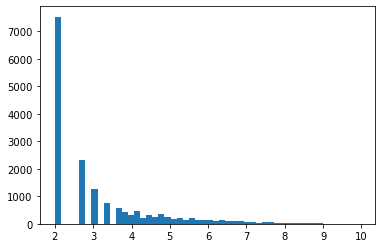

In [8]:
hist(nf, 50);